# Team Members:
| Name | ID | 
|----------|----------|
| Ahmed Nezar  | 21P0025  |
| Kirollos Ehab  | 21P0006  |
| AbdulRahman Hesham  | 21P0153  |

# Imports
- Uncomment the following cell to install the required libraries

In [1]:
# !pip install pandas
# !pip install numpy
# !pip install matplotlib
# !pip install seaborn
# !pip install sklearn

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import optuna
import pickle as pkl
import json
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.metrics import (
    precision_score,
    recall_score,
    f1_score,
    confusion_matrix,
    accuracy_score,
    classification_report
)

# Exploration

## Understanding Each Column

- **Age**: The age of the individual in years. (Numeric)

- **Sex**: The biological sex of the individual, typically coded as 0 for female and 1 for male. (Category)

- **ChestPainType**: The type of chest pain experienced by the individual, categorized into types such as: (Category)
  - Typical Angina
  - Atypical Angina
  - Non-Anginal Pain
  - Asymptomatic

- **RestingBP**: Resting blood pressure (measured in mmHg) taken while the person is at rest. (Numeric)

- **Cholesterol**: The cholesterol level in the blood, measured in mg/dL, including both LDL (bad cholesterol) and HDL (good cholesterol). (Numeric)

- **FastingBS**: Fasting blood sugar level, measured after fasting for 8+ hours, typically coded as 0 if <120 mg/dL and 1 if ≥120 mg/dL. (Category)

- **RestingECG**: Results of the resting electrocardiogram, which records the electrical activity of the heart. Categories often include:
  - Normal
  - Showing ST-T wave abnormalities (e.g., ischemia)
  - Indicating probable or definite left ventricular hypertrophy. (Category)

- **MaxHR**: Maximum heart rate achieved during physical activity, measured in beats per minute (bpm). (Numeric)

- **ExerciseAngina**: Presence of exercise-induced angina (chest pain due to reduced blood flow to the heart), typically coded as 0 for No and 1 for Yes. (Category)

- **Oldpeak**: The ST depression value on the ECG, representing changes in the heart's electrical activity during or after exercise. It indicates ischemia severity. (Numeric)

- **ST_Slope**: The slope of the ST segment during the ECG, categorized as: (Category)
  - Upsloping
  - Flat
  - Downsloping

- **HeartDisease**: Indicator of the presence of heart disease, typically coded as 0 for No (absence) and 1 for Yes (presence). (Target/Category)


In [3]:
dataset = pd.read_csv("data/heart.csv")

In [4]:
dataset

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,40,M,ATA,140,289,0,Normal,172,N,0.0,Up,0
1,49,F,NAP,160,180,0,Normal,156,N,1.0,Flat,1
2,37,M,ATA,130,283,0,ST,98,N,0.0,Up,0
3,48,F,ASY,138,214,0,Normal,108,Y,1.5,Flat,1
4,54,M,NAP,150,195,0,Normal,122,N,0.0,Up,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,45,M,TA,110,264,0,Normal,132,N,1.2,Flat,1
914,68,M,ASY,144,193,1,Normal,141,N,3.4,Flat,1
915,57,M,ASY,130,131,0,Normal,115,Y,1.2,Flat,1
916,57,F,ATA,130,236,0,LVH,174,N,0.0,Flat,1


In [5]:
dataset.columns

Index(['Age', 'Sex', 'ChestPainType', 'RestingBP', 'Cholesterol', 'FastingBS',
       'RestingECG', 'MaxHR', 'ExerciseAngina', 'Oldpeak', 'ST_Slope',
       'HeartDisease'],
      dtype='object')

## Exploratory Data Analysis 
- Check for missing values
- Check for duplicates

In [6]:
print("Number of missing values in data", dataset.isnull().sum().sum()) # No Missing Values
print("Number of duplicates in data", dataset.duplicated().sum()) # No Duplicates

Number of missing values in data 0
Number of duplicates in data 0


## Checking Data Distribution

In [7]:
print(dataset["ChestPainType"].value_counts())
print("---")
print(dataset["RestingBP"].describe()) # 0 does it make sense????
print("---")
print(dataset["Age"].describe())
print("---")
print(dataset['Cholesterol'].describe())  # Can Cholesterol be 0???? actually No
print("---")
print(dataset['FastingBS'].value_counts())
print("---")
print(dataset['MaxHR'].describe())
print("---")
print(dataset['ExerciseAngina'].value_counts())
print("---")
print(dataset['Oldpeak'].describe()) # Negative values should be refused
print("---")
print(dataset["HeartDisease"].value_counts())
print("---")

ChestPainType
ASY    496
NAP    203
ATA    173
TA      46
Name: count, dtype: int64
---
count    918.000000
mean     132.396514
std       18.514154
min        0.000000
25%      120.000000
50%      130.000000
75%      140.000000
max      200.000000
Name: RestingBP, dtype: float64
---
count    918.000000
mean      53.510893
std        9.432617
min       28.000000
25%       47.000000
50%       54.000000
75%       60.000000
max       77.000000
Name: Age, dtype: float64
---
count    918.000000
mean     198.799564
std      109.384145
min        0.000000
25%      173.250000
50%      223.000000
75%      267.000000
max      603.000000
Name: Cholesterol, dtype: float64
---
FastingBS
0    704
1    214
Name: count, dtype: int64
---
count    918.000000
mean     136.809368
std       25.460334
min       60.000000
25%      120.000000
50%      138.000000
75%      156.000000
max      202.000000
Name: MaxHR, dtype: float64
---
ExerciseAngina
N    547
Y    371
Name: count, dtype: int64
---
count    918.00

In [8]:
numerical_features = dataset.select_dtypes(include=['int64', 'float64']).columns

In [9]:
numerical_features = numerical_features.drop(labels=['HeartDisease', "FastingBS"])

In [10]:
numerical_features

Index(['Age', 'RestingBP', 'Cholesterol', 'MaxHR', 'Oldpeak'], dtype='object')

In [11]:
def detect_outliers_IQR(data):
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    outliers = (data < (Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))
    return outliers

for col in numerical_features:
    outliers = detect_outliers_IQR(dataset[col])
    print(f"Outliers in {col} are {outliers.sum()}")

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16


In [12]:
df = dataset.copy()

## Visualization

In [13]:
def kde_plot(df, feature):
    plt.figure(figsize=(10, 6))
    plt.title(f"{feature} Distribution")
    sns.kdeplot(df[feature], color="b", fill=True)
    plt.show()

def pie_plot(df, feature):
    plt.figure(figsize=(10, 6))
    plt.title(f"{feature} Distribution")
    df[feature].value_counts().plot.pie(autopct="%1.1f%%")
    plt.show()

def bar_plot(df, feature):
    plt.figure(figsize=(10, 6))
    plt.title(f"{feature} Distribution")
    df[feature].value_counts().plot.bar()
    plt.show()

def box_plot(df, feature):
    plt.figure(figsize=(10, 6))
    plt.title(f"{feature} Distribution")
    sns.boxplot(df[feature])
    plt.show()

def scatter_plot(df, feature1, feature2, hue):
    plt.figure(figsize=(10, 6))
    plt.title(f"{feature1} vs {feature2}")
    sns.scatterplot(x=feature1, y=feature2, data=df, hue=hue)
    plt.show()


In [14]:
df.columns

Index(['Age', 'Sex', 'ChestPainType', 'RestingBP', 'Cholesterol', 'FastingBS',
       'RestingECG', 'MaxHR', 'ExerciseAngina', 'Oldpeak', 'ST_Slope',
       'HeartDisease'],
      dtype='object')

In [15]:
df

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,40,M,ATA,140,289,0,Normal,172,N,0.0,Up,0
1,49,F,NAP,160,180,0,Normal,156,N,1.0,Flat,1
2,37,M,ATA,130,283,0,ST,98,N,0.0,Up,0
3,48,F,ASY,138,214,0,Normal,108,Y,1.5,Flat,1
4,54,M,NAP,150,195,0,Normal,122,N,0.0,Up,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,45,M,TA,110,264,0,Normal,132,N,1.2,Flat,1
914,68,M,ASY,144,193,1,Normal,141,N,3.4,Flat,1
915,57,M,ASY,130,131,0,Normal,115,Y,1.2,Flat,1
916,57,F,ATA,130,236,0,LVH,174,N,0.0,Flat,1


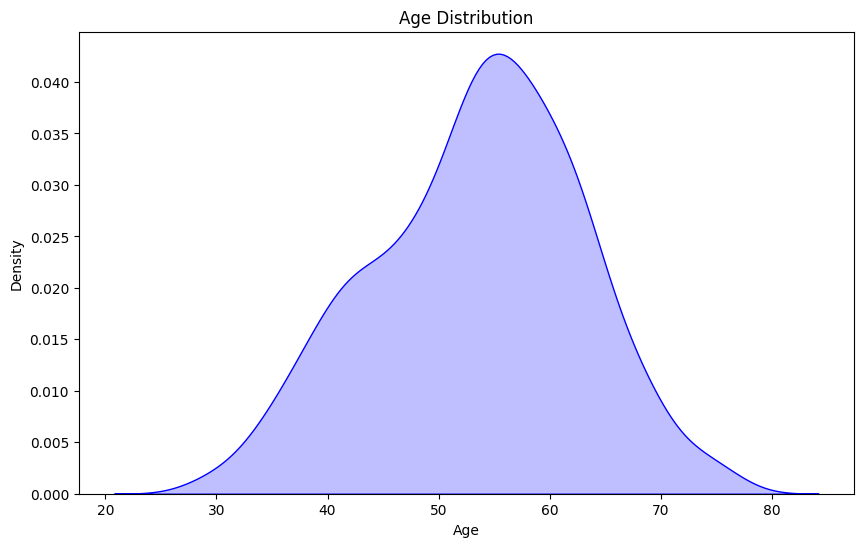

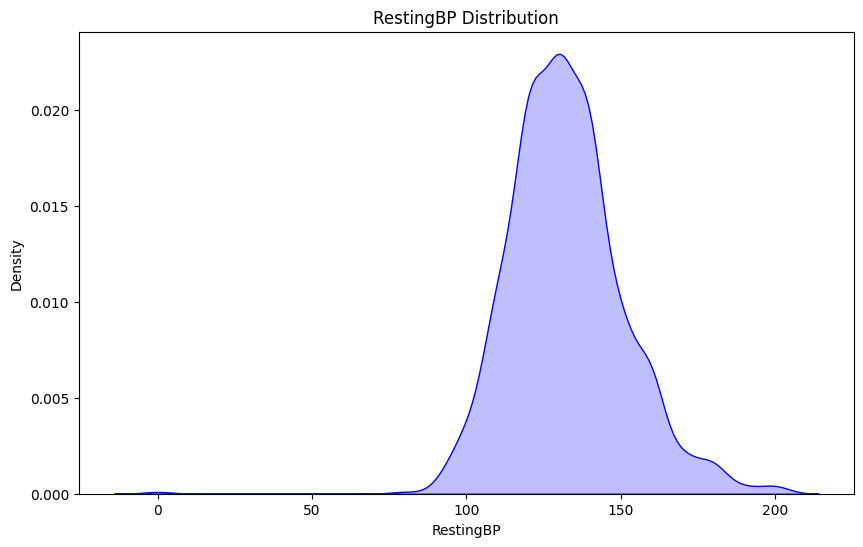

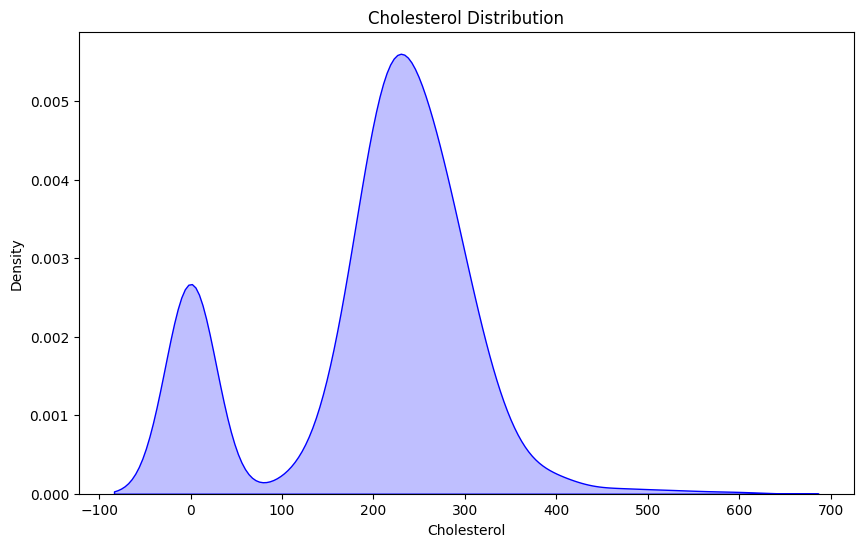

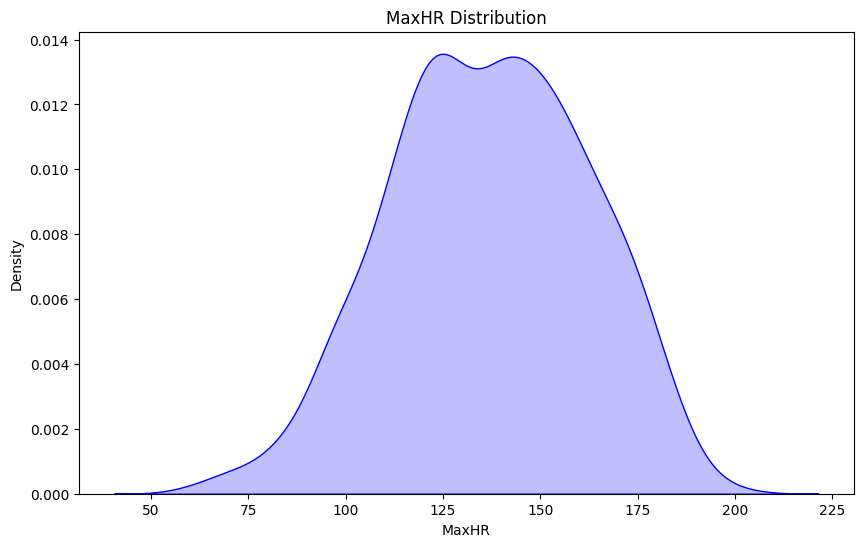

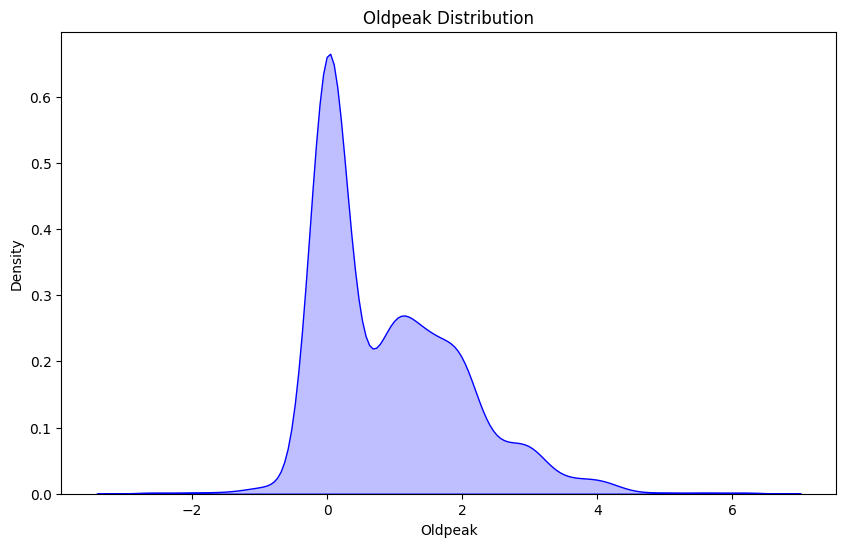

...

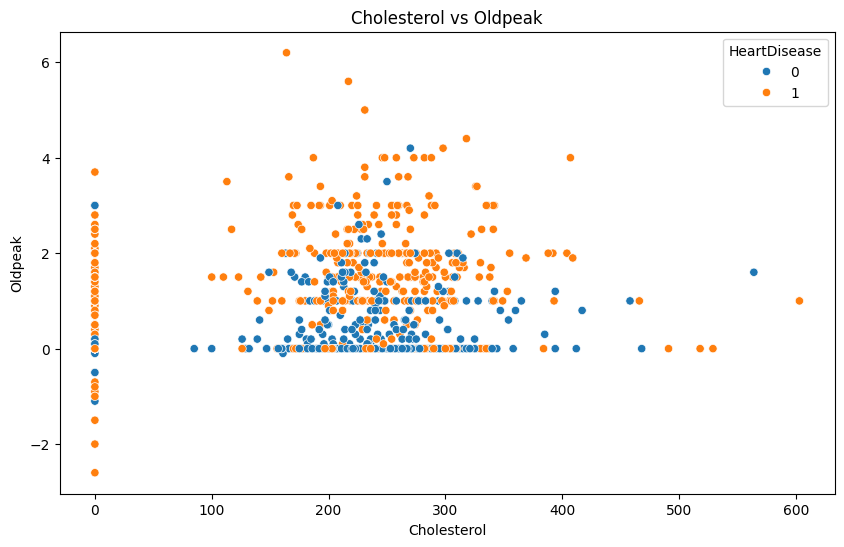

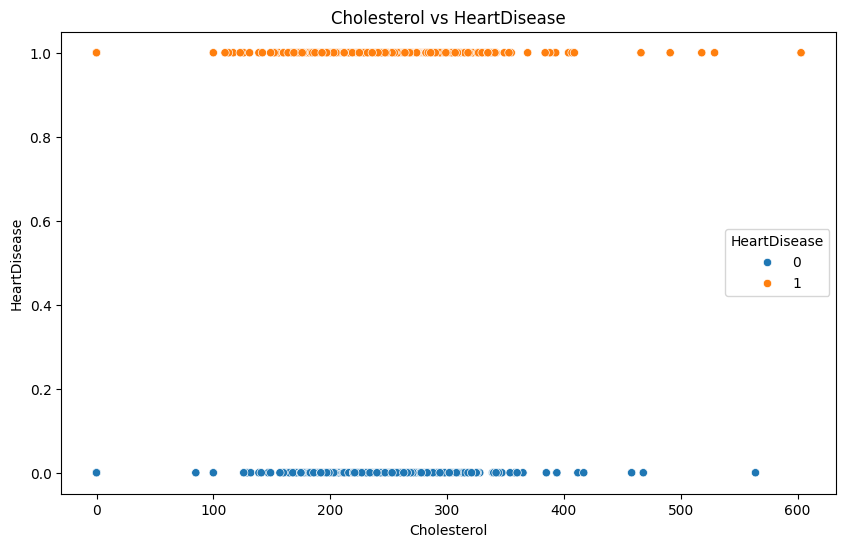

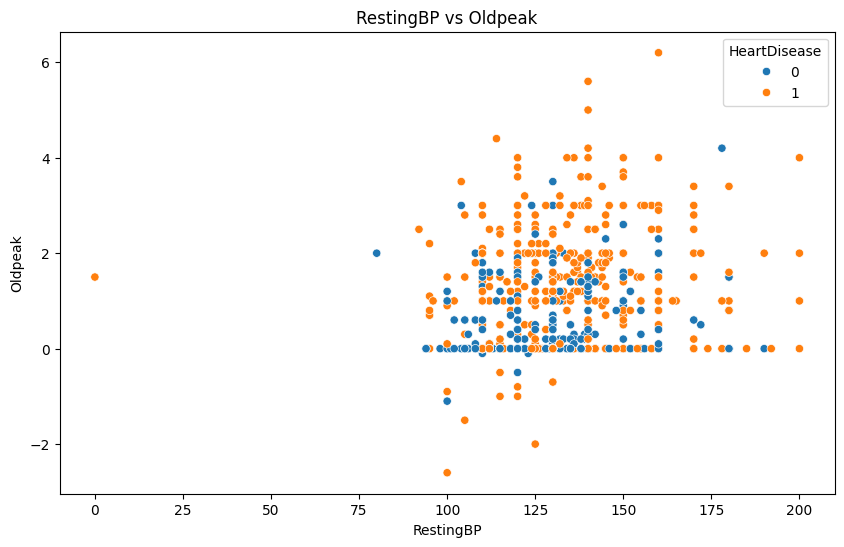

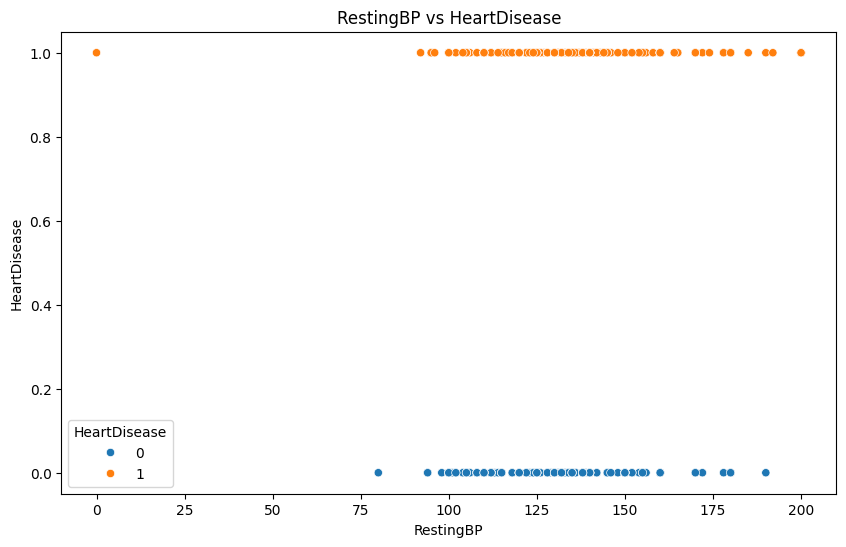

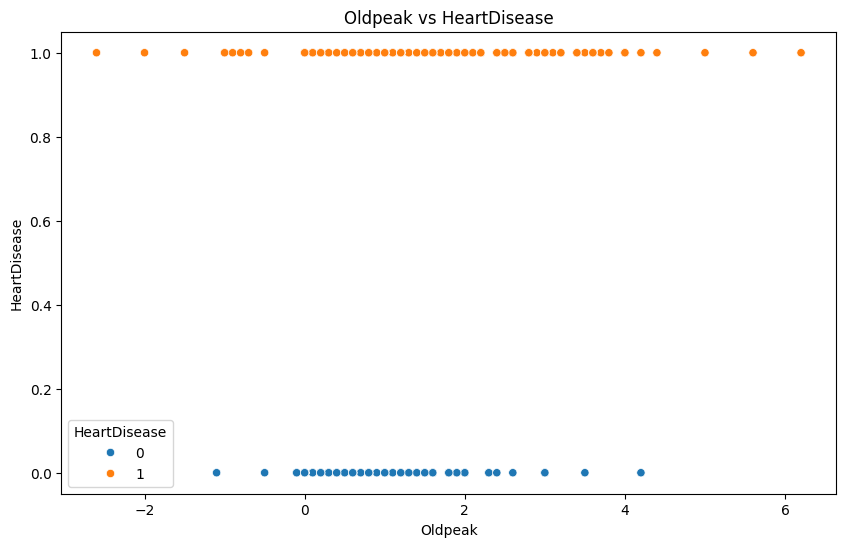

In [16]:
kde_plot(df, "Age")
kde_plot(df, "RestingBP")
kde_plot(df, "Cholesterol")
kde_plot(df, "MaxHR")
kde_plot(df, "Oldpeak")
pie_plot(df, "ChestPainType")
pie_plot(df, "HeartDisease")
pie_plot(df, "FastingBS")
bar_plot(df, "Sex")
bar_plot(df, "RestingECG")
bar_plot(df, "ExerciseAngina")
bar_plot(df, "ST_Slope")
bar_plot(df, "HeartDisease")
box_plot(df, "Age")
box_plot(df, "RestingBP")
box_plot(df, "Cholesterol")
box_plot(df, "MaxHR")
box_plot(df, "Oldpeak")
scatter_plot(df, "Age", "MaxHR", "HeartDisease")
scatter_plot(df, "Age", "Cholesterol", "HeartDisease")
scatter_plot(df, "Age", "RestingBP", "HeartDisease")
scatter_plot(df, "Age", "Oldpeak", "HeartDisease")
scatter_plot(df, "Age", "HeartDisease", "HeartDisease")
scatter_plot(df, "MaxHR", "Cholesterol", "HeartDisease")
scatter_plot(df, "MaxHR", "RestingBP", "HeartDisease")
scatter_plot(df, "MaxHR", "Oldpeak", "HeartDisease")
scatter_plot(df, "MaxHR", "HeartDisease", "HeartDisease")
scatter_plot(df, "Cholesterol", "RestingBP", "HeartDisease")
scatter_plot(df, "Cholesterol", "Oldpeak", "HeartDisease")
scatter_plot(df, "Cholesterol", "HeartDisease", "HeartDisease")
scatter_plot(df, "RestingBP", "Oldpeak", "HeartDisease")
scatter_plot(df, "RestingBP", "HeartDisease", "HeartDisease")
scatter_plot(df, "Oldpeak", "HeartDisease", "HeartDisease")

## Correlation Between Numerical Features

In [17]:
numerical_features

Index(['Age', 'RestingBP', 'Cholesterol', 'MaxHR', 'Oldpeak'], dtype='object')

In [18]:
correlation_matrix = df[numerical_features].corr()

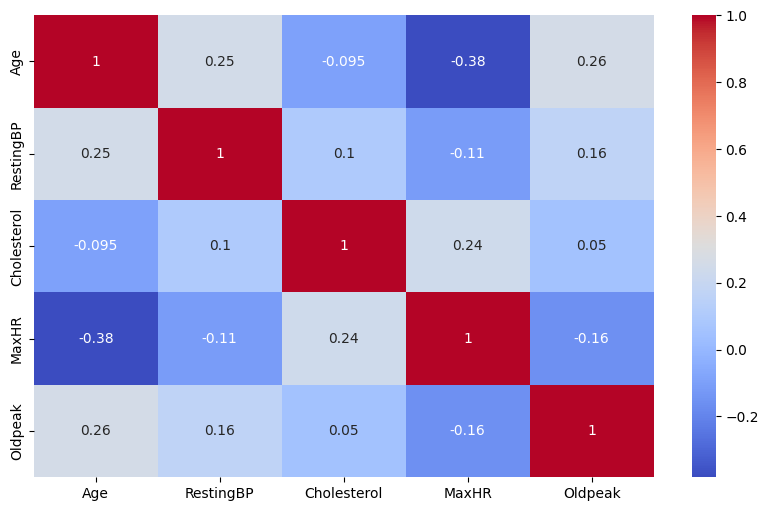

In [19]:
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.show()

- From the Correlation Matrix, we can see there is no strong correlation between any numerical features to apply any feature engineering.

---

# Preprocessing

## Utils

In [20]:
data_dir = "Scenarios"
os.makedirs(data_dir, exist_ok=True)

In [21]:
df = pd.read_csv('data/heart.csv')

In [22]:
df

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,40,M,ATA,140,289,0,Normal,172,N,0.0,Up,0
1,49,F,NAP,160,180,0,Normal,156,N,1.0,Flat,1
2,37,M,ATA,130,283,0,ST,98,N,0.0,Up,0
3,48,F,ASY,138,214,0,Normal,108,Y,1.5,Flat,1
4,54,M,NAP,150,195,0,Normal,122,N,0.0,Up,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,45,M,TA,110,264,0,Normal,132,N,1.2,Flat,1
914,68,M,ASY,144,193,1,Normal,141,N,3.4,Flat,1
915,57,M,ASY,130,131,0,Normal,115,Y,1.2,Flat,1
916,57,F,ATA,130,236,0,LVH,174,N,0.0,Flat,1


In [23]:
category_columns = df.select_dtypes(include=['object']).columns
category_columns

Index(['Sex', 'ChestPainType', 'RestingECG', 'ExerciseAngina', 'ST_Slope'], dtype='object')

In [24]:
numerical_features = df.select_dtypes(include=['int64', 'float64']).columns
numerical_features = numerical_features.drop(labels=['HeartDisease', "FastingBS"])
numerical_features

Index(['Age', 'RestingBP', 'Cholesterol', 'MaxHR', 'Oldpeak'], dtype='object')

In [25]:
def label_encode(df, columns):
    le = LabelEncoder()
    for column in columns:
        df[column] = le.fit_transform(df[column])
    return df

In [26]:
def apply_scaler(df, scaler):
    columns = df.columns
    columns = columns.drop('HeartDisease')
    df_new = pd.DataFrame(scaler.fit_transform(df.drop(columns='HeartDisease')), columns=columns)
    df_new = pd.concat([df_new, df[['HeartDisease']]], axis=1)
    return df_new

In [27]:
def detect_outliers_IQR(data):
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    outliers = (data < (Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))
    return outliers

In [28]:
def is_blunder(df):
    columns = []
    if df["Cholesterol"].min() <= 0:
        print("Blunder in Cholesterol")
        columns.append("Cholesterol")
    if df["Oldpeak"].min() < 0:
        print("Blunder in Oldpeak")
        columns.append("Oldpeak")
    if df["RestingBP"].min() <= 0:
        print("Blunder in RestingBP")
        columns.append("RestingBP")
    
    return columns

In [29]:
def fix_blunder(df, columns):
    for column in columns:
        if column == "Cholesterol" or column == "RestingBP":
            df[column] = df[column].replace(0, df[column].mean())
        elif column == "Oldpeak":
            df[column] = df[column].apply(lambda x: np.abs(x) if x < 0 else x)
    # Validate if blunder is fixed
    columns = is_blunder(df)
    if len(columns) == 0:
        print("Blunders fixed")
    return df

In [30]:
def plot_pca_scenarios(scenarios, three_d=False):
    for scenario in scenarios:
        df = pd.read_csv(os.path.join(data_dir, scenario))
        X = df.drop(columns='HeartDisease')
        y = df['HeartDisease']
        cmap = sns.color_palette("viridis", as_cmap=True)
        norm = plt.Normalize(vmin=np.min(y), vmax=np.max(y))
        unique_values = np.unique(y)
        colors = [cmap(norm(value)) for value in unique_values]
        pca = PCA(n_components=2)
        X_pca = pca.fit_transform(X)
        fig, axes = plt.subplots(1, 2, figsize=(15, 6))
        sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=y, palette=colors, ax=axes[0])
        axes[0].set_title(f"PCA 2D for {scenario}")
        
        if three_d:
            ax_3d = fig.add_subplot(122, projection='3d')
            ax_3d.scatter(X_pca[:, 0], X_pca[:, 1], y, c=y, cmap=cmap)
            ax_3d.set_title(f"PCA 3D for {scenario}")
        else:
            fig.delaxes(axes[1])

        plt.tight_layout()
        plt.show()

## Scenario 1

### Scenario 1_N
- Label encoding Categorical Features 
- Not Removing Outliers
- Not Removing Error/blunders in data
- MinMax Scaling

In [31]:
df1 = df.copy()

df1 = label_encode(df1, category_columns)
df1 = apply_scaler(df1, MinMaxScaler())

df1.to_csv(os.path.join(data_dir, "dataset_scenario_1_N.csv"), index=False)
df1

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,0.244898,1.0,0.333333,0.70,0.479270,0.0,0.5,0.788732,0.0,0.295455,1.0,0
1,0.428571,0.0,0.666667,0.80,0.298507,0.0,0.5,0.676056,0.0,0.409091,0.5,1
2,0.183673,1.0,0.333333,0.65,0.469320,0.0,1.0,0.267606,0.0,0.295455,1.0,0
3,0.408163,0.0,0.000000,0.69,0.354892,0.0,0.5,0.338028,1.0,0.465909,0.5,1
4,0.530612,1.0,0.666667,0.75,0.323383,0.0,0.5,0.436620,0.0,0.295455,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,1.000000,0.55,0.437811,0.0,0.5,0.507042,0.0,0.431818,0.5,1
914,0.816327,1.0,0.000000,0.72,0.320066,1.0,0.5,0.570423,0.0,0.681818,0.5,1
915,0.591837,1.0,0.000000,0.65,0.217247,0.0,0.5,0.387324,1.0,0.431818,0.5,1
916,0.591837,0.0,0.333333,0.65,0.391376,0.0,0.0,0.802817,0.0,0.295455,0.5,1


### Scenario 1_S
- Same as Scenario 1_N but with Standard Scaling

In [32]:
df2 = df.copy()

df2 = label_encode(df2, category_columns)
df2 = apply_scaler(df2, StandardScaler())

df2.to_csv(os.path.join(data_dir, "dataset_scenario_1_S.csv"), index=False)
df2

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,-1.433140,0.515952,0.229032,0.410909,0.825070,-0.551341,0.017255,1.382928,-0.823556,-0.832432,1.052114,0
1,-0.478484,-1.938163,1.275059,1.491752,-0.171961,-0.551341,0.017255,0.754157,-0.823556,0.105664,-0.596078,1
2,-1.751359,0.515952,0.229032,-0.129513,0.770188,-0.551341,1.601219,-1.525138,-0.823556,-0.832432,1.052114,0
3,-0.584556,-1.938163,-0.816995,0.302825,0.139040,-0.551341,0.017255,-1.132156,1.214246,0.574711,-0.596078,1
4,0.051881,0.515952,1.275059,0.951331,-0.034755,-0.551341,0.017255,-0.581981,-0.823556,-0.832432,1.052114,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,2.321086,-1.210356,0.596393,-0.551341,0.017255,-0.188999,-0.823556,0.293283,-0.596078,1
914,1.536902,0.515952,-0.816995,0.627078,-0.053049,1.813758,0.017255,0.164684,-0.823556,2.357094,-0.596078,1
915,0.370100,0.515952,-0.816995,-0.129513,-0.620168,-0.551341,0.017255,-0.857069,1.214246,0.293283,-0.596078,1
916,0.370100,-1.938163,0.229032,-0.129513,0.340275,-0.551341,-1.566710,1.461525,-0.823556,-0.832432,-0.596078,1


## Scenario 2

### Scenario 2_N
- Same label encoding as Scenario 1 
- Not Removing Outliers
- Replacing 0 with `RestingBP` with mean value
- Replacing 0 with `Cholesterol` with mean value
- Taking absolute value of `Oldpeak`negative values
- MinMax Scaling

In [33]:
df3 = df.copy()

blunder_columns = is_blunder(df3)
df3 = fix_blunder(df3, blunder_columns)

df3 = label_encode(df3, category_columns)
df3 = apply_scaler(df3, MinMaxScaler())

df3.to_csv(os.path.join(data_dir, "dataset_scenario_2_N.csv"), index=False)
df3

Blunder in Cholesterol
Blunder in Oldpeak
Blunder in RestingBP
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,0.244898,1.0,0.333333,0.500000,0.393822,0.0,0.5,0.788732,0.0,0.000000,1.0,0
1,0.428571,0.0,0.666667,0.666667,0.183398,0.0,0.5,0.676056,0.0,0.161290,0.5,1
2,0.183673,1.0,0.333333,0.416667,0.382239,0.0,1.0,0.267606,0.0,0.000000,1.0,0
3,0.408163,0.0,0.000000,0.483333,0.249035,0.0,0.5,0.338028,1.0,0.241935,0.5,1
4,0.530612,1.0,0.666667,0.583333,0.212355,0.0,0.5,0.436620,0.0,0.000000,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,1.000000,0.250000,0.345560,0.0,0.5,0.507042,0.0,0.193548,0.5,1
914,0.816327,1.0,0.000000,0.533333,0.208494,1.0,0.5,0.570423,0.0,0.548387,0.5,1
915,0.591837,1.0,0.000000,0.416667,0.088803,0.0,0.5,0.387324,1.0,0.193548,0.5,1
916,0.591837,0.0,0.333333,0.416667,0.291506,0.0,0.0,0.802817,0.0,0.000000,0.5,1


### Scenario 2_S
- Same as Scenario 2_N but with Standard Scaling

In [34]:
df4 = df.copy()

blunder_columns = is_blunder(df4)
df4 = fix_blunder(df4, blunder_columns)

df4 = label_encode(df4, category_columns)
df4 = apply_scaler(df4, StandardScaler())
df4.to_csv(os.path.join(data_dir, "dataset_scenario_2_S.csv"), index=False)

df4

Blunder in Cholesterol
Blunder in Oldpeak
Blunder in RestingBP
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,-1.433140,0.515952,0.229032,0.414861,0.942044,-0.551341,0.017255,1.382928,-0.823556,-0.878238,1.052114,0
1,-0.478484,-1.938163,1.275059,1.527200,-0.997102,-0.551341,0.017255,0.754157,-0.823556,0.081322,-0.596078,1
2,-1.751359,0.515952,0.229032,-0.141308,0.835302,-0.551341,1.601219,-1.525138,-0.823556,-0.878238,1.052114,0
3,-0.584556,-1.938163,-0.816995,0.303628,-0.392231,-0.551341,0.017255,-1.132156,1.214246,0.561102,-0.596078,1
4,0.051881,0.515952,1.275059,0.971031,-0.730247,-0.551341,0.017255,-0.581981,-0.823556,-0.878238,1.052114,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,2.321086,-1.253647,0.497286,-0.551341,0.017255,-0.188999,-0.823556,0.273234,-0.596078,1
914,1.536902,0.515952,-0.816995,0.637329,-0.765828,1.813758,0.017255,0.164684,-0.823556,2.384267,-0.596078,1
915,0.370100,0.515952,-0.816995,-0.141308,-1.868828,-0.551341,0.017255,-0.857069,1.214246,0.273234,-0.596078,1
916,0.370100,-1.938163,0.229032,-0.141308,-0.000843,-0.551341,-1.566710,1.461525,-0.823556,-0.878238,-0.596078,1


## Scenario 3

### Scenario 3_N
- Same label encoding as Scenario 1
- Removing Outliers
- Checking for Error/blunders in data after removing outliers

In [35]:
df5 = df.copy()

outliers = {}

for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df5[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

outlier_mask = pd.Series(True, index=df5.index)
for col in numerical_features:
    outlier_mask &= ~outliers[col].reindex(df5.index, fill_value=False)

print(f"Total outliers removed: {outlier_mask.sum()}")

df5 = df5[outlier_mask]

df5.reset_index(drop=True, inplace=True)

blunder_columns = is_blunder(df5)

df5 = fix_blunder(df5, blunder_columns) # if no blunders then it will return the same dataframe

df5 = label_encode(df5, category_columns)
df5 = apply_scaler(df5, MinMaxScaler())
df5.to_csv(os.path.join(data_dir, "dataset_scenario_3_N.csv"), index=False)

df5

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Total outliers removed: 702
Blunder in Oldpeak
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,0.244898,1.0,0.333333,0.615385,0.639498,0.0,0.5,0.770992,0.0,0.000000,1.0,0
1,0.428571,0.0,0.666667,0.871795,0.297806,0.0,0.5,0.648855,0.0,0.277778,0.5,1
2,0.183673,1.0,0.333333,0.487179,0.620690,0.0,1.0,0.206107,0.0,0.000000,1.0,0
3,0.408163,0.0,0.000000,0.589744,0.404389,0.0,0.5,0.282443,1.0,0.416667,0.5,1
4,0.530612,1.0,0.666667,0.743590,0.344828,0.0,0.5,0.389313,0.0,0.000000,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
697,0.346939,1.0,1.000000,0.230769,0.561129,0.0,0.5,0.465649,0.0,0.333333,0.5,1
698,0.816327,1.0,0.000000,0.666667,0.338558,1.0,0.5,0.534351,0.0,0.944444,0.5,1
699,0.591837,1.0,0.000000,0.487179,0.144201,0.0,0.5,0.335878,1.0,0.333333,0.5,1
700,0.591837,0.0,0.333333,0.487179,0.473354,0.0,0.0,0.786260,0.0,0.000000,0.5,1


### Scenario 3_S
- Same as Scenario 3_N but with Standard Scaling

In [36]:
df6 = df.copy()

outliers = {}

for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df6[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

outlier_mask = pd.Series(True, index=df6.index)
for col in numerical_features:
    outlier_mask &= ~outliers[col].reindex(df6.index, fill_value=False)

print(f"Total outliers removed: {outlier_mask.sum()}")

df6 = df6[outlier_mask]
    
df6.reset_index(drop=True, inplace=True)

blunder_columns = is_blunder(df6)

df6 = fix_blunder(df6, blunder_columns) # if no blunders then it will return the same dataframe

df6 = label_encode(df6, category_columns)
df6 = apply_scaler(df6, StandardScaler())
df6.to_csv(os.path.join(data_dir, "dataset_scenario_3_S.csv"), index=False)

df6

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Total outliers removed: 702
Blunder in Oldpeak
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,-1.335169,0.560898,0.147121,0.547914,0.973199,-0.440315,0.113502,1.291925,-0.774008,-0.866913,0.971639,0
1,-0.390639,-1.782855,1.190340,1.845825,-1.178909,-0.440315,0.113502,0.634669,-0.774008,0.176057,-0.750812,1
2,-1.650013,0.560898,0.147121,-0.101041,0.854735,-0.440315,1.707064,-1.747885,-0.774008,-0.866913,0.971639,0
3,-0.495587,-1.782855,-0.896099,0.418123,-0.507609,-0.440315,0.113502,-1.337100,1.291976,0.697542,-0.750812,1
4,0.134100,0.560898,1.190340,1.196870,-0.882748,-0.440315,0.113502,-0.762001,-0.774008,-0.866913,0.971639,0
...,...,...,...,...,...,...,...,...,...,...,...,...
697,-0.810430,0.560898,2.233560,-1.398952,0.479596,-0.440315,0.113502,-0.351215,-0.774008,0.384651,-0.750812,1
698,1.603369,0.560898,-0.896099,0.807496,-0.922236,2.271100,0.113502,0.018491,-0.774008,2.679186,-0.750812,1
699,0.448943,0.560898,-0.896099,-0.101041,-2.146371,-0.440315,0.113502,-1.049550,1.291976,0.384651,-0.750812,1
700,0.448943,-1.782855,0.147121,-0.101041,-0.073239,-0.440315,-1.480061,1.374082,-0.774008,-0.866913,-0.750812,1


## Scenario 4

### Scenario 4_N
- Same label encoding as Scenario 1
- Removing Outliers by replacing with mean value
- Checking for Error/blunders in data after removing outliers
- MinMax Scaling

In [37]:
df7 = df.copy()
outliers = {}

for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df7[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

for col in numerical_features:
    df7[col] = df7[col].mask(outliers[col], df7[col].mean())

print("Replacing outliers with mean")
    
blunder_columns = is_blunder(df7)

df7 = fix_blunder(df7, blunder_columns) # if no blunders then it will return the same dataframe

df7 = label_encode(df7, category_columns)
df7 = apply_scaler(df7, MinMaxScaler())
df7.to_csv(os.path.join(data_dir, "dataset_scenario_4_N.csv"), index=False)

df7

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Replacing outliers with mean
Blunder in Oldpeak
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,0.244898,1.0,0.333333,0.615385,0.633540,0.0,0.5,0.777778,0.0,0.000000,1.0,0
1,0.428571,0.0,0.666667,0.871795,0.295031,0.0,0.5,0.659259,0.0,0.270270,0.5,1
2,0.183673,1.0,0.333333,0.487179,0.614907,0.0,1.0,0.229630,0.0,0.000000,1.0,0
3,0.408163,0.0,0.000000,0.589744,0.400621,0.0,0.5,0.303704,1.0,0.405405,0.5,1
4,0.530612,1.0,0.666667,0.743590,0.341615,0.0,0.5,0.407407,0.0,0.000000,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,1.000000,0.230769,0.555901,0.0,0.5,0.481481,0.0,0.324324,0.5,1
914,0.816327,1.0,0.000000,0.666667,0.335404,1.0,0.5,0.548148,0.0,0.918919,0.5,1
915,0.591837,1.0,0.000000,0.487179,0.142857,0.0,0.5,0.355556,1.0,0.324324,0.5,1
916,0.591837,0.0,0.333333,0.487179,0.468944,0.0,0.0,0.792593,0.0,0.000000,0.5,1


### Scenario 4_S
- Same as Scenario 4_N but with Standard Scaling

In [38]:
df8 = df.copy()
outliers = {}

for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df8[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

for col in numerical_features:
    df8[col] = df8[col].mask(outliers[col], df8[col].mean())

print("Replacing outliers with mean")
    
blunder_columns = is_blunder(df8)

df8 = fix_blunder(df8, blunder_columns) # if no blunders then it will return the same dataframe

df8 = label_encode(df8, category_columns)
df8 = apply_scaler(df8, StandardScaler())
df8.to_csv(os.path.join(data_dir, "dataset_scenario_4_S.csv"), index=False)

df8

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Replacing outliers with mean
Blunder in Oldpeak
Blunders fixed


,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,HeartDisease
0,-1.433140,0.515952,0.229032,0.567537,1.156234,-0.551341,0.017255,1.389839,-0.823556,-0.914057,1.052114,0
1,-0.478484,-1.938163,1.275059,1.850485,-1.079045,-0.551341,0.017255,0.754966,-0.823556,0.152966,-0.596078,1
2,-1.751359,0.515952,0.229032,-0.073937,1.033191,-0.551341,1.601219,-1.546450,-0.823556,-0.914057,1.052114,0
3,-0.584556,-1.938163,-0.816995,0.439242,-0.381802,-0.551341,0.017255,-1.149654,1.214246,0.686477,-0.596078,1
4,0.051881,0.515952,1.275059,1.209011,-0.771438,-0.551341,0.017255,-0.594140,-0.823556,-0.914057,1.052114,0
...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,2.321086,-1.356886,0.643555,-0.551341,0.017255,-0.197344,-0.823556,0.366370,-0.596078,1
914,1.536902,0.515952,-0.816995,0.824126,-0.812452,1.813758,0.017255,0.159772,-0.823556,2.713821,-0.596078,1
915,0.370100,0.515952,-0.816995,-0.073937,-2.083895,-0.551341,0.017255,-0.871897,1.214246,0.366370,-0.596078,1
916,0.370100,-1.938163,0.229032,-0.073937,0.069355,-0.551341,-1.566710,1.469199,-0.823556,-0.914057,-0.596078,1


## Scenario 5

### Scenario 5_N
- label encoding `Sex`, `ExerciseAngina`, `ST_Slope`, `RestingECG`
- OneHot encoding `ChestPainType`
- Not Removing Outliers
- Not Removing Error/blunders in data
- MinMax Scaling

In [39]:
df9 = df.copy()

df9 = label_encode(df9, category_columns.drop(labels='ChestPainType'))
df9 = pd.get_dummies(df9, columns=['ChestPainType'], dtype=int)

df9 = apply_scaler(df9, MinMaxScaler())
df9.to_csv(os.path.join(data_dir, "dataset_scenario_5_N.csv"), index=False)

df9


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,0.244898,1.0,0.70,0.479270,0.0,0.5,0.788732,0.0,0.295455,1.0,0.0,1.0,0.0,0.0,0
1,0.428571,0.0,0.80,0.298507,0.0,0.5,0.676056,0.0,0.409091,0.5,0.0,0.0,1.0,0.0,1
2,0.183673,1.0,0.65,0.469320,0.0,1.0,0.267606,0.0,0.295455,1.0,0.0,1.0,0.0,0.0,0
3,0.408163,0.0,0.69,0.354892,0.0,0.5,0.338028,1.0,0.465909,0.5,1.0,0.0,0.0,0.0,1
4,0.530612,1.0,0.75,0.323383,0.0,0.5,0.436620,0.0,0.295455,1.0,0.0,0.0,1.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,0.55,0.437811,0.0,0.5,0.507042,0.0,0.431818,0.5,0.0,0.0,0.0,1.0,1
914,0.816327,1.0,0.72,0.320066,1.0,0.5,0.570423,0.0,0.681818,0.5,1.0,0.0,0.0,0.0,1
915,0.591837,1.0,0.65,0.217247,0.0,0.5,0.387324,1.0,0.431818,0.5,1.0,0.0,0.0,0.0,1
916,0.591837,0.0,0.65,0.391376,0.0,0.0,0.802817,0.0,0.295455,0.5,0.0,1.0,0.0,0.0,1


### Scenario 5_S
- Same as Scenario 5_N but with Standard Scaling

In [40]:
df10 = df.copy()

df10 = label_encode(df10, category_columns.drop(labels='ChestPainType'))
df10 = pd.get_dummies(df10, columns=['ChestPainType'], dtype=int)

df10 = apply_scaler(df10, StandardScaler())
df10.to_csv(os.path.join(data_dir, "dataset_scenario_5_S.csv"), index=False)

df10


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,-1.433140,0.515952,0.410909,0.825070,-0.551341,0.017255,1.382928,-0.823556,-0.832432,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
1,-0.478484,-1.938163,1.491752,-0.171961,-0.551341,0.017255,0.754157,-0.823556,0.105664,-0.596078,-1.084138,-0.481887,1.876744,-0.229679,1
2,-1.751359,0.515952,-0.129513,0.770188,-0.551341,1.601219,-1.525138,-0.823556,-0.832432,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
3,-0.584556,-1.938163,0.302825,0.139040,-0.551341,0.017255,-1.132156,1.214246,0.574711,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
4,0.051881,0.515952,0.951331,-0.034755,-0.551341,0.017255,-0.581981,-0.823556,-0.832432,1.052114,-1.084138,-0.481887,1.876744,-0.229679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,-1.210356,0.596393,-0.551341,0.017255,-0.188999,-0.823556,0.293283,-0.596078,-1.084138,-0.481887,-0.532838,4.353909,1
914,1.536902,0.515952,0.627078,-0.053049,1.813758,0.017255,0.164684,-0.823556,2.357094,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
915,0.370100,0.515952,-0.129513,-0.620168,-0.551341,0.017255,-0.857069,1.214246,0.293283,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
916,0.370100,-1.938163,-0.129513,0.340275,-0.551341,-1.566710,1.461525,-0.823556,-0.832432,-0.596078,-1.084138,2.075177,-0.532838,-0.229679,1


## Scenario 6

### Scenatio 6_N
- Same Encoding as Scenario 5
- Removing Blunders/Error in data
- Not Removing Outliers

In [41]:
df11 = df.copy()

df11 = label_encode(df11, category_columns.drop(labels='ChestPainType'))
df11 = pd.get_dummies(df11, columns=['ChestPainType'], dtype=int)

blunder_columns = is_blunder(df11)
df11 = fix_blunder(df11, blunder_columns)

df11 = apply_scaler(df11, MinMaxScaler())
df11.to_csv(os.path.join(data_dir, "dataset_scenario_6_N.csv"), index=False)

df11

Blunder in Cholesterol
Blunder in Oldpeak
Blunder in RestingBP
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,0.244898,1.0,0.500000,0.393822,0.0,0.5,0.788732,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
1,0.428571,0.0,0.666667,0.183398,0.0,0.5,0.676056,0.0,0.161290,0.5,0.0,0.0,1.0,0.0,1
2,0.183673,1.0,0.416667,0.382239,0.0,1.0,0.267606,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
3,0.408163,0.0,0.483333,0.249035,0.0,0.5,0.338028,1.0,0.241935,0.5,1.0,0.0,0.0,0.0,1
4,0.530612,1.0,0.583333,0.212355,0.0,0.5,0.436620,0.0,0.000000,1.0,0.0,0.0,1.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,0.250000,0.345560,0.0,0.5,0.507042,0.0,0.193548,0.5,0.0,0.0,0.0,1.0,1
914,0.816327,1.0,0.533333,0.208494,1.0,0.5,0.570423,0.0,0.548387,0.5,1.0,0.0,0.0,0.0,1
915,0.591837,1.0,0.416667,0.088803,0.0,0.5,0.387324,1.0,0.193548,0.5,1.0,0.0,0.0,0.0,1
916,0.591837,0.0,0.416667,0.291506,0.0,0.0,0.802817,0.0,0.000000,0.5,0.0,1.0,0.0,0.0,1


### Scenario 6_S
- Same as Scenario 6_N but with Standard Scaling

In [42]:
df12 = df.copy()

df12 = label_encode(df12, category_columns.drop(labels='ChestPainType'))
df12 = pd.get_dummies(df12, columns=['ChestPainType'], dtype=int)

blunder_columns = is_blunder(df12)
df12 = fix_blunder(df12, blunder_columns)

df12 = apply_scaler(df12, StandardScaler())
df12.to_csv(os.path.join(data_dir, "dataset_scenario_6_S.csv"), index=False)

df12

Blunder in Cholesterol
Blunder in Oldpeak
Blunder in RestingBP
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,-1.433140,0.515952,0.414861,0.942044,-0.551341,0.017255,1.382928,-0.823556,-0.878238,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
1,-0.478484,-1.938163,1.527200,-0.997102,-0.551341,0.017255,0.754157,-0.823556,0.081322,-0.596078,-1.084138,-0.481887,1.876744,-0.229679,1
2,-1.751359,0.515952,-0.141308,0.835302,-0.551341,1.601219,-1.525138,-0.823556,-0.878238,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
3,-0.584556,-1.938163,0.303628,-0.392231,-0.551341,0.017255,-1.132156,1.214246,0.561102,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
4,0.051881,0.515952,0.971031,-0.730247,-0.551341,0.017255,-0.581981,-0.823556,-0.878238,1.052114,-1.084138,-0.481887,1.876744,-0.229679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,-1.253647,0.497286,-0.551341,0.017255,-0.188999,-0.823556,0.273234,-0.596078,-1.084138,-0.481887,-0.532838,4.353909,1
914,1.536902,0.515952,0.637329,-0.765828,1.813758,0.017255,0.164684,-0.823556,2.384267,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
915,0.370100,0.515952,-0.141308,-1.868828,-0.551341,0.017255,-0.857069,1.214246,0.273234,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
916,0.370100,-1.938163,-0.141308,-0.000843,-0.551341,-1.566710,1.461525,-0.823556,-0.878238,-0.596078,-1.084138,2.075177,-0.532838,-0.229679,1


## Scenario 7

### Scenario 7_N
- Same Encoding as Scenario 5
- Removing Outliers
- Checking for Error/blunders in data after removing outliers
- MinMax Scaling

In [43]:
df13 = df.copy()

outliers = {}
for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df13[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

outlier_mask = pd.Series(True, index=df13.index)
for col in numerical_features:
    outlier_mask &= ~outliers[col].reindex(df13.index, fill_value=False)

df13 = df13[outlier_mask]
df13.reset_index(drop=True, inplace=True)

blunder_columns = is_blunder(df13)
df13 = fix_blunder(df13, blunder_columns)

df13 = label_encode(df13, category_columns.drop(labels='ChestPainType'))
df13 = pd.get_dummies(df13, columns=['ChestPainType'], dtype=int)

df13 = apply_scaler(df13, MinMaxScaler())
df13.to_csv(os.path.join(data_dir, "dataset_scenario_7_N.csv"), index=False)

df13

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Blunder in Oldpeak
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,0.244898,1.0,0.615385,0.639498,0.0,0.5,0.770992,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
1,0.428571,0.0,0.871795,0.297806,0.0,0.5,0.648855,0.0,0.277778,0.5,0.0,0.0,1.0,0.0,1
2,0.183673,1.0,0.487179,0.620690,0.0,1.0,0.206107,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
3,0.408163,0.0,0.589744,0.404389,0.0,0.5,0.282443,1.0,0.416667,0.5,1.0,0.0,0.0,0.0,1
4,0.530612,1.0,0.743590,0.344828,0.0,0.5,0.389313,0.0,0.000000,1.0,0.0,0.0,1.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
697,0.346939,1.0,0.230769,0.561129,0.0,0.5,0.465649,0.0,0.333333,0.5,0.0,0.0,0.0,1.0,1
698,0.816327,1.0,0.666667,0.338558,1.0,0.5,0.534351,0.0,0.944444,0.5,1.0,0.0,0.0,0.0,1
699,0.591837,1.0,0.487179,0.144201,0.0,0.5,0.335878,1.0,0.333333,0.5,1.0,0.0,0.0,0.0,1
700,0.591837,0.0,0.487179,0.473354,0.0,0.0,0.786260,0.0,0.000000,0.5,0.0,1.0,0.0,0.0,1


### Scenario 7_S
- Same as Scenario 7_N but with Standard Scaling

In [44]:
df14 = df.copy()

outliers = {}
for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df14[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")

outlier_mask = pd.Series(True, index=df14.index)
for col in numerical_features:
    outlier_mask &= ~outliers[col].reindex(df14.index, fill_value=False)

print("Removed Outliers:", df14.shape[0] - sum(outlier_mask))

df14 = df14[outlier_mask]
df14.reset_index(drop=True, inplace=True)

blunder_columns = is_blunder(df14)
df14 = fix_blunder(df14, blunder_columns)

df14 = label_encode(df14, category_columns.drop(labels='ChestPainType'))
df14 = pd.get_dummies(df14, columns=['ChestPainType'], dtype=int)

df14 = apply_scaler(df14, StandardScaler())
df14.to_csv(os.path.join(data_dir, "dataset_scenario_7_S.csv"), index=False)

df14

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Removed Outliers: 216
Blunder in Oldpeak
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,-1.335169,0.560898,0.547914,0.973199,-0.440315,0.113502,1.291925,-0.774008,-0.866913,0.971639,-0.969137,1.840516,-0.549920,-0.242536,0
1,-0.390639,-1.782855,1.845825,-1.178909,-0.440315,0.113502,0.634669,-0.774008,0.176057,-0.750812,-0.969137,-0.543326,1.818447,-0.242536,1
2,-1.650013,0.560898,-0.101041,0.854735,-0.440315,1.707064,-1.747885,-0.774008,-0.866913,0.971639,-0.969137,1.840516,-0.549920,-0.242536,0
3,-0.495587,-1.782855,0.418123,-0.507609,-0.440315,0.113502,-1.337100,1.291976,0.697542,-0.750812,1.031846,-0.543326,-0.549920,-0.242536,1
4,0.134100,0.560898,1.196870,-0.882748,-0.440315,0.113502,-0.762001,-0.774008,-0.866913,0.971639,-0.969137,-0.543326,1.818447,-0.242536,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
697,-0.810430,0.560898,-1.398952,0.479596,-0.440315,0.113502,-0.351215,-0.774008,0.384651,-0.750812,-0.969137,-0.543326,-0.549920,4.123106,1
698,1.603369,0.560898,0.807496,-0.922236,2.271100,0.113502,0.018491,-0.774008,2.679186,-0.750812,1.031846,-0.543326,-0.549920,-0.242536,1
699,0.448943,0.560898,-0.101041,-2.146371,-0.440315,0.113502,-1.049550,1.291976,0.384651,-0.750812,1.031846,-0.543326,-0.549920,-0.242536,1
700,0.448943,-1.782855,-0.101041,-0.073239,-0.440315,-1.480061,1.374082,-0.774008,-0.866913,-0.750812,-0.969137,1.840516,-0.549920,-0.242536,1


## Scenario 8

### Scenario 8_N
- Same Encoding as Scenario 5
- Removing Outliers by replacing with mean value
- Checking for Error/blunders in data after removing outliers

In [45]:
df15 = df.copy()

outliers = {}
for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df15[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")
    
for col in numerical_features:
    df15[col] = df15[col].mask(outliers[col], df15[col].mean())

blunder_columns = is_blunder(df15)
df15 = fix_blunder(df15, blunder_columns)

df15 = label_encode(df15, category_columns.drop(labels='ChestPainType'))
df15 = pd.get_dummies(df15, columns=['ChestPainType'], dtype=int)

df15 = apply_scaler(df15, MinMaxScaler())
df15.to_csv(os.path.join(data_dir, "dataset_scenario_8_N.csv"), index=False)

df15

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Blunder in Oldpeak
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,0.244898,1.0,0.615385,0.633540,0.0,0.5,0.777778,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
1,0.428571,0.0,0.871795,0.295031,0.0,0.5,0.659259,0.0,0.270270,0.5,0.0,0.0,1.0,0.0,1
2,0.183673,1.0,0.487179,0.614907,0.0,1.0,0.229630,0.0,0.000000,1.0,0.0,1.0,0.0,0.0,0
3,0.408163,0.0,0.589744,0.400621,0.0,0.5,0.303704,1.0,0.405405,0.5,1.0,0.0,0.0,0.0,1
4,0.530612,1.0,0.743590,0.341615,0.0,0.5,0.407407,0.0,0.000000,1.0,0.0,0.0,1.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,0.346939,1.0,0.230769,0.555901,0.0,0.5,0.481481,0.0,0.324324,0.5,0.0,0.0,0.0,1.0,1
914,0.816327,1.0,0.666667,0.335404,1.0,0.5,0.548148,0.0,0.918919,0.5,1.0,0.0,0.0,0.0,1
915,0.591837,1.0,0.487179,0.142857,0.0,0.5,0.355556,1.0,0.324324,0.5,1.0,0.0,0.0,0.0,1
916,0.591837,0.0,0.487179,0.468944,0.0,0.0,0.792593,0.0,0.000000,0.5,0.0,1.0,0.0,0.0,1


### Scenario 8_S
- Same as Scenario 8_N but with Standard Scaling

In [46]:
df16 = df.copy()

outliers = {}
for col in numerical_features:
    outliers[col] = detect_outliers_IQR(df16[col])
    print(f"Outliers in {col} are {outliers[col].sum()}")
    
for col in numerical_features:
    df16[col] = df16[col].mask(outliers[col], df16[col].mean())

print("Replace Outliers with mean:", df16.shape[0] - sum(outlier_mask))

blunder_columns = is_blunder(df16)
df16 = fix_blunder(df16, blunder_columns)

df16 = label_encode(df16, category_columns.drop(labels='ChestPainType'))
df16 = pd.get_dummies(df16, columns=['ChestPainType'], dtype=int)

df16 = apply_scaler(df16, StandardScaler())
df16.to_csv(os.path.join(data_dir, "dataset_scenario_8_S.csv"), index=False)

df16

Outliers in Age are 0
Outliers in RestingBP are 28
Outliers in Cholesterol are 183
Outliers in MaxHR are 2
Outliers in Oldpeak are 16
Replace Outliers with mean: 216
Blunder in Oldpeak
Blunders fixed


,Age,Sex,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope,ChestPainType_ASY,ChestPainType_ATA,ChestPainType_NAP,ChestPainType_TA,HeartDisease
0,-1.433140,0.515952,0.567537,1.156234,-0.551341,0.017255,1.389839,-0.823556,-0.914057,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
1,-0.478484,-1.938163,1.850485,-1.079045,-0.551341,0.017255,0.754966,-0.823556,0.152966,-0.596078,-1.084138,-0.481887,1.876744,-0.229679,1
2,-1.751359,0.515952,-0.073937,1.033191,-0.551341,1.601219,-1.546450,-0.823556,-0.914057,1.052114,-1.084138,2.075177,-0.532838,-0.229679,0
3,-0.584556,-1.938163,0.439242,-0.381802,-0.551341,0.017255,-1.149654,1.214246,0.686477,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
4,0.051881,0.515952,1.209011,-0.771438,-0.551341,0.017255,-0.594140,-0.823556,-0.914057,1.052114,-1.084138,-0.481887,1.876744,-0.229679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,-0.902775,0.515952,-1.356886,0.643555,-0.551341,0.017255,-0.197344,-0.823556,0.366370,-0.596078,-1.084138,-0.481887,-0.532838,4.353909,1
914,1.536902,0.515952,0.824126,-0.812452,1.813758,0.017255,0.159772,-0.823556,2.713821,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
915,0.370100,0.515952,-0.073937,-2.083895,-0.551341,0.017255,-0.871897,1.214246,0.366370,-0.596078,0.922392,-0.481887,-0.532838,-0.229679,1
916,0.370100,-1.938163,-0.073937,0.069355,-0.551341,-1.566710,1.469199,-0.823556,-0.914057,-0.596078,-1.084138,2.075177,-0.532838,-0.229679,1


# PCA of Features
- PCA will be applied to all the scenarios to visualize the data in 2D & 3D

In [47]:
list_of_scenarios = os.listdir(data_dir)
list_of_scenarios

['dataset_scenario_1_N.csv',
 'dataset_scenario_1_S.csv',
 'dataset_scenario_2_N.csv',
 'dataset_scenario_2_S.csv',
 'dataset_scenario_3_N.csv',
 'dataset_scenario_3_S.csv',
 'dataset_scenario_4_N.csv',
 'dataset_scenario_4_S.csv',
 'dataset_scenario_5_N.csv',
 'dataset_scenario_5_S.csv',
 'dataset_scenario_6_N.csv',
 'dataset_scenario_6_S.csv',
 'dataset_scenario_7_N.csv',
 'dataset_scenario_7_S.csv',
 'dataset_scenario_8_N.csv',
 'dataset_scenario_8_S.csv']

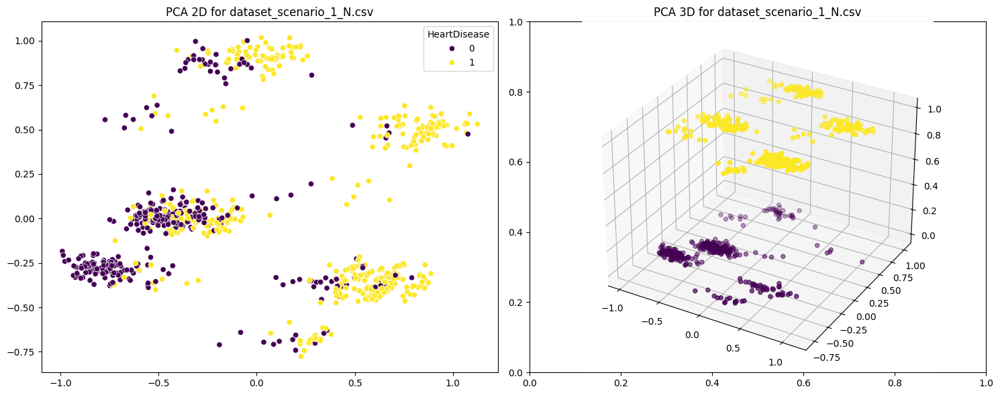

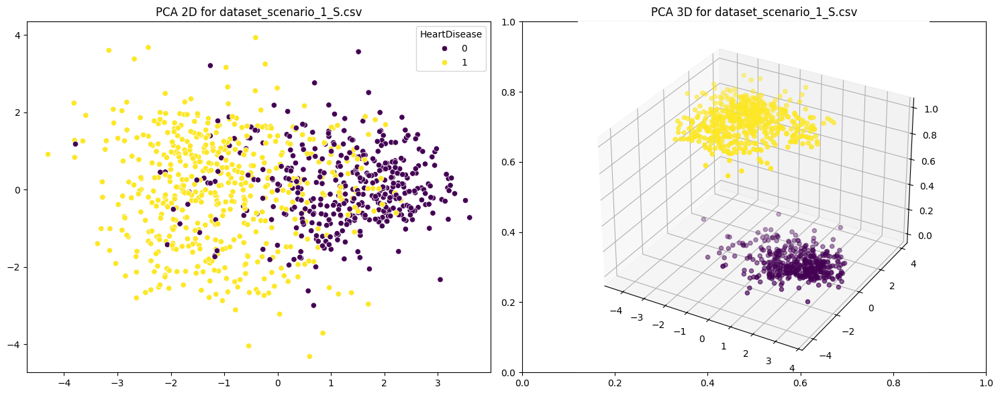

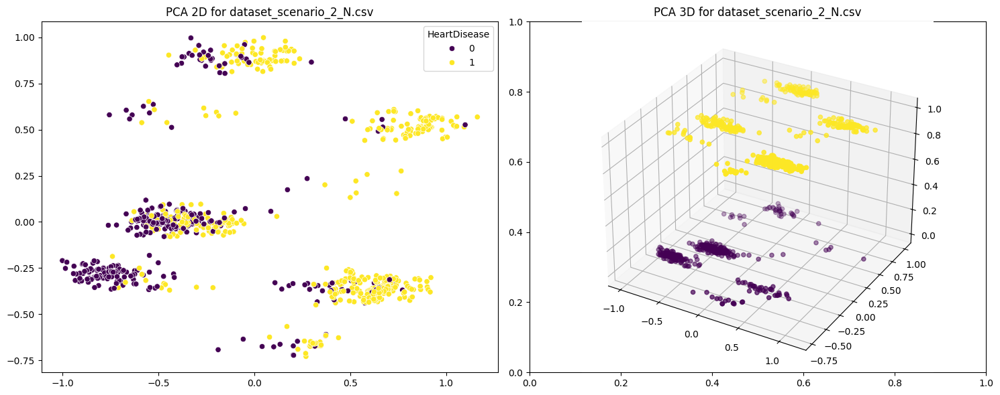

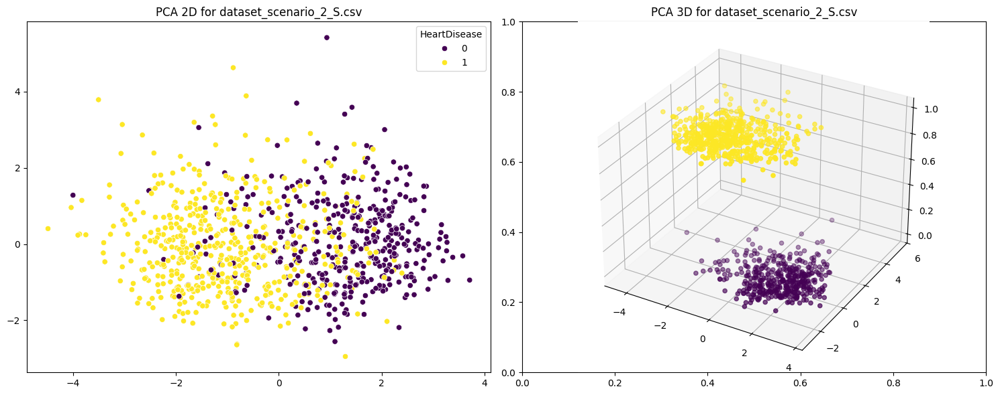

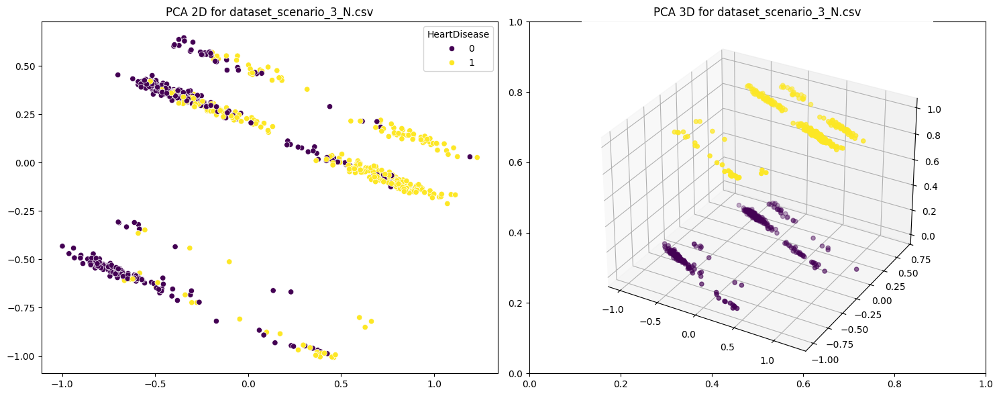

...

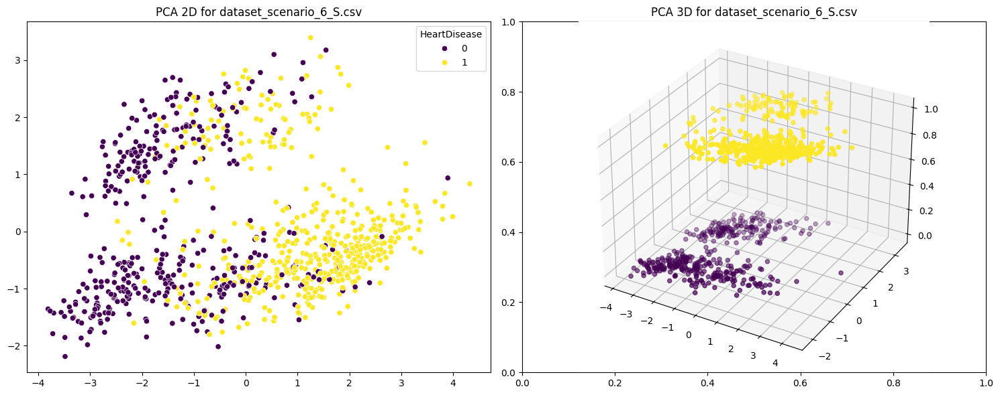

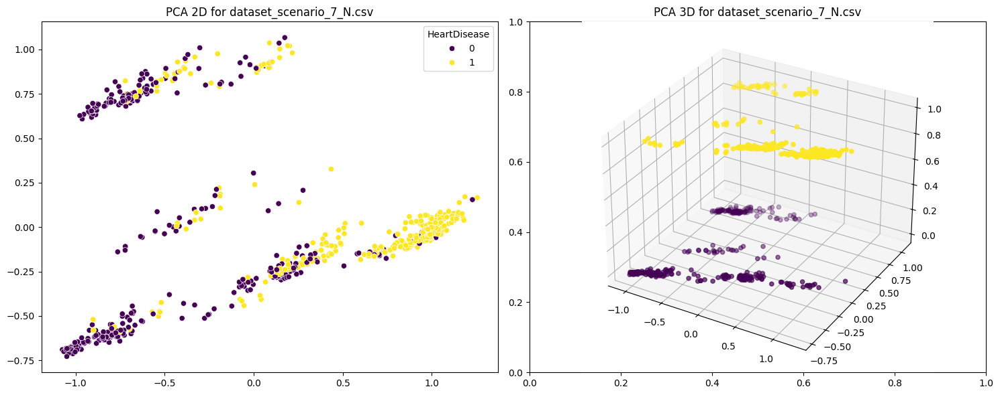

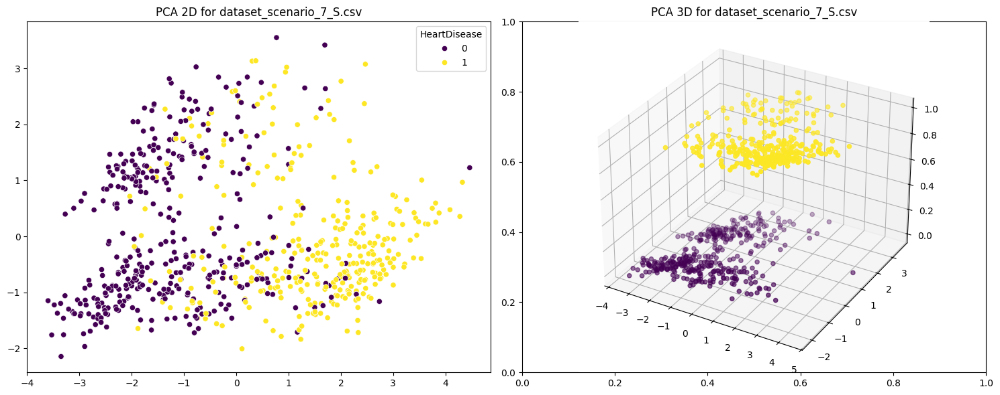

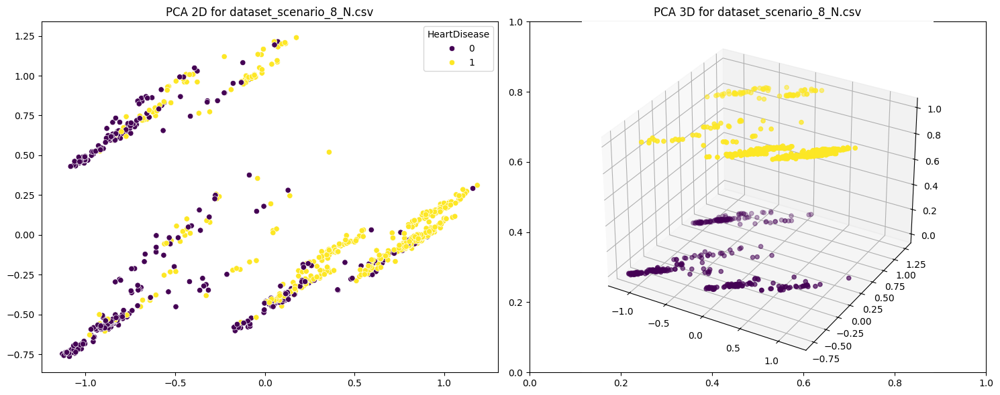

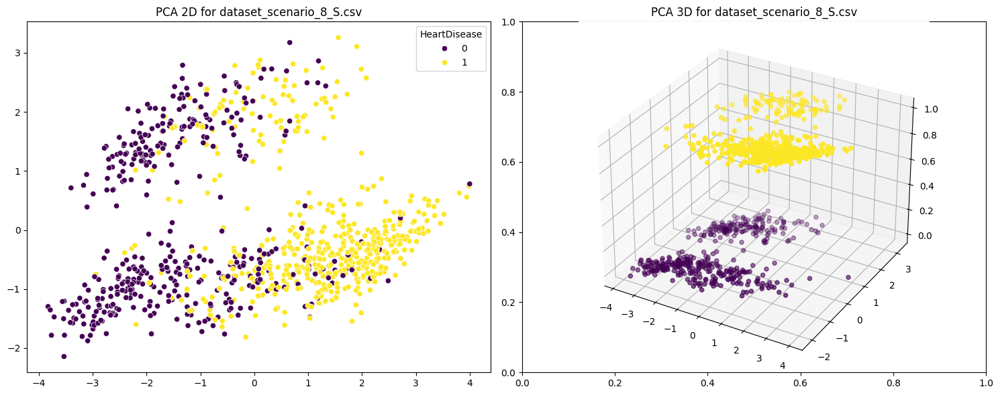

In [48]:
plot_pca_scenarios(list_of_scenarios, three_d=True)

# Modelling

In [49]:
scenario_datasets = os.listdir("./Scenarios")
scenario_datasets = [f"./Scenarios/{x}" for x in scenario_datasets]
scenario_datasets

['./Scenarios/dataset_scenario_1_N.csv',
 './Scenarios/dataset_scenario_1_S.csv',
 './Scenarios/dataset_scenario_2_N.csv',
 './Scenarios/dataset_scenario_2_S.csv',
 './Scenarios/dataset_scenario_3_N.csv',
 './Scenarios/dataset_scenario_3_S.csv',
 './Scenarios/dataset_scenario_4_N.csv',
 './Scenarios/dataset_scenario_4_S.csv',
 './Scenarios/dataset_scenario_5_N.csv',
 './Scenarios/dataset_scenario_5_S.csv',
 './Scenarios/dataset_scenario_6_N.csv',
 './Scenarios/dataset_scenario_6_S.csv',
 './Scenarios/dataset_scenario_7_N.csv',
 './Scenarios/dataset_scenario_7_S.csv',
 './Scenarios/dataset_scenario_8_N.csv',
 './Scenarios/dataset_scenario_8_S.csv']

In [50]:
scenarios_description = [
    {"name": "Scenario 1_N", "encoding": "Label encoding", "remove_outliers": False, "remove_errors": False, "scaling": "MinMax"},
    {"name": "Scenario 1_S", "encoding": "Label encoding", "remove_outliers": False, "remove_errors": False, "scaling": "Standard"},
    {"name": "Scenario 2_N", "encoding": "Label encoding", "remove_outliers": False, "remove_errors": False,
     "impute_zeros": {"RestingBP": "mean", "Cholesterol": "mean"}, "oldpeak_abs": True, "scaling": "MinMax"},
    {"name": "Scenario 2_S", "encoding": "Label encoding", "remove_outliers": False, "remove_errors": False,
     "impute_zeros": {"RestingBP": "mean", "Cholesterol": "mean"}, "oldpeak_abs": True, "scaling": "Standard"},
    {"name": "Scenario 3_N", "encoding": "Label encoding", "remove_outliers": True, "remove_errors": True, "scaling": "None"},
    {"name": "Scenario 3_S", "encoding": "Label encoding", "remove_outliers": True, "remove_errors": True, "scaling": "Standard"},
    {"name": "Scenario 4_N", "encoding": "Label encoding", "remove_outliers": "replace_with_mean", "remove_errors": True, "scaling": "MinMax"},
    {"name": "Scenario 4_S", "encoding": "Label encoding", "remove_outliers": "replace_with_mean", "remove_errors": True, "scaling": "Standard"},
    {"name": "Scenario 5_N", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": False, "remove_errors": False, "scaling": "MinMax"},
    {"name": "Scenario 5_S", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": False, "remove_errors": False, "scaling": "Standard"},
    {"name": "Scenario 6_N", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": False, "remove_errors": True, "scaling": "None"},
    {"name": "Scenario 6_S", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": False, "remove_errors": True, "scaling": "Standard"},
    {"name": "Scenario 7_N", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": True, "remove_errors": True, "scaling": "MinMax"},
    {"name": "Scenario 7_S", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": True, "remove_errors": True, "scaling": "Standard"},
    {"name": "Scenario 8_N", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": "replace_with_mean", "remove_errors": True, "scaling": "None"},
    {"name": "Scenario 8_S", "encoding": {"Sex": "Label", "ExerciseAngina": "Label", "ST_Slope": "Label", "RestingECG": "Label", "ChestPainType": "OneHot"},
     "remove_outliers": "replace_with_mean", "remove_errors": True, "scaling": "Standard"},
]


In [51]:
def get_search_hyperparameters(model_type):
    if model_type == "NaiveBayes":
        return {
            "var_smoothing": [1e-9, 1e-8, 1e-7, 1e-6, 1e-5],
            "priors": [None],
        }
    elif model_type == "SVM":
        return {
            "C": [0.1, 1, 10, 100, 1000],
            "gamma": [1, 0.1, 0.01, 0.001, 0.0001],
            "kernel": ["rbf", "linear", "poly", "sigmoid"],
        }
    elif model_type == "KNN":
        return {
            "n_neighbors": [3, 5, 7, 9, 11],  # Number of neighbors
            "weights": ["uniform", "distance"],  # Weighting scheme
            "metric": ["euclidean", "manhattan", "minkowski"],  # Distance metrics
        }
    elif model_type == "DecisionTree":
        return {
            "criterion": ["gini", "entropy", "log_loss"],  # Criterion for split
            "max_depth": [None, 10, 20, 30, 40, 50],  # Maximum depth of the tree
            "min_samples_split": [2, 5, 10],  # Minimum number of samples to split a node
            "min_samples_leaf": [1, 2, 4],  # Minimum number of samples per leaf node
        }
    else:
        return {}


In [52]:
class optuna_tuner:
    def __init__(self, model, X_train, y_train, direction="maximize", n_trials=100, n_jobs=-1, scoring="accuracy", cv=5):
        self.model = model
        self.X_train = X_train
        self.y_train = y_train
        self.direction = direction
        self.n_trials = n_trials
        self.n_jobs = n_jobs
        self.scoring = scoring
        self.cv = cv

    def objective(self, trial):
        # Handle Naive Bayes
        if isinstance(self.model, GaussianNB):
            model = GaussianNB(
                var_smoothing=trial.suggest_float("var_smoothing", 1e-9, 1e-5)
            )
        
        # Handle SVM
        elif isinstance(self.model, SVC):
            model = SVC(
                C=trial.suggest_float("C", 1e-3, 10),
                gamma=trial.suggest_float("gamma", 1e-3, 10),
                kernel=trial.suggest_categorical("kernel", ["rbf", "linear", "poly", "sigmoid"]),
            )
        
        # Handle KNN
        elif isinstance(self.model, KNeighborsClassifier):
            model = KNeighborsClassifier(
                n_neighbors=trial.suggest_int("n_neighbors", 3, 15),
                weights=trial.suggest_categorical("weights", ["uniform", "distance"]),
                metric=trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"]),
            )

        # Handle Decision Tree
        elif isinstance(self.model, DecisionTreeClassifier):
            model = DecisionTreeClassifier(
                criterion=trial.suggest_categorical("criterion", ["gini", "entropy", "log_loss"]),
                max_depth=trial.suggest_int("max_depth", 5, 50),
                min_samples_split=trial.suggest_int("min_samples_split", 2, 10),
                min_samples_leaf=trial.suggest_int("min_samples_leaf", 1, 5),
            )
        
        else:
            raise ValueError("Unsupported model type for optimization.")

        # Perform cross-validation and return the mean score
        scores = cross_val_score(model, self.X_train, self.y_train, cv=self.cv, scoring=self.scoring, n_jobs=self.n_jobs)
        return scores.mean()

    def optimize_study(self):
        study = optuna.create_study(direction=self.direction)
        study.optimize(self.objective, n_trials=self.n_trials)
        return study.best_params


In [53]:
class ModelTrainer:
    def __init__(self, dataset, target_column, model):
        self.dataset = dataset
        self.target_column = target_column
        self.X = dataset.drop(target_column, axis=1)
        self.y = dataset[target_column]
        self.model = model
        self.results = {}

    def split_data(self, test_size=0.2, val_size=0.1, random_state=42):
        X_train, X_temp, y_train, y_temp = train_test_split(
            self.X, self.y, test_size=test_size + val_size, random_state=random_state
        )
        val_ratio = val_size / (test_size + val_size)
        self.X_val, self.X_test, self.y_val, self.y_test = train_test_split(
            X_temp, y_temp, test_size=val_ratio, random_state=random_state
        )
        self.X_train, self.y_train = X_train, y_train
        
    def train(self):
        self.model.fit(self.X_train, self.y_train)

    def tune_and_train(self,search_type , search_config, param_grid):

        clf = self.model
        if search_type == "grid":
            search = GridSearchCV(clf, param_grid, cv=search_config["cv"], scoring=search_config["scoring"])
        elif search_type == "random":
            search = RandomizedSearchCV(clf, param_grid, cv=search_config["cv"], scoring=search_config["scoring"], n_iter=search_config["n_iter"])
        elif search_type == "optuna":
            search = optuna_tuner(self.model, self.X_train, self.y_train, search_config["direction"], search_config["n_trials"], search_config["n_jobs"], search_config["scoring"], search_config["cv"])

        best_params = None
        if isinstance(search, optuna_tuner):
            best_params = search.optimize_study()
            self.model = self.model.set_params(**best_params)
            self.model.fit(self.X_train, self.y_train)
        elif search_type == "grid" or search_type == "random":
            search.fit(self.X_train, self.y_train)
            best_params = search.best_params_
            self.model = search.best_estimator_

        print("Best hyperparameters: ", best_params)
        
        return best_params

        # TODO: Get scores for train, val, and test sets

    def test_and_evaluate(self, save_dir=None):
        # Predict on validation and test sets
        y_val_pred = self.model.predict(self.X_val)
        y_test_pred = self.model.predict(self.X_test)

        # Calculate metrics for validation and test sets
        metrics_val = {
            "accuracy": accuracy_score(self.y_val, y_val_pred),
            "precision": precision_score(self.y_val, y_val_pred, average="weighted"),
            "recall": recall_score(self.y_val, y_val_pred, average="weighted"),
            "f1_score": f1_score(self.y_val, y_val_pred, average="weighted"),
            "confusion_matrix": confusion_matrix(self.y_val, y_val_pred),
        }

        metrics_test = {
            "accuracy": accuracy_score(self.y_test, y_test_pred),
            "precision": precision_score(self.y_test, y_test_pred, average="weighted"),
            "recall": recall_score(self.y_test, y_test_pred, average="weighted"),
            "f1_score": f1_score(self.y_test, y_test_pred, average="weighted"),
            "confusion_matrix": confusion_matrix(self.y_test, y_test_pred),
        }

        # Store results
        self.results["validation"] = metrics_val
        self.results["test"] = metrics_test

        # Print evaluation metrics
        print("Validation Metrics:")
        print(f"  Accuracy: {metrics_val['accuracy']:.4f}")
        print(f"  Precision: {metrics_val['precision']:.4f}")
        print(f"  Recall: {metrics_val['recall']:.4f}")
        print(f"  F1 Score: {metrics_val['f1_score']:.4f}")
        print("\nTest Metrics:")
        print(f"  Accuracy: {metrics_test['accuracy']:.4f}")
        print(f"  Precision: {metrics_test['precision']:.4f}")
        print(f"  Recall: {metrics_test['recall']:.4f}")
        print(f"  F1 Score: {metrics_test['f1_score']:.4f}")

        # Confusion matrix visualization for test set
        print("\nConfusion Matrix (Test Set):")
        cm = metrics_test["confusion_matrix"]
        print(cm)
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=True, yticklabels=True)
        plt.title("Confusion Matrix - Test Set")
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        if save_dir:
            os.makedirs(save_dir, exist_ok=True)
            plt.savefig(os.path.join(save_dir, "confusion_matrix.png"))
        plt.show()
        
        return metrics_test

    def plot_results(self, save_dir=None):
        # Create the directory if saving is required
        if save_dir:
            os.makedirs(save_dir, exist_ok=True)

        # Plot Accuracy Comparison
        if "validation" in self.results and "test" in self.results:
            accuracies = {
                "Validation": self.results["validation"]["accuracy"],
                "Test": self.results["test"]["accuracy"],
            }
            plt.figure(figsize=(6, 4))
            plt.bar(accuracies.keys(), accuracies.values(), color=["skyblue", "lightgreen"])
            plt.title("Accuracy Comparison")
            plt.ylabel("Accuracy")
            plt.ylim(0, 1)
            for i, v in enumerate(accuracies.values()):
                plt.text(i, v + 0.02, f"{v:.2f}", ha="center")
            if save_dir:
                plt.savefig(os.path.join(save_dir, "accuracy_comparison.png"))
            plt.show()

        # Confusion Matrix Heatmap for Test Set
        y_test_pred = self.model.predict(self.X_test)
        cm = confusion_matrix(self.y_test, y_test_pred)
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=True, yticklabels=True)
        plt.title("Confusion Matrix - Test Set")
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        if save_dir:
            plt.savefig(os.path.join(save_dir, "confusion_matrix_heatmap.png"))
        plt.show()

        # Plot Class-wise Precision, Recall, and F1-Score
        if hasattr(self.model, "classes_"):  # Ensure the model supports classes_
            report = classification_report(self.y_test, y_test_pred, output_dict=True)
            metrics = ["precision", "recall", "f1-score"]
            class_names = list(report.keys())[:-3]  # Exclude avg/total keys
            class_metrics = {metric: [report[class_name][metric] for class_name in class_names] for metric in metrics}

            for metric, values in class_metrics.items():
                plt.figure(figsize=(8, 4))
                plt.bar(class_names, values, color="lightcoral")
                plt.title(f"{metric.capitalize()} by Class")
                plt.ylabel(metric.capitalize())
                plt.ylim(0, 1)
                for i, v in enumerate(values):
                    plt.text(i, v + 0.02, f"{v:.2f}", ha="center")
                if save_dir:
                    plt.savefig(os.path.join(save_dir, f"{metric}_by_class.png"))
                plt.show()


In [54]:
search_config_grid = {
    "cv": 5,
    "scoring": "accuracy",
}
search_config_random = {
    "cv": 5,
    "scoring": "accuracy",
    "n_iter": 50,
}
search_config_optuna = {
    "direction": "maximize",
    "n_trials": 100,
    "n_jobs": -1,
    "scoring": "accuracy",
    "cv": 5,
}

target_column = "HeartDisease"

In [55]:
def run_scenario(scenario, model_type, search_type, search_config, param_grid):
    # Load the dataset
    dataset = pd.read_csv(scenario)
    model = None

    # Initialize the model based on the model_type
    if model_type == "NaiveBayes":
        model = GaussianNB()
    elif model_type == "SVM":
        model = SVC()
    elif model_type == "KNN":
        model = KNeighborsClassifier()
    elif model_type == "DecisionTree":
        model = DecisionTreeClassifier()
    else:
        raise ValueError(f"Model type {model_type} is not supported.")

    # Create a directory for saving plots and results
    scenario_name = os.path.splitext(os.path.basename(scenario))[0]  # Extract scenario name from file
    save_dir = os.path.join("SCORES", model_type, search_type, scenario_name)  # SCORES as top-level directory
    os.makedirs(save_dir, exist_ok=True)

    print(f"Running {model_type} with {search_type} for {scenario_name}...")
    print(f"Results will be saved in: {save_dir}")

    # Initialize the trainer
    trainer = ModelTrainer(dataset, target_column, model)
    trainer.split_data()

    # Train and tune the model
    if search_type:
        best_params = trainer.tune_and_train(search_type, search_config, param_grid)
    else:
        trainer.train()  # Train without hyperparameter tuning

    # Evaluate the model
    metric_test = trainer.test_and_evaluate(save_dir=save_dir)

    # Plot results for the current scenario
    trainer.plot_results(save_dir=save_dir)

    print(f"Scenario {scenario_name} with {search_type} completed and results saved.\n")
    
    return metric_test, best_params


In [56]:
def save_models(model, model_name, search_method):
    os.makedirs("./best_models", exist_ok=True)
    os.makedirs(f"./best_models/{model_name}", exist_ok=True)
    os.makedirs(f"./best_models/{model_name}/{search_method}", exist_ok=True)
    with open(f"./best_models/{model_name}/{search_method}/model_{search_method}.pkl", "wb") as f:
        pkl.dump(model, f)

def save_model_info(model_info, model_name, search_method):
    os.makedirs("./best_models", exist_ok=True)
    os.makedirs(f"./best_models/{model_name}", exist_ok=True)
    os.makedirs(f"./best_models/{model_name}/{search_method}", exist_ok=True)
    with open(f"./best_models/{model_name}/{search_method}/model_info_{search_method}.json", "w") as f:
        json.dump(model_info, f)

# Naive Bayes

## 1. Grid Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with grid for dataset_scenario_1_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_1_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


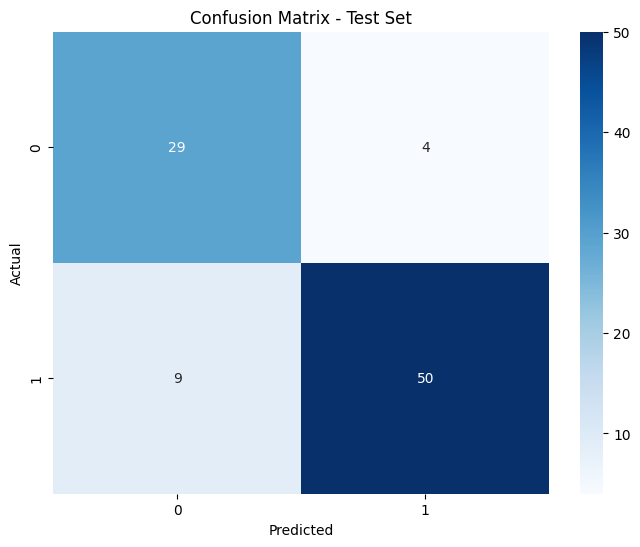

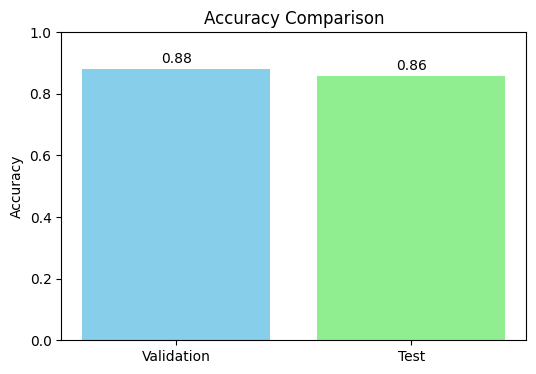

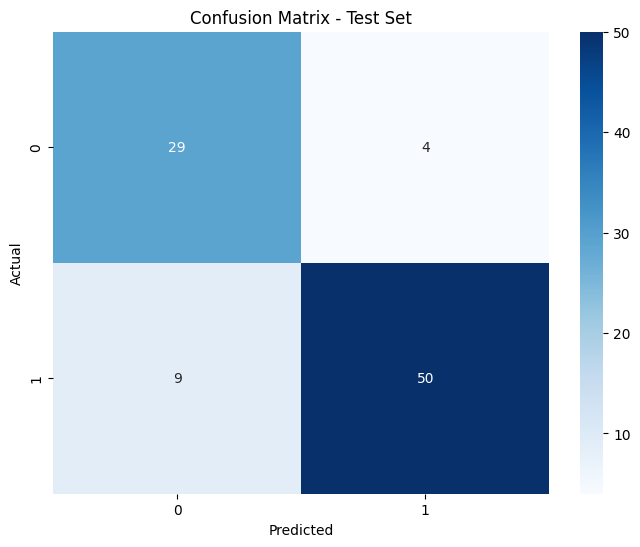

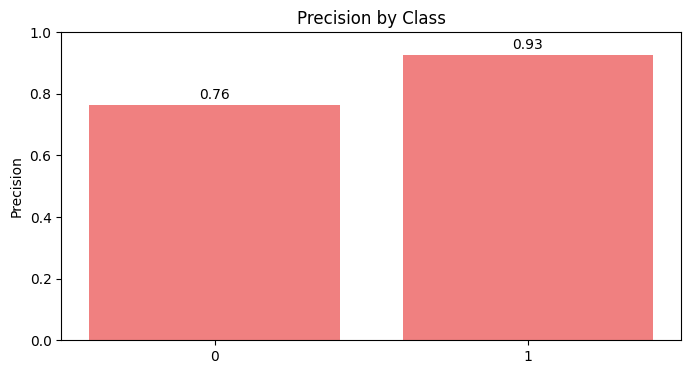

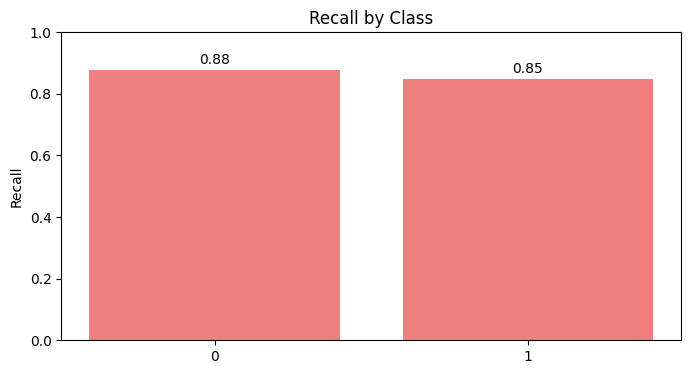

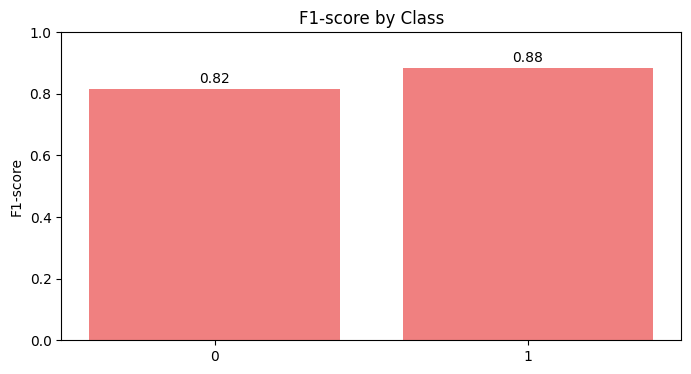

Scenario dataset_scenario_1_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_1_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_1_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


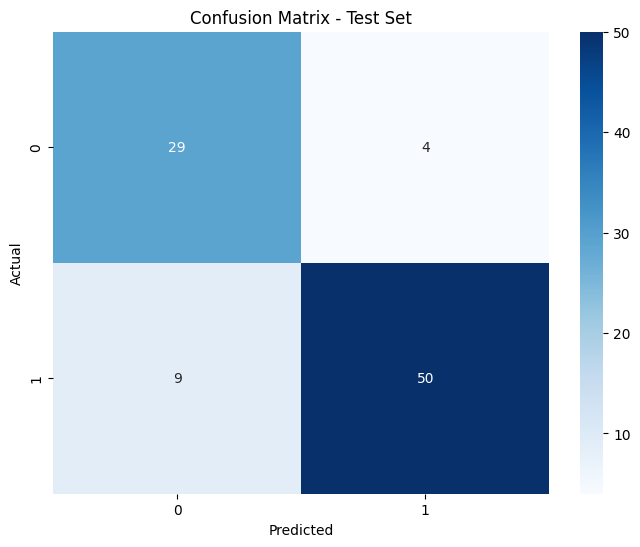

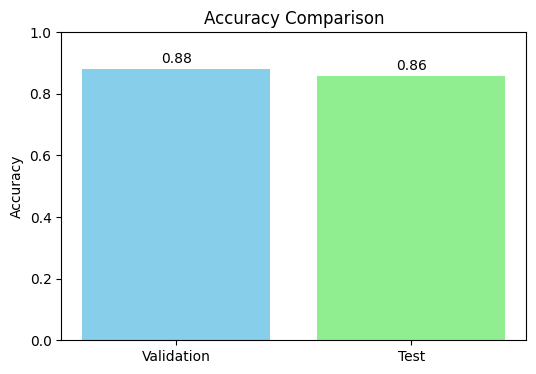

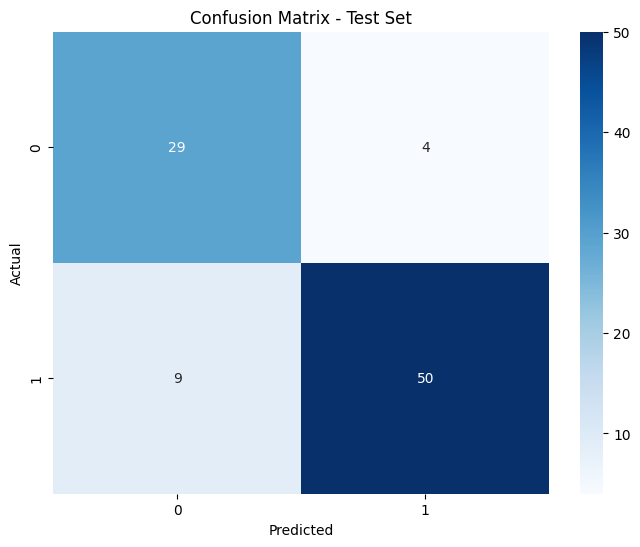

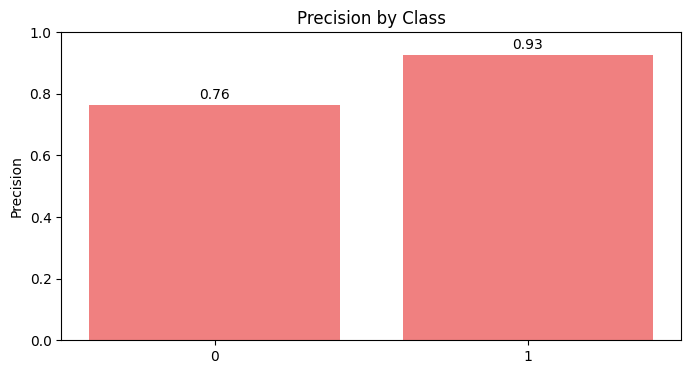

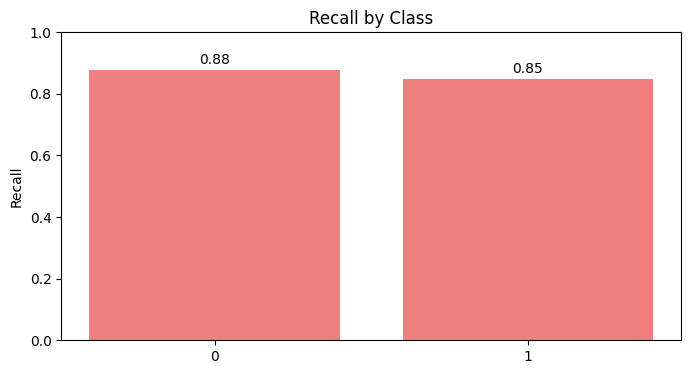

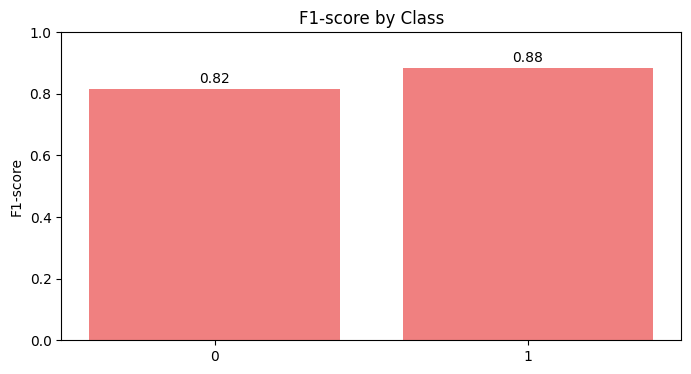

Scenario dataset_scenario_1_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running NaiveBayes with grid for dataset_scenario_2_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_2_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


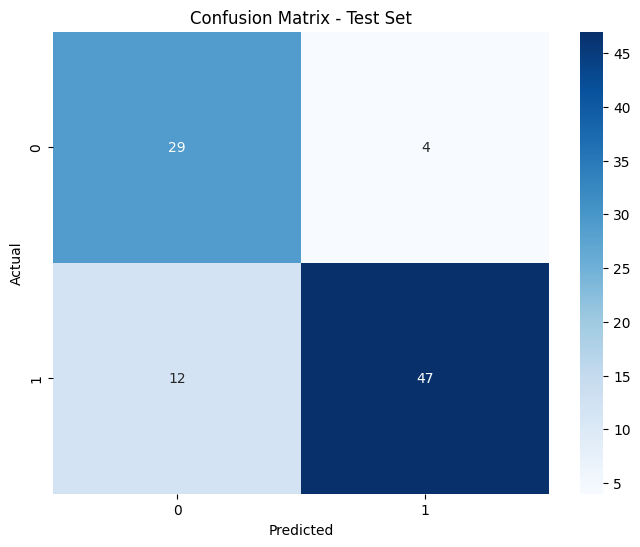

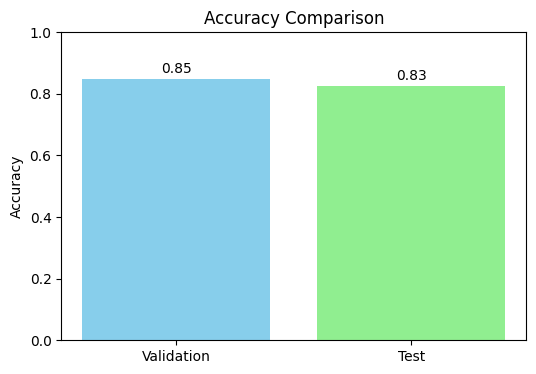

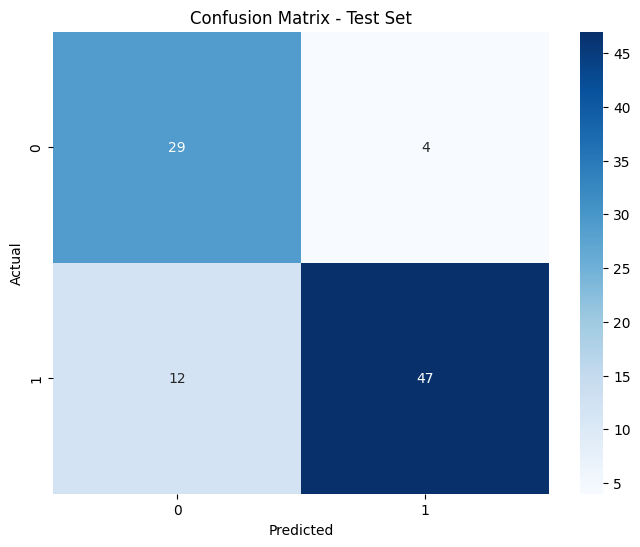

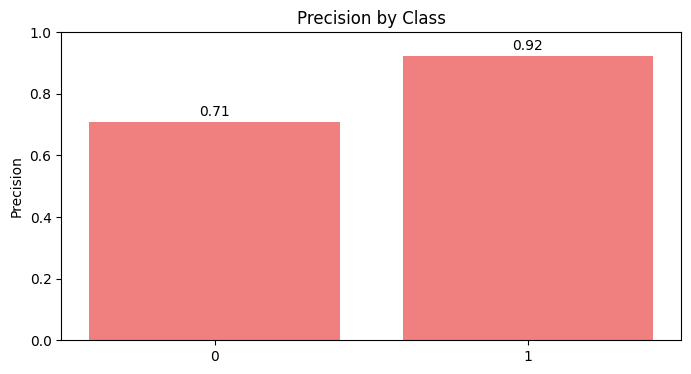

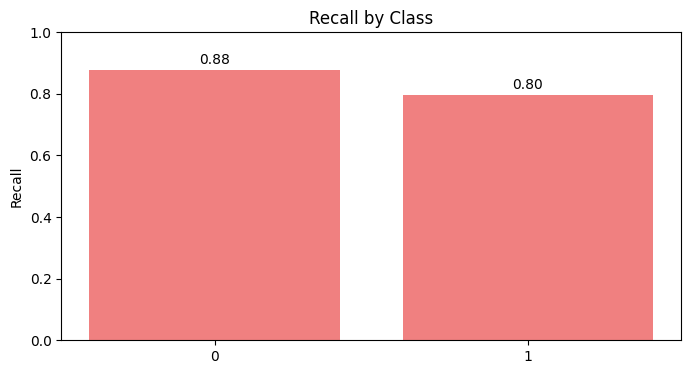

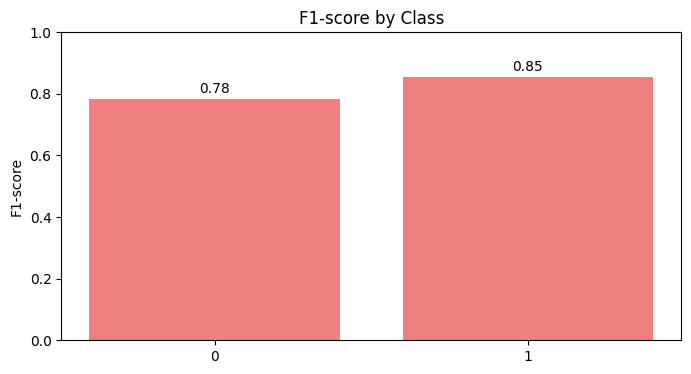

Scenario dataset_scenario_2_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_2_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_2_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


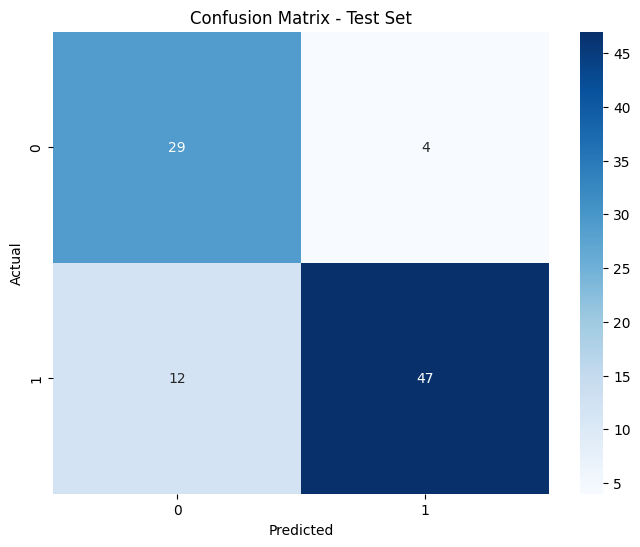

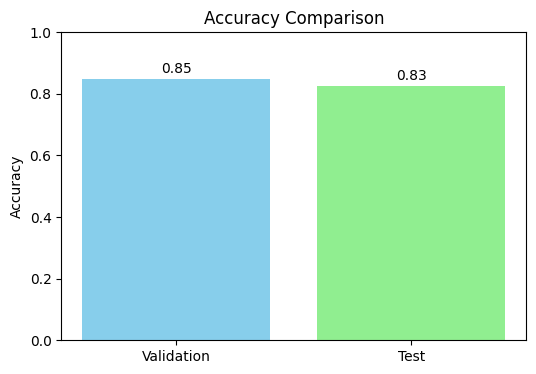

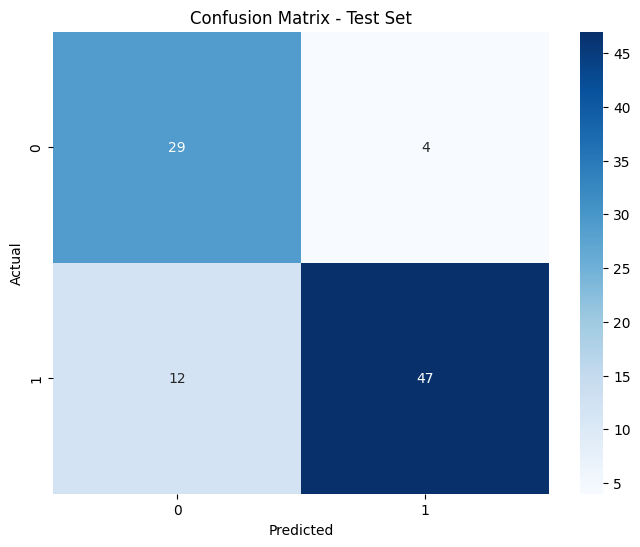

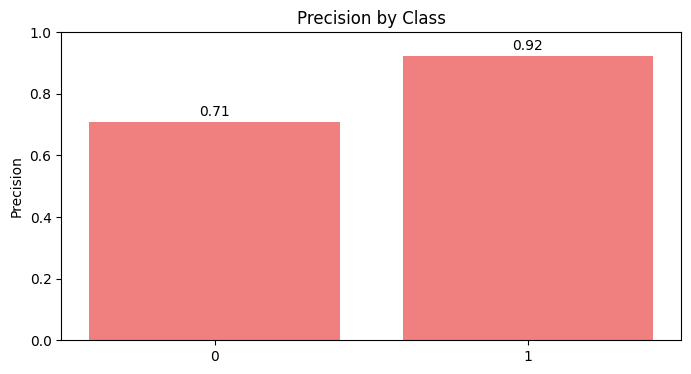

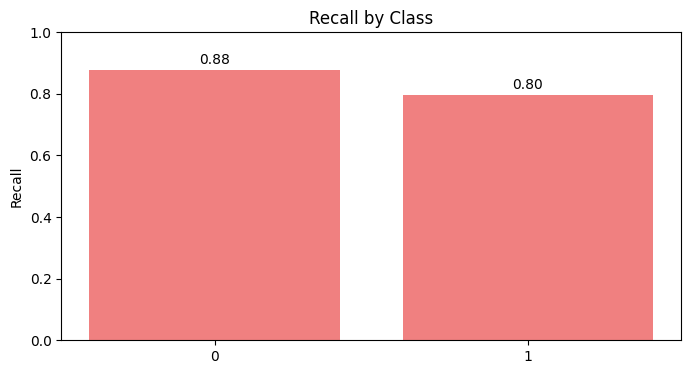

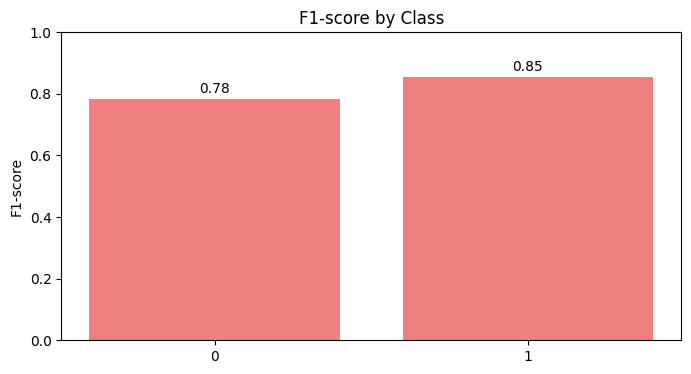

Scenario dataset_scenario_2_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with grid for dataset_scenario_3_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_3_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


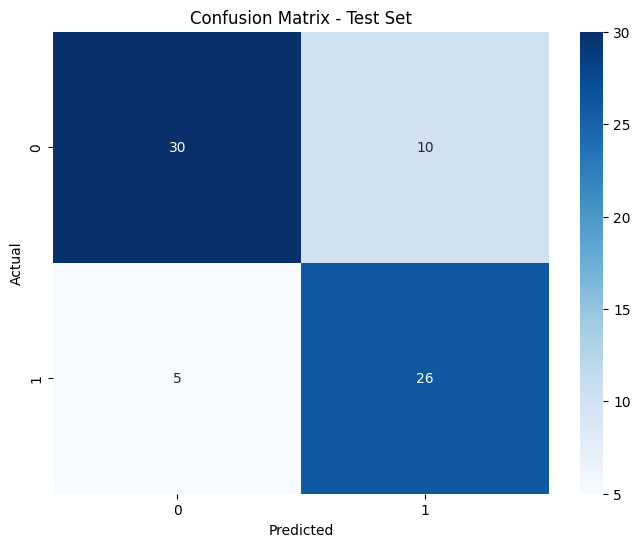

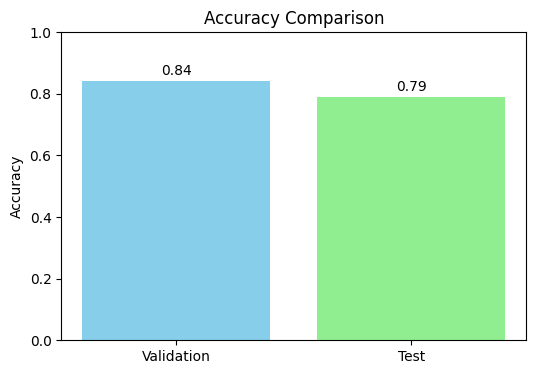

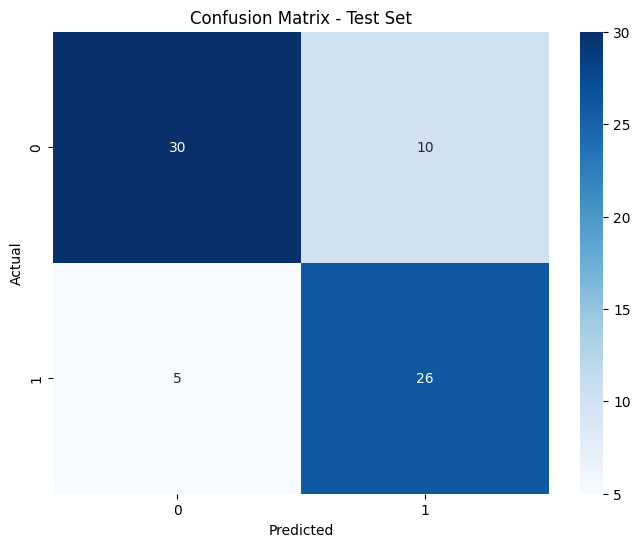

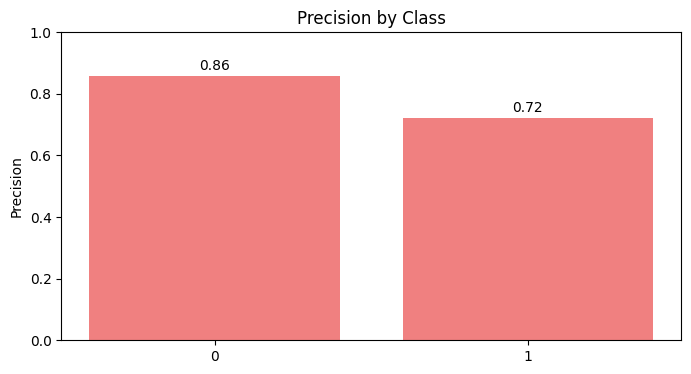

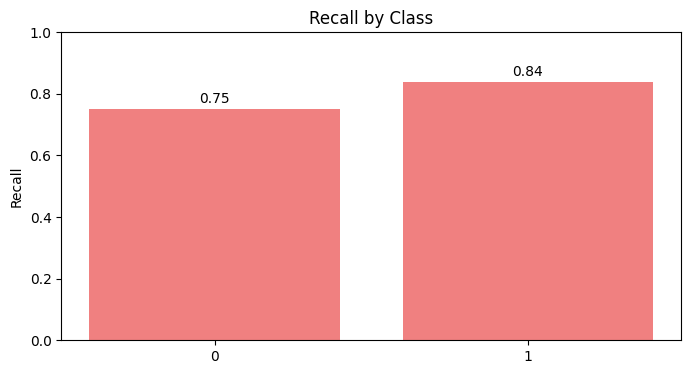

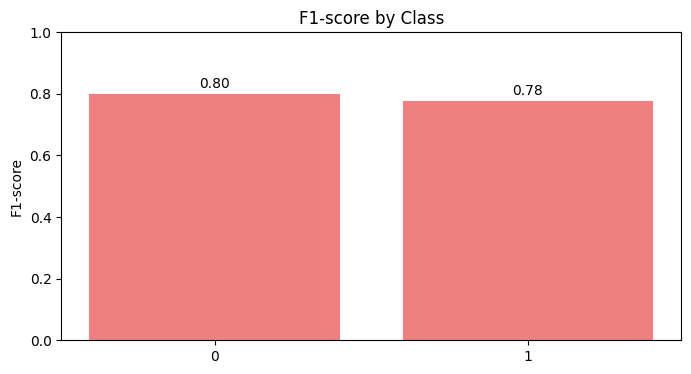

Scenario dataset_scenario_3_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_3_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_3_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


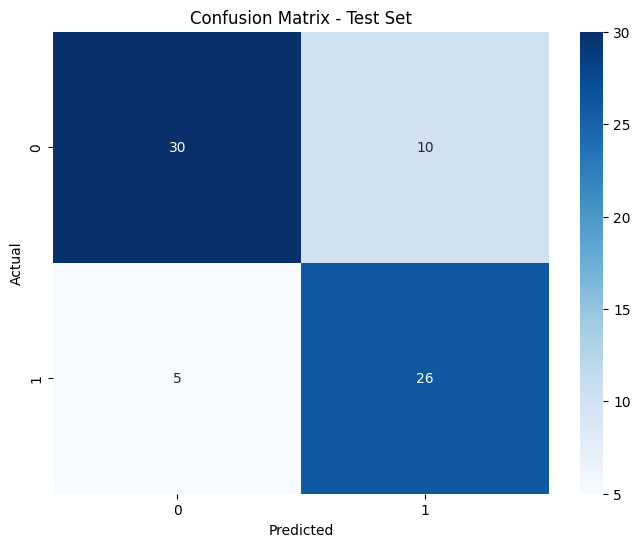

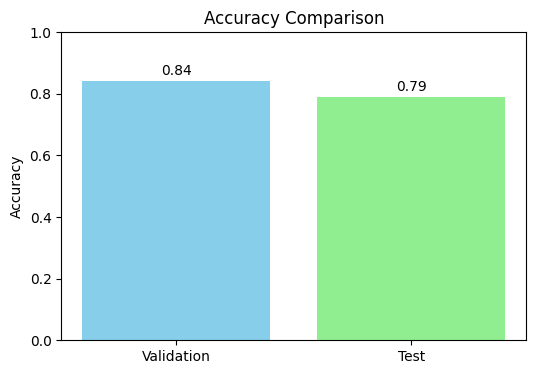

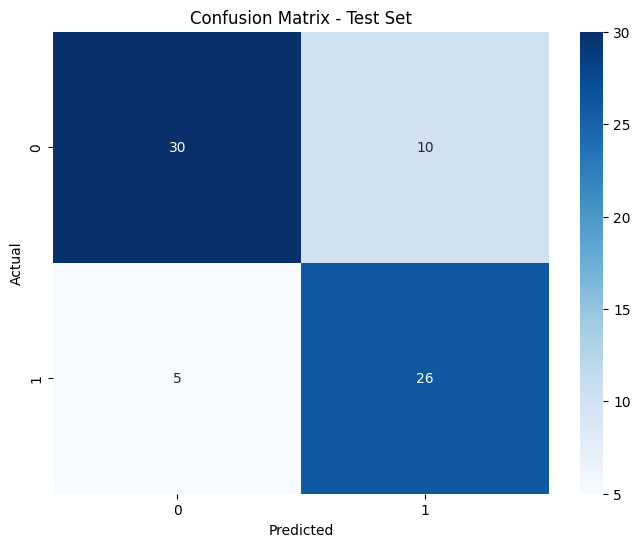

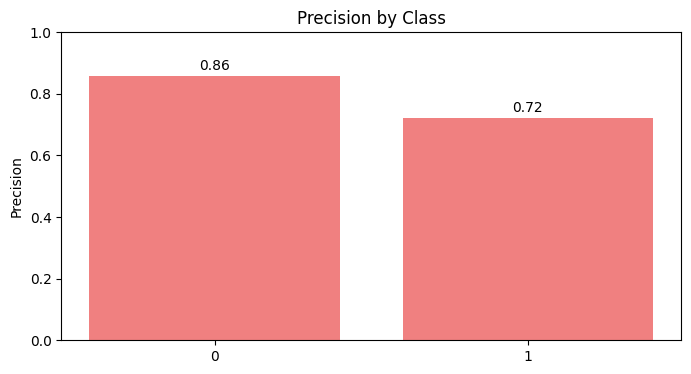

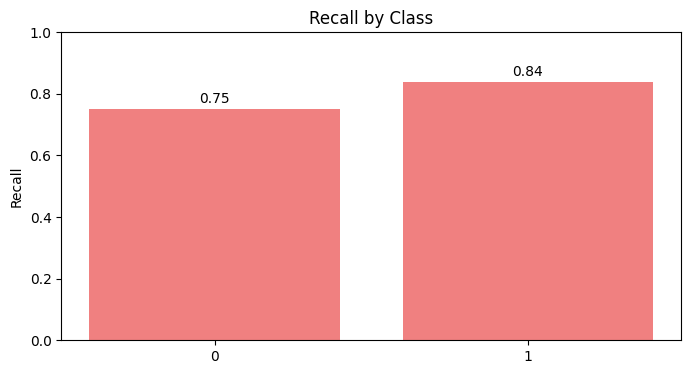

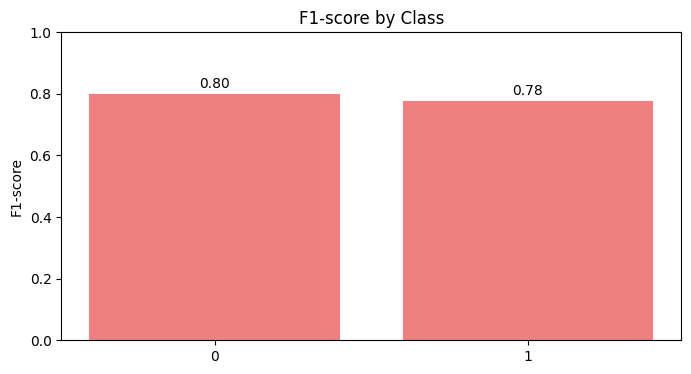

Scenario dataset_scenario_3_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with grid for dataset_scenario_4_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_4_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


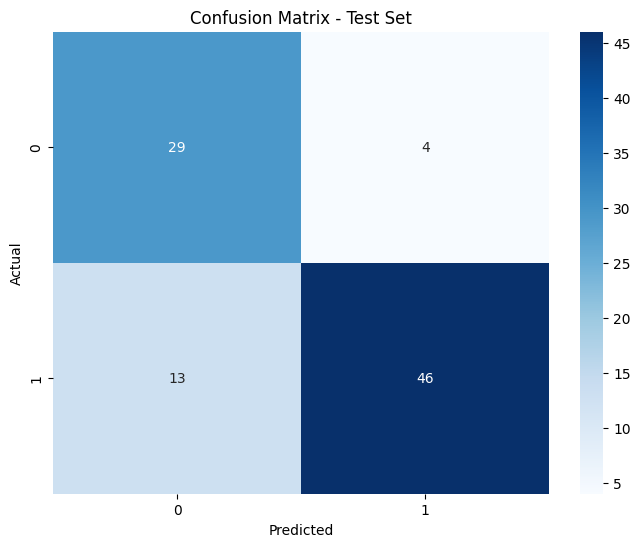

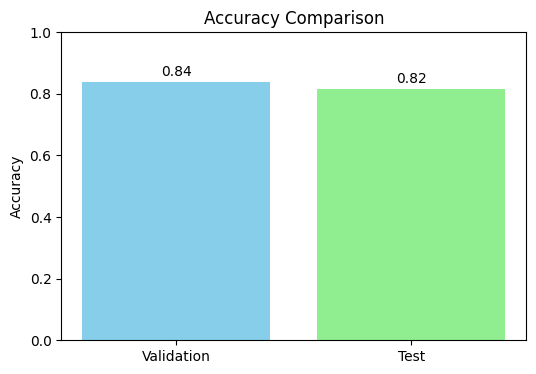

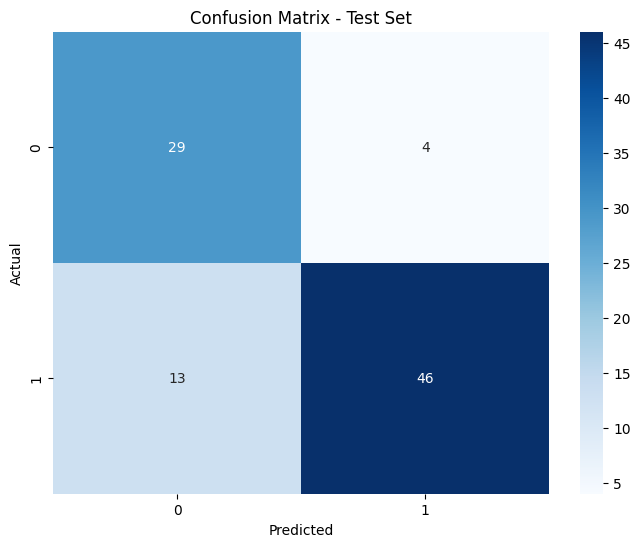

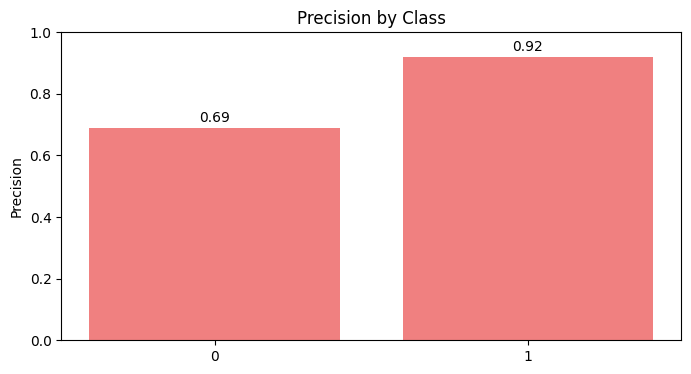

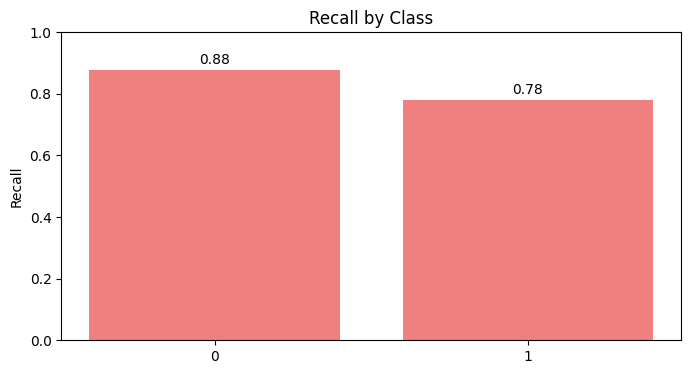

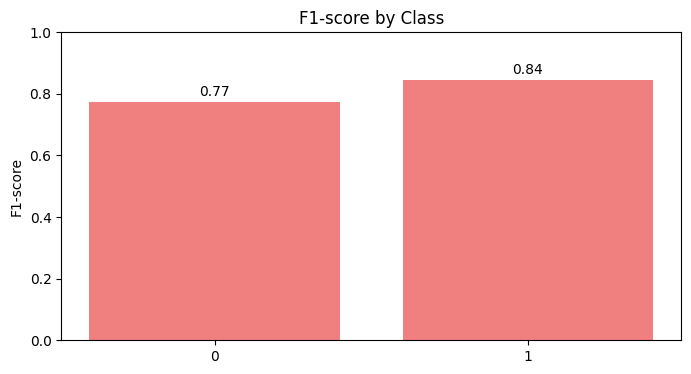

Scenario dataset_scenario_4_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_4_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_4_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


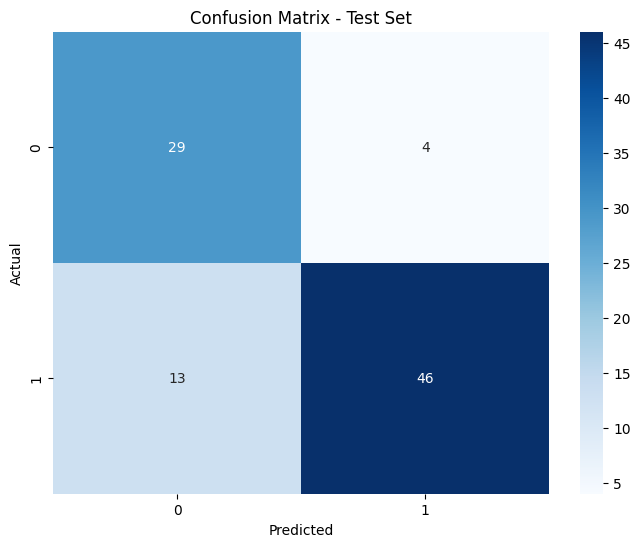

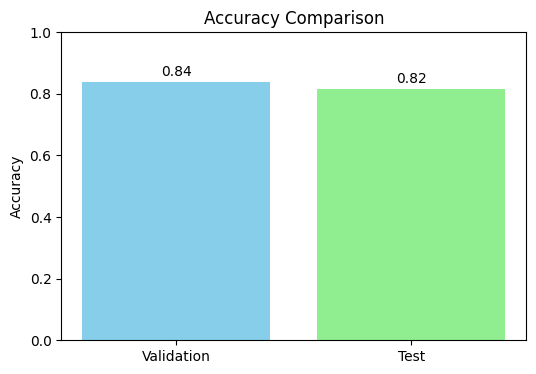

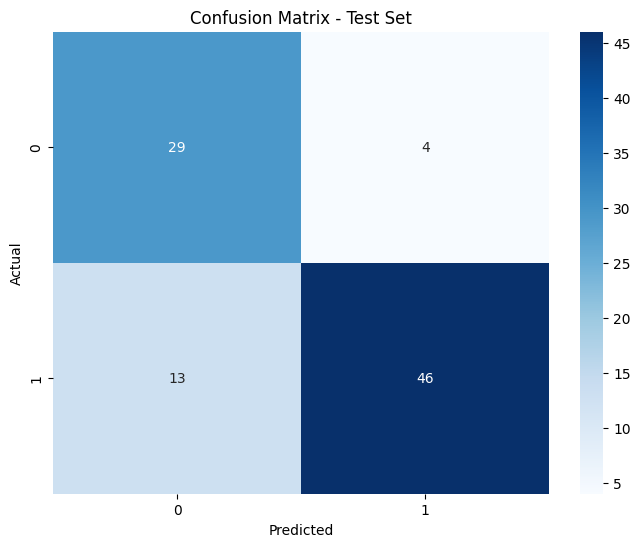

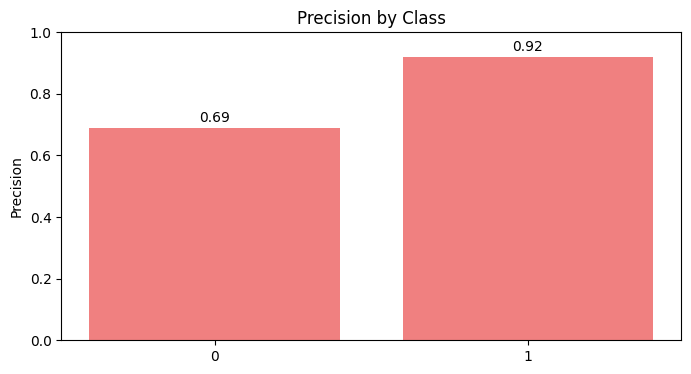

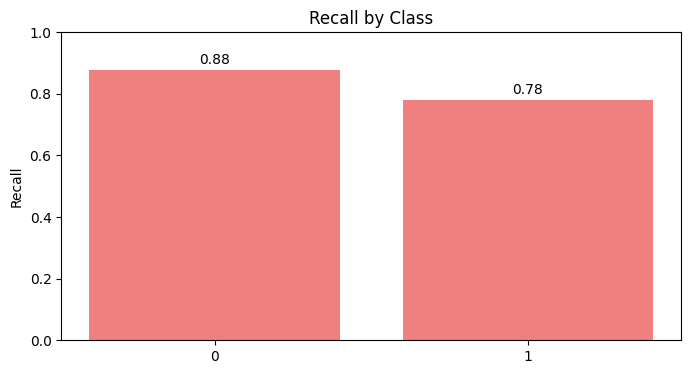

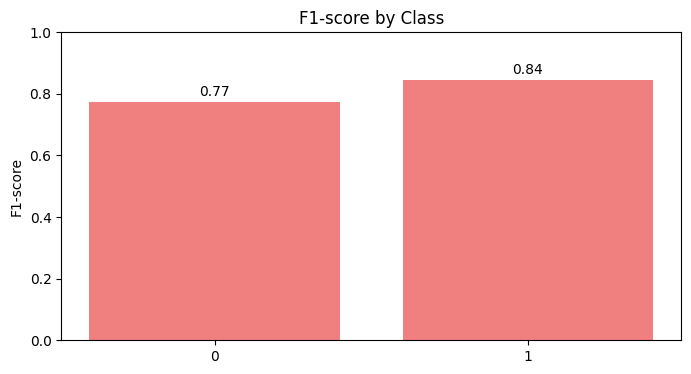

Scenario dataset_scenario_4_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with grid for dataset_scenario_5_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_5_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


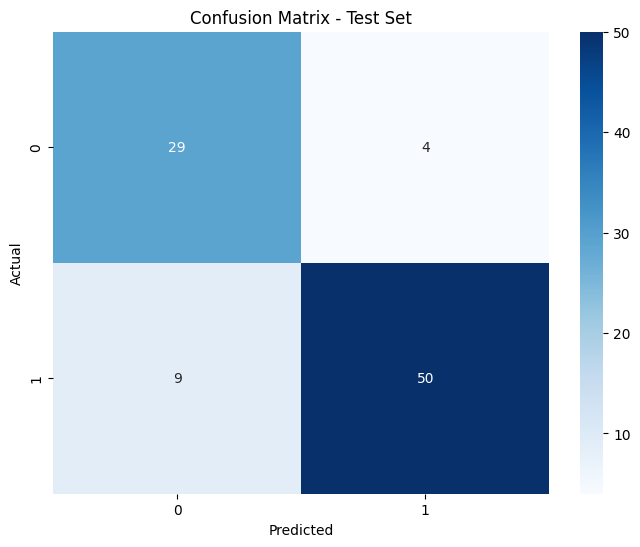

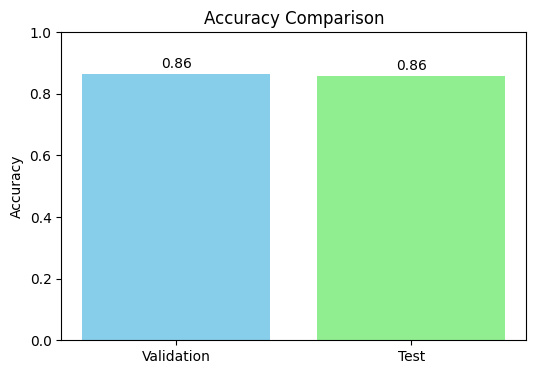

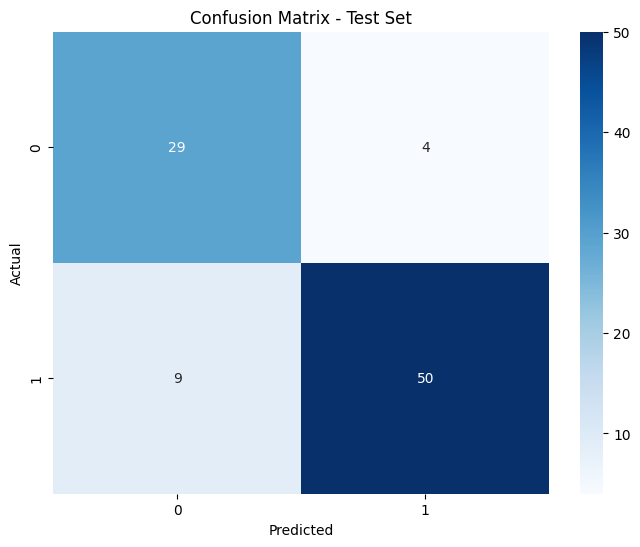

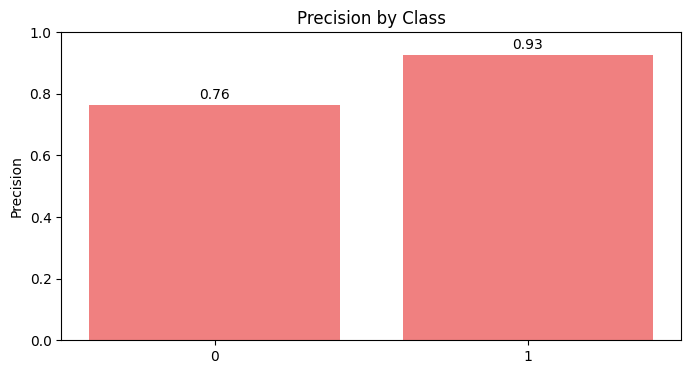

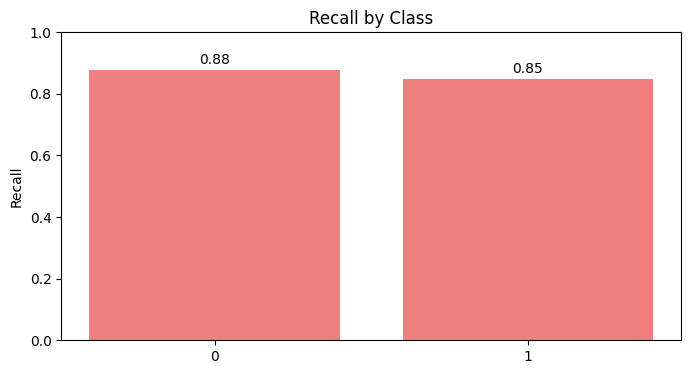

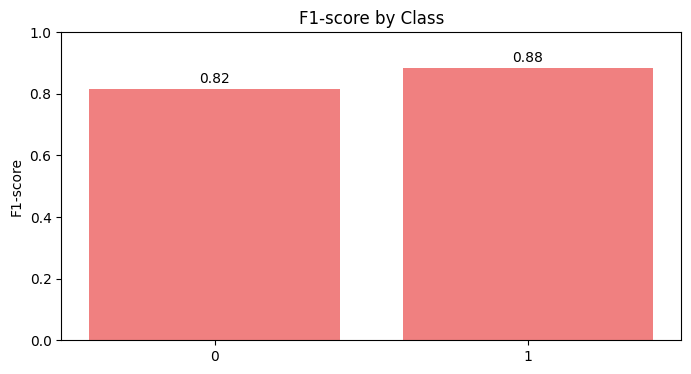

Scenario dataset_scenario_5_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_5_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_5_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


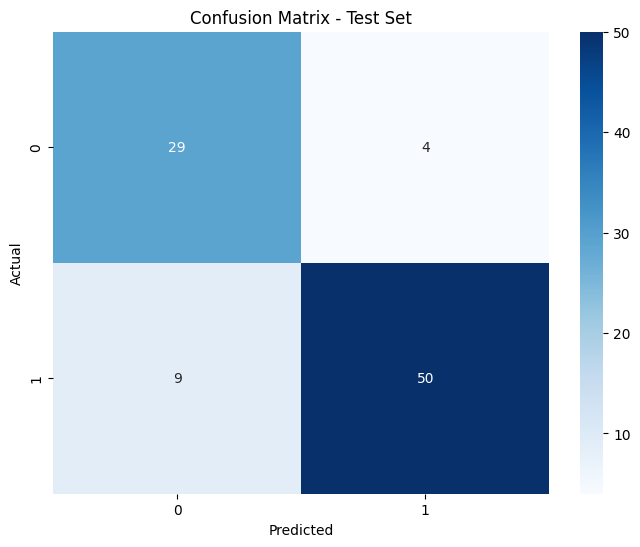

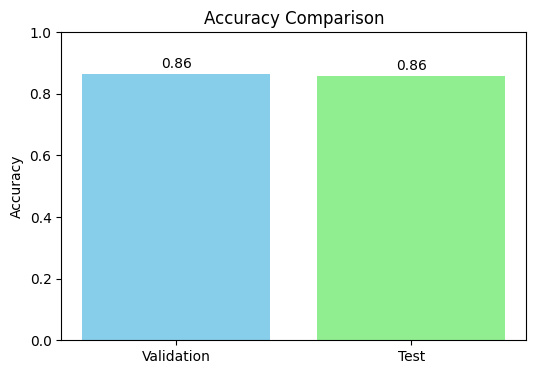

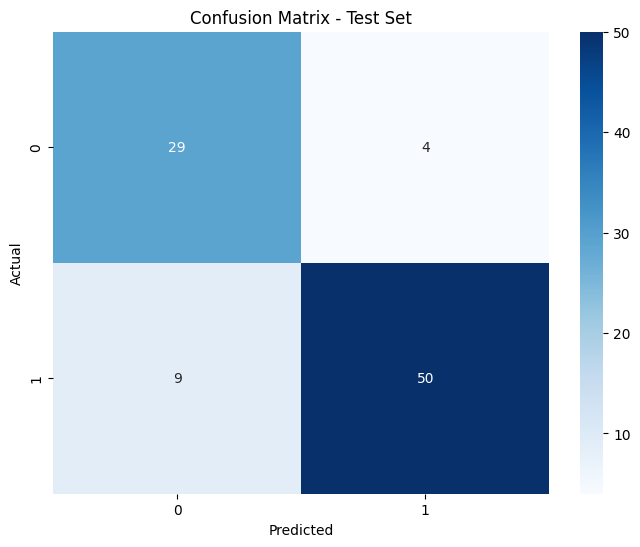

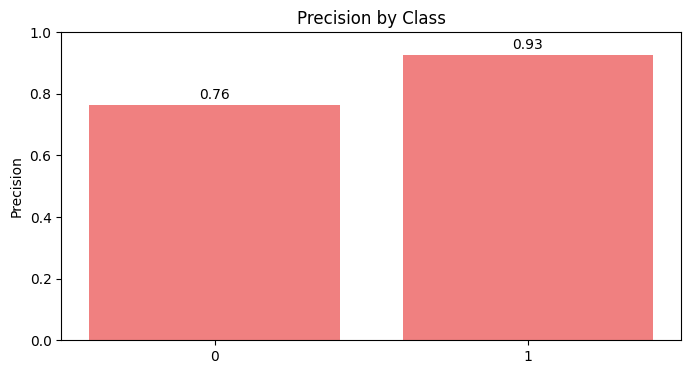

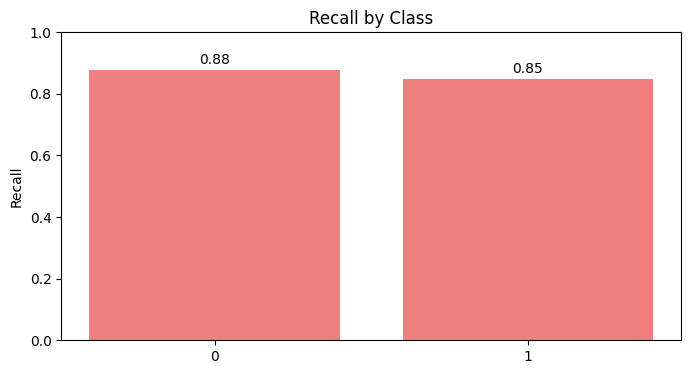

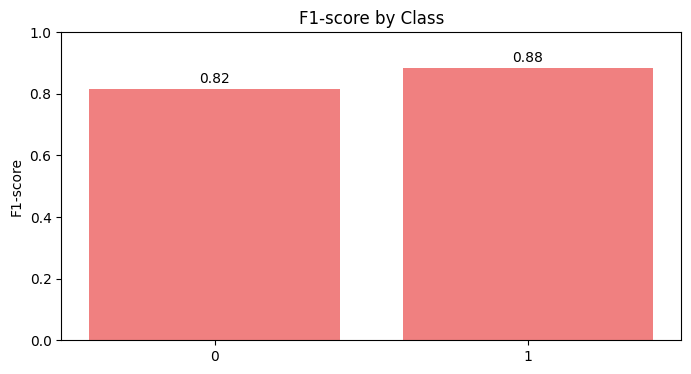

Scenario dataset_scenario_5_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with grid for dataset_scenario_6_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_6_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


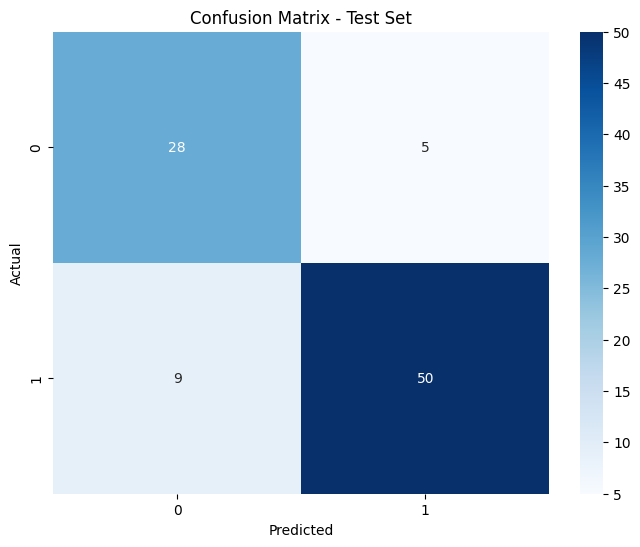

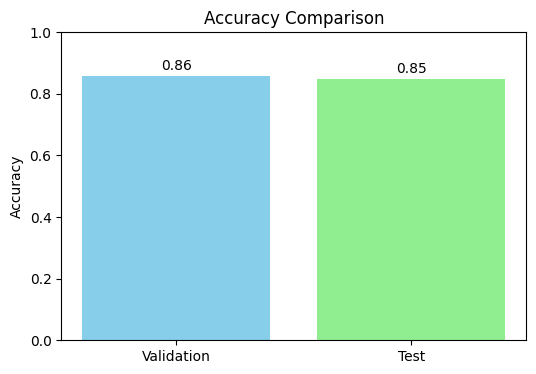

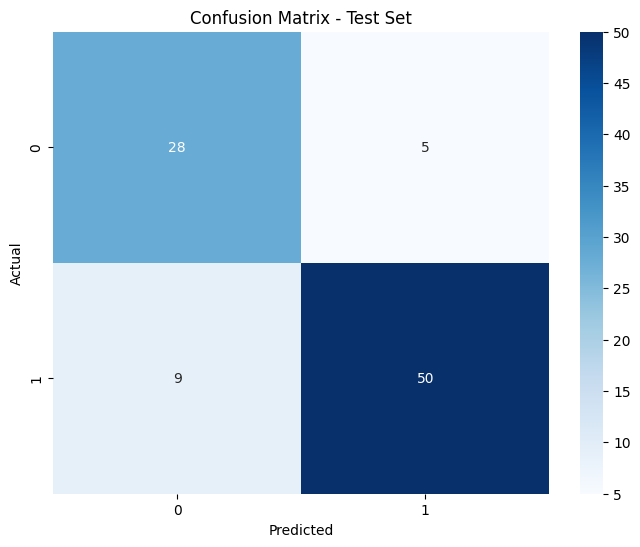

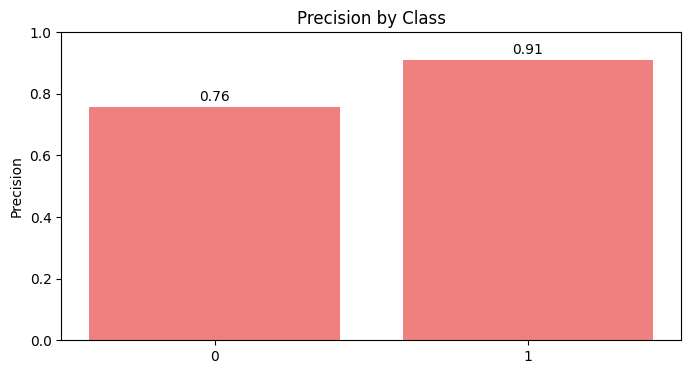

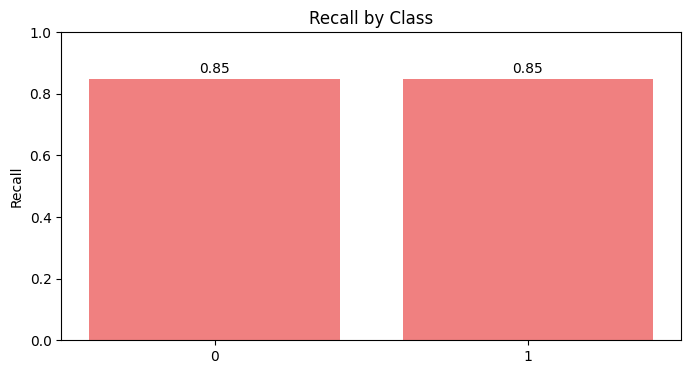

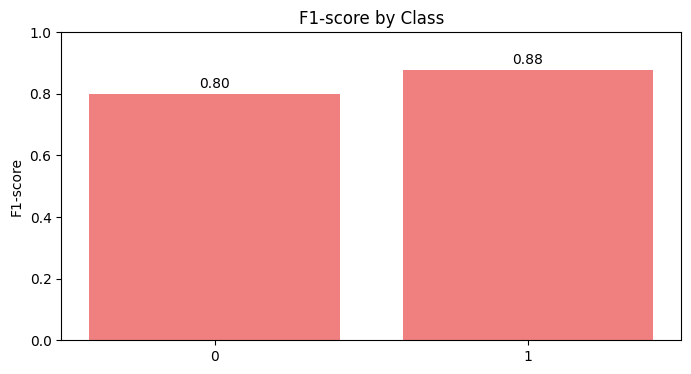

Scenario dataset_scenario_6_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_6_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_6_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


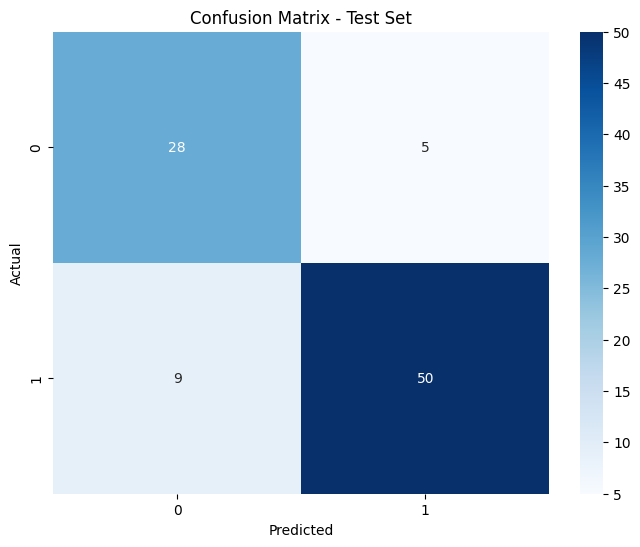

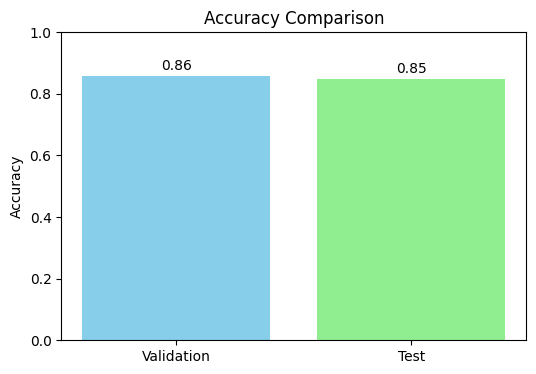

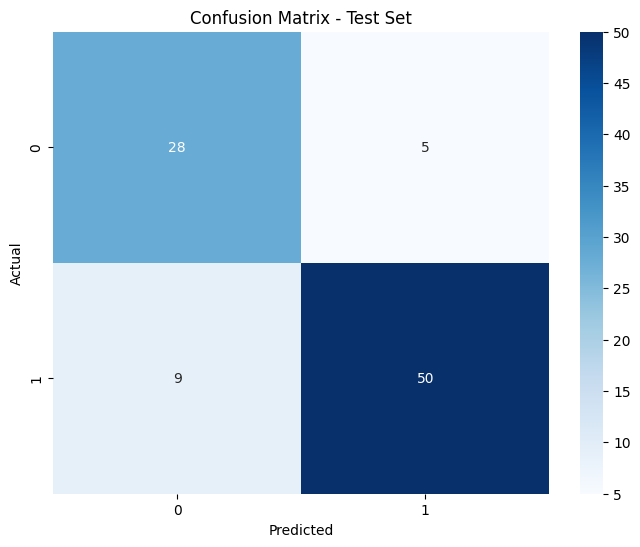

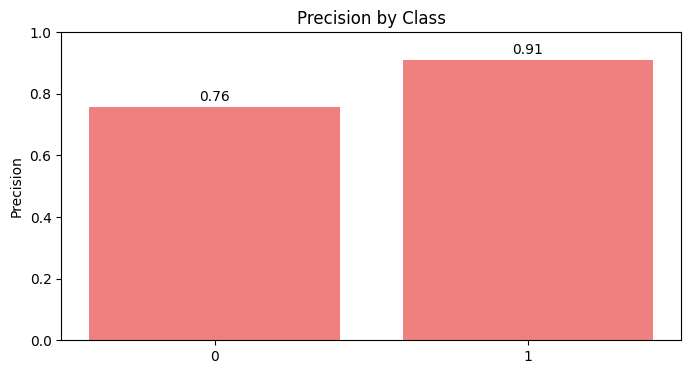

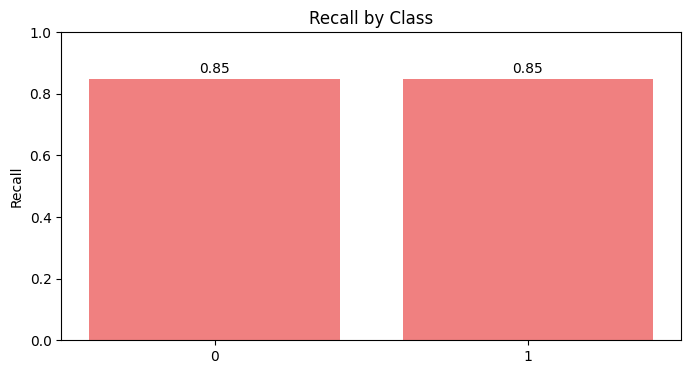

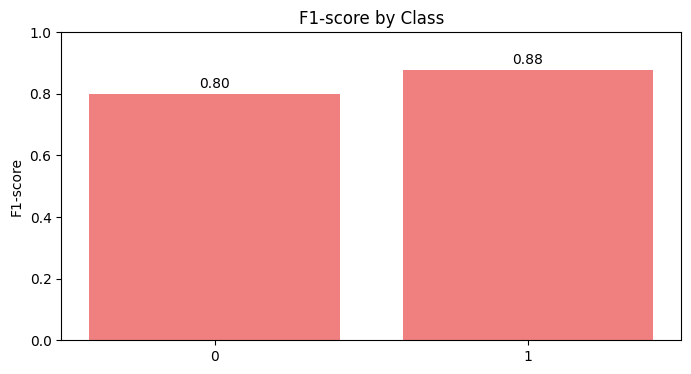

Scenario dataset_scenario_6_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with grid for dataset_scenario_7_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_7_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


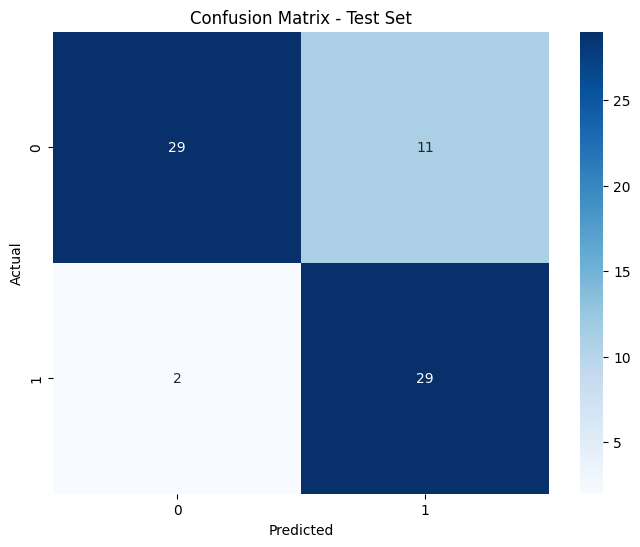

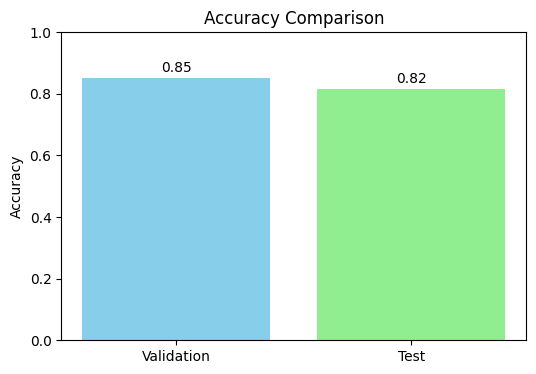

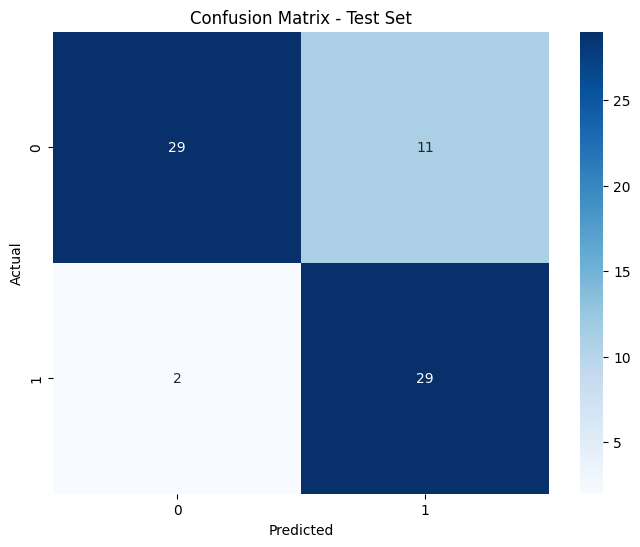

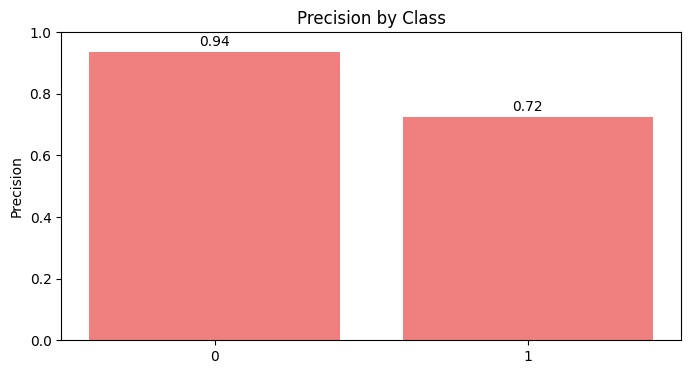

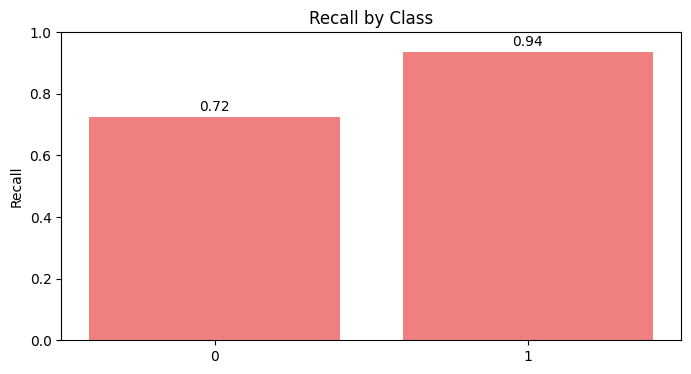

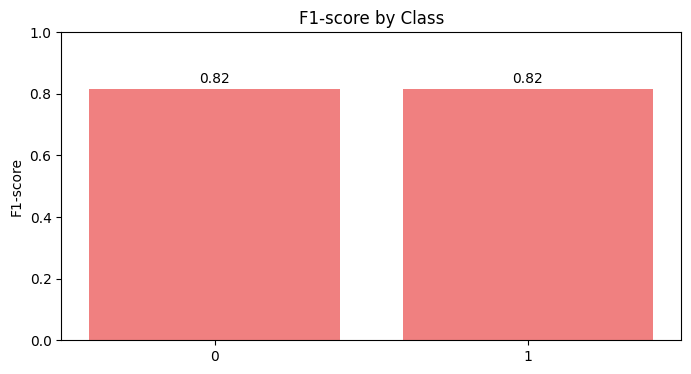

Scenario dataset_scenario_7_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_7_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_7_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


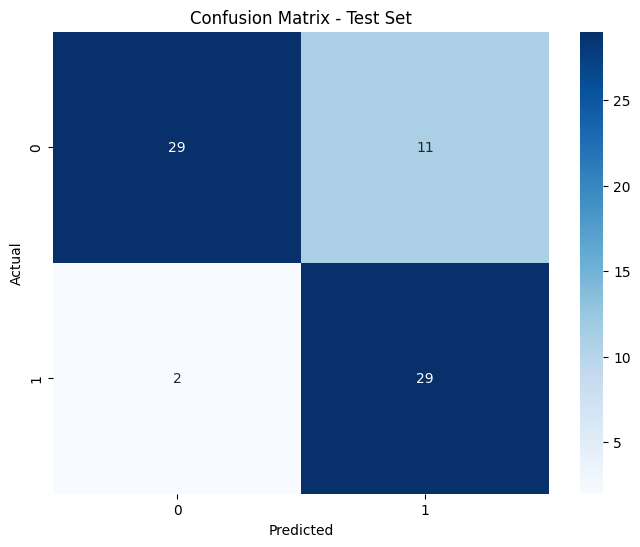

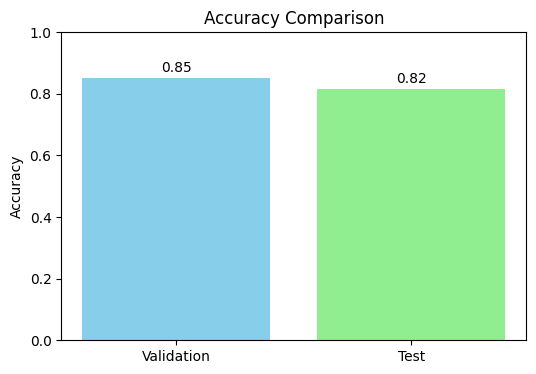

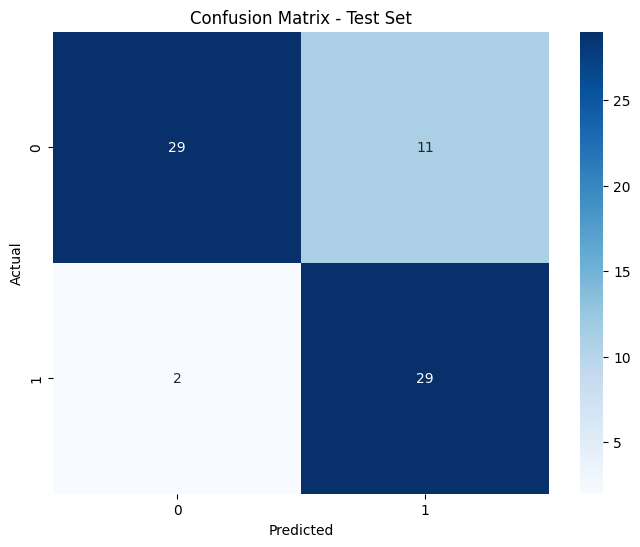

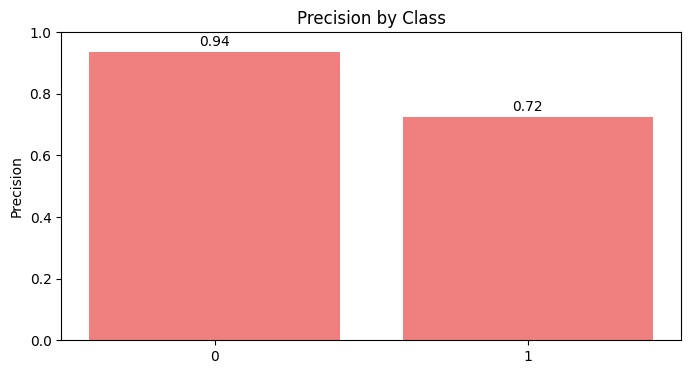

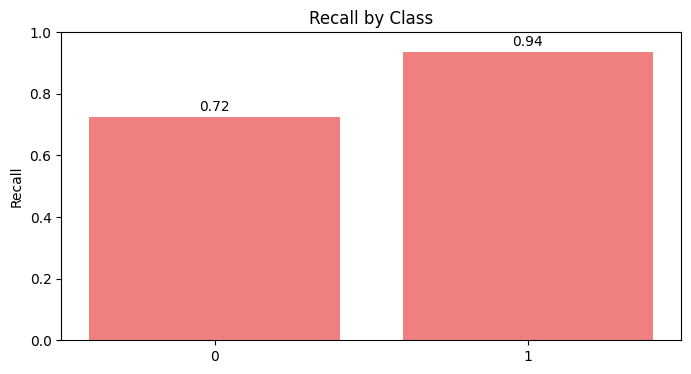

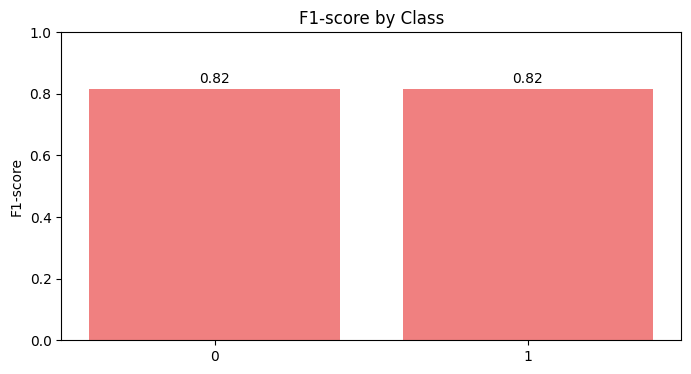

Scenario dataset_scenario_7_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with grid for dataset_scenario_8_N...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_8_N
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


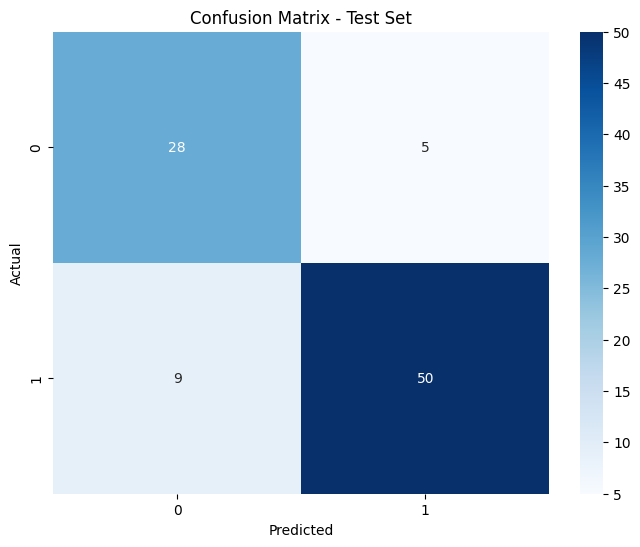

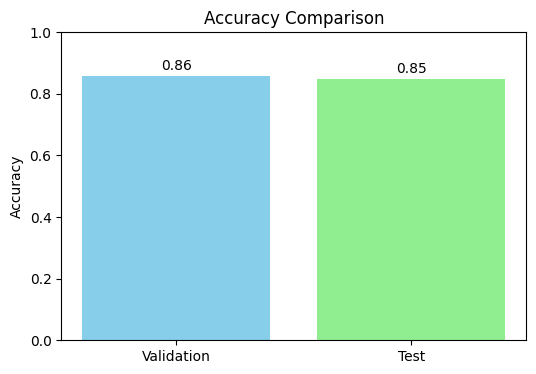

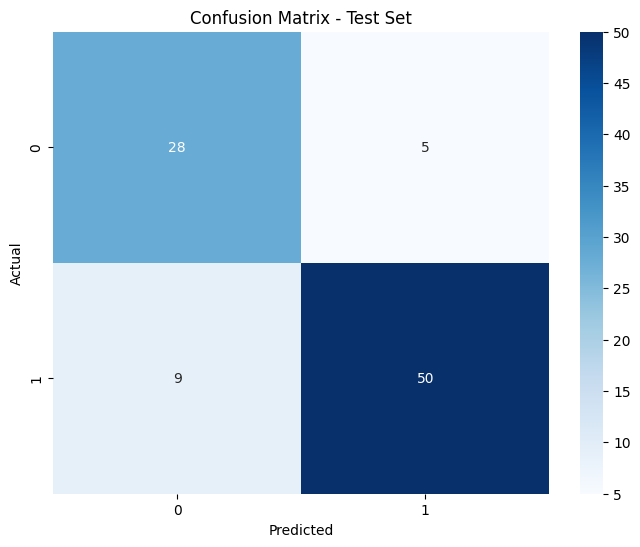

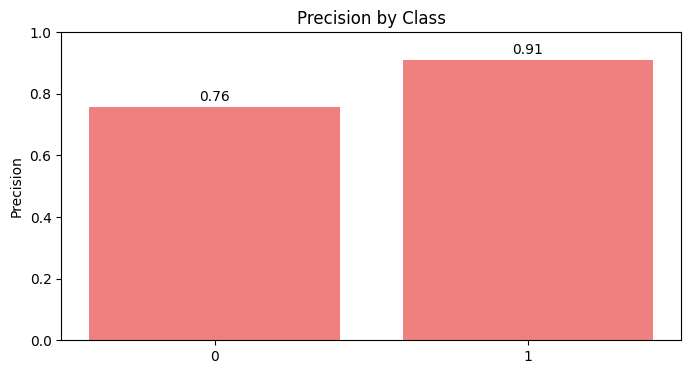

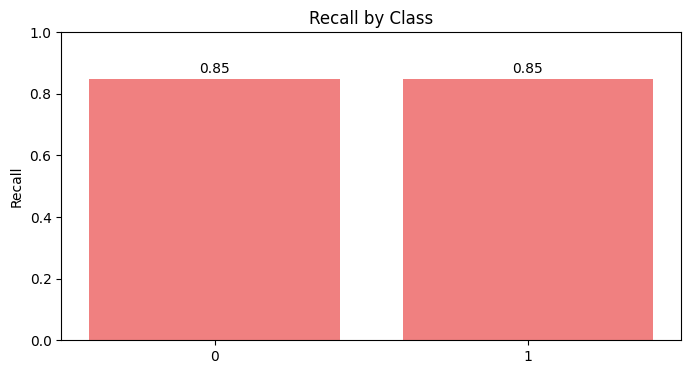

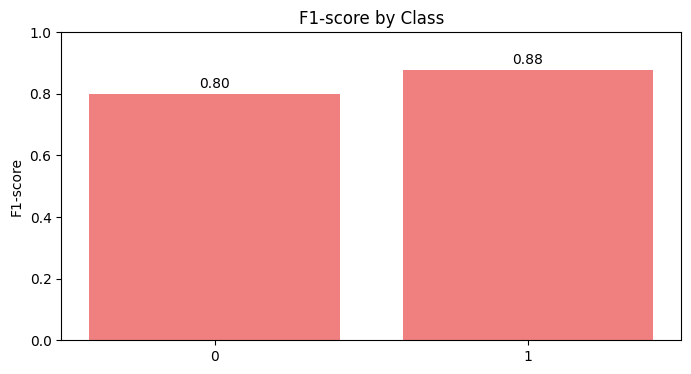

Scenario dataset_scenario_8_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with grid for dataset_scenario_8_S...
Results will be saved in: SCORES\NaiveBayes\grid\dataset_scenario_8_S
Best hyperparameters:  {'priors': None, 'var_smoothing': 1e-09}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


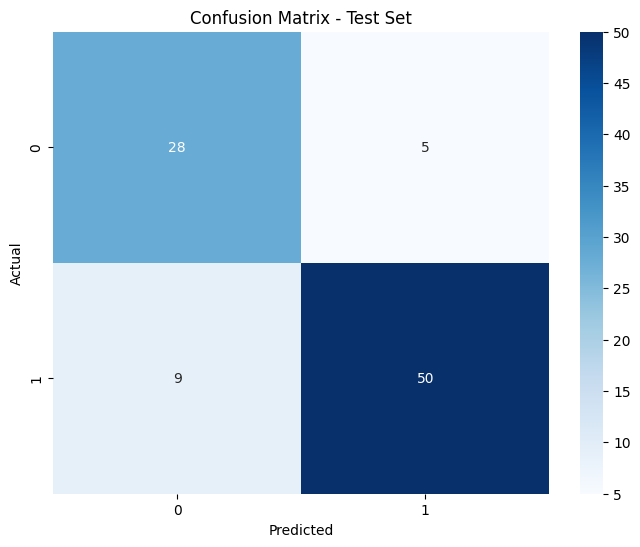

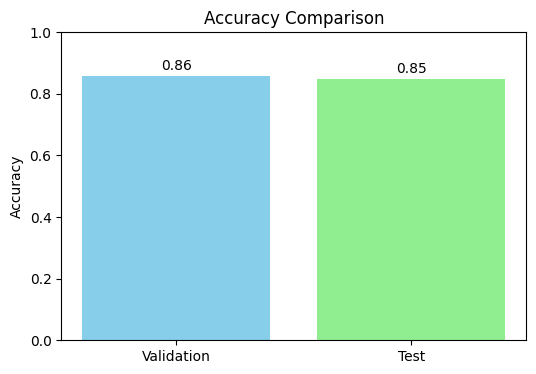

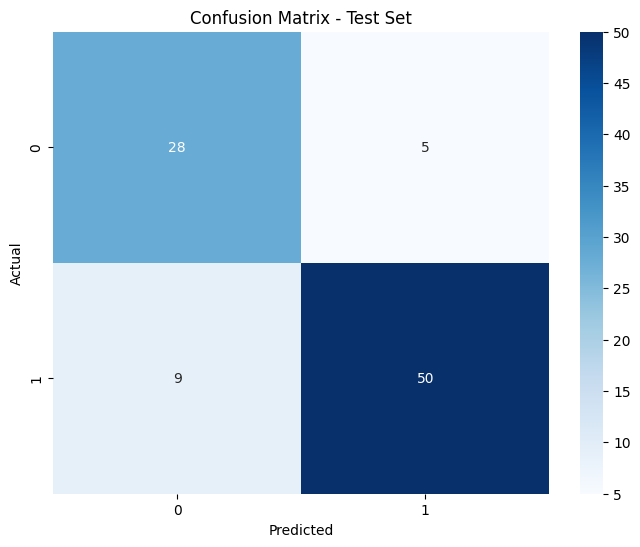

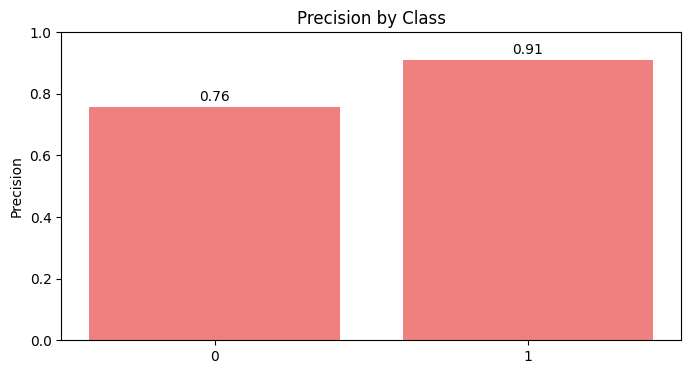

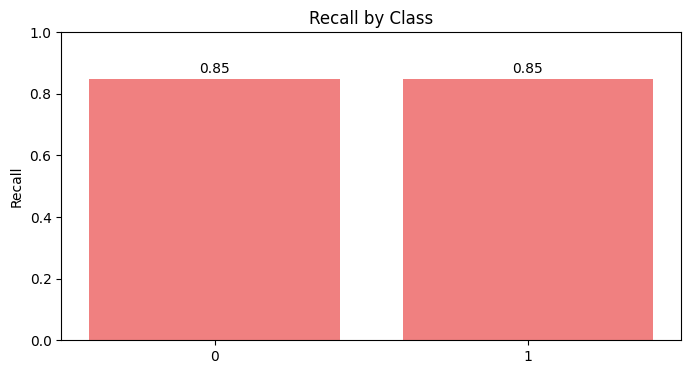

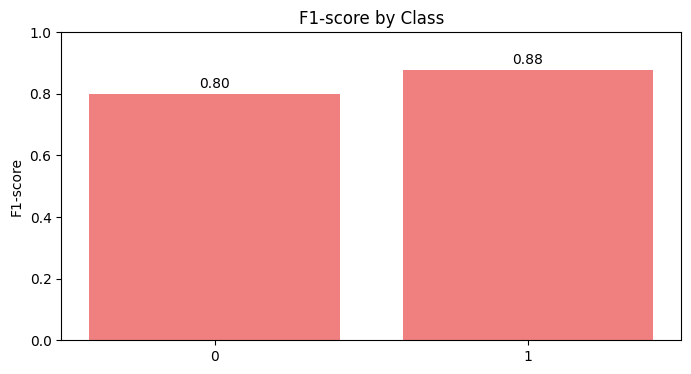

Scenario dataset_scenario_8_S with grid completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


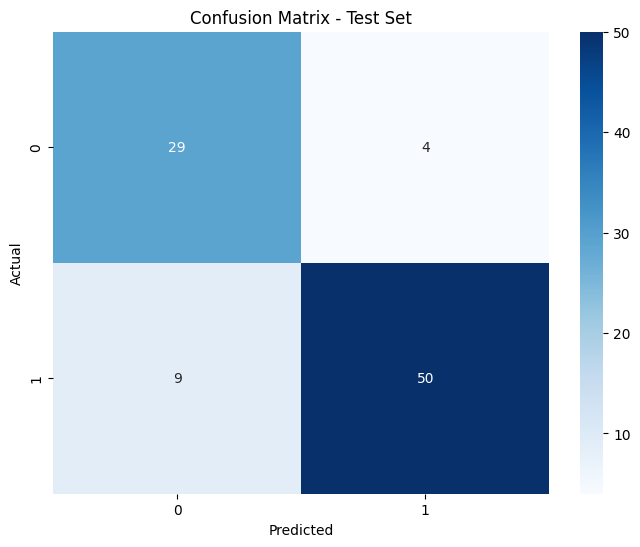

In [57]:
naive_bayes_grid_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "NaiveBayes", "grid", search_config_grid, get_search_hyperparameters("NaiveBayes"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        naive_bayes_grid_search['accuracy'] = best_score
        naive_bayes_grid_search['params'] = best_params
        naive_bayes_grid_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
nb = GaussianNB(**naive_bayes_grid_search['params'])
best_scenario = pd.read_csv(naive_bayes_grid_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, nb) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "NaiveBayes", "grid")
save_model_info(naive_bayes_grid_search, "NaiveBayes", "grid")
    

## 2. Random Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with random for dataset_scenario_1_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_1_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


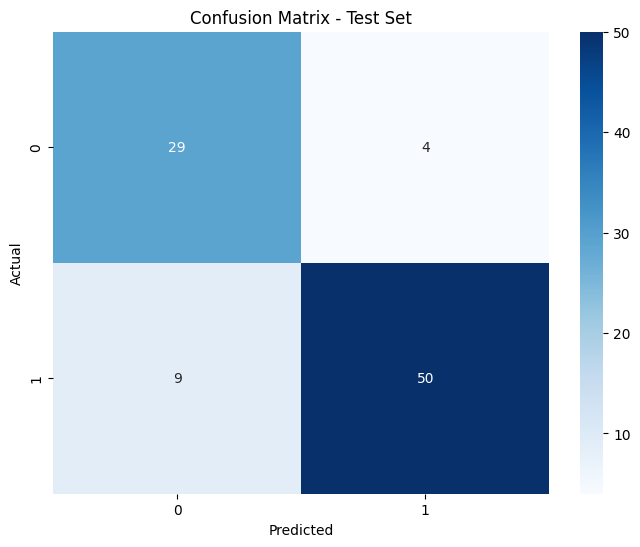

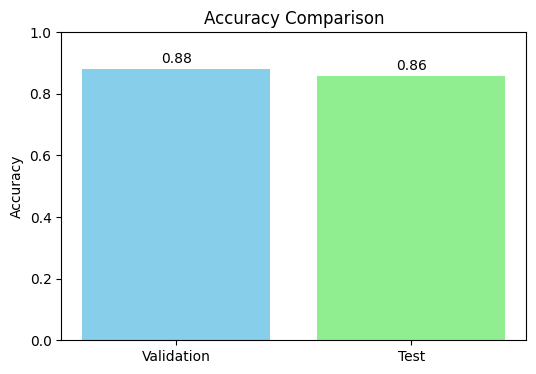

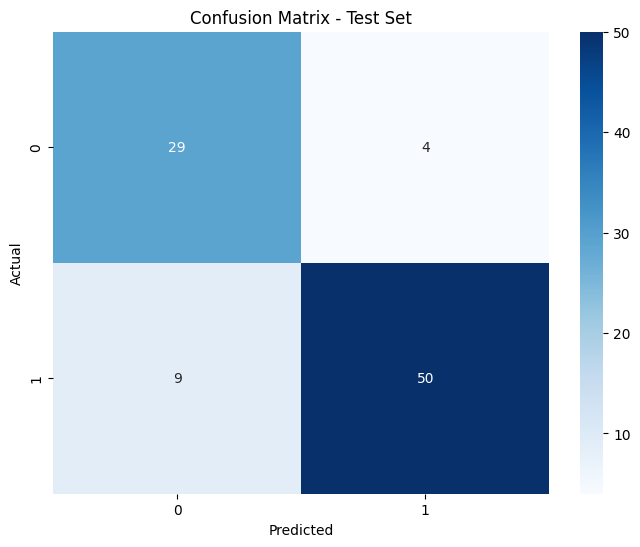

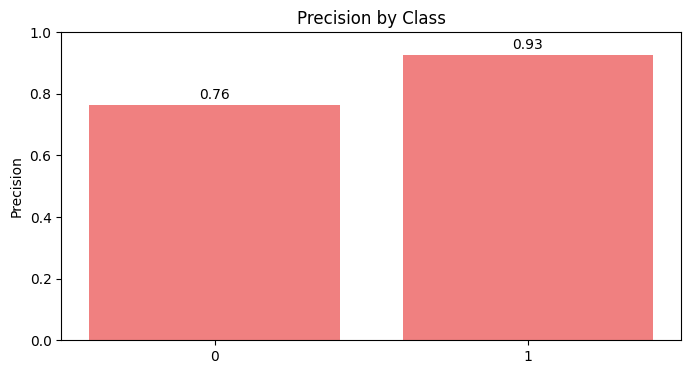

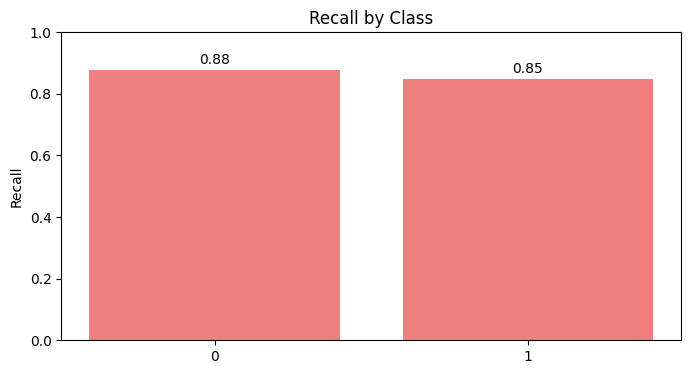

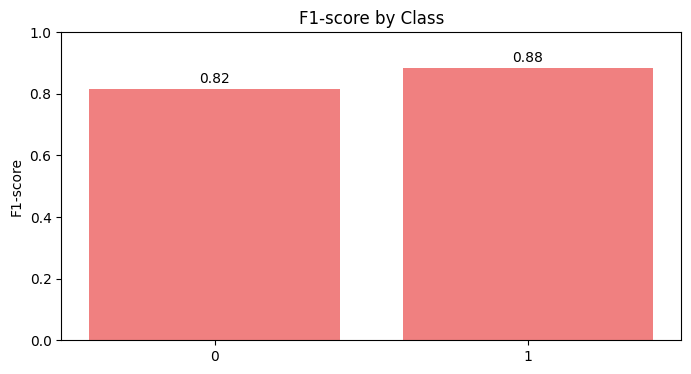

Scenario dataset_scenario_1_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_1_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_1_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


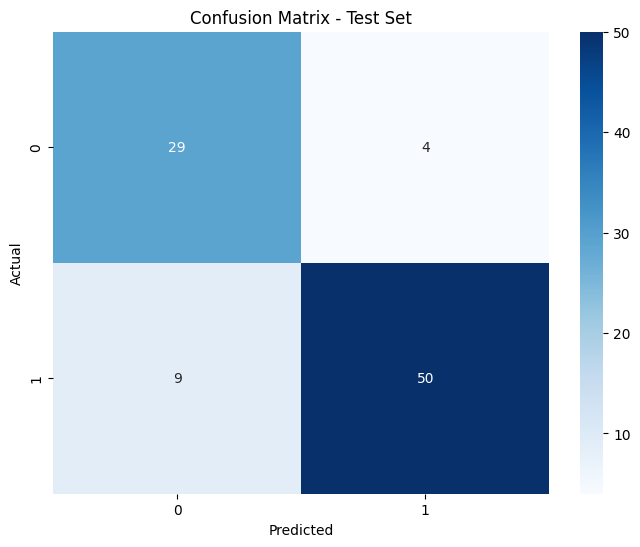

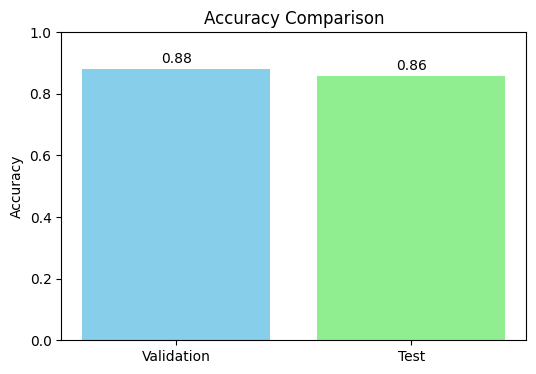

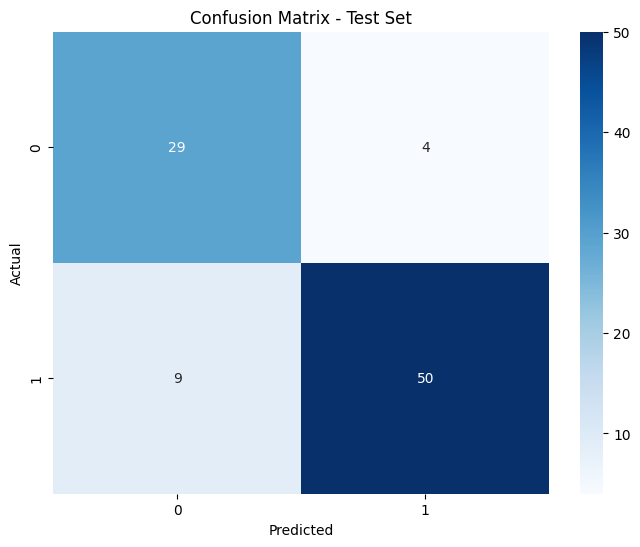

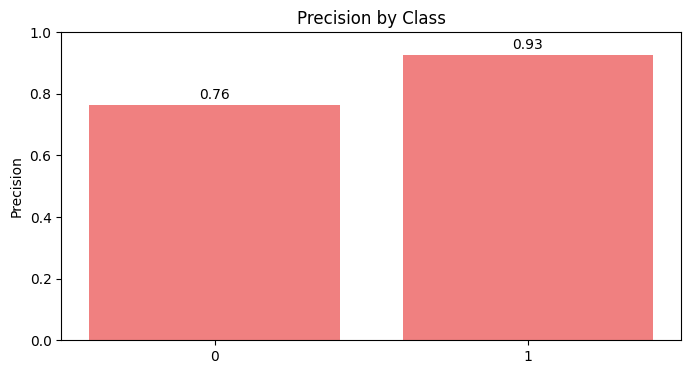

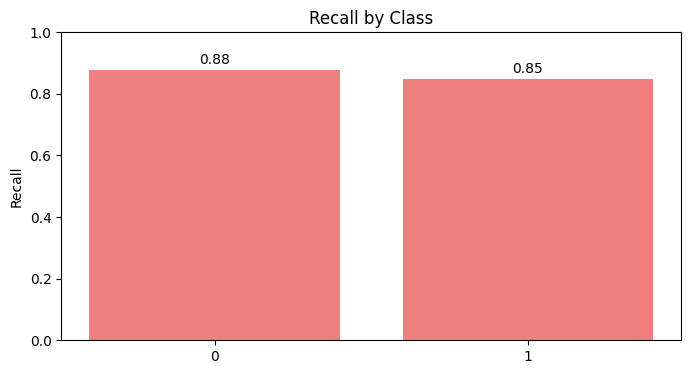

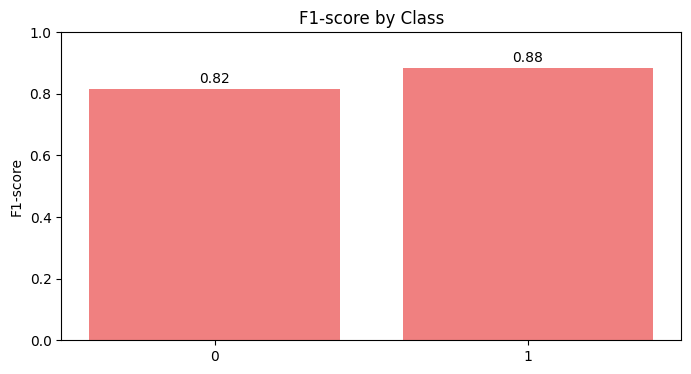

Scenario dataset_scenario_1_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running NaiveBayes with random for dataset_scenario_2_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_2_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


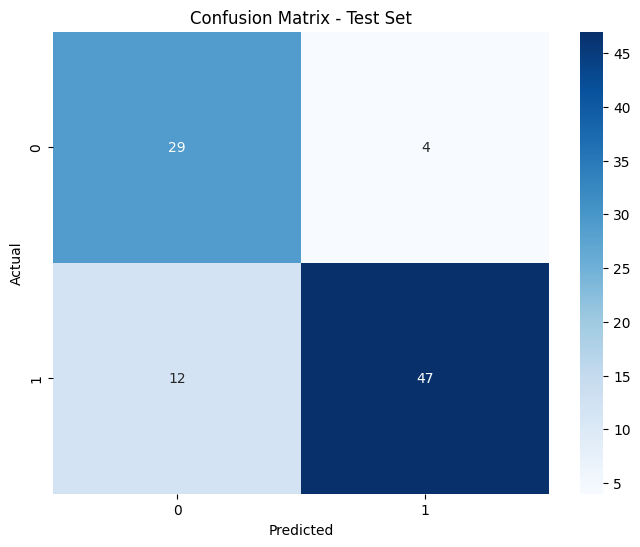

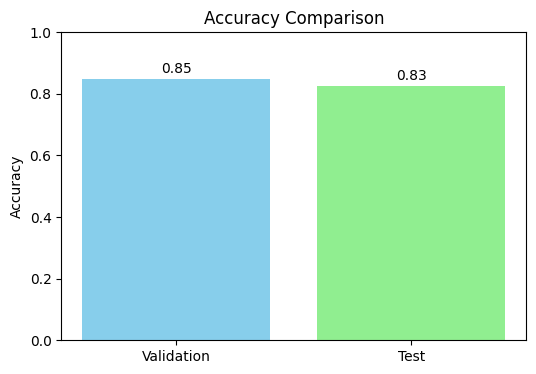

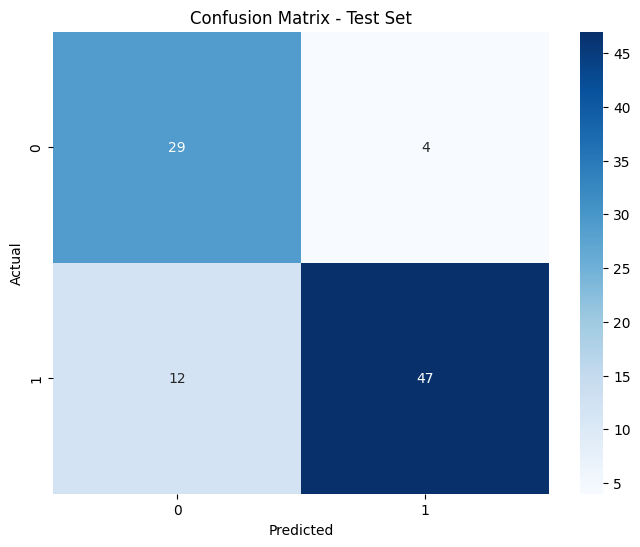

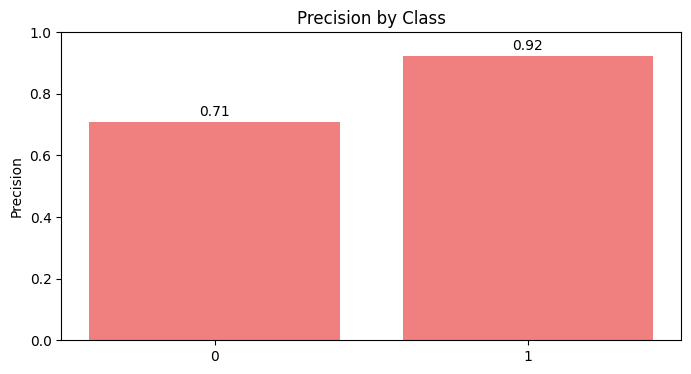

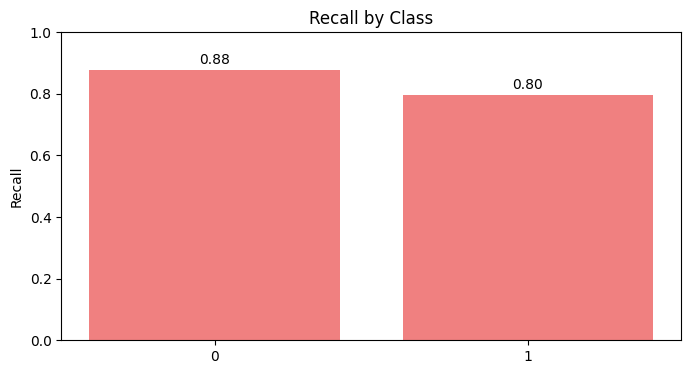

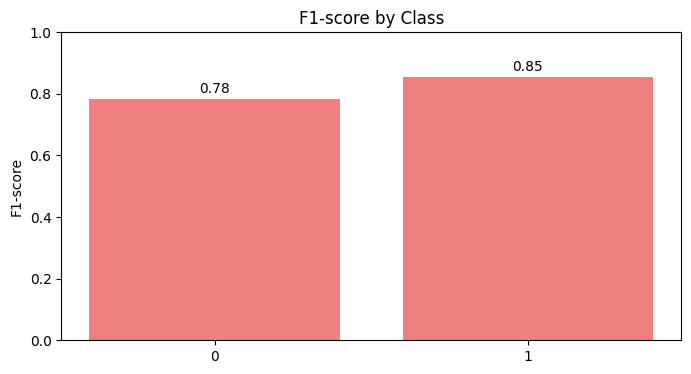

Scenario dataset_scenario_2_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_2_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_2_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


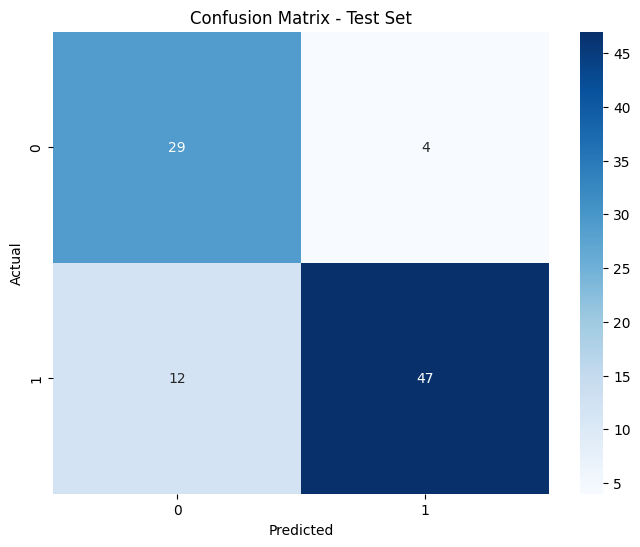

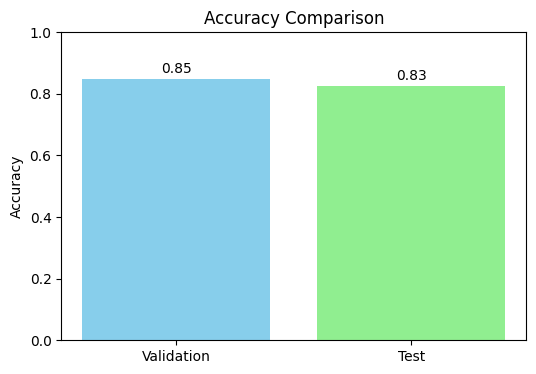

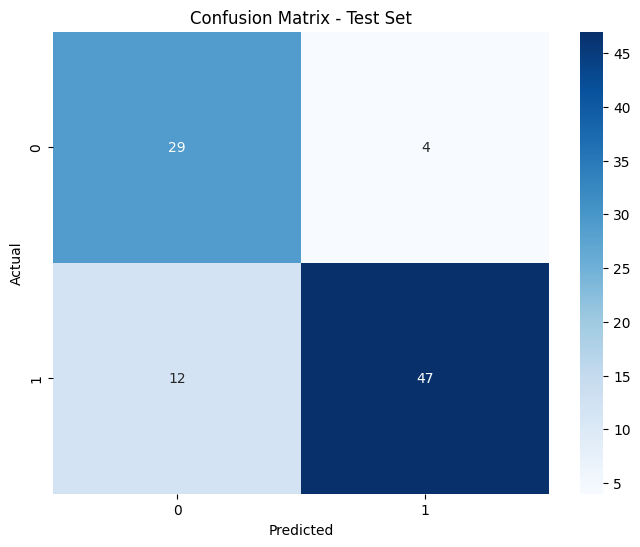

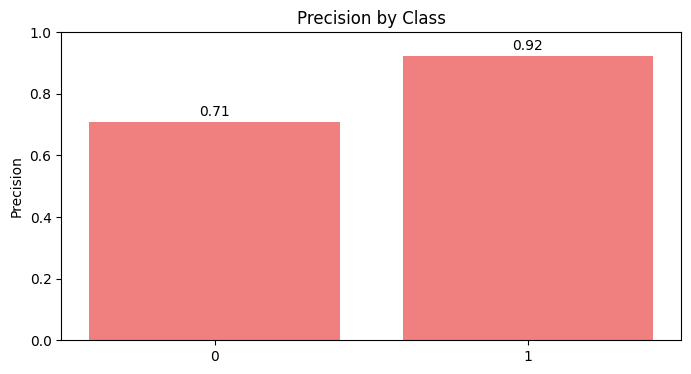

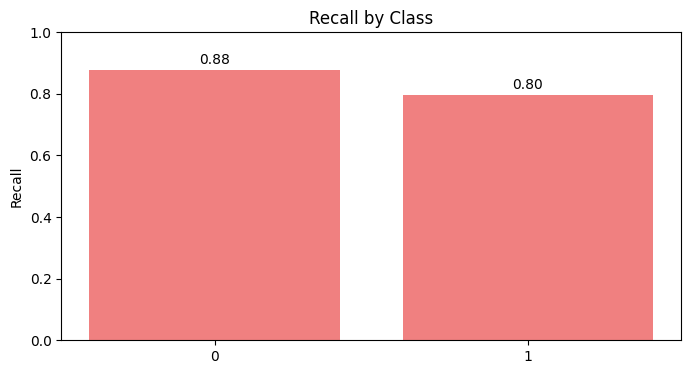

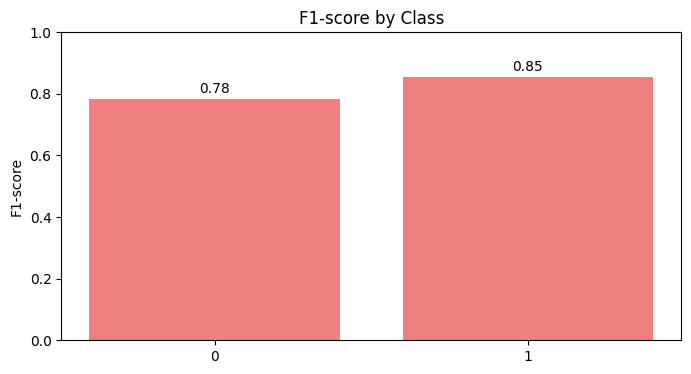

Scenario dataset_scenario_2_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with random for dataset_scenario_3_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_3_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


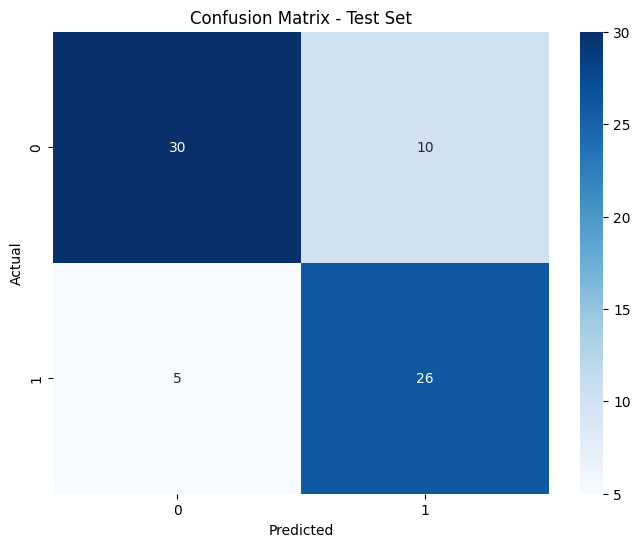

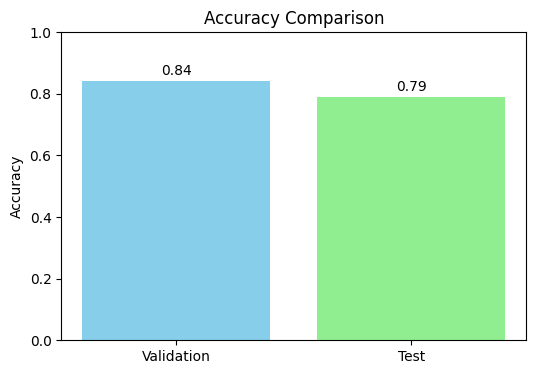

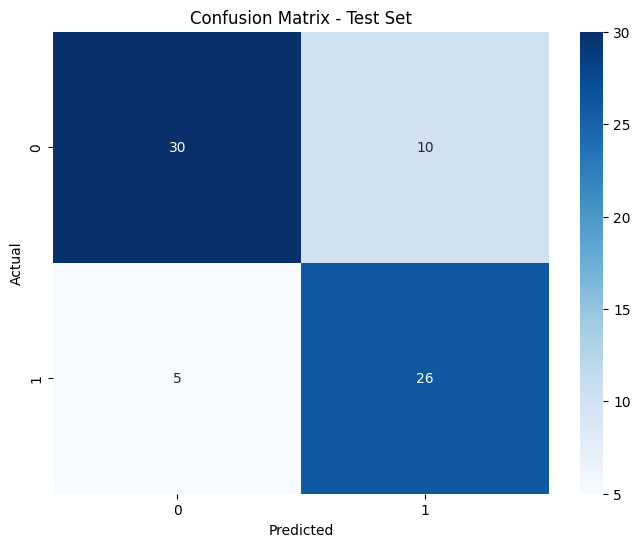

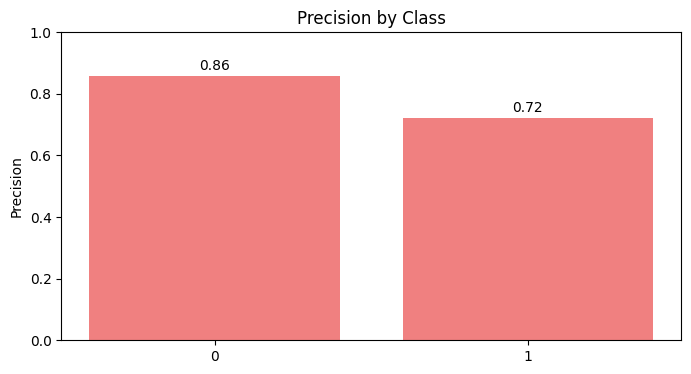

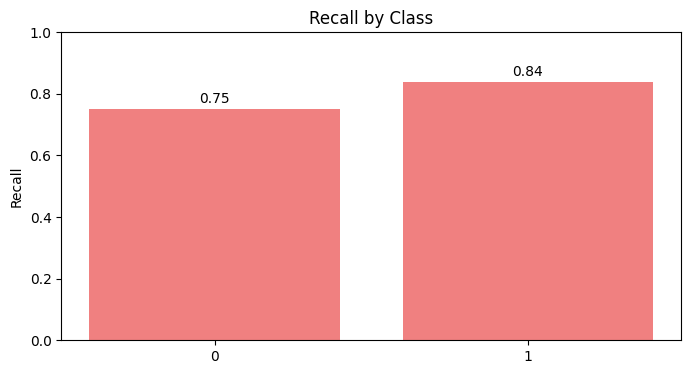

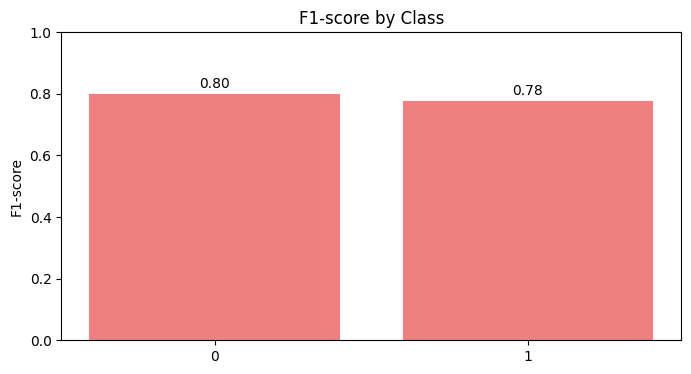

Scenario dataset_scenario_3_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_3_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_3_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


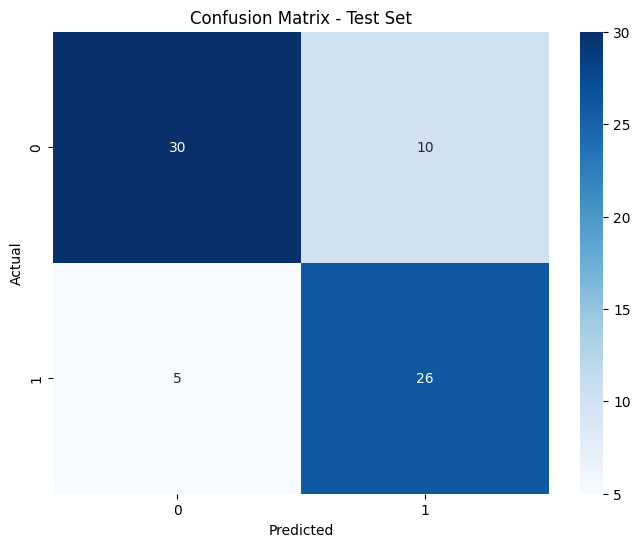

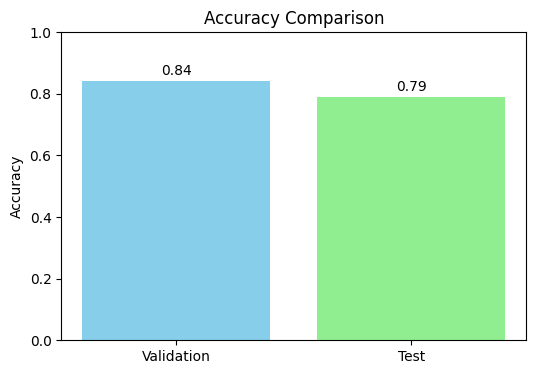

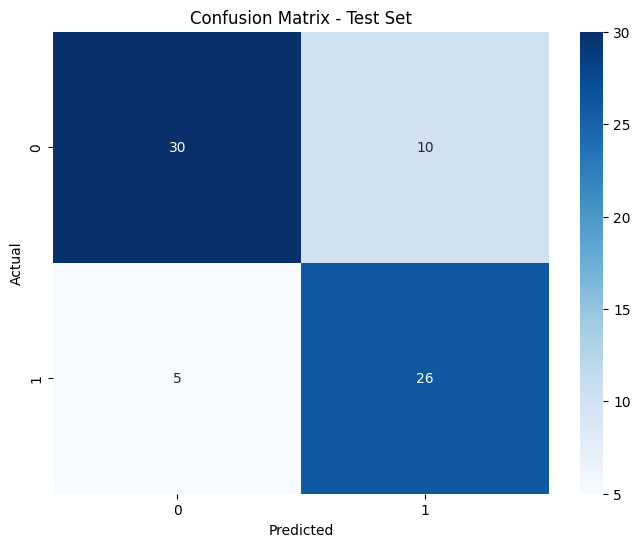

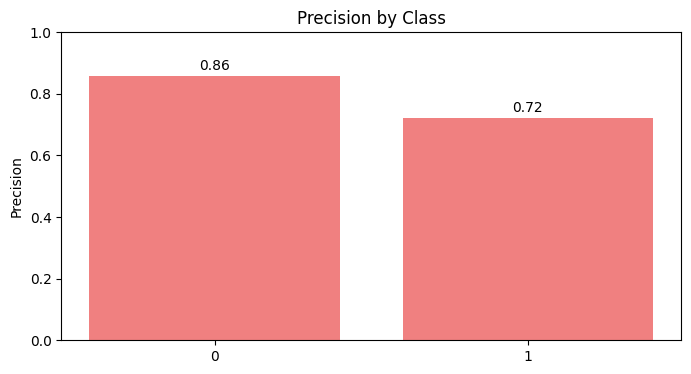

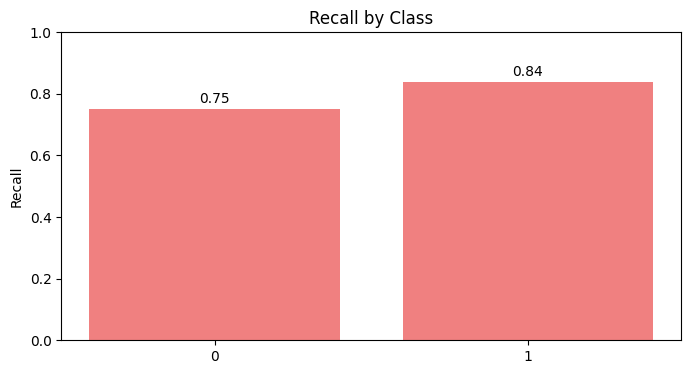

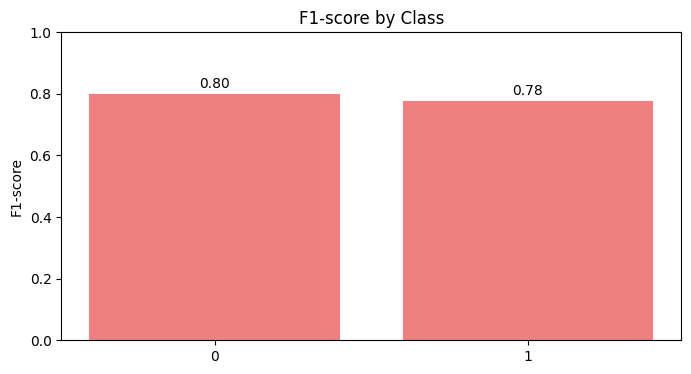

Scenario dataset_scenario_3_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with random for dataset_scenario_4_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_4_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


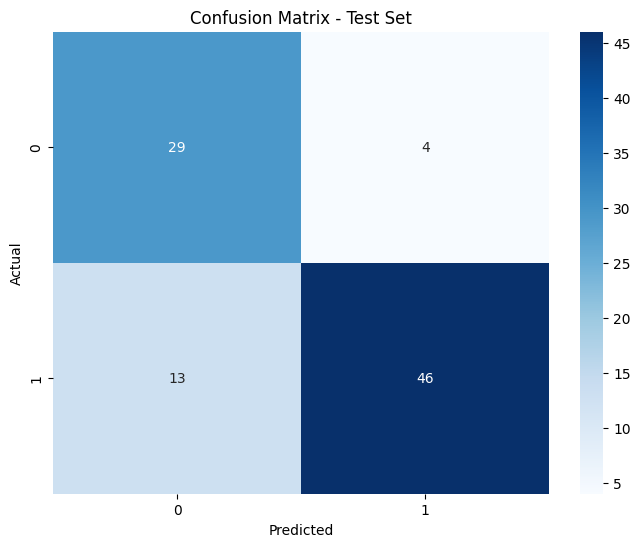

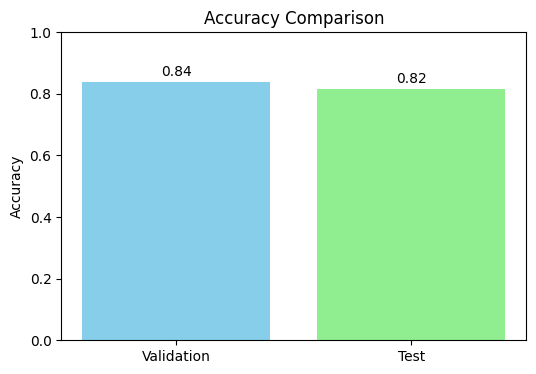

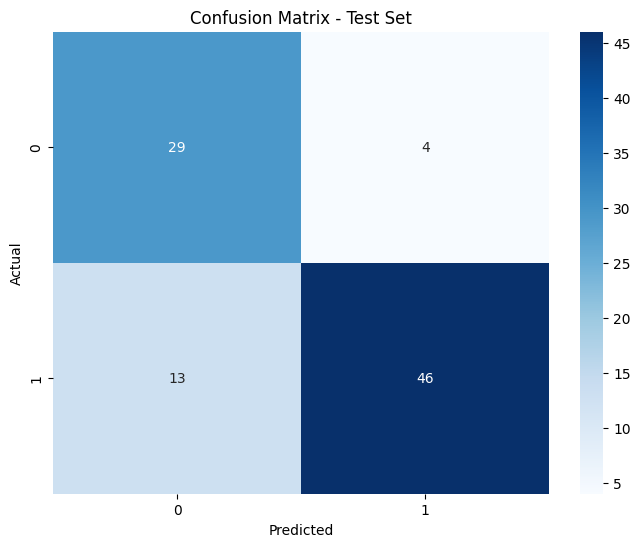

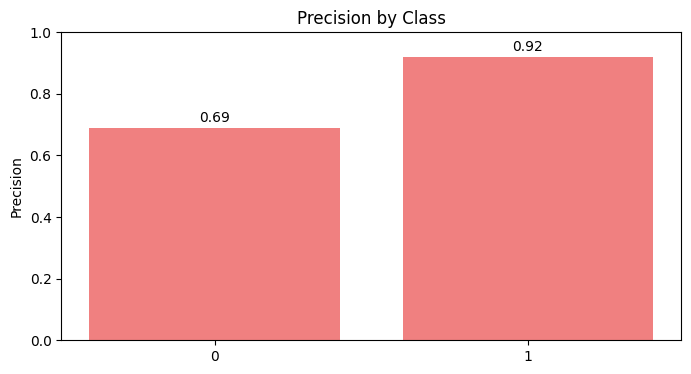

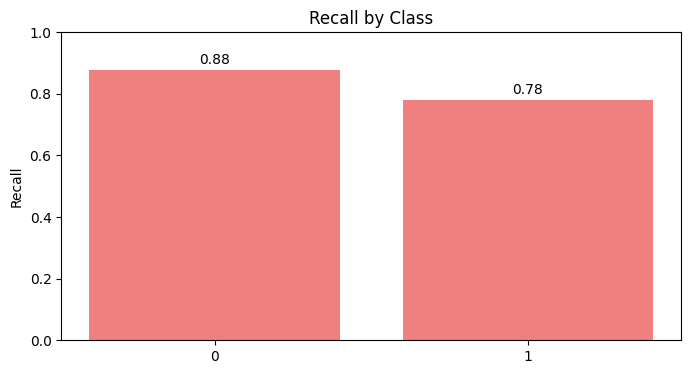

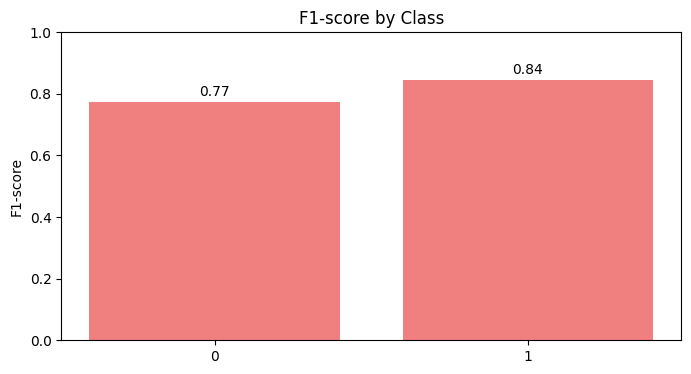

Scenario dataset_scenario_4_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_4_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_4_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


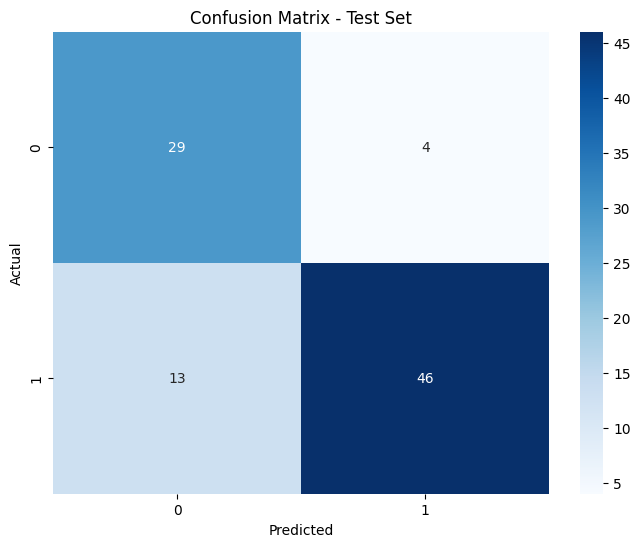

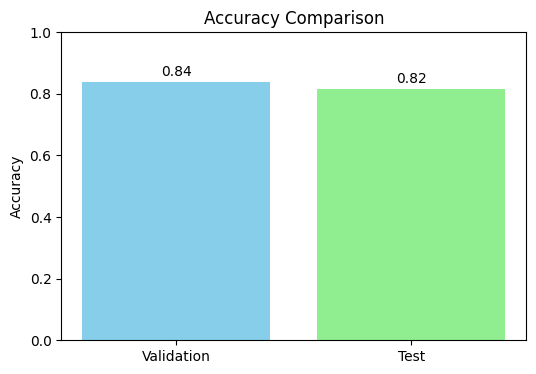

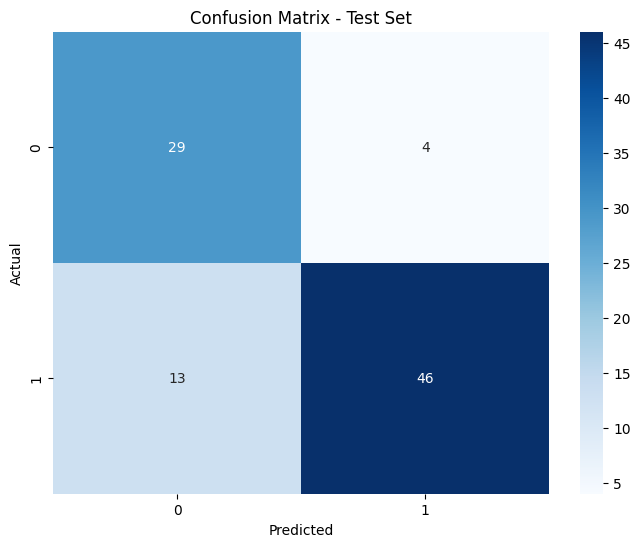

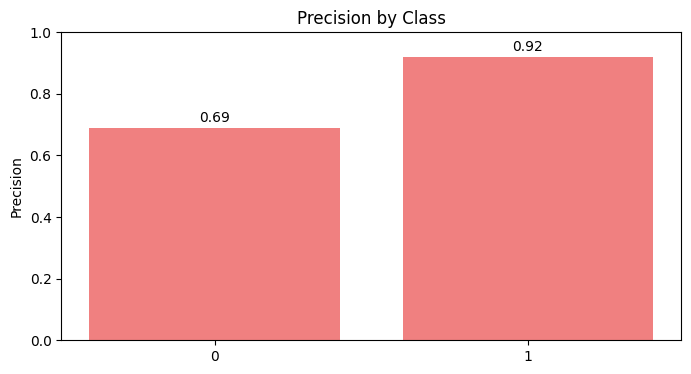

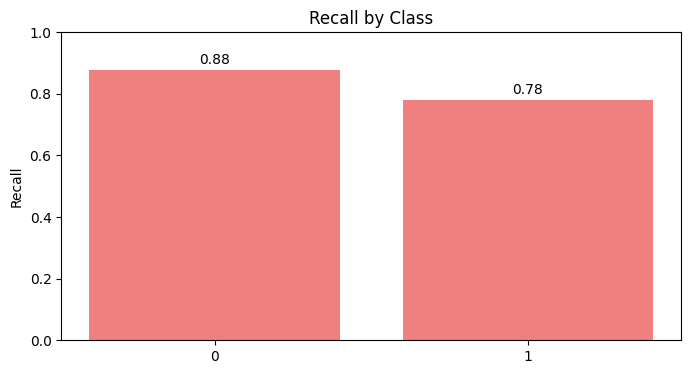

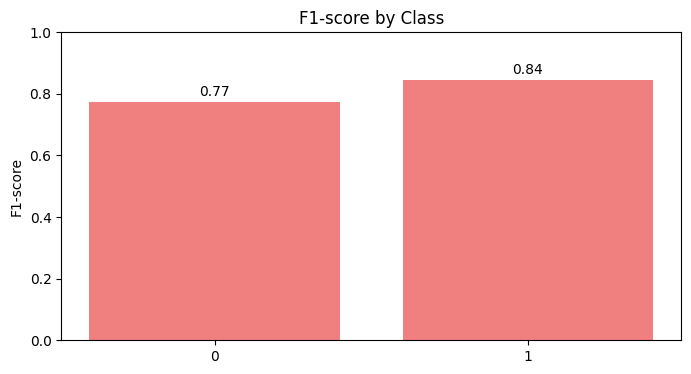

Scenario dataset_scenario_4_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with random for dataset_scenario_5_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_5_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


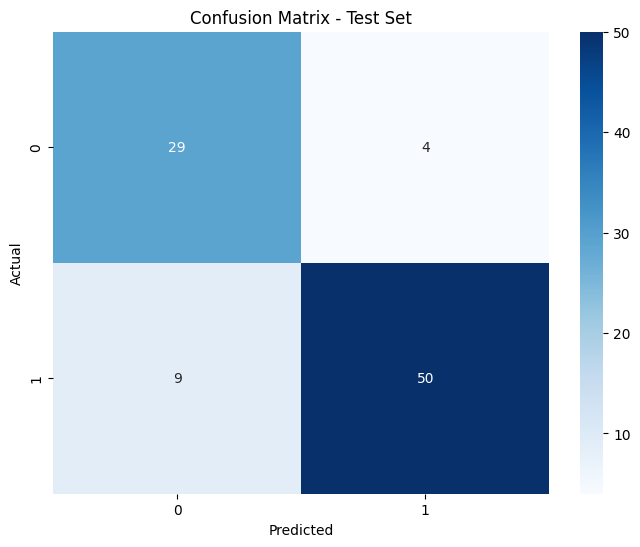

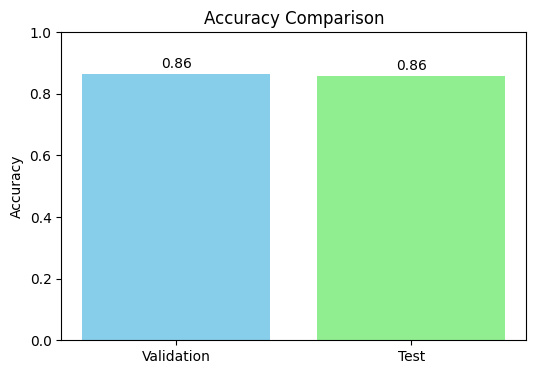

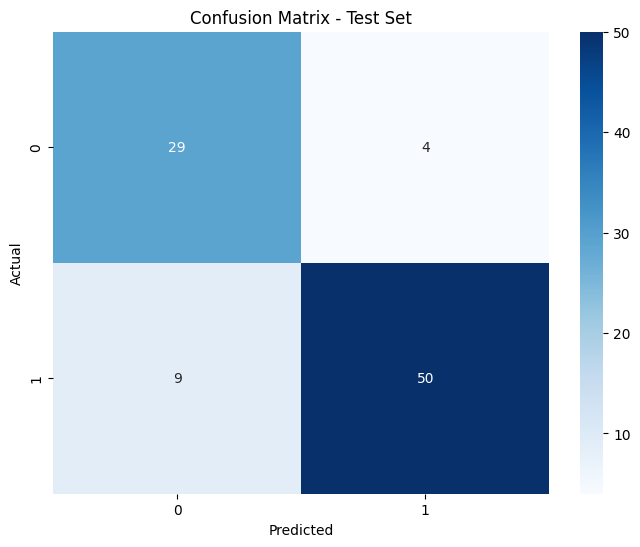

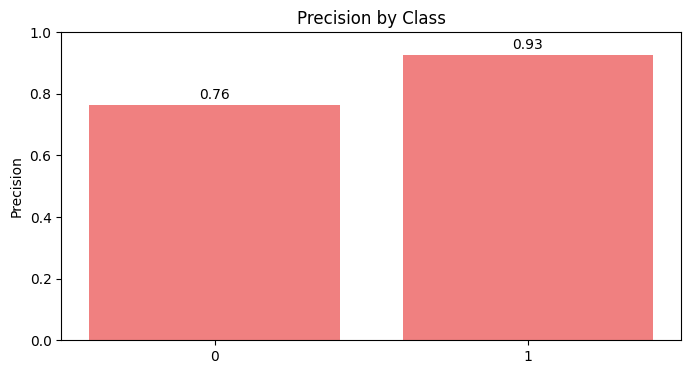

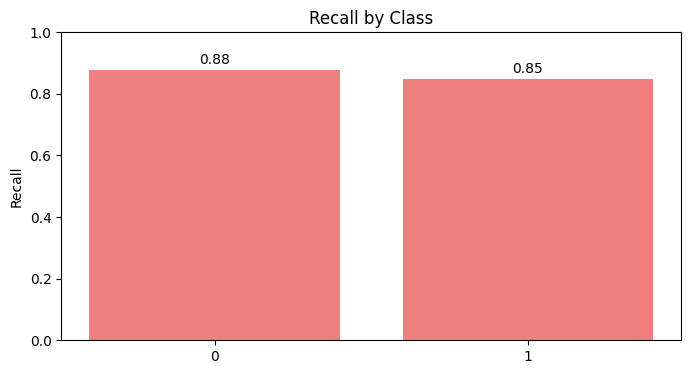

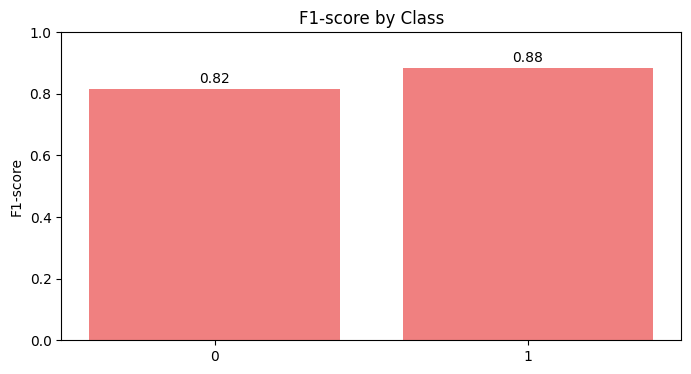

Scenario dataset_scenario_5_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_5_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_5_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


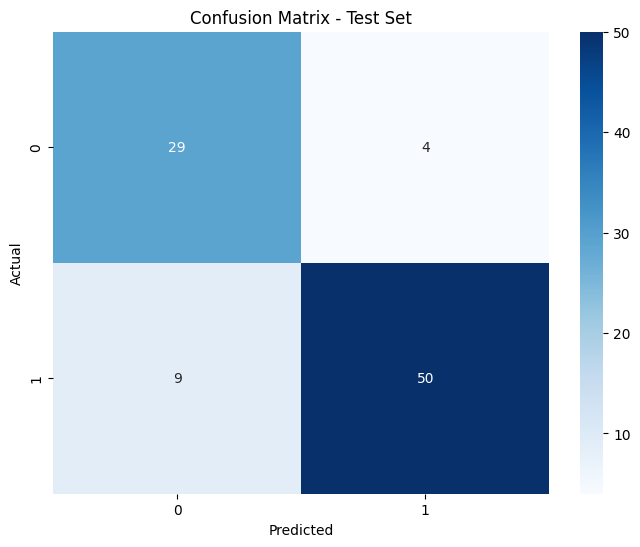

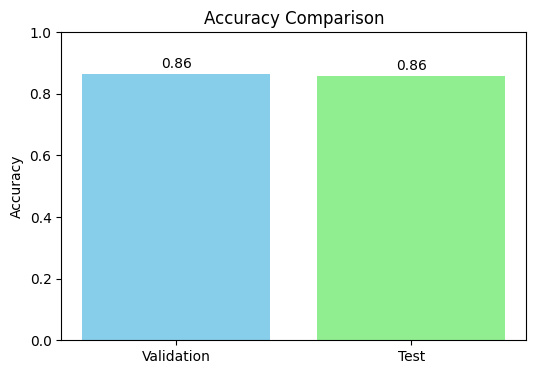

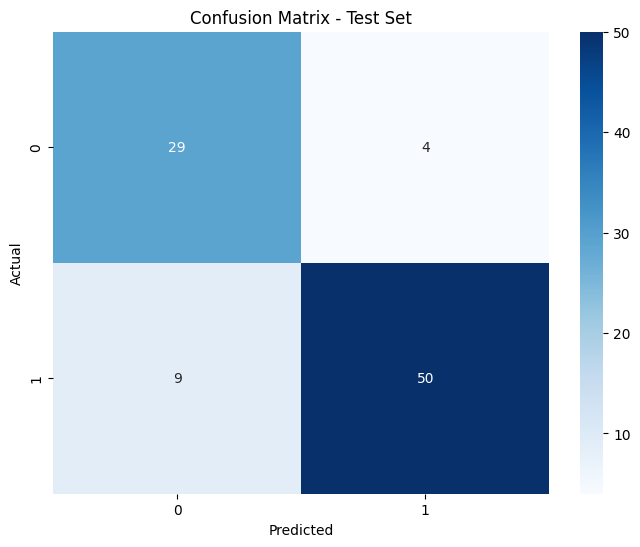

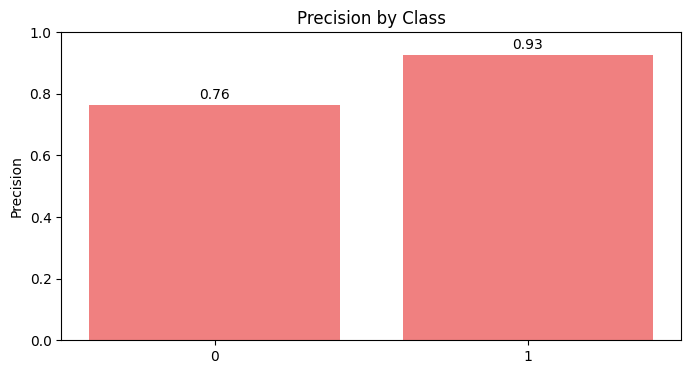

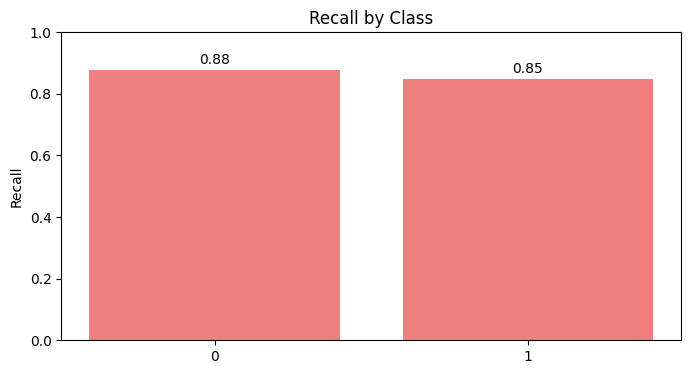

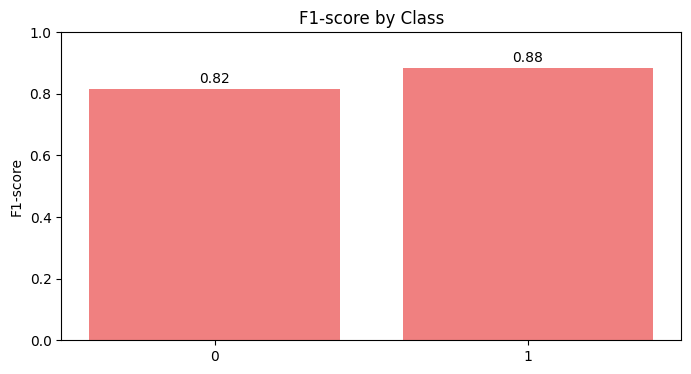

Scenario dataset_scenario_5_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with random for dataset_scenario_6_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_6_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


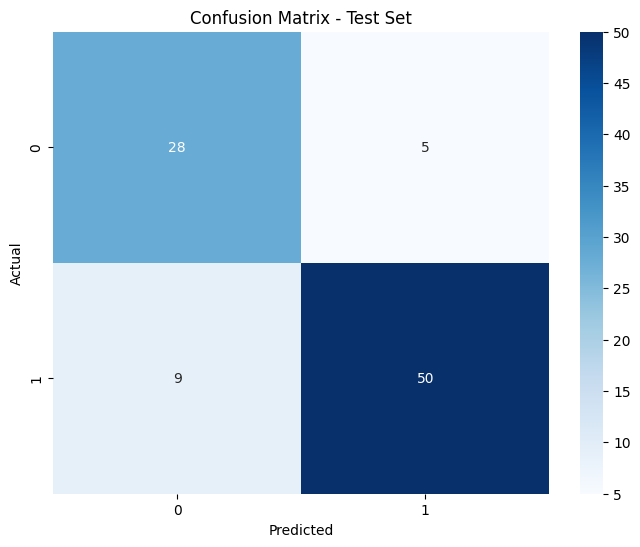

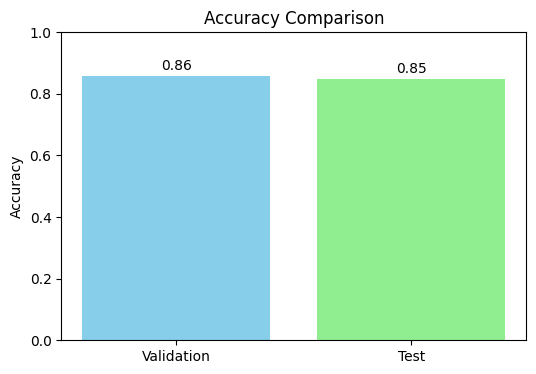

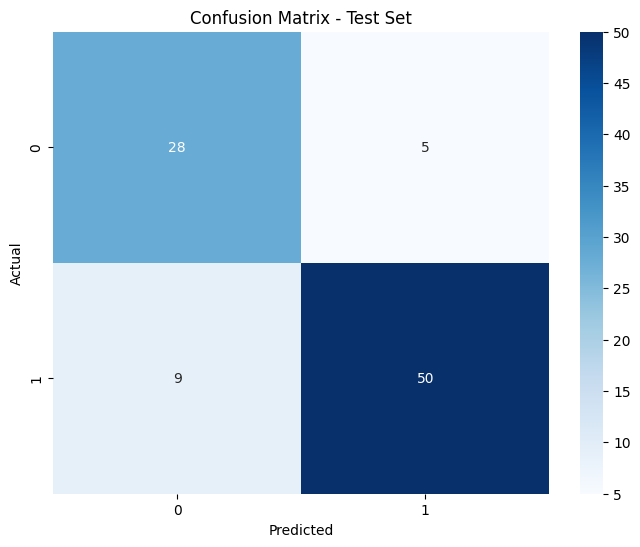

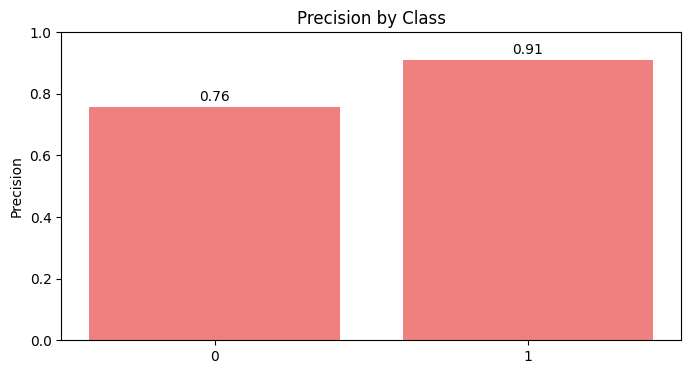

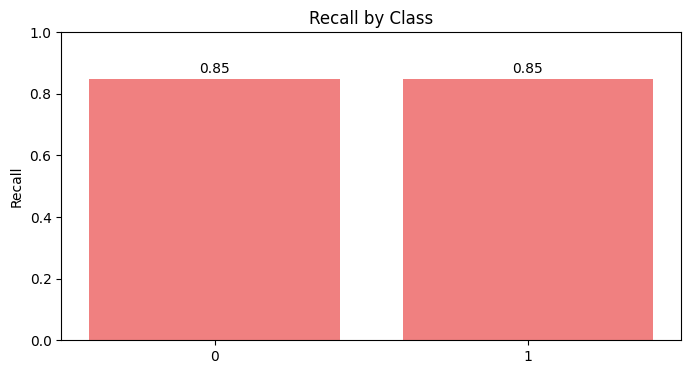

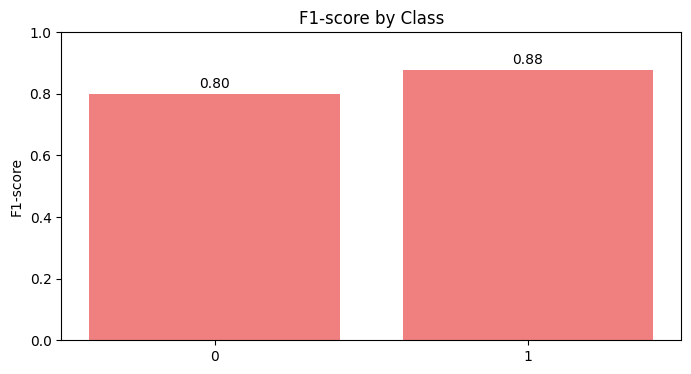

Scenario dataset_scenario_6_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_6_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_6_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


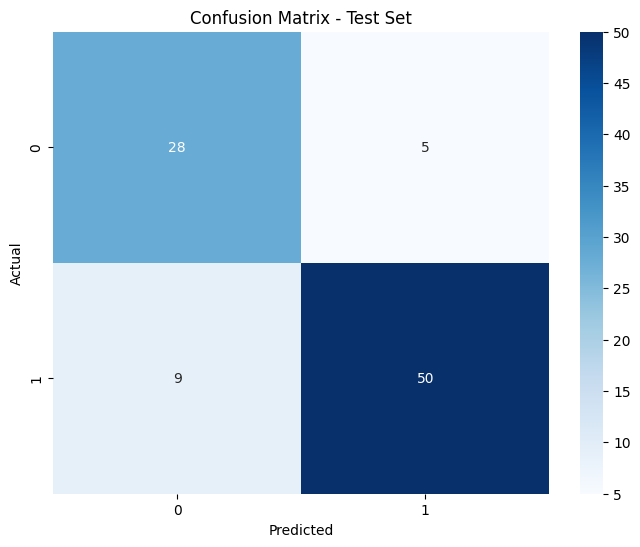

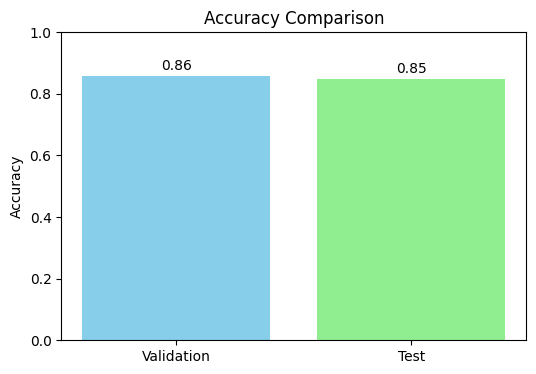

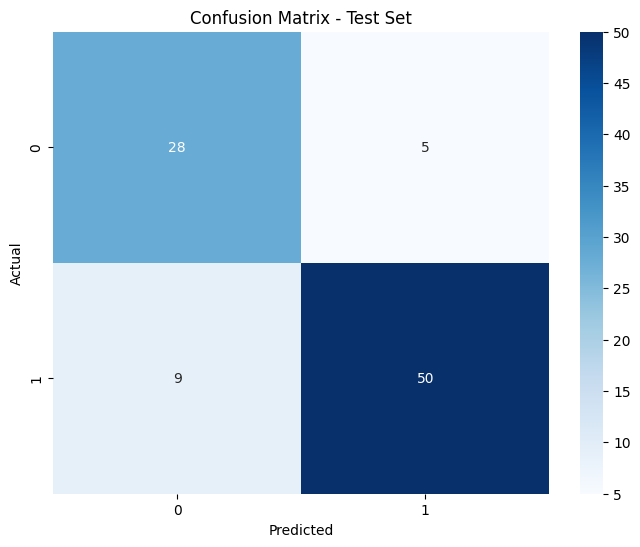

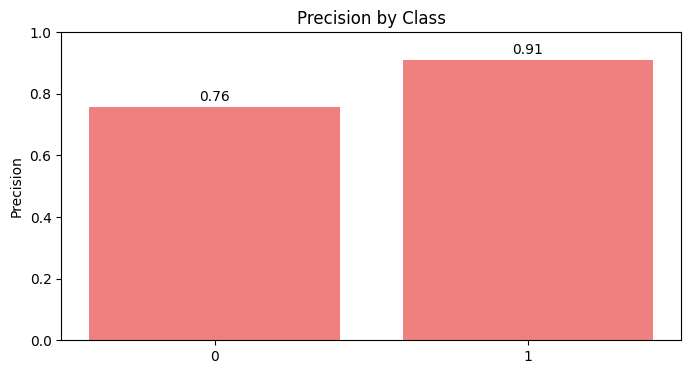

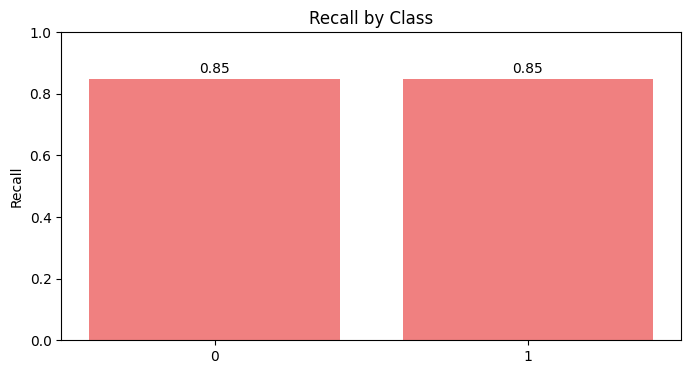

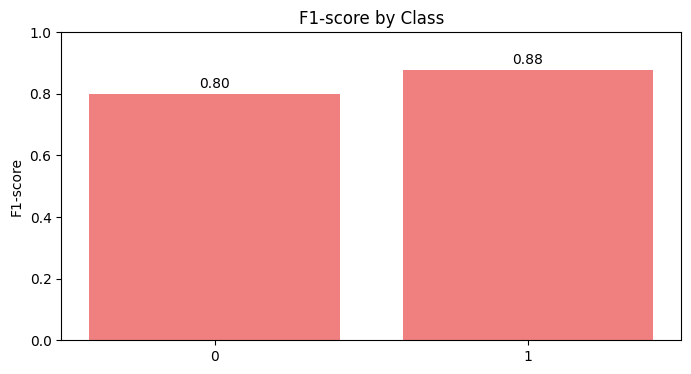

Scenario dataset_scenario_6_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with random for dataset_scenario_7_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_7_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


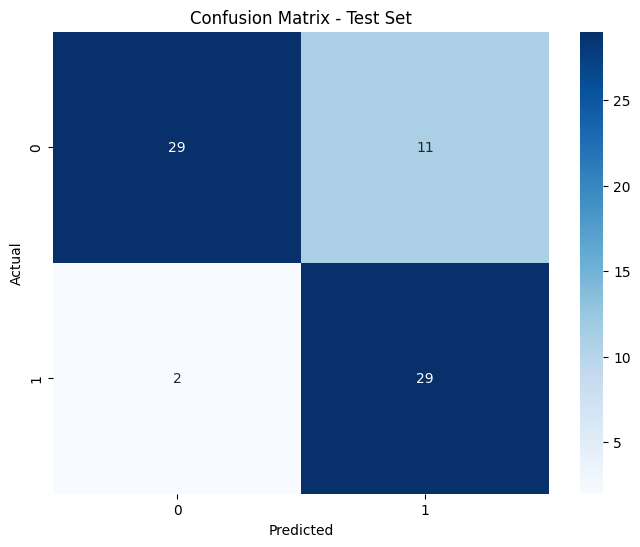

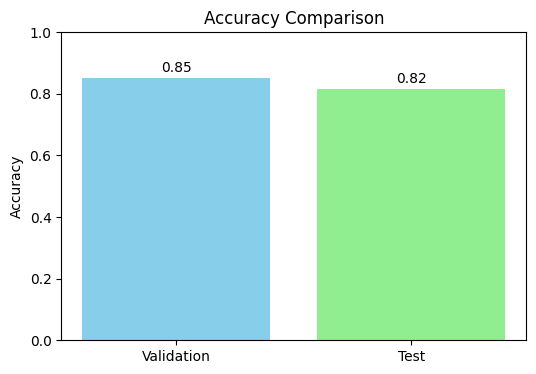

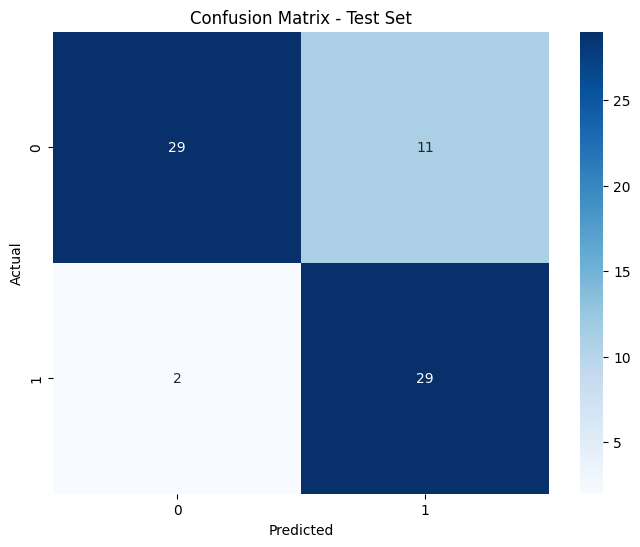

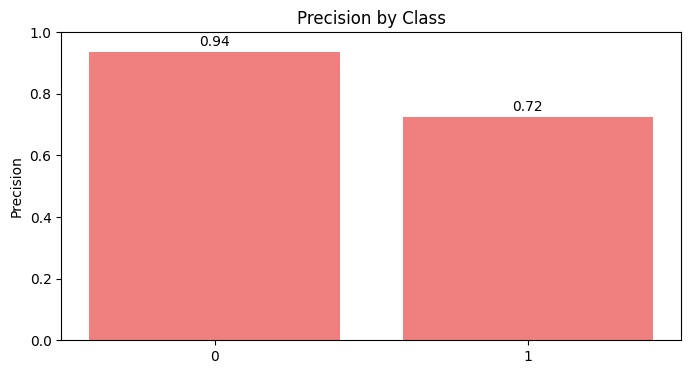

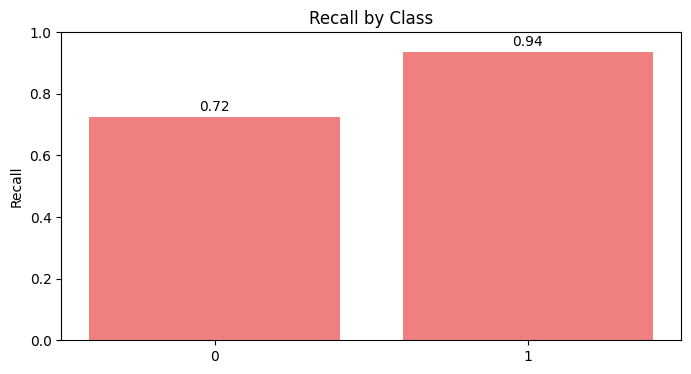

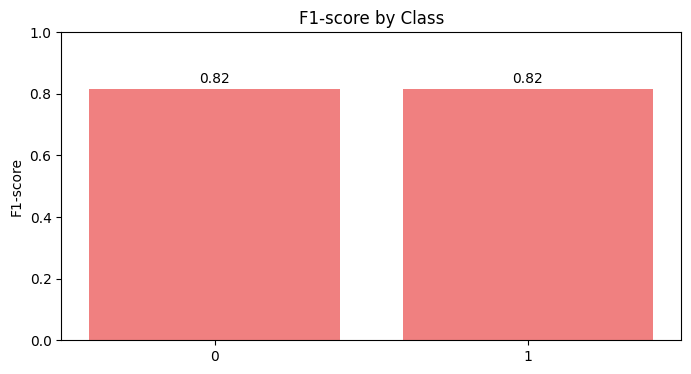

Scenario dataset_scenario_7_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_7_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_7_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


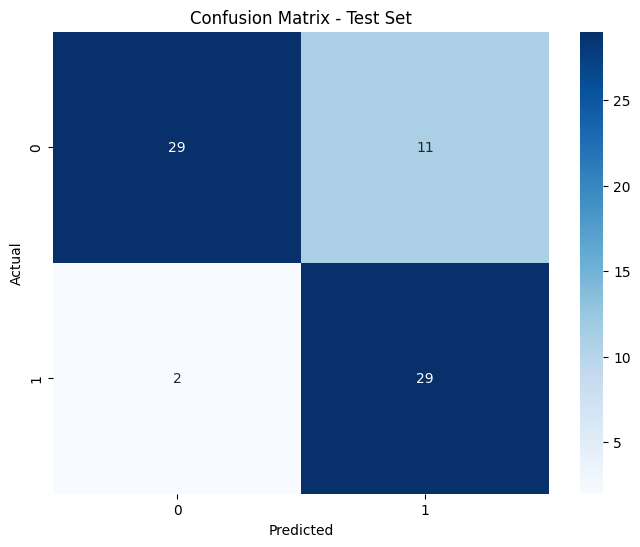

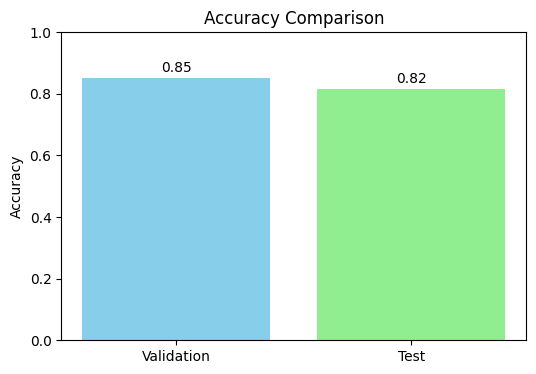

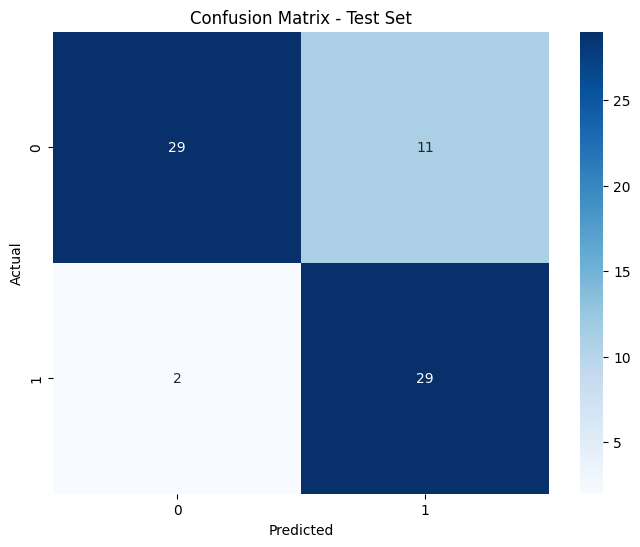

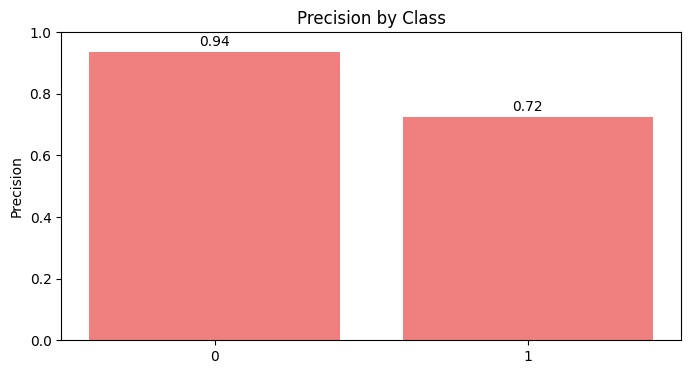

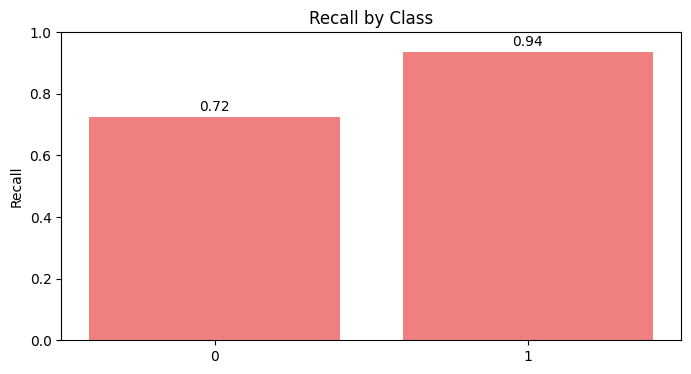

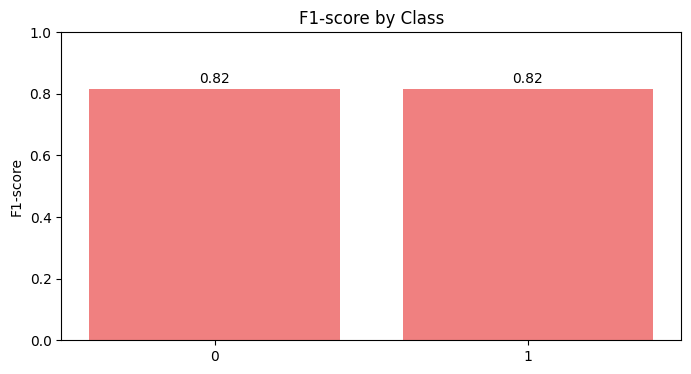

Scenario dataset_scenario_7_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with random for dataset_scenario_8_N...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_8_N
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


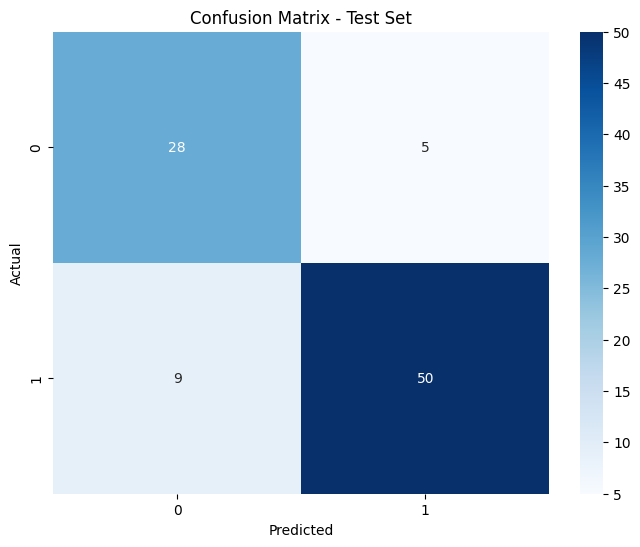

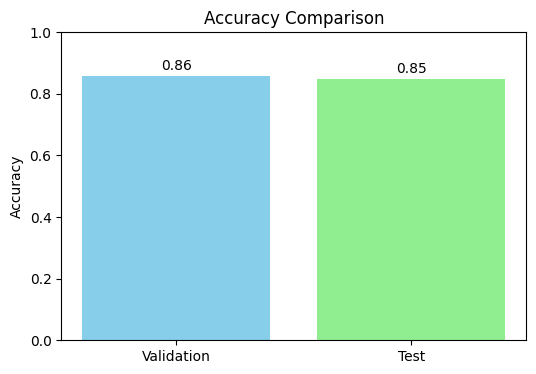

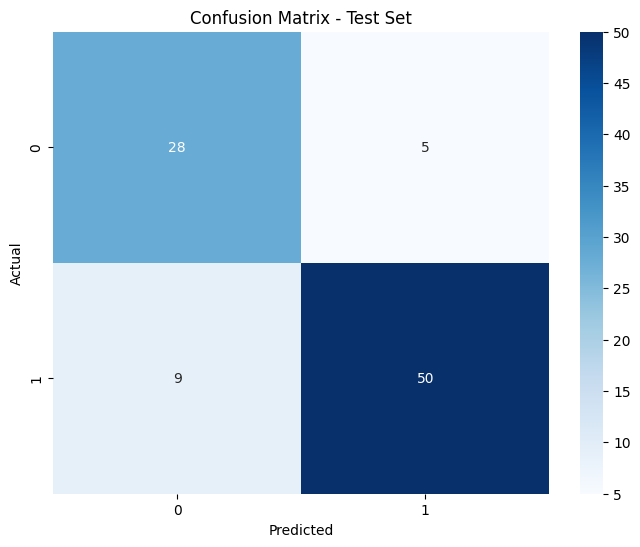

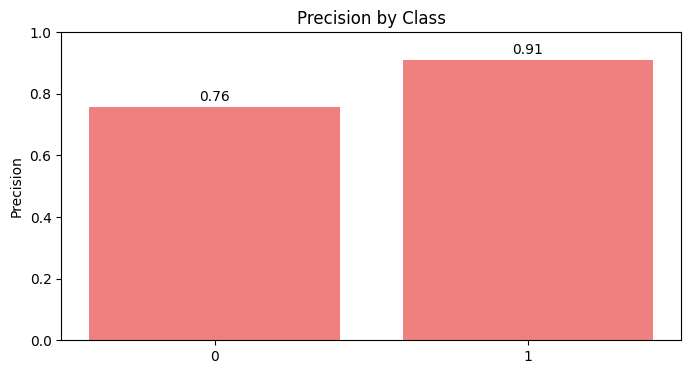

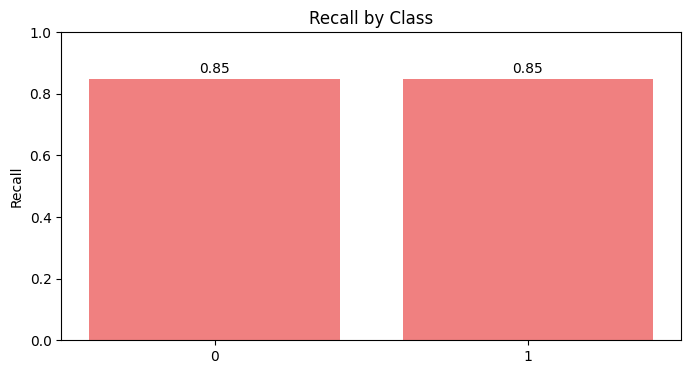

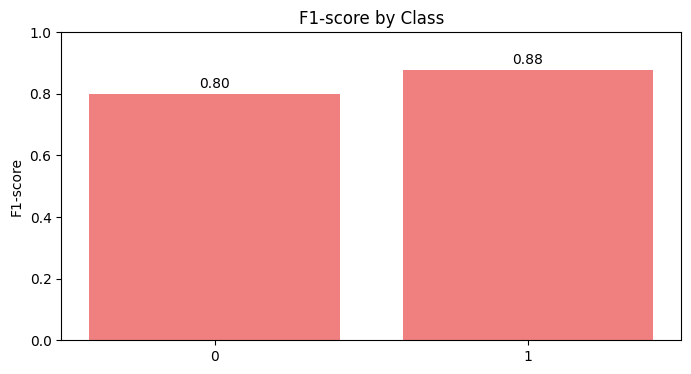

Scenario dataset_scenario_8_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with random for dataset_scenario_8_S...
Results will be saved in: SCORES\NaiveBayes\random\dataset_scenario_8_S
Best hyperparameters:  {'var_smoothing': 1e-09, 'priors': None}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 5 is smaller than n_iter=50. Running 5 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


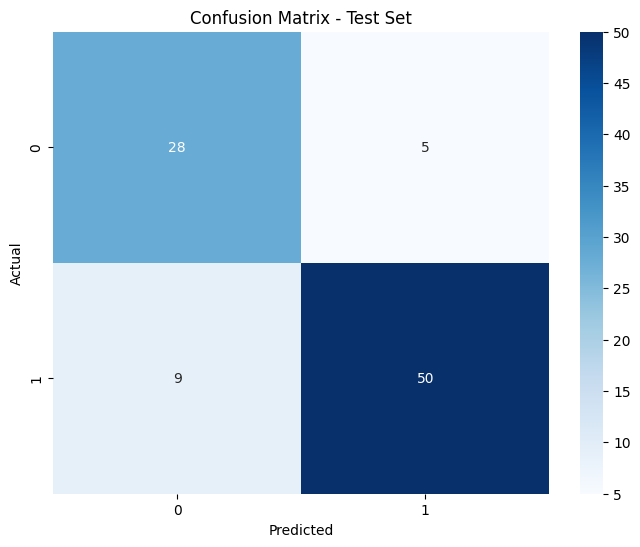

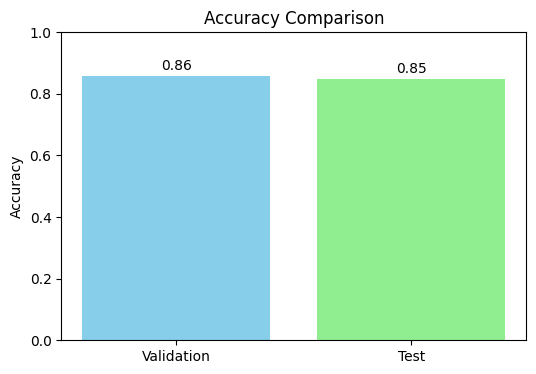

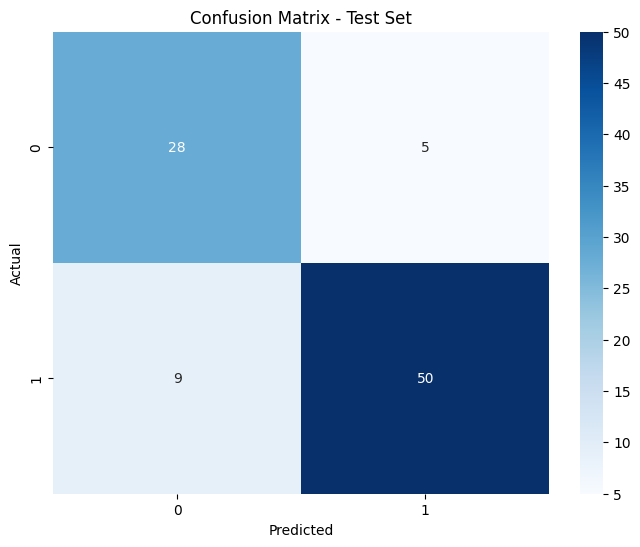

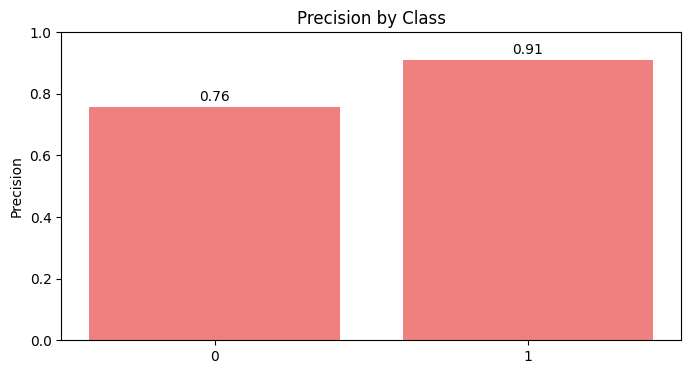

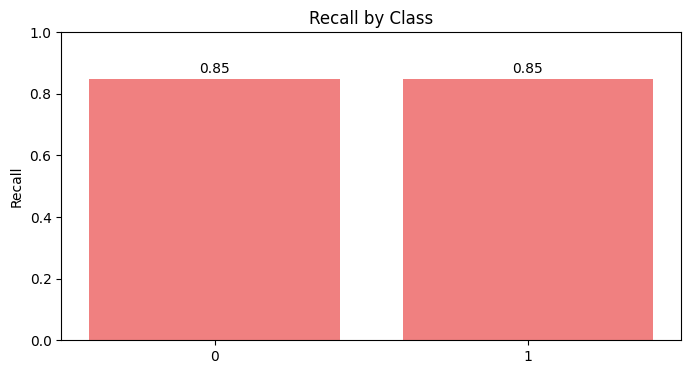

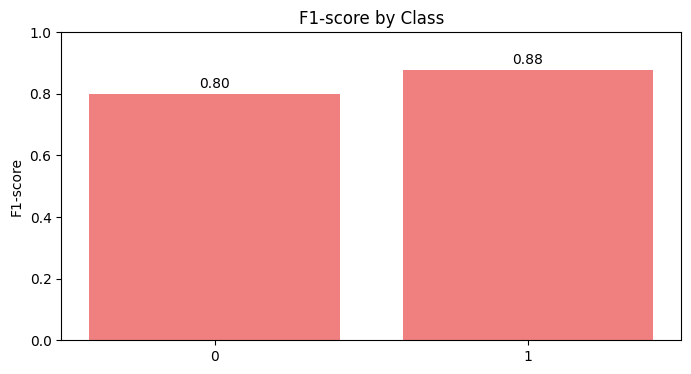

Scenario dataset_scenario_8_S with random completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


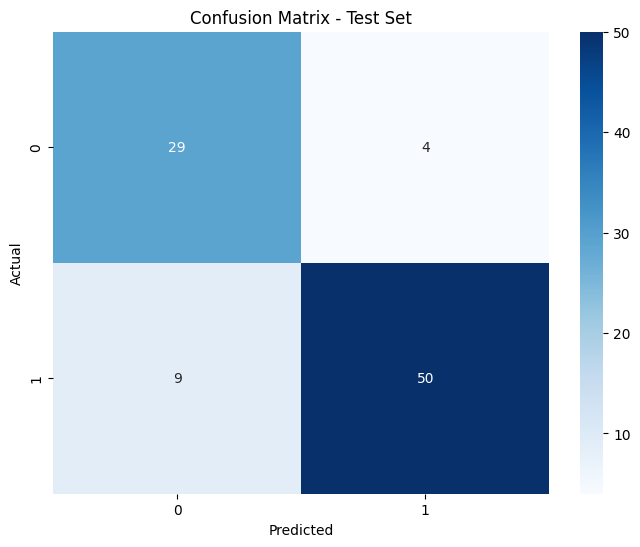

In [58]:
naive_bayes_random_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "NaiveBayes", "random", search_config_random, get_search_hyperparameters("NaiveBayes"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        naive_bayes_random_search['accuracy'] = best_score
        naive_bayes_random_search['params'] = best_params
        naive_bayes_random_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
nb = GaussianNB(**naive_bayes_random_search['params'])
best_scenario = pd.read_csv(naive_bayes_random_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, nb) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "NaiveBayes", "random")
save_model_info(naive_bayes_random_search, "NaiveBayes", "random")
    

## 3. Bayesian Optimization (Optuna)

[I 2024-12-06 02:13:05,577] A new study created in memory with name: no-name-4ba8acf1-86b8-4a08-857c-857467c2fe42


Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with optuna for dataset_scenario_1_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_1_N


[I 2024-12-06 02:13:07,359] Trial 0 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 2.632420840860523e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:08,514] Trial 1 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 4.644820514808978e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:09,579] Trial 2 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 5.046255384177021e-07}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:10,571] Trial 3 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 6.520171449692043e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:10,585] Trial 4 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 4.517719351154527e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:10,600] Trial 5 finished with value: 0.8488735465116278 and parameters

Best hyperparameters:  {'var_smoothing': 2.632420840860523e-06}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


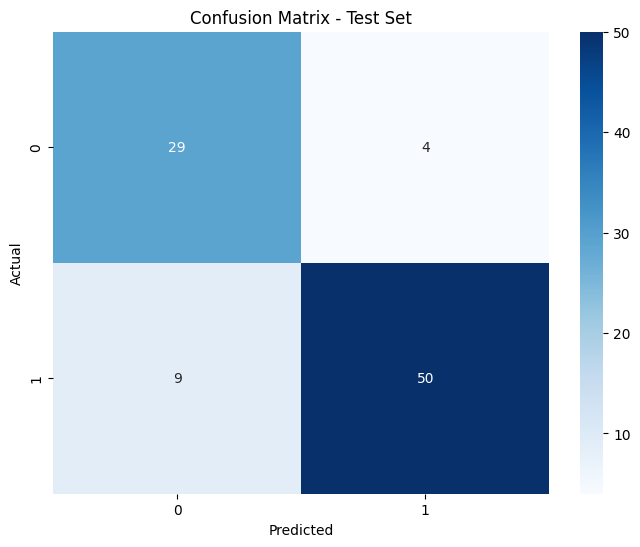

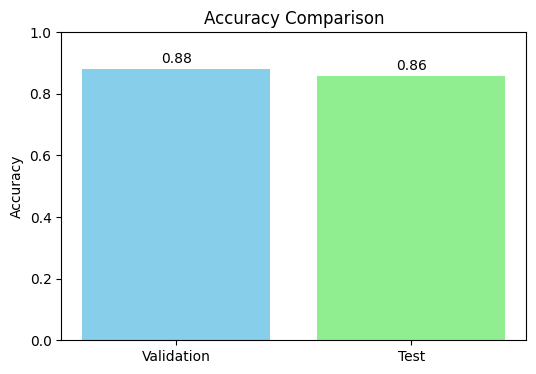

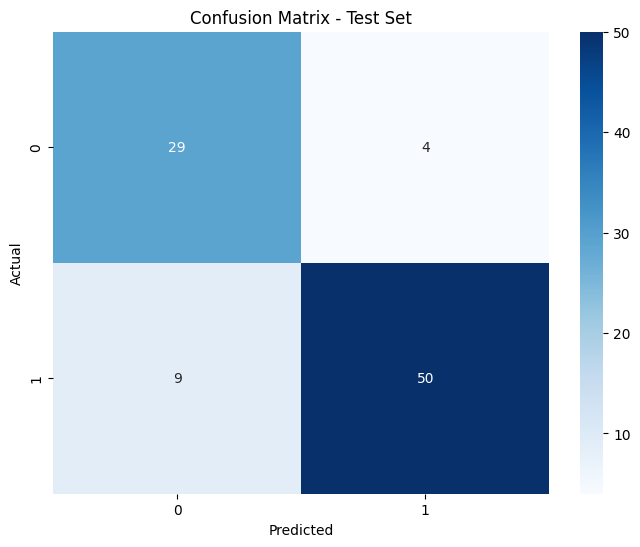

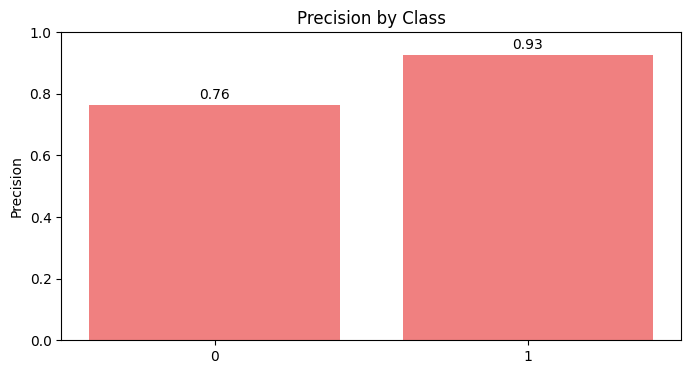

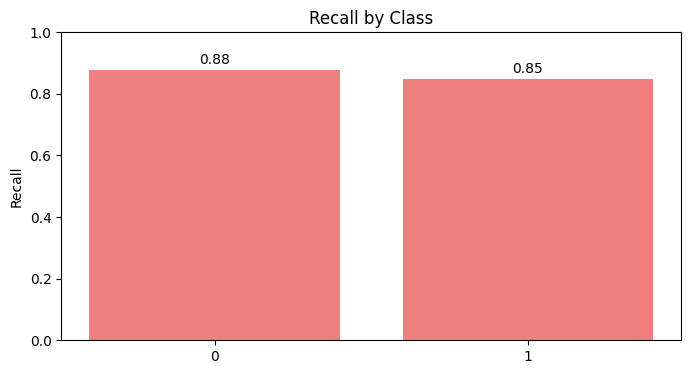

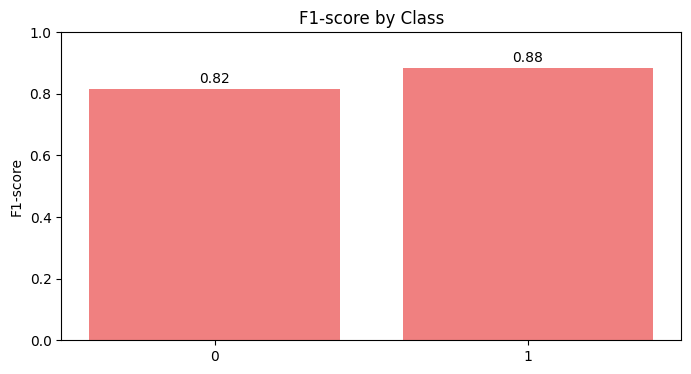

[I 2024-12-06 02:13:12,945] A new study created in memory with name: no-name-382ade88-48f7-46ab-9747-69d89ea89fe7
[I 2024-12-06 02:13:12,959] Trial 0 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 1.3427337231684786e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:12,973] Trial 1 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 3.5981581597285035e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:12,989] Trial 2 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 5.90619443847853e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,002] Trial 3 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 9.000537711856424e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,016] Trial 4 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 4.269126209832787e-06}. Best is trial 0 with va

Scenario dataset_scenario_1_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_1_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_1_S


[I 2024-12-06 02:13:13,137] Trial 12 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 2.3255970816793595e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,154] Trial 13 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 3.958015336529584e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,170] Trial 14 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 1.4267284678022807e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,187] Trial 15 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 3.3915854495438433e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,203] Trial 16 finished with value: 0.8488735465116278 and parameters: {'var_smoothing': 5.382294386367628e-06}. Best is trial 0 with value: 0.8488735465116278.
[I 2024-12-06 02:13:13,221] Trial 17 finished with value: 0.8488735465116278 and p

Best hyperparameters:  {'var_smoothing': 1.3427337231684786e-06}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


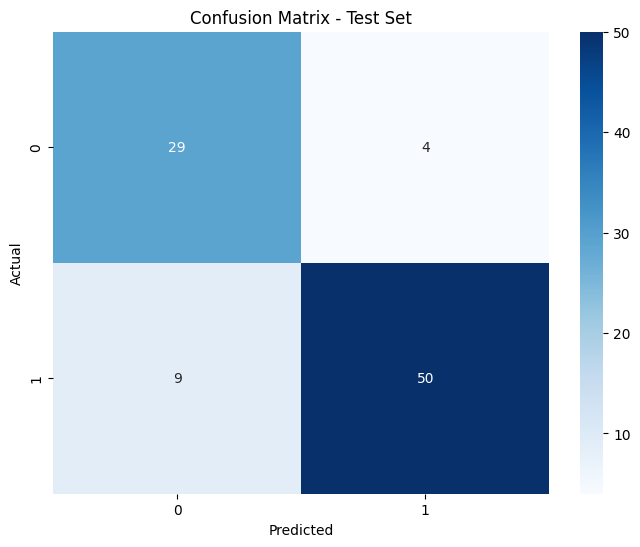

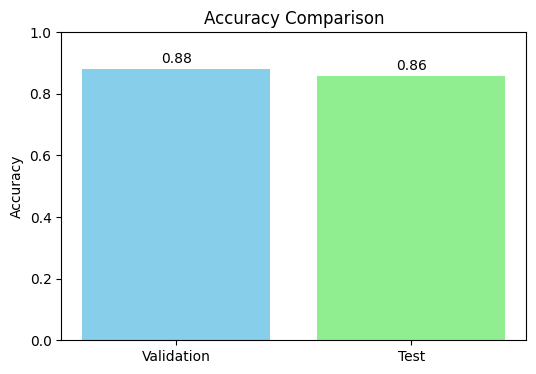

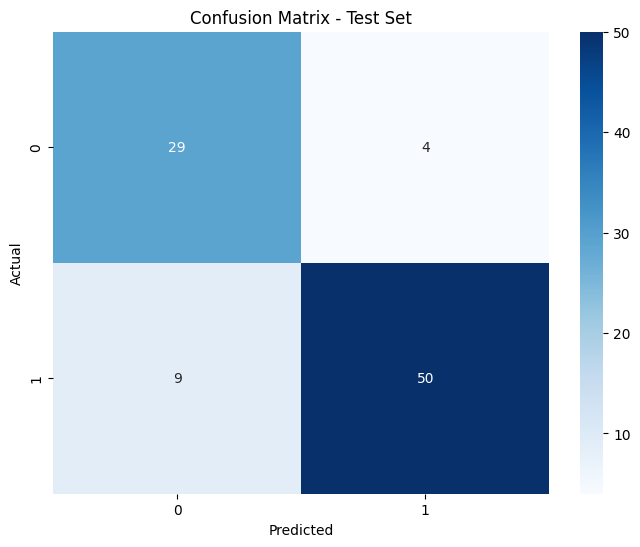

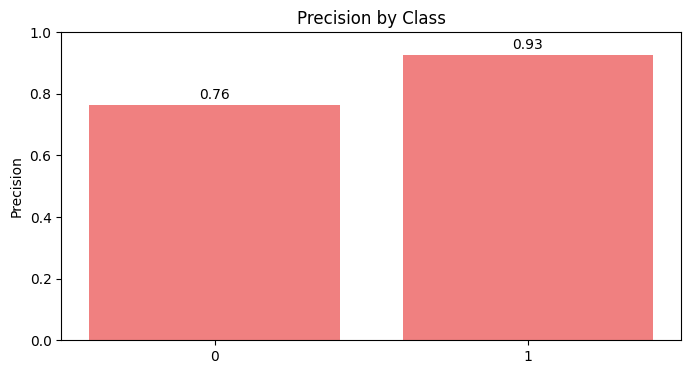

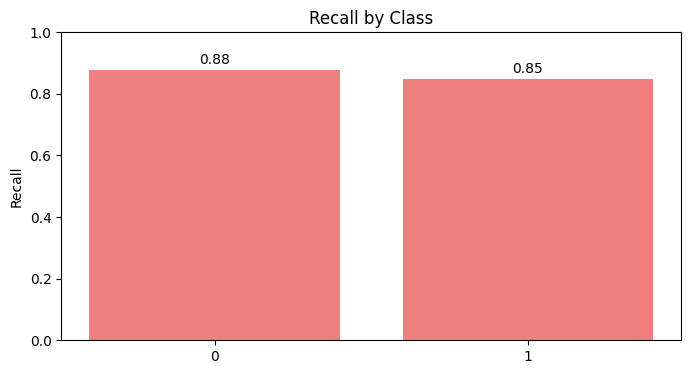

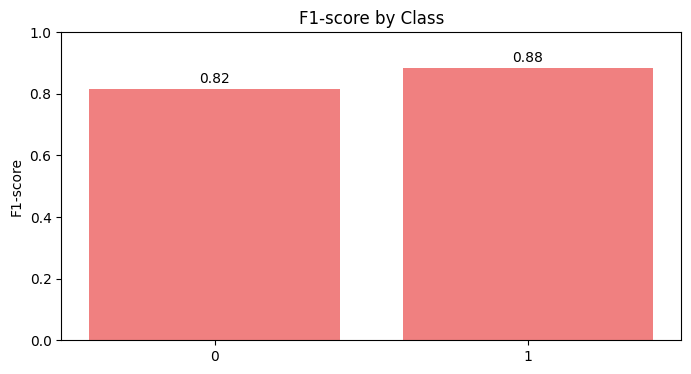

[I 2024-12-06 02:13:15,471] A new study created in memory with name: no-name-76e66e1b-9bc6-4a27-b908-66c874ed4c5d
[I 2024-12-06 02:13:15,485] Trial 0 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 2.689804858199003e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,499] Trial 1 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 7.174290175293556e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,513] Trial 2 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 4.7849695578598404e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,526] Trial 3 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 5.702467882553566e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,540] Trial 4 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 2.462270899211367e-06}. Best is trial 0 with va

Scenario dataset_scenario_1_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running NaiveBayes with optuna for dataset_scenario_2_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_2_N


[I 2024-12-06 02:13:15,661] Trial 12 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 7.355445186500247e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,677] Trial 13 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 4.081877380405596e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,695] Trial 14 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 7.263386703964566e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,712] Trial 15 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 7.228541345846301e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,729] Trial 16 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 3.3430998304331754e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:15,745] Trial 17 finished with value: 0.8489098837209301 and par

Best hyperparameters:  {'var_smoothing': 2.689804858199003e-06}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


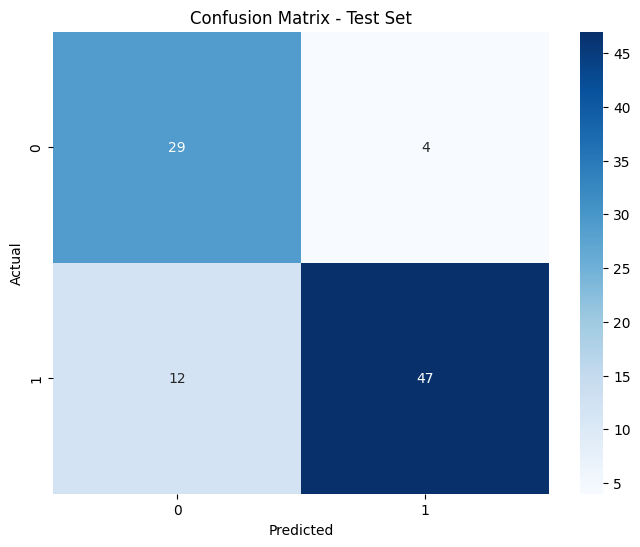

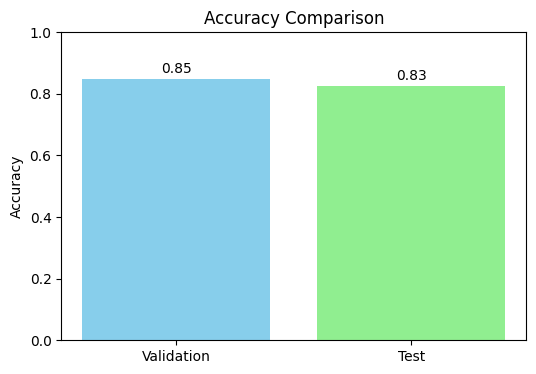

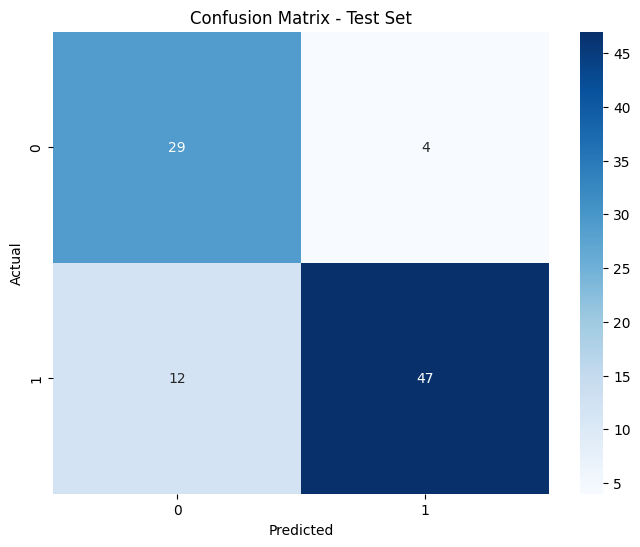

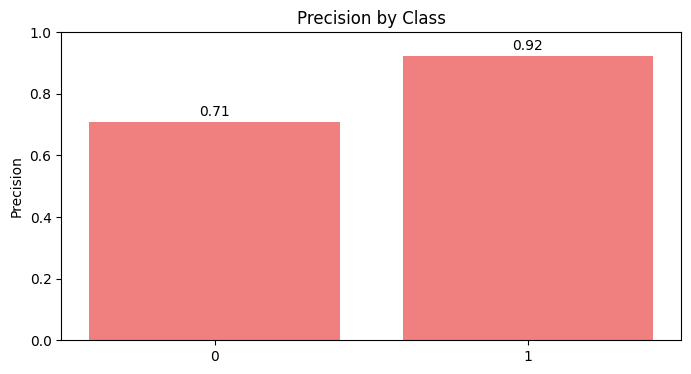

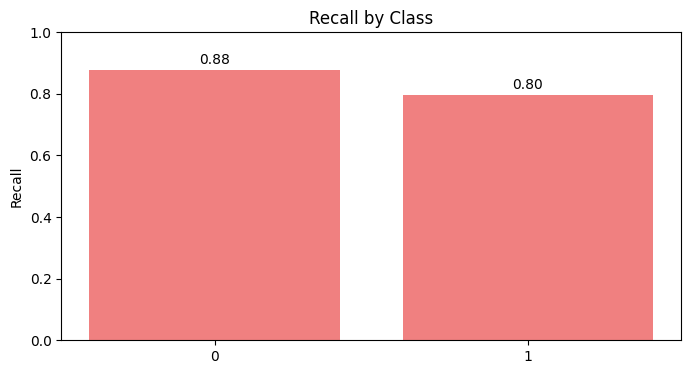

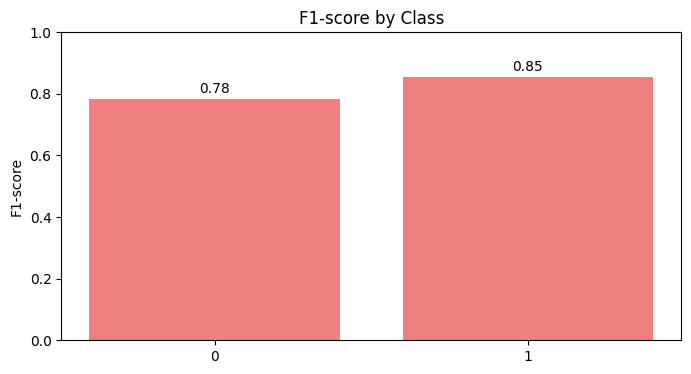

[I 2024-12-06 02:13:17,875] A new study created in memory with name: no-name-f49226e5-6726-4dce-94d0-86811bee15b5
[I 2024-12-06 02:13:17,889] Trial 0 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 3.938544671934712e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:17,903] Trial 1 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 8.056915620534977e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:17,917] Trial 2 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 8.63433678082885e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:17,931] Trial 3 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 1.5628219773567306e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:17,946] Trial 4 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 1.5536865236127764e-06}. Best is trial 0 with va

Scenario dataset_scenario_2_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_2_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_2_S


[I 2024-12-06 02:13:18,068] Trial 12 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 3.537738151965716e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:18,085] Trial 13 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 5.902850801627176e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:18,102] Trial 14 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 1.8443205784560825e-07}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:18,120] Trial 15 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 3.886336979268491e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:18,136] Trial 16 finished with value: 0.8489098837209301 and parameters: {'var_smoothing': 6.9925889885849195e-06}. Best is trial 0 with value: 0.8489098837209301.
[I 2024-12-06 02:13:18,153] Trial 17 finished with value: 0.8489098837209301 and pa

Best hyperparameters:  {'var_smoothing': 3.938544671934712e-06}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8447
  Recall: 0.8261
  F1 Score: 0.8292

Confusion Matrix (Test Set):
[[29  4]
 [12 47]]


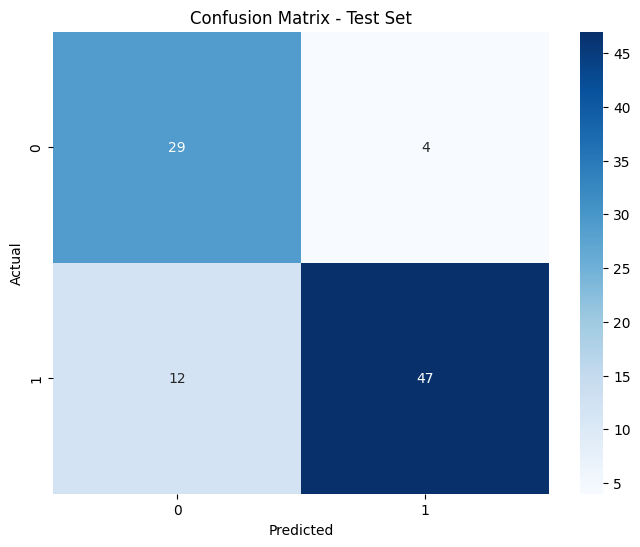

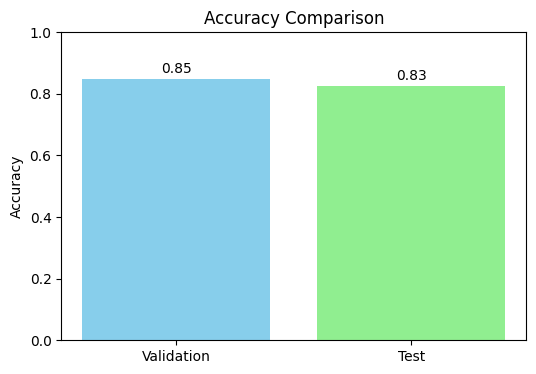

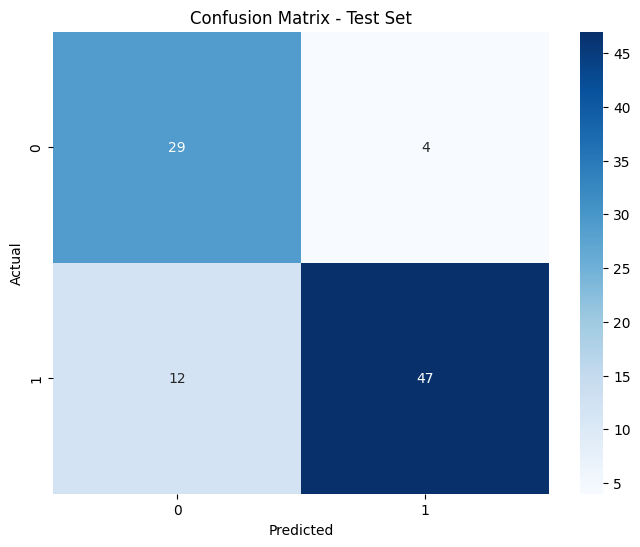

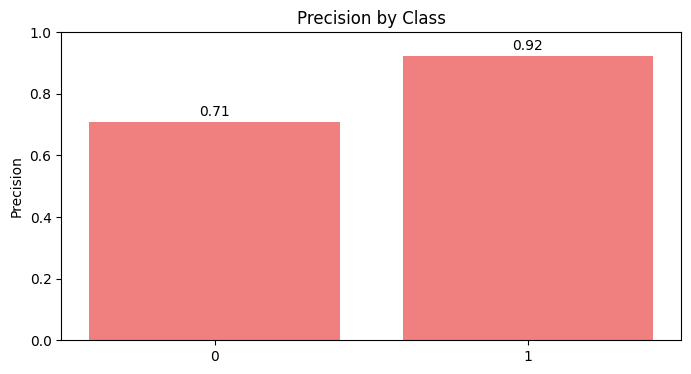

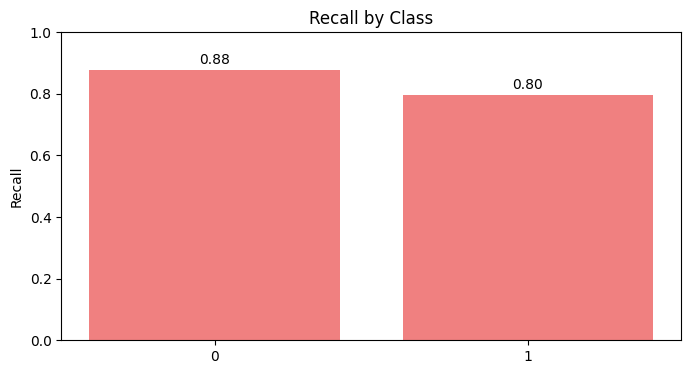

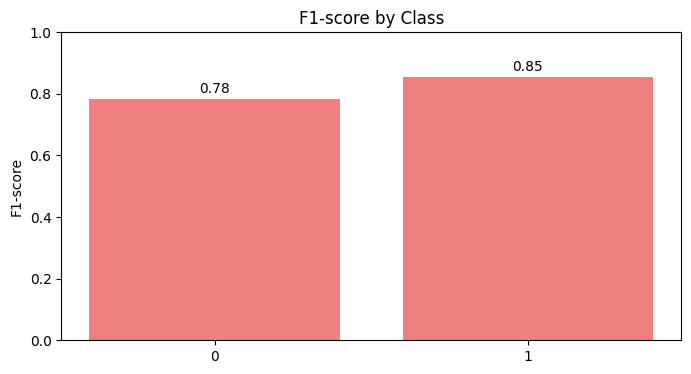

[I 2024-12-06 02:13:20,284] A new study created in memory with name: no-name-498a6b41-ba5e-4d09-aebd-87b07d6b6368
[I 2024-12-06 02:13:20,299] Trial 0 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 3.001054178199856e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,314] Trial 1 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 6.038338776237335e-07}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,329] Trial 2 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 5.551024457702445e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,343] Trial 3 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 4.041484072495886e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,357] Trial 4 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 6.134126912699573e-06}. Best is trial 0 with value: 0.839

Scenario dataset_scenario_2_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with optuna for dataset_scenario_3_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_3_N


[I 2024-12-06 02:13:20,488] Trial 10 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 2.8825129151004046e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,506] Trial 11 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 8.590301496848013e-08}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,523] Trial 12 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 2.0933695886277513e-07}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,539] Trial 13 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 1.7913694113024914e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,556] Trial 14 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 3.579765011406925e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:20,573] Trial 15 finished with value: 0.839105339105339 and parameters: 

Best hyperparameters:  {'var_smoothing': 3.001054178199856e-06}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


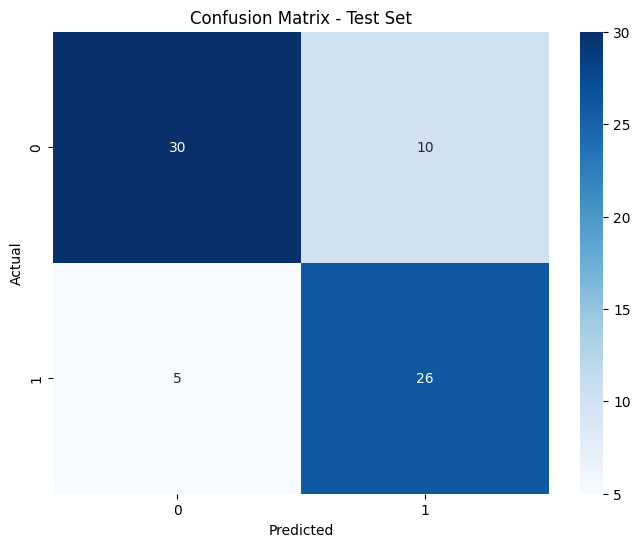

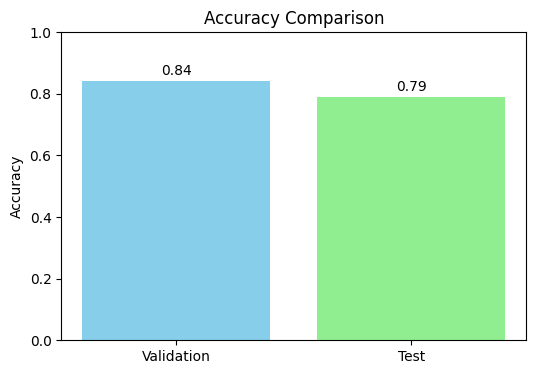

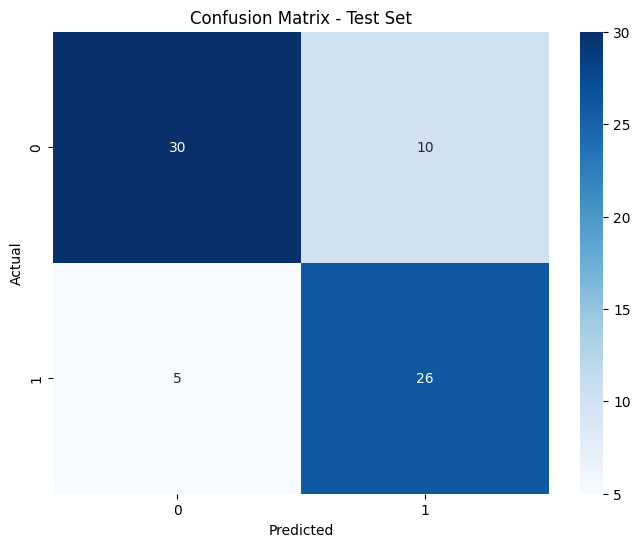

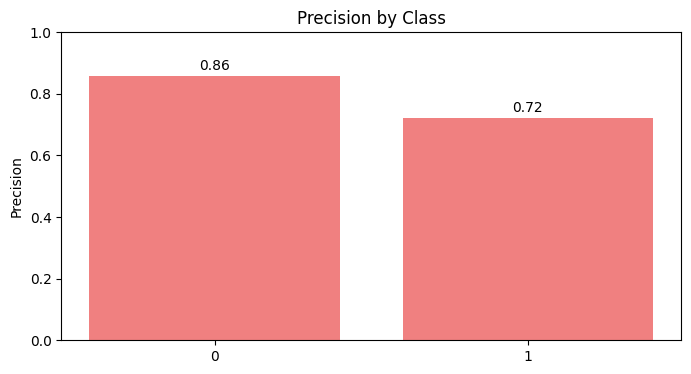

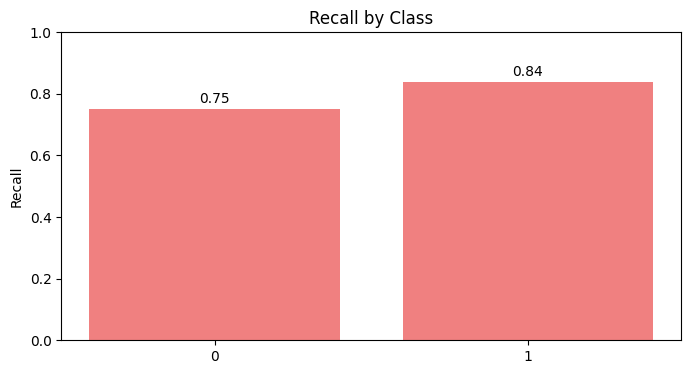

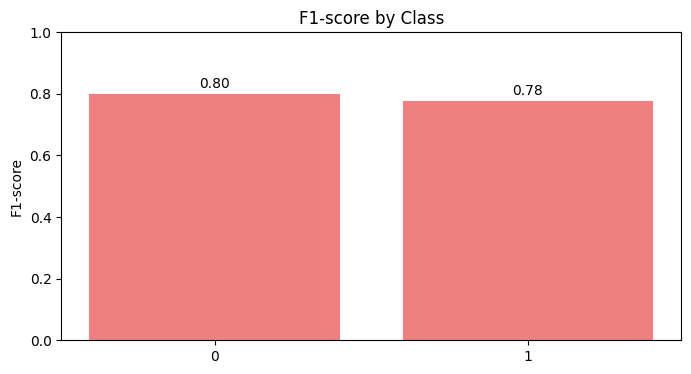

[I 2024-12-06 02:13:22,778] A new study created in memory with name: no-name-59dd4403-d6aa-4821-bd85-ad14ae620df2
[I 2024-12-06 02:13:22,792] Trial 0 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 3.5339272345133884e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:22,806] Trial 1 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 6.731136393389323e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:22,821] Trial 2 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 9.848559162909922e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:22,836] Trial 3 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 1.3547051746021537e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:22,850] Trial 4 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 3.9070017005256685e-06}. Best is trial 0 with value: 0.

Scenario dataset_scenario_3_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_3_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_3_S


[I 2024-12-06 02:13:22,975] Trial 12 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 8.0770488217021e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:22,993] Trial 13 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 4.002857872509889e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:23,010] Trial 14 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 4.961004325253794e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:23,028] Trial 15 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 7.658169325455252e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:23,046] Trial 16 finished with value: 0.839105339105339 and parameters: {'var_smoothing': 3.599235721496007e-06}. Best is trial 0 with value: 0.839105339105339.
[I 2024-12-06 02:13:23,068] Trial 17 finished with value: 0.839105339105339 and parameters: {'var

Best hyperparameters:  {'var_smoothing': 3.5339272345133884e-06}
Validation Metrics:
  Accuracy: 0.8429
  Precision: 0.8427
  Recall: 0.8429
  F1 Score: 0.8426

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.7982
  Recall: 0.7887
  F1 Score: 0.7896

Confusion Matrix (Test Set):
[[30 10]
 [ 5 26]]


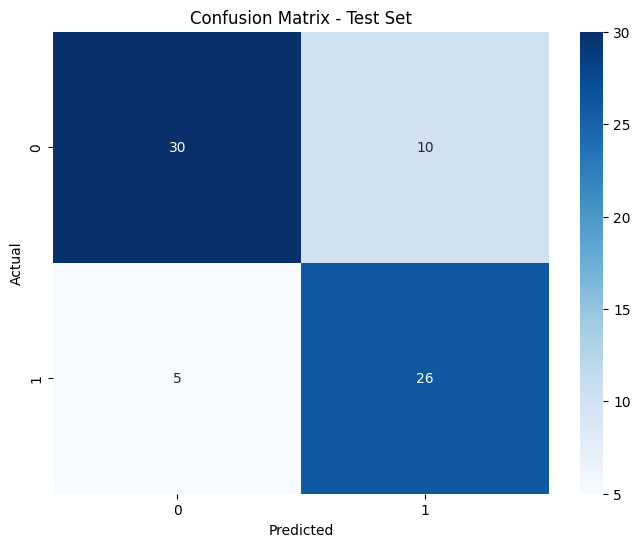

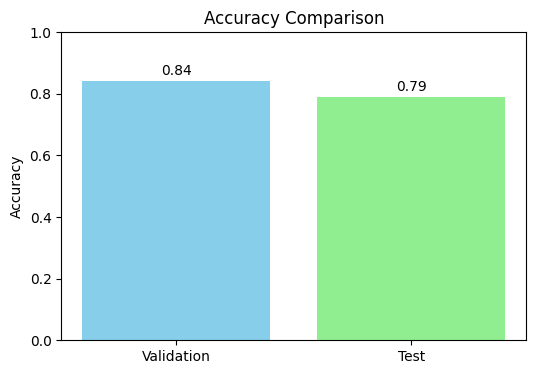

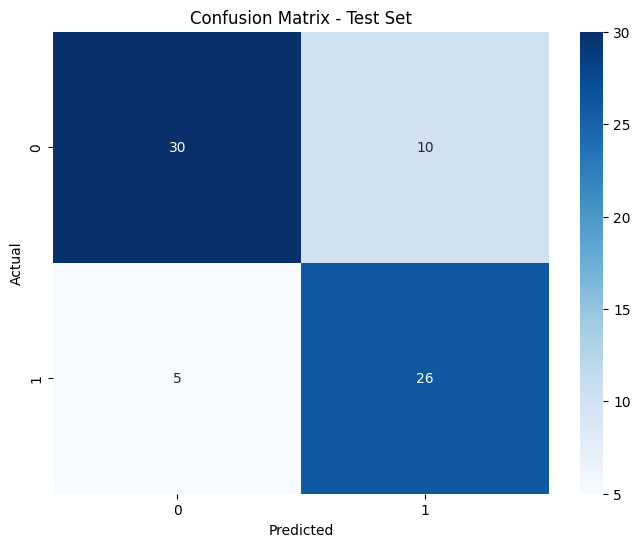

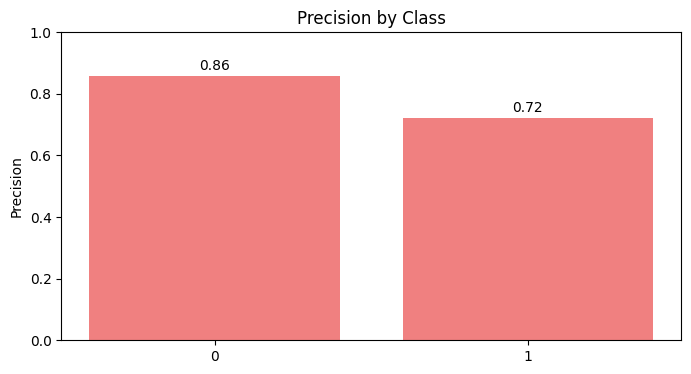

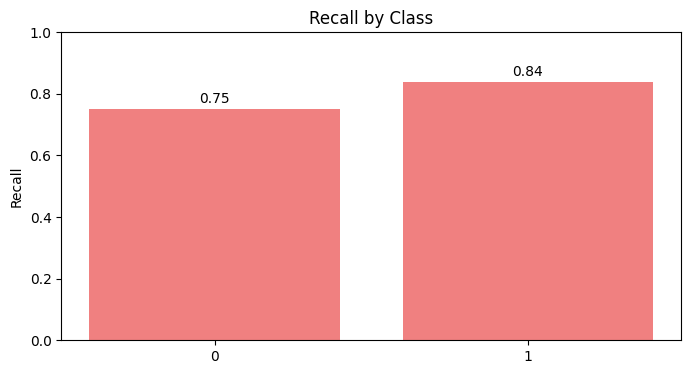

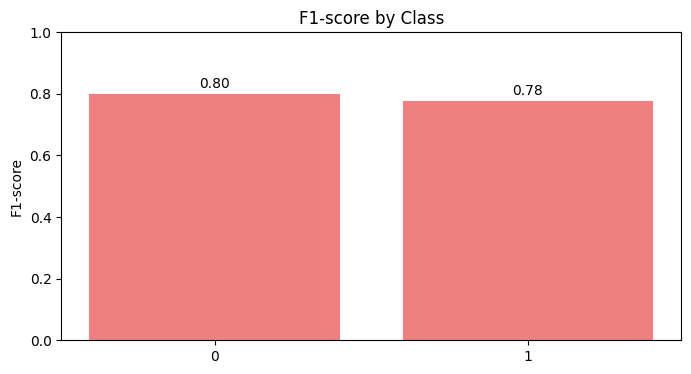

[I 2024-12-06 02:13:25,208] A new study created in memory with name: no-name-7f1cd056-67dc-4cee-9667-c5eb29dcad19
[I 2024-12-06 02:13:25,222] Trial 0 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 1.1682261917397e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,237] Trial 1 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.755504918177589e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,251] Trial 2 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 6.276407422953519e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,265] Trial 3 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 2.326883535934575e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,279] Trial 4 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 6.521075330673194e-06}. Best is trial 0 with value

Scenario dataset_scenario_3_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with optuna for dataset_scenario_4_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_4_N


[I 2024-12-06 02:13:25,401] Trial 12 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 8.797031207239044e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,419] Trial 13 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 4.7047269941726976e-08}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,437] Trial 14 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.835258343184437e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,454] Trial 15 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 1.2230258091852553e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,472] Trial 16 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 4.206580270115512e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:25,490] Trial 17 finished with value: 0.8520227713178293 and pa

Best hyperparameters:  {'var_smoothing': 1.1682261917397e-06}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


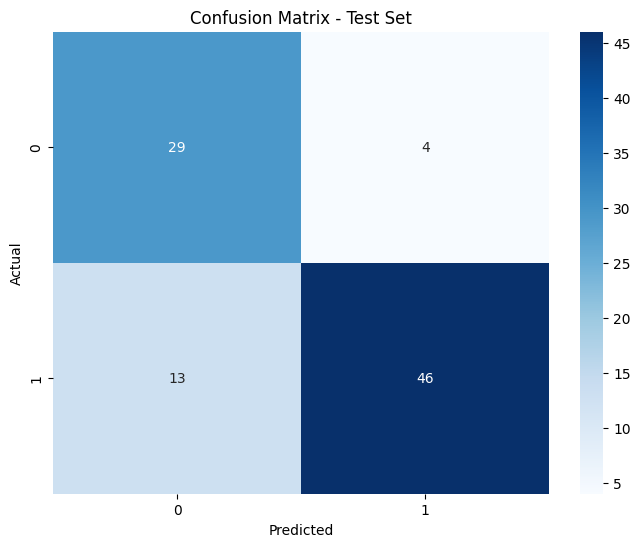

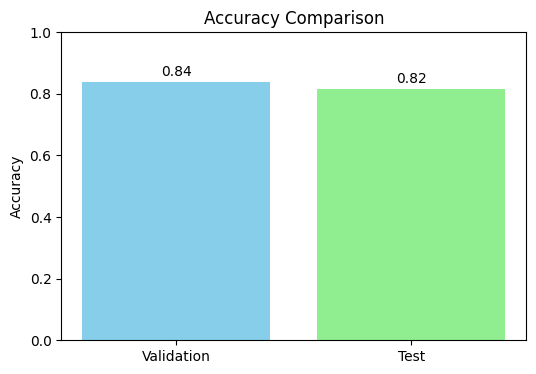

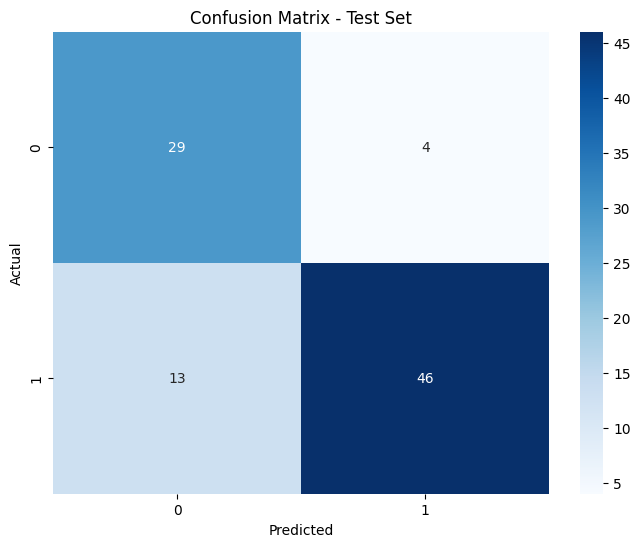

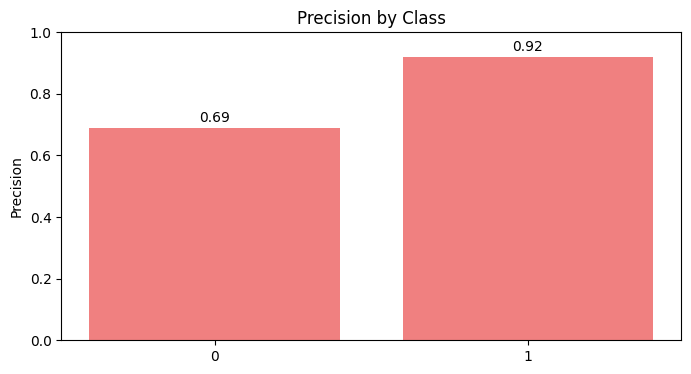

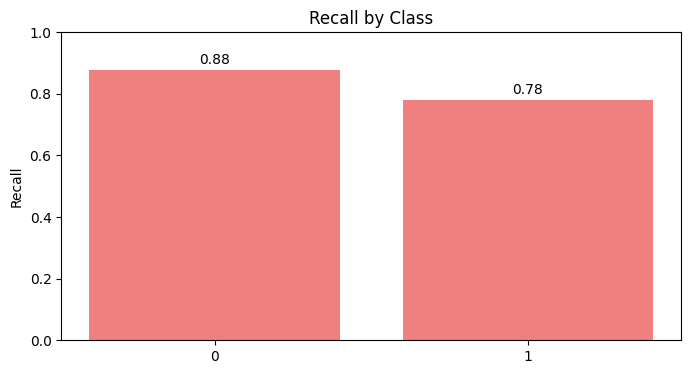

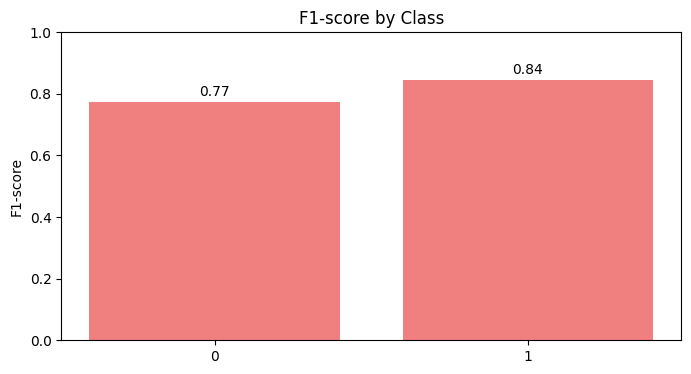

[I 2024-12-06 02:13:27,860] A new study created in memory with name: no-name-35ca9151-8c5c-4589-9568-c0a1cacc8565
[I 2024-12-06 02:13:27,876] Trial 0 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 1.5128200364296693e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:27,890] Trial 1 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.2767938203124587e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:27,906] Trial 2 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 9.990024913048894e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:27,921] Trial 3 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.2868225011996345e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:27,935] Trial 4 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 2.5136752100139894e-06}. Best is trial 0 with

Scenario dataset_scenario_4_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_4_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_4_S


[I 2024-12-06 02:13:28,065] Trial 12 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 4.77000088713105e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:28,082] Trial 13 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.50879662898998e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:28,113] Trial 14 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 1.4847191611289903e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:28,145] Trial 15 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 5.946448078666291e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:28,178] Trial 16 finished with value: 0.8520227713178293 and parameters: {'var_smoothing': 3.3512385903222683e-06}. Best is trial 0 with value: 0.8520227713178293.
[I 2024-12-06 02:13:28,196] Trial 17 finished with value: 0.8520227713178293 and para

Best hyperparameters:  {'var_smoothing': 1.5128200364296693e-06}
Validation Metrics:
  Accuracy: 0.8370
  Precision: 0.8434
  Recall: 0.8370
  F1 Score: 0.8377

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8377
  Recall: 0.8152
  F1 Score: 0.8187

Confusion Matrix (Test Set):
[[29  4]
 [13 46]]


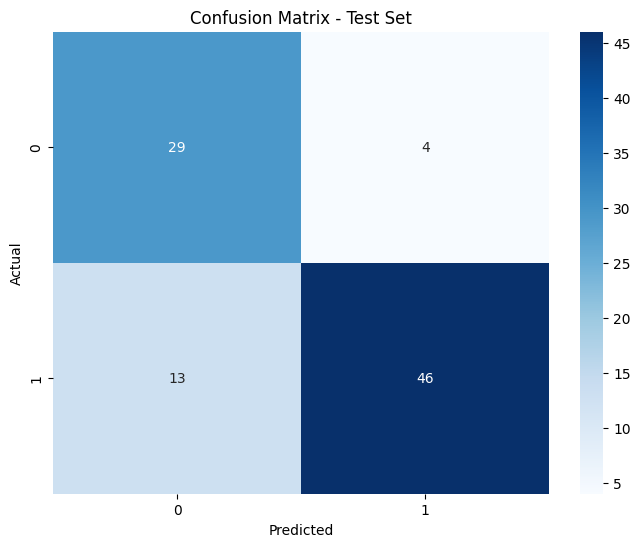

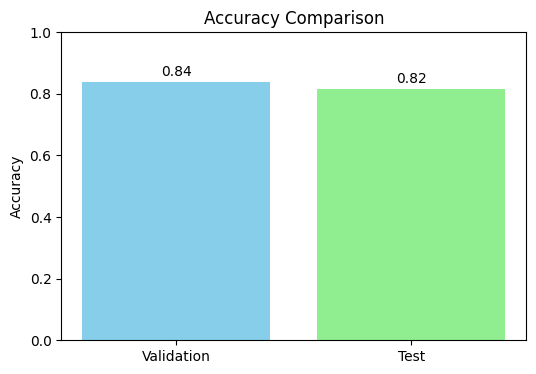

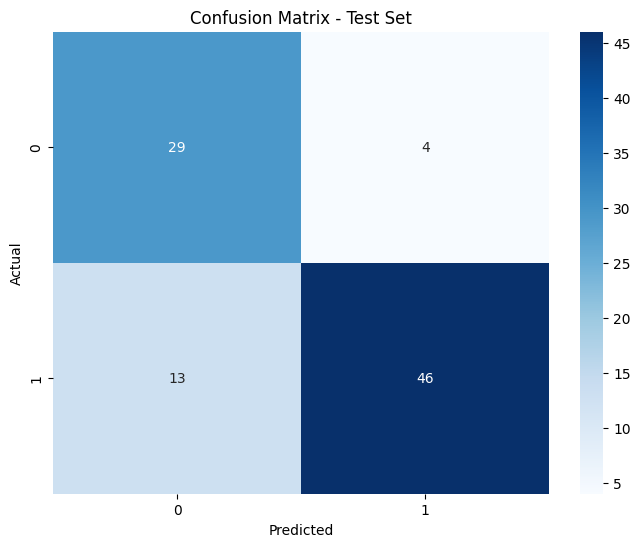

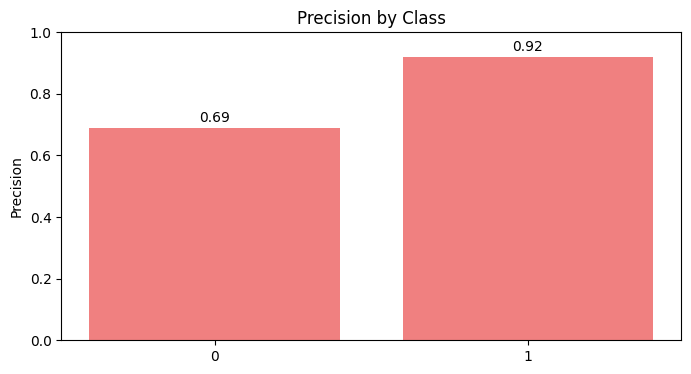

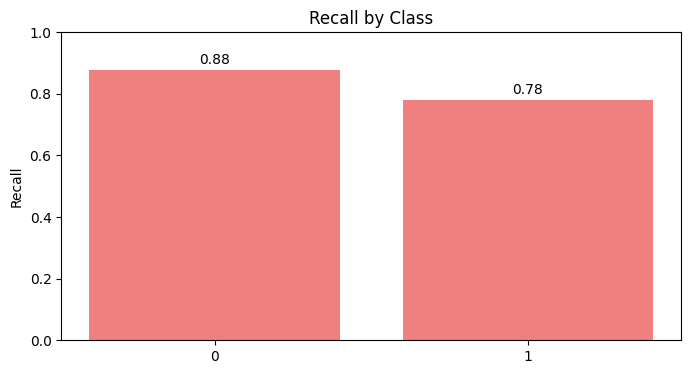

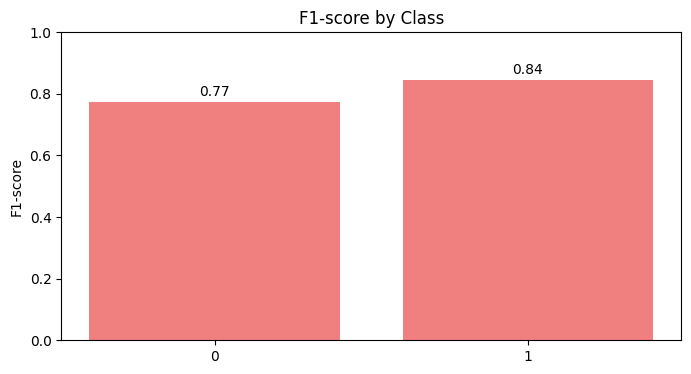

[I 2024-12-06 02:13:30,413] A new study created in memory with name: no-name-12ad88a3-fb8e-4cfd-a665-a59962a5d1bd
[I 2024-12-06 02:13:30,427] Trial 0 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 1.680152083081836e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,441] Trial 1 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 7.268805468730835e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,455] Trial 2 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 8.359279729088596e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,469] Trial 3 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 1.200728981383612e-07}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,484] Trial 4 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 6.257414899299208e-06}. Best is trial 0 with val

Scenario dataset_scenario_4_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with optuna for dataset_scenario_5_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_5_N


[I 2024-12-06 02:13:30,607] Trial 12 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 2.4628610826974764e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,624] Trial 13 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 2.8063357574124e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,640] Trial 14 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 8.293812465853021e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,659] Trial 15 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 1.6809931219086461e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,676] Trial 16 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 6.260474845596704e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:30,695] Trial 17 finished with value: 0.8239704457364342 and para

Best hyperparameters:  {'var_smoothing': 1.680152083081836e-06}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


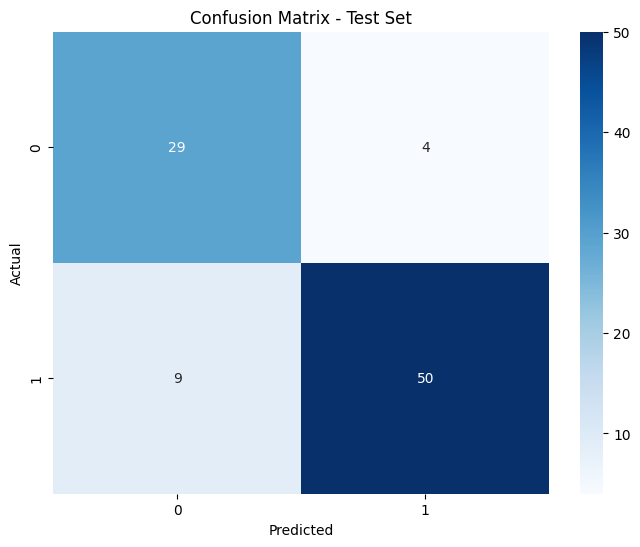

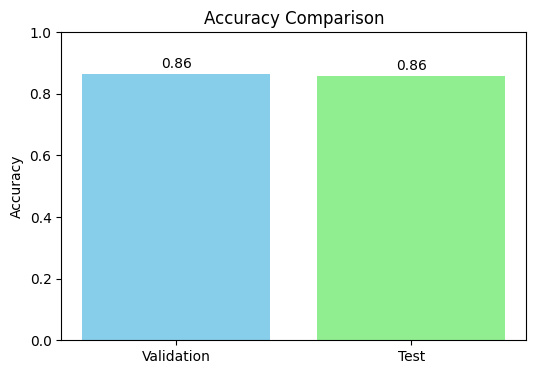

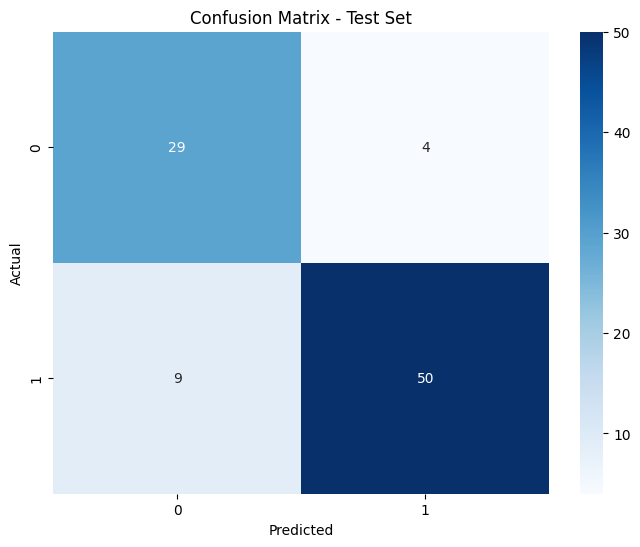

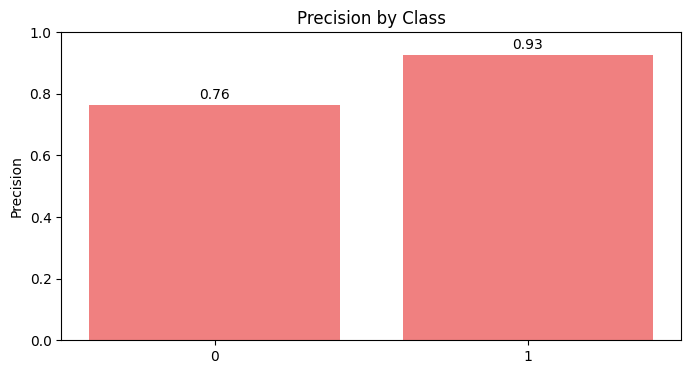

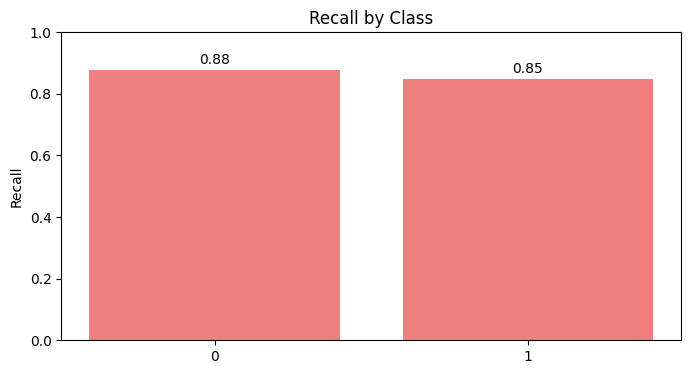

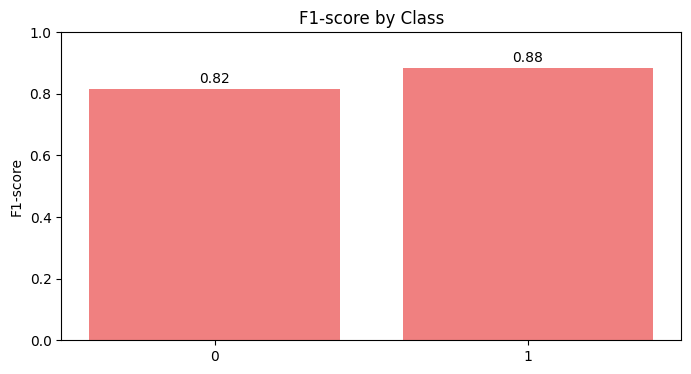

[I 2024-12-06 02:13:32,826] A new study created in memory with name: no-name-3943dd58-6997-4ead-a1e8-f7ffceb5f96d
[I 2024-12-06 02:13:32,840] Trial 0 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 9.560722029036645e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:32,855] Trial 1 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 6.558440353589104e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:32,869] Trial 2 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 5.168224324185287e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:32,882] Trial 3 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 4.481721349043447e-07}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:32,897] Trial 4 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 5.661188007884459e-07}. Best is trial 0 with val

Scenario dataset_scenario_5_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_5_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_5_S


[I 2024-12-06 02:13:33,019] Trial 12 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 7.152423502374655e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:33,037] Trial 13 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 3.9769020868247875e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:33,053] Trial 14 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 5.0300775382737364e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:33,070] Trial 15 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 7.957700847966849e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:33,088] Trial 16 finished with value: 0.8239704457364342 and parameters: {'var_smoothing': 5.956105871513116e-06}. Best is trial 0 with value: 0.8239704457364342.
[I 2024-12-06 02:13:33,105] Trial 17 finished with value: 0.8239704457364342 and pa

Best hyperparameters:  {'var_smoothing': 9.560722029036645e-06}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


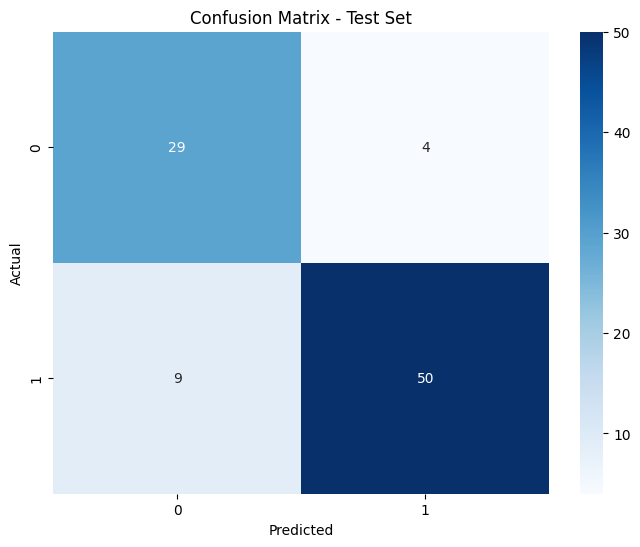

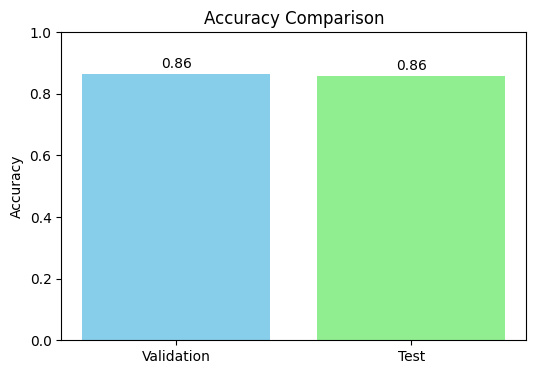

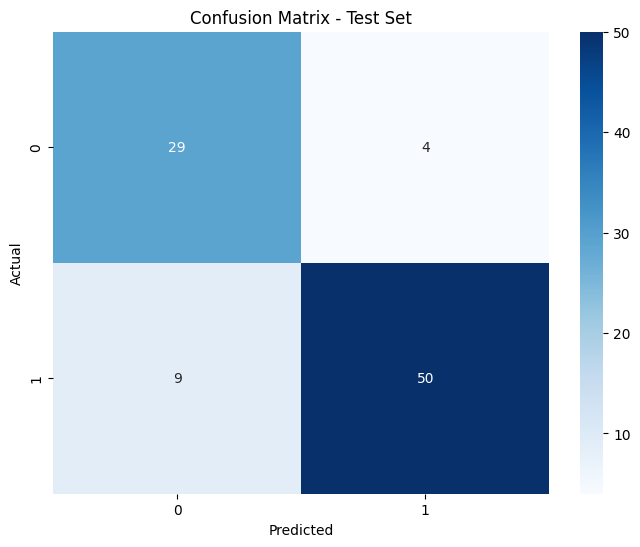

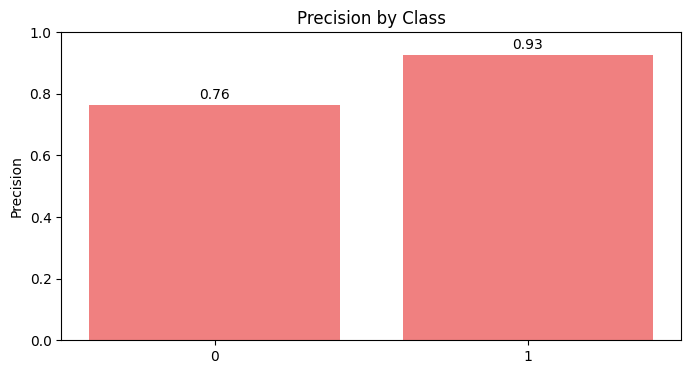

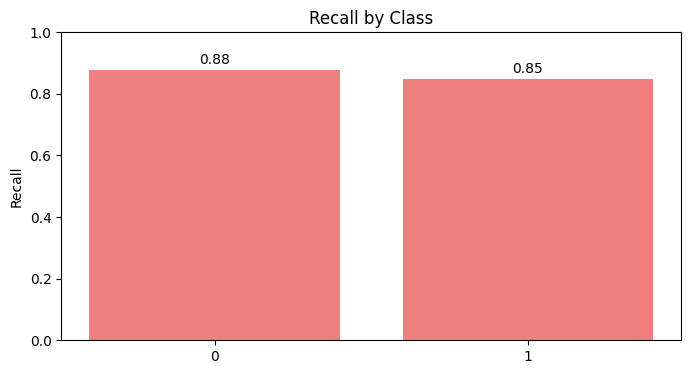

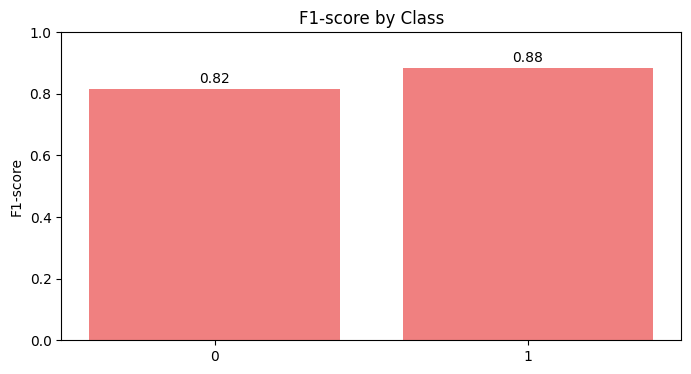

[I 2024-12-06 02:13:35,259] A new study created in memory with name: no-name-78760214-497c-4f99-9e73-b98656248ee1
[I 2024-12-06 02:13:35,272] Trial 0 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 8.899628011251837e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,286] Trial 1 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 4.213140295731525e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,301] Trial 2 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 3.7514452164781136e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,316] Trial 3 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 9.767845300231717e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,329] Trial 4 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 9.568125202978235e-06}. Best is trial 0 with va

Scenario dataset_scenario_5_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with optuna for dataset_scenario_6_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_6_N


[I 2024-12-06 02:13:35,467] Trial 12 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 5.705104687414085e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,487] Trial 13 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 8.222414983839191e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,517] Trial 14 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 4.821945781364028e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,537] Trial 15 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 2.429699550794393e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,556] Trial 16 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 8.443153108795785e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:35,574] Trial 17 finished with value: 0.8240067829457365 and para

Best hyperparameters:  {'var_smoothing': 8.899628011251837e-06}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


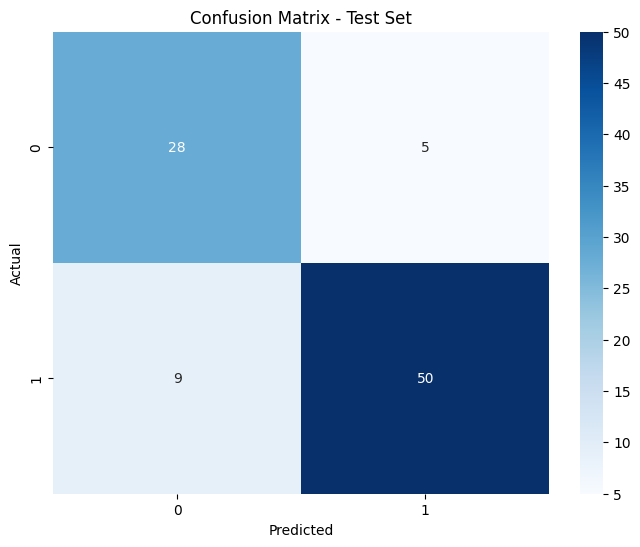

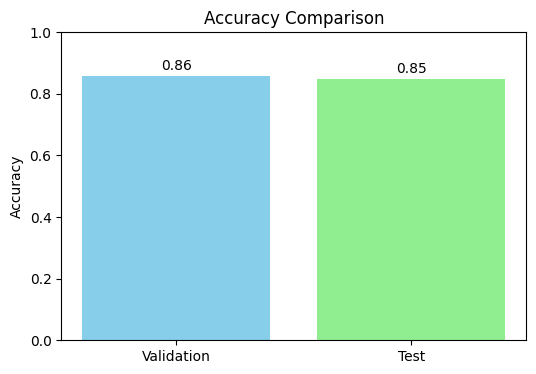

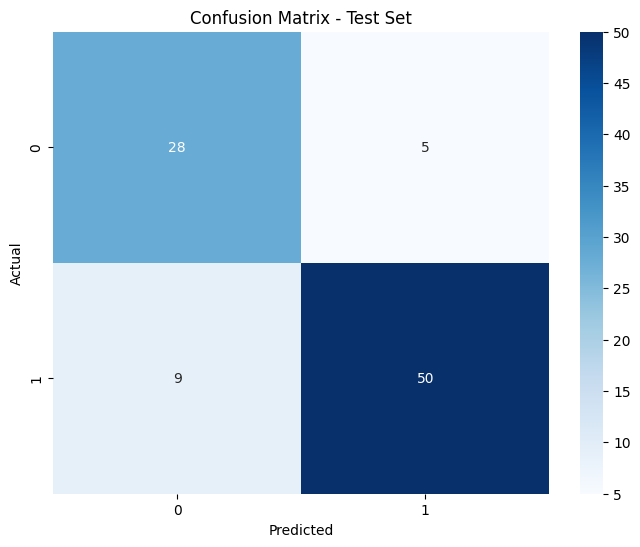

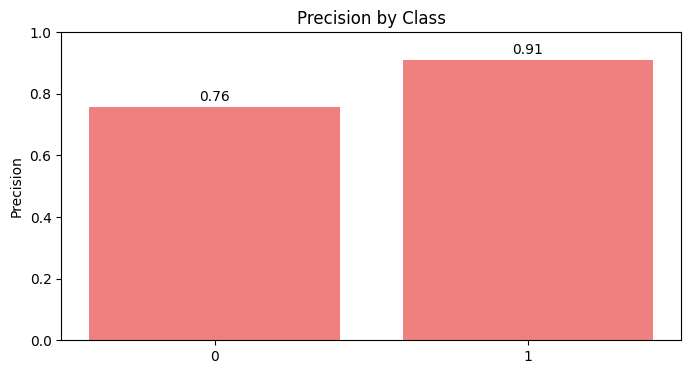

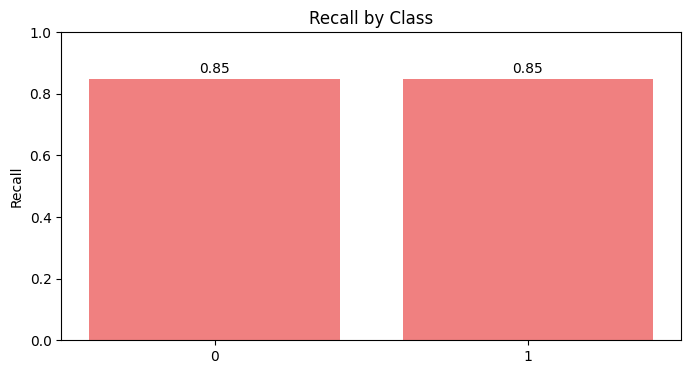

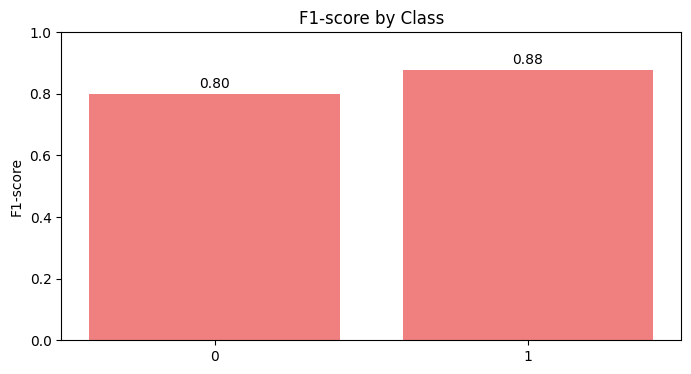

[I 2024-12-06 02:13:37,831] A new study created in memory with name: no-name-54b81703-5651-4456-8c64-b3c19654fa6e
[I 2024-12-06 02:13:37,846] Trial 0 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 9.41086007431803e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:37,860] Trial 1 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 2.492951926841418e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:37,874] Trial 2 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 4.980997461649556e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:37,889] Trial 3 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 6.9124204863415195e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:37,904] Trial 4 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 7.672932800021556e-06}. Best is trial 0 with val

Scenario dataset_scenario_6_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_6_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_6_S


[I 2024-12-06 02:13:38,025] Trial 12 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 2.1286796229135475e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:38,042] Trial 13 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 1.1504399550722784e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:38,060] Trial 14 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 3.248167713028743e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:38,076] Trial 15 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 8.783164504079962e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:38,094] Trial 16 finished with value: 0.8240067829457365 and parameters: {'var_smoothing': 4.141920496204752e-06}. Best is trial 0 with value: 0.8240067829457365.
[I 2024-12-06 02:13:38,112] Trial 17 finished with value: 0.8240067829457365 and pa

Best hyperparameters:  {'var_smoothing': 9.41086007431803e-06}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


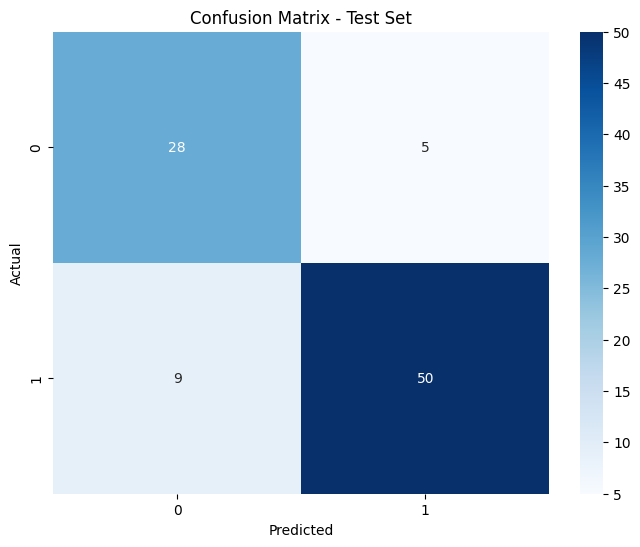

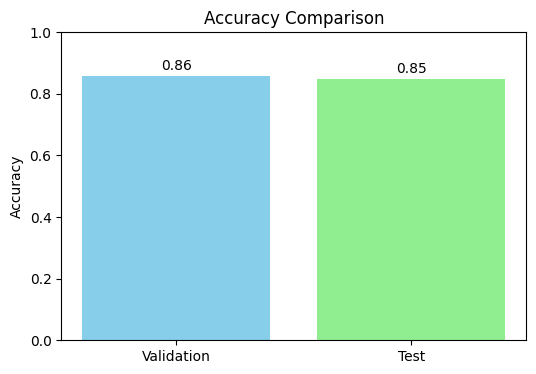

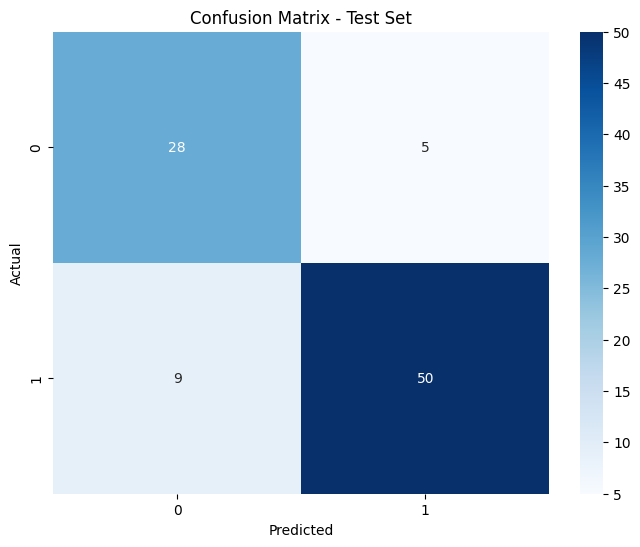

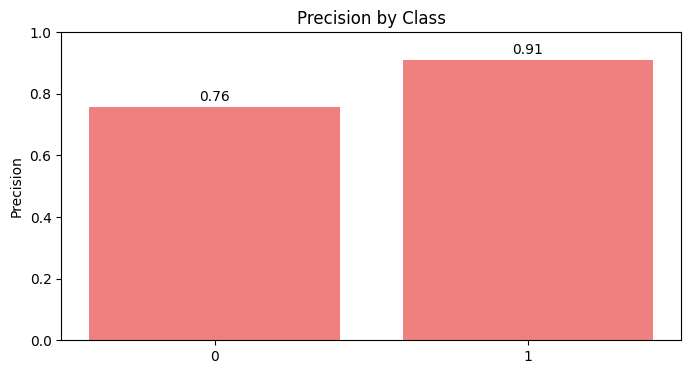

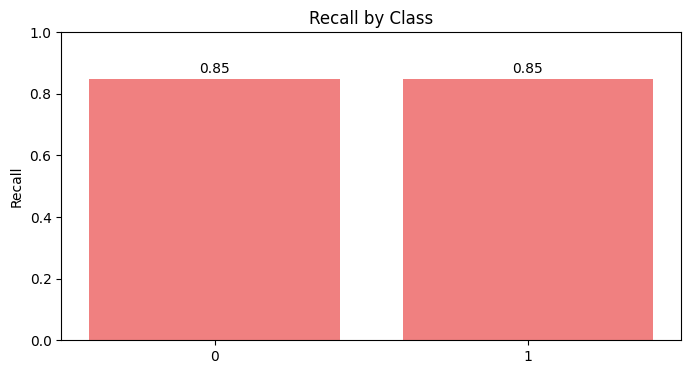

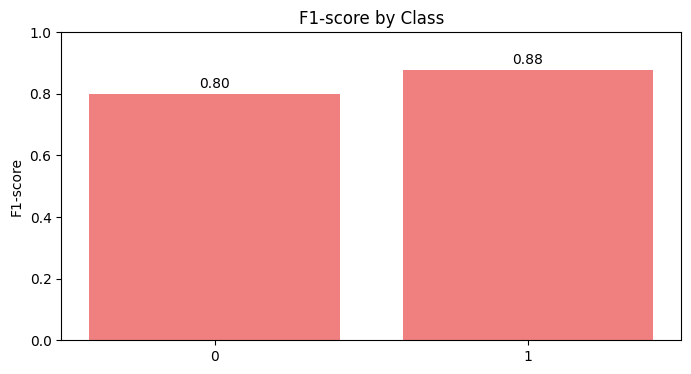

[I 2024-12-06 02:13:40,446] A new study created in memory with name: no-name-582f4aa1-4ba5-484e-a9c1-a3b8c601e4d2
[I 2024-12-06 02:13:40,460] Trial 0 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 4.108060317514233e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,475] Trial 1 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 1.987539999937296e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,490] Trial 2 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 6.383475614222166e-07}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,504] Trial 3 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 2.2271781132148797e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,518] Trial 4 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 1.079933603628851e-06}. Best is trial 0 with va

Scenario dataset_scenario_6_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running NaiveBayes with optuna for dataset_scenario_7_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_7_N


[I 2024-12-06 02:13:40,652] Trial 12 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 3.176379024947512e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,682] Trial 13 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 5.76300675069644e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,716] Trial 14 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 9.814874195645395e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,737] Trial 15 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 2.3227652100411283e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,760] Trial 16 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 1.4895301260082587e-08}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:40,777] Trial 17 finished with value: 0.8310039167182024 and par

Best hyperparameters:  {'var_smoothing': 4.108060317514233e-06}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


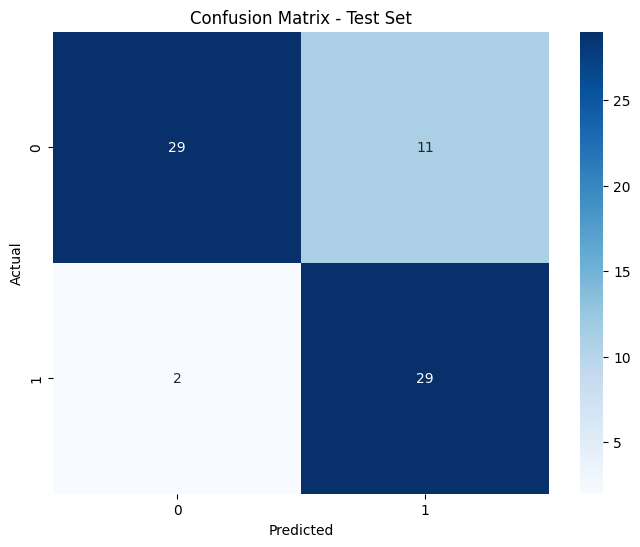

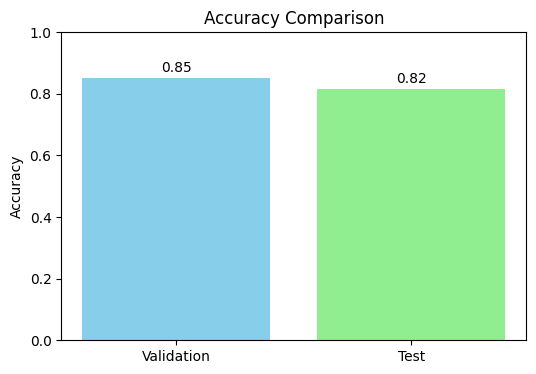

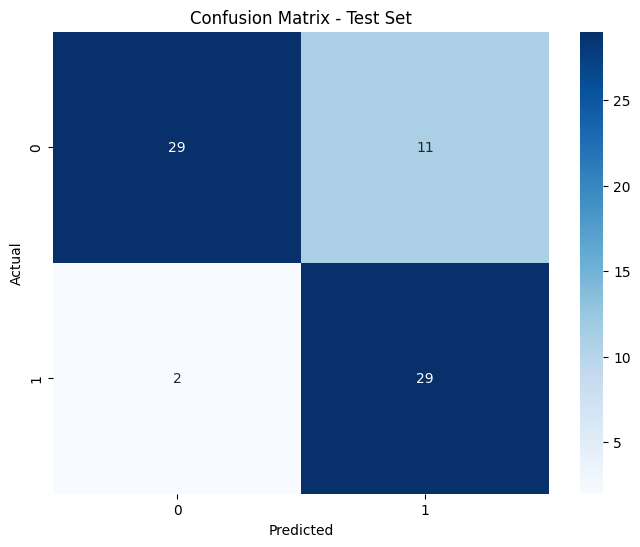

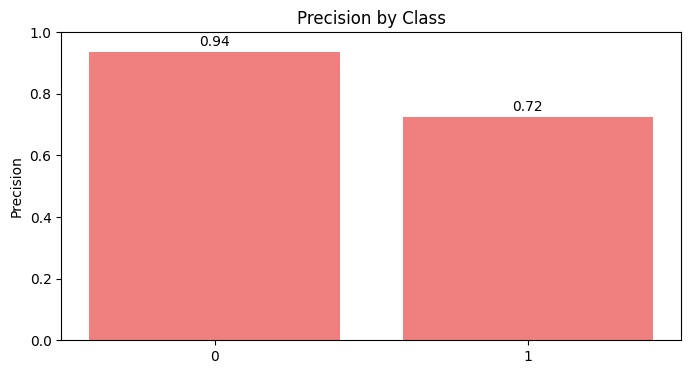

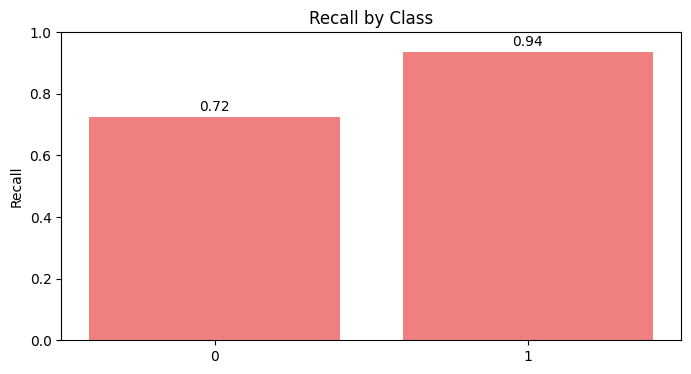

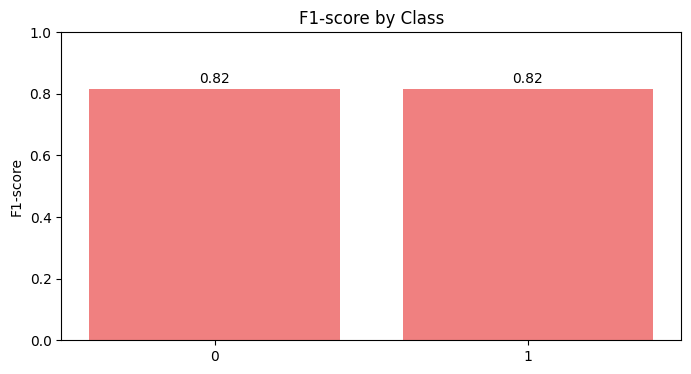

[I 2024-12-06 02:13:42,955] A new study created in memory with name: no-name-f9d56ddb-a379-4cdf-b831-deeb8f59ced5
[I 2024-12-06 02:13:42,983] Trial 0 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 4.056152301405757e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:42,999] Trial 1 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 6.059312801123986e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,025] Trial 2 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 9.998550038826543e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,041] Trial 3 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 5.174096498047991e-08}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,057] Trial 4 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 6.905370993900648e-06}. Best is trial 0 with val

Scenario dataset_scenario_7_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_7_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_7_S


[I 2024-12-06 02:13:43,144] Trial 10 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 3.932352362022068e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,161] Trial 11 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 6.336845745728493e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,178] Trial 12 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 2.8187930075810055e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,196] Trial 13 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 5.948200492442544e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,213] Trial 14 finished with value: 0.8310039167182024 and parameters: {'var_smoothing': 7.565447998360235e-06}. Best is trial 0 with value: 0.8310039167182024.
[I 2024-12-06 02:13:43,231] Trial 15 finished with value: 0.8310039167182024 and par

Best hyperparameters:  {'var_smoothing': 4.056152301405757e-06}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8499
  Recall: 0.8500
  F1 Score: 0.8499

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8436
  Recall: 0.8169
  F1 Score: 0.8169

Confusion Matrix (Test Set):
[[29 11]
 [ 2 29]]


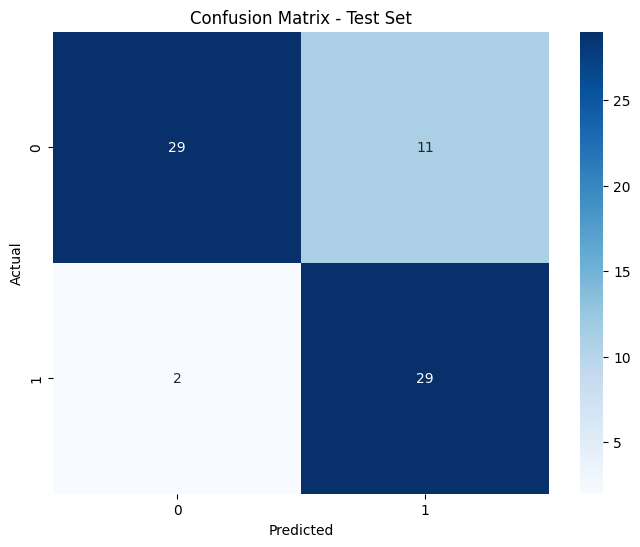

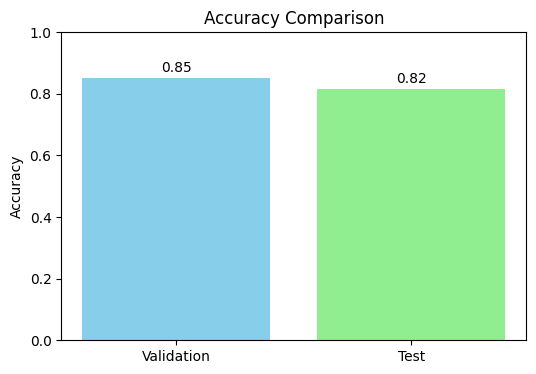

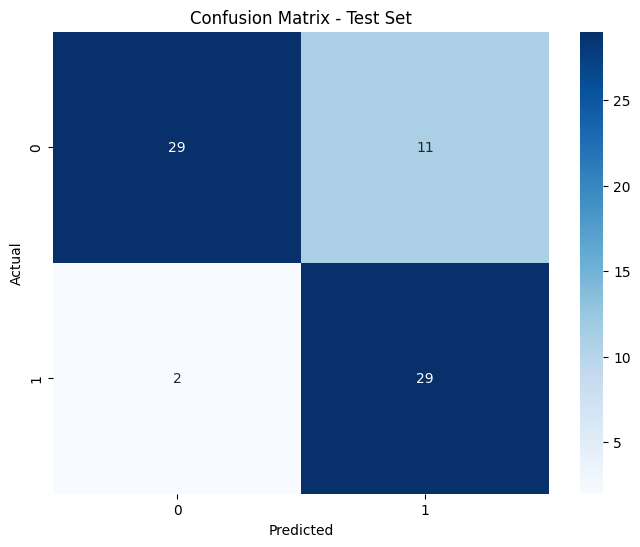

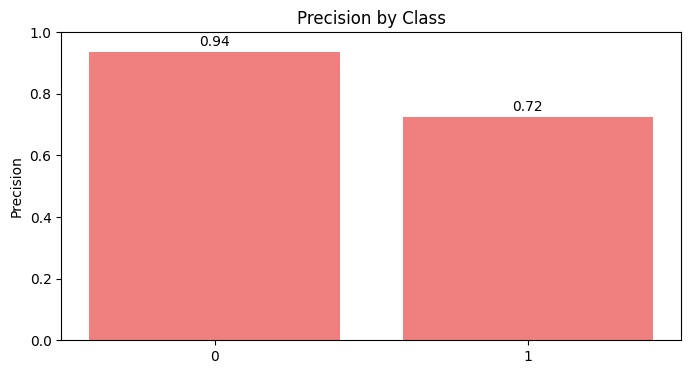

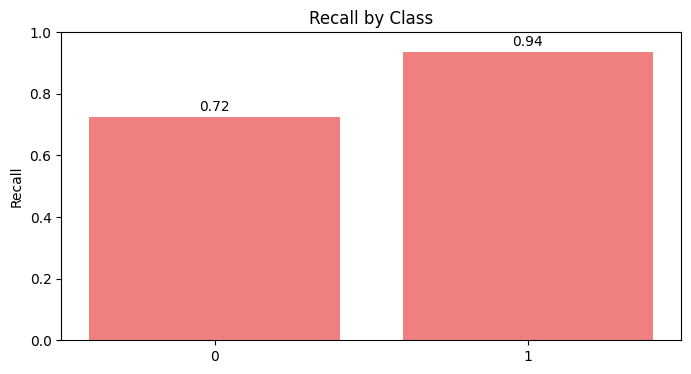

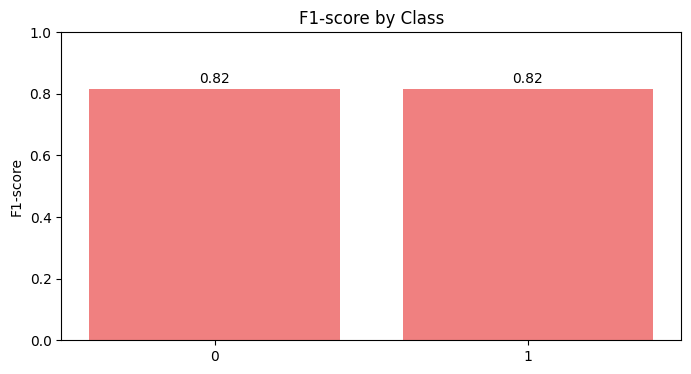

[I 2024-12-06 02:13:45,430] A new study created in memory with name: no-name-c3662f54-f340-40a6-aa19-f6b532267660
[I 2024-12-06 02:13:45,444] Trial 0 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.461777121049186e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,458] Trial 1 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.2143973179766875e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,472] Trial 2 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 6.738182009612007e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,487] Trial 3 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 8.86561754510571e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,502] Trial 4 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 8.871666487769486e-06}. Best is trial 0 with val

Scenario dataset_scenario_7_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running NaiveBayes with optuna for dataset_scenario_8_N...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_8_N


[I 2024-12-06 02:13:45,639] Trial 12 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.1312130093979123e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,656] Trial 13 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.6830005812134863e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,674] Trial 14 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 4.627697668536494e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,691] Trial 15 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.1192011553055196e-07}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,708] Trial 16 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 2.3574801860483806e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:45,726] Trial 17 finished with value: 0.8286579457364341 and 

Best hyperparameters:  {'var_smoothing': 1.461777121049186e-06}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


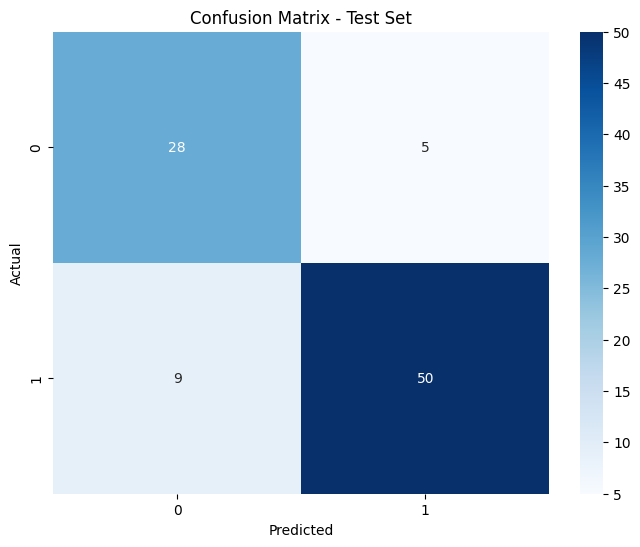

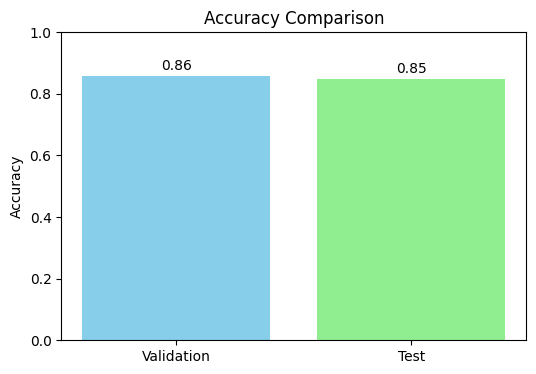

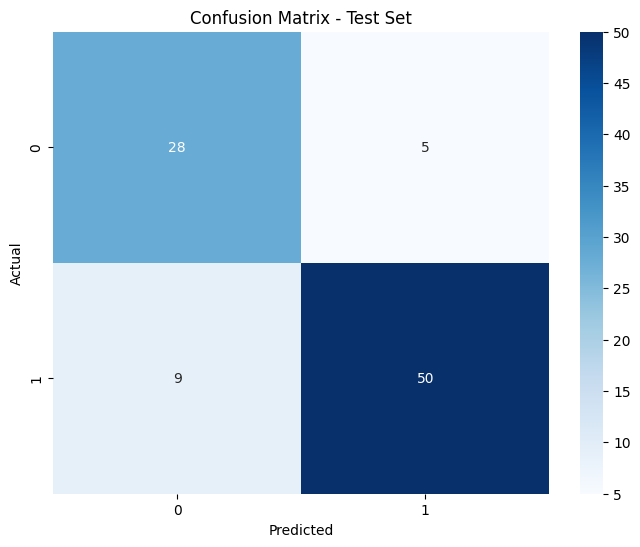

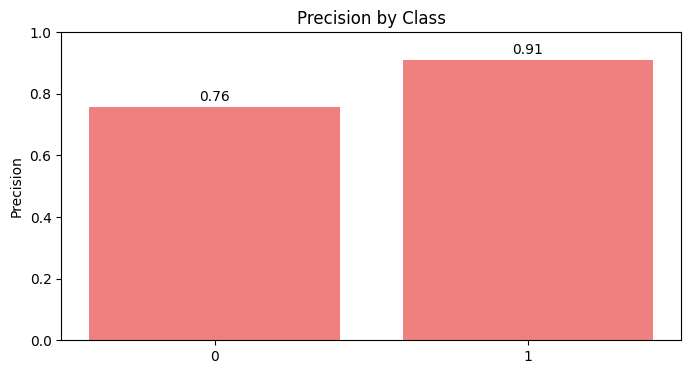

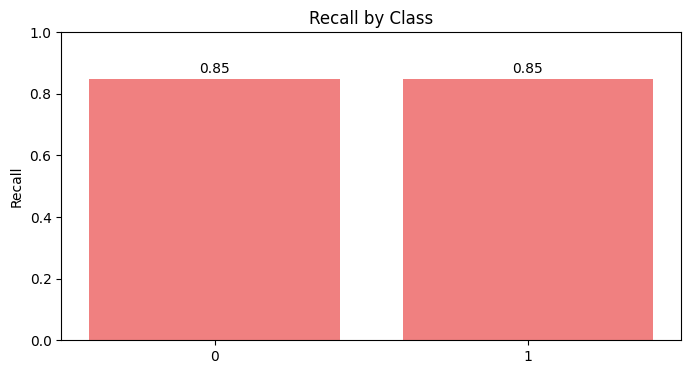

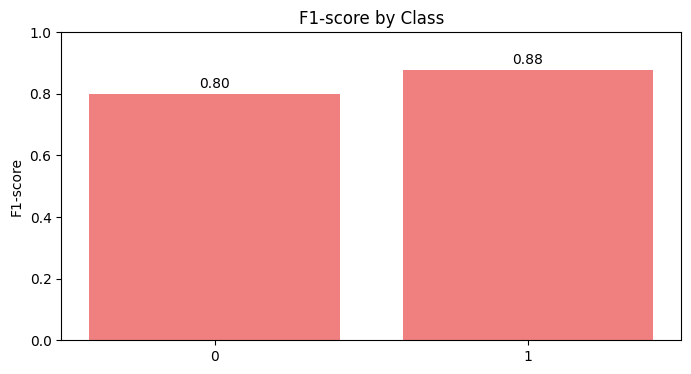

[I 2024-12-06 02:13:47,880] A new study created in memory with name: no-name-06463a38-84d0-4e26-9786-e8548f4d5c1f
[I 2024-12-06 02:13:47,895] Trial 0 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 7.982847493187408e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:47,909] Trial 1 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 5.526995710672426e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:47,923] Trial 2 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 5.3409514085884585e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:47,948] Trial 3 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 9.886040130884677e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:47,975] Trial 4 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 3.5732873022090596e-06}. Best is trial 0 with v

Scenario dataset_scenario_8_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running NaiveBayes with optuna for dataset_scenario_8_S...
Results will be saved in: SCORES\NaiveBayes\optuna\dataset_scenario_8_S


[I 2024-12-06 02:13:48,065] Trial 10 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 1.2151006708899692e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:48,083] Trial 11 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 6.360805957450979e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:48,100] Trial 12 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 3.5644864057800543e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:48,117] Trial 13 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 8.130101667073753e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:48,134] Trial 14 finished with value: 0.8286579457364341 and parameters: {'var_smoothing': 5.7917607631434106e-06}. Best is trial 0 with value: 0.8286579457364341.
[I 2024-12-06 02:13:48,152] Trial 15 finished with value: 0.8286579457364341 and p

Best hyperparameters:  {'var_smoothing': 7.982847493187408e-06}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8615
  Recall: 0.8587
  F1 Score: 0.8592

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8544
  Recall: 0.8478
  F1 Score: 0.8495

Confusion Matrix (Test Set):
[[28  5]
 [ 9 50]]


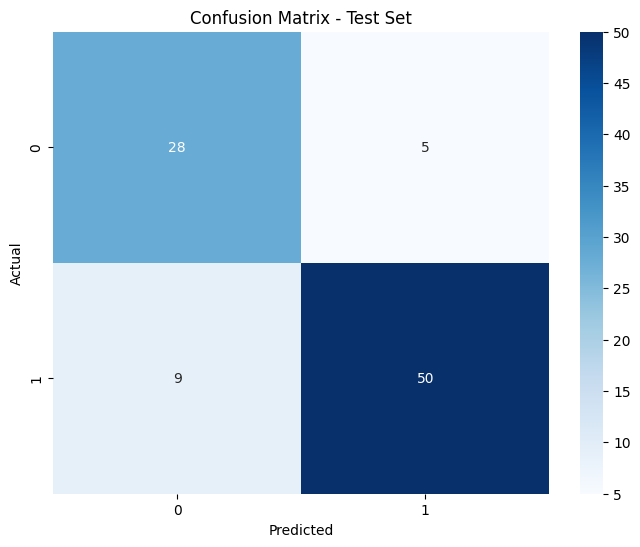

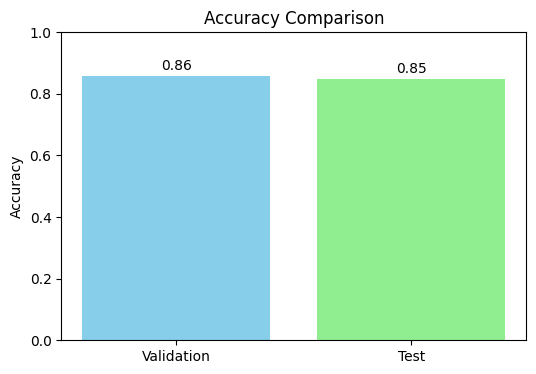

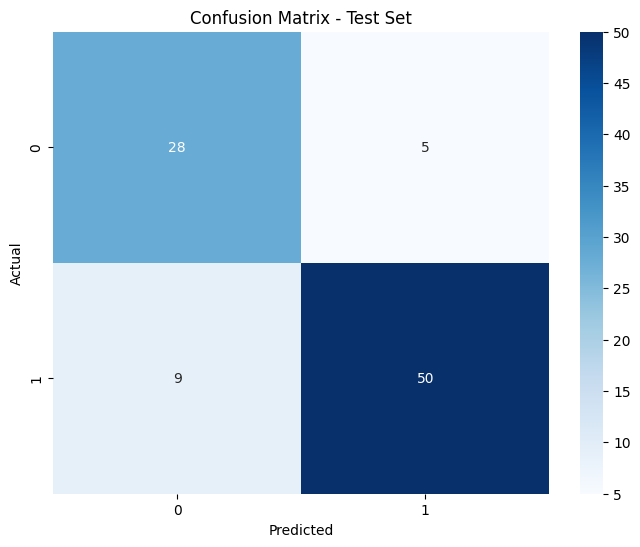

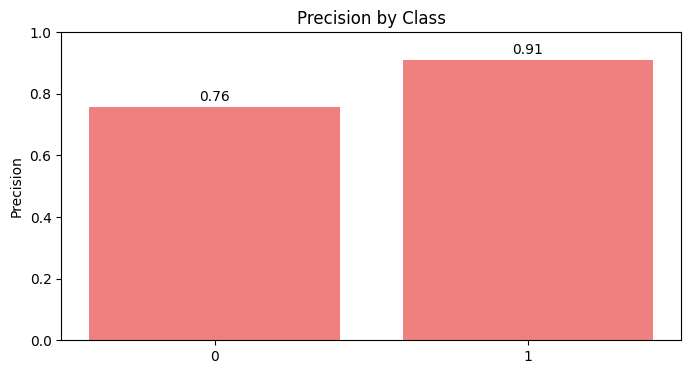

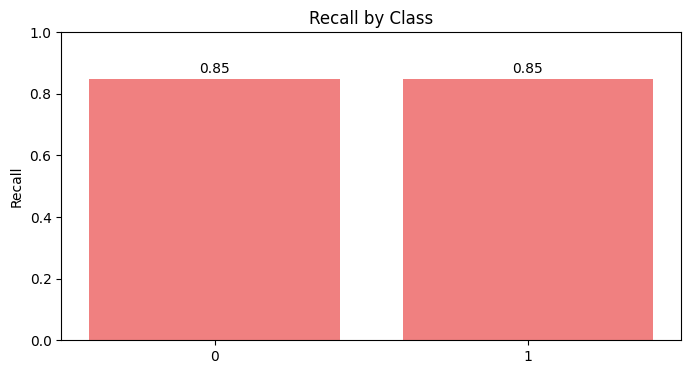

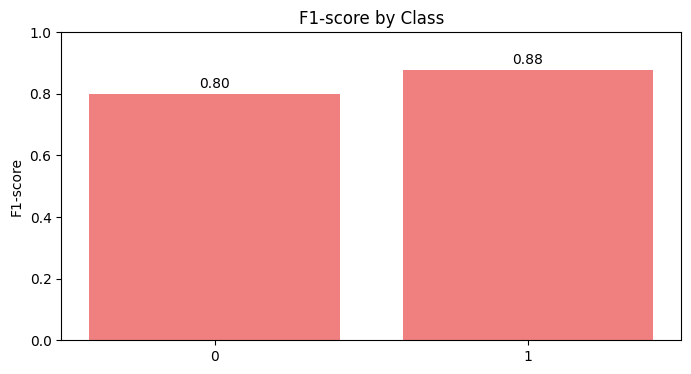

Scenario dataset_scenario_8_S with optuna completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


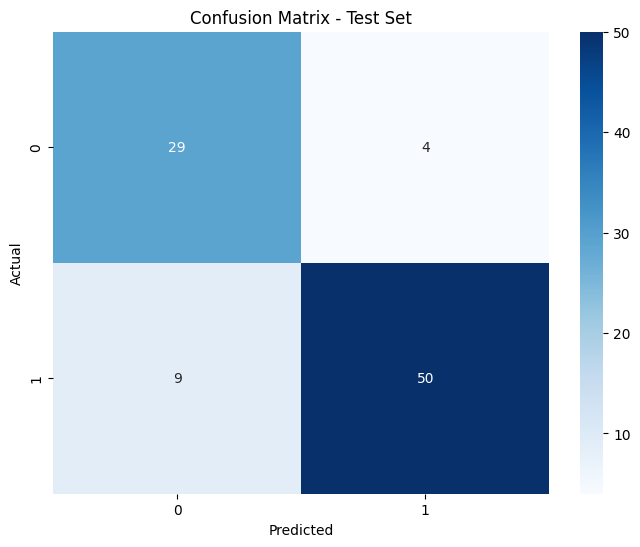

In [59]:
naive_bayes_optuna_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "NaiveBayes", "optuna", search_config_optuna, get_search_hyperparameters("NaiveBayes"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        naive_bayes_optuna_search['accuracy'] = best_score
        naive_bayes_optuna_search['params'] = best_params
        naive_bayes_optuna_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
nb = GaussianNB(**naive_bayes_optuna_search['params'])
best_scenario = pd.read_csv(naive_bayes_optuna_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, nb) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "NaiveBayes", "optuna")
save_model_info(naive_bayes_optuna_search, "NaiveBayes", "optuna")
    

# SVM

## 1. Grid Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with grid for dataset_scenario_1_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_1_N
Best hyperparameters:  {'C': 0.1, 'gamma': 1, 'kernel': 'poly'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


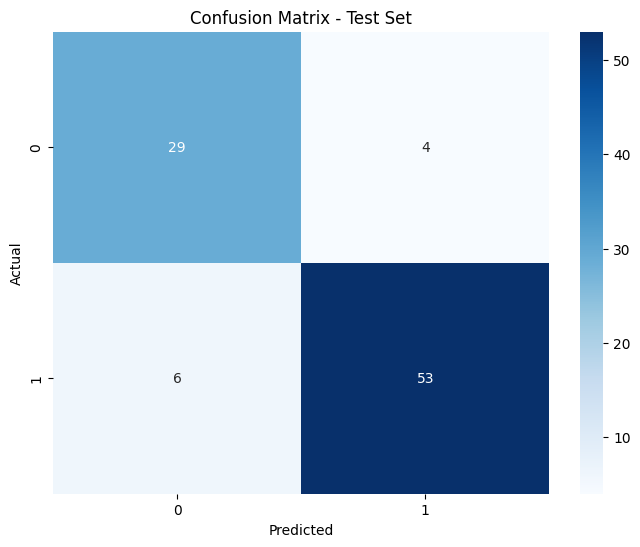

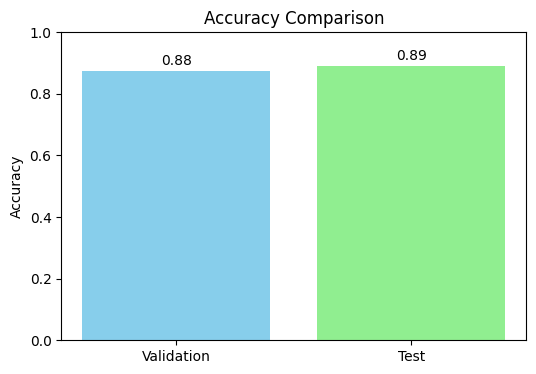

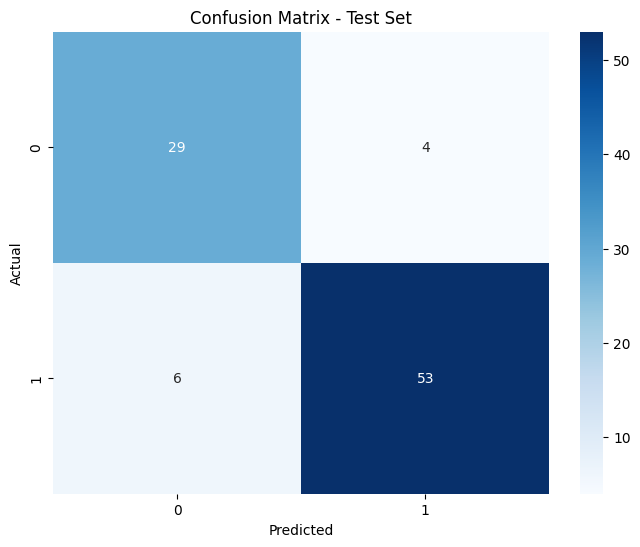

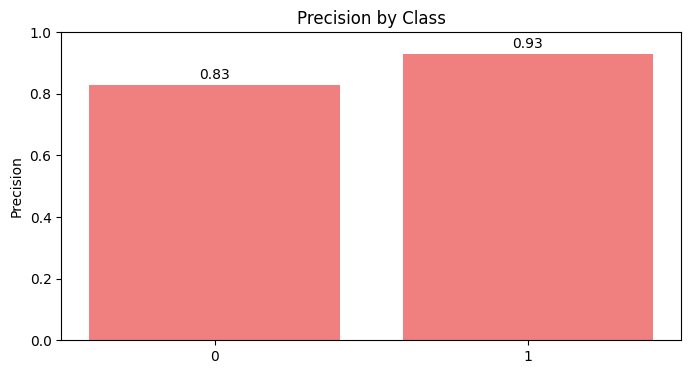

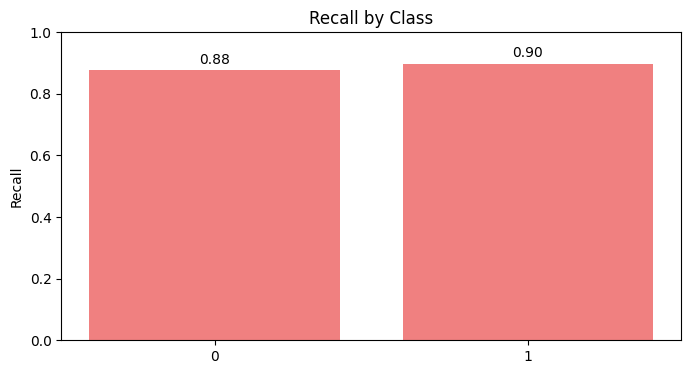

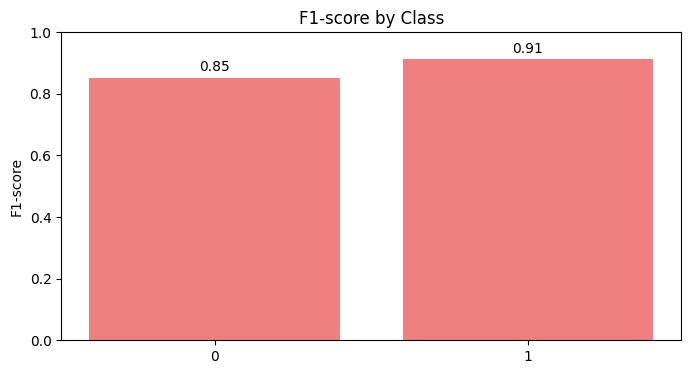

Scenario dataset_scenario_1_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_1_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_1_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8868
  Recall: 0.8859
  F1 Score: 0.8861

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8913
  Recall: 0.8913
  F1 Score: 0.8913

Confusion Matrix (Test Set):
[[28  5]
 [ 5 54]]


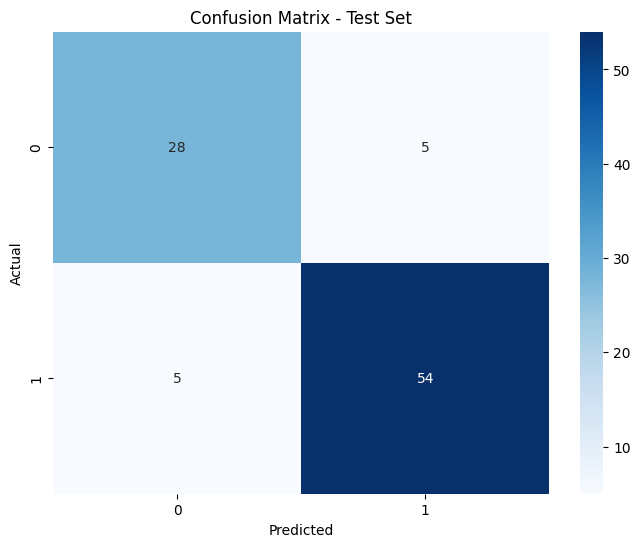

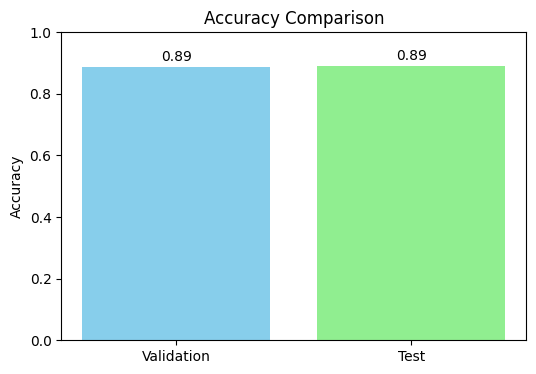

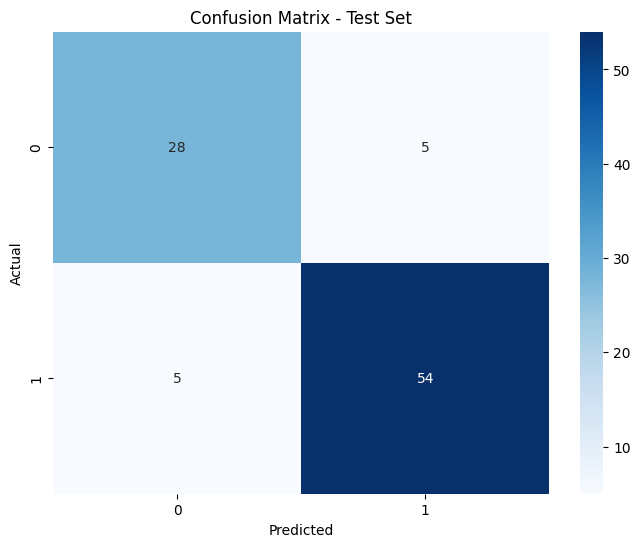

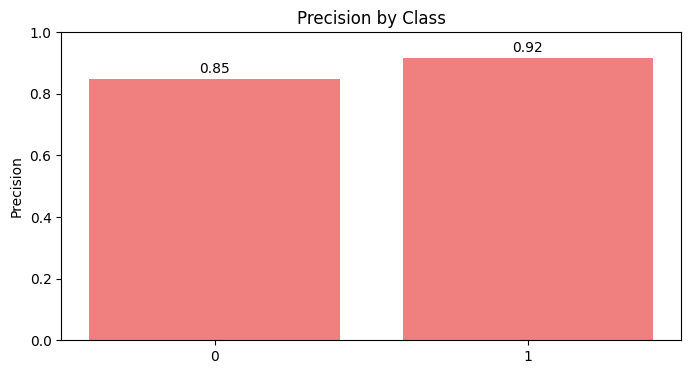

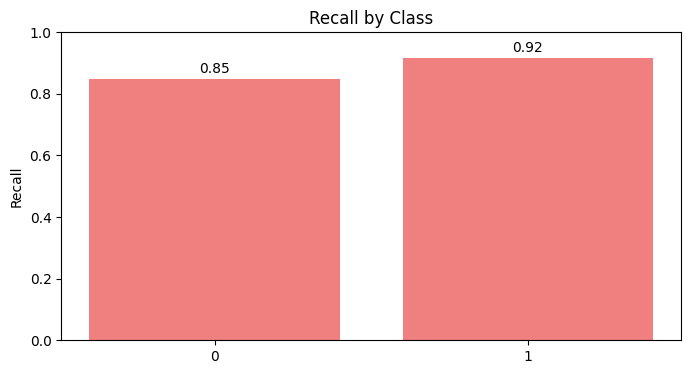

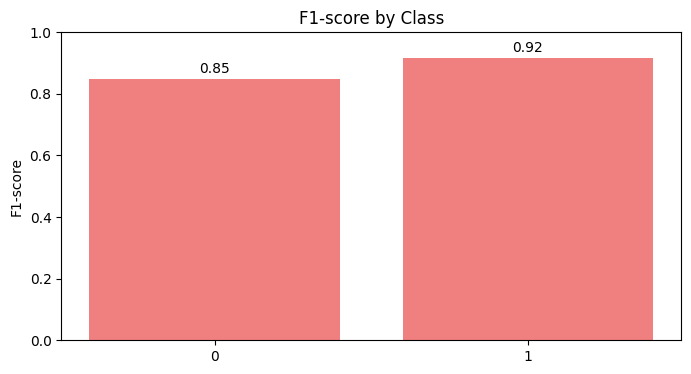

Scenario dataset_scenario_1_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running SVM with grid for dataset_scenario_2_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_2_N
Best hyperparameters:  {'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8569
  Recall: 0.8533
  F1 Score: 0.8538

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


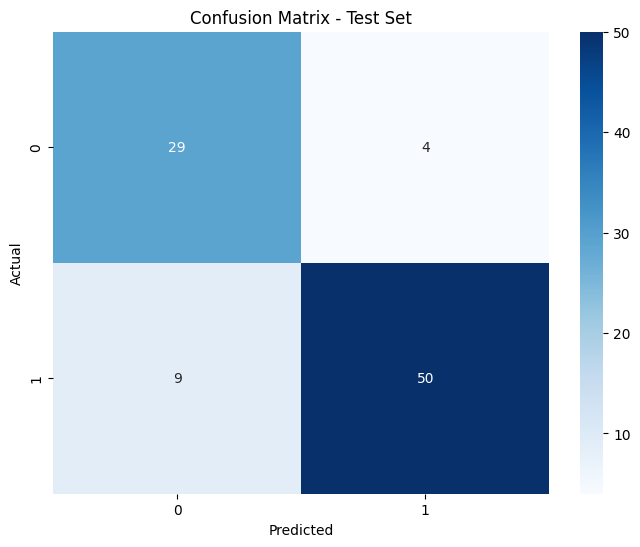

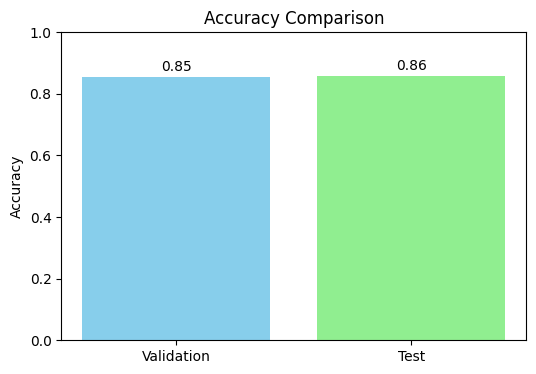

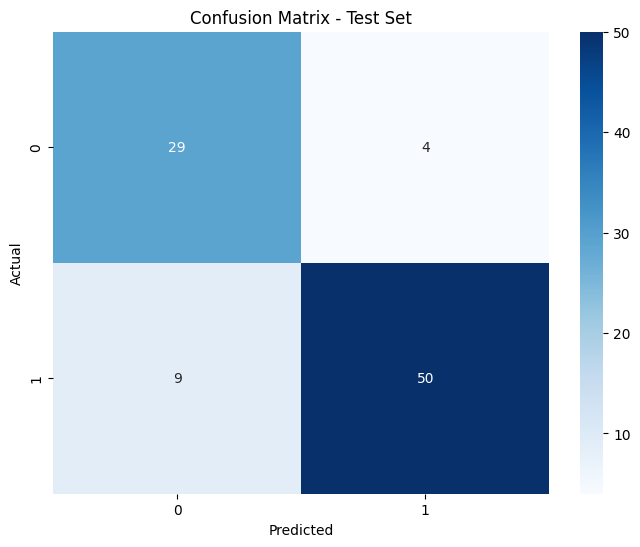

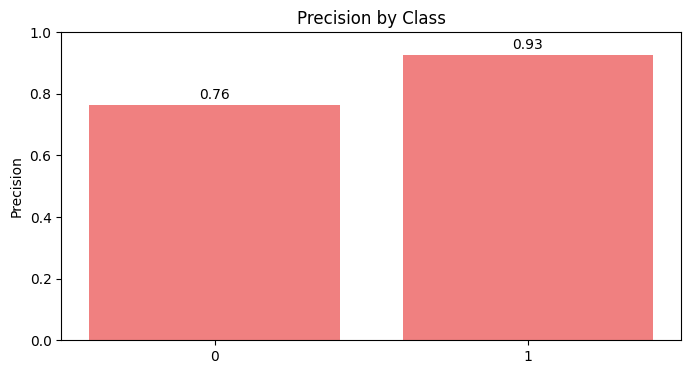

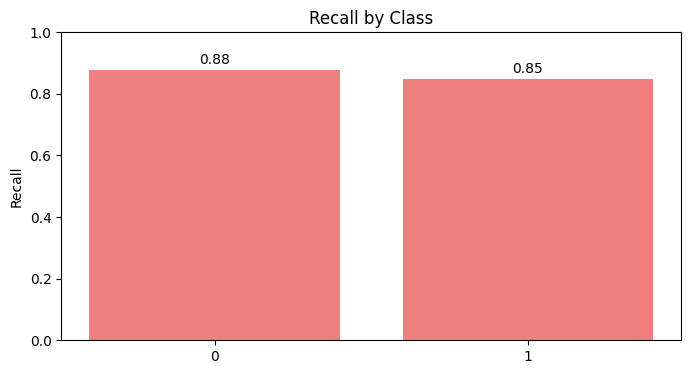

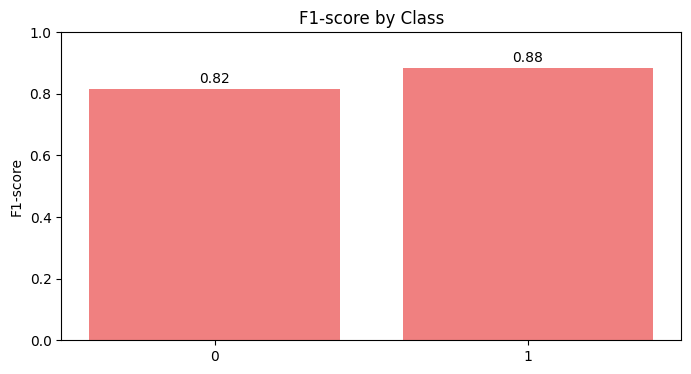

Scenario dataset_scenario_2_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running SVM with grid for dataset_scenario_2_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_2_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8724
  Recall: 0.8696
  F1 Score: 0.8700

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8844
  Recall: 0.8804
  F1 Score: 0.8815

Confusion Matrix (Test Set):
[[29  4]
 [ 7 52]]


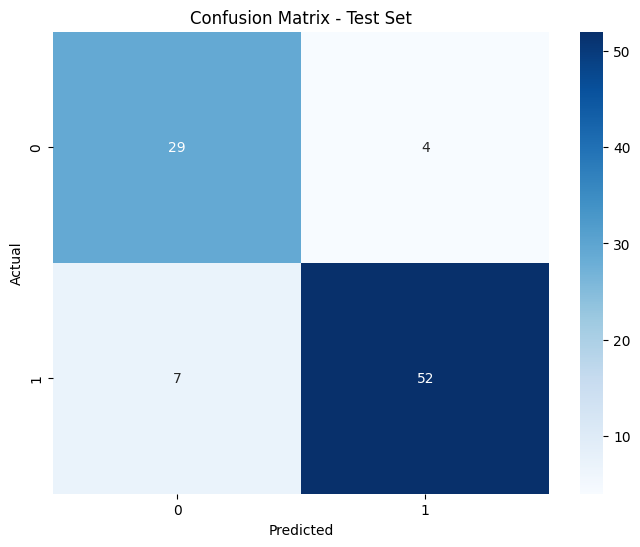

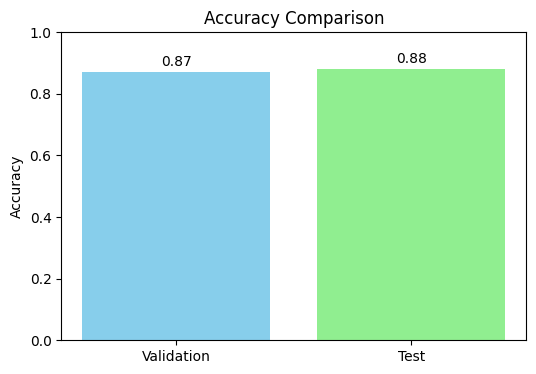

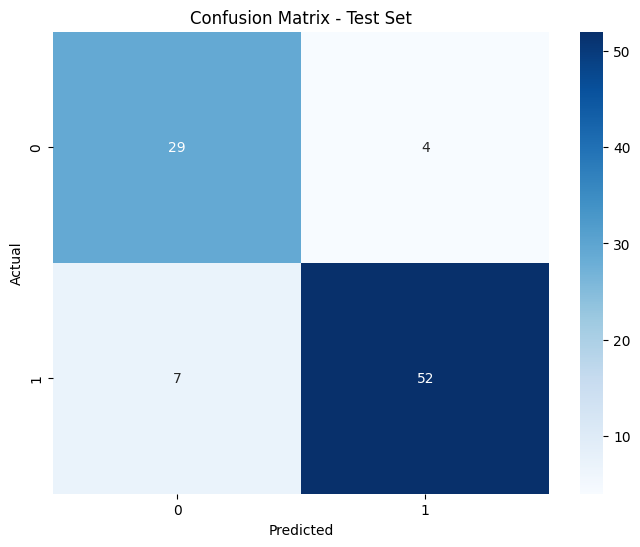

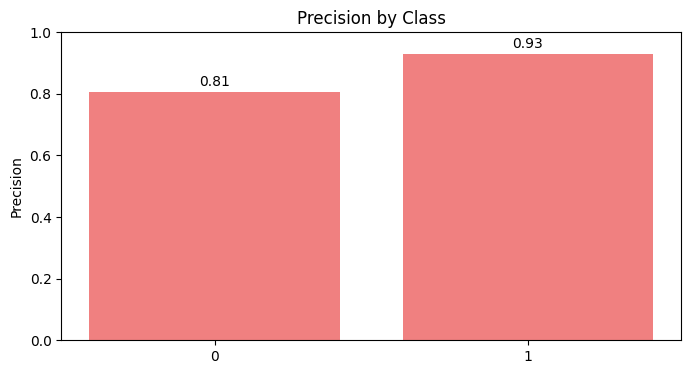

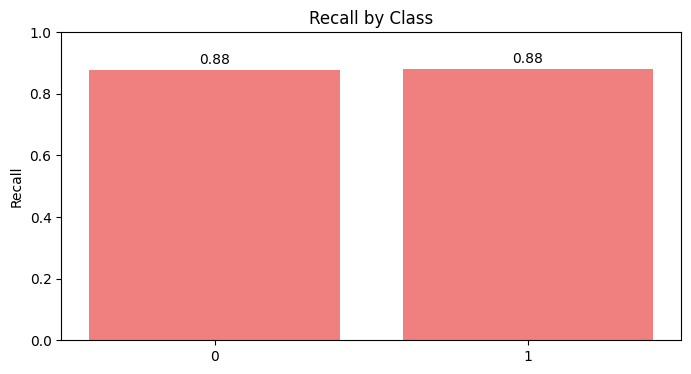

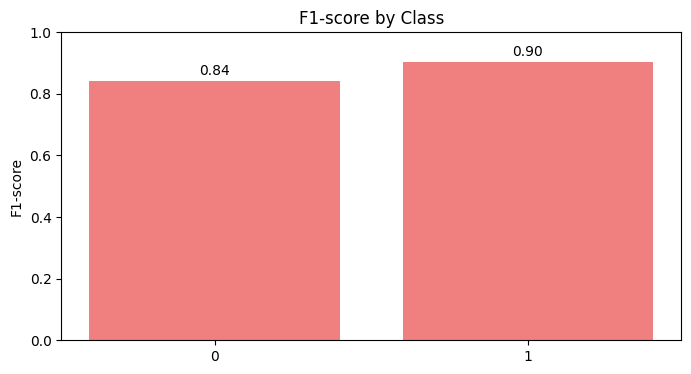

Scenario dataset_scenario_2_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with grid for dataset_scenario_3_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_3_N
Best hyperparameters:  {'C': 10, 'gamma': 0.1, 'kernel': 'sigmoid'}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8642
  Recall: 0.8643
  F1 Score: 0.8642

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8339
  Recall: 0.8169
  F1 Score: 0.8174

Confusion Matrix (Test Set):
[[30 10]
 [ 3 28]]


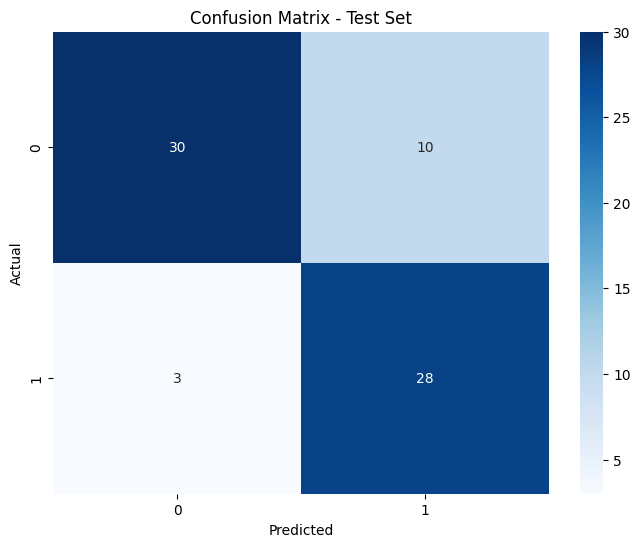

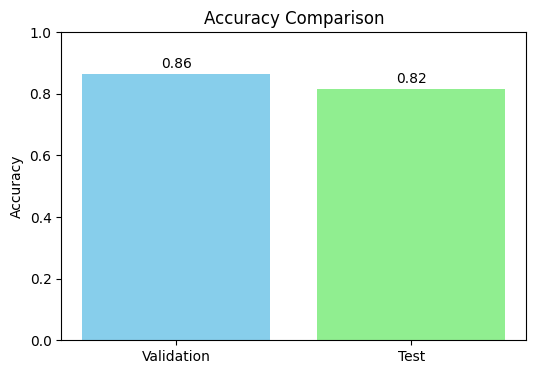

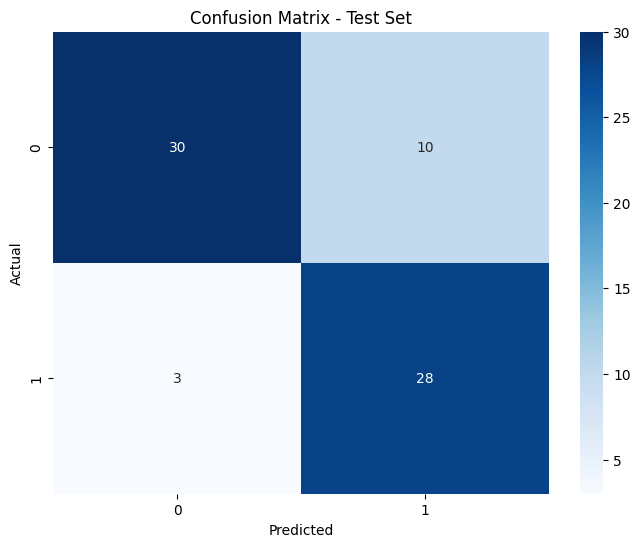

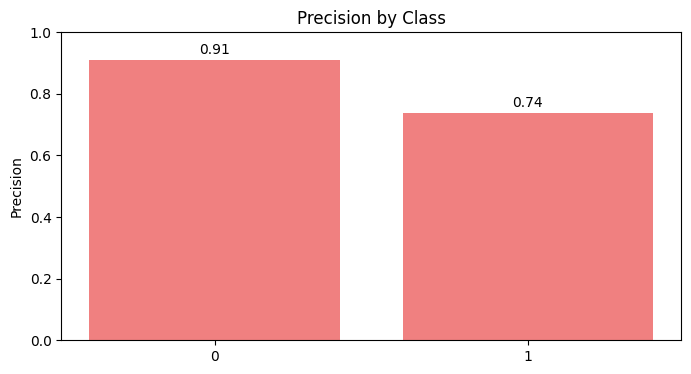

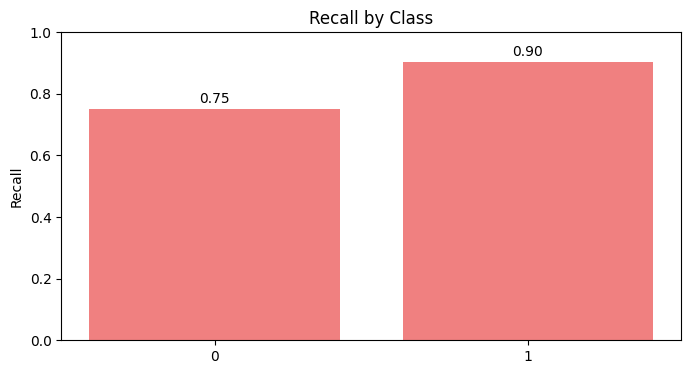

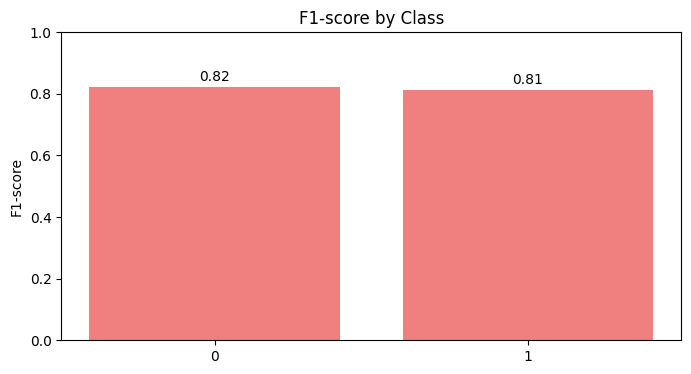

Scenario dataset_scenario_3_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_3_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_3_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8655
  Recall: 0.8643
  F1 Score: 0.8645

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8528
  Recall: 0.8310
  F1 Score: 0.8313

Confusion Matrix (Test Set):
[[30 10]
 [ 2 29]]


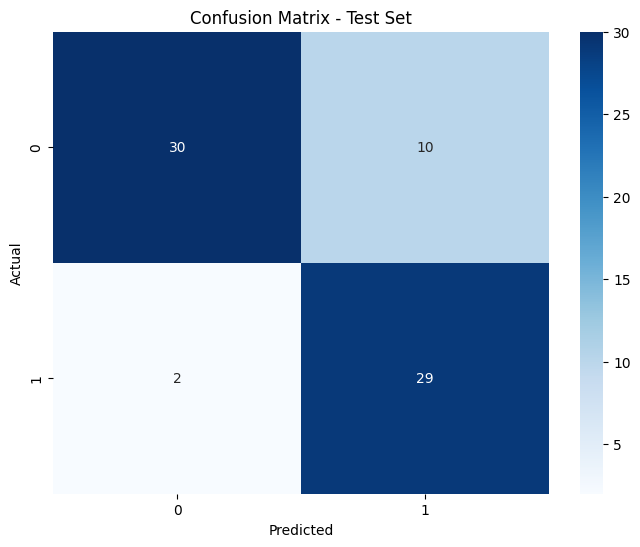

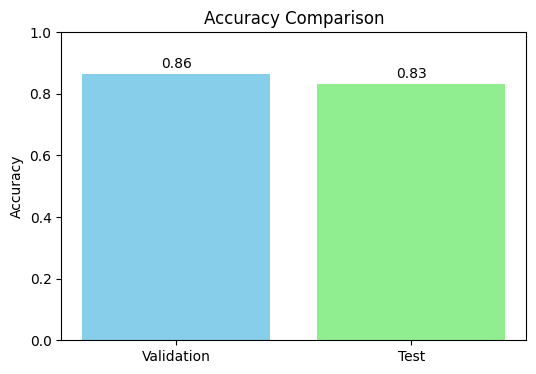

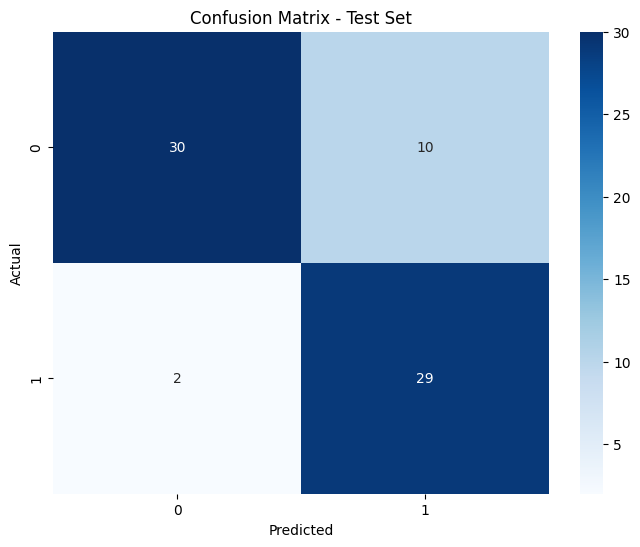

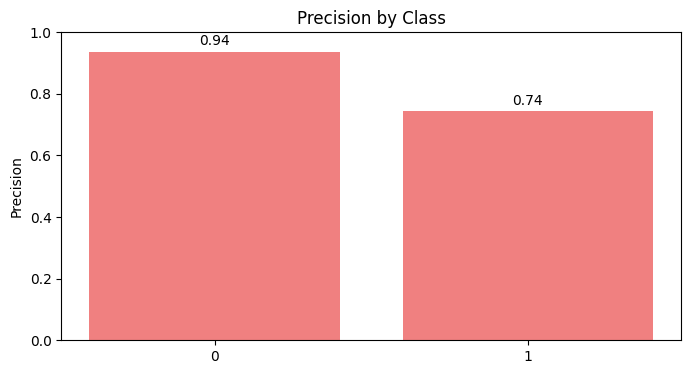

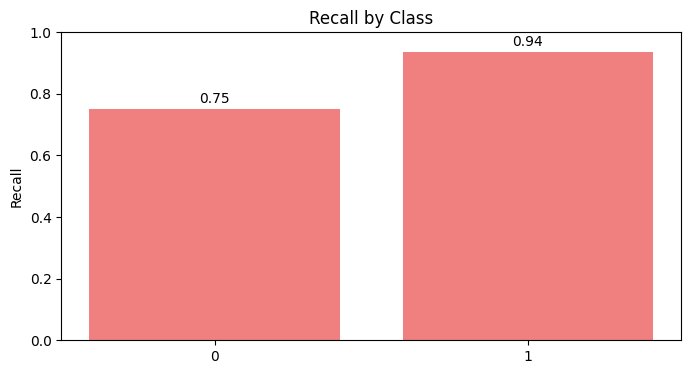

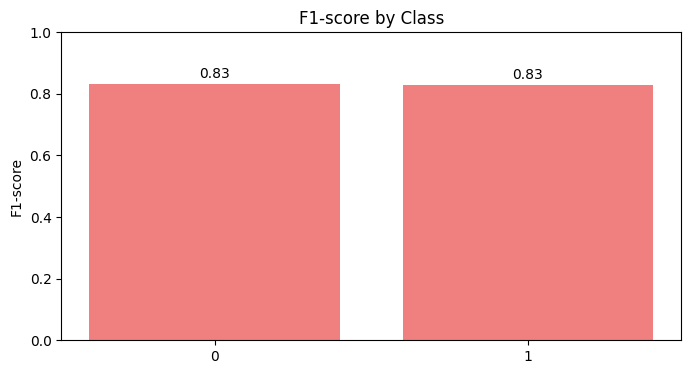

Scenario dataset_scenario_3_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with grid for dataset_scenario_4_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_4_N
Best hyperparameters:  {'C': 1, 'gamma': 1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8748
  Recall: 0.8750
  F1 Score: 0.8749

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8630
  Recall: 0.8587
  F1 Score: 0.8599

Confusion Matrix (Test Set):
[[28  5]
 [ 8 51]]


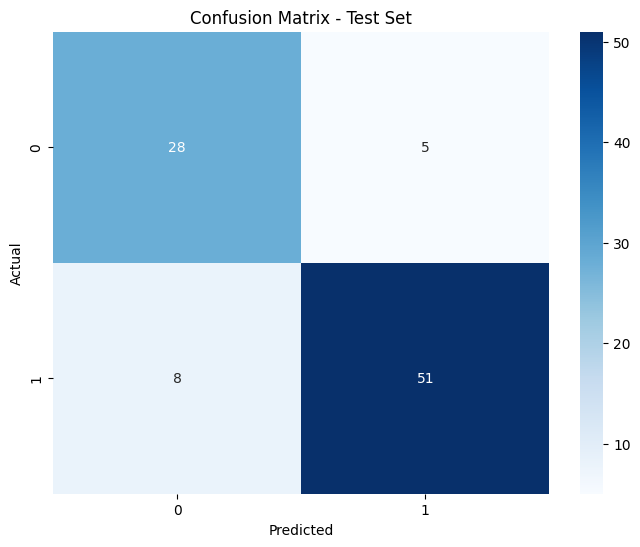

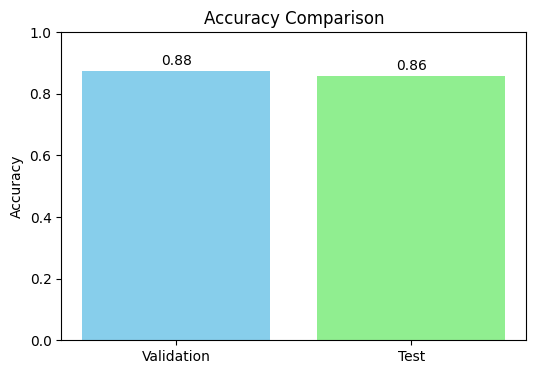

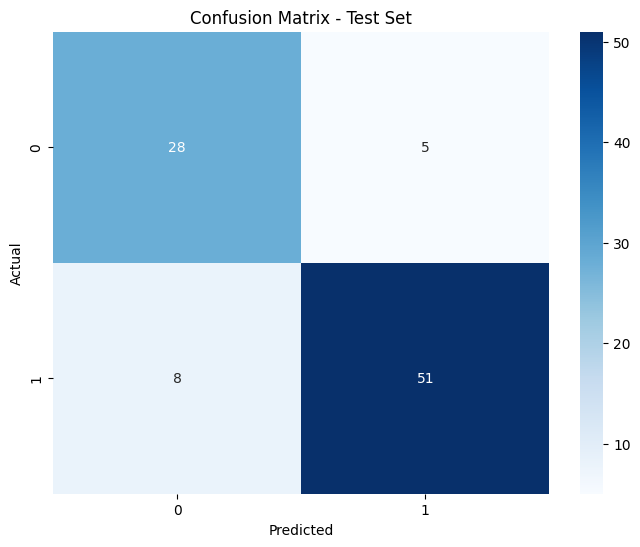

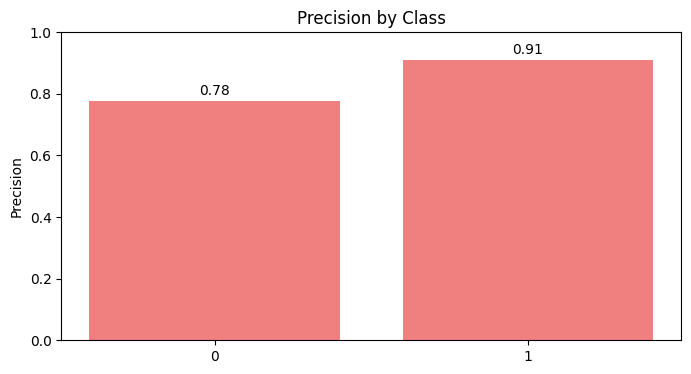

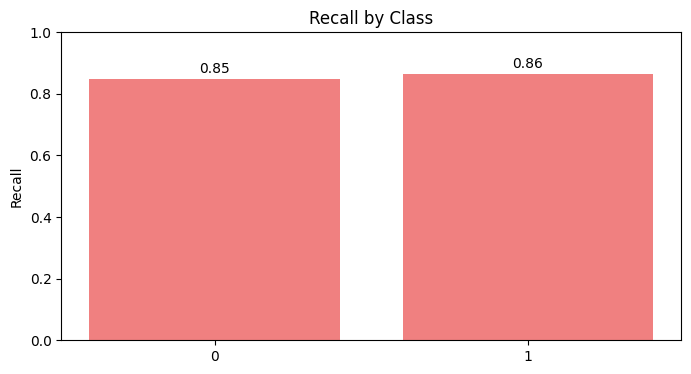

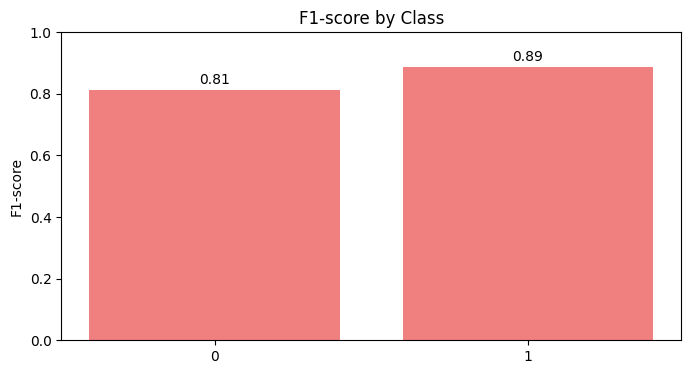

Scenario dataset_scenario_4_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_4_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_4_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


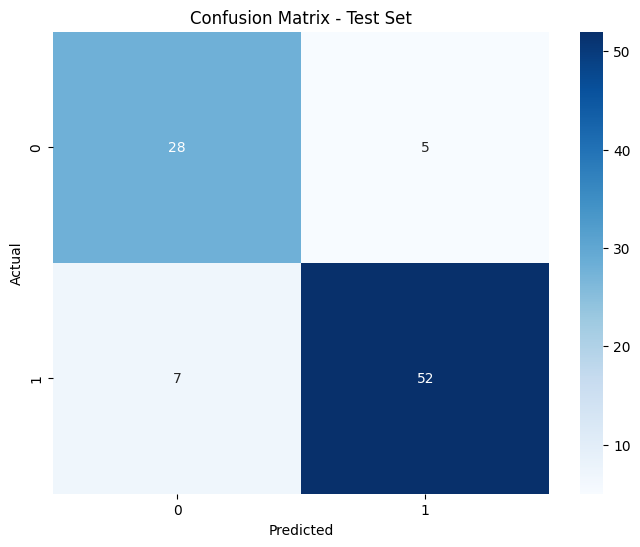

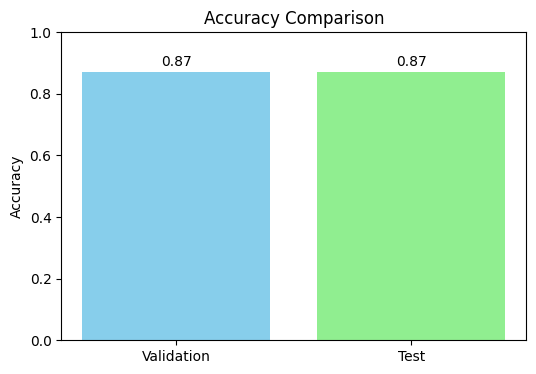

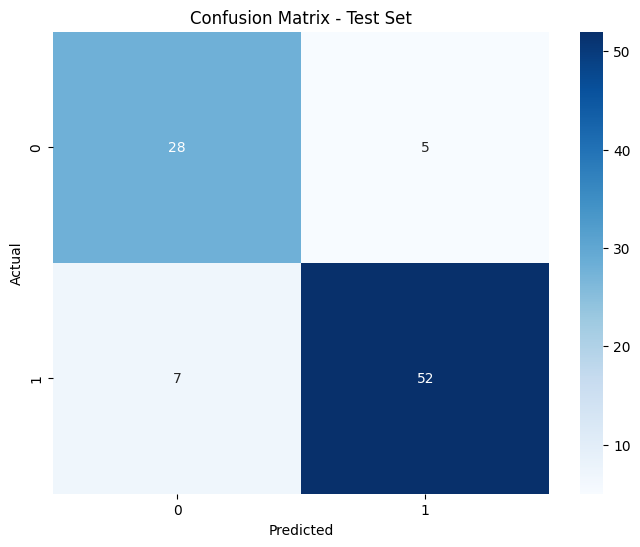

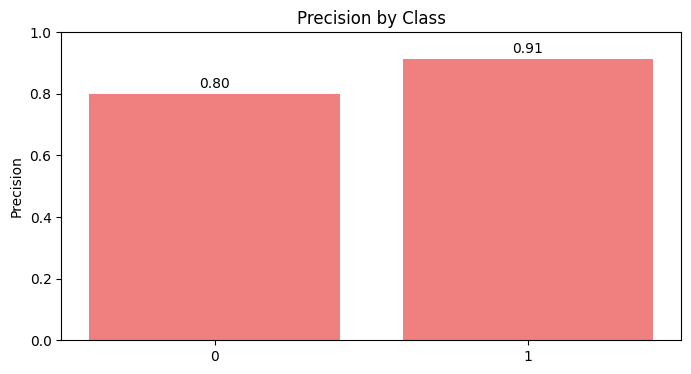

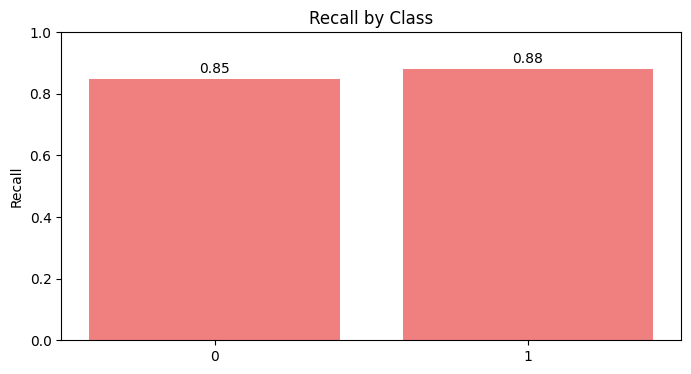

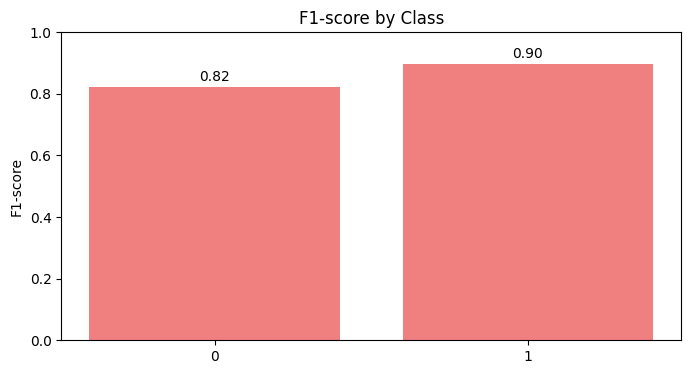

Scenario dataset_scenario_4_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with grid for dataset_scenario_5_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_5_N
Best hyperparameters:  {'C': 10, 'gamma': 0.1, 'kernel': 'poly'}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8603
  Recall: 0.8587
  F1 Score: 0.8591

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


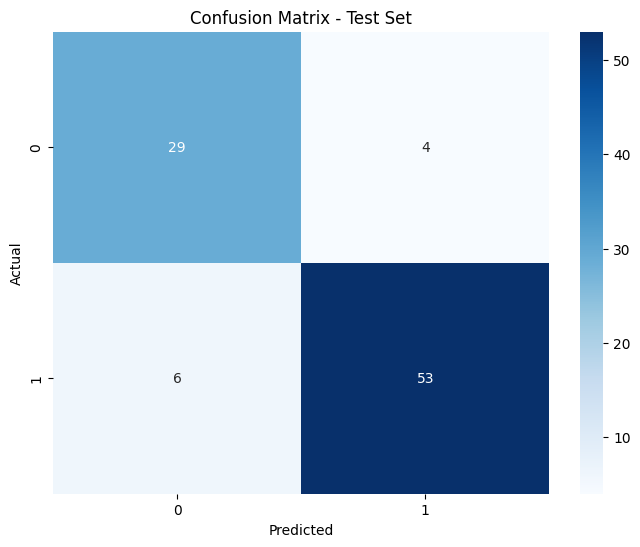

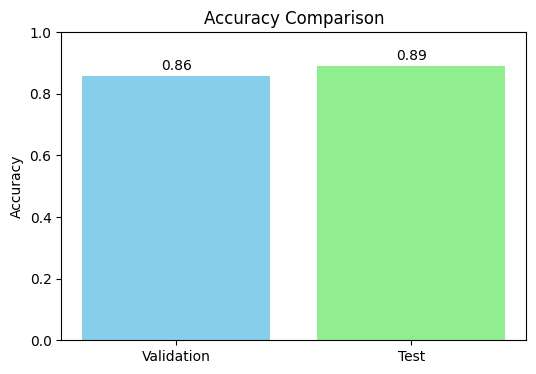

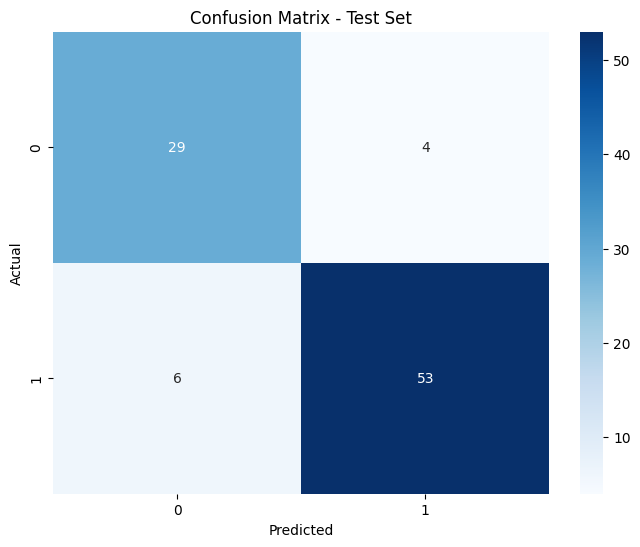

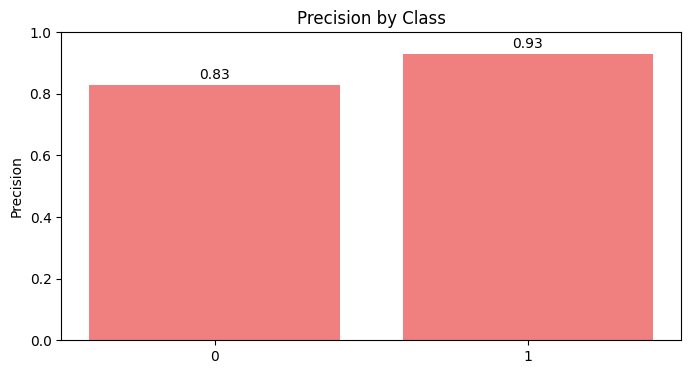

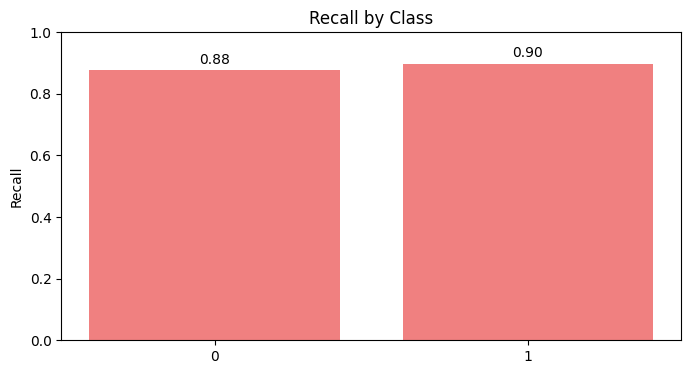

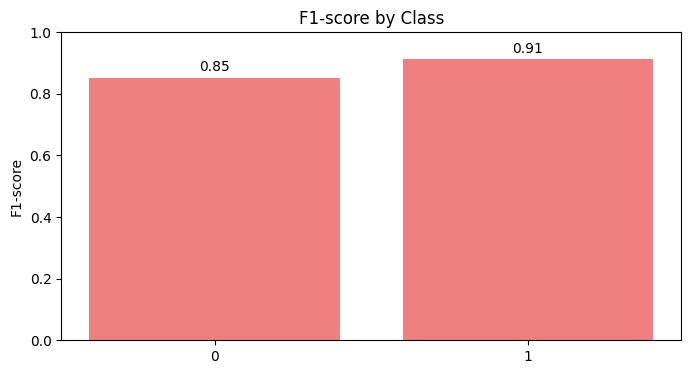

Scenario dataset_scenario_5_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_5_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_5_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8804
  Recall: 0.8804
  F1 Score: 0.8804

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


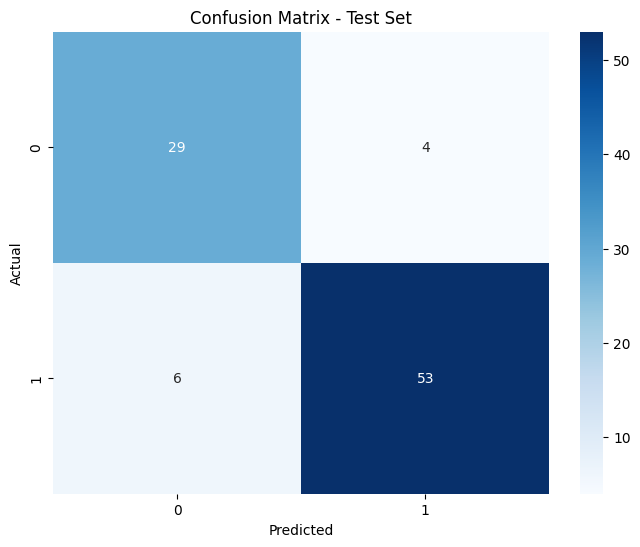

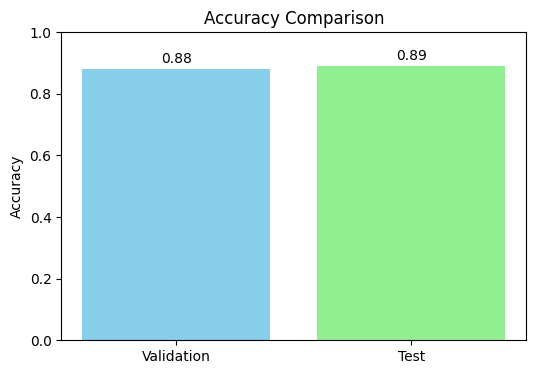

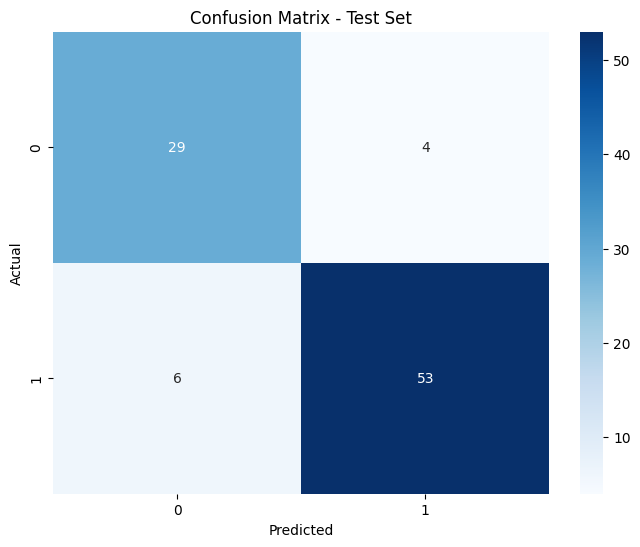

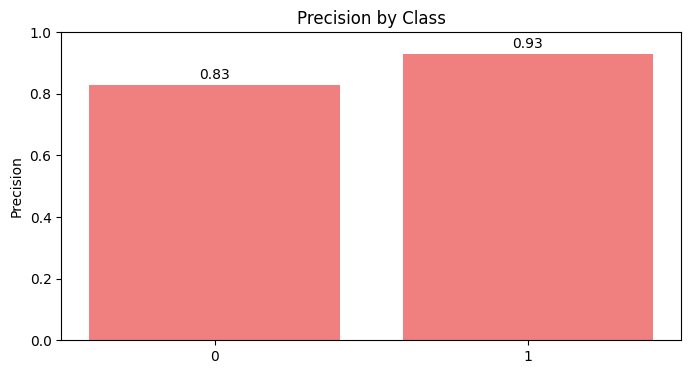

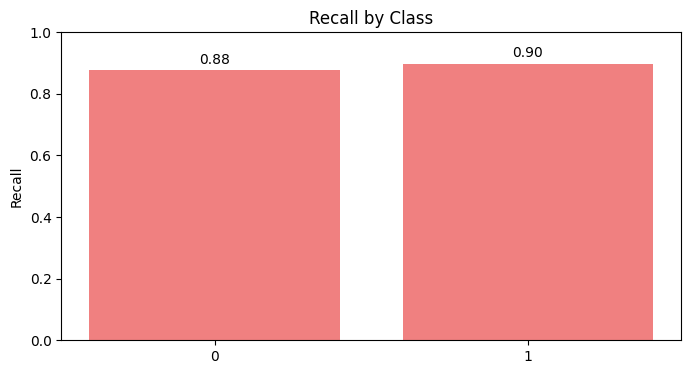

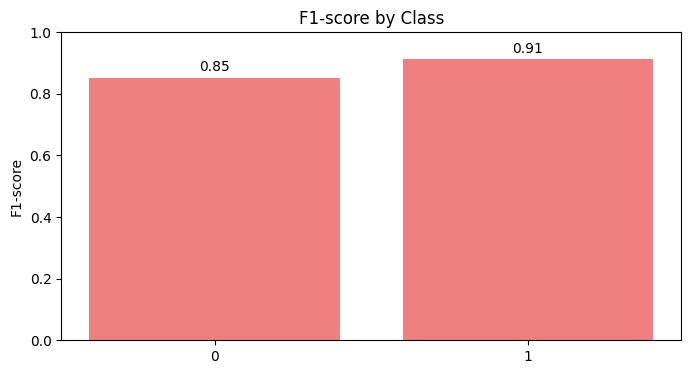

Scenario dataset_scenario_5_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with grid for dataset_scenario_6_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_6_N
Best hyperparameters:  {'C': 10, 'gamma': 1, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


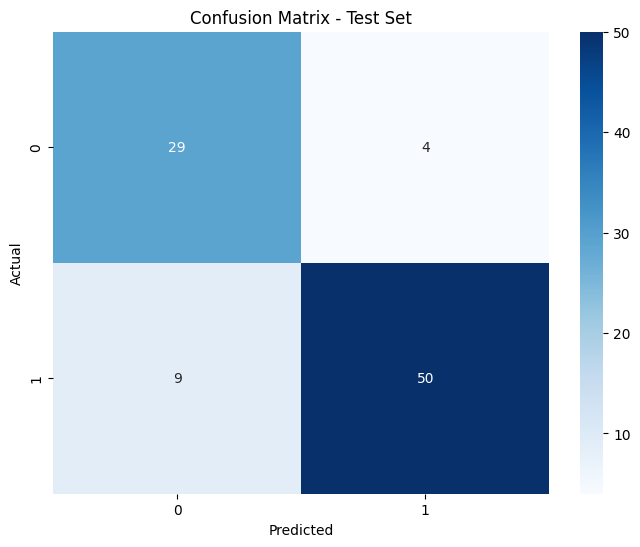

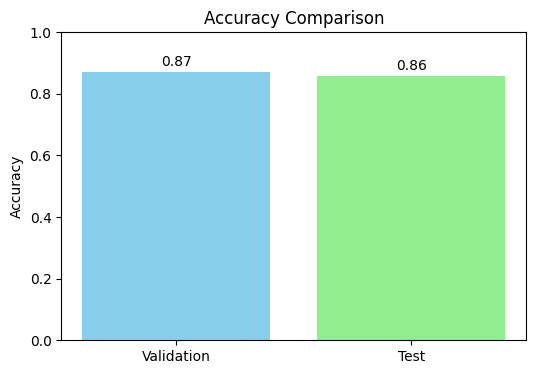

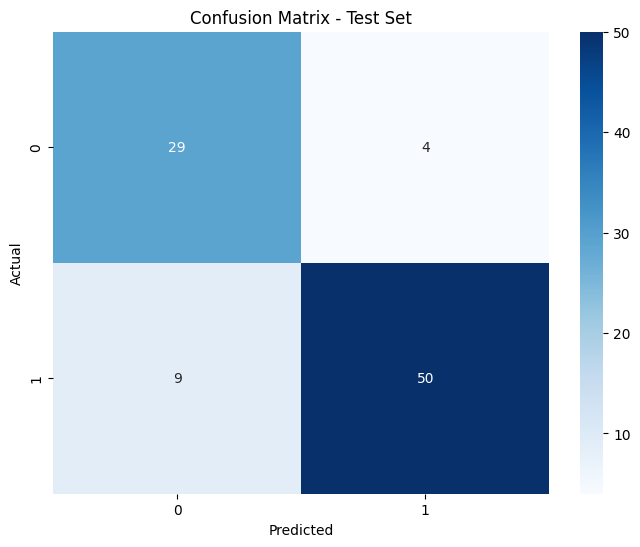

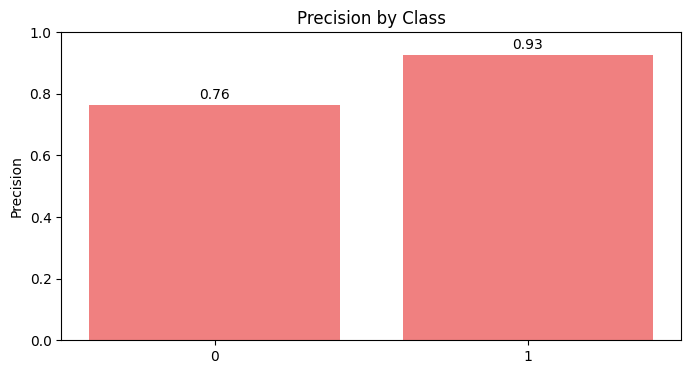

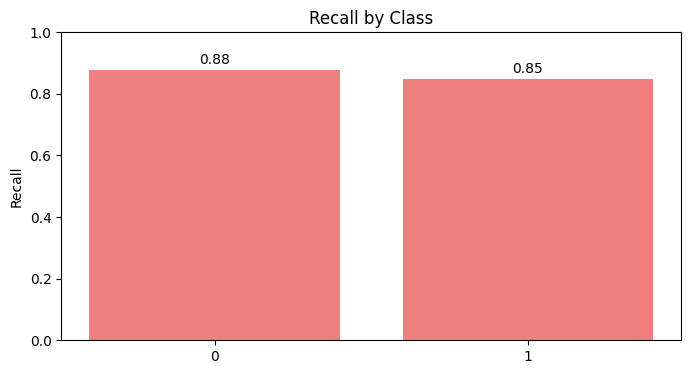

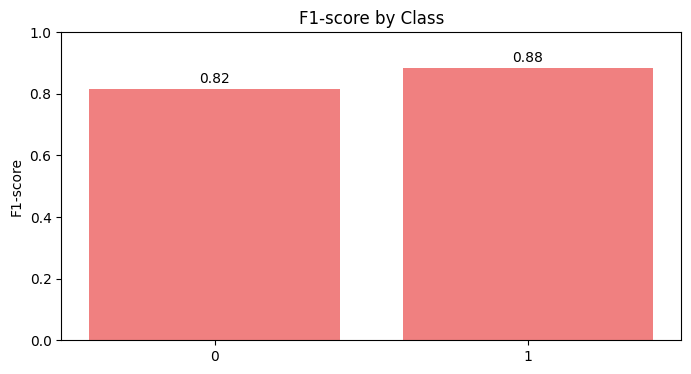

Scenario dataset_scenario_6_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_6_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_6_S
Best hyperparameters:  {'C': 1, 'gamma': 0.1, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8630
  Recall: 0.8587
  F1 Score: 0.8599

Confusion Matrix (Test Set):
[[28  5]
 [ 8 51]]


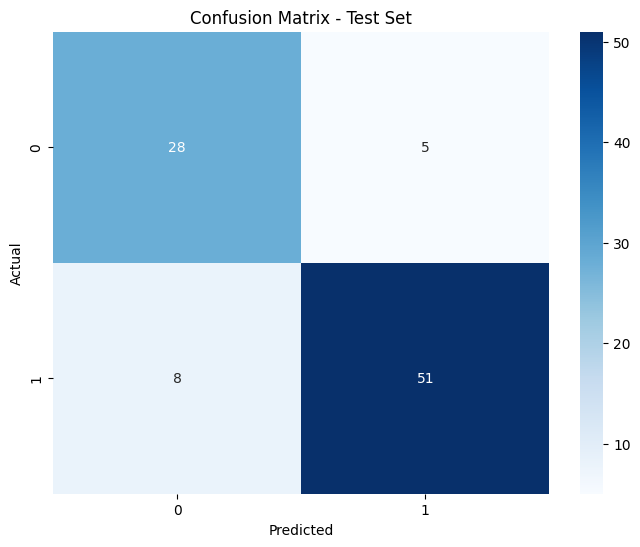

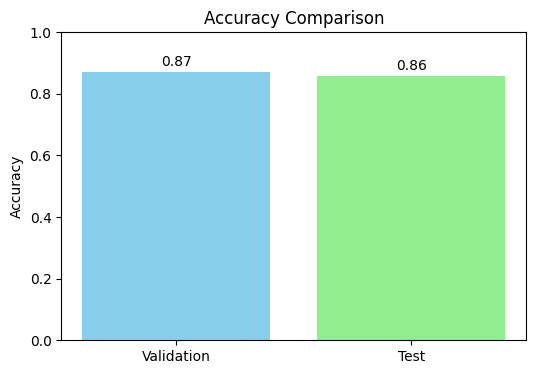

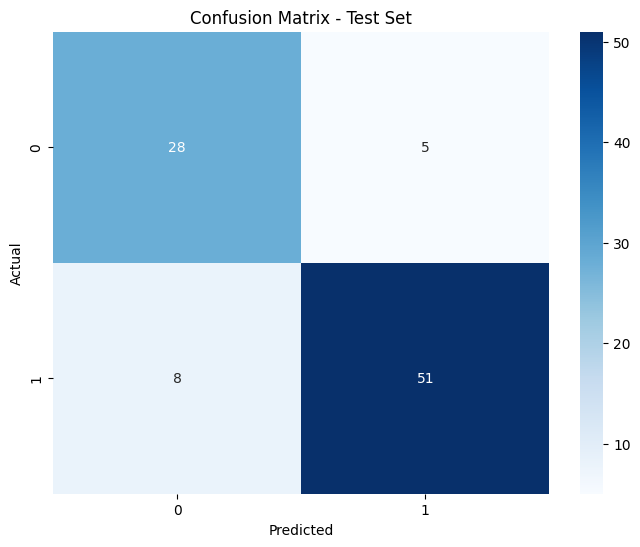

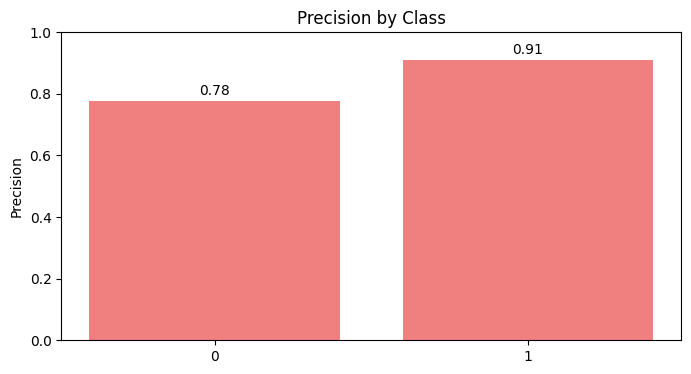

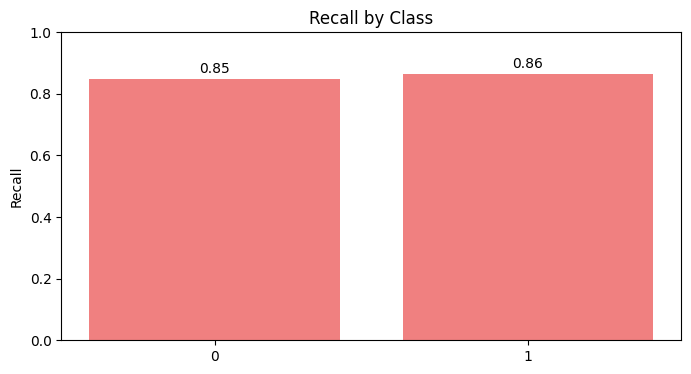

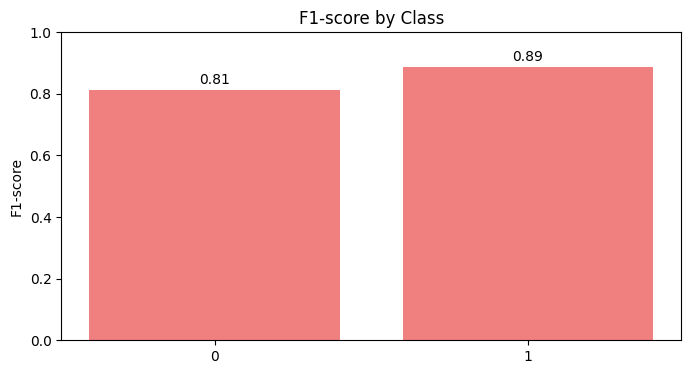

Scenario dataset_scenario_6_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with grid for dataset_scenario_7_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_7_N
Best hyperparameters:  {'C': 10, 'gamma': 0.1, 'kernel': 'sigmoid'}
Validation Metrics:
  Accuracy: 0.8571
  Precision: 0.8578
  Recall: 0.8571
  F1 Score: 0.8573

Test Metrics:
  Accuracy: 0.7746
  Precision: 0.8052
  Recall: 0.7746
  F1 Score: 0.7742

Confusion Matrix (Test Set):
[[27 13]
 [ 3 28]]


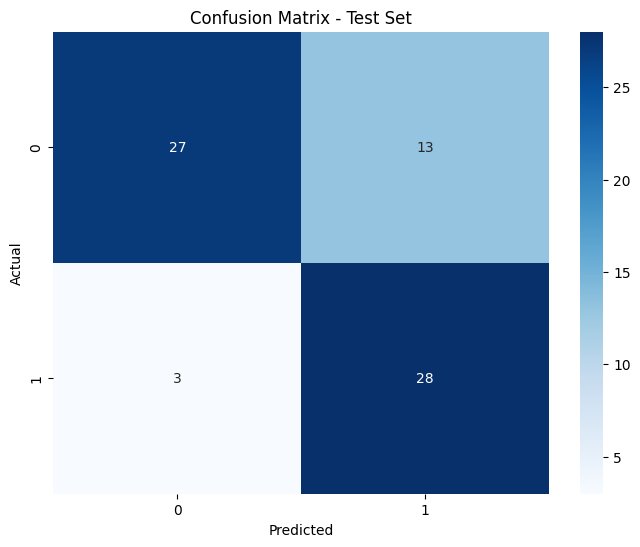

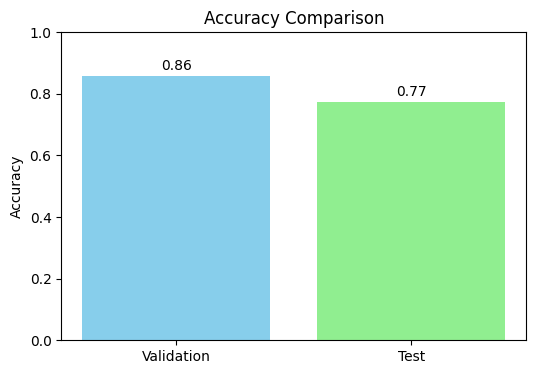

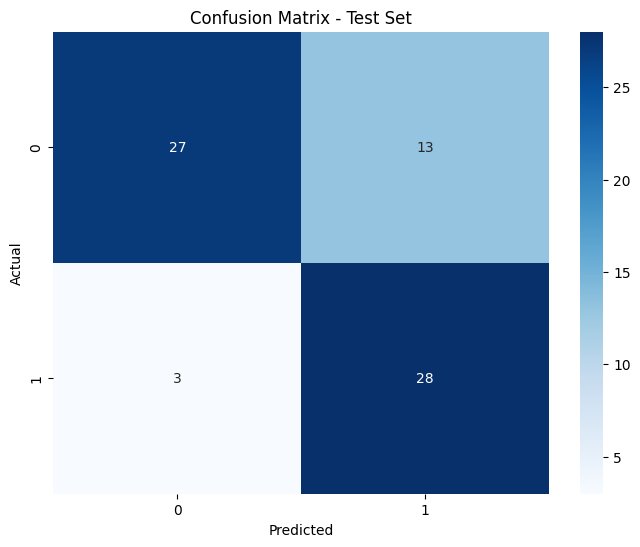

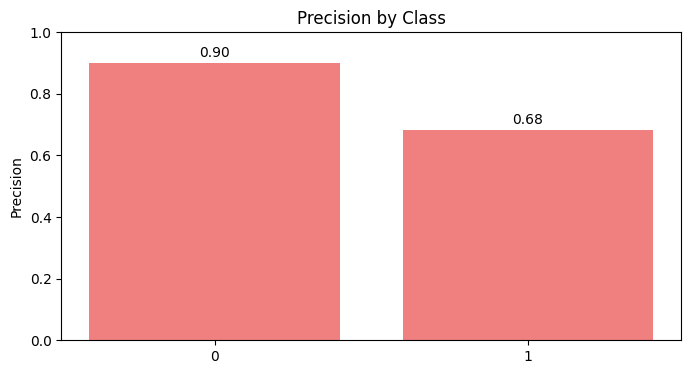

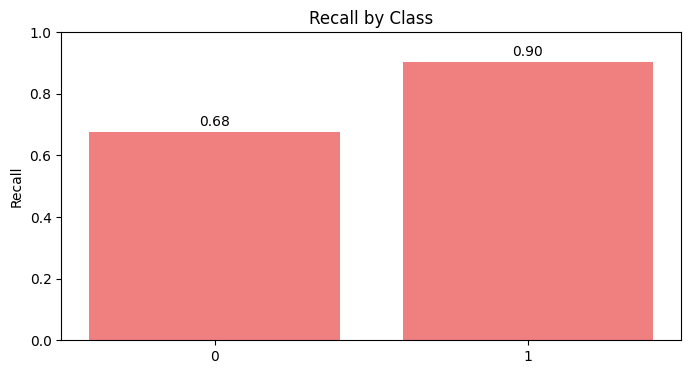

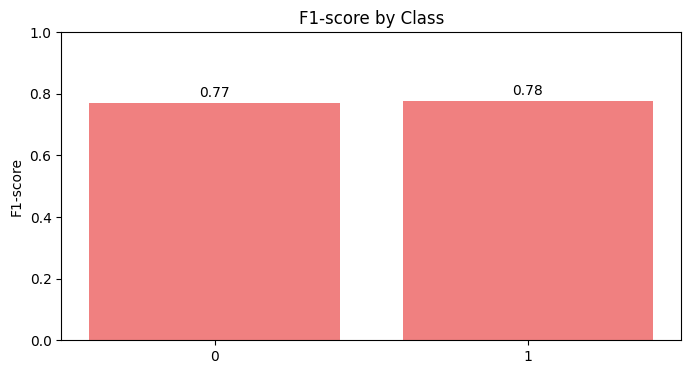

Scenario dataset_scenario_7_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_7_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_7_S
Best hyperparameters:  {'C': 0.1, 'gamma': 1, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8714
  Precision: 0.8721
  Recall: 0.8714
  F1 Score: 0.8716

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8240
  Recall: 0.8028
  F1 Score: 0.8031

Confusion Matrix (Test Set):
[[29 11]
 [ 3 28]]


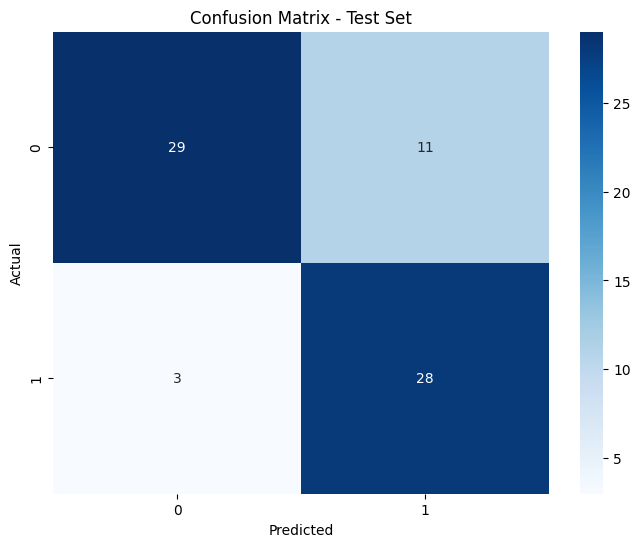

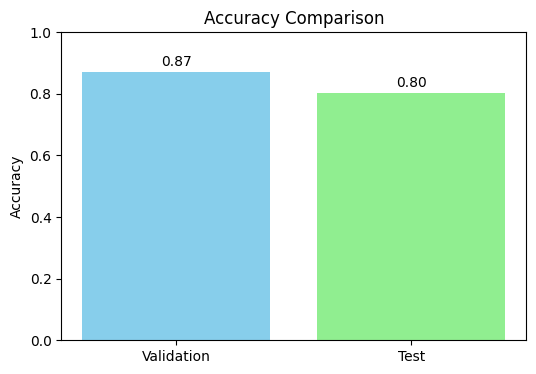

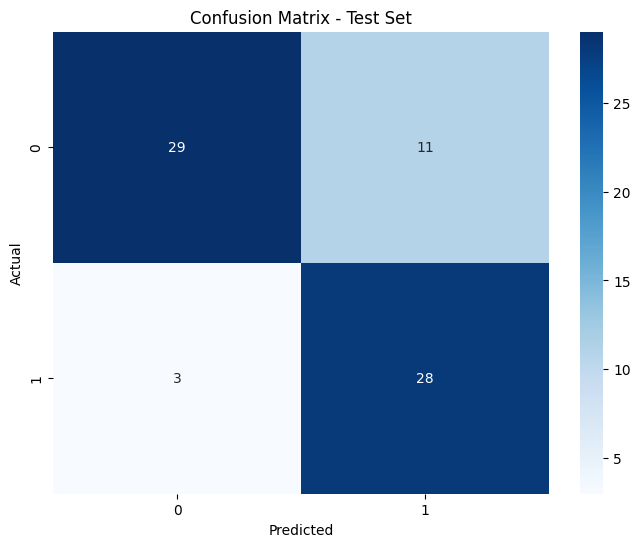

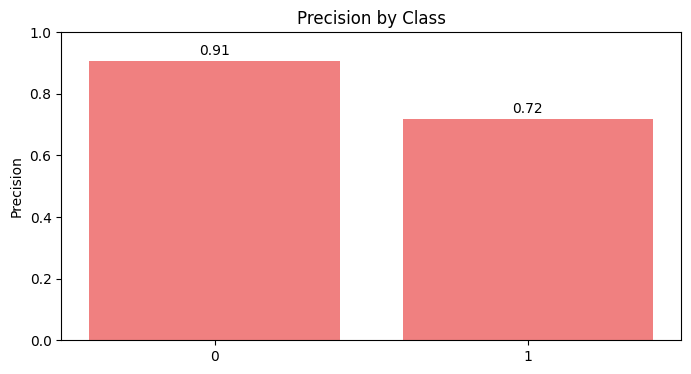

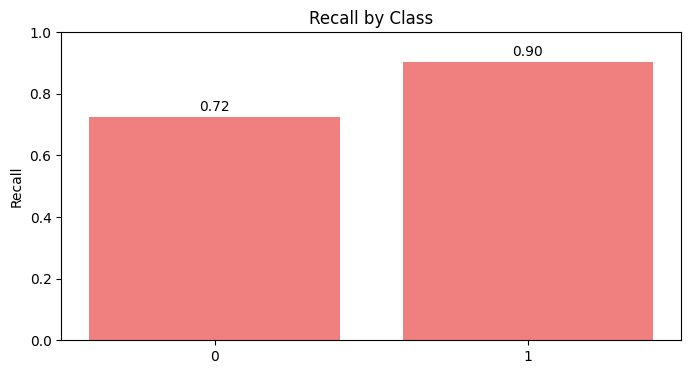

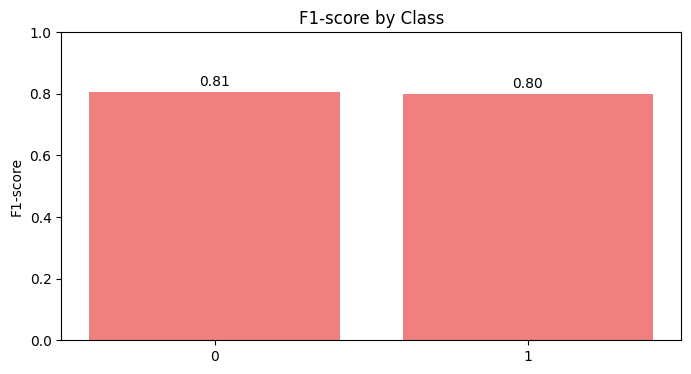

Scenario dataset_scenario_7_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with grid for dataset_scenario_8_N...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_8_N
Best hyperparameters:  {'C': 10, 'gamma': 0.1, 'kernel': 'poly'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8696
  Recall: 0.8696
  F1 Score: 0.8696

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


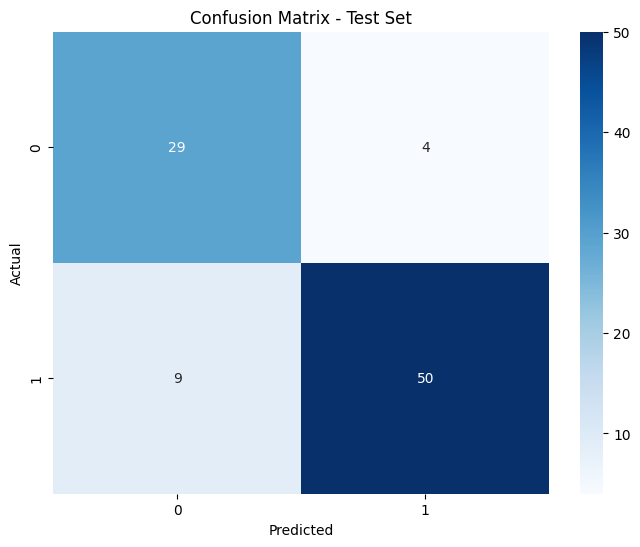

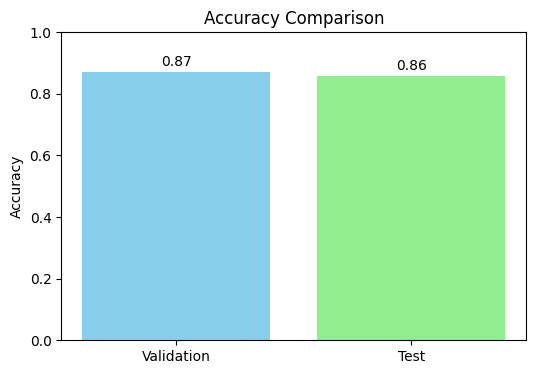

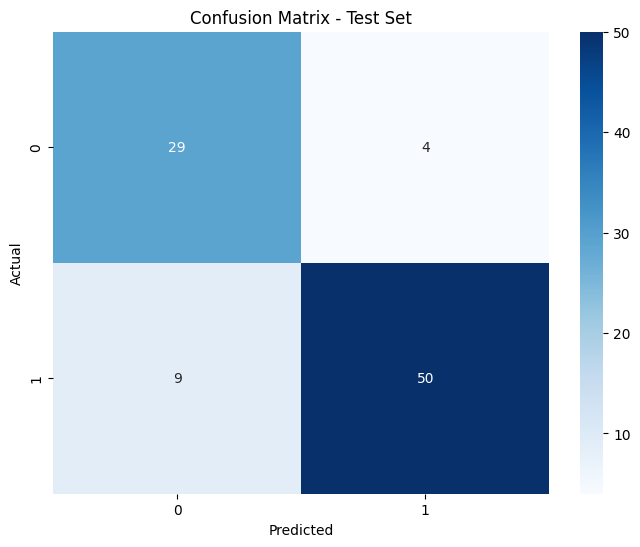

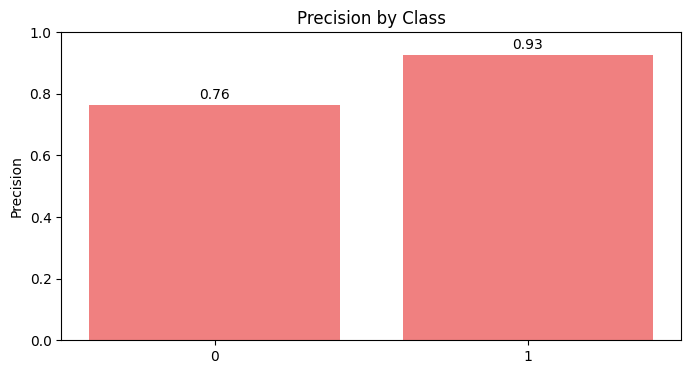

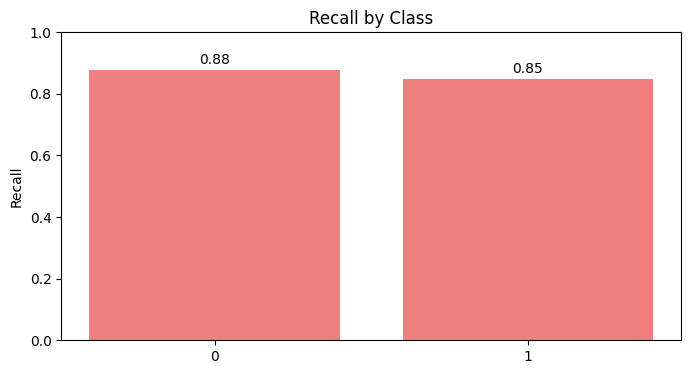

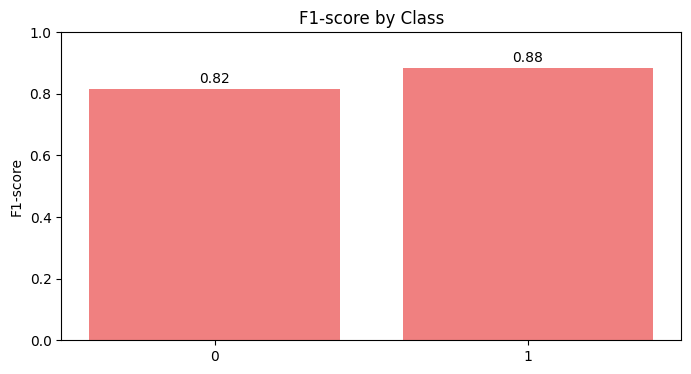

Scenario dataset_scenario_8_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with grid for dataset_scenario_8_S...
Results will be saved in: SCORES\SVM\grid\dataset_scenario_8_S
Best hyperparameters:  {'C': 100, 'gamma': 0.001, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8644
  Recall: 0.8641
  F1 Score: 0.8642

Test Metrics:
  Accuracy: 0.8370
  Precision: 0.8462
  Recall: 0.8370
  F1 Score: 0.8391

Confusion Matrix (Test Set):
[[28  5]
 [10 49]]


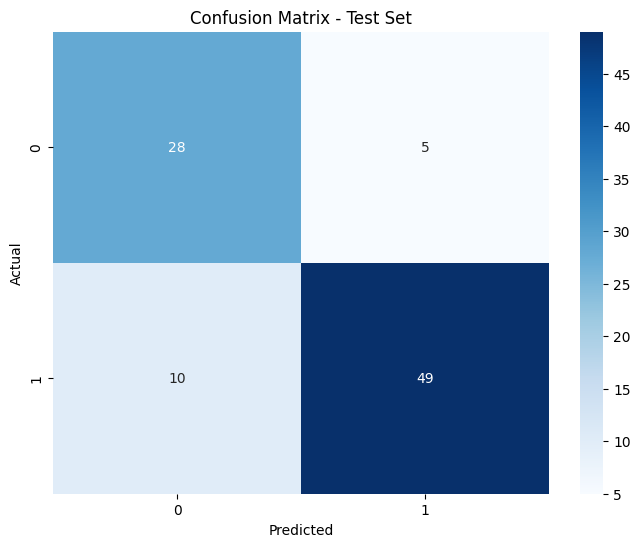

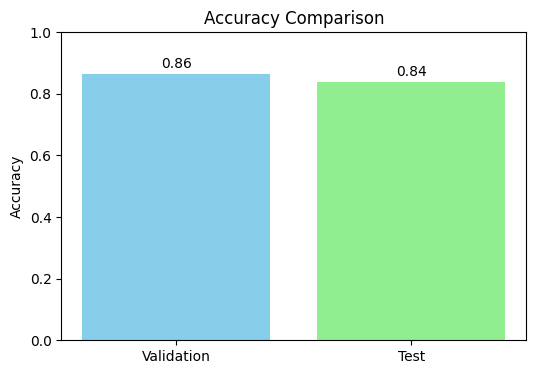

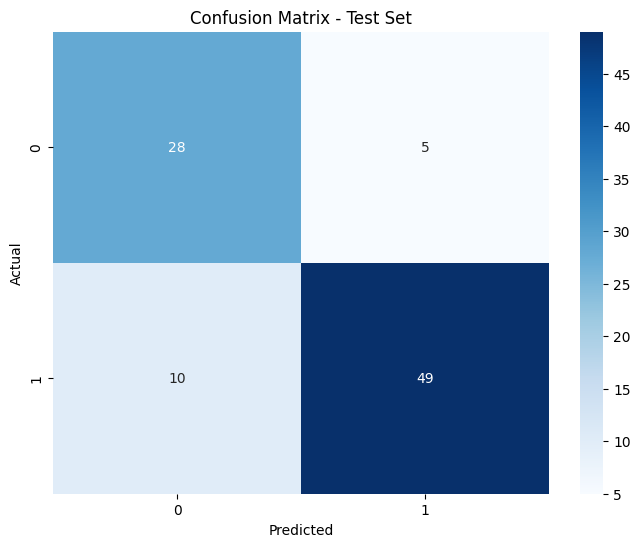

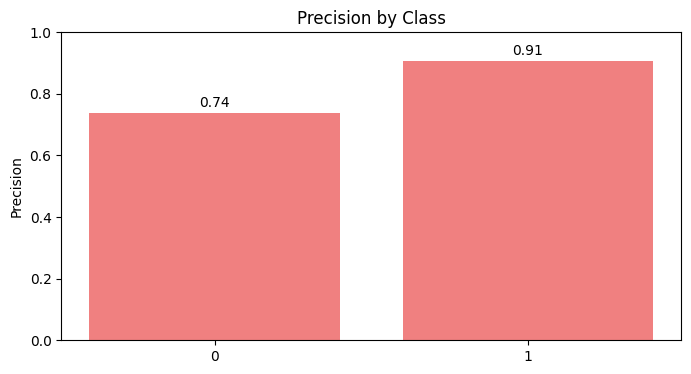

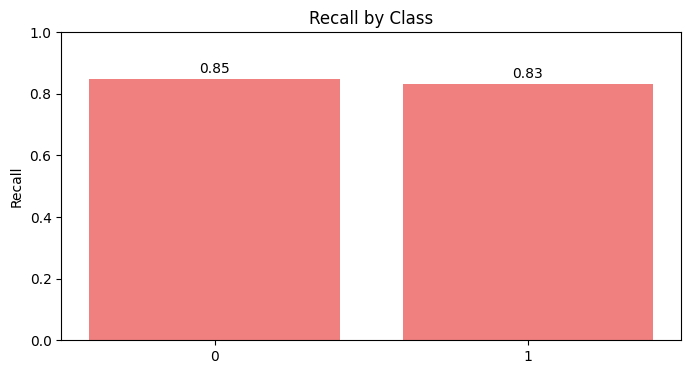

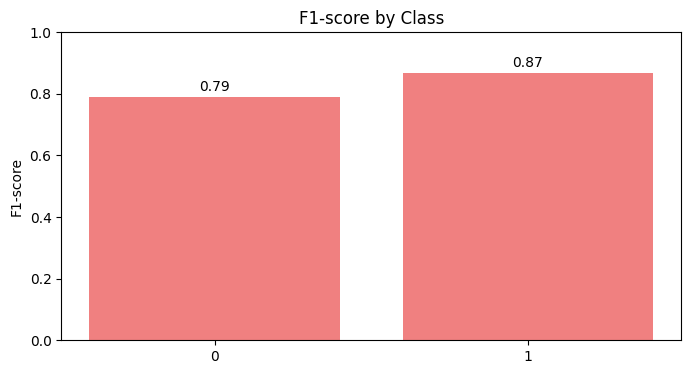

Scenario dataset_scenario_8_S with grid completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


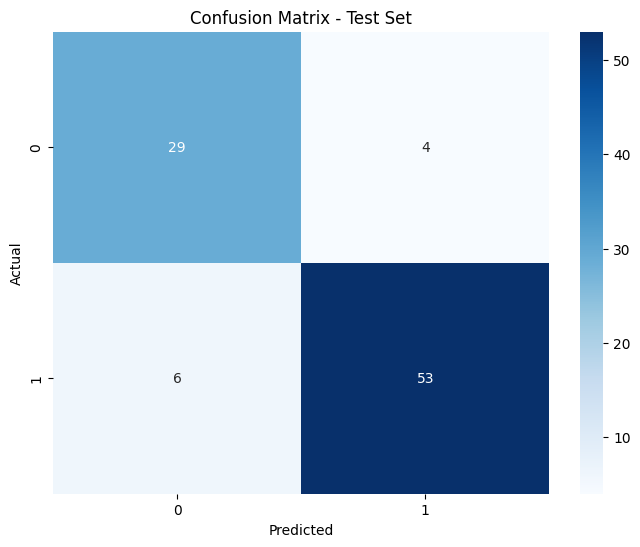

In [60]:
svm_grid_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "SVM", "grid", search_config_grid, get_search_hyperparameters("SVM"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        svm_grid_search['accuracy'] = best_score
        svm_grid_search['params'] = best_params
        svm_grid_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
svc = SVC(**svm_grid_search['params'])
best_scenario = pd.read_csv(svm_grid_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, svc) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "SVM", "grid")
save_model_info(svm_grid_search, "SVM", "grid")
    

## 2. Random Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with random for dataset_scenario_1_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_1_N
Best hyperparameters:  {'kernel': 'poly', 'gamma': 0.1, 'C': 100}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


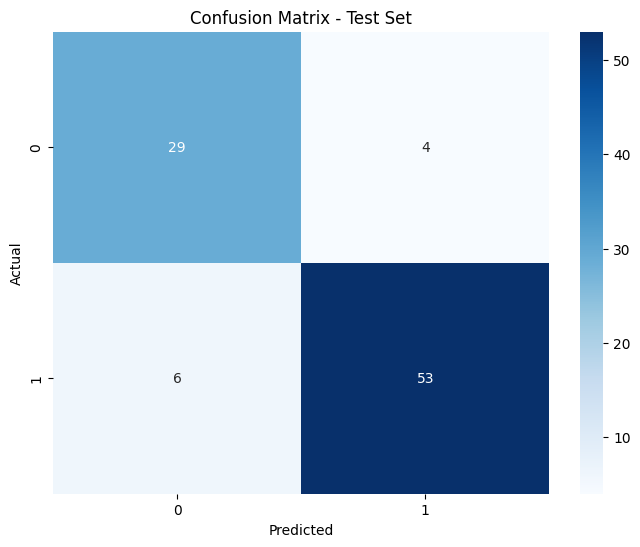

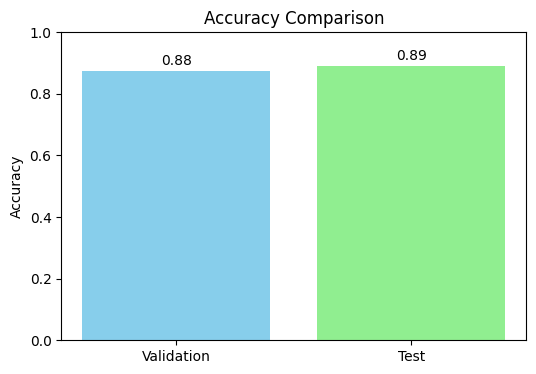

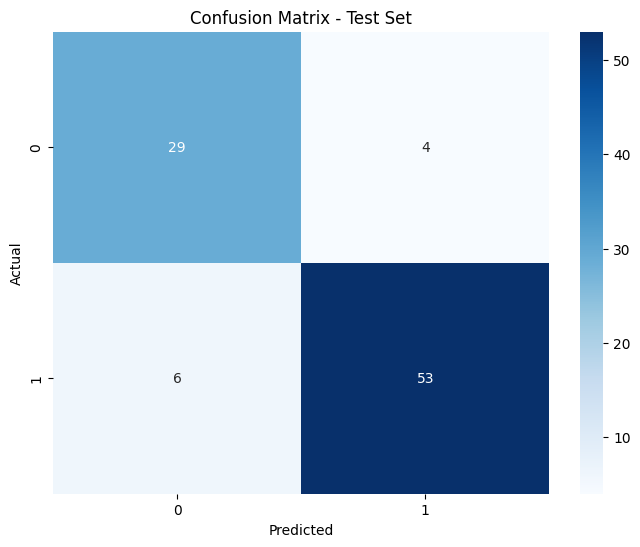

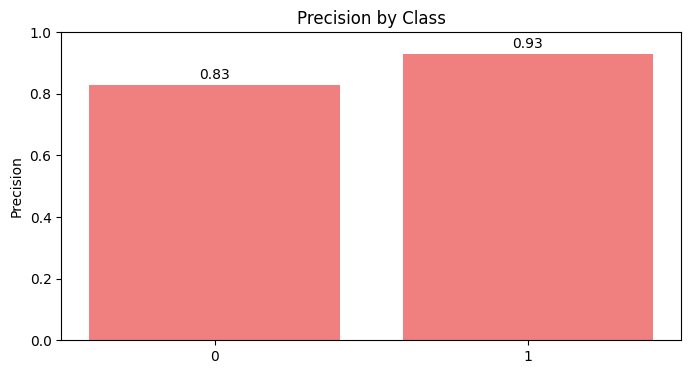

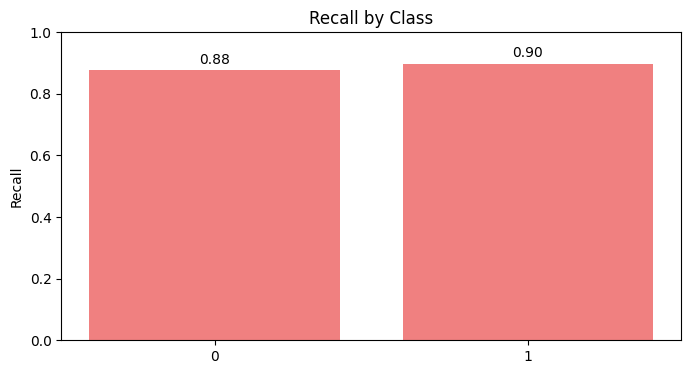

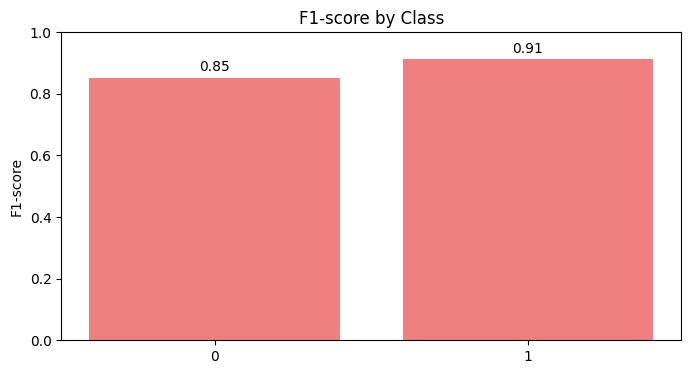

Scenario dataset_scenario_1_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_1_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_1_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.01, 'C': 100}
Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8893
  Recall: 0.8859
  F1 Score: 0.8863

Test Metrics:
  Accuracy: 0.9130
  Precision: 0.9185
  Recall: 0.9130
  F1 Score: 0.9140

Confusion Matrix (Test Set):
[[31  2]
 [ 6 53]]


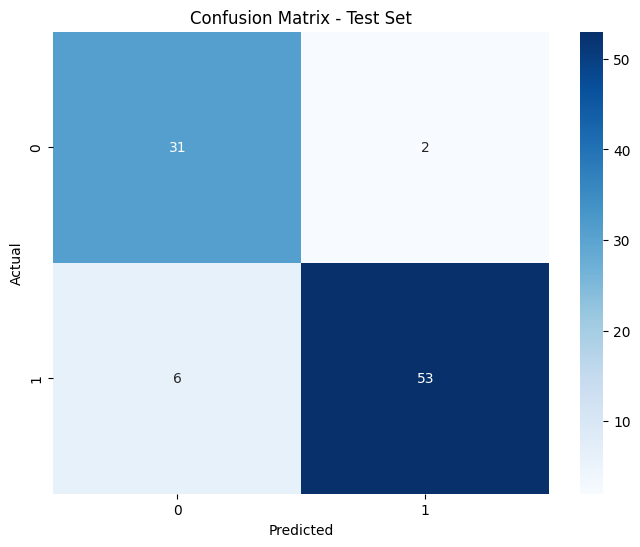

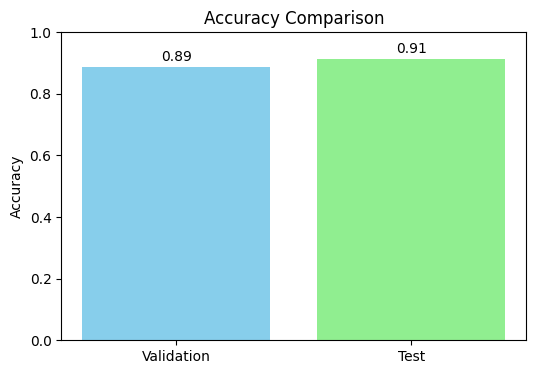

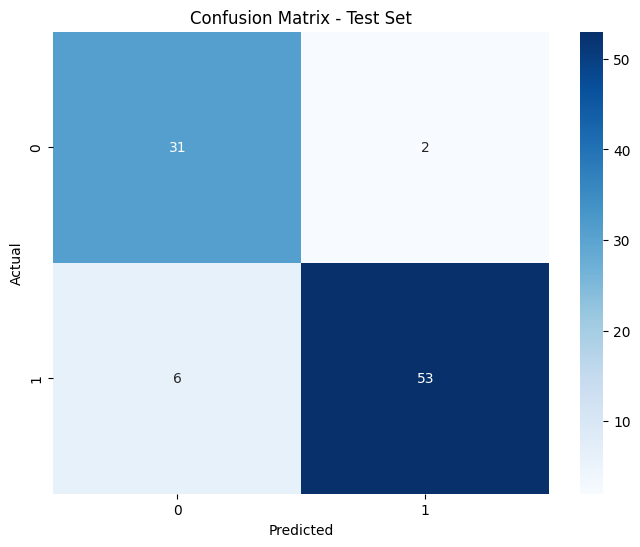

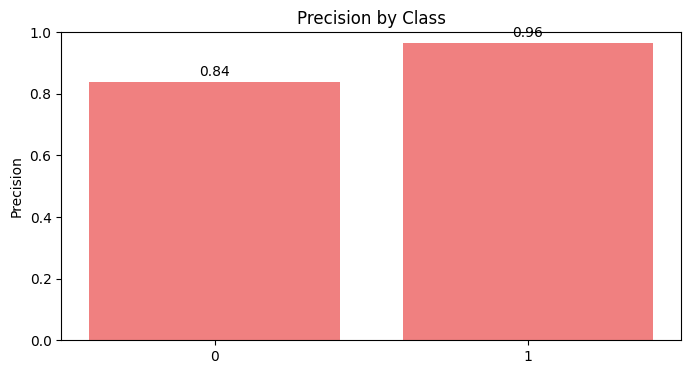

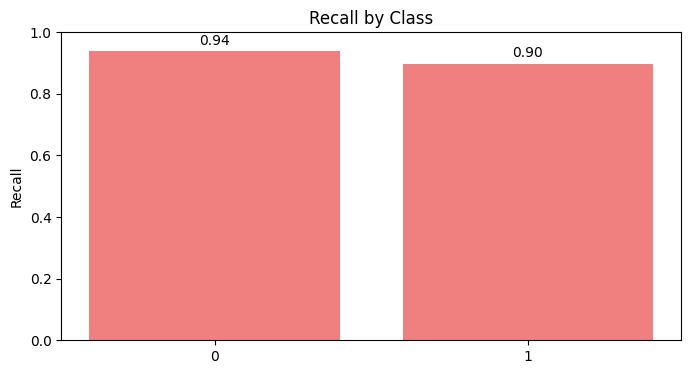

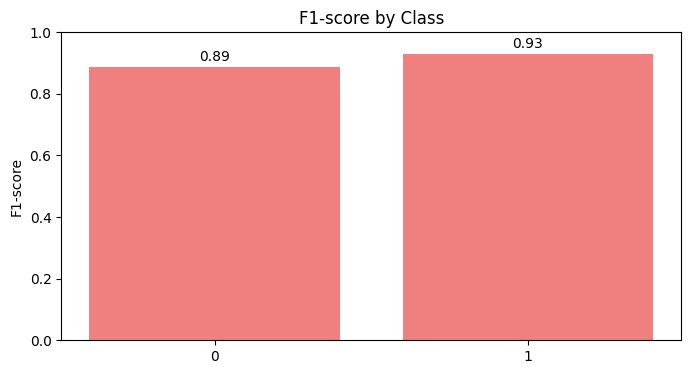

Scenario dataset_scenario_1_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running SVM with random for dataset_scenario_2_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_2_N
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.001, 'C': 1000}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8569
  Recall: 0.8533
  F1 Score: 0.8538

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


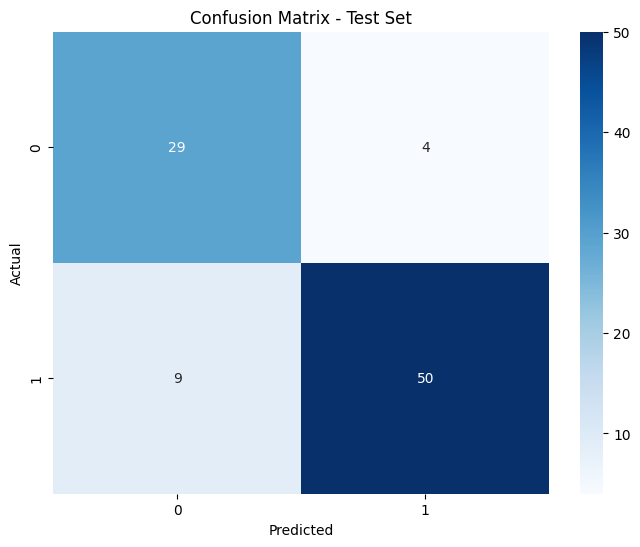

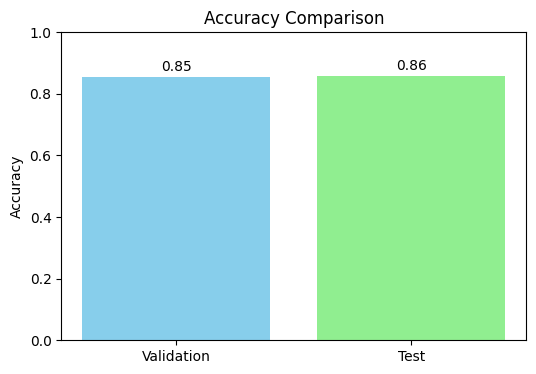

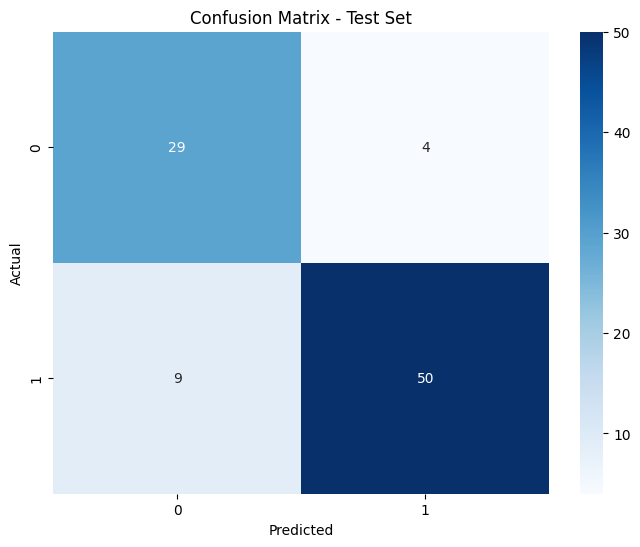

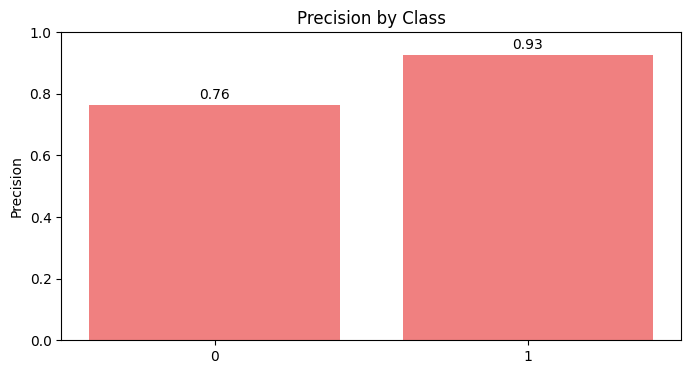

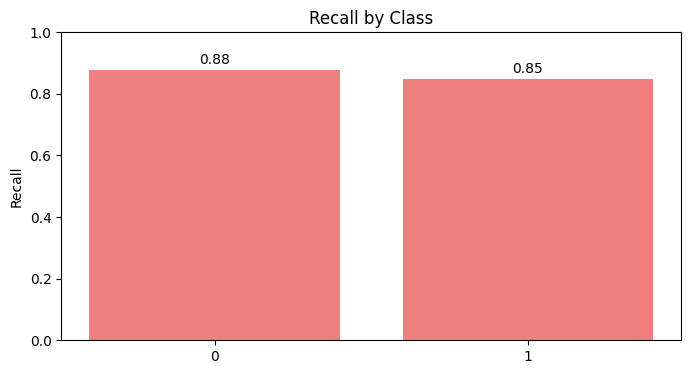

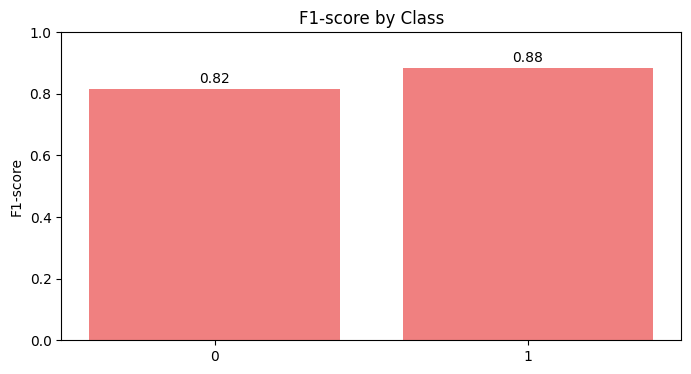

Scenario dataset_scenario_2_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running SVM with random for dataset_scenario_2_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_2_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.001, 'C': 100}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8523
  Recall: 0.8478
  F1 Score: 0.8485

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


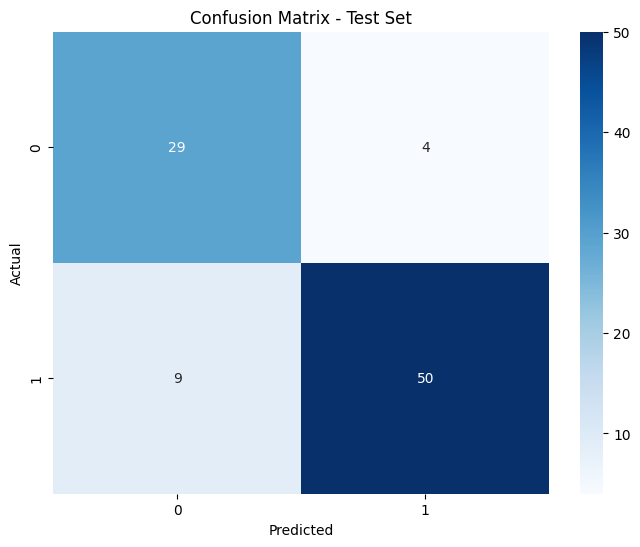

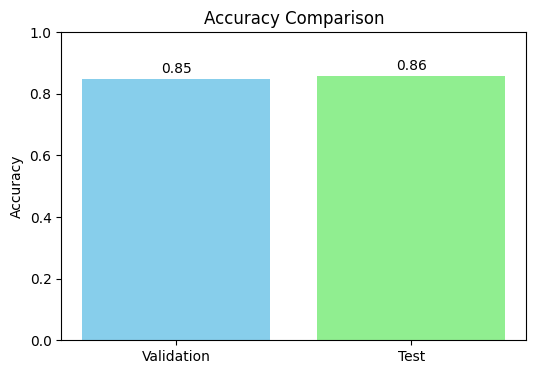

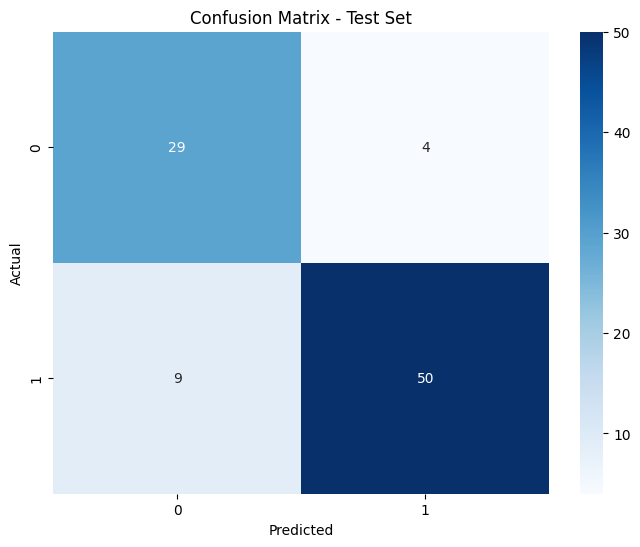

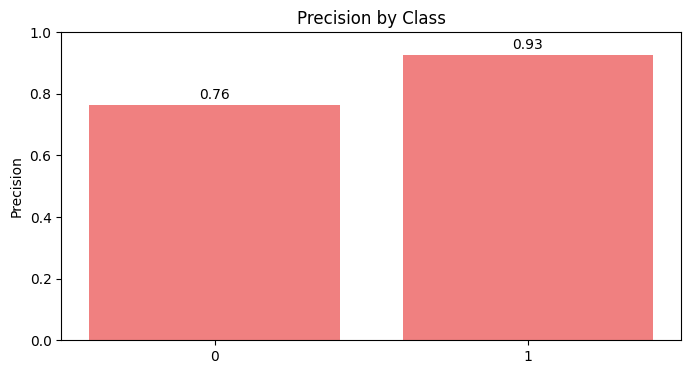

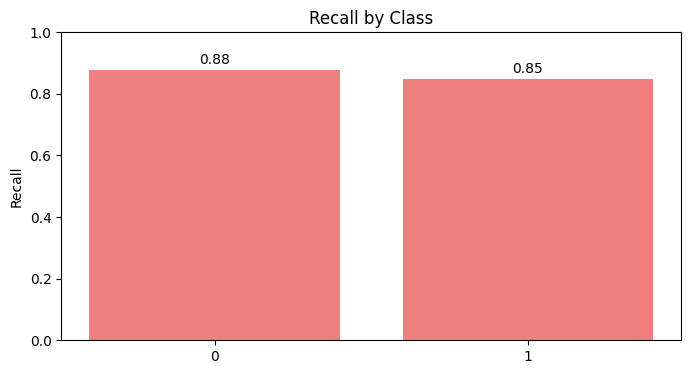

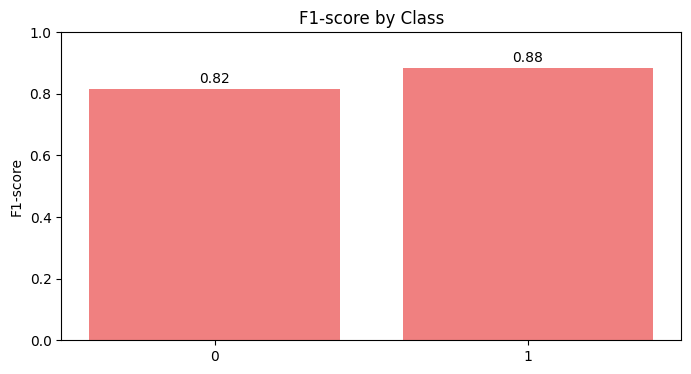

Scenario dataset_scenario_2_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with random for dataset_scenario_3_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_3_N
Best hyperparameters:  {'kernel': 'poly', 'gamma': 0.1, 'C': 100}
Validation Metrics:
  Accuracy: 0.8714
  Precision: 0.8734
  Recall: 0.8714
  F1 Score: 0.8717

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8240
  Recall: 0.8028
  F1 Score: 0.8031

Confusion Matrix (Test Set):
[[29 11]
 [ 3 28]]


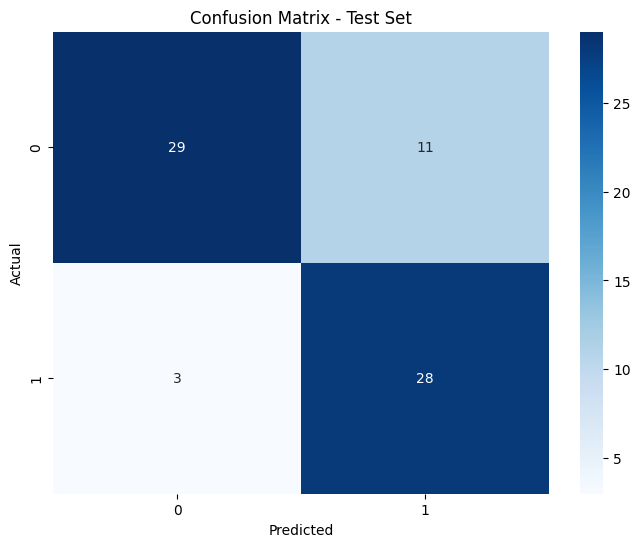

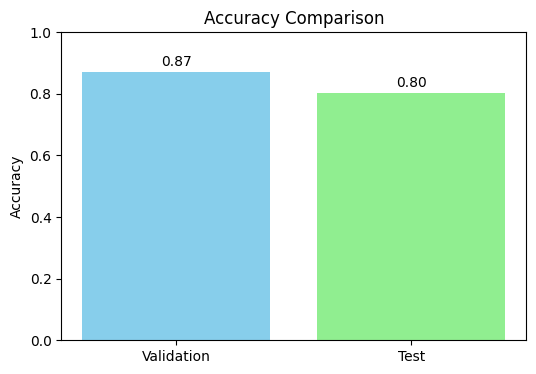

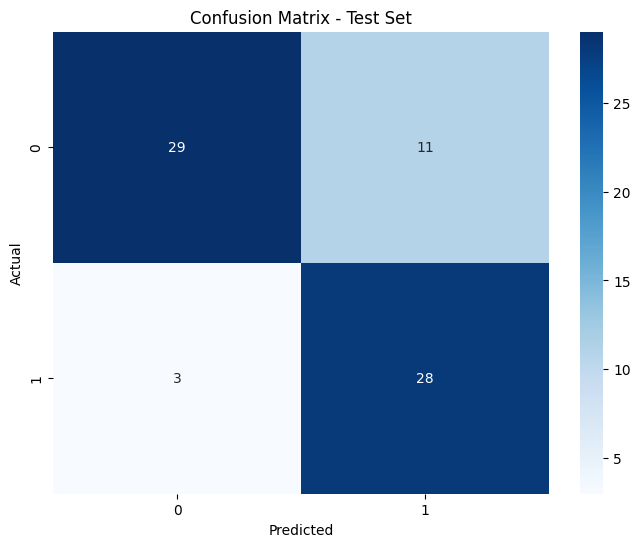

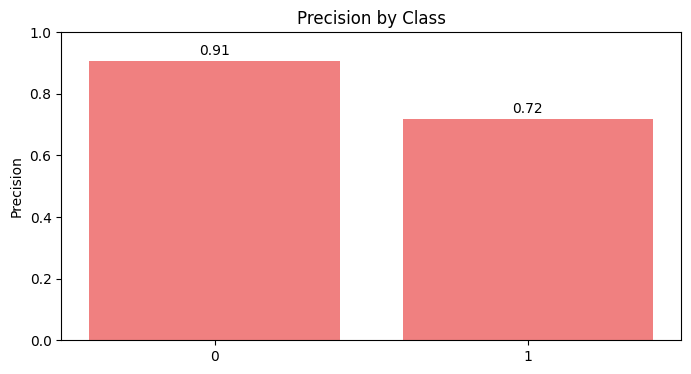

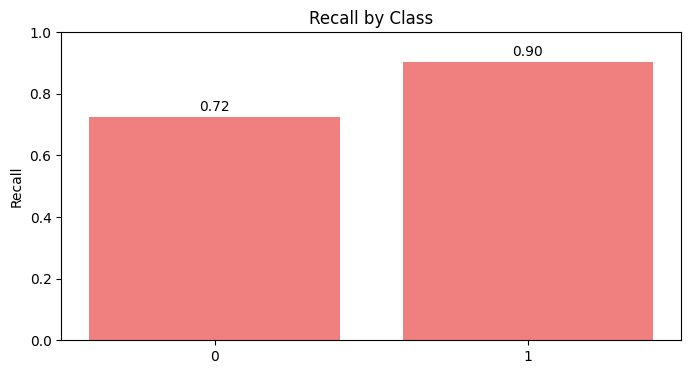

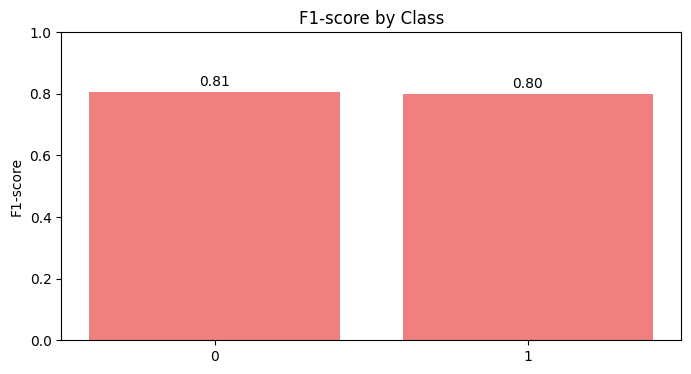

Scenario dataset_scenario_3_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_3_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_3_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.1, 'C': 1}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8655
  Recall: 0.8643
  F1 Score: 0.8645

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8528
  Recall: 0.8310
  F1 Score: 0.8313

Confusion Matrix (Test Set):
[[30 10]
 [ 2 29]]


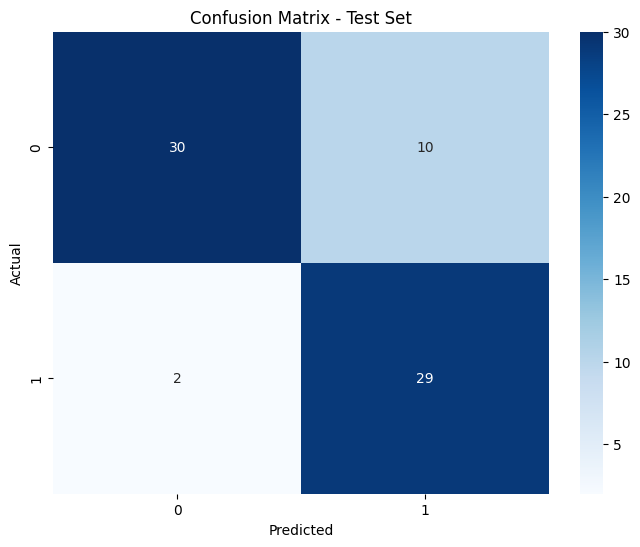

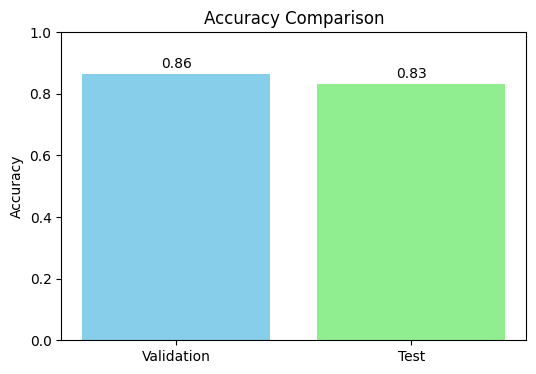

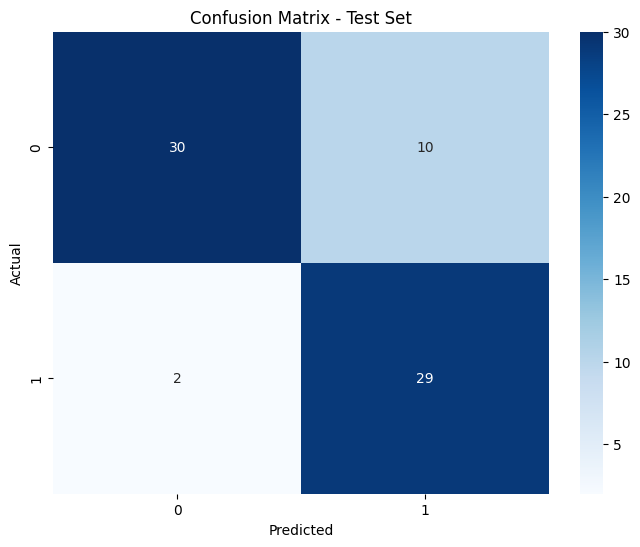

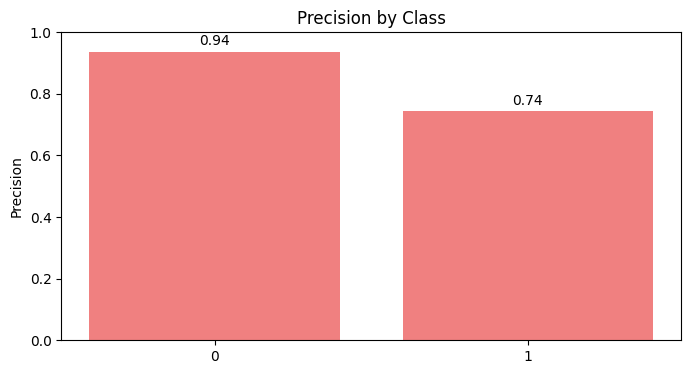

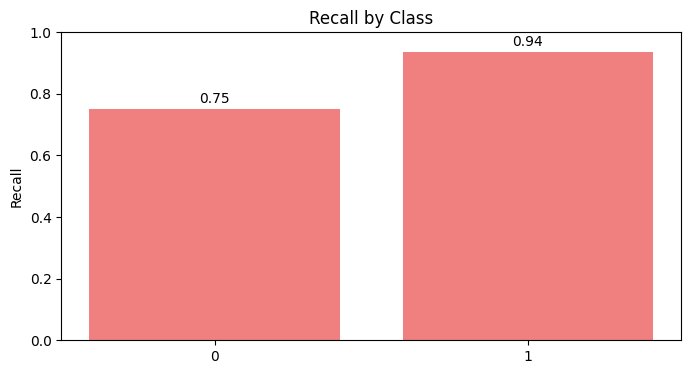

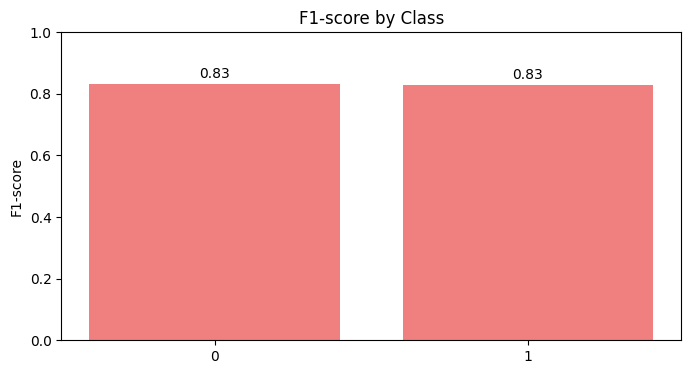

Scenario dataset_scenario_3_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with random for dataset_scenario_4_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_4_N
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 1, 'C': 1}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8748
  Recall: 0.8750
  F1 Score: 0.8749

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8630
  Recall: 0.8587
  F1 Score: 0.8599

Confusion Matrix (Test Set):
[[28  5]
 [ 8 51]]


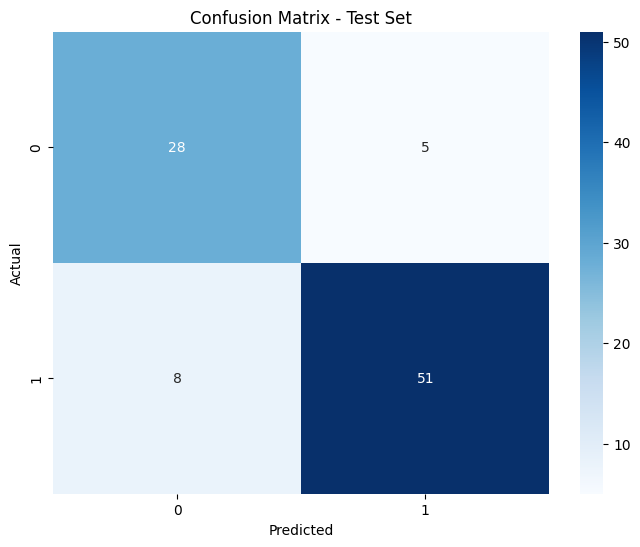

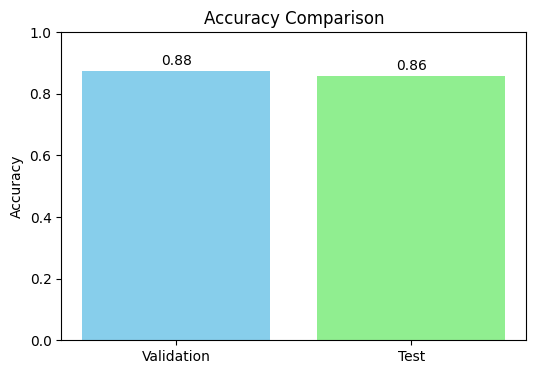

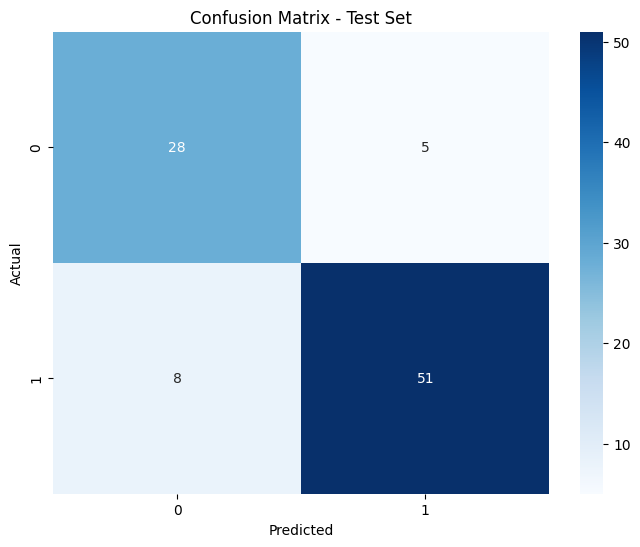

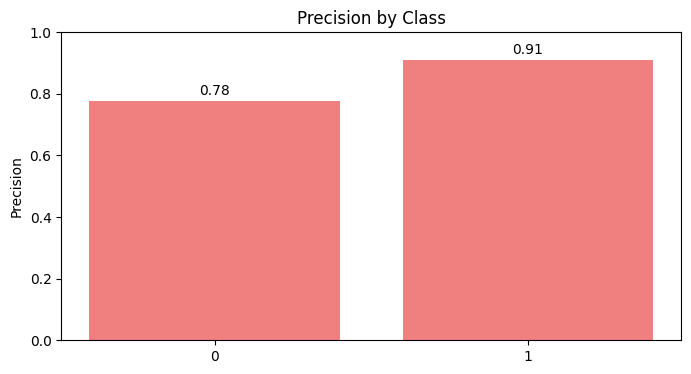

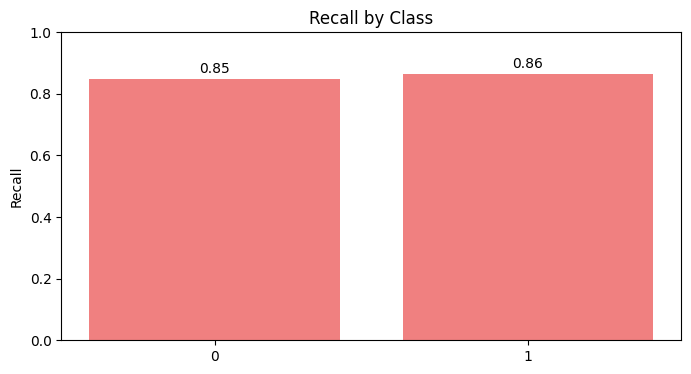

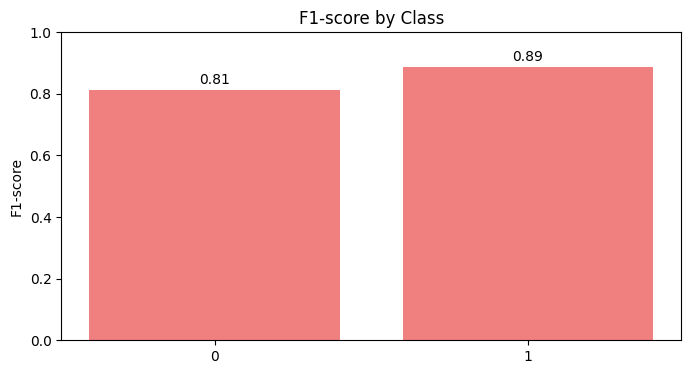

Scenario dataset_scenario_4_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_4_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_4_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.01, 'C': 10}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8663
  Recall: 0.8641
  F1 Score: 0.8646

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


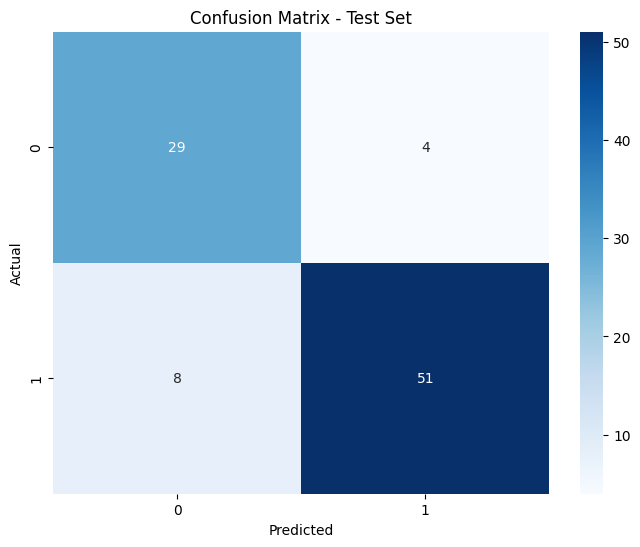

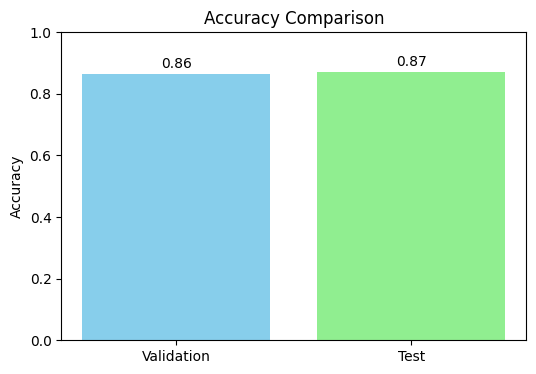

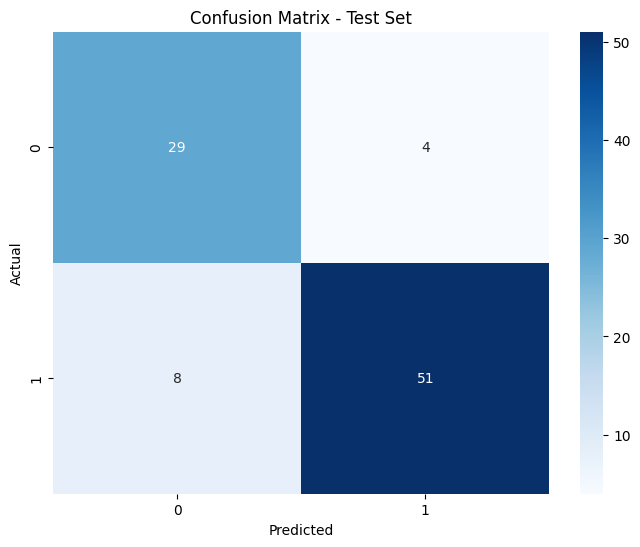

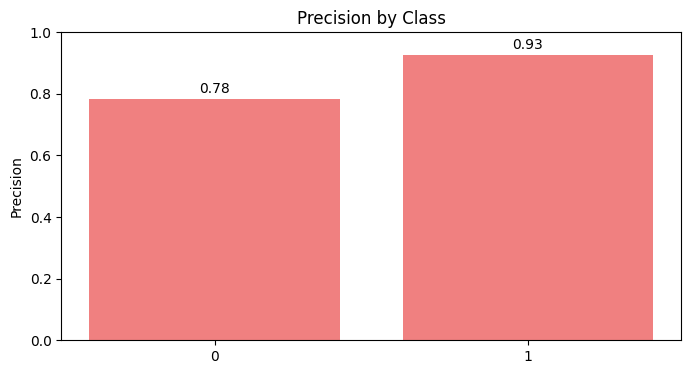

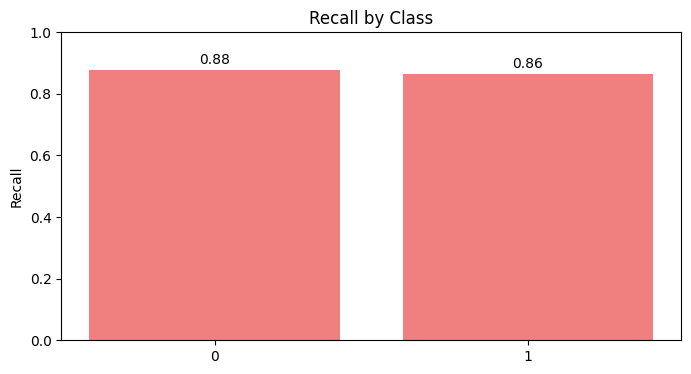

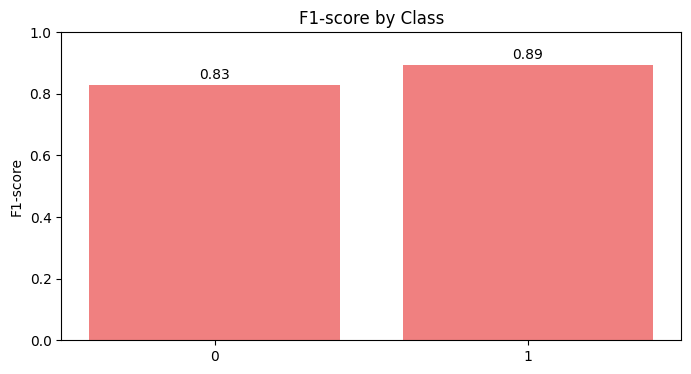

Scenario dataset_scenario_4_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with random for dataset_scenario_5_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_5_N
Best hyperparameters:  {'kernel': 'poly', 'gamma': 0.1, 'C': 10}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8603
  Recall: 0.8587
  F1 Score: 0.8591

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


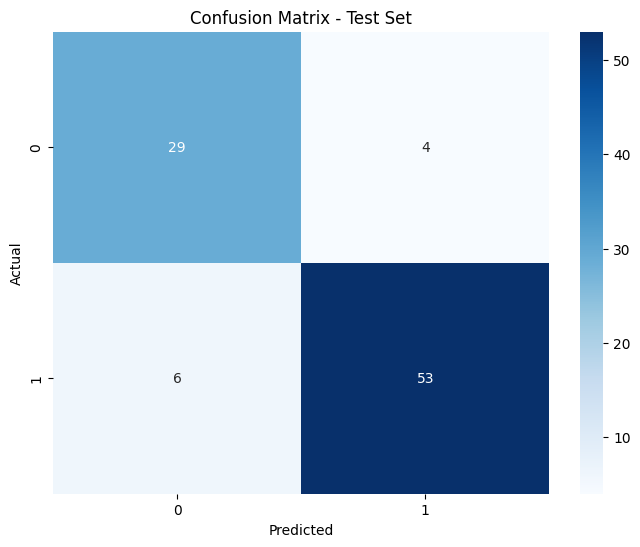

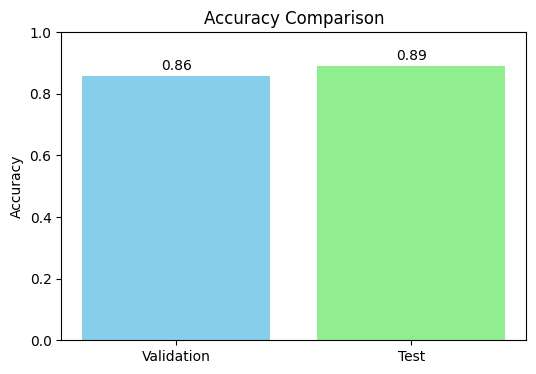

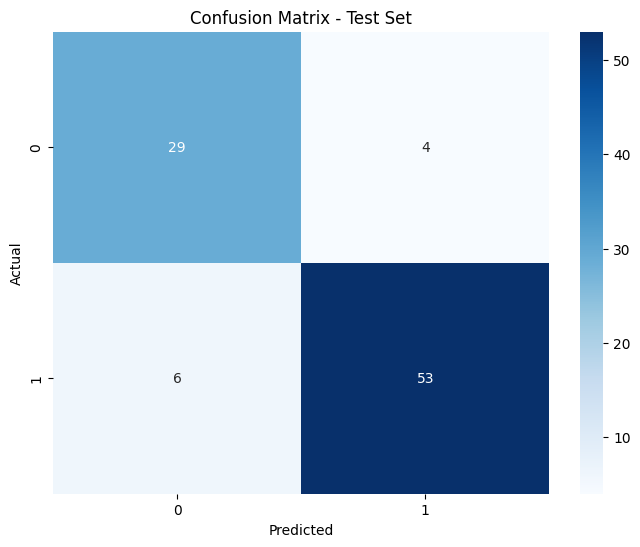

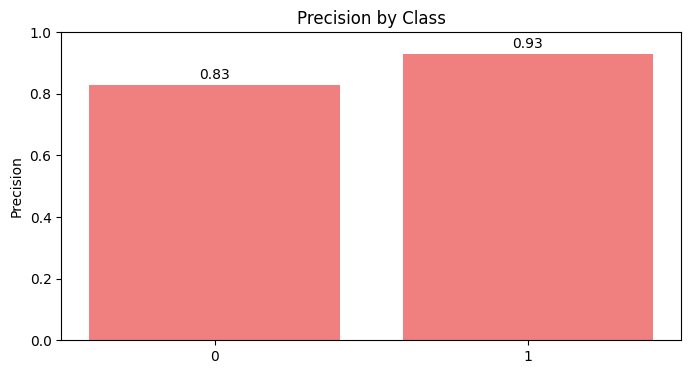

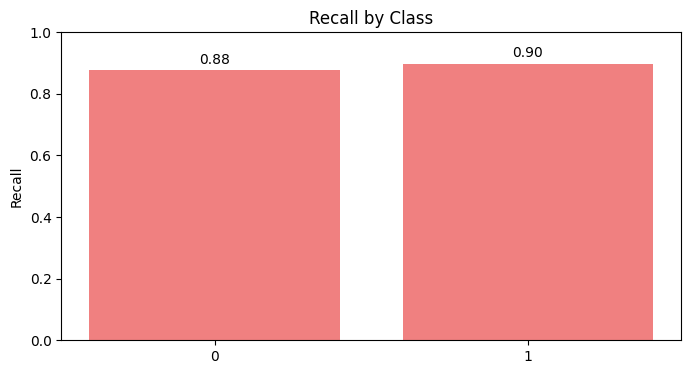

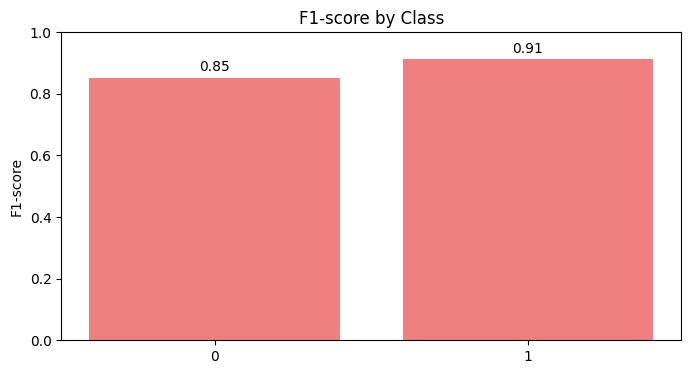

Scenario dataset_scenario_5_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_5_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_5_S
Best hyperparameters:  {'kernel': 'sigmoid', 'gamma': 0.01, 'C': 1}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


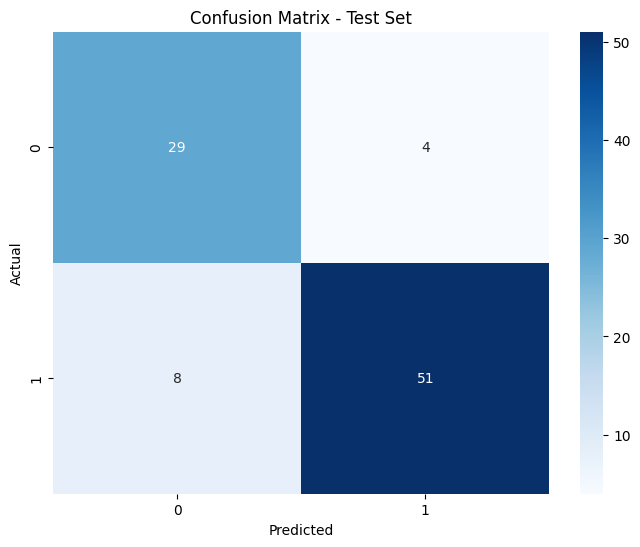

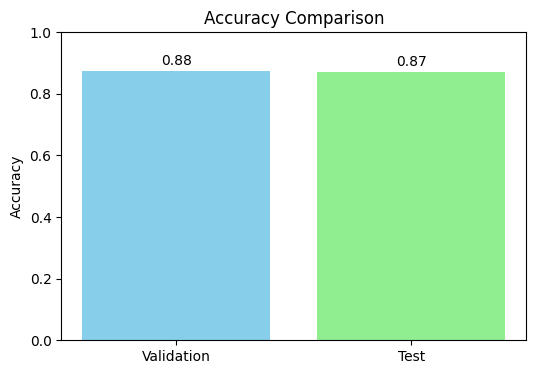

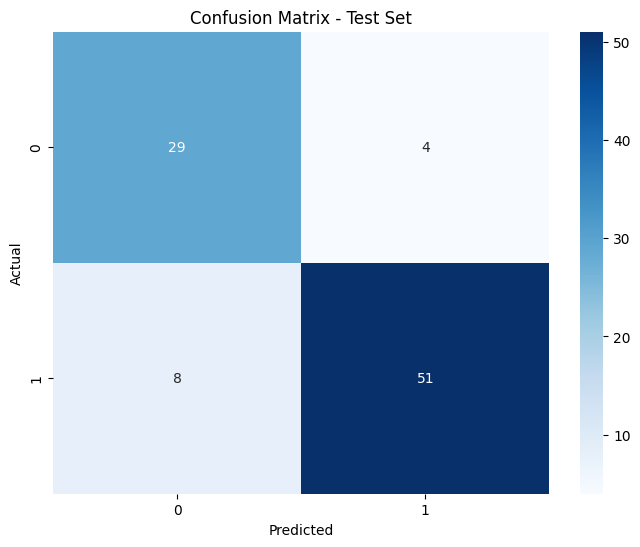

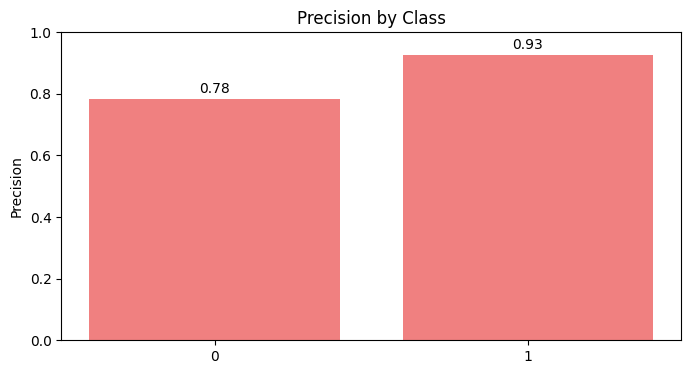

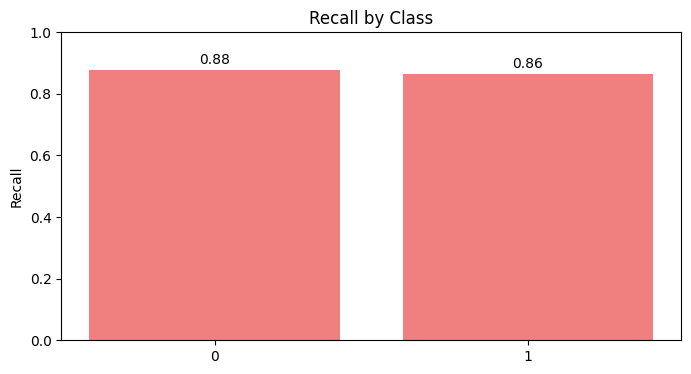

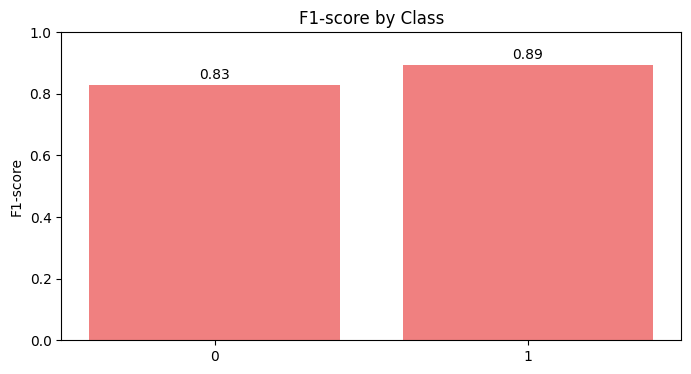

Scenario dataset_scenario_5_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with random for dataset_scenario_6_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_6_N
Best hyperparameters:  {'kernel': 'linear', 'gamma': 0.001, 'C': 10}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


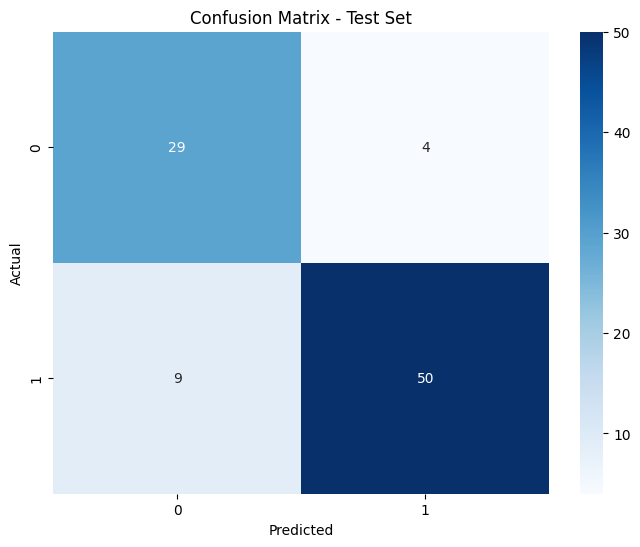

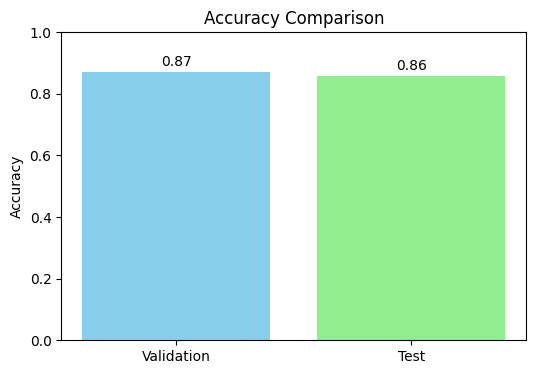

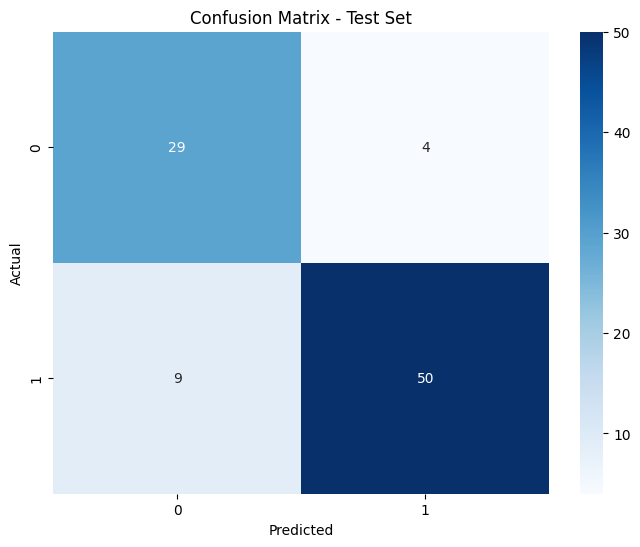

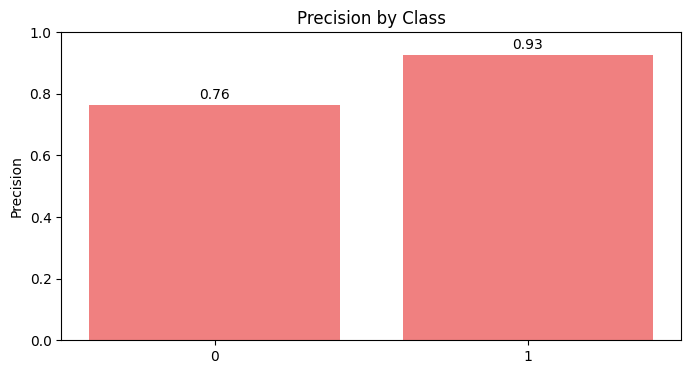

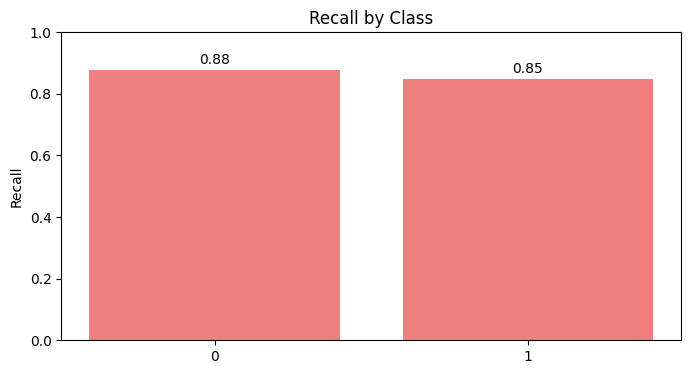

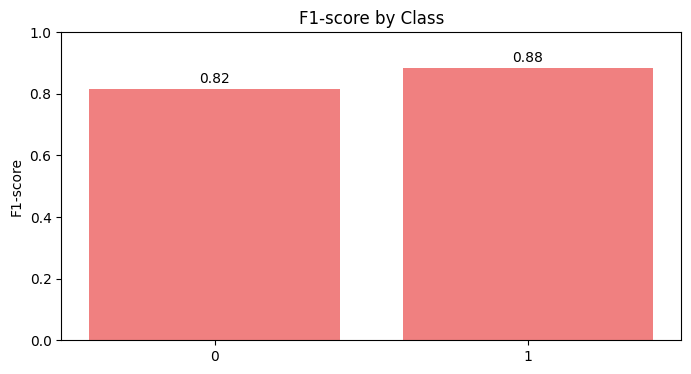

Scenario dataset_scenario_6_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_6_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_6_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.0001, 'C': 1000}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


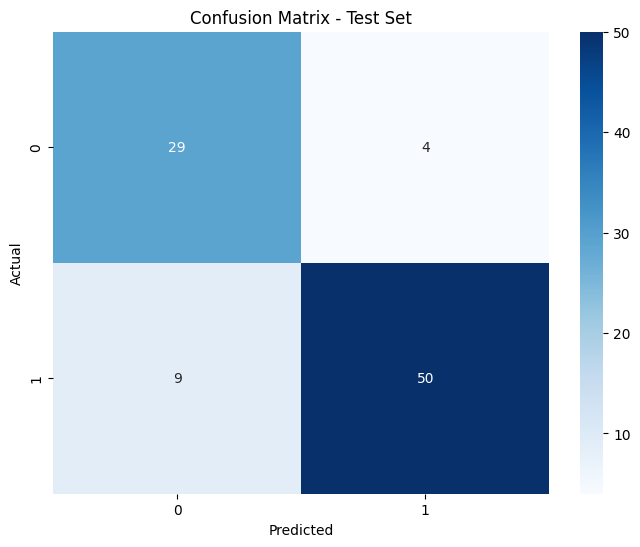

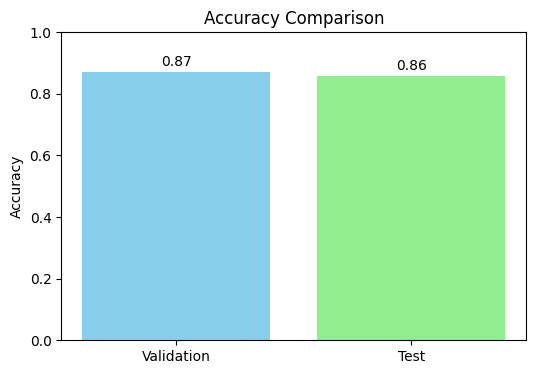

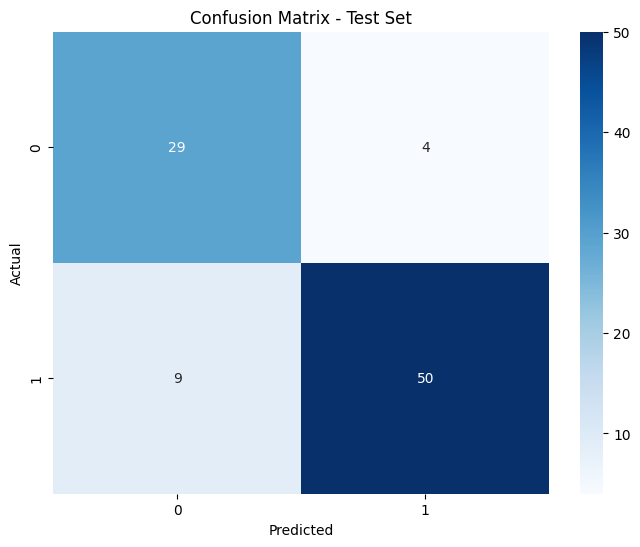

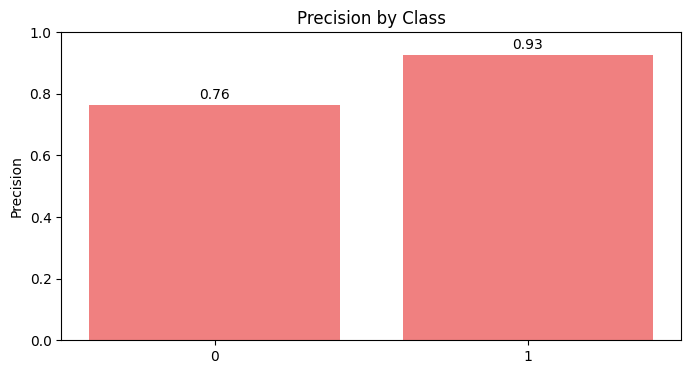

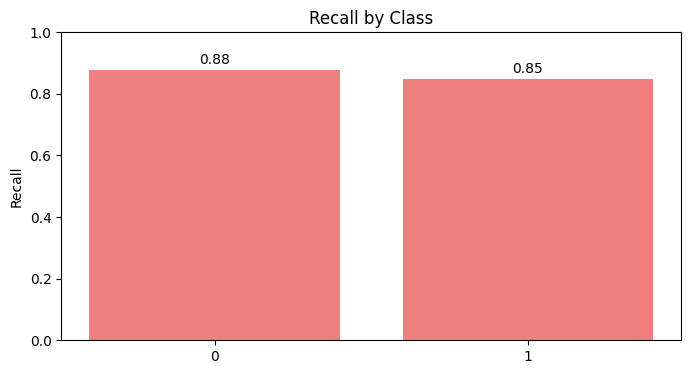

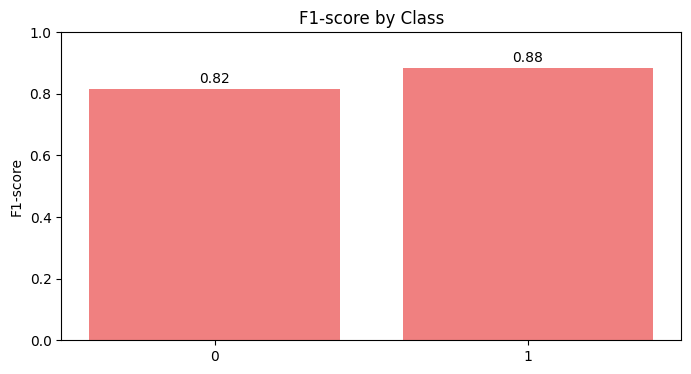

Scenario dataset_scenario_6_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with random for dataset_scenario_7_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_7_N
Best hyperparameters:  {'kernel': 'sigmoid', 'gamma': 0.01, 'C': 100}
Validation Metrics:
  Accuracy: 0.8714
  Precision: 0.8721
  Recall: 0.8714
  F1 Score: 0.8716

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8240
  Recall: 0.8028
  F1 Score: 0.8031

Confusion Matrix (Test Set):
[[29 11]
 [ 3 28]]


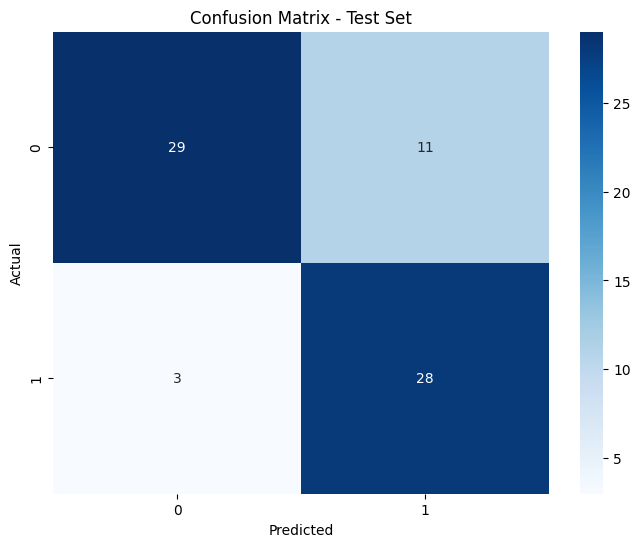

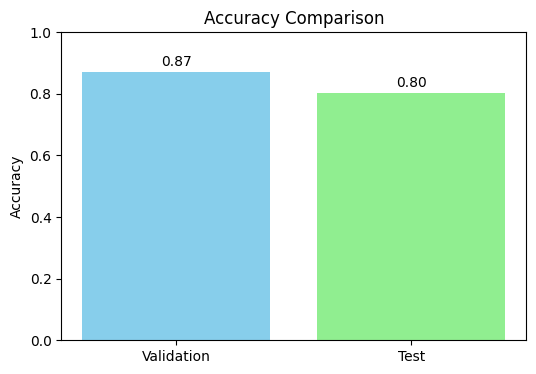

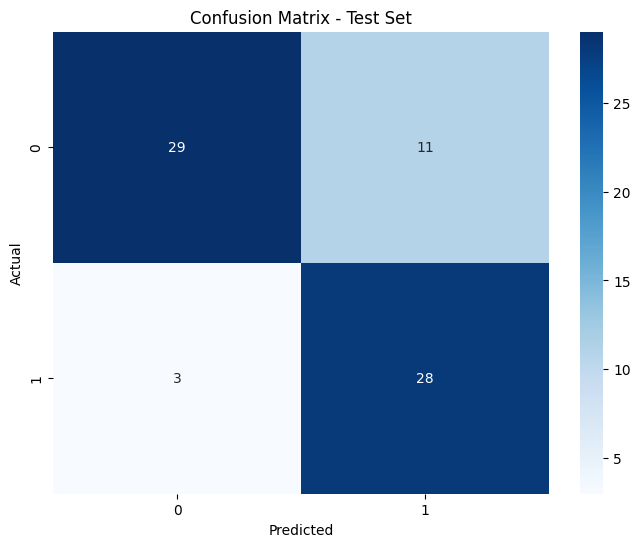

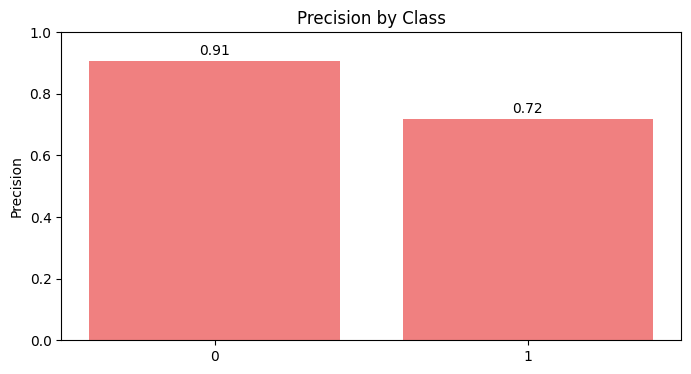

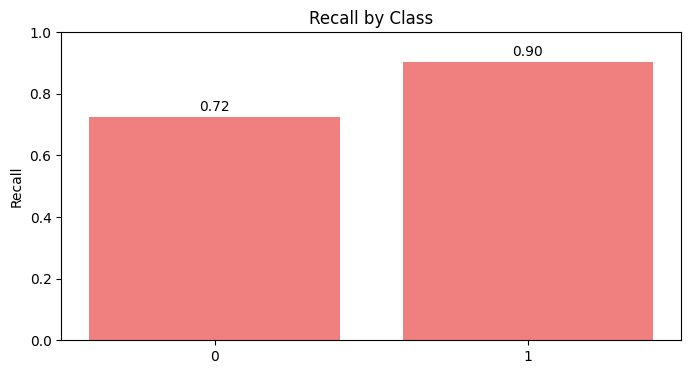

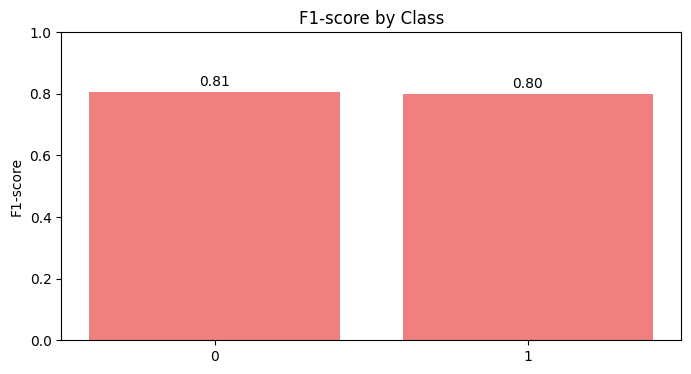

Scenario dataset_scenario_7_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_7_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_7_S
Best hyperparameters:  {'kernel': 'sigmoid', 'gamma': 0.01, 'C': 10}
Validation Metrics:
  Accuracy: 0.8714
  Precision: 0.8721
  Recall: 0.8714
  F1 Score: 0.8716

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8240
  Recall: 0.8028
  F1 Score: 0.8031

Confusion Matrix (Test Set):
[[29 11]
 [ 3 28]]


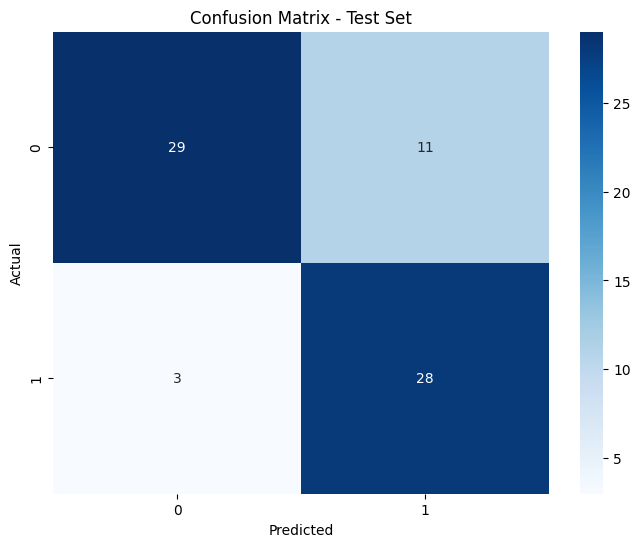

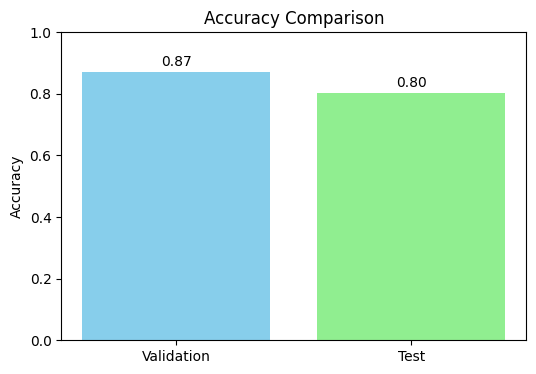

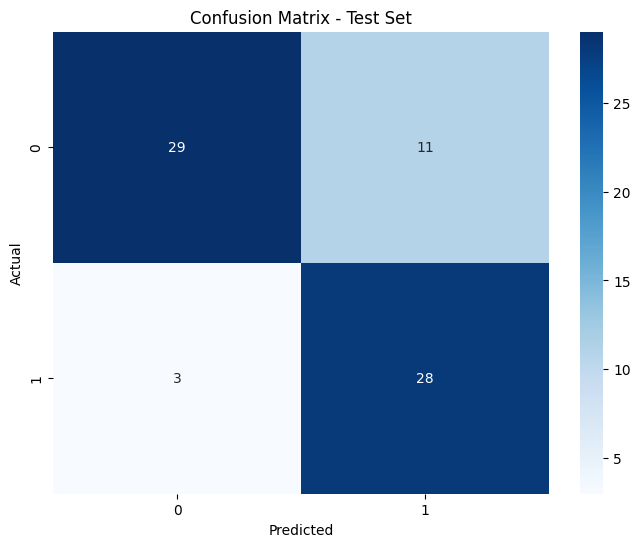

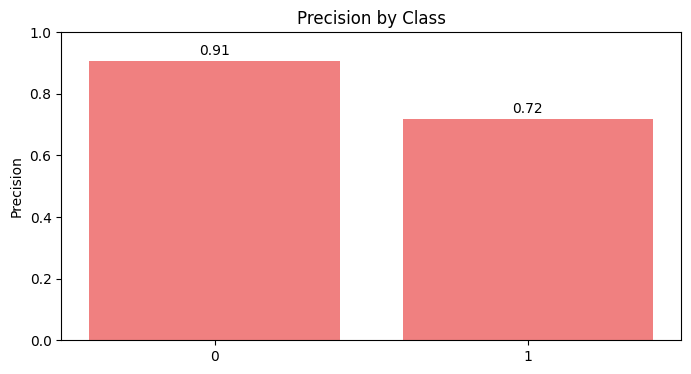

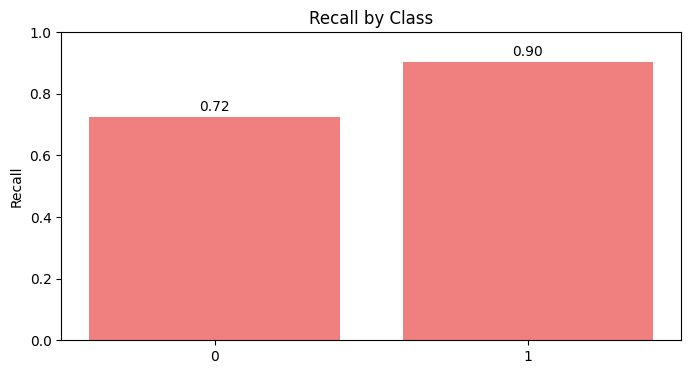

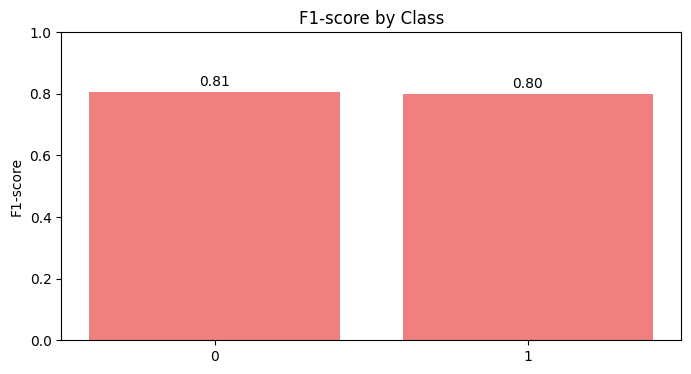

Scenario dataset_scenario_7_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with random for dataset_scenario_8_N...
Results will be saved in: SCORES\SVM\random\dataset_scenario_8_N
Best hyperparameters:  {'kernel': 'poly', 'gamma': 0.1, 'C': 10}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8696
  Recall: 0.8696
  F1 Score: 0.8696

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


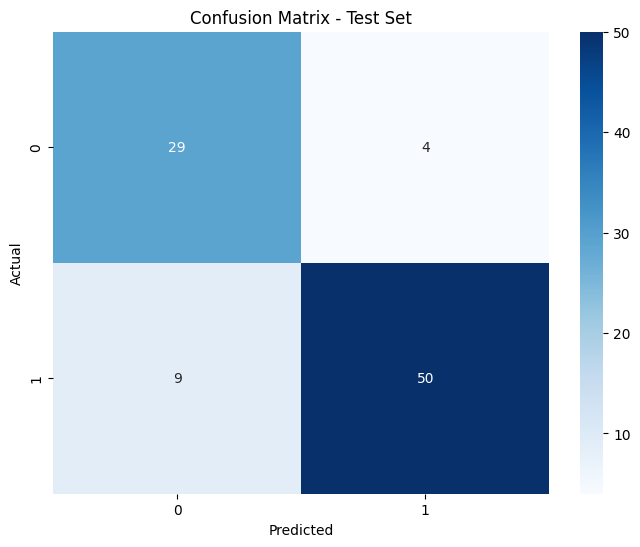

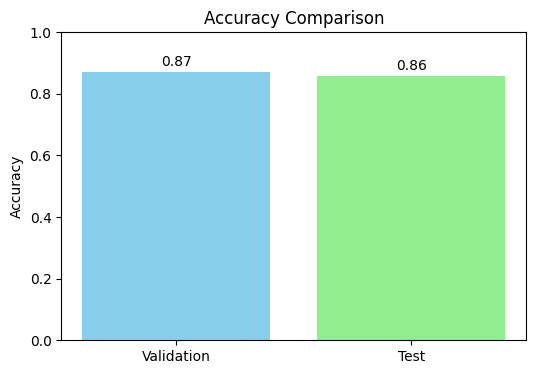

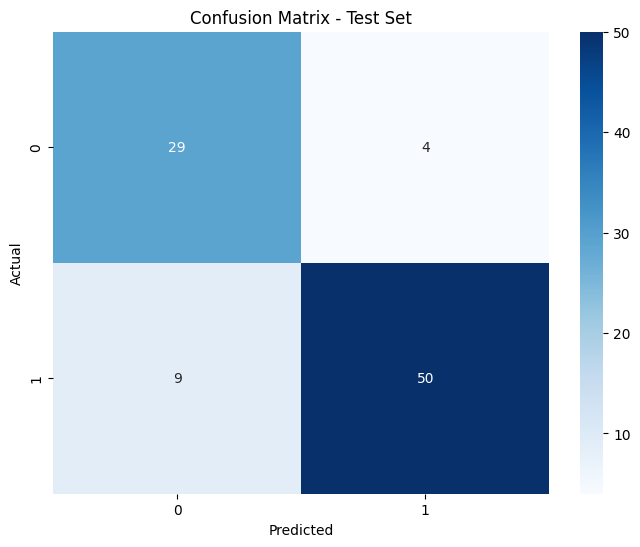

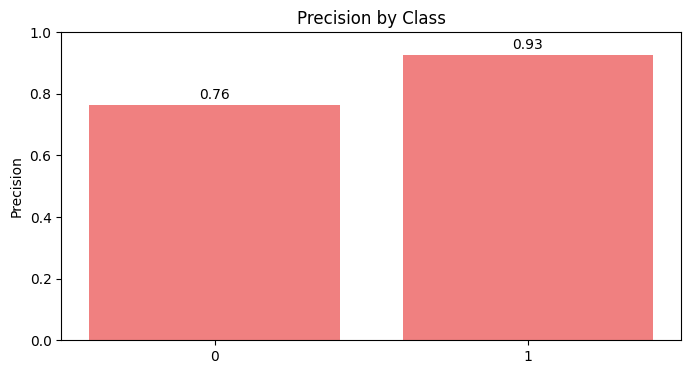

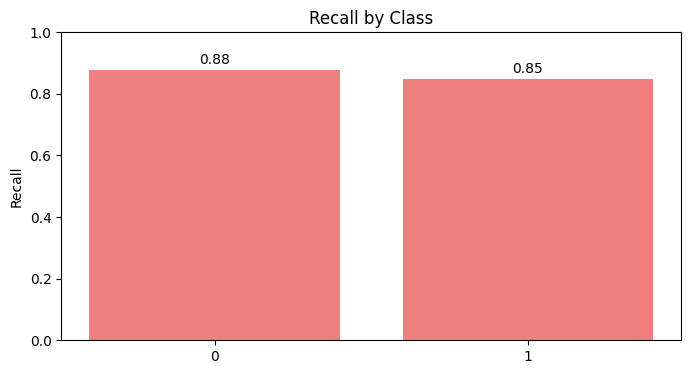

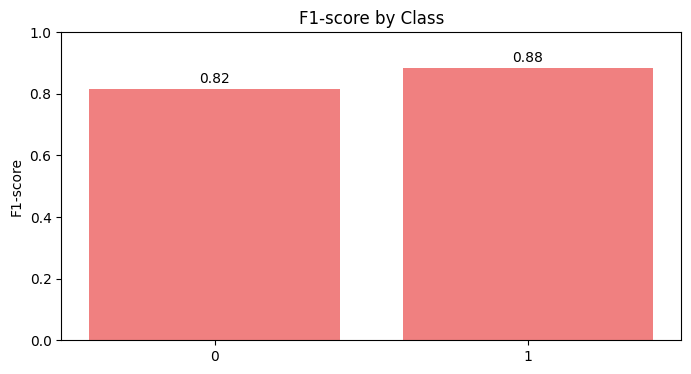

Scenario dataset_scenario_8_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with random for dataset_scenario_8_S...
Results will be saved in: SCORES\SVM\random\dataset_scenario_8_S
Best hyperparameters:  {'kernel': 'rbf', 'gamma': 0.001, 'C': 100}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8644
  Recall: 0.8641
  F1 Score: 0.8642

Test Metrics:
  Accuracy: 0.8370
  Precision: 0.8462
  Recall: 0.8370
  F1 Score: 0.8391

Confusion Matrix (Test Set):
[[28  5]
 [10 49]]


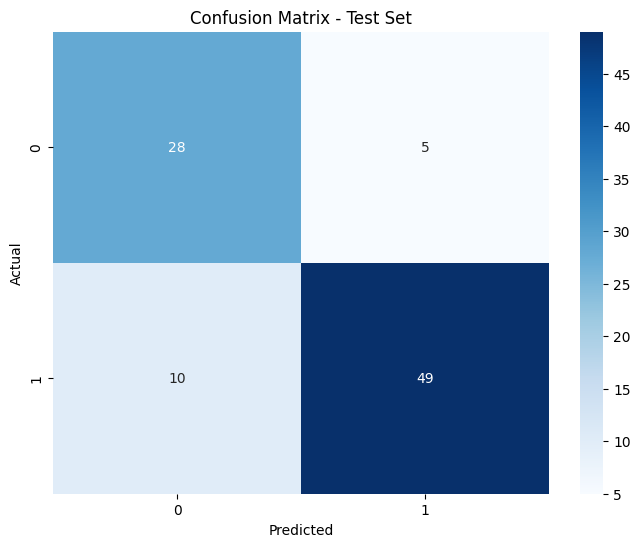

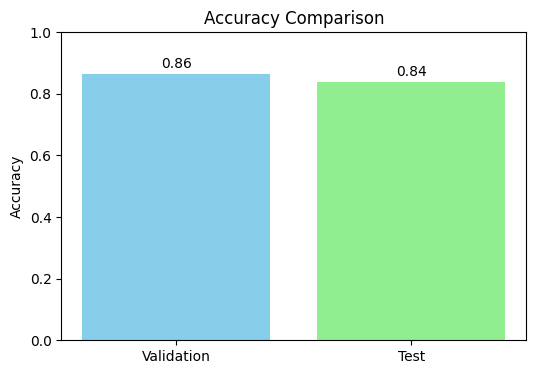

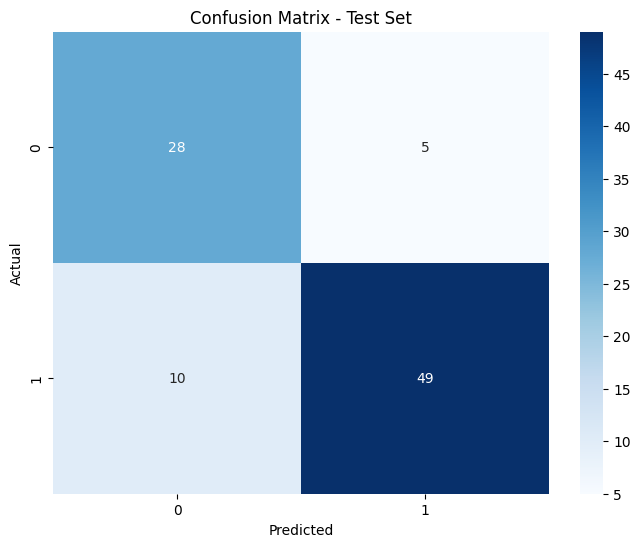

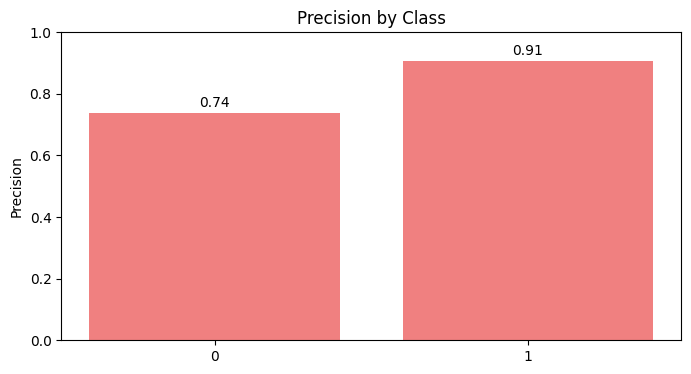

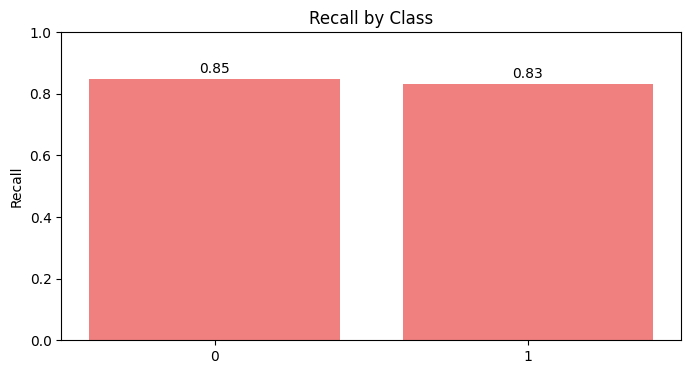

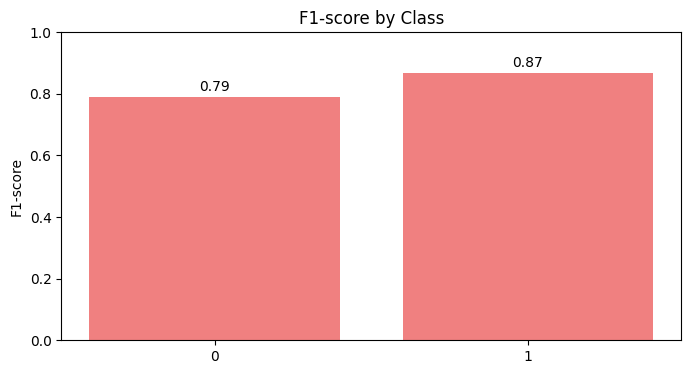

Scenario dataset_scenario_8_S with random completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8893
  Recall: 0.8859
  F1 Score: 0.8863

Test Metrics:
  Accuracy: 0.9130
  Precision: 0.9185
  Recall: 0.9130
  F1 Score: 0.9140

Confusion Matrix (Test Set):
[[31  2]
 [ 6 53]]


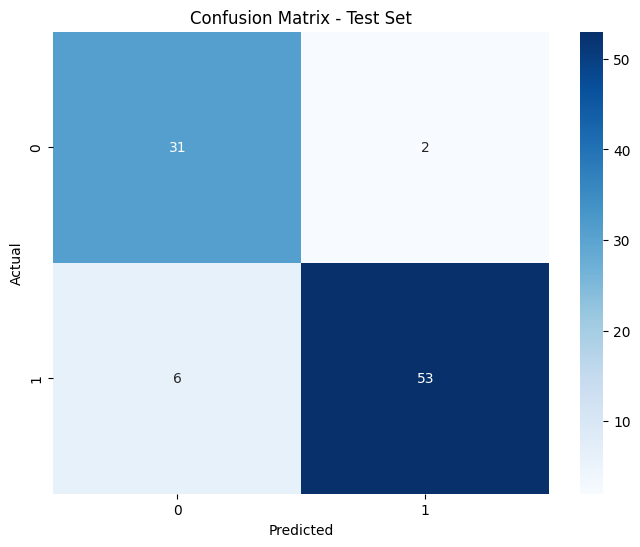

In [61]:
svm_random_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "SVM", "random", search_config_random, get_search_hyperparameters("SVM"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        svm_random_search['accuracy'] = best_score
        svm_random_search['params'] = best_params
        svm_random_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
svc = SVC(**svm_random_search['params'])
best_scenario = pd.read_csv(svm_random_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, svc) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "SVM", "random")
save_model_info(svm_random_search, "SVM", "random")
    

## 3. Bayesian Optimization (Optuna)

[I 2024-12-06 02:25:33,376] A new study created in memory with name: no-name-b26322bf-16a8-4b50-a024-32bd9356e433


Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with optuna for dataset_scenario_1_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_1_N


[I 2024-12-06 02:25:35,069] Trial 0 finished with value: 0.8114462209302324 and parameters: {'C': 6.170037396219892, 'gamma': 6.958748101456666, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8114462209302324.
[I 2024-12-06 02:25:36,157] Trial 1 finished with value: 0.5358284883720931 and parameters: {'C': 7.466250198359192, 'gamma': 6.101021113932941, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8114462209302324.
[I 2024-12-06 02:25:37,838] Trial 2 finished with value: 0.7803173449612404 and parameters: {'C': 9.180443604019192, 'gamma': 7.4902308336558665, 'kernel': 'poly'}. Best is trial 0 with value: 0.8114462209302324.
[I 2024-12-06 02:25:38,743] Trial 3 finished with value: 0.8161216085271317 and parameters: {'C': 6.780171398620944, 'gamma': 4.7126442764437755, 'kernel': 'rbf'}. Best is trial 3 with value: 0.8161216085271317.
[I 2024-12-06 02:25:38,769] Trial 4 finished with value: 0.8395469961240309 and parameters: {'C': 2.264890575885988, 'gamma': 2.768925675494118, 'ker

Best hyperparameters:  {'C': 2.15593571305865, 'gamma': 0.41612123966837666, 'kernel': 'poly'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8771
  Recall: 0.8750
  F1 Score: 0.8754

Test Metrics:
  Accuracy: 0.9022
  Precision: 0.9059
  Recall: 0.9022
  F1 Score: 0.9030

Confusion Matrix (Test Set):
[[30  3]
 [ 6 53]]


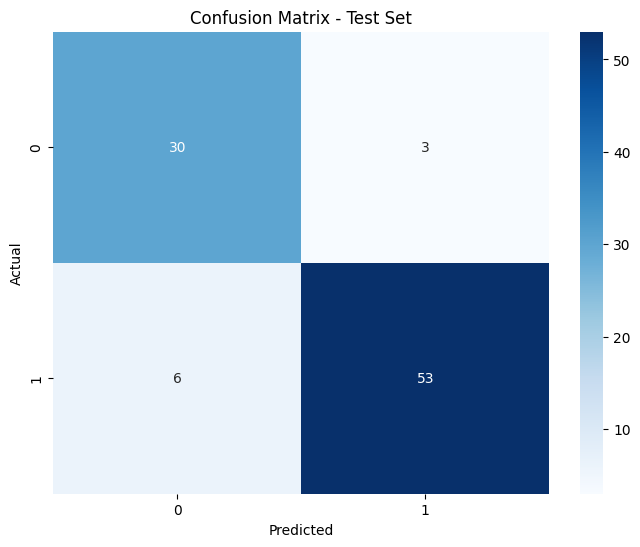

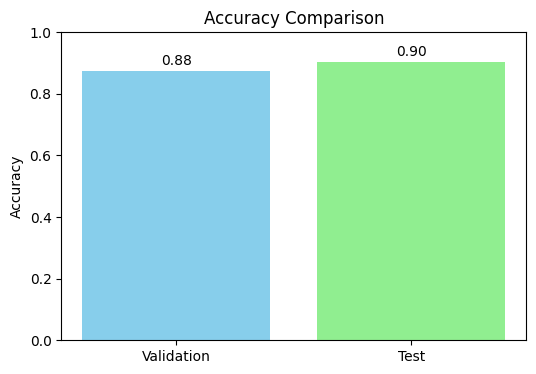

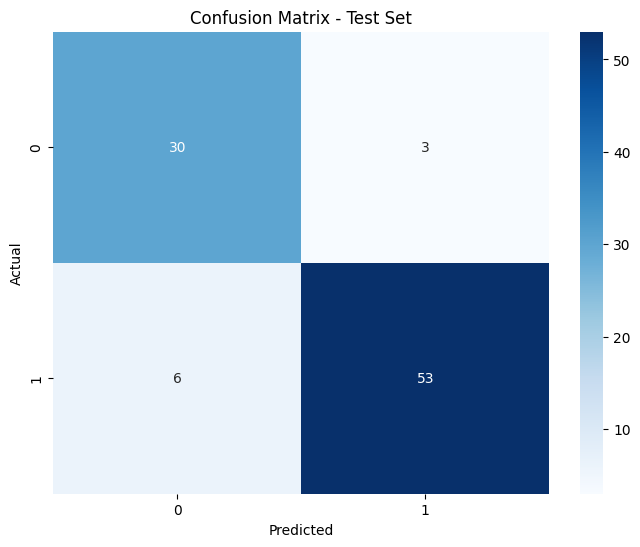

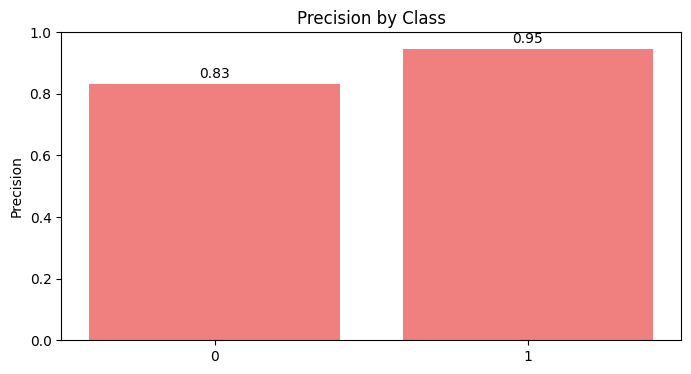

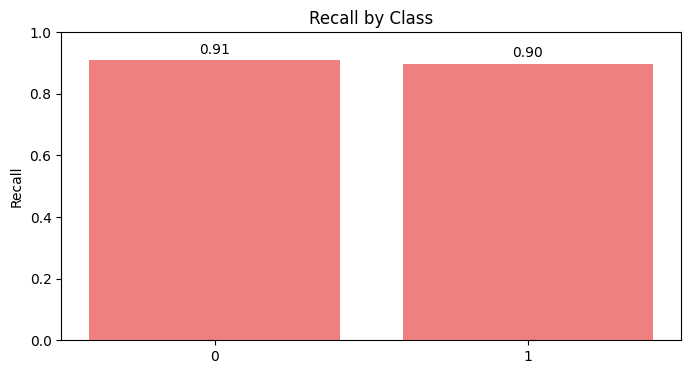

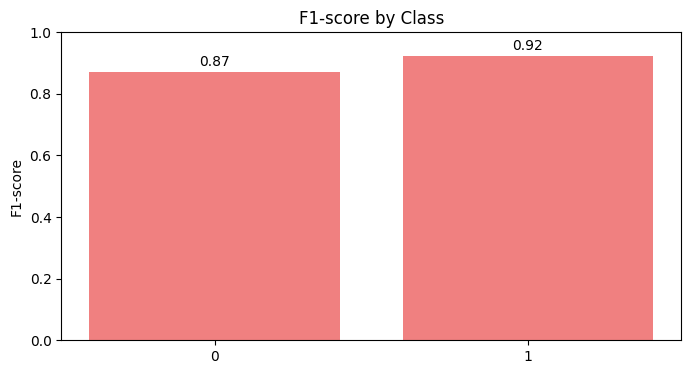

[I 2024-12-06 02:25:44,045] A new study created in memory with name: no-name-10a4e062-3944-461e-bb16-b7d02ba92669
[I 2024-12-06 02:25:44,070] Trial 0 finished with value: 0.7741157945736434 and parameters: {'C': 7.4985379170399185, 'gamma': 0.7021386131133648, 'kernel': 'poly'}. Best is trial 0 with value: 0.7741157945736434.
[I 2024-12-06 02:25:44,095] Trial 1 finished with value: 0.8239341085271317 and parameters: {'C': 9.067483181737035, 'gamma': 0.2135477053033819, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8239341085271317.
[I 2024-12-06 02:25:44,121] Trial 2 finished with value: 0.7741157945736434 and parameters: {'C': 1.8095668856689298, 'gamma': 9.60867927036548, 'kernel': 'poly'}. Best is trial 1 with value: 0.8239341085271317.
[I 2024-12-06 02:25:44,145] Trial 3 finished with value: 0.8442223837209302 and parameters: {'C': 2.9455379002262596, 'gamma': 4.7688842003309375, 'kernel': 'linear'}. Best is trial 3 with value: 0.8442223837209302.
[I 2024-12-06 02:25:44,180] Tria

Scenario dataset_scenario_1_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_1_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_1_S


[I 2024-12-06 02:25:44,257] Trial 7 finished with value: 0.8442223837209302 and parameters: {'C': 1.2222347333302488, 'gamma': 2.417872934393148, 'kernel': 'linear'}. Best is trial 3 with value: 0.8442223837209302.
[I 2024-12-06 02:25:44,282] Trial 8 finished with value: 0.8442223837209302 and parameters: {'C': 2.5357261385843635, 'gamma': 9.174447298630705, 'kernel': 'linear'}. Best is trial 3 with value: 0.8442223837209302.
[I 2024-12-06 02:25:44,306] Trial 9 finished with value: 0.7461361434108527 and parameters: {'C': 1.0464728136996806, 'gamma': 1.8433913710994445, 'kernel': 'sigmoid'}. Best is trial 3 with value: 0.8442223837209302.
[I 2024-12-06 02:25:44,337] Trial 10 finished with value: 0.7180717054263566 and parameters: {'C': 4.06625281322303, 'gamma': 3.9936905743029154, 'kernel': 'sigmoid'}. Best is trial 3 with value: 0.8442223837209302.
[I 2024-12-06 02:25:44,368] Trial 11 finished with value: 0.8442223837209302 and parameters: {'C': 5.59952083539797, 'gamma': 7.261321756

Best hyperparameters:  {'C': 2.9455379002262596, 'gamma': 4.7688842003309375, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


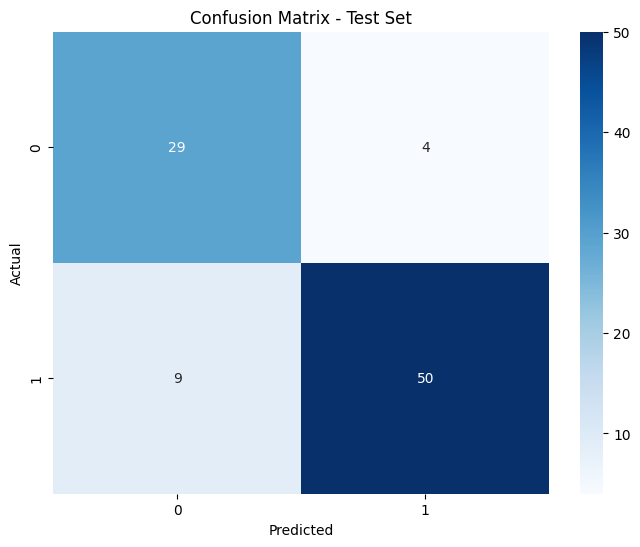

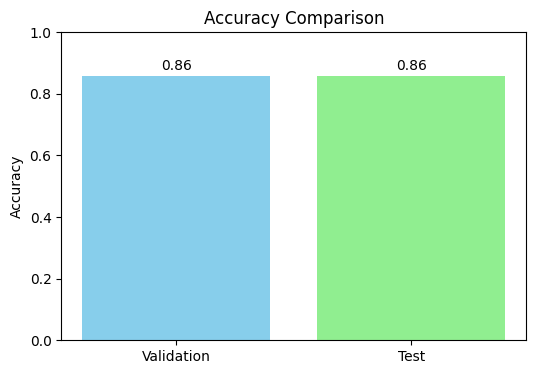

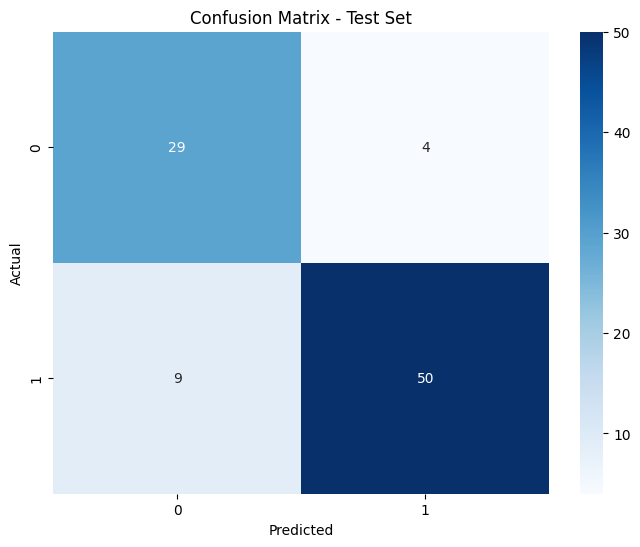

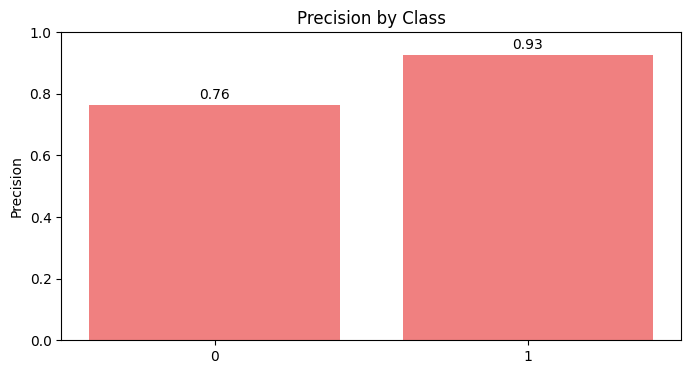

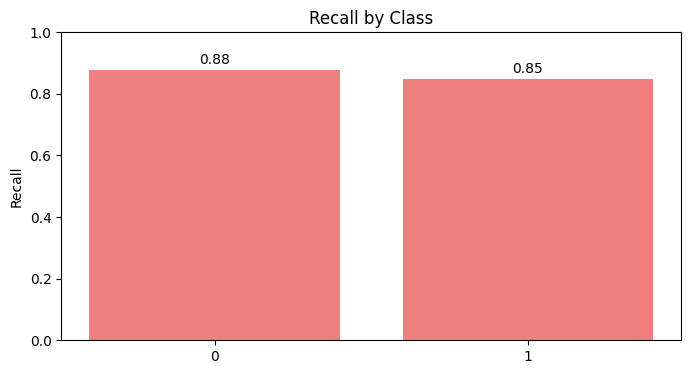

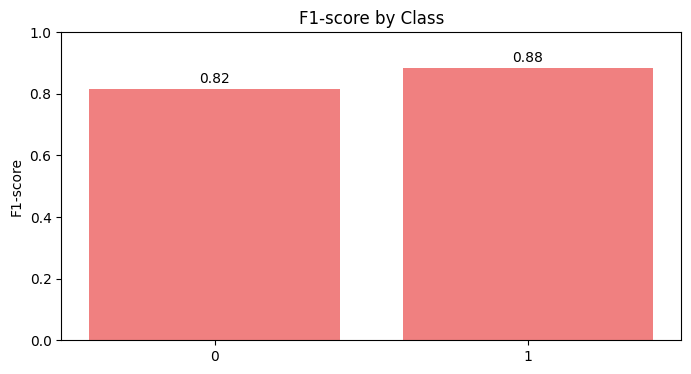

[I 2024-12-06 02:25:48,122] A new study created in memory with name: no-name-301b7d35-d0f0-44d5-831a-8adffeb28c5e
[I 2024-12-06 02:25:48,138] Trial 0 finished with value: 0.8442223837209302 and parameters: {'C': 7.606741056760669, 'gamma': 6.7613699223579955, 'kernel': 'linear'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,162] Trial 1 finished with value: 0.8395348837209301 and parameters: {'C': 0.7555993869632366, 'gamma': 3.048064909286908, 'kernel': 'linear'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,178] Trial 2 finished with value: 0.8442223837209302 and parameters: {'C': 5.999690170427481, 'gamma': 3.0611077072609163, 'kernel': 'linear'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,202] Trial 3 finished with value: 0.5358284883720931 and parameters: {'C': 2.862153874024769, 'gamma': 6.8059512206349515, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,22

Scenario dataset_scenario_1_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running SVM with optuna for dataset_scenario_2_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_2_N


[I 2024-12-06 02:25:48,340] Trial 9 finished with value: 0.6542514534883721 and parameters: {'C': 1.7070425524620227, 'gamma': 1.0178714433508886, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,898] Trial 10 finished with value: 0.7492005813953488 and parameters: {'C': 9.691173570340158, 'gamma': 9.444187113049875, 'kernel': 'poly'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,929] Trial 11 finished with value: 0.8442223837209302 and parameters: {'C': 7.056078694131934, 'gamma': 6.630996922499083, 'kernel': 'linear'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,959] Trial 12 finished with value: 0.8426598837209301 and parameters: {'C': 8.947237068558719, 'gamma': 8.384655794698421, 'kernel': 'linear'}. Best is trial 0 with value: 0.8442223837209302.
[I 2024-12-06 02:25:48,980] Trial 13 finished with value: 0.8442223837209302 and parameters: {'C': 4.702530089961295, 'gamma': 6.05131685682

Best hyperparameters:  {'C': 2.2296341143778666, 'gamma': 9.979401372423787, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8569
  Recall: 0.8533
  F1 Score: 0.8538

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


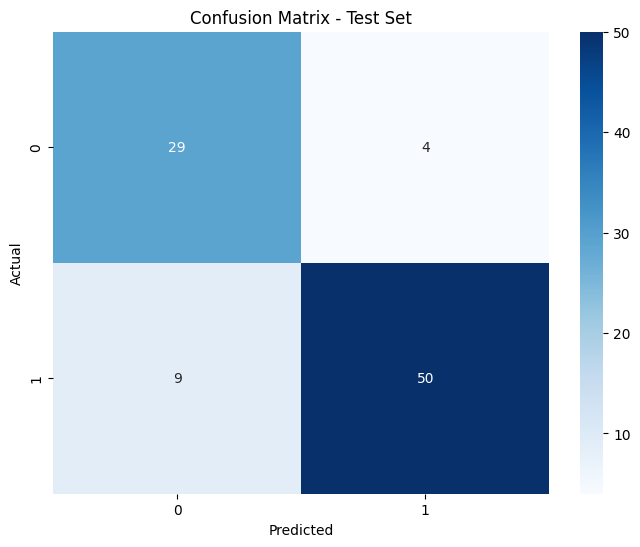

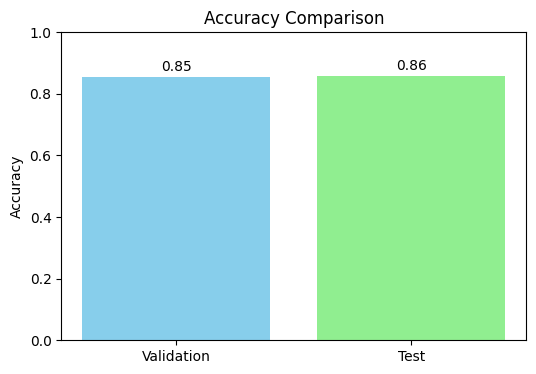

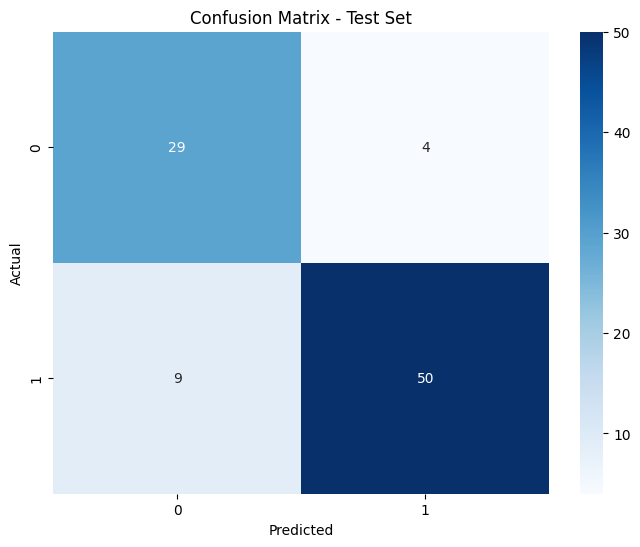

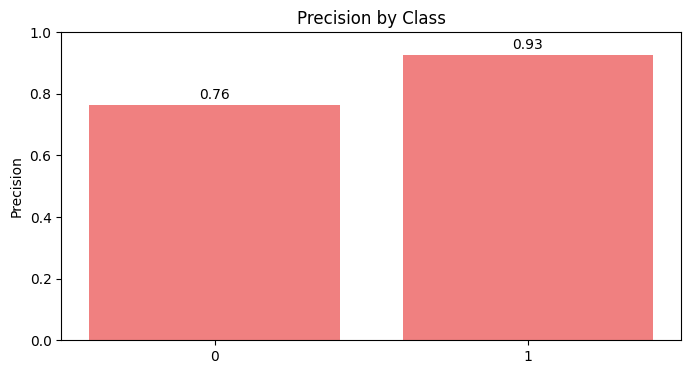

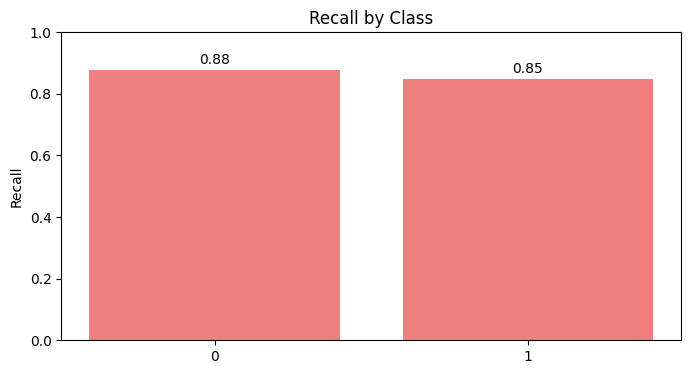

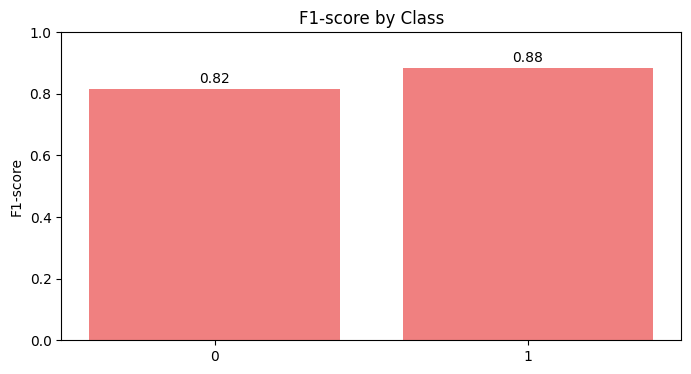

[I 2024-12-06 02:25:54,523] A new study created in memory with name: no-name-eac55e04-bb93-4663-8fa5-ab8d30b3acb5
[I 2024-12-06 02:25:54,549] Trial 0 finished with value: 0.5980983527131782 and parameters: {'C': 3.631150052447291, 'gamma': 5.283167067378661, 'kernel': 'rbf'}. Best is trial 0 with value: 0.5980983527131782.
[I 2024-12-06 02:25:54,575] Trial 1 finished with value: 0.7242853682170542 and parameters: {'C': 4.655970170918414, 'gamma': 2.331102488436427, 'kernel': 'sigmoid'}. Best is trial 1 with value: 0.7242853682170542.
[I 2024-12-06 02:25:54,600] Trial 2 finished with value: 0.7477713178294574 and parameters: {'C': 1.4832152170852688, 'gamma': 7.716540491990095, 'kernel': 'sigmoid'}. Best is trial 2 with value: 0.7477713178294574.
[I 2024-12-06 02:25:54,618] Trial 3 finished with value: 0.7227107558139535 and parameters: {'C': 9.671819520054047, 'gamma': 9.52188867503012, 'kernel': 'sigmoid'}. Best is trial 2 with value: 0.7477713178294574.
[I 2024-12-06 02:25:54,643] Tr

Scenario dataset_scenario_2_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running SVM with optuna for dataset_scenario_2_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_2_S


[I 2024-12-06 02:25:54,728] Trial 7 finished with value: 0.7383115310077519 and parameters: {'C': 7.698978286760951, 'gamma': 0.8538237243919067, 'kernel': 'sigmoid'}. Best is trial 5 with value: 0.8442102713178293.
[I 2024-12-06 02:25:54,754] Trial 8 finished with value: 0.7274467054263566 and parameters: {'C': 2.7976583092957625, 'gamma': 3.1647252695894057, 'kernel': 'sigmoid'}. Best is trial 5 with value: 0.8442102713178293.
[I 2024-12-06 02:25:54,779] Trial 9 finished with value: 0.7756782945736435 and parameters: {'C': 5.031295101604772, 'gamma': 6.876159618840225, 'kernel': 'poly'}. Best is trial 5 with value: 0.8442102713178293.
[I 2024-12-06 02:25:54,820] Trial 10 finished with value: 0.8442102713178293 and parameters: {'C': 6.470939180652019, 'gamma': 4.7196231372682185, 'kernel': 'linear'}. Best is trial 5 with value: 0.8442102713178293.
[I 2024-12-06 02:25:54,861] Trial 11 finished with value: 0.8442102713178293 and parameters: {'C': 6.530645268498214, 'gamma': 4.6013590718

Best hyperparameters:  {'C': 0.1652005200600666, 'gamma': 5.848357210990585, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8569
  Recall: 0.8533
  F1 Score: 0.8538

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


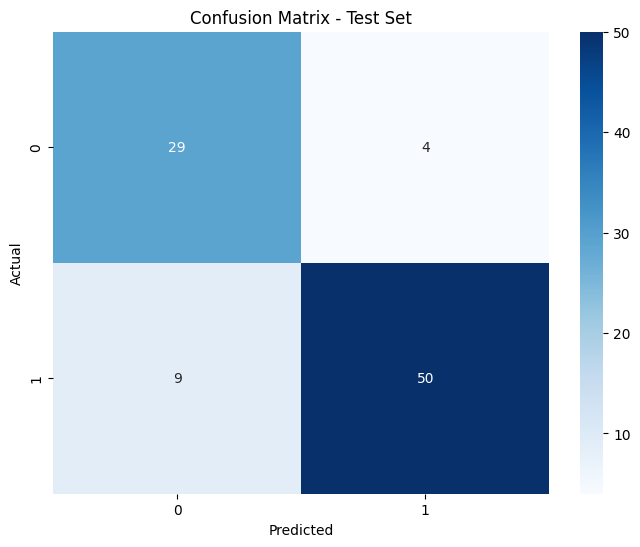

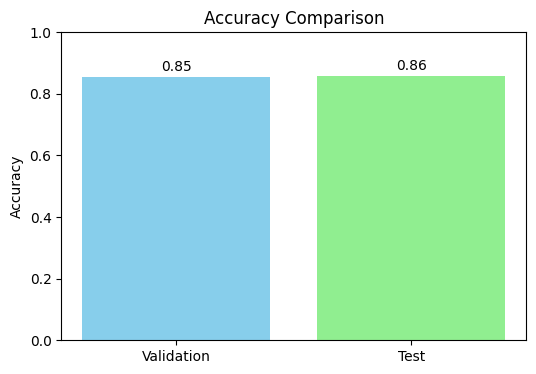

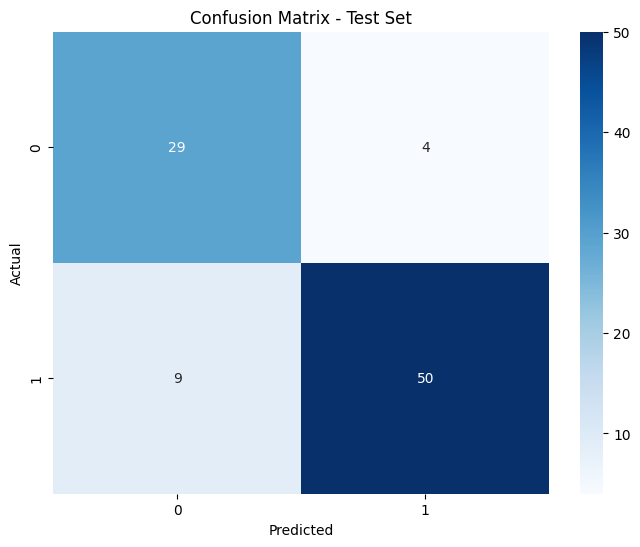

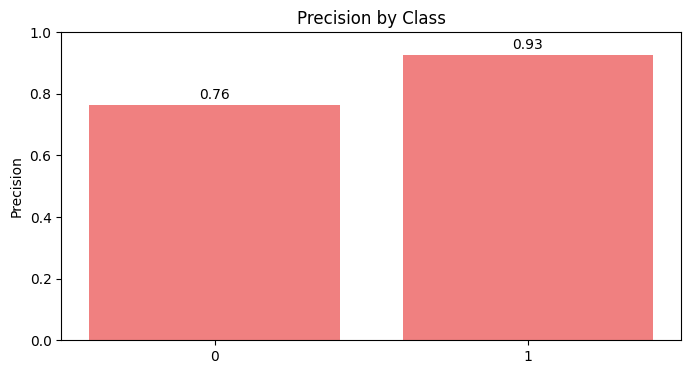

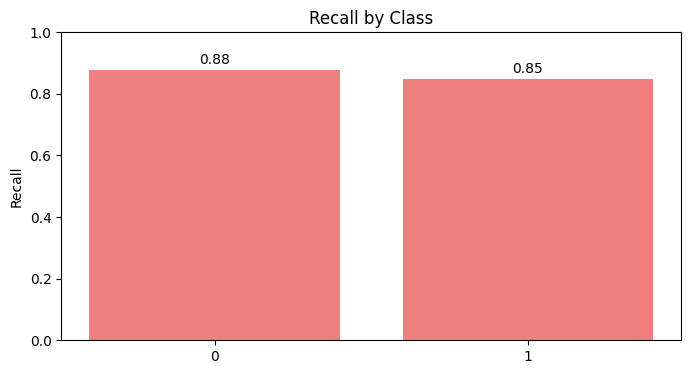

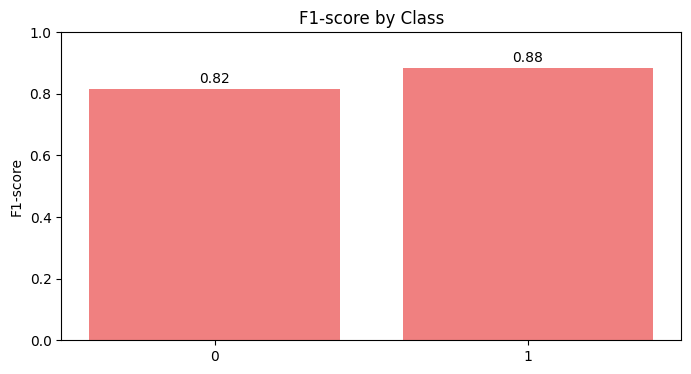

[I 2024-12-06 02:25:58,357] A new study created in memory with name: no-name-234af33e-9b5f-41b9-abbb-16b22202a1c7
[I 2024-12-06 02:25:58,382] Trial 0 finished with value: 0.7963306534735105 and parameters: {'C': 6.82914230786006, 'gamma': 3.503909044826534, 'kernel': 'rbf'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,398] Trial 1 finished with value: 0.5295403009688725 and parameters: {'C': 7.350851575249453, 'gamma': 9.124407835537273, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,423] Trial 2 finished with value: 0.6212327355184498 and parameters: {'C': 0.9747443632579511, 'gamma': 1.395354469976338, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,490] Trial 3 finished with value: 0.7698206555349412 and parameters: {'C': 3.011809456767158, 'gamma': 4.174417261537582, 'kernel': 'poly'}. Best is trial 0 with value: 0.7963306534735105.


Scenario dataset_scenario_2_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with optuna for dataset_scenario_3_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_3_N


[I 2024-12-06 02:25:58,620] Trial 4 finished with value: 0.7453308596165739 and parameters: {'C': 8.26849450365225, 'gamma': 5.959956641406605, 'kernel': 'poly'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,646] Trial 5 finished with value: 0.5479076479076479 and parameters: {'C': 1.9237259800990334, 'gamma': 2.248279443059421, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,788] Trial 6 finished with value: 0.7535147392290249 and parameters: {'C': 3.8202863590438154, 'gamma': 6.795895201286811, 'kernel': 'poly'}. Best is trial 0 with value: 0.7963306534735105.
[I 2024-12-06 02:25:58,812] Trial 7 finished with value: 0.808534322820037 and parameters: {'C': 2.004574119516017, 'gamma': 1.2100860867195078, 'kernel': 'poly'}. Best is trial 7 with value: 0.808534322820037.
[I 2024-12-06 02:25:58,837] Trial 8 finished with value: 0.7800041228612657 and parameters: {'C': 4.962777611589863, 'gamma': 5.9870811940097175, 'ke

Best hyperparameters:  {'C': 0.6508266160759435, 'gamma': 8.140347893540822, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8571
  Precision: 0.8571
  Recall: 0.8571
  F1 Score: 0.8571

Test Metrics:
  Accuracy: 0.7887
  Precision: 0.8053
  Recall: 0.7887
  F1 Score: 0.7893

Confusion Matrix (Test Set):
[[29 11]
 [ 4 27]]


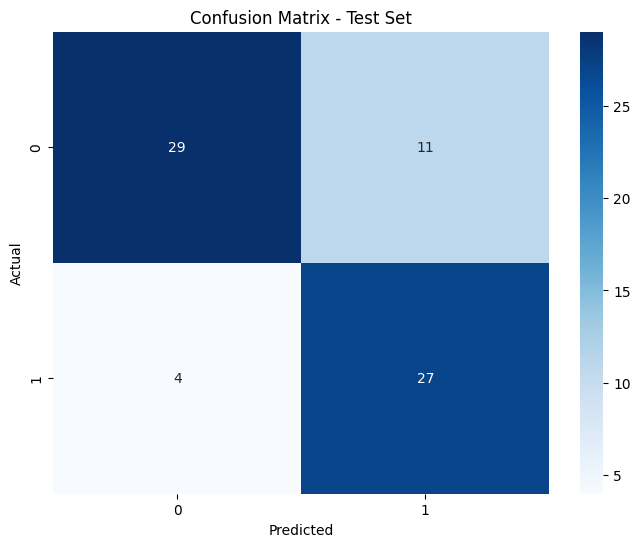

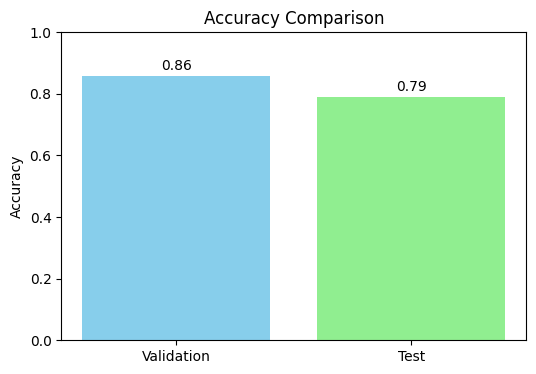

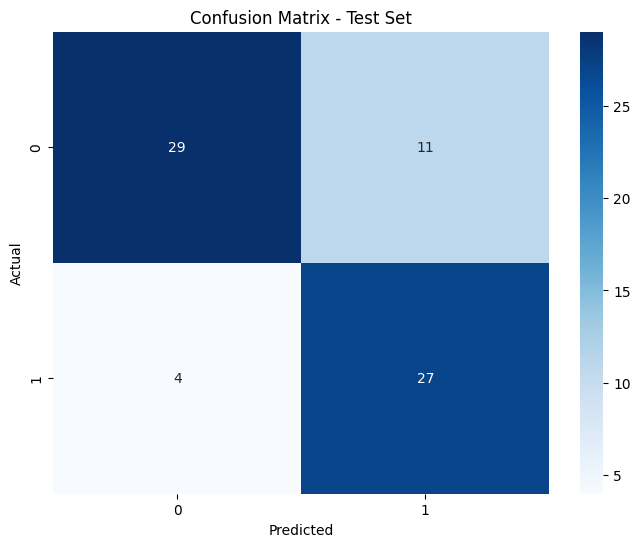

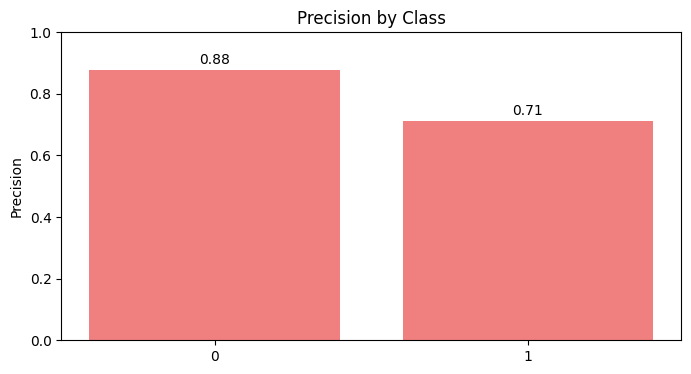

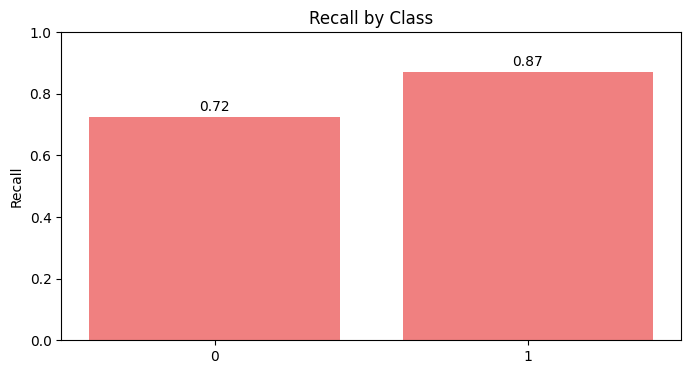

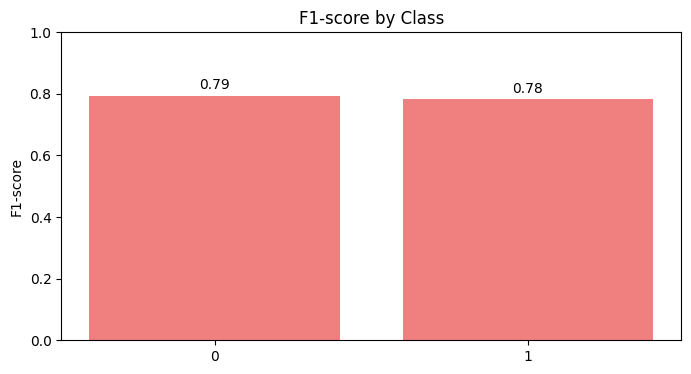

[I 2024-12-06 02:26:02,357] A new study created in memory with name: no-name-ee284558-7809-487c-b42b-0c66385414e4
[I 2024-12-06 02:26:02,371] Trial 0 finished with value: 0.7515563801278087 and parameters: {'C': 6.572743054150528, 'gamma': 2.0974114050246415, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7515563801278087.
[I 2024-12-06 02:26:02,397] Trial 1 finished with value: 0.5417645846217275 and parameters: {'C': 3.7953473070993624, 'gamma': 8.901213264228863, 'kernel': 'rbf'}. Best is trial 0 with value: 0.7515563801278087.
[I 2024-12-06 02:26:02,422] Trial 2 finished with value: 0.5580705009276438 and parameters: {'C': 2.6198488544940934, 'gamma': 5.268931890176284, 'kernel': 'rbf'}. Best is trial 0 with value: 0.7515563801278087.
[I 2024-12-06 02:26:02,437] Trial 3 finished with value: 0.7412492269635127 and parameters: {'C': 7.494553360723074, 'gamma': 9.774920851756645, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7515563801278087.
[I 2024-12-06 02:26:02,462] Tri

Scenario dataset_scenario_3_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_3_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_3_S


[I 2024-12-06 02:26:02,566] Trial 9 finished with value: 0.8431869717584004 and parameters: {'C': 4.405155228995411, 'gamma': 5.910569843493458, 'kernel': 'linear'}. Best is trial 9 with value: 0.8431869717584004.
[I 2024-12-06 02:26:02,585] Trial 10 finished with value: 0.8513296227581941 and parameters: {'C': 0.007112332547315248, 'gamma': 3.170695937029521, 'kernel': 'linear'}. Best is trial 10 with value: 0.8513296227581941.
[I 2024-12-06 02:26:02,605] Trial 11 finished with value: 0.8452277880849308 and parameters: {'C': 0.24866495589870208, 'gamma': 3.382117659673283, 'kernel': 'linear'}. Best is trial 10 with value: 0.8513296227581941.
[I 2024-12-06 02:26:02,627] Trial 12 finished with value: 0.8452277880849308 and parameters: {'C': 0.18434451014668504, 'gamma': 2.960525437880389, 'kernel': 'linear'}. Best is trial 10 with value: 0.8513296227581941.
[I 2024-12-06 02:26:02,648] Trial 13 finished with value: 0.8431869717584004 and parameters: {'C': 0.6505306615117912, 'gamma': 3.7

Best hyperparameters:  {'C': 0.0878858303444202, 'gamma': 2.3225928452179527, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8571
  Precision: 0.8571
  Recall: 0.8571
  F1 Score: 0.8571

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8240
  Recall: 0.8028
  F1 Score: 0.8031

Confusion Matrix (Test Set):
[[29 11]
 [ 3 28]]


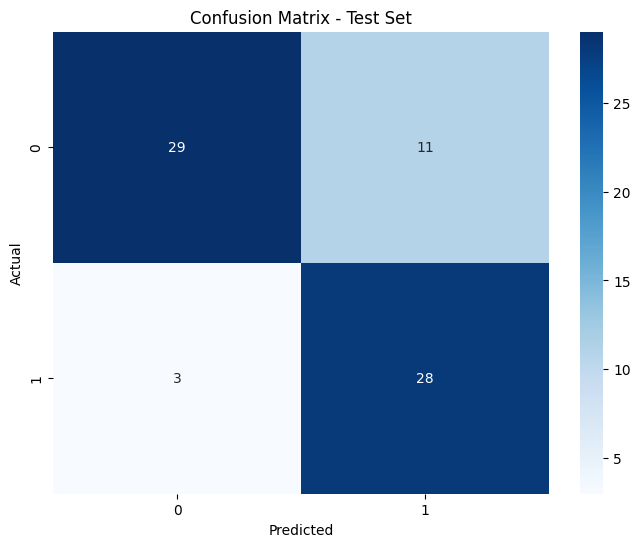

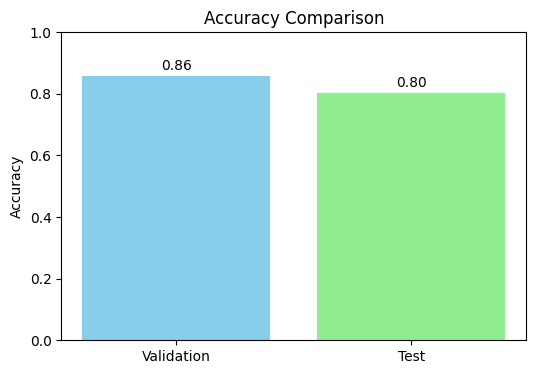

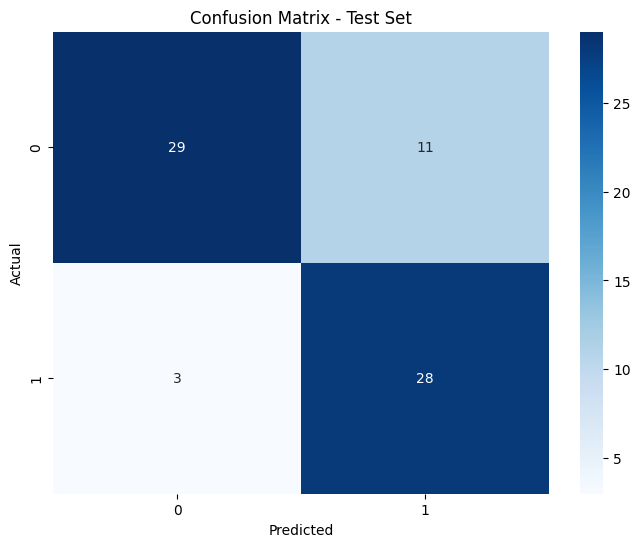

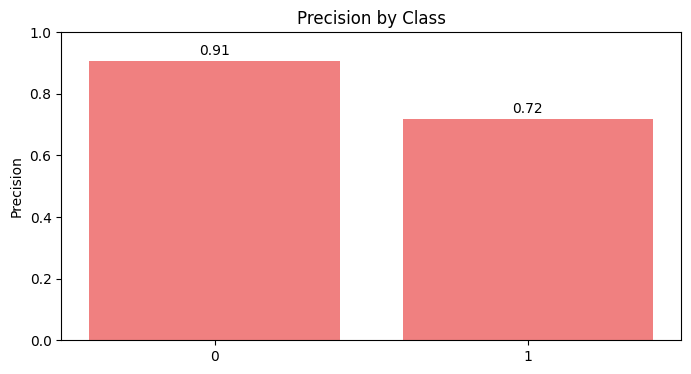

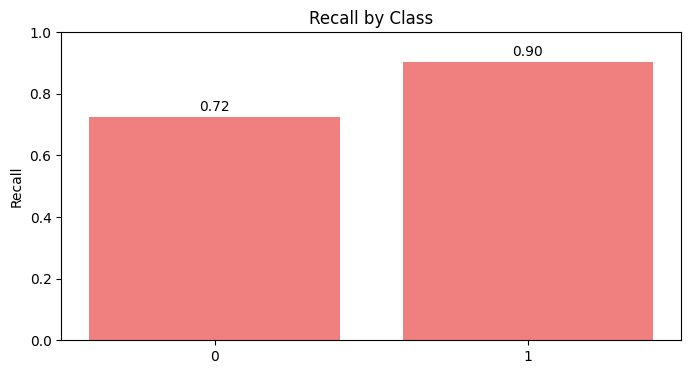

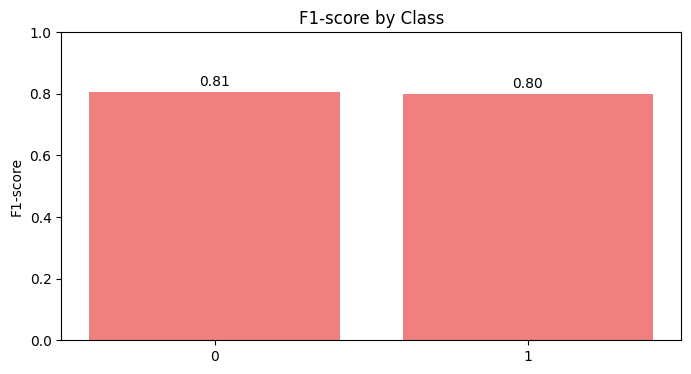

[I 2024-12-06 02:26:05,637] A new study created in memory with name: no-name-eabb77d7-faa3-4a80-9143-d5a5f076a601
[I 2024-12-06 02:26:05,652] Trial 0 finished with value: 0.8426598837209301 and parameters: {'C': 4.425149791993201, 'gamma': 6.121693456726688, 'kernel': 'linear'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:05,667] Trial 1 finished with value: 0.8426598837209301 and parameters: {'C': 2.7173644505001926, 'gamma': 6.785885075118342, 'kernel': 'linear'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:05,691] Trial 2 finished with value: 0.803657945736434 and parameters: {'C': 8.979577129726886, 'gamma': 8.465933729294916, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:05,716] Trial 3 finished with value: 0.8426598837209301 and parameters: {'C': 7.489384948544077, 'gamma': 0.6077788342519974, 'kernel': 'linear'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:05,741] Tria

Scenario dataset_scenario_3_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with optuna for dataset_scenario_4_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_4_N


[I 2024-12-06 02:26:06,393] Trial 8 finished with value: 0.7554021317829458 and parameters: {'C': 2.5899325297075286, 'gamma': 9.801317390768329, 'kernel': 'poly'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:06,419] Trial 9 finished with value: 0.5358284883720931 and parameters: {'C': 8.856784775947691, 'gamma': 5.881108384337018, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:06,451] Trial 10 finished with value: 0.8067950581395349 and parameters: {'C': 5.9798458569551345, 'gamma': 4.483474194122808, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:06,472] Trial 11 finished with value: 0.8426598837209301 and parameters: {'C': 3.2032111194357245, 'gamma': 6.074759856000302, 'kernel': 'linear'}. Best is trial 0 with value: 0.8426598837209301.
[I 2024-12-06 02:26:06,502] Trial 12 finished with value: 0.8426598837209301 and parameters: {'C': 2.865553690039964, 'gamma': 7.09319609868837

Best hyperparameters:  {'C': 0.14893788996745938, 'gamma': 9.350935573043268, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8677
  Recall: 0.8641
  F1 Score: 0.8647

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


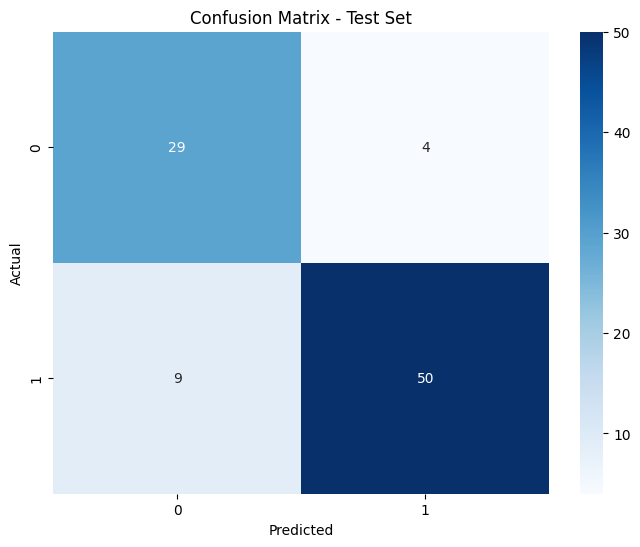

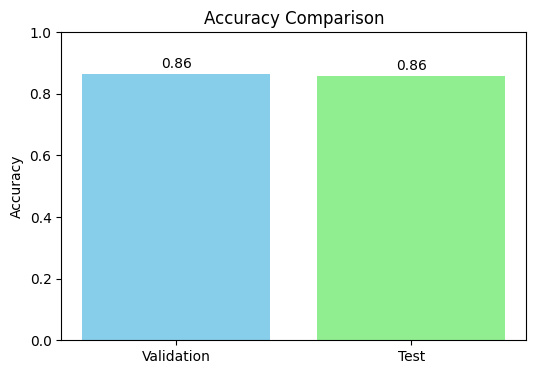

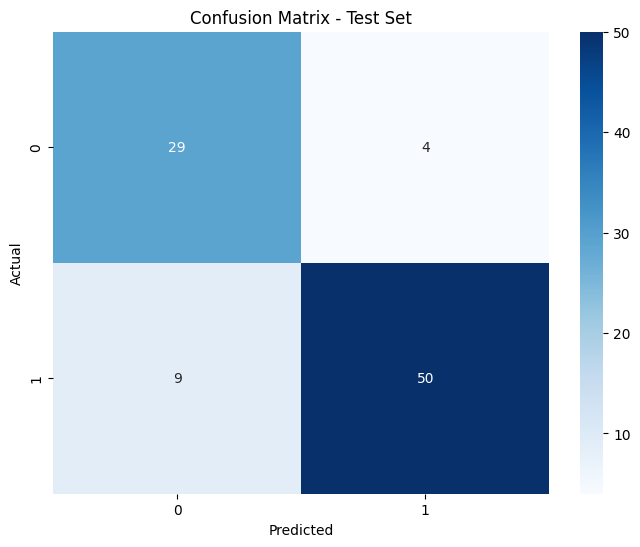

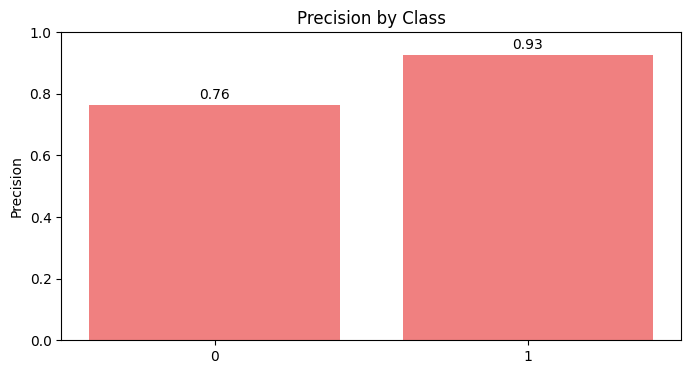

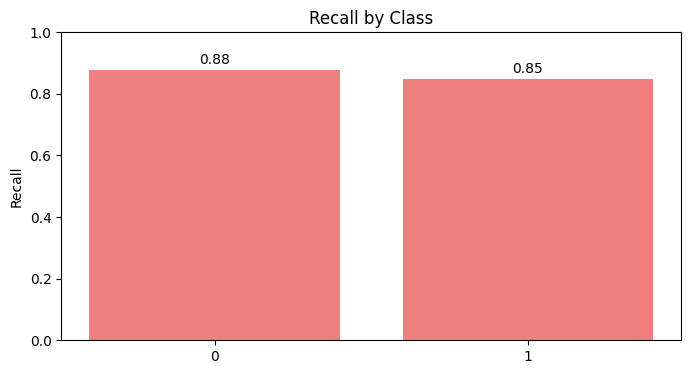

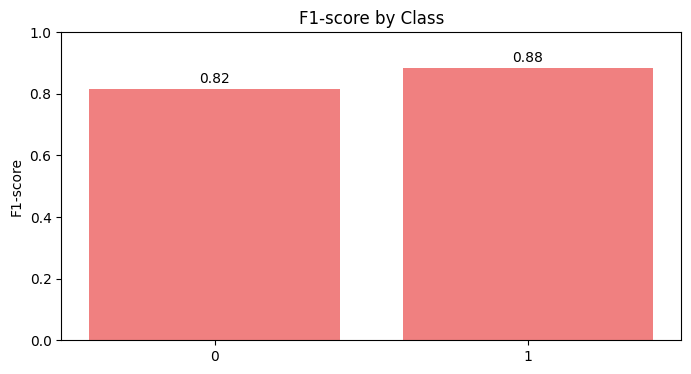

[I 2024-12-06 02:26:12,666] A new study created in memory with name: no-name-a50008f8-aabe-4adc-8b58-3ea6518fcafc
[I 2024-12-06 02:26:12,691] Trial 0 finished with value: 0.7274103682170543 and parameters: {'C': 4.0581392668214, 'gamma': 4.652883185683708, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7274103682170543.
[I 2024-12-06 02:26:12,715] Trial 1 finished with value: 0.7024345930232558 and parameters: {'C': 2.611544037130168, 'gamma': 1.5209754444848003, 'kernel': 'rbf'}. Best is trial 0 with value: 0.7274103682170543.
[I 2024-12-06 02:26:12,740] Trial 2 finished with value: 0.7413880813953488 and parameters: {'C': 1.0674116166730718, 'gamma': 1.5865696471419901, 'kernel': 'sigmoid'}. Best is trial 2 with value: 0.7413880813953488.
[I 2024-12-06 02:26:12,765] Trial 3 finished with value: 0.5592054263565892 and parameters: {'C': 1.547872552793133, 'gamma': 8.509941938231423, 'kernel': 'rbf'}. Best is trial 2 with value: 0.7413880813953488.
[I 2024-12-06 02:26:12,790] Trial

Scenario dataset_scenario_4_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_4_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_4_S


[I 2024-12-06 02:26:12,876] Trial 7 finished with value: 0.7320857558139535 and parameters: {'C': 8.5000448563067, 'gamma': 6.515563509897269, 'kernel': 'sigmoid'}. Best is trial 5 with value: 0.8442223837209302.
[I 2024-12-06 02:26:12,912] Trial 8 finished with value: 0.8457727713178294 and parameters: {'C': 5.408234057819461, 'gamma': 2.0474242758915957, 'kernel': 'linear'}. Best is trial 8 with value: 0.8457727713178294.
[I 2024-12-06 02:26:12,937] Trial 9 finished with value: 0.7460150193798449 and parameters: {'C': 2.5215136602322206, 'gamma': 7.3318782503031255, 'kernel': 'poly'}. Best is trial 8 with value: 0.8457727713178294.
[I 2024-12-06 02:26:12,979] Trial 10 finished with value: 0.8457727713178294 and parameters: {'C': 6.550083060089965, 'gamma': 0.367686974510816, 'kernel': 'linear'}. Best is trial 8 with value: 0.8457727713178294.
[I 2024-12-06 02:26:13,021] Trial 11 finished with value: 0.8457727713178294 and parameters: {'C': 6.238228627906405, 'gamma': 0.00520621325032

Best hyperparameters:  {'C': 5.408234057819461, 'gamma': 2.0474242758915957, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8569
  Recall: 0.8533
  F1 Score: 0.8538

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8596
  Recall: 0.8478
  F1 Score: 0.8501

Confusion Matrix (Test Set):
[[29  4]
 [10 49]]


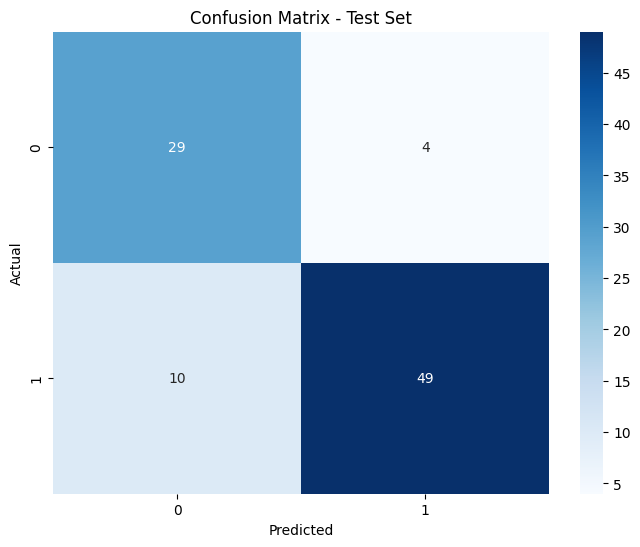

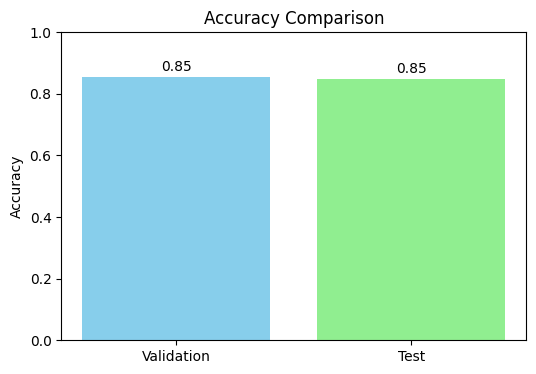

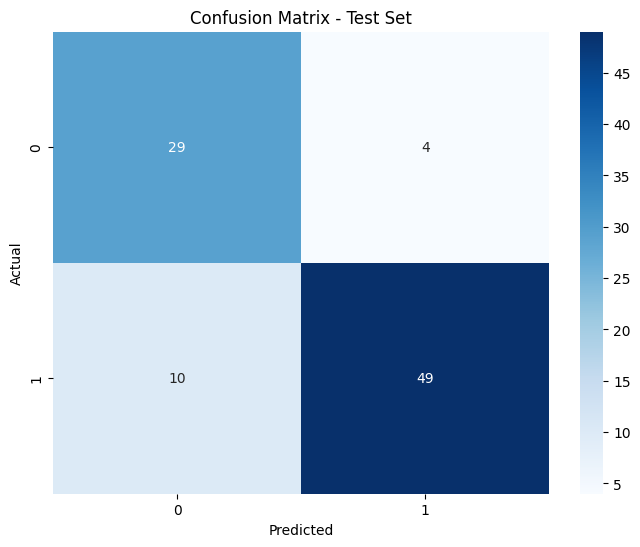

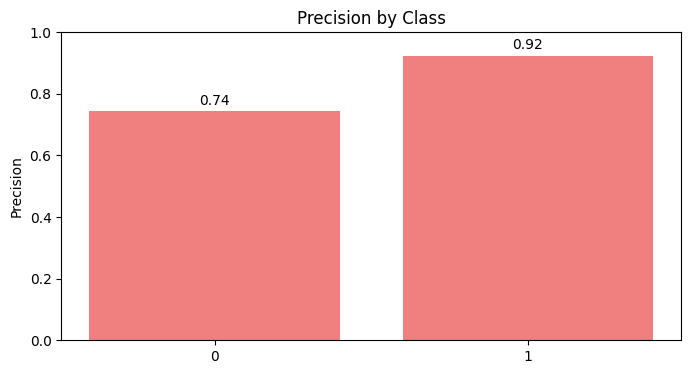

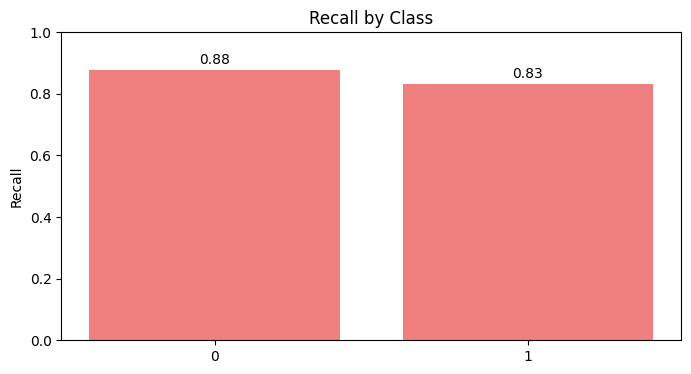

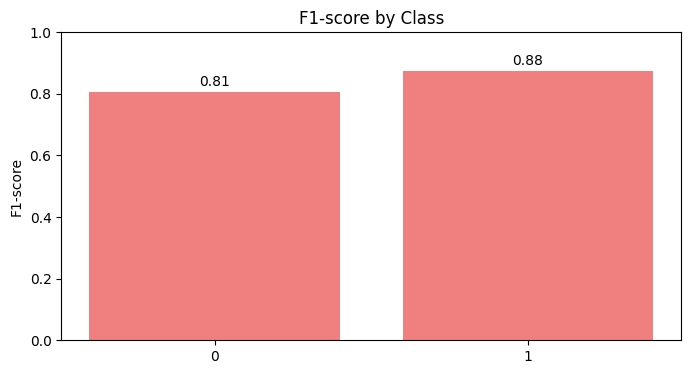

[I 2024-12-06 02:26:17,309] A new study created in memory with name: no-name-cf3c6602-7e52-4a58-8b59-86cbf7c19e6e
[I 2024-12-06 02:26:17,396] Trial 0 finished with value: 0.8020954457364342 and parameters: {'C': 5.934727222024969, 'gamma': 6.575129303044867, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8020954457364342.
[I 2024-12-06 02:26:17,423] Trial 1 finished with value: 0.7990067829457365 and parameters: {'C': 4.058523009432058, 'gamma': 5.630521792366838, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8020954457364342.
[I 2024-12-06 02:26:17,448] Trial 2 finished with value: 0.5358284883720931 and parameters: {'C': 7.823285208482386, 'gamma': 9.950817980035252, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8020954457364342.
[I 2024-12-06 02:26:17,474] Trial 3 finished with value: 0.8379844961240309 and parameters: {'C': 3.6511069951605086, 'gamma': 4.448105342520752, 'kernel': 'linear'}. Best is trial 3 with value: 0.8379844961240309.


Scenario dataset_scenario_4_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with optuna for dataset_scenario_5_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_5_N


[I 2024-12-06 02:26:17,739] Trial 4 finished with value: 0.7788154069767442 and parameters: {'C': 8.175567376768035, 'gamma': 7.920895586307842, 'kernel': 'poly'}. Best is trial 3 with value: 0.8379844961240309.
[I 2024-12-06 02:26:17,764] Trial 5 finished with value: 0.7943071705426357 and parameters: {'C': 4.549303455152044, 'gamma': 9.706658382704383, 'kernel': 'rbf'}. Best is trial 3 with value: 0.8379844961240309.
[I 2024-12-06 02:26:17,894] Trial 6 finished with value: 0.7740794573643411 and parameters: {'C': 0.2015315465266838, 'gamma': 7.861134058639374, 'kernel': 'poly'}. Best is trial 3 with value: 0.8379844961240309.
[I 2024-12-06 02:26:17,919] Trial 7 finished with value: 0.5358284883720931 and parameters: {'C': 3.9513759549688077, 'gamma': 5.0143061062427625, 'kernel': 'sigmoid'}. Best is trial 3 with value: 0.8379844961240309.
[I 2024-12-06 02:26:18,208] Trial 8 finished with value: 0.7788154069767442 and parameters: {'C': 5.90671663039537, 'gamma': 7.8876382644355765, 'k

Best hyperparameters:  {'C': 2.5783196451639228, 'gamma': 3.395933522193033, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


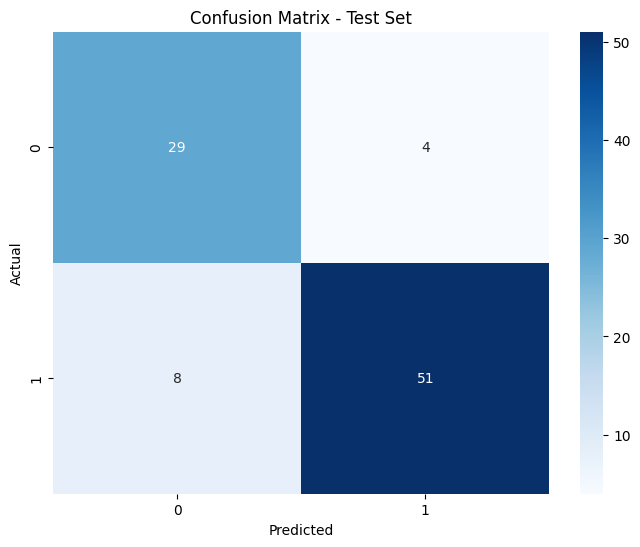

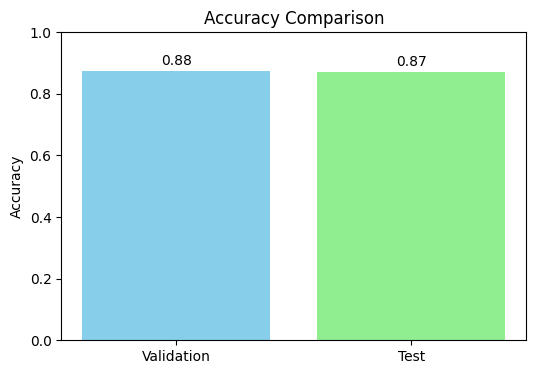

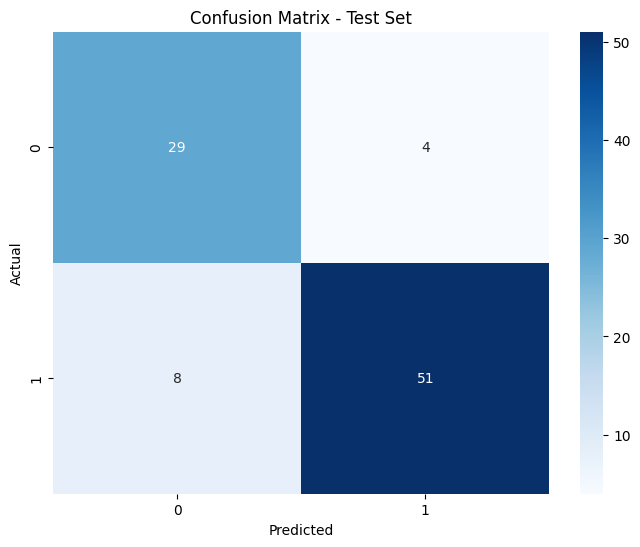

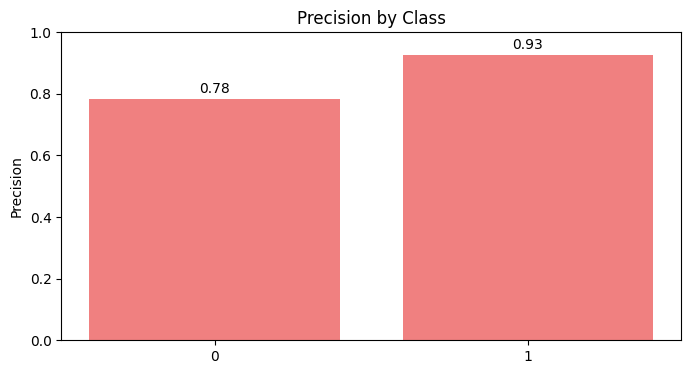

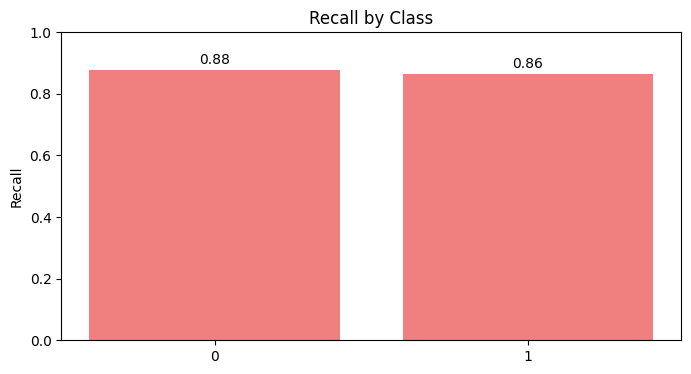

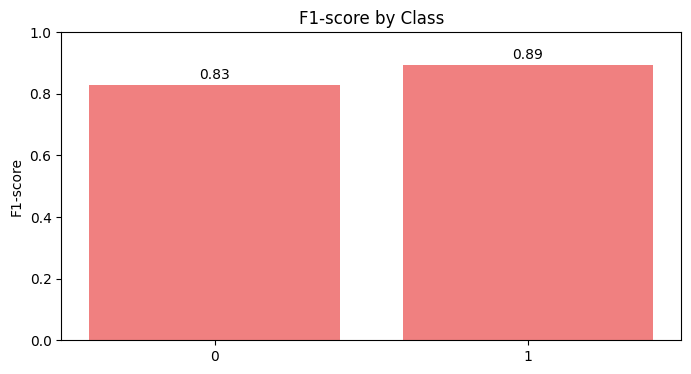

[I 2024-12-06 02:26:22,400] A new study created in memory with name: no-name-b6b8cf69-4e0f-41b5-994c-6b8656e30889
[I 2024-12-06 02:26:22,426] Trial 0 finished with value: 0.8364341085271316 and parameters: {'C': 1.926762813243889, 'gamma': 0.15464561650534692, 'kernel': 'linear'}. Best is trial 0 with value: 0.8364341085271316.
[I 2024-12-06 02:26:22,451] Trial 1 finished with value: 0.7336603682170543 and parameters: {'C': 7.4015654758980025, 'gamma': 2.099366716195883, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8364341085271316.
[I 2024-12-06 02:26:22,476] Trial 2 finished with value: 0.8364341085271316 and parameters: {'C': 1.5187304774676353, 'gamma': 2.484748926564674, 'kernel': 'linear'}. Best is trial 0 with value: 0.8364341085271316.
[I 2024-12-06 02:26:22,501] Trial 3 finished with value: 0.7647286821705427 and parameters: {'C': 3.234036087182427, 'gamma': 2.2265954666836705, 'kernel': 'poly'}. Best is trial 0 with value: 0.8364341085271316.
[I 2024-12-06 02:26:22,526

Scenario dataset_scenario_5_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_5_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_5_S


[I 2024-12-06 02:26:22,635] Trial 8 finished with value: 0.7647286821705427 and parameters: {'C': 8.672769964696784, 'gamma': 1.9402165107127822, 'kernel': 'poly'}. Best is trial 5 with value: 0.8379723837209301.
[I 2024-12-06 02:26:22,755] Trial 9 finished with value: 0.6836845930232558 and parameters: {'C': 6.701651018791858, 'gamma': 2.2232699877269213, 'kernel': 'rbf'}. Best is trial 5 with value: 0.8379723837209301.
[I 2024-12-06 02:26:22,797] Trial 10 finished with value: 0.6167272286821706 and parameters: {'C': 4.3006707413489815, 'gamma': 5.375838695756273, 'kernel': 'rbf'}. Best is trial 5 with value: 0.8379723837209301.
[I 2024-12-06 02:26:22,837] Trial 11 finished with value: 0.8364341085271316 and parameters: {'C': 3.3801051449310697, 'gamma': 0.019358090436122077, 'kernel': 'linear'}. Best is trial 5 with value: 0.8379723837209301.
[I 2024-12-06 02:26:22,878] Trial 12 finished with value: 0.8364341085271316 and parameters: {'C': 2.85894618180919, 'gamma': 0.050427960122645

Best hyperparameters:  {'C': 6.9406061289338465, 'gamma': 0.011334836073970461, 'kernel': 'rbf'}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8603
  Recall: 0.8587
  F1 Score: 0.8591

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


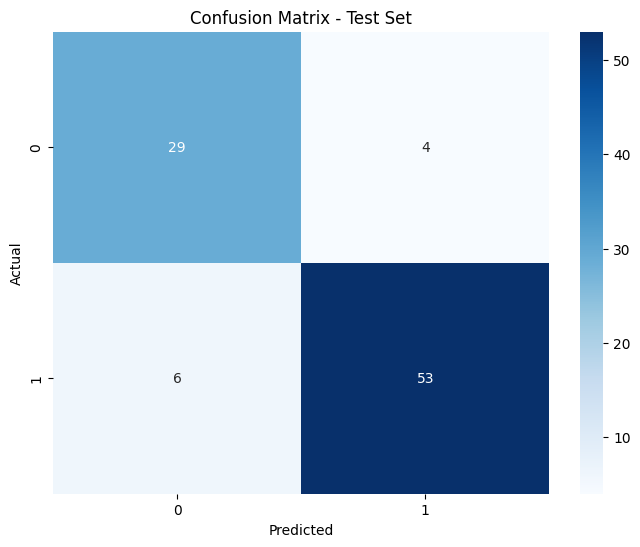

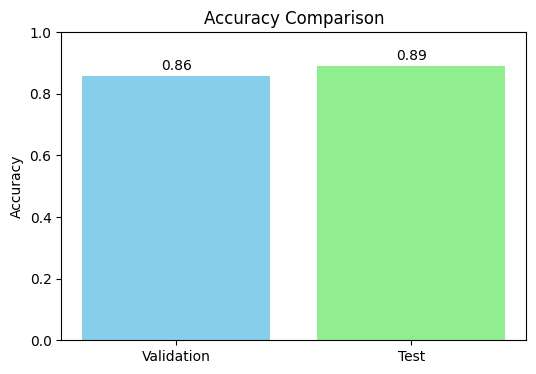

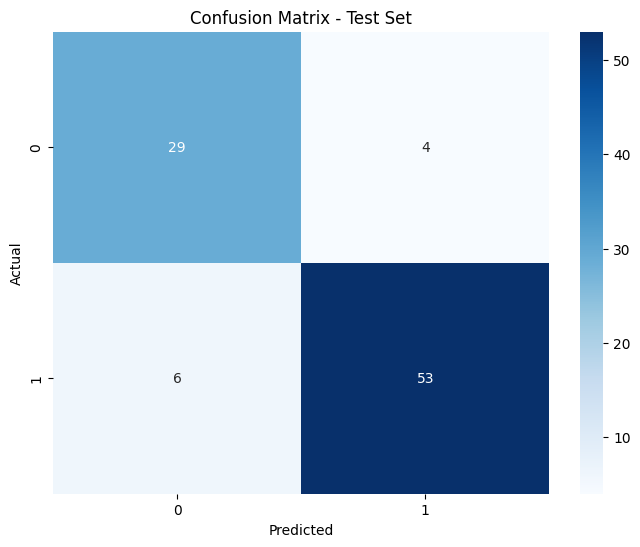

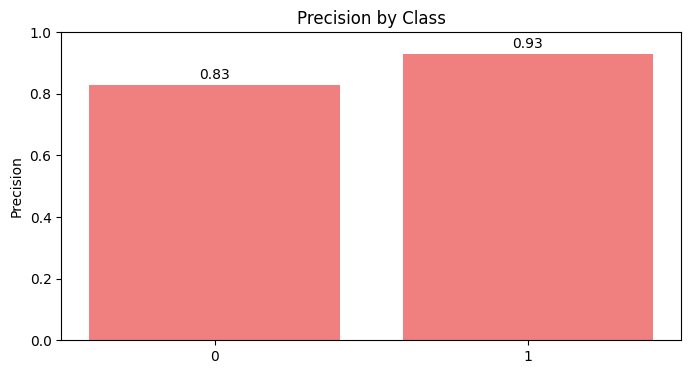

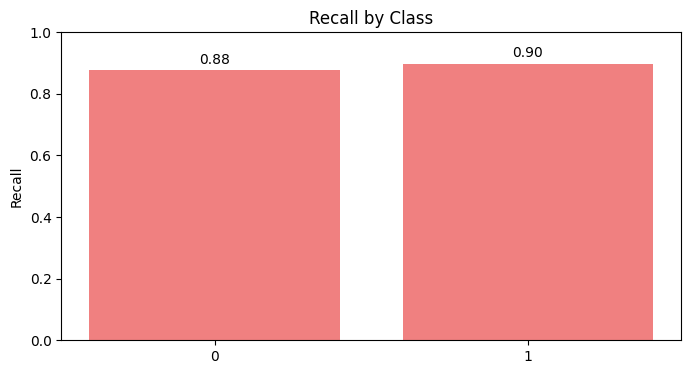

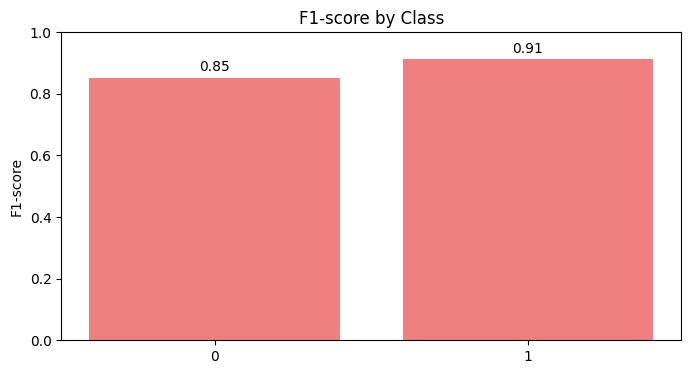

[I 2024-12-06 02:26:27,276] A new study created in memory with name: no-name-b01b7ff7-84c7-48d2-a68d-aacdbcfdf90d
[I 2024-12-06 02:26:27,353] Trial 0 finished with value: 0.8052567829457364 and parameters: {'C': 9.007847225576574, 'gamma': 2.713775367494692, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8052567829457364.
[I 2024-12-06 02:26:27,378] Trial 1 finished with value: 0.5373909883720931 and parameters: {'C': 8.312447517196967, 'gamma': 3.5542060037214678, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8052567829457364.
[I 2024-12-06 02:26:27,403] Trial 2 finished with value: 0.5901526162790698 and parameters: {'C': 2.965992826185225, 'gamma': 1.4342032868964585, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8052567829457364.
[I 2024-12-06 02:26:27,439] Trial 3 finished with value: 0.8020954457364342 and parameters: {'C': 6.0183860272399485, 'gamma': 4.894170112522578, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8052567829457364.
[I 2024-12-06 02:26:27,464] Tri

Scenario dataset_scenario_5_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with optuna for dataset_scenario_6_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_6_N


[I 2024-12-06 02:26:27,491] Trial 5 finished with value: 0.795906007751938 and parameters: {'C': 4.936777916391381, 'gamma': 7.608288862049238, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8052567829457364.
[I 2024-12-06 02:26:27,505] Trial 6 finished with value: 0.8426235465116279 and parameters: {'C': 1.3485468098847313, 'gamma': 1.8614433951706124, 'kernel': 'linear'}. Best is trial 6 with value: 0.8426235465116279.
[I 2024-12-06 02:26:27,761] Trial 7 finished with value: 0.7507146317829457 and parameters: {'C': 4.546195806729207, 'gamma': 4.849633965806152, 'kernel': 'poly'}. Best is trial 6 with value: 0.8426235465116279.
[I 2024-12-06 02:26:27,797] Trial 8 finished with value: 0.7943071705426357 and parameters: {'C': 0.4818166704016484, 'gamma': 7.738452106966633, 'kernel': 'rbf'}. Best is trial 6 with value: 0.8426235465116279.
[I 2024-12-06 02:26:27,822] Trial 9 finished with value: 0.8395348837209301 and parameters: {'C': 0.8739399791870204, 'gamma': 0.3269770451893654, 'ke

Best hyperparameters:  {'C': 8.68113737681005, 'gamma': 9.730933309149604, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


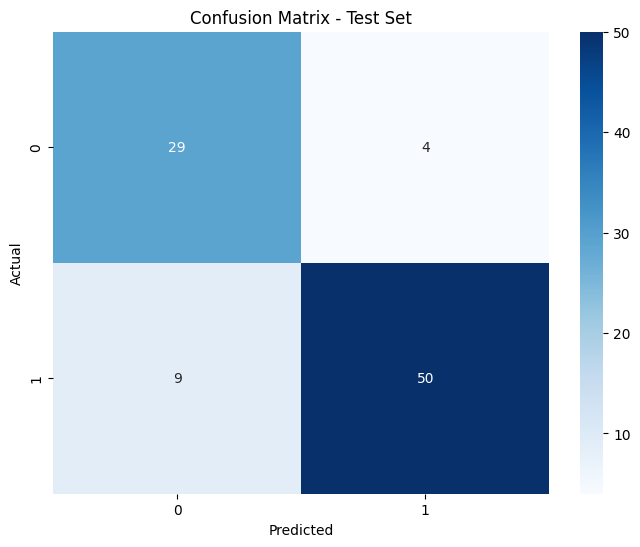

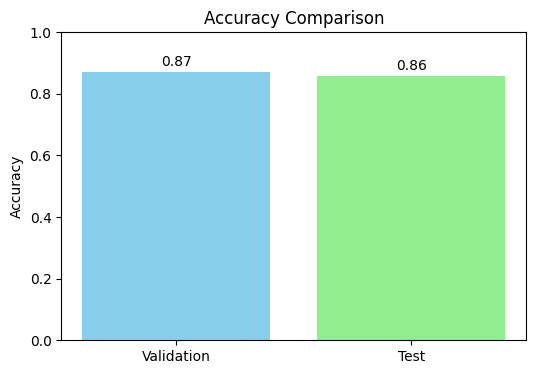

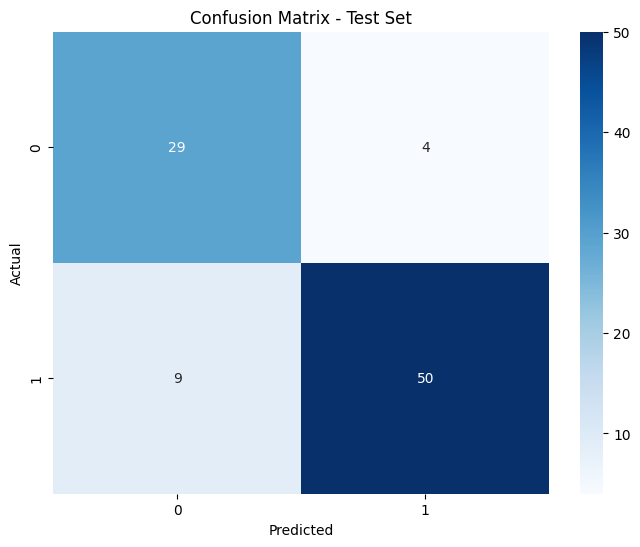

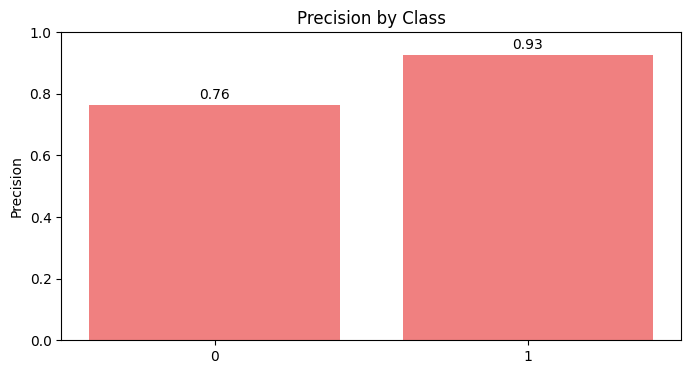

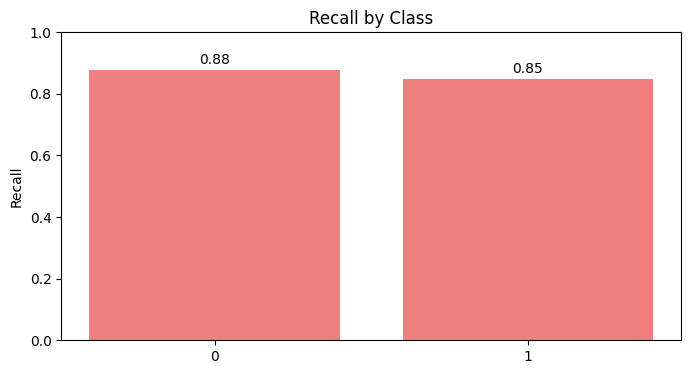

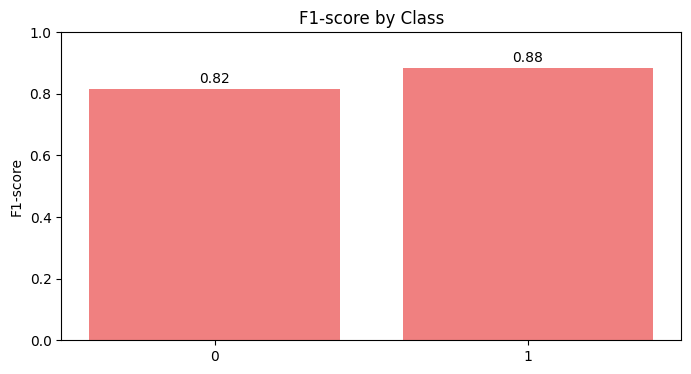

[I 2024-12-06 02:26:32,689] A new study created in memory with name: no-name-b919d26c-7470-4eb2-a6fc-6b8bd19d800e
[I 2024-12-06 02:26:32,714] Trial 0 finished with value: 0.7553657945736434 and parameters: {'C': 5.681480817021665, 'gamma': 9.016092579607639, 'kernel': 'poly'}. Best is trial 0 with value: 0.7553657945736434.
[I 2024-12-06 02:26:32,739] Trial 1 finished with value: 0.5996608527131783 and parameters: {'C': 7.696489593331563, 'gamma': 5.104861868005001, 'kernel': 'rbf'}. Best is trial 0 with value: 0.7553657945736434.
[I 2024-12-06 02:26:32,765] Trial 2 finished with value: 0.7335876937984496 and parameters: {'C': 8.138561808846974, 'gamma': 7.150861281583243, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7553657945736434.
[I 2024-12-06 02:26:32,789] Trial 3 finished with value: 0.7553657945736434 and parameters: {'C': 0.7520040759325894, 'gamma': 8.72001921259326, 'kernel': 'poly'}. Best is trial 0 with value: 0.7553657945736434.
[I 2024-12-06 02:26:32,814] Trial 4 

Scenario dataset_scenario_6_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_6_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_6_S


[I 2024-12-06 02:26:32,890] Trial 7 finished with value: 0.7507267441860466 and parameters: {'C': 7.178330347159388, 'gamma': 9.951609641330016, 'kernel': 'sigmoid'}. Best is trial 6 with value: 0.8426356589147286.
[I 2024-12-06 02:26:32,926] Trial 8 finished with value: 0.8426356589147286 and parameters: {'C': 6.798353873037083, 'gamma': 9.391643600841943, 'kernel': 'linear'}. Best is trial 6 with value: 0.8426356589147286.
[I 2024-12-06 02:26:32,961] Trial 9 finished with value: 0.8426356589147286 and parameters: {'C': 7.713438909245839, 'gamma': 4.0352117559666905, 'kernel': 'linear'}. Best is trial 6 with value: 0.8426356589147286.
[I 2024-12-06 02:26:32,992] Trial 10 finished with value: 0.8426356589147286 and parameters: {'C': 2.1768897021499627, 'gamma': 0.38355209979151805, 'kernel': 'linear'}. Best is trial 6 with value: 0.8426356589147286.
[I 2024-12-06 02:26:33,043] Trial 11 finished with value: 0.8426356589147286 and parameters: {'C': 9.586914621010322, 'gamma': 5.586216869

Best hyperparameters:  {'C': 0.16759780426558235, 'gamma': 7.142622943687993, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


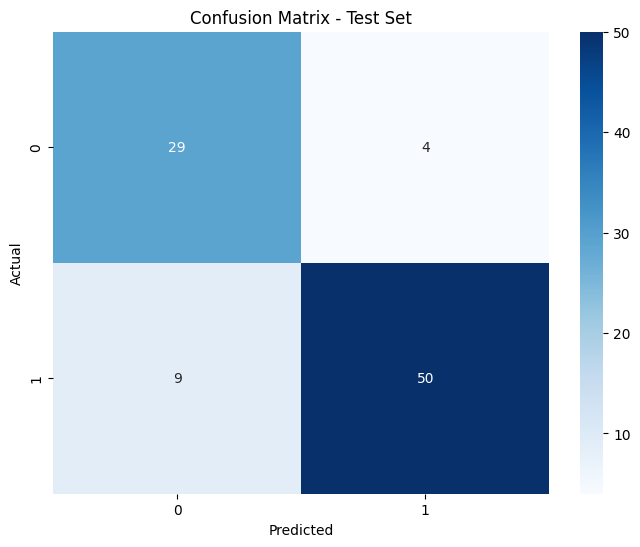

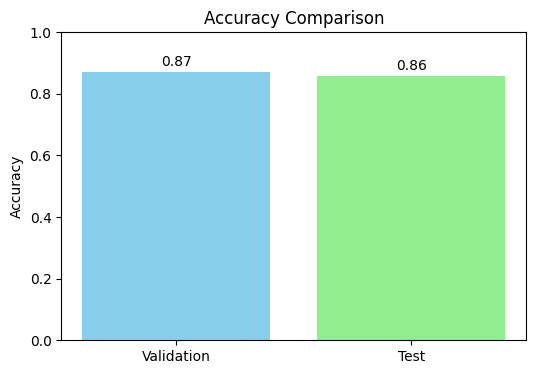

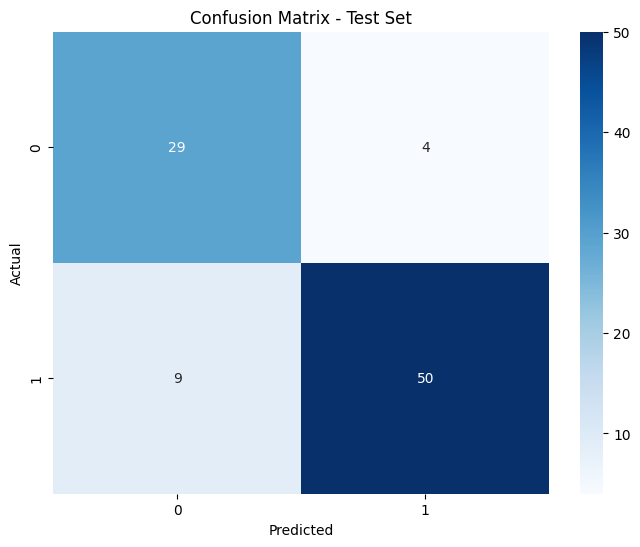

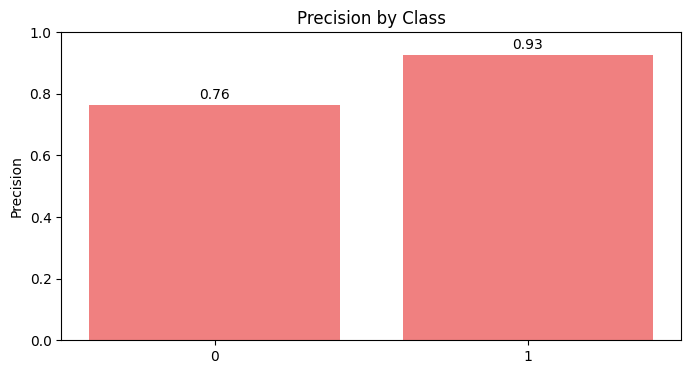

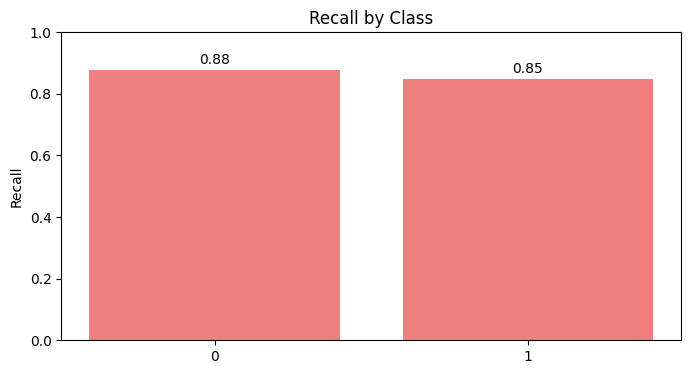

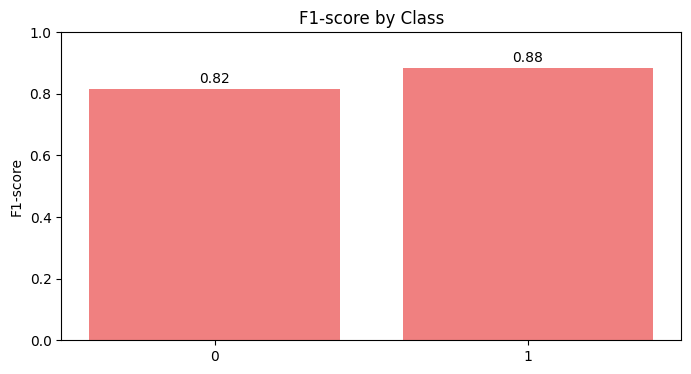

[I 2024-12-06 02:26:36,917] A new study created in memory with name: no-name-505ceace-c9c0-4f62-8e9b-18bb1757406d
[I 2024-12-06 02:26:36,932] Trial 0 finished with value: 0.8492888064316635 and parameters: {'C': 2.422636600074979, 'gamma': 8.869781897807233, 'kernel': 'linear'}. Best is trial 0 with value: 0.8492888064316635.
[I 2024-12-06 02:26:36,947] Trial 1 finished with value: 0.6781900639043495 and parameters: {'C': 7.0152760889798875, 'gamma': 0.6307743146915508, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8492888064316635.
[I 2024-12-06 02:26:36,982] Trial 2 finished with value: 0.7760049474335189 and parameters: {'C': 3.1472341097781897, 'gamma': 6.751395168862491, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8492888064316635.
[I 2024-12-06 02:26:37,011] Trial 3 finished with value: 0.5295403009688725 and parameters: {'C': 5.129743001243187, 'gamma': 6.7070003015874615, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8492888064316635.
[I 2024-12-06 02:26:37,038]

Scenario dataset_scenario_6_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running SVM with optuna for dataset_scenario_7_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_7_N


[I 2024-12-06 02:26:37,139] Trial 8 finished with value: 0.5295403009688725 and parameters: {'C': 9.873150613001101, 'gamma': 9.257095311018757, 'kernel': 'sigmoid'}. Best is trial 7 with value: 0.8493094207379922.
[I 2024-12-06 02:26:37,187] Trial 9 finished with value: 0.7515769944341372 and parameters: {'C': 2.5725034909846043, 'gamma': 4.400533693073516, 'kernel': 'poly'}. Best is trial 7 with value: 0.8493094207379922.
[I 2024-12-06 02:26:37,208] Trial 10 finished with value: 0.8554318697175841 and parameters: {'C': 0.38076614967645916, 'gamma': 1.4872924777304446, 'kernel': 'linear'}. Best is trial 10 with value: 0.8554318697175841.
[I 2024-12-06 02:26:37,229] Trial 11 finished with value: 0.8473098330241188 and parameters: {'C': 0.22070489217021638, 'gamma': 1.3365901643312235, 'kernel': 'linear'}. Best is trial 10 with value: 0.8554318697175841.
[I 2024-12-06 02:26:37,249] Trial 12 finished with value: 0.8493094207379922 and parameters: {'C': 0.4589276097293744, 'gamma': 2.4299

Best hyperparameters:  {'C': 0.3066054901715993, 'gamma': 5.122201726593528, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8786
  Precision: 0.8788
  Recall: 0.8786
  F1 Score: 0.8787

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8339
  Recall: 0.8169
  F1 Score: 0.8174

Confusion Matrix (Test Set):
[[30 10]
 [ 3 28]]


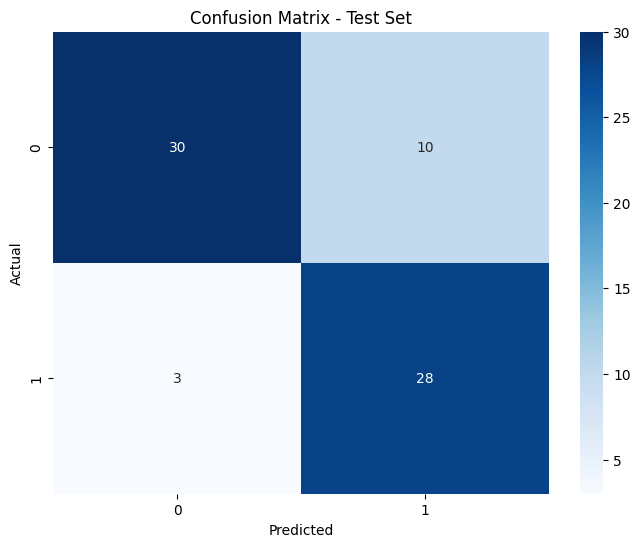

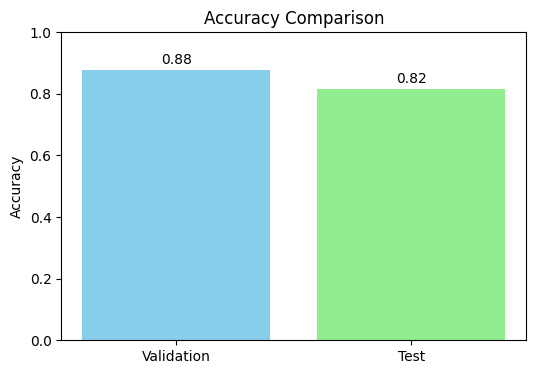

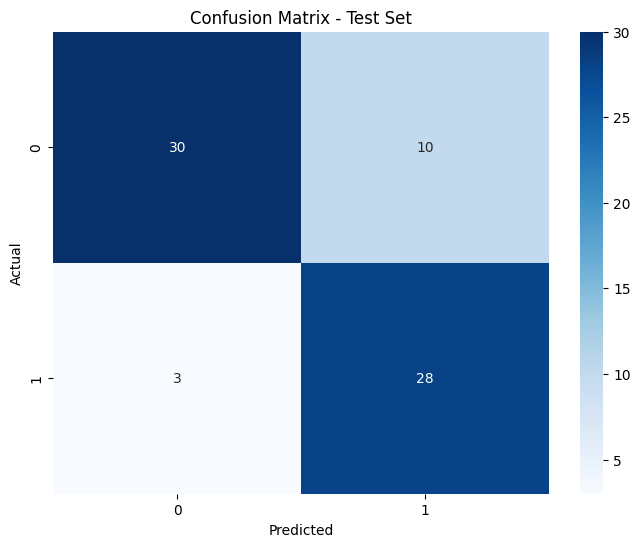

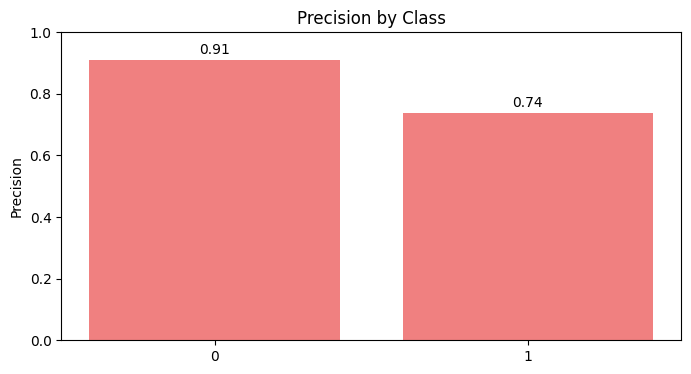

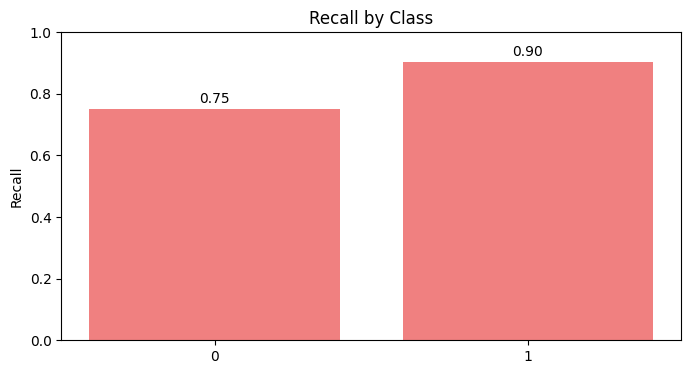

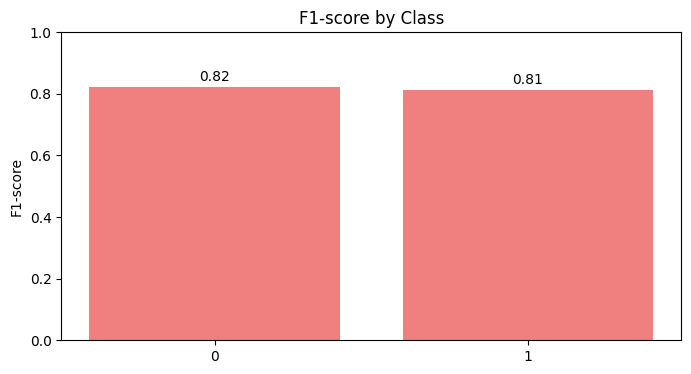

[I 2024-12-06 02:26:40,110] A new study created in memory with name: no-name-bedbffd7-a8d2-4e91-9969-1fa7110ee081
[I 2024-12-06 02:26:40,125] Trial 0 finished with value: 0.8431663574520718 and parameters: {'C': 0.9992101592712271, 'gamma': 3.7443873425079865, 'kernel': 'linear'}. Best is trial 0 with value: 0.8431663574520718.
[I 2024-12-06 02:26:40,140] Trial 1 finished with value: 0.7636775922490209 and parameters: {'C': 3.3339735325153383, 'gamma': 7.007053803440389, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.8431663574520718.
[I 2024-12-06 02:26:40,165] Trial 2 finished with value: 0.5519686662543805 and parameters: {'C': 4.057354794143967, 'gamma': 5.775958775365825, 'kernel': 'rbf'}. Best is trial 0 with value: 0.8431663574520718.
[I 2024-12-06 02:26:40,179] Trial 3 finished with value: 0.7596784168212739 and parameters: {'C': 8.202841198663416, 'gamma': 4.819379313849543, 'kernel': 'poly'}. Best is trial 0 with value: 0.8431663574520718.
[I 2024-12-06 02:26:40,256] Tri

Scenario dataset_scenario_7_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_7_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_7_S


[I 2024-12-06 02:26:40,327] Trial 7 finished with value: 0.5987219130076273 and parameters: {'C': 1.0225903284470237, 'gamma': 2.796935752774116, 'kernel': 'rbf'}. Best is trial 6 with value: 0.8452071737786022.
[I 2024-12-06 02:26:40,404] Trial 8 finished with value: 0.637394351680066 and parameters: {'C': 3.0510619083397916, 'gamma': 2.386331047965189, 'kernel': 'rbf'}. Best is trial 6 with value: 0.8452071737786022.
[I 2024-12-06 02:26:40,419] Trial 9 finished with value: 0.7516594516594517 and parameters: {'C': 2.8491809682554265, 'gamma': 0.3612848929121908, 'kernel': 'sigmoid'}. Best is trial 6 with value: 0.8452071737786022.
[I 2024-12-06 02:26:40,461] Trial 10 finished with value: 0.8452071737786022 and parameters: {'C': 9.987733649926126, 'gamma': 9.994969021109277, 'kernel': 'linear'}. Best is trial 6 with value: 0.8452071737786022.
[I 2024-12-06 02:26:40,502] Trial 11 finished with value: 0.8452071737786022 and parameters: {'C': 9.044754728306426, 'gamma': 9.983757742131774,

Best hyperparameters:  {'C': 4.690503567228454, 'gamma': 9.317224097480052, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8786
  Precision: 0.8798
  Recall: 0.8786
  F1 Score: 0.8788

Test Metrics:
  Accuracy: 0.8169
  Precision: 0.8339
  Recall: 0.8169
  F1 Score: 0.8174

Confusion Matrix (Test Set):
[[30 10]
 [ 3 28]]


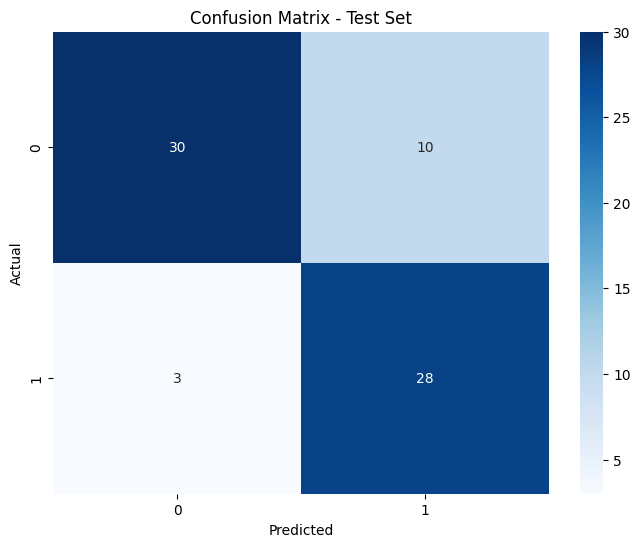

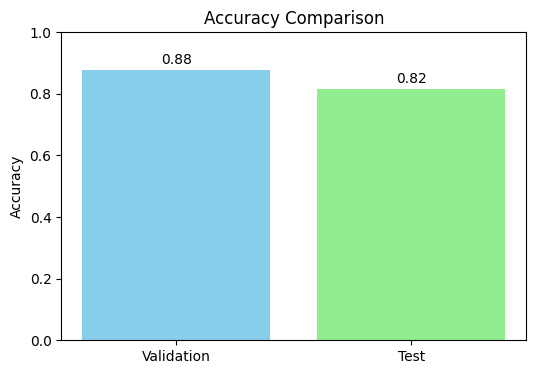

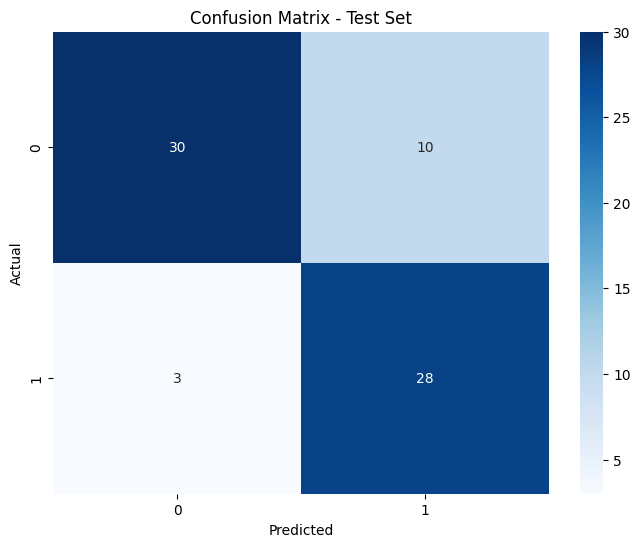

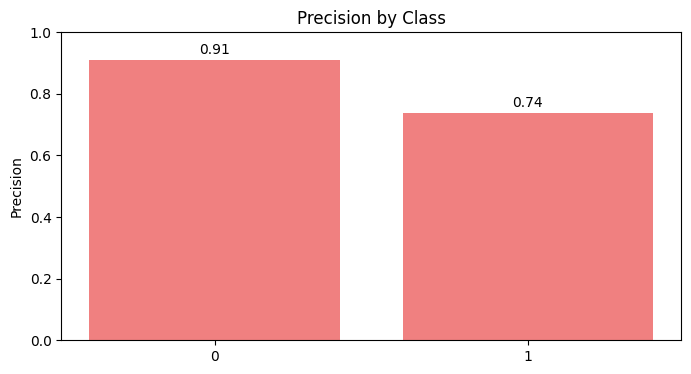

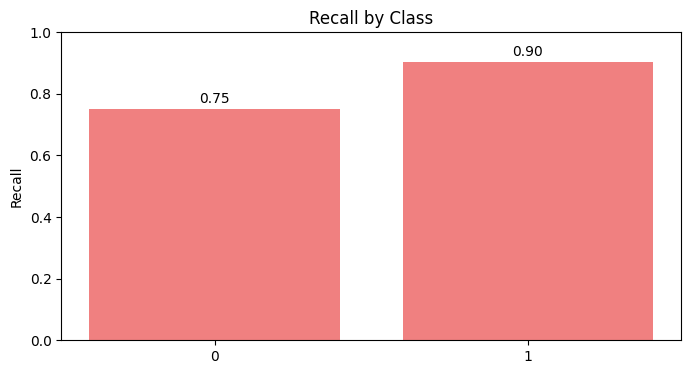

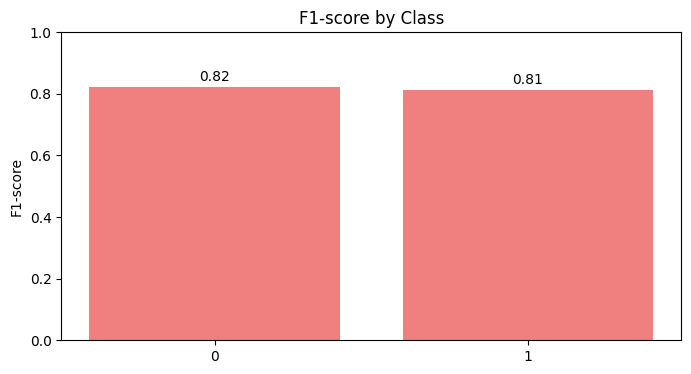

[I 2024-12-06 02:26:44,093] A new study created in memory with name: no-name-86767d2d-d392-4b01-81e4-0475b61b9144


Scenario dataset_scenario_7_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running SVM with optuna for dataset_scenario_8_N...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_8_N


[I 2024-12-06 02:26:44,329] Trial 0 finished with value: 0.742890019379845 and parameters: {'C': 2.6101158488519642, 'gamma': 4.172928271602141, 'kernel': 'poly'}. Best is trial 0 with value: 0.742890019379845.
[I 2024-12-06 02:26:44,355] Trial 1 finished with value: 0.8255087209302324 and parameters: {'C': 7.2411379677957886, 'gamma': 1.6541553750357376, 'kernel': 'rbf'}. Best is trial 1 with value: 0.8255087209302324.
[I 2024-12-06 02:26:44,382] Trial 2 finished with value: 0.8441860465116278 and parameters: {'C': 1.0142492855762797, 'gamma': 5.877314329699217, 'kernel': 'linear'}. Best is trial 2 with value: 0.8441860465116278.
[I 2024-12-06 02:26:44,649] Trial 3 finished with value: 0.7428779069767442 and parameters: {'C': 2.8542197726715974, 'gamma': 5.1626516778685465, 'kernel': 'poly'}. Best is trial 2 with value: 0.8441860465116278.
[I 2024-12-06 02:26:44,674] Trial 4 finished with value: 0.7990552325581396 and parameters: {'C': 9.505003630897932, 'gamma': 8.181551940788722, 'k

Best hyperparameters:  {'C': 1.0142492855762797, 'gamma': 5.877314329699217, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8760
  Recall: 0.8750
  F1 Score: 0.8753

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


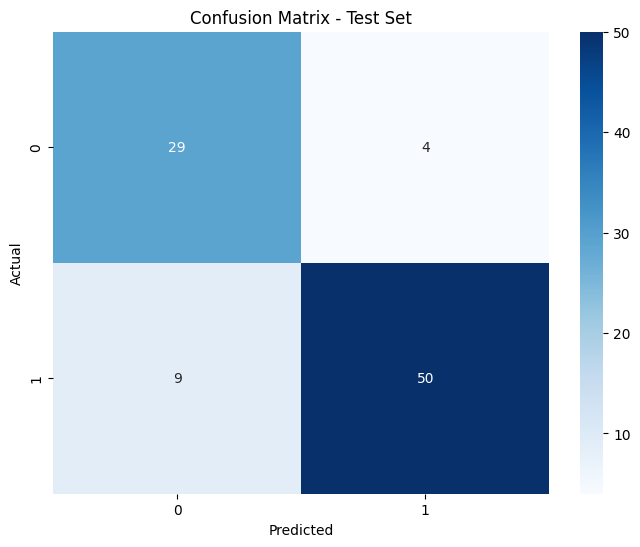

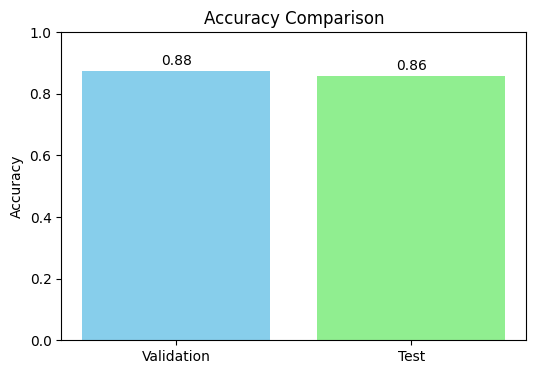

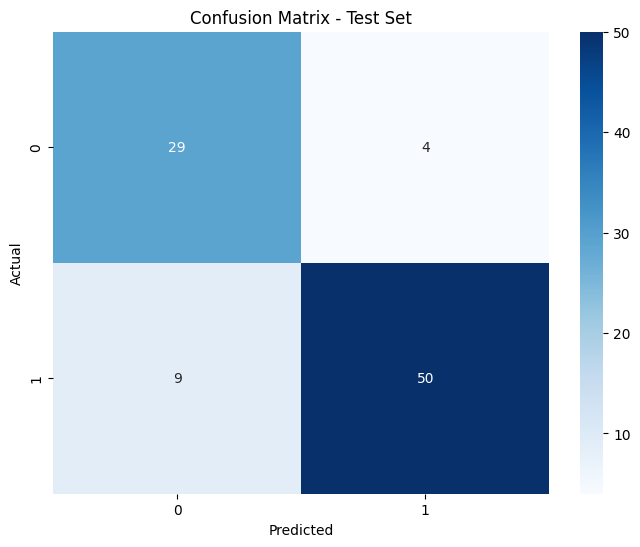

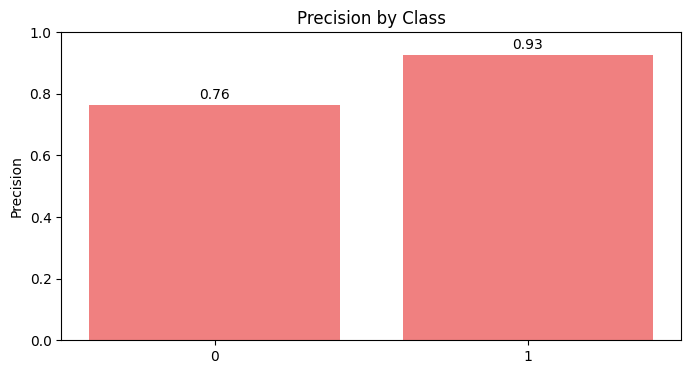

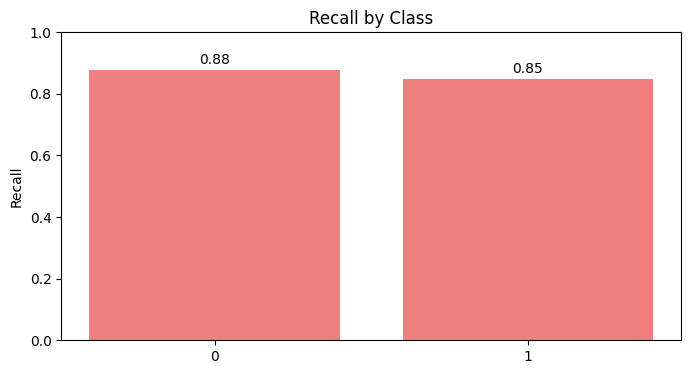

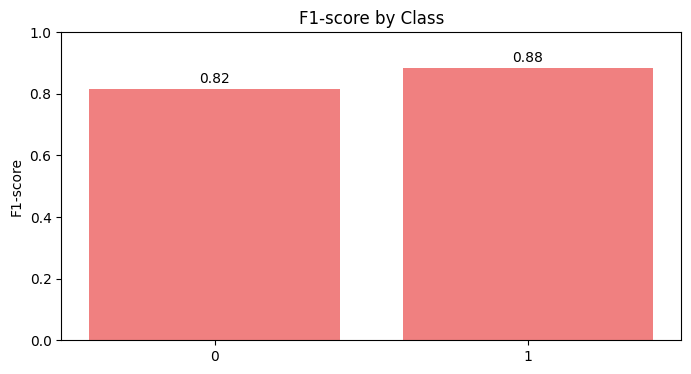

[I 2024-12-06 02:26:49,611] A new study created in memory with name: no-name-fdbcc054-0024-482d-a697-143ab2d2b57a
[I 2024-12-06 02:26:49,638] Trial 0 finished with value: 0.7382873062015504 and parameters: {'C': 2.471672758665062, 'gamma': 5.140834156440897, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7382873062015504.
[I 2024-12-06 02:26:49,663] Trial 1 finished with value: 0.7243095930232558 and parameters: {'C': 5.206694635409608, 'gamma': 9.408625478579756, 'kernel': 'sigmoid'}. Best is trial 0 with value: 0.7382873062015504.
[I 2024-12-06 02:26:49,710] Trial 2 finished with value: 0.8410852713178294 and parameters: {'C': 9.914401157964571, 'gamma': 6.498141764469629, 'kernel': 'linear'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,736] Trial 3 finished with value: 0.8410852713178294 and parameters: {'C': 3.8253930431130203, 'gamma': 2.639560491187738, 'kernel': 'linear'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,761]

Scenario dataset_scenario_8_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running SVM with optuna for dataset_scenario_8_S...
Results will be saved in: SCORES\SVM\optuna\dataset_scenario_8_S


[I 2024-12-06 02:26:49,831] Trial 6 finished with value: 0.8410852713178294 and parameters: {'C': 5.547575260828614, 'gamma': 3.5807173764384075, 'kernel': 'linear'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,857] Trial 7 finished with value: 0.7506904069767442 and parameters: {'C': 5.846217271194721, 'gamma': 0.6149568644120557, 'kernel': 'poly'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,883] Trial 8 finished with value: 0.7506904069767442 and parameters: {'C': 1.503564642252652, 'gamma': 4.862657827996227, 'kernel': 'poly'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,909] Trial 9 finished with value: 0.5654433139534885 and parameters: {'C': 8.258548938089097, 'gamma': 7.54889253009103, 'kernel': 'rbf'}. Best is trial 2 with value: 0.8410852713178294.
[I 2024-12-06 02:26:49,960] Trial 10 finished with value: 0.8410852713178294 and parameters: {'C': 9.999888651418948, 'gamma': 7.309073920236949, 'ker

Best hyperparameters:  {'C': 9.914401157964571, 'gamma': 6.498141764469629, 'kernel': 'linear'}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8675
  Recall: 0.8587
  F1 Score: 0.8605

Confusion Matrix (Test Set):
[[29  4]
 [ 9 50]]


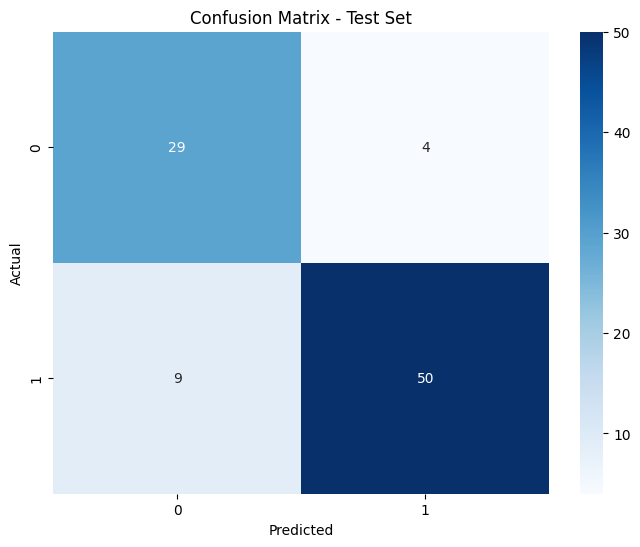

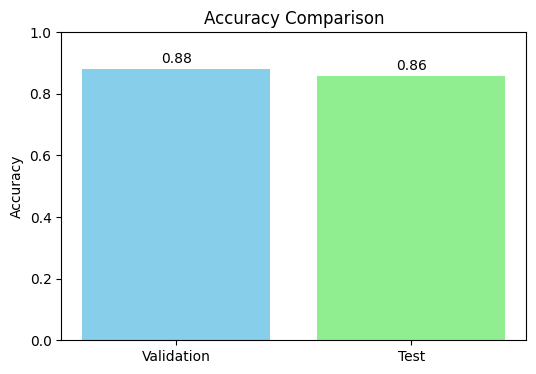

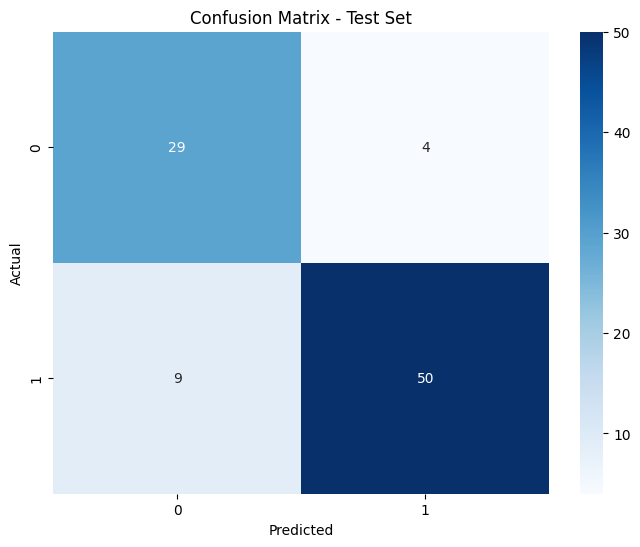

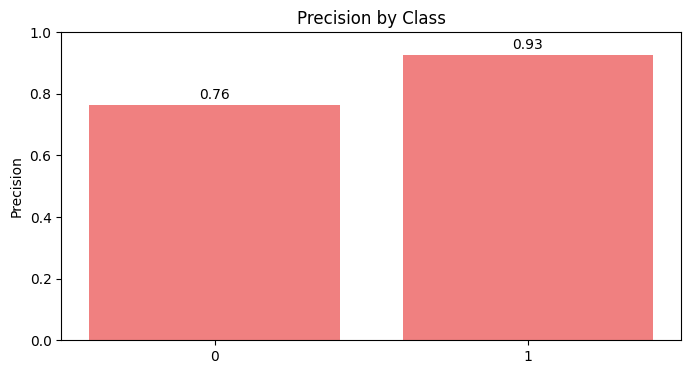

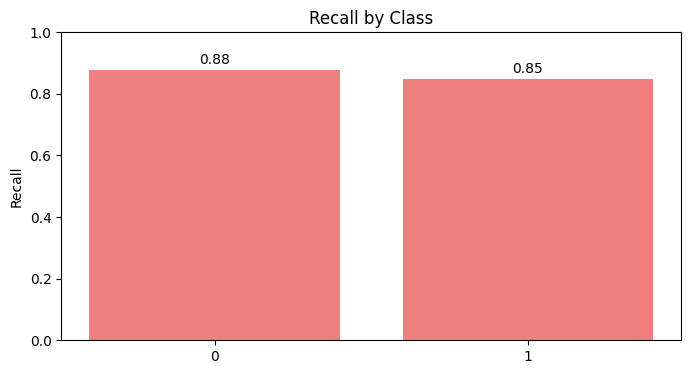

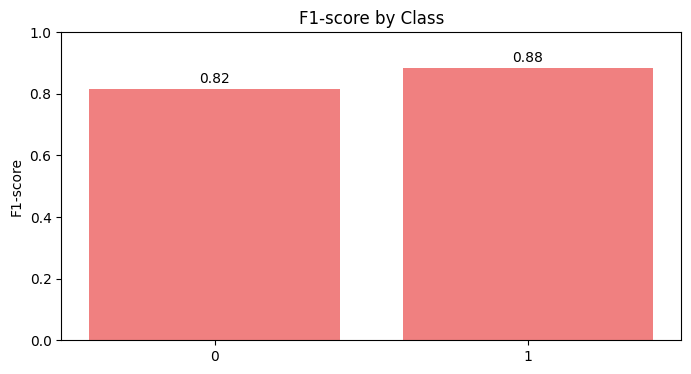

Scenario dataset_scenario_8_S with optuna completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8771
  Recall: 0.8750
  F1 Score: 0.8754

Test Metrics:
  Accuracy: 0.9022
  Precision: 0.9059
  Recall: 0.9022
  F1 Score: 0.9030

Confusion Matrix (Test Set):
[[30  3]
 [ 6 53]]


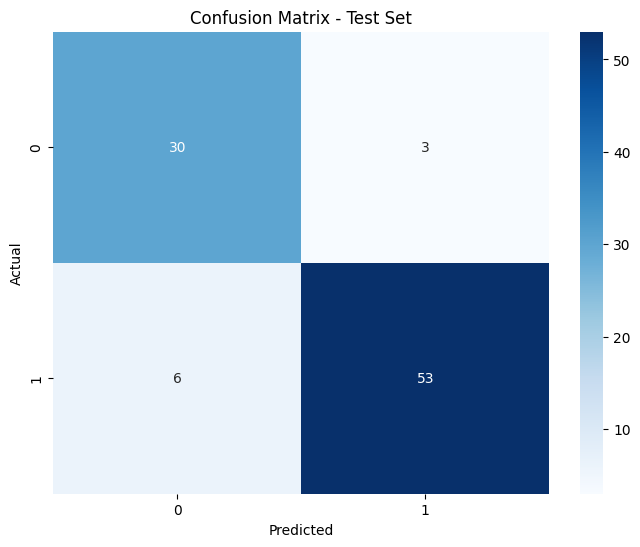

In [62]:
svm_optuna_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "SVM", "optuna", search_config_optuna, get_search_hyperparameters("SVM"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        svm_optuna_search['accuracy'] = best_score
        svm_optuna_search['params'] = best_params
        svm_optuna_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
svc = SVC(**svm_optuna_search['params'])
best_scenario = pd.read_csv(svm_optuna_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, svc) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "SVM", "optuna")
save_model_info(svm_optuna_search, "SVM", "optuna")
    

# KNN

## 1. Grid Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with grid for dataset_scenario_1_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_1_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8913
  Recall: 0.8913
  F1 Score: 0.8913

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


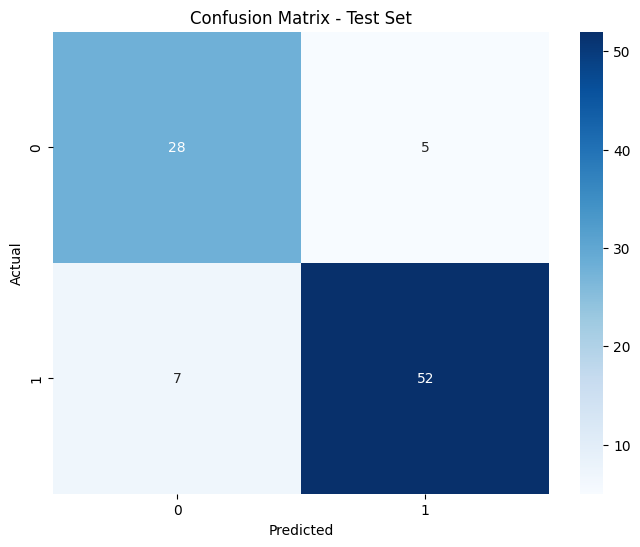

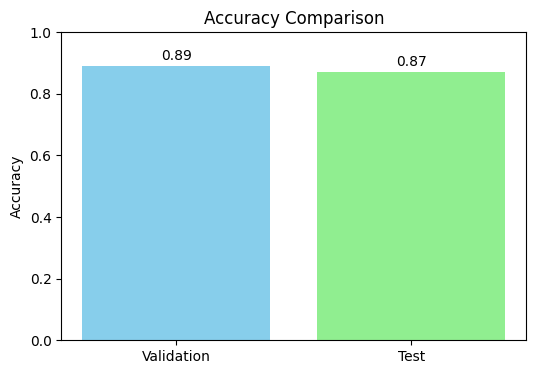

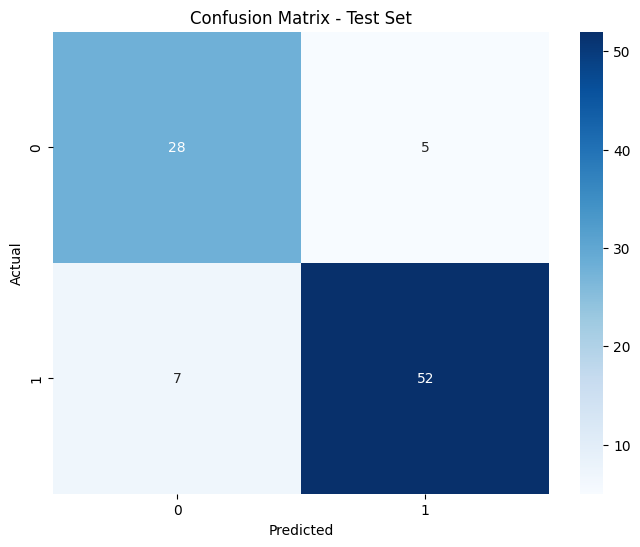

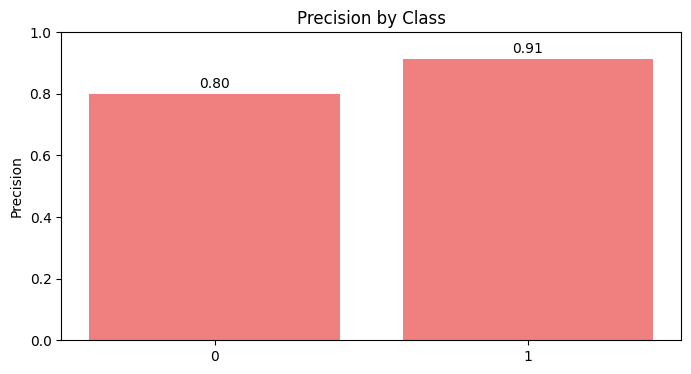

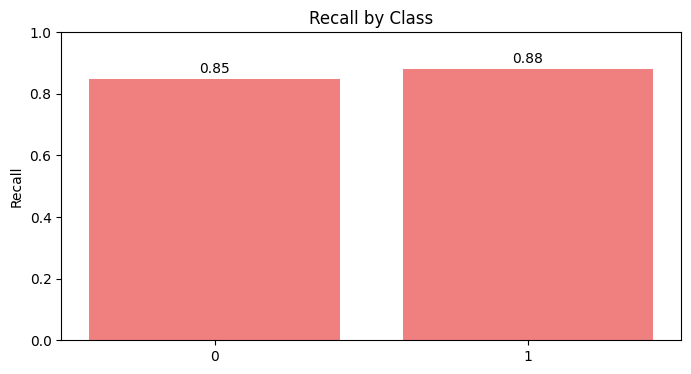

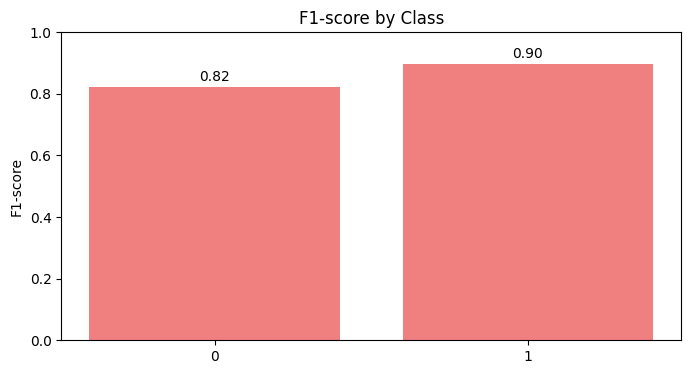

Scenario dataset_scenario_1_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_1_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_1_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8918
  Recall: 0.8913
  F1 Score: 0.8915

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


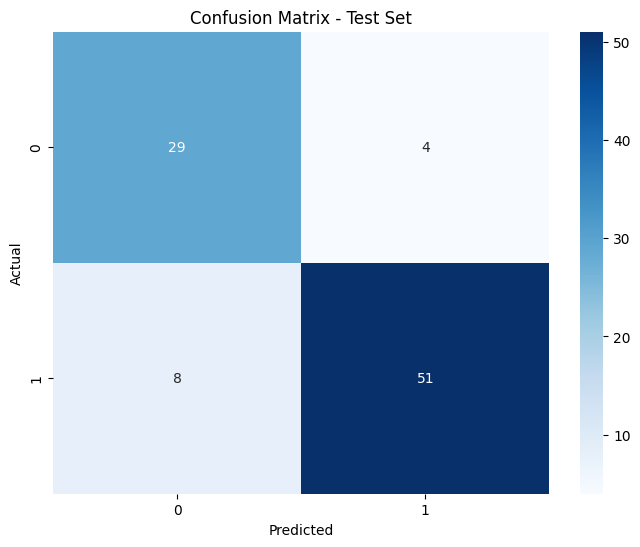

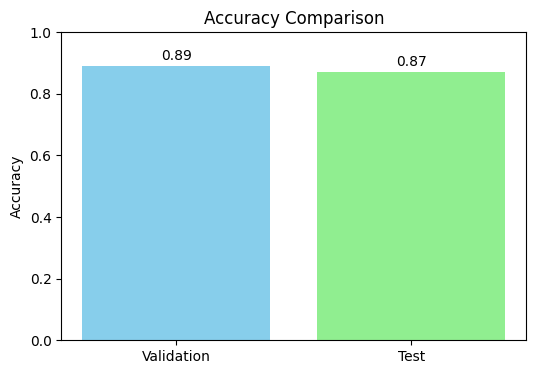

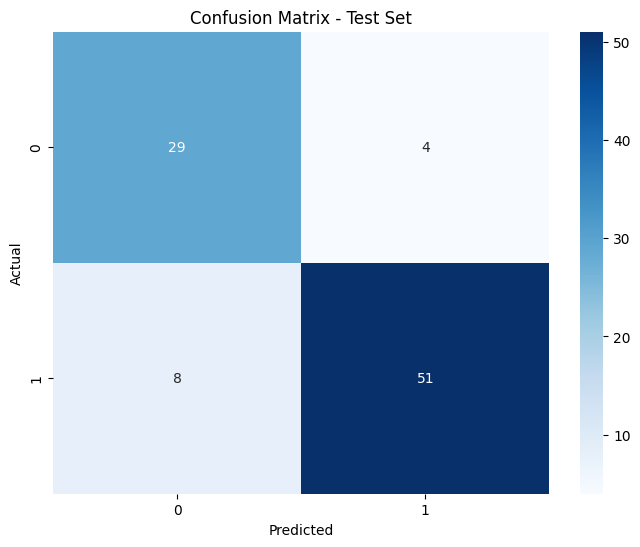

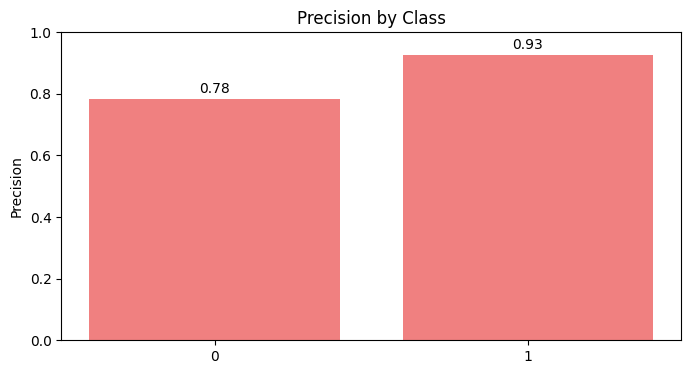

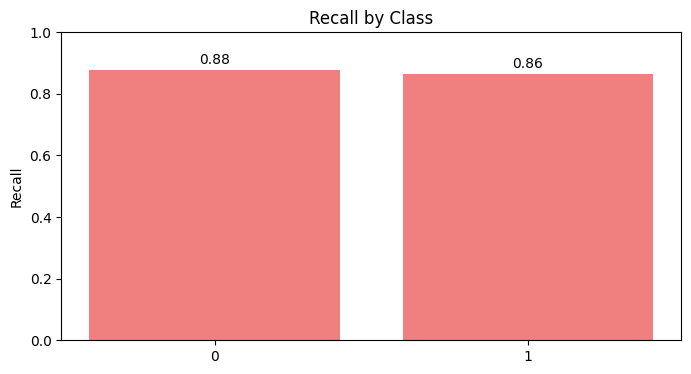

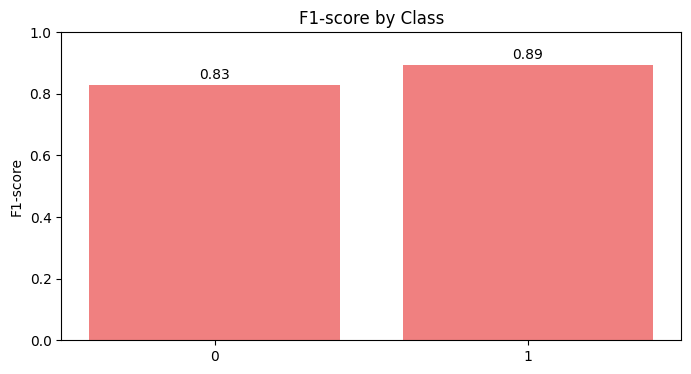

Scenario dataset_scenario_1_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running KNN with grid for dataset_scenario_2_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_2_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8424
  Precision: 0.8427
  Recall: 0.8424
  F1 Score: 0.8425

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


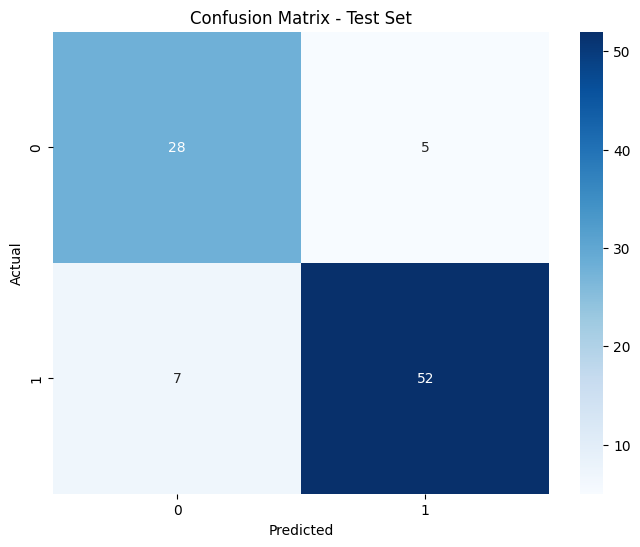

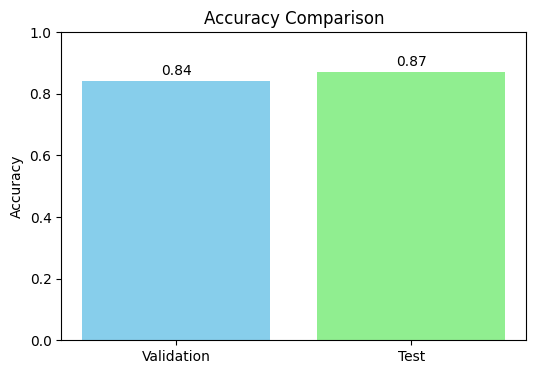

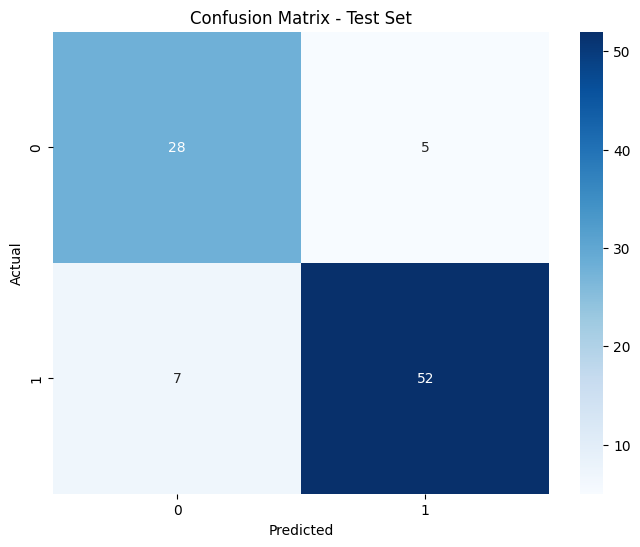

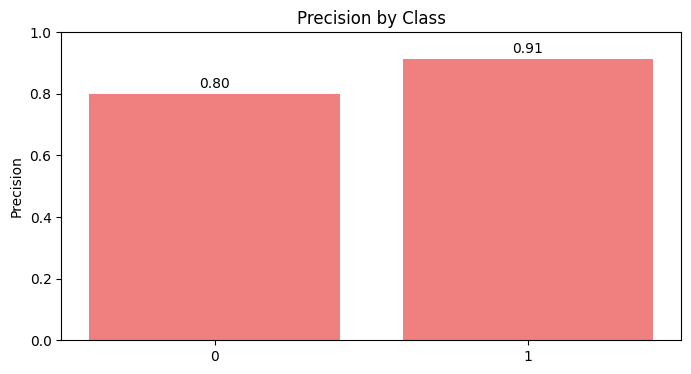

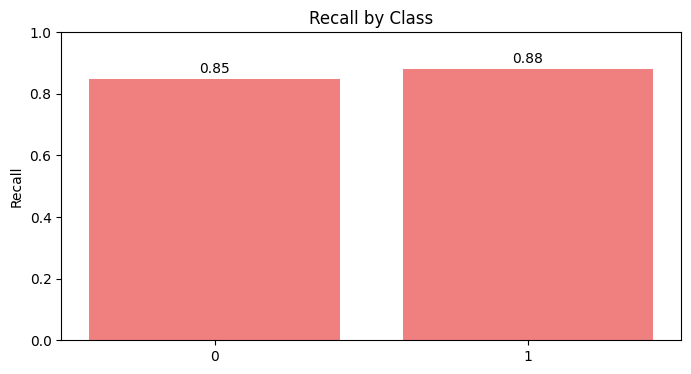

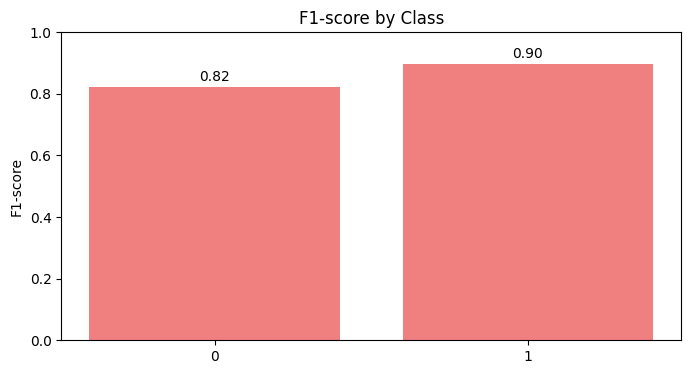

Scenario dataset_scenario_2_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running KNN with grid for dataset_scenario_2_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_2_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8913
  Recall: 0.8913
  F1 Score: 0.8913

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


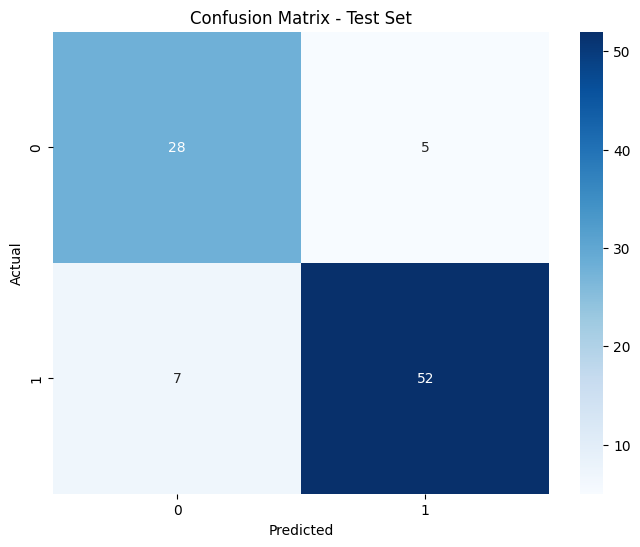

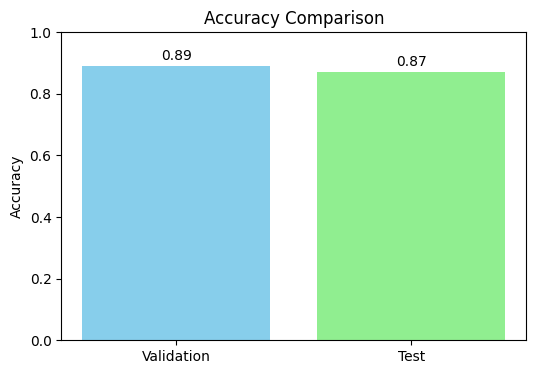

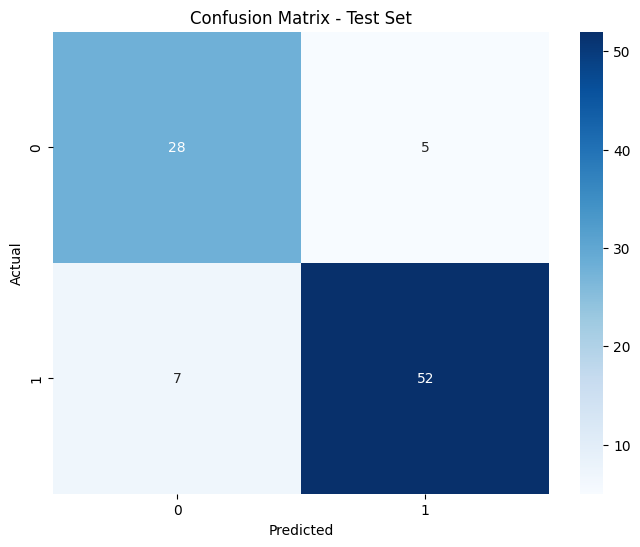

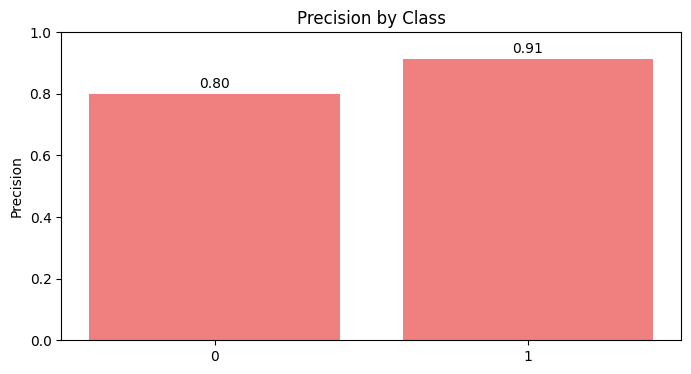

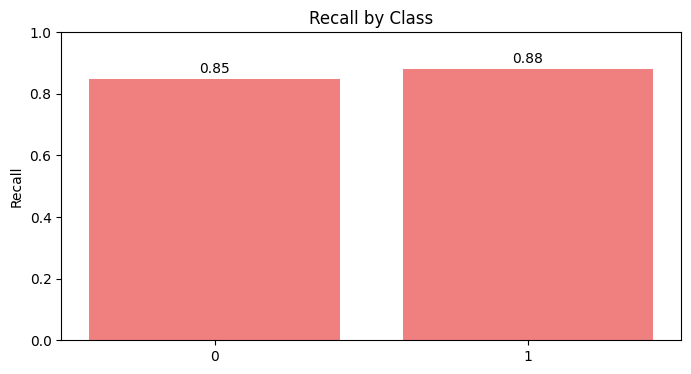

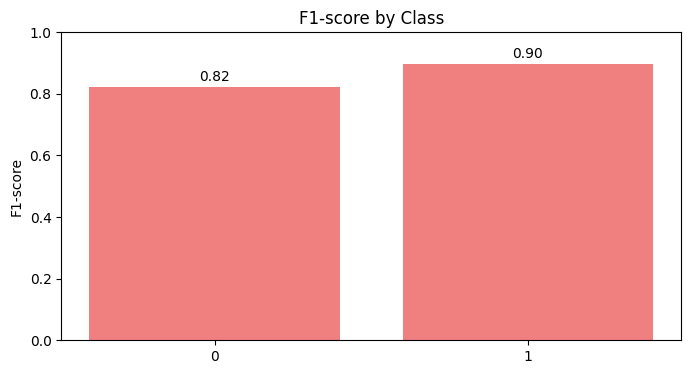

Scenario dataset_scenario_2_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with grid for dataset_scenario_3_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_3_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8503
  Recall: 0.8500
  F1 Score: 0.8501

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8441
  Recall: 0.8310
  F1 Score: 0.8316

Confusion Matrix (Test Set):
[[31  9]
 [ 3 28]]


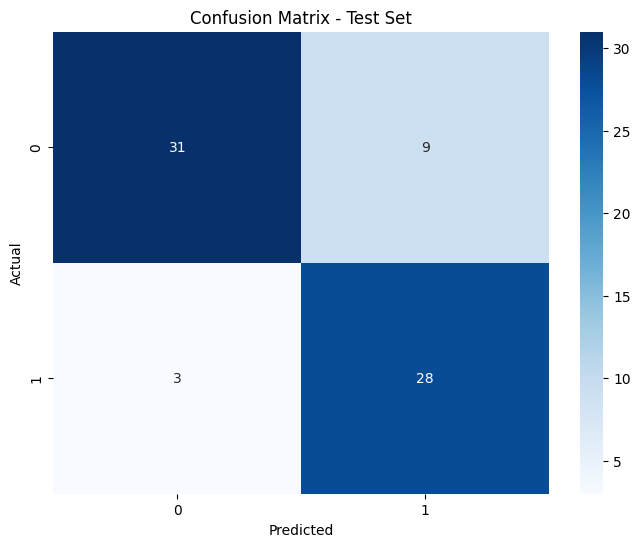

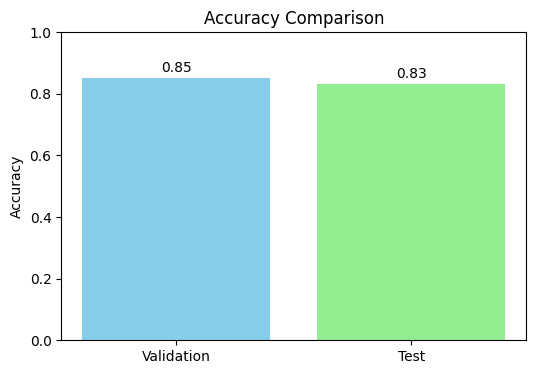

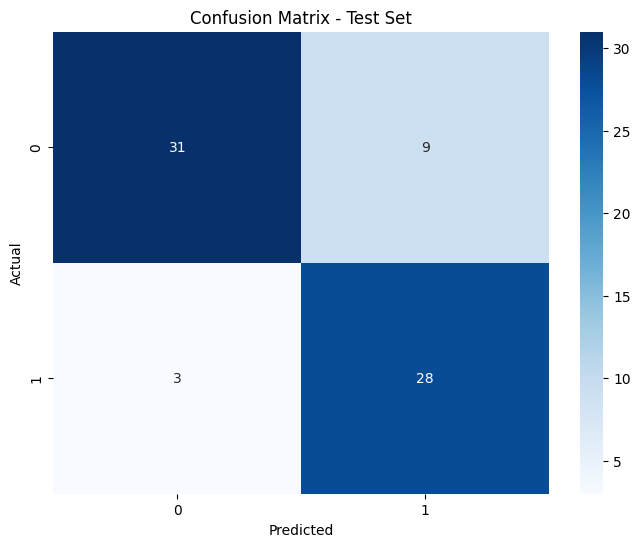

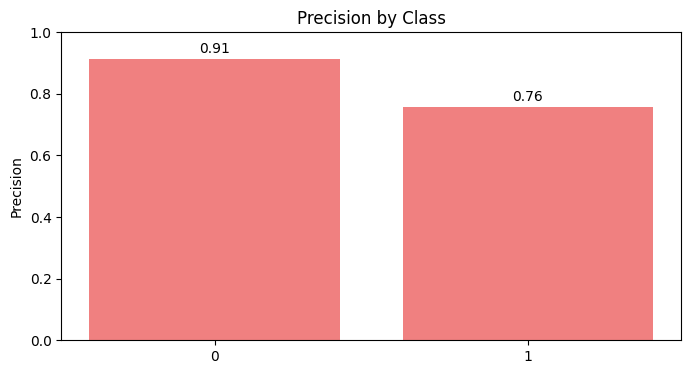

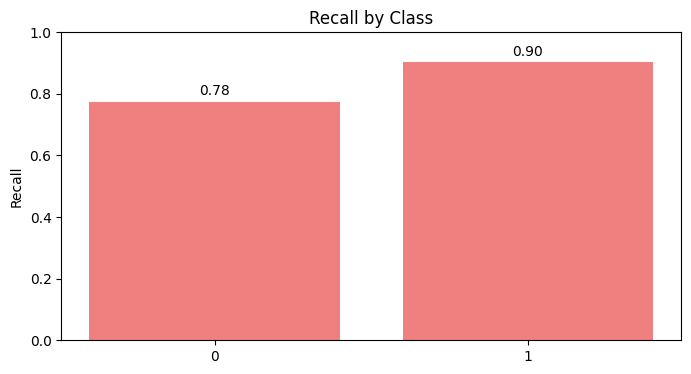

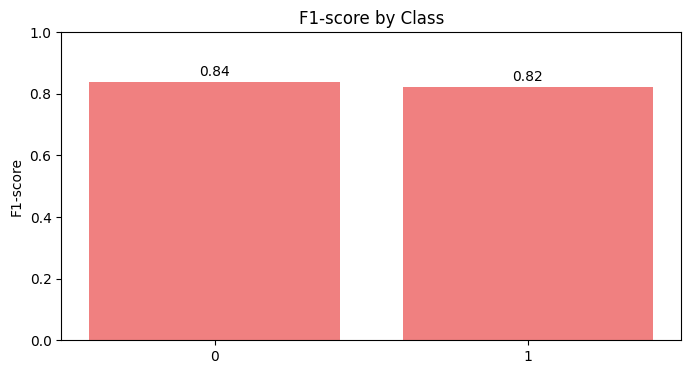

Scenario dataset_scenario_3_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_3_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_3_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8646
  Recall: 0.8643
  F1 Score: 0.8644

Test Metrics:
  Accuracy: 0.8451
  Precision: 0.8547
  Recall: 0.8451
  F1 Score: 0.8457

Confusion Matrix (Test Set):
[[32  8]
 [ 3 28]]


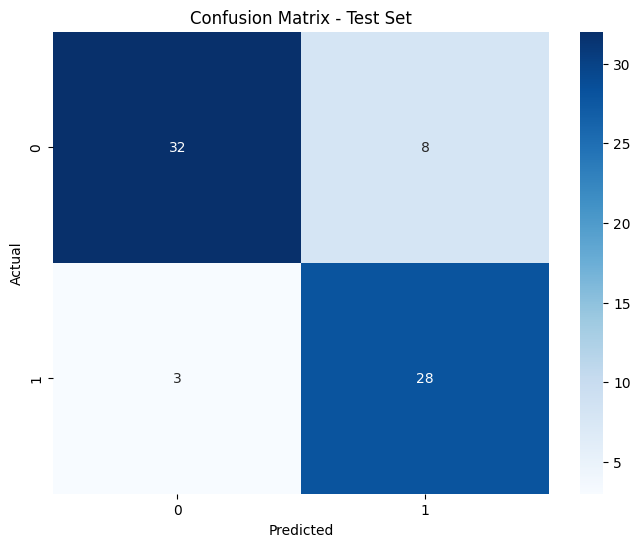

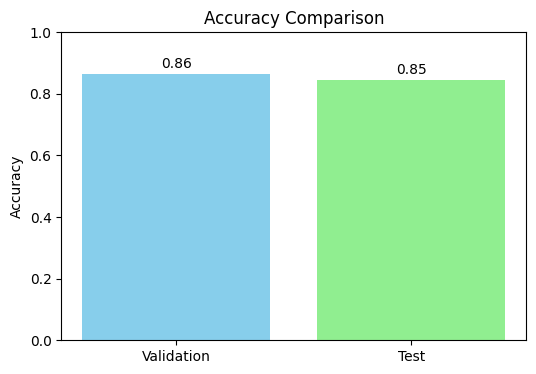

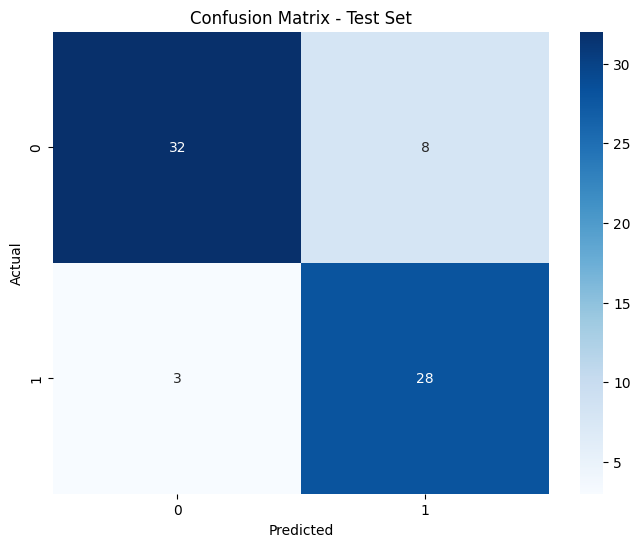

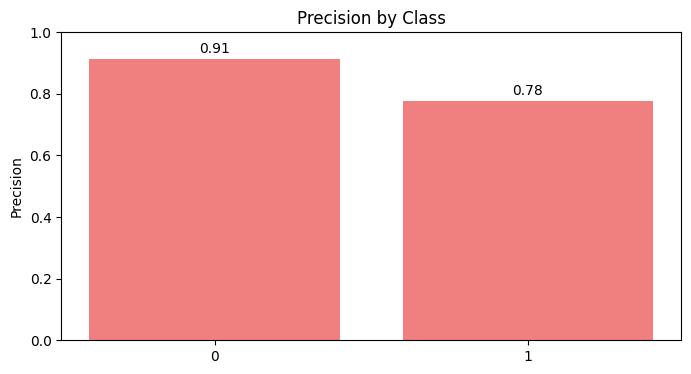

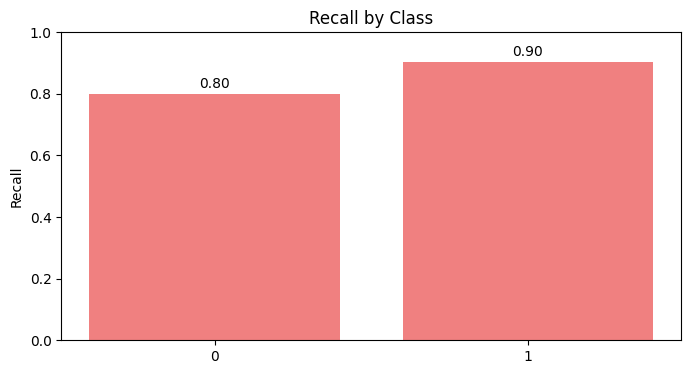

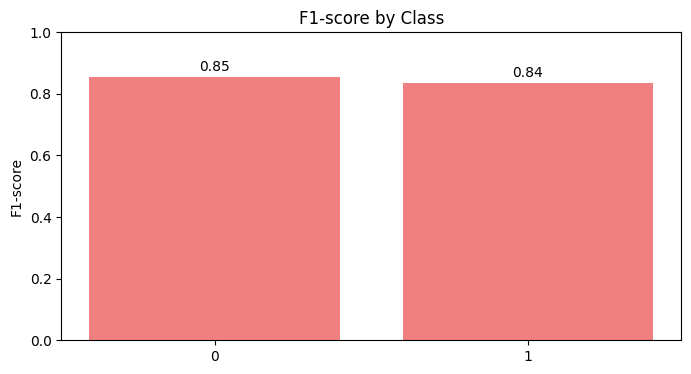

Scenario dataset_scenario_3_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with grid for dataset_scenario_4_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_4_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8531
  Recall: 0.8533
  F1 Score: 0.8531

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


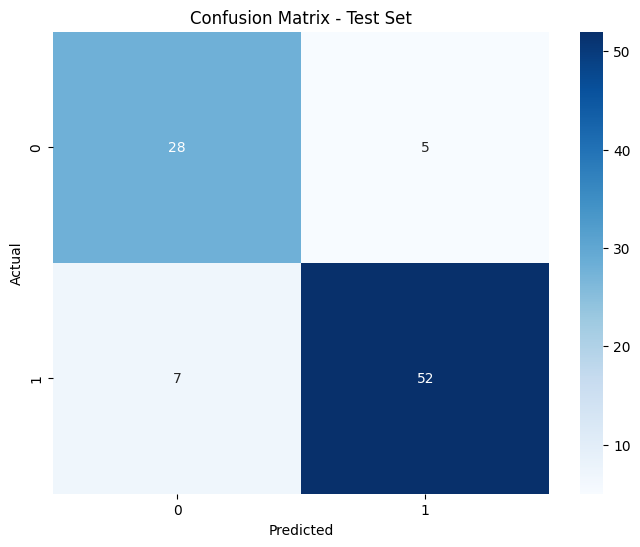

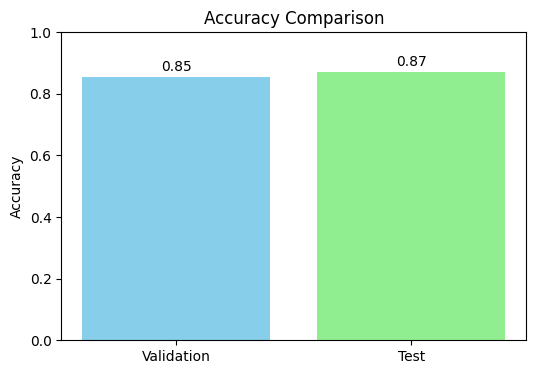

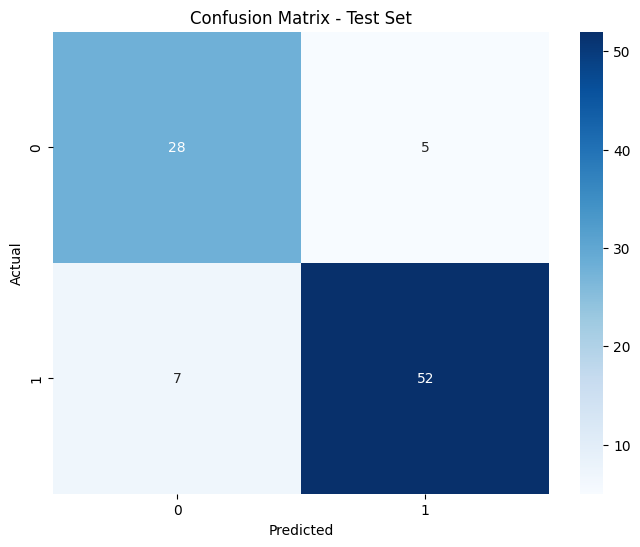

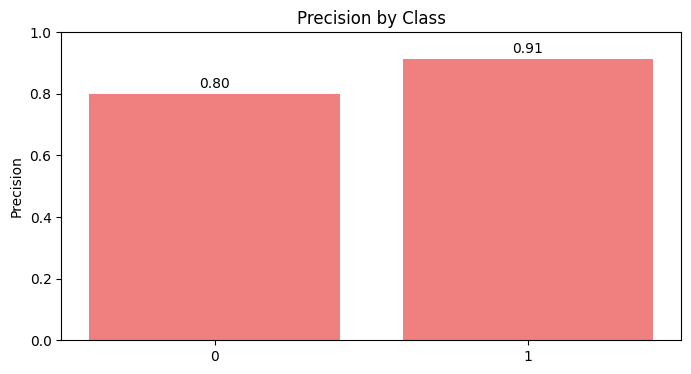

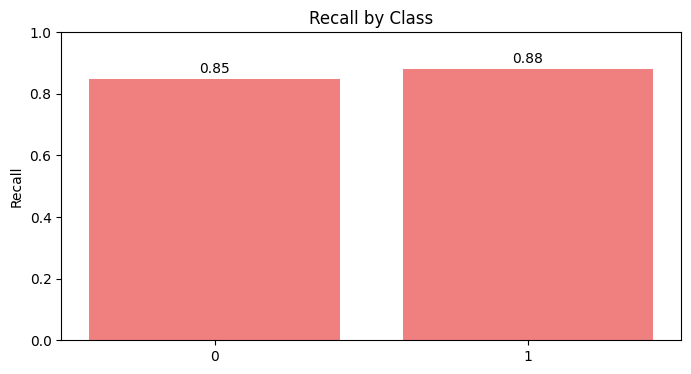

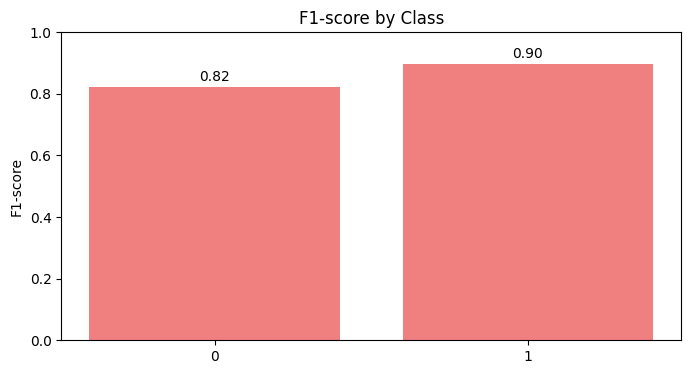

Scenario dataset_scenario_4_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_4_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_4_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8857
  Recall: 0.8859
  F1 Score: 0.8858

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8630
  Recall: 0.8587
  F1 Score: 0.8599

Confusion Matrix (Test Set):
[[28  5]
 [ 8 51]]


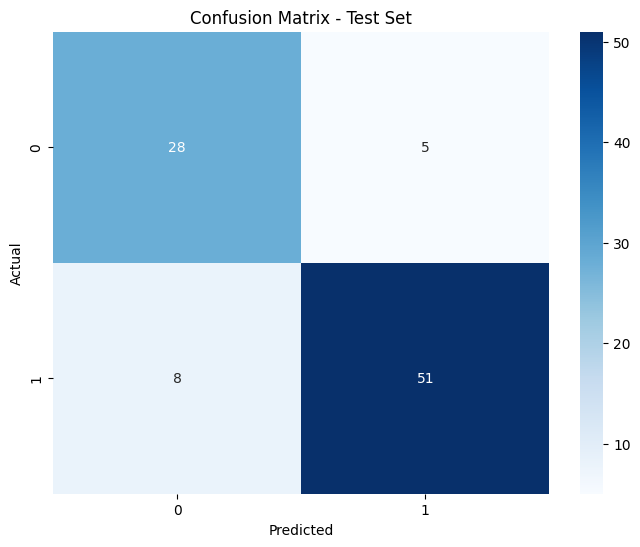

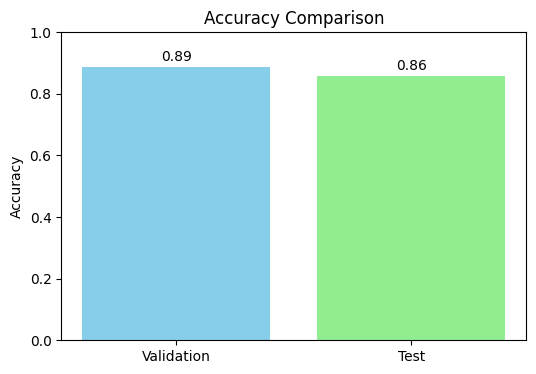

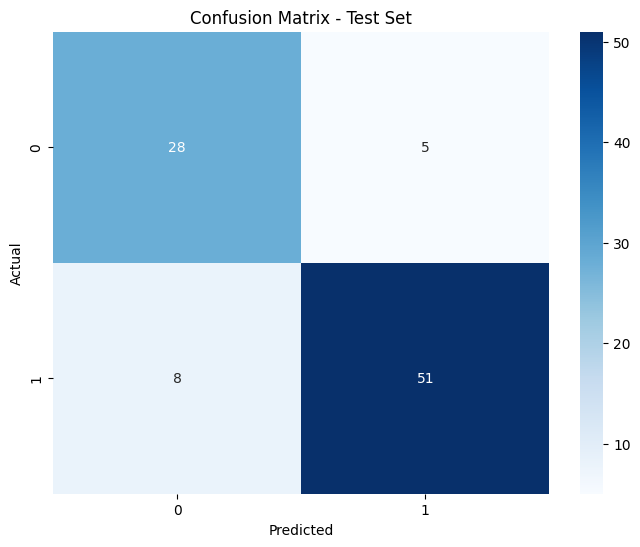

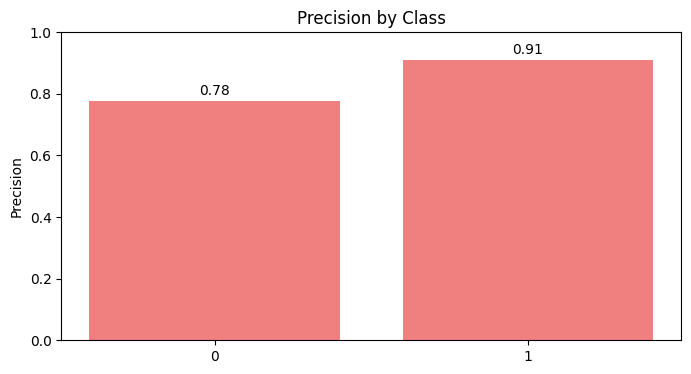

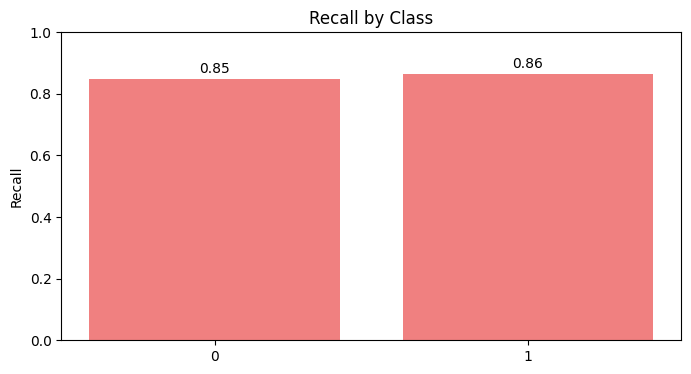

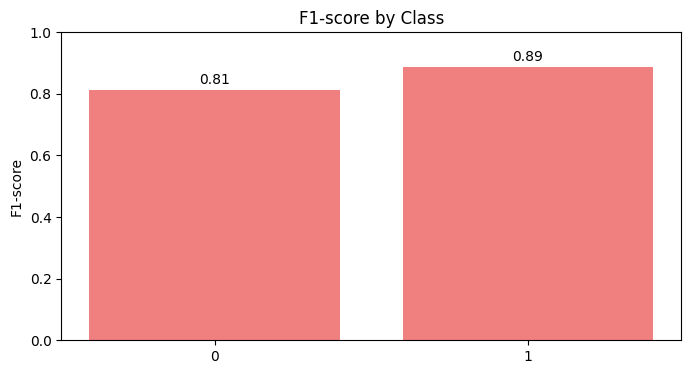

Scenario dataset_scenario_4_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with grid for dataset_scenario_5_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_5_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8785
  Recall: 0.8750
  F1 Score: 0.8755

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8596
  Recall: 0.8478
  F1 Score: 0.8501

Confusion Matrix (Test Set):
[[29  4]
 [10 49]]


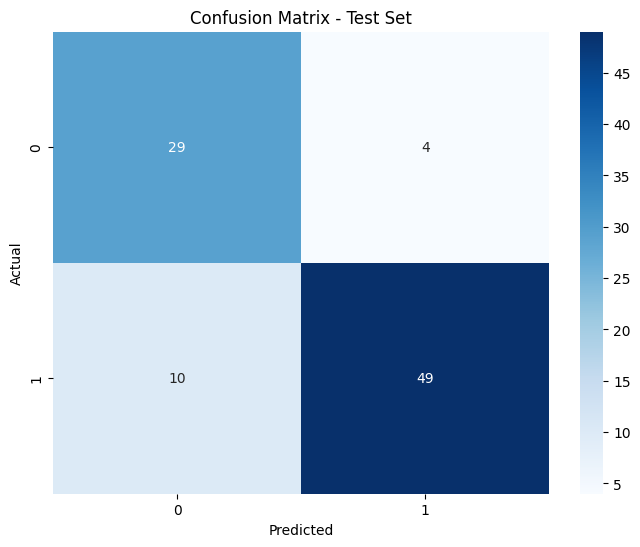

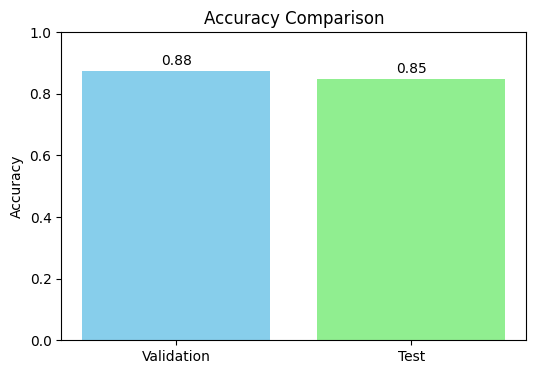

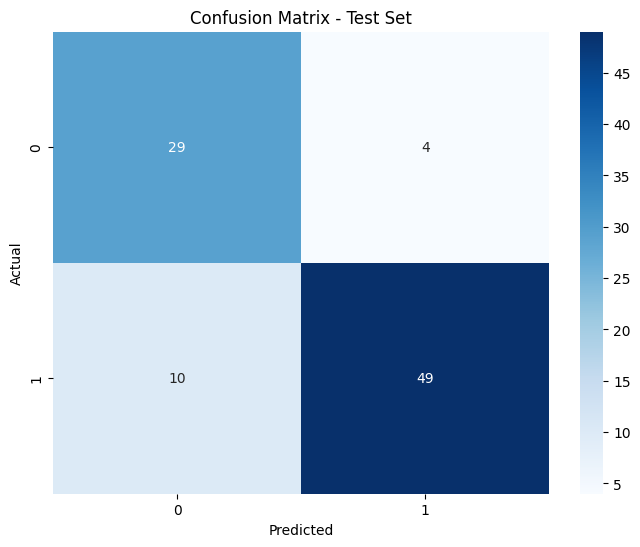

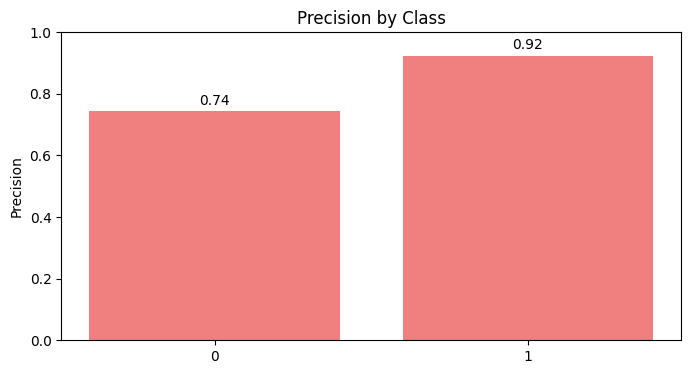

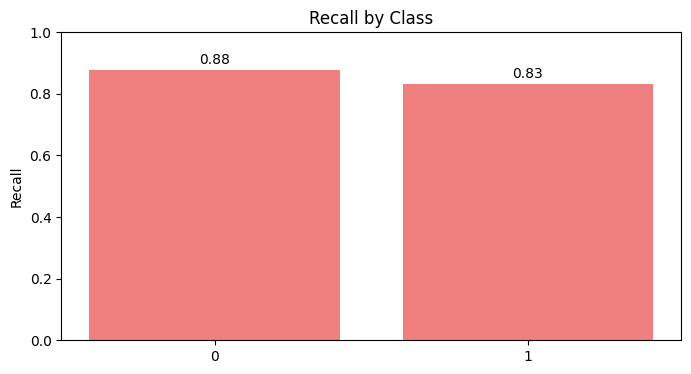

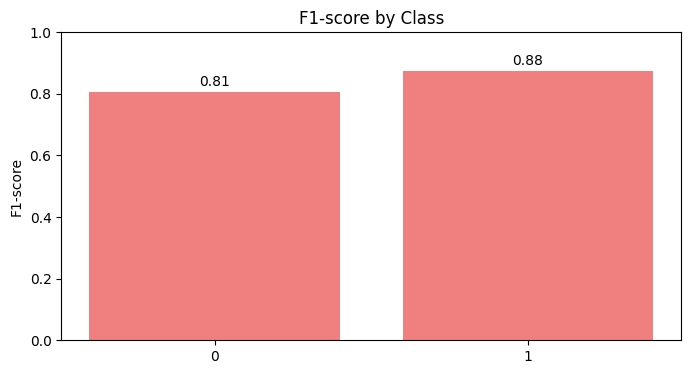

Scenario dataset_scenario_5_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_5_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_5_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8940
  Recall: 0.8913
  F1 Score: 0.8917

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8889
  Recall: 0.8804
  F1 Score: 0.8820

Confusion Matrix (Test Set):
[[30  3]
 [ 8 51]]


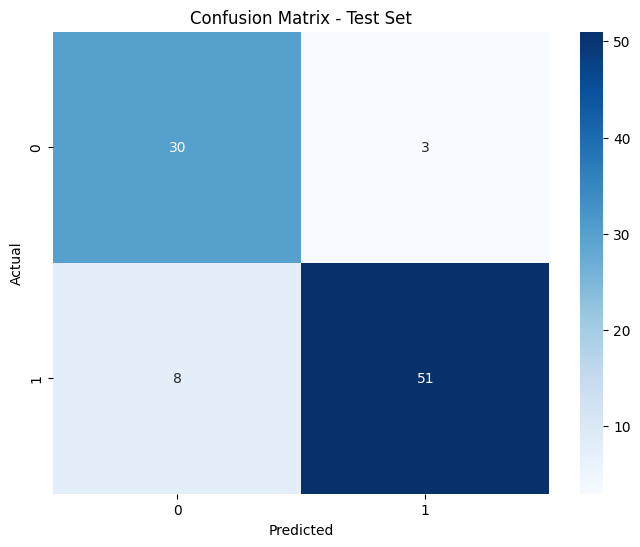

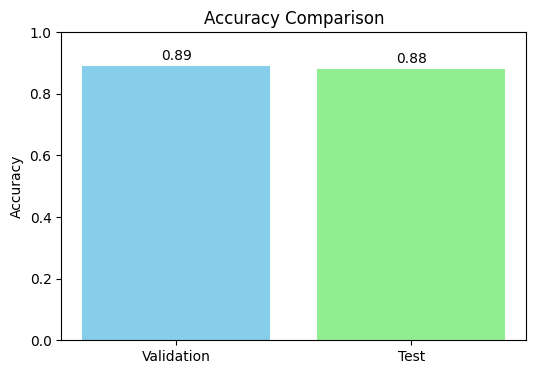

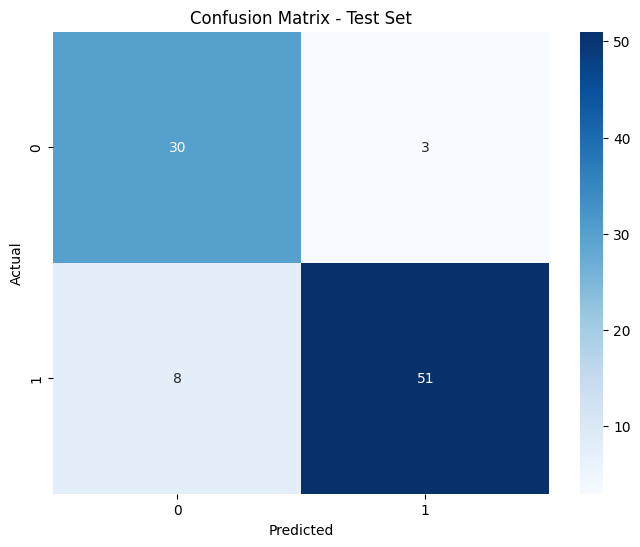

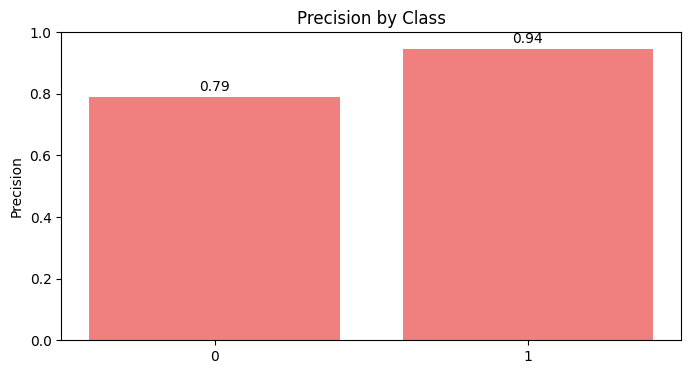

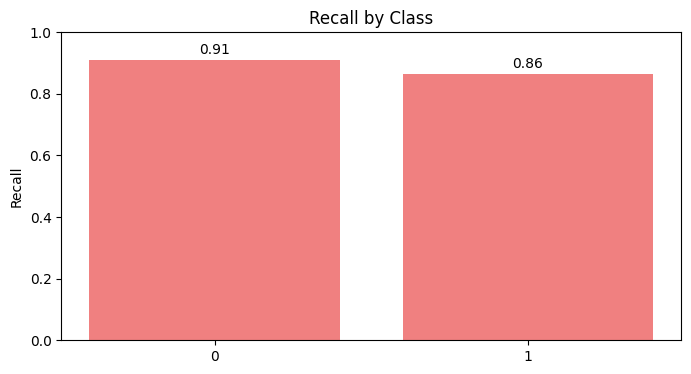

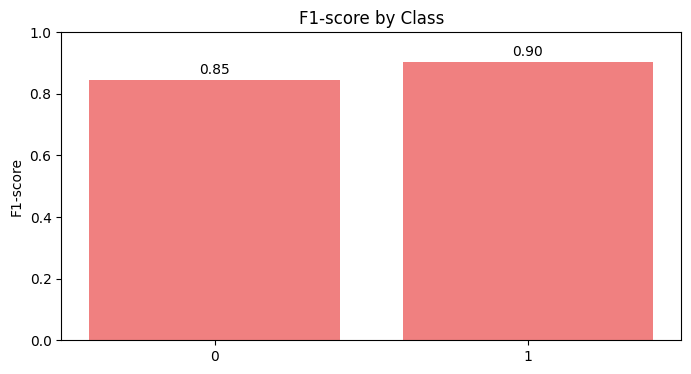

Scenario dataset_scenario_5_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with grid for dataset_scenario_6_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_6_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8596
  Recall: 0.8478
  F1 Score: 0.8501

Confusion Matrix (Test Set):
[[29  4]
 [10 49]]


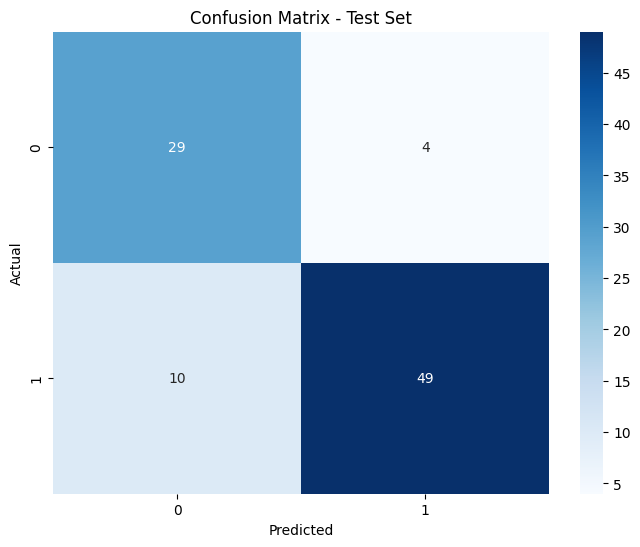

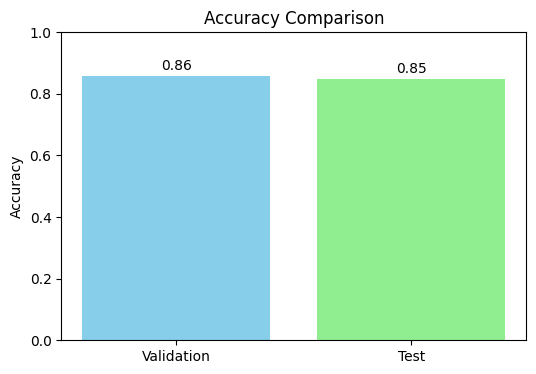

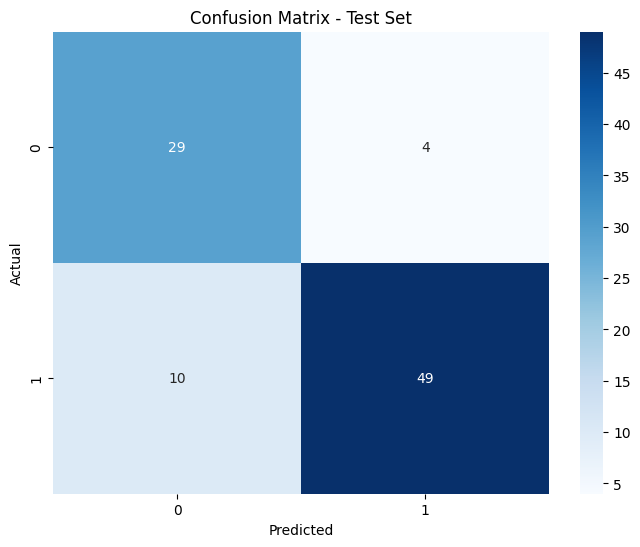

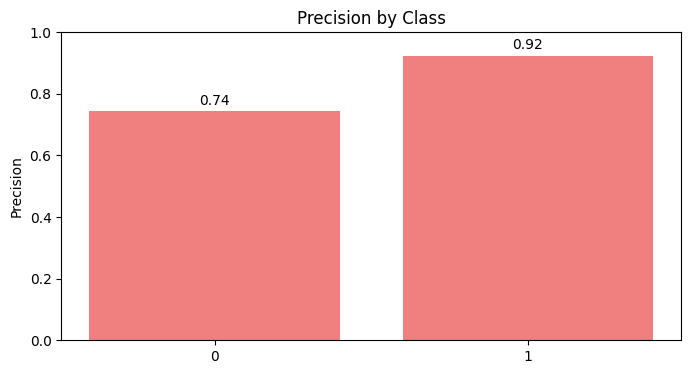

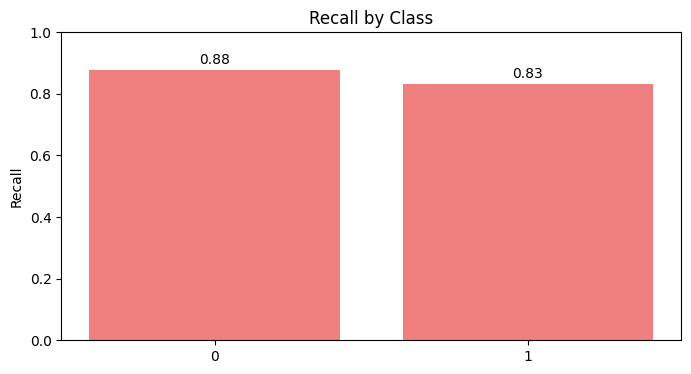

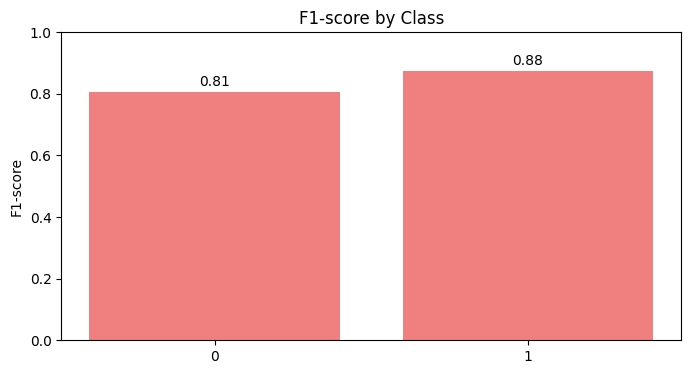

Scenario dataset_scenario_6_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_6_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_6_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8652
  Recall: 0.8641
  F1 Score: 0.8644

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8809
  Recall: 0.8696
  F1 Score: 0.8715

Confusion Matrix (Test Set):
[[30  3]
 [ 9 50]]


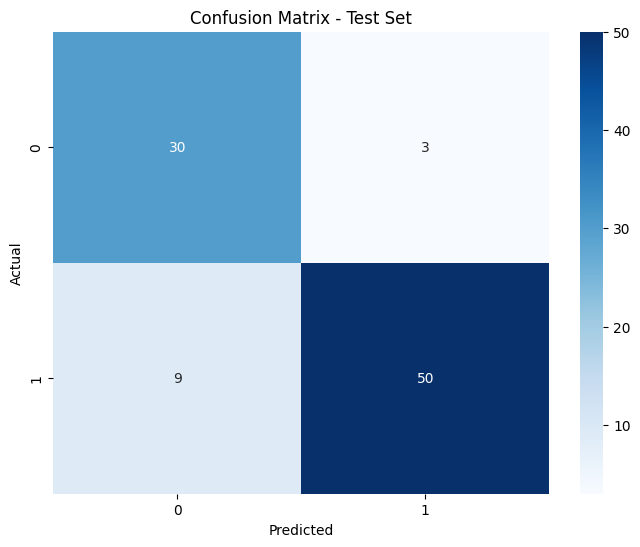

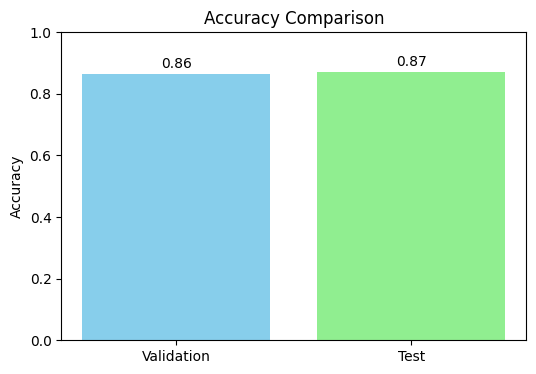

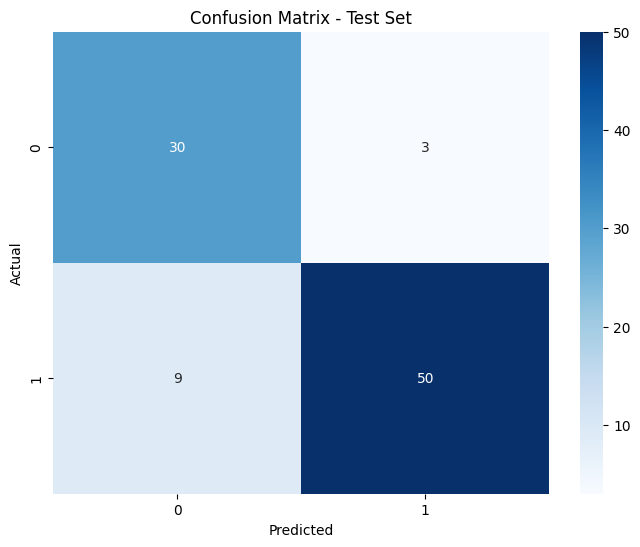

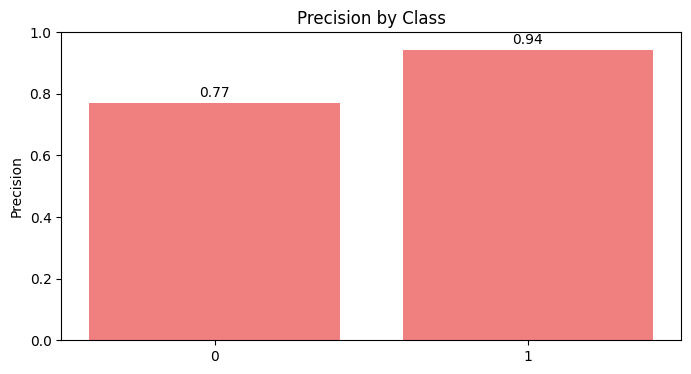

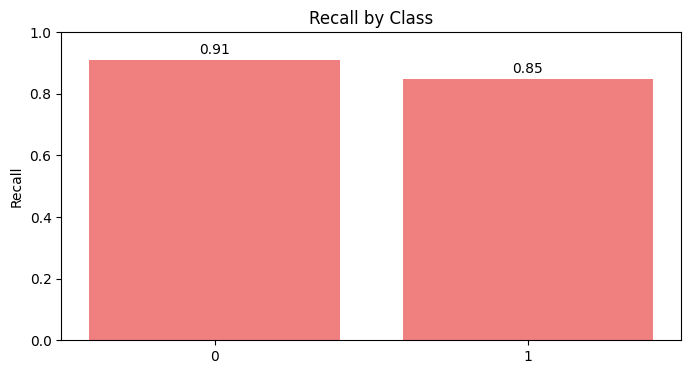

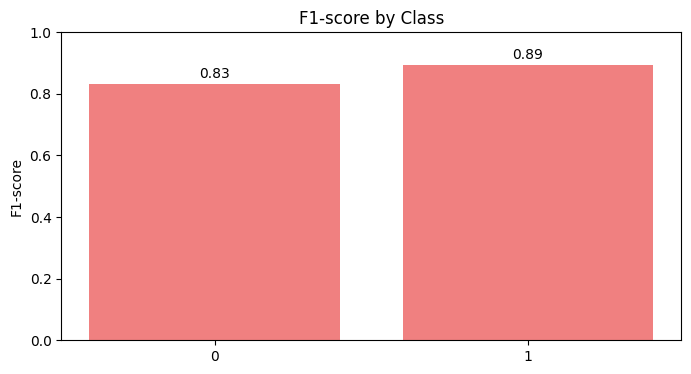

Scenario dataset_scenario_6_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with grid for dataset_scenario_7_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_7_N
Best hyperparameters:  {'metric': 'euclidean', 'n_neighbors': 5, 'weights': 'uniform'}
Validation Metrics:
  Accuracy: 0.8214
  Precision: 0.8243
  Recall: 0.8214
  F1 Score: 0.8218

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8441
  Recall: 0.8310
  F1 Score: 0.8316

Confusion Matrix (Test Set):
[[31  9]
 [ 3 28]]


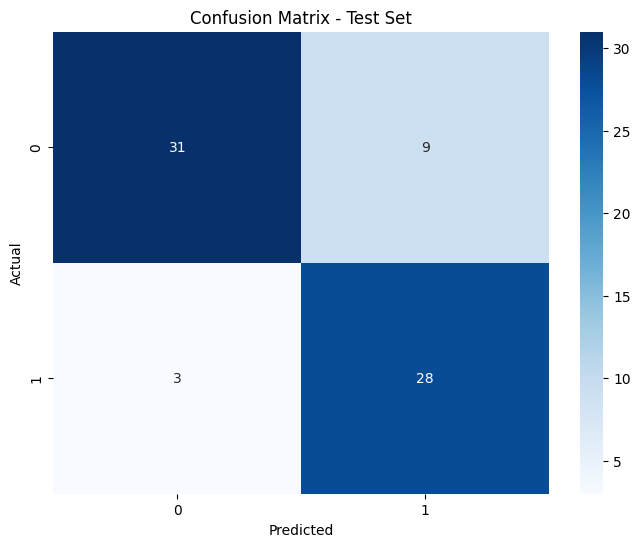

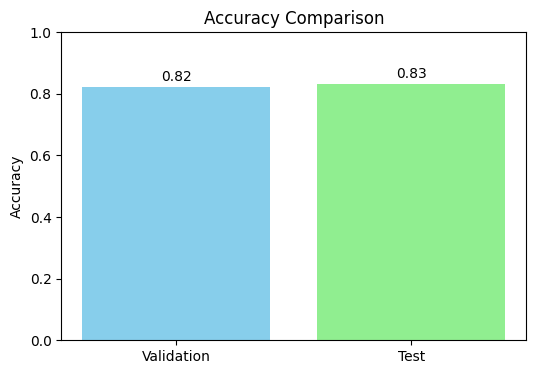

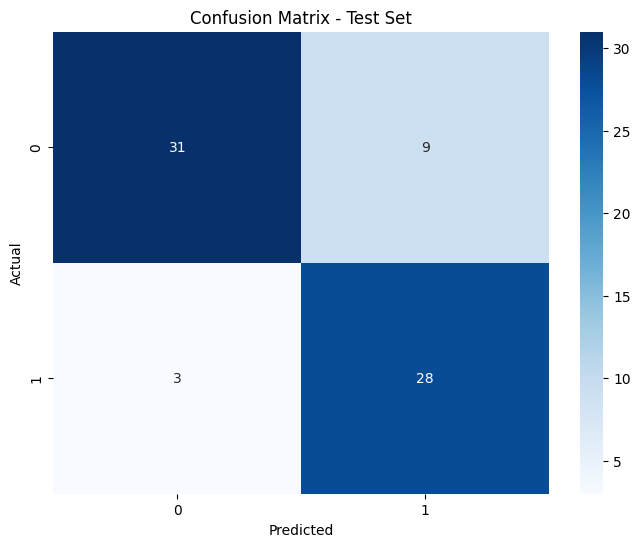

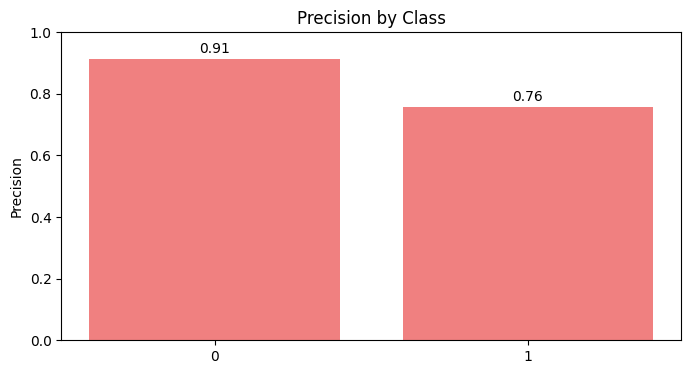

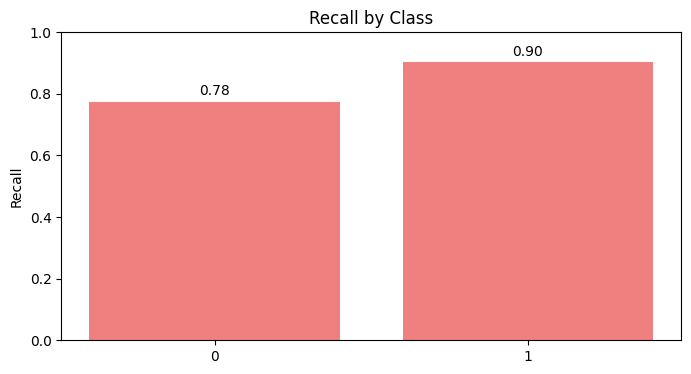

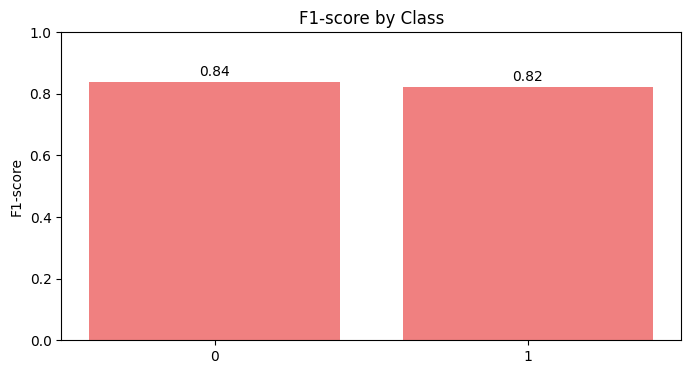

Scenario dataset_scenario_7_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_7_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_7_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8513
  Recall: 0.8500
  F1 Score: 0.8503

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8376
  Recall: 0.8310
  F1 Score: 0.8317

Confusion Matrix (Test Set):
[[32  8]
 [ 4 27]]


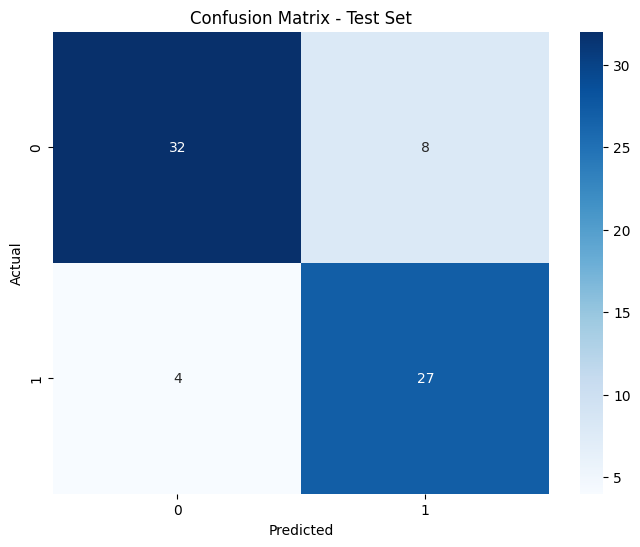

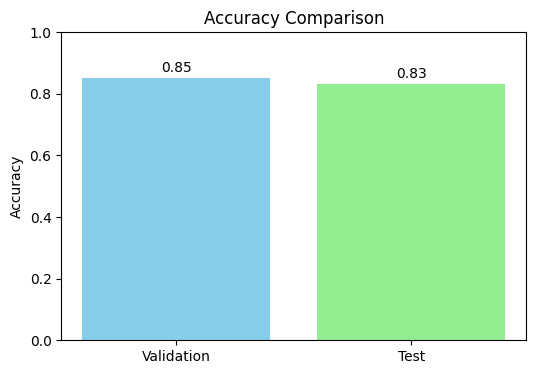

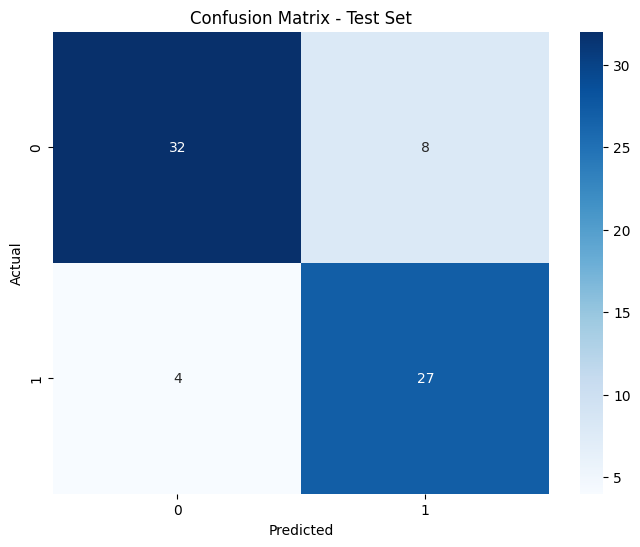

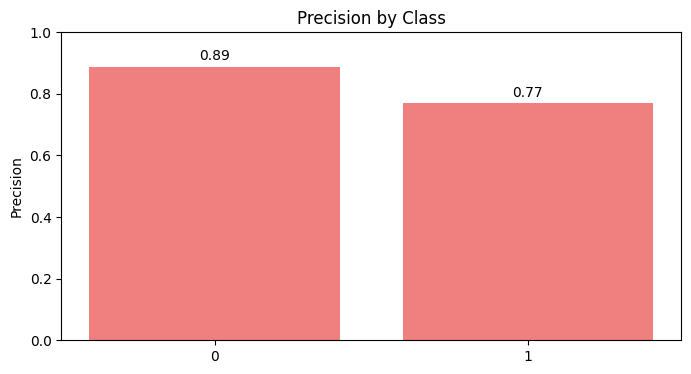

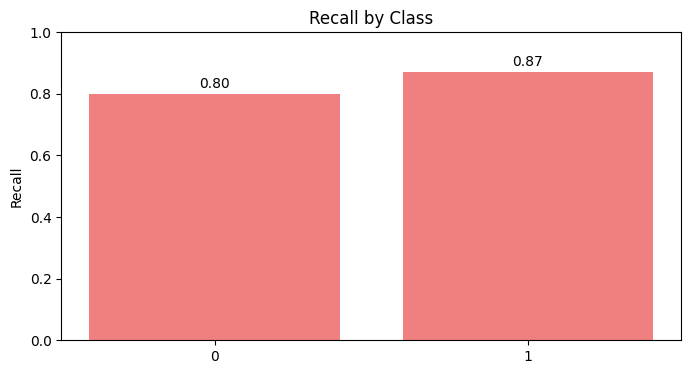

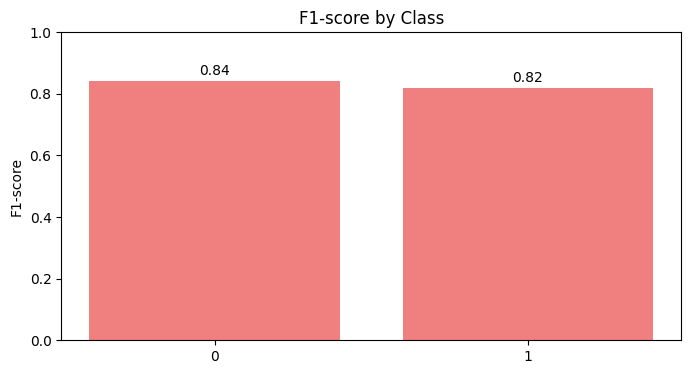

Scenario dataset_scenario_7_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with grid for dataset_scenario_8_N...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_8_N
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8701
  Recall: 0.8696
  F1 Score: 0.8698

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


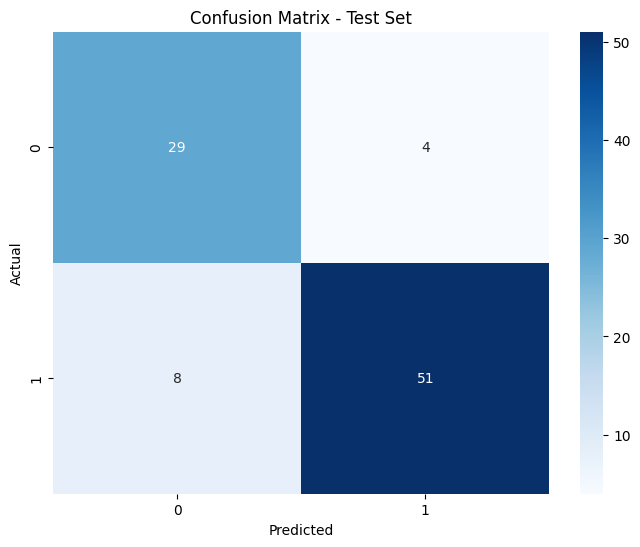

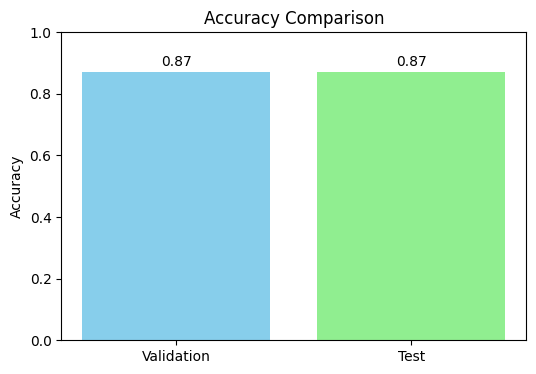

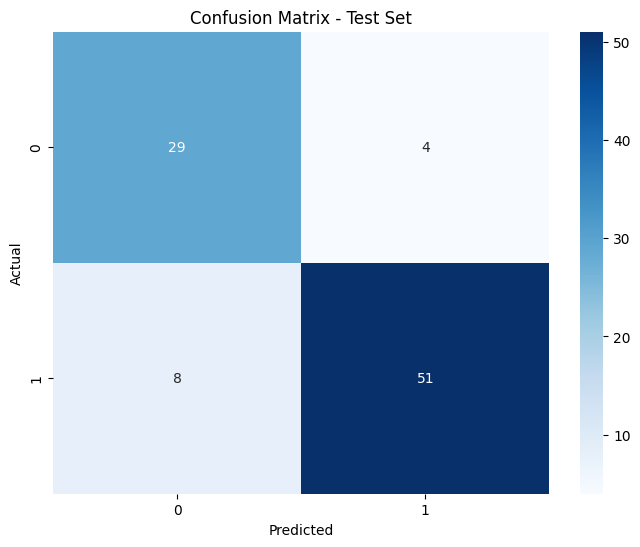

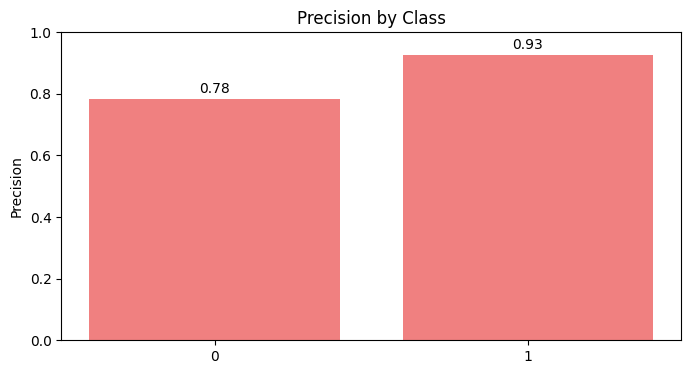

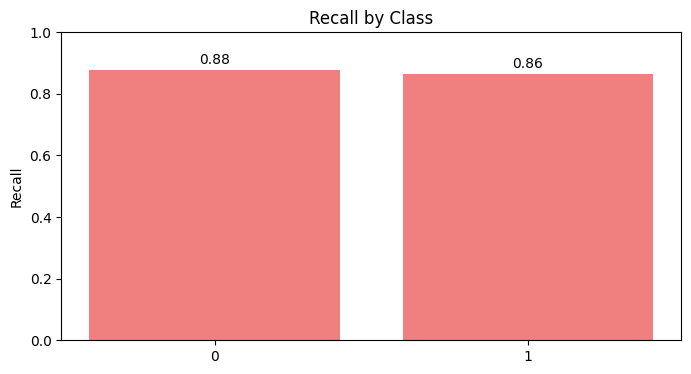

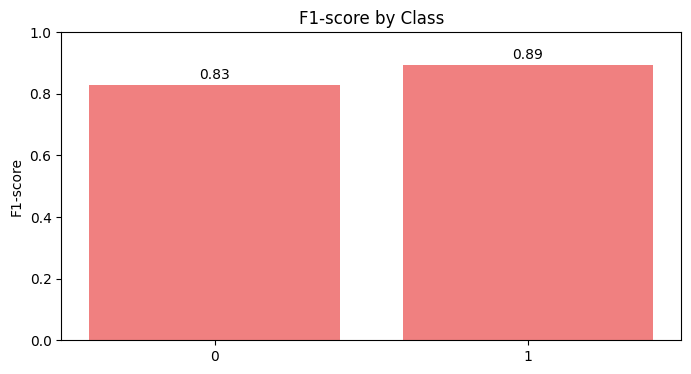

Scenario dataset_scenario_8_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with grid for dataset_scenario_8_S...
Results will be saved in: SCORES\KNN\grid\dataset_scenario_8_S
Best hyperparameters:  {'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'distance'}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


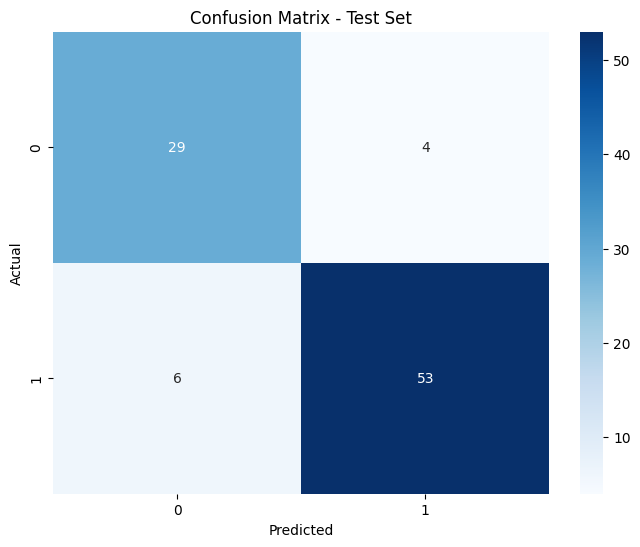

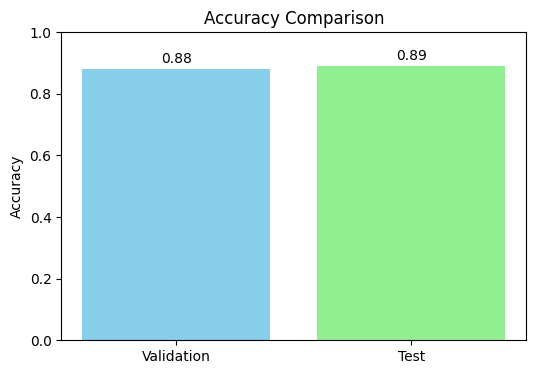

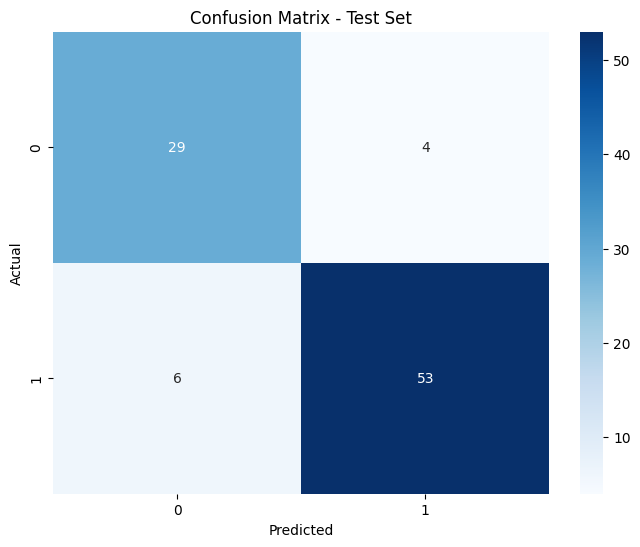

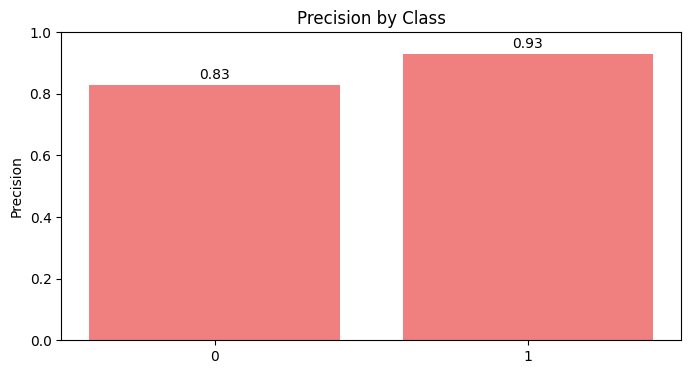

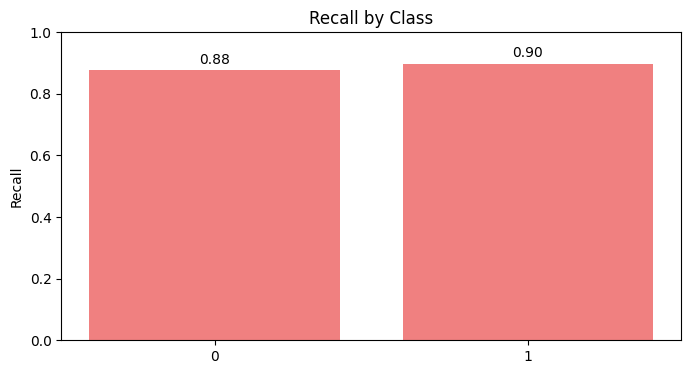

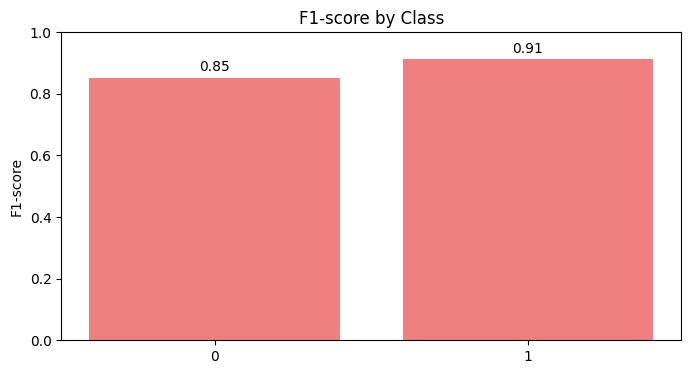

Scenario dataset_scenario_8_S with grid completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


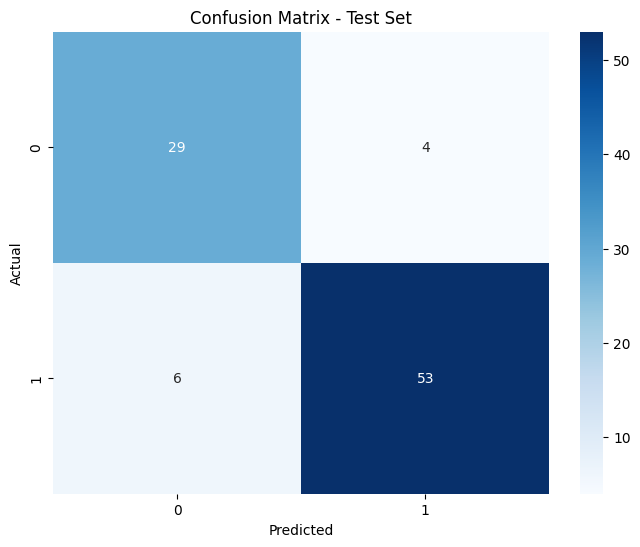

In [63]:
KNN_grid_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "KNN", "grid", search_config_grid, get_search_hyperparameters("KNN"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        KNN_grid_search['accuracy'] = best_score
        KNN_grid_search['params'] = best_params
        KNN_grid_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
knn = KNeighborsClassifier(**KNN_grid_search['params'])
best_scenario = pd.read_csv(KNN_grid_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, knn) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "KNN", "grid")
save_model_info(KNN_grid_search, "KNN", "grid")
    

## 2. Random Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with random for dataset_scenario_1_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_1_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8913
  Recall: 0.8913
  F1 Score: 0.8913

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


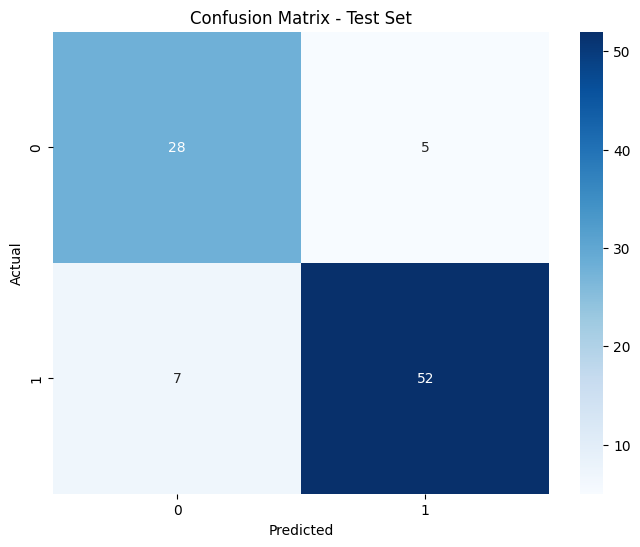

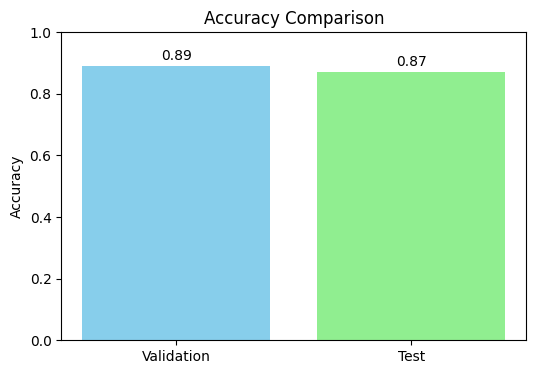

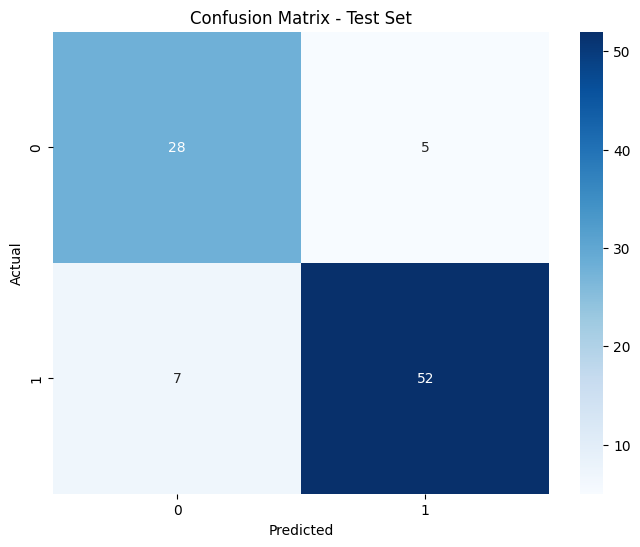

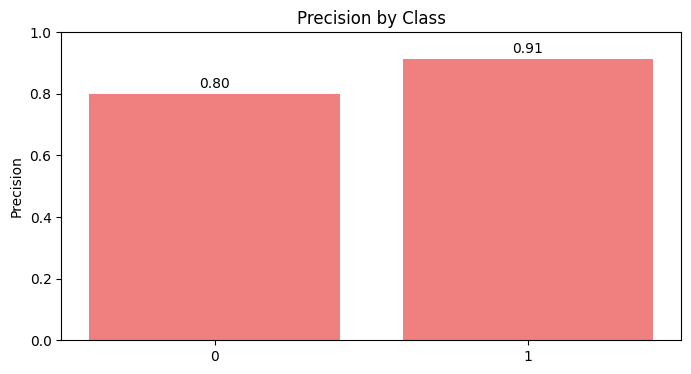

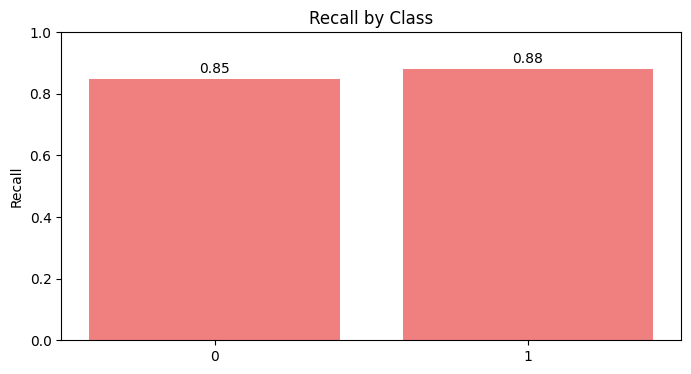

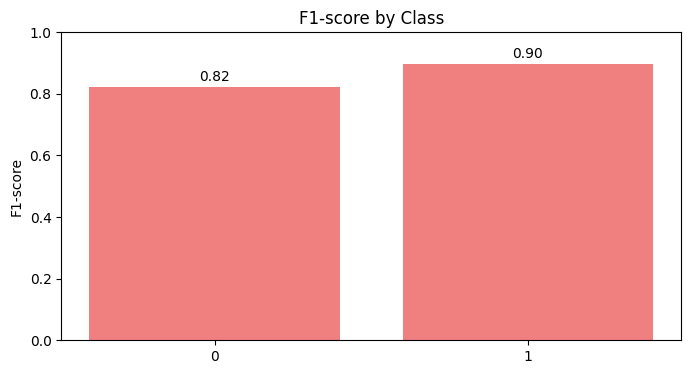

Scenario dataset_scenario_1_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_1_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_1_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8918
  Recall: 0.8913
  F1 Score: 0.8915

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


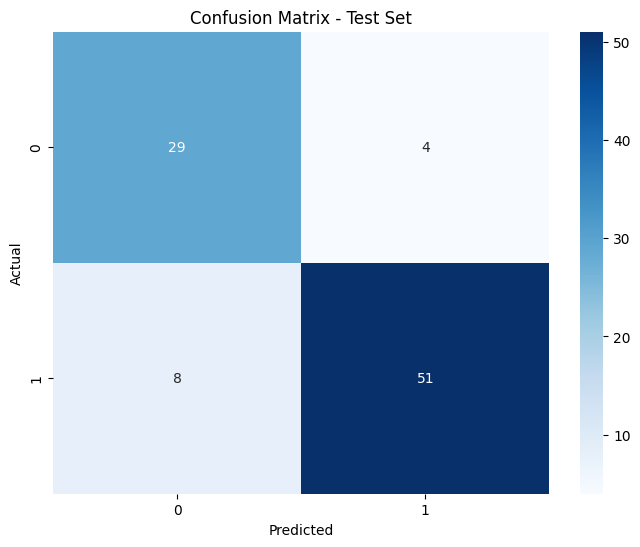

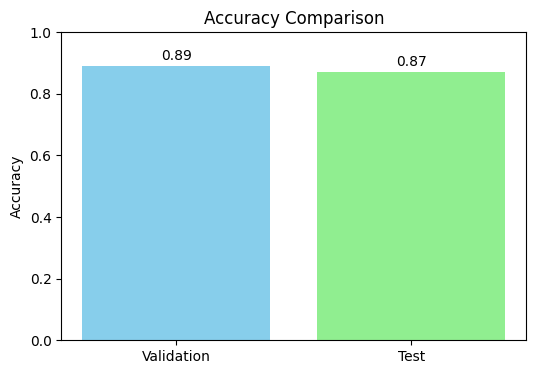

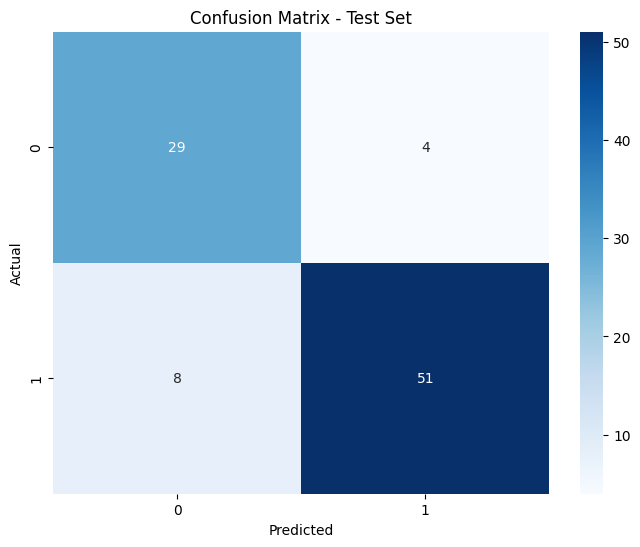

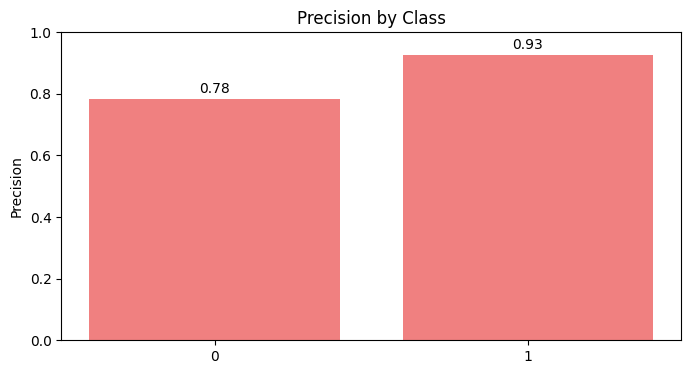

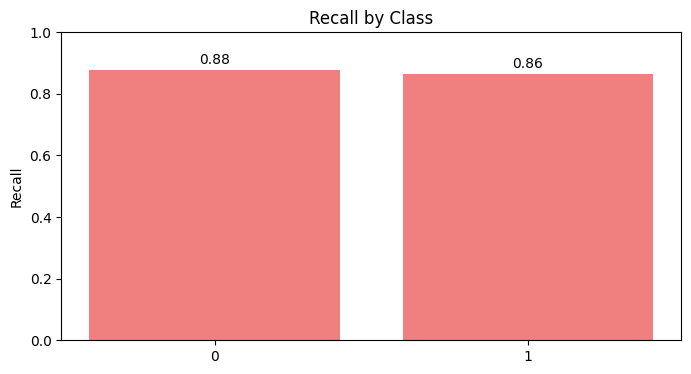

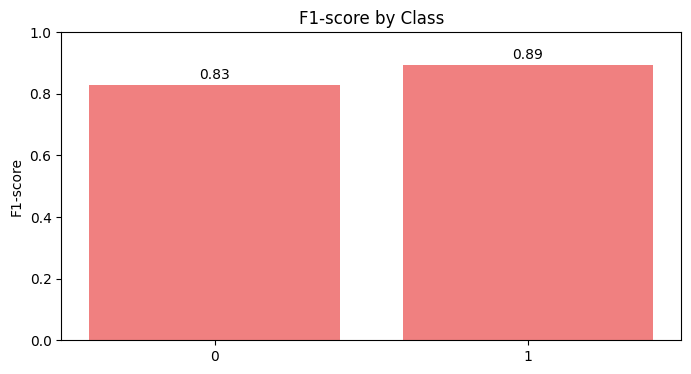

Scenario dataset_scenario_1_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running KNN with random for dataset_scenario_2_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_2_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 9, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8424
  Precision: 0.8427
  Recall: 0.8424
  F1 Score: 0.8425

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


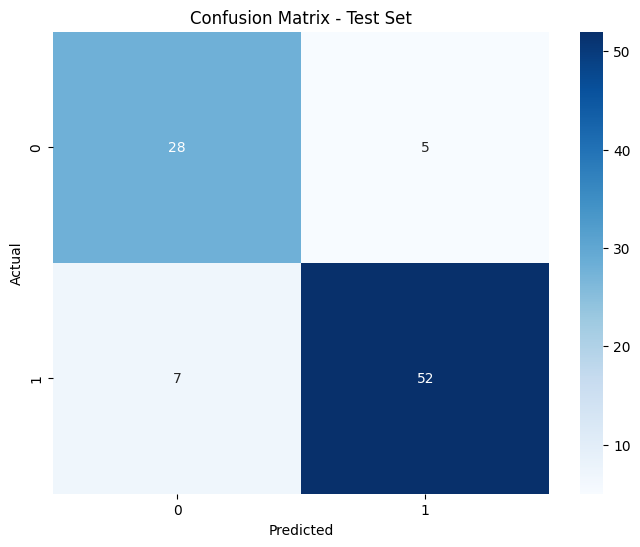

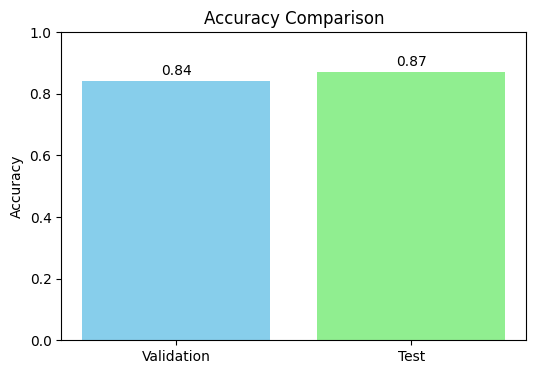

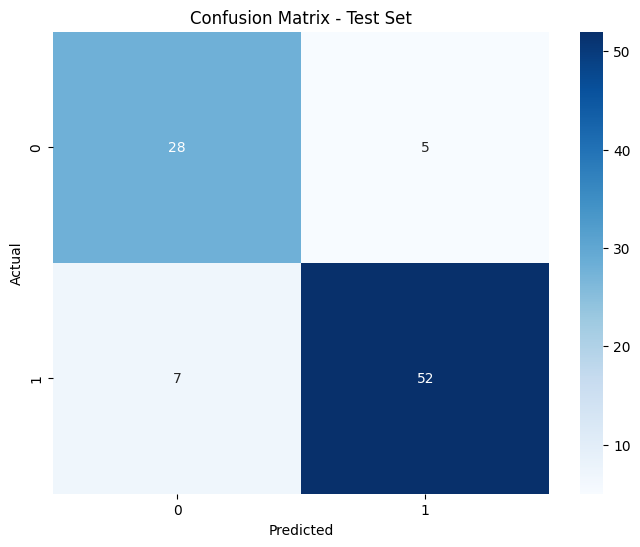

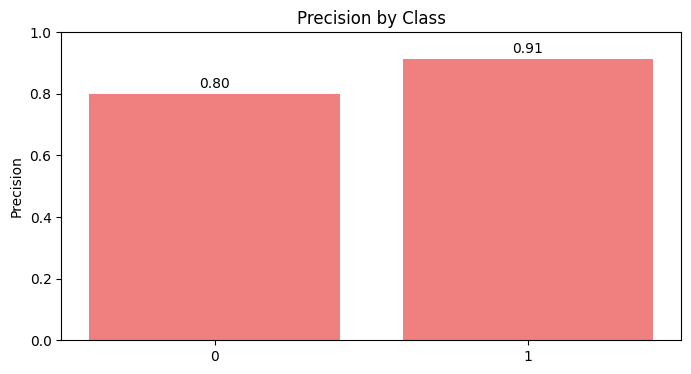

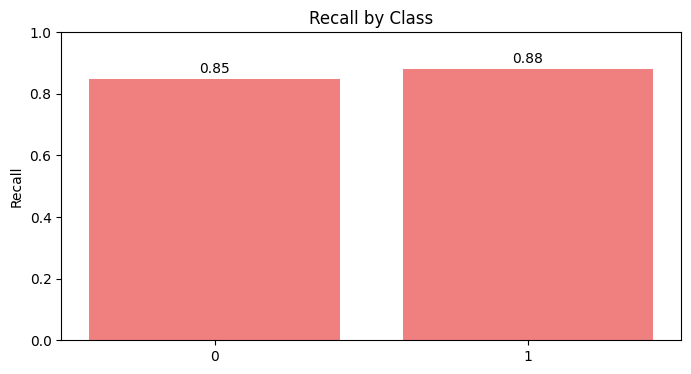

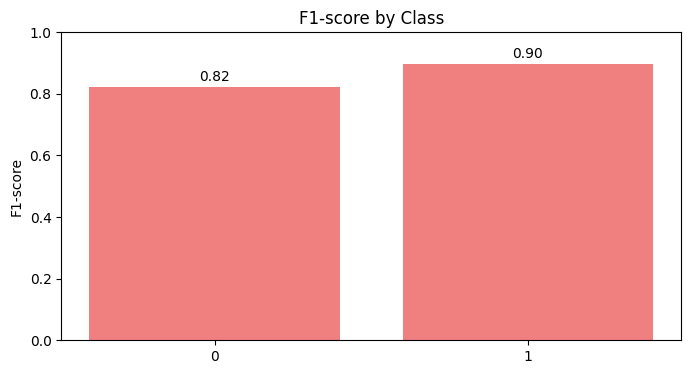

Scenario dataset_scenario_2_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running KNN with random for dataset_scenario_2_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_2_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8913
  Recall: 0.8913
  F1 Score: 0.8913

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


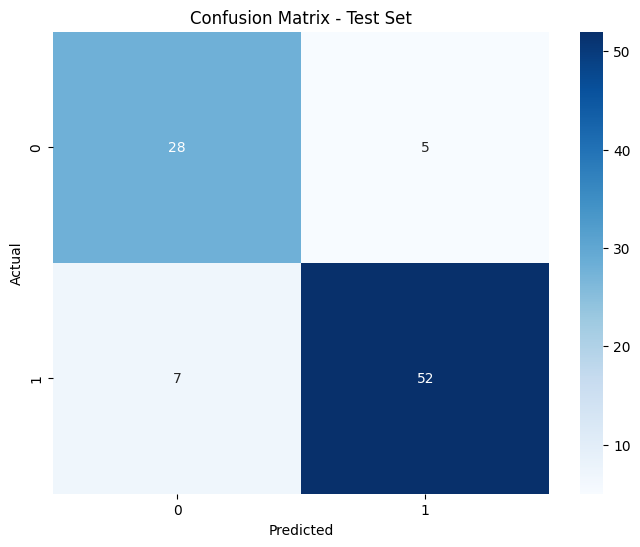

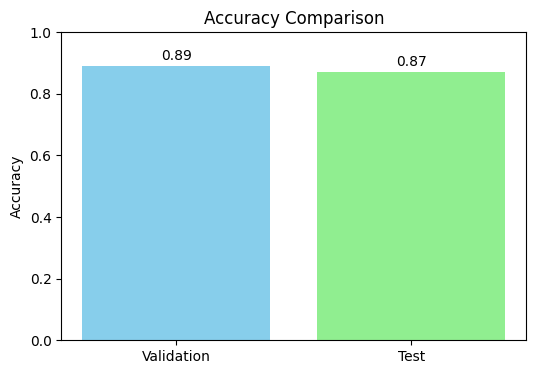

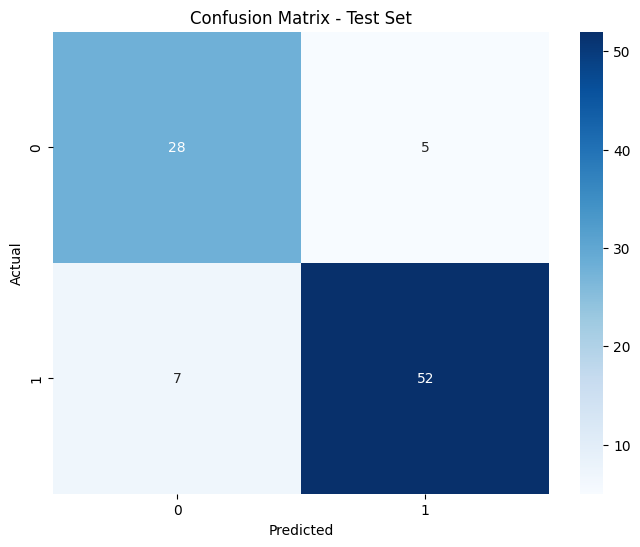

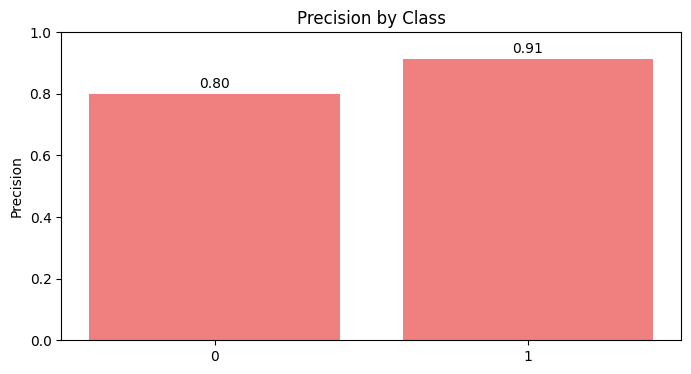

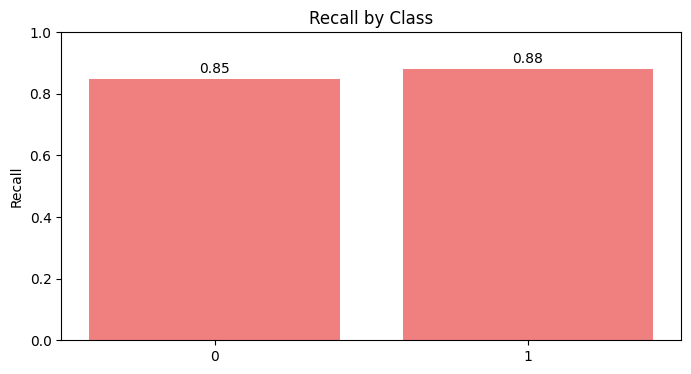

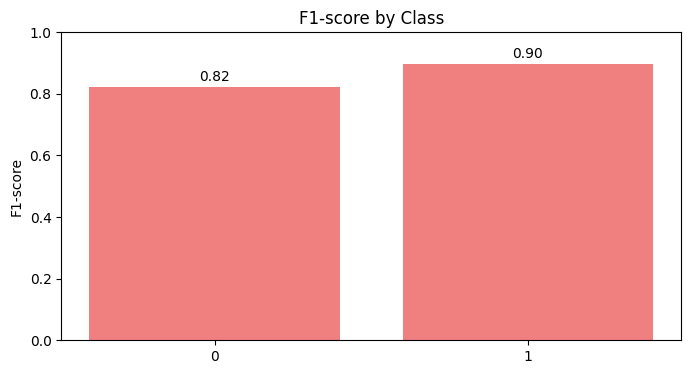

Scenario dataset_scenario_2_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with random for dataset_scenario_3_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_3_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 5, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8503
  Recall: 0.8500
  F1 Score: 0.8501

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8441
  Recall: 0.8310
  F1 Score: 0.8316

Confusion Matrix (Test Set):
[[31  9]
 [ 3 28]]


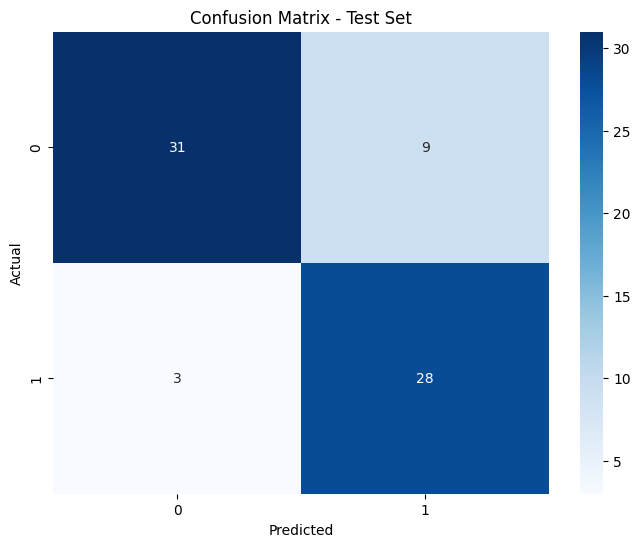

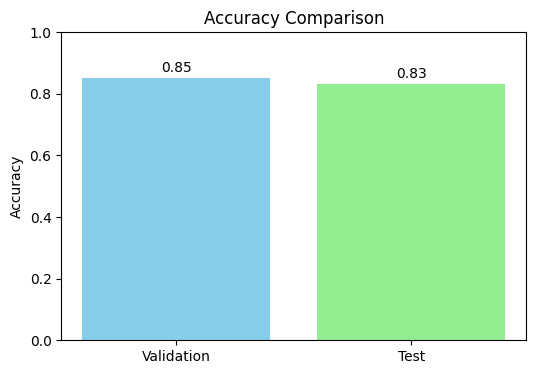

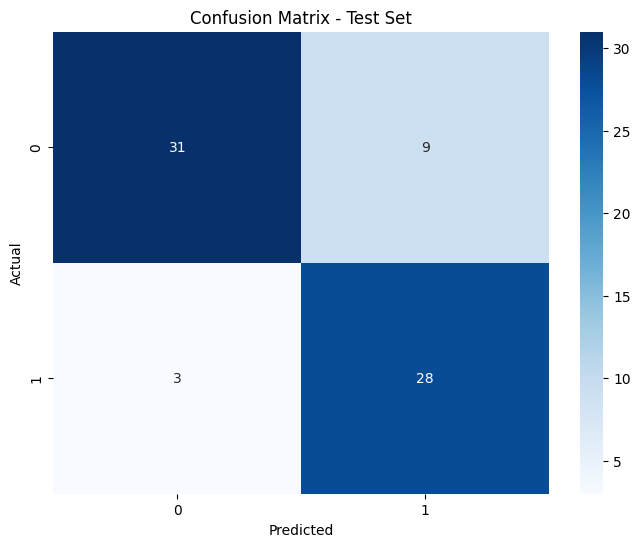

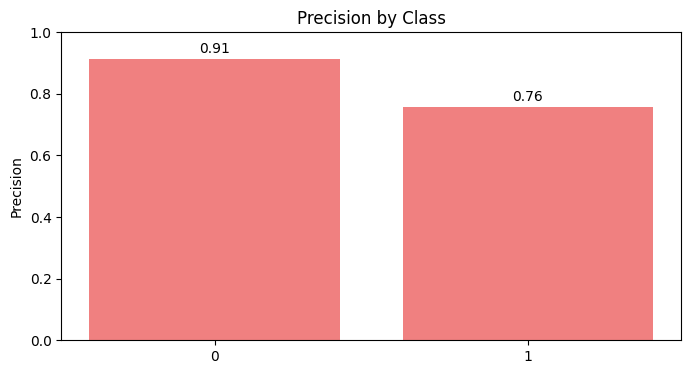

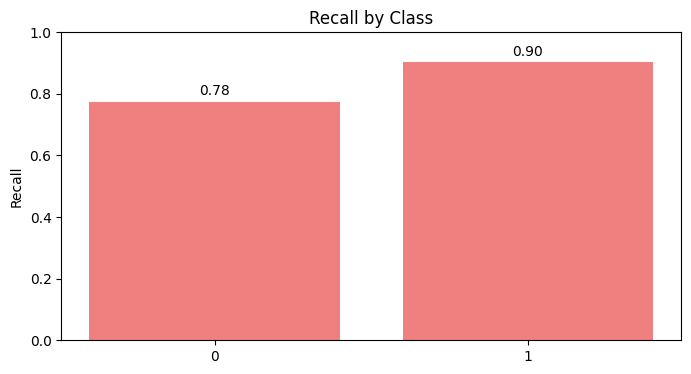

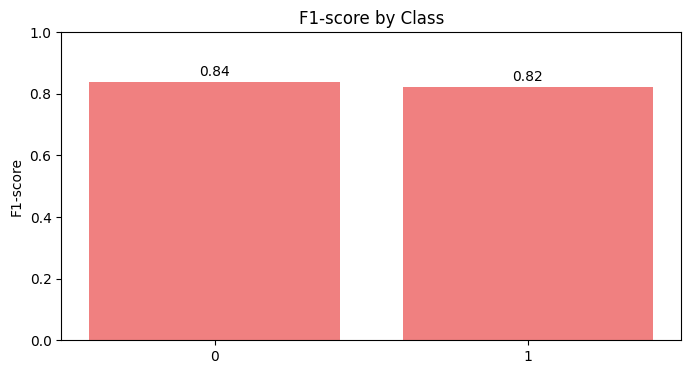

Scenario dataset_scenario_3_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_3_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_3_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 9, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8646
  Recall: 0.8643
  F1 Score: 0.8644

Test Metrics:
  Accuracy: 0.8451
  Precision: 0.8547
  Recall: 0.8451
  F1 Score: 0.8457

Confusion Matrix (Test Set):
[[32  8]
 [ 3 28]]


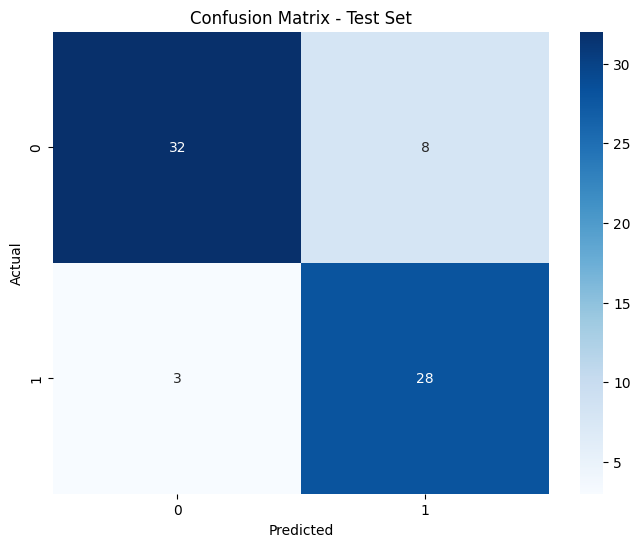

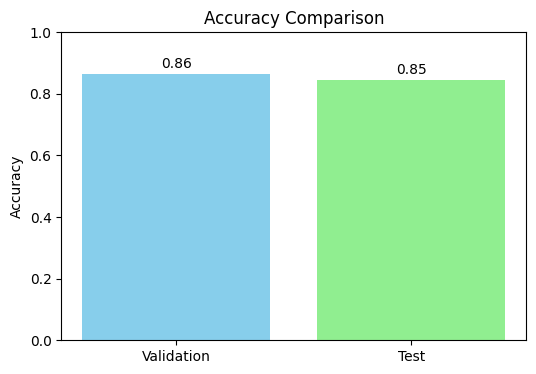

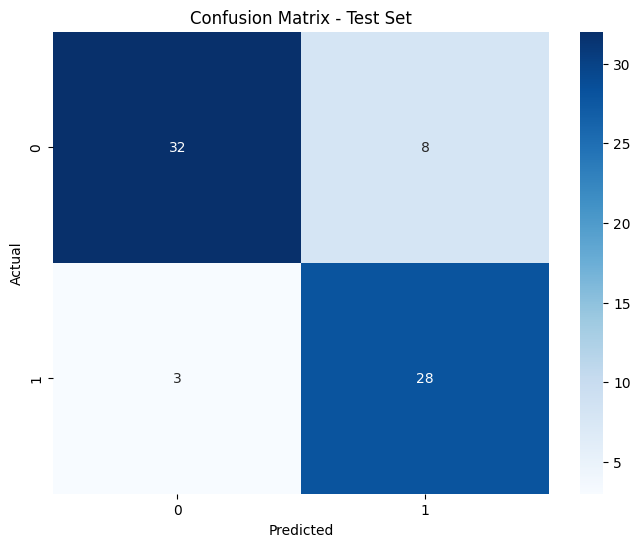

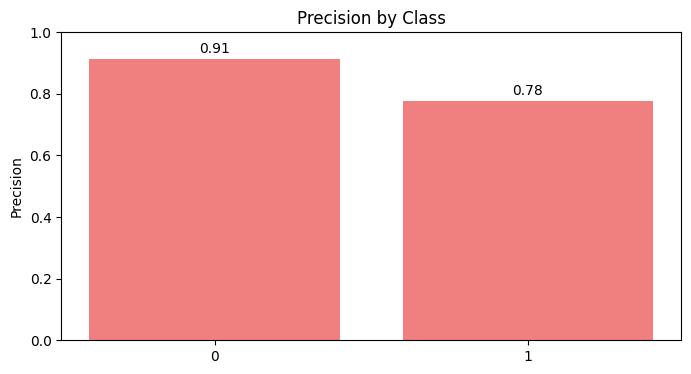

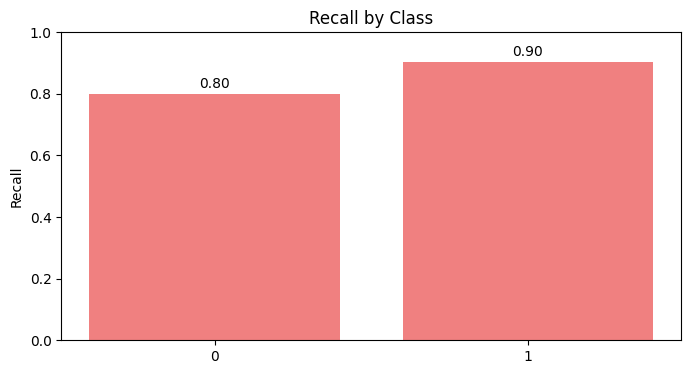

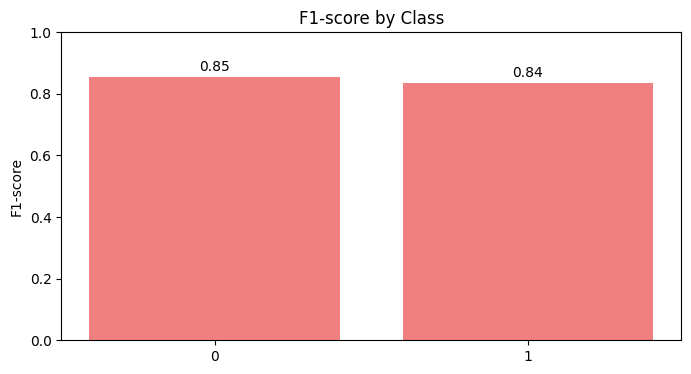

Scenario dataset_scenario_3_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with random for dataset_scenario_4_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_4_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8531
  Recall: 0.8533
  F1 Score: 0.8531

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


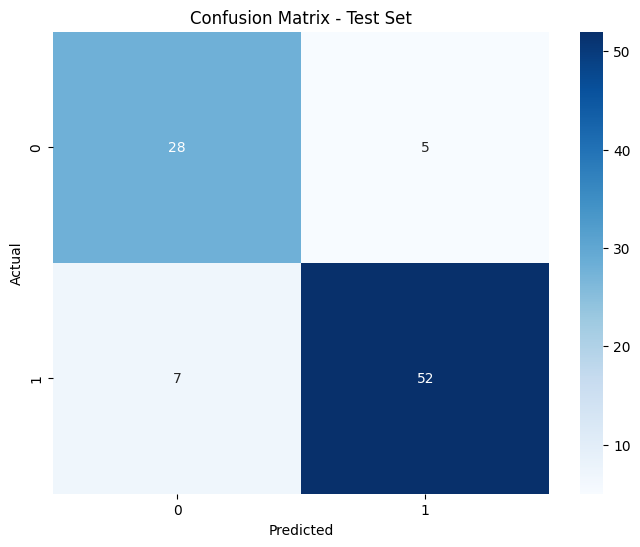

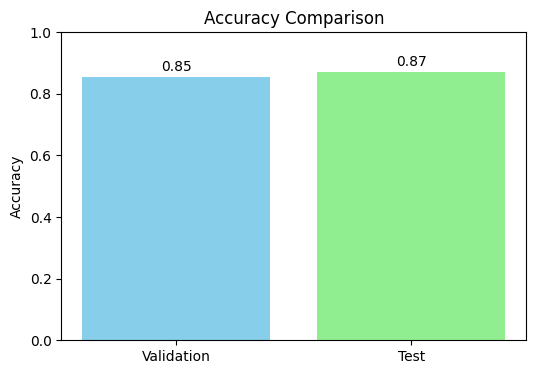

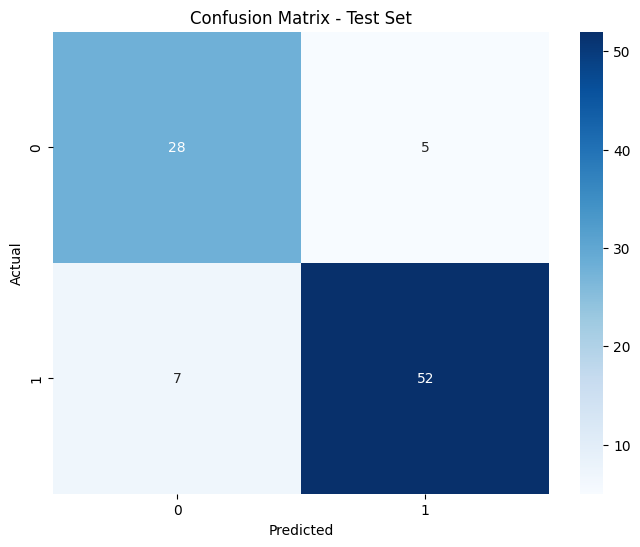

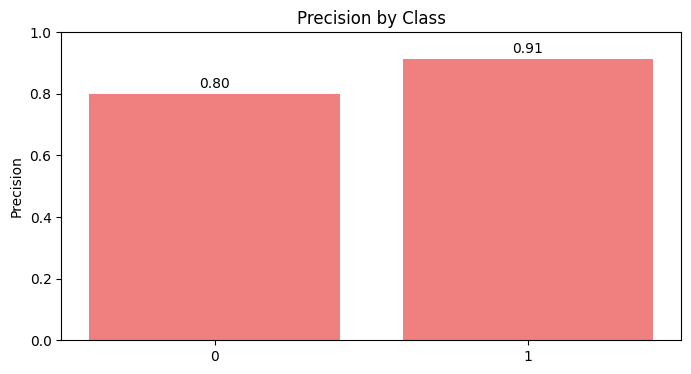

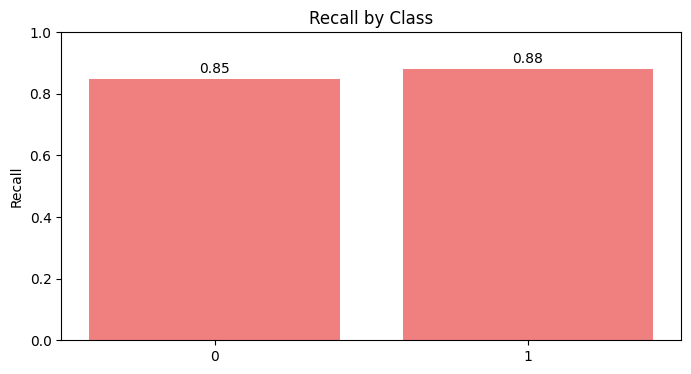

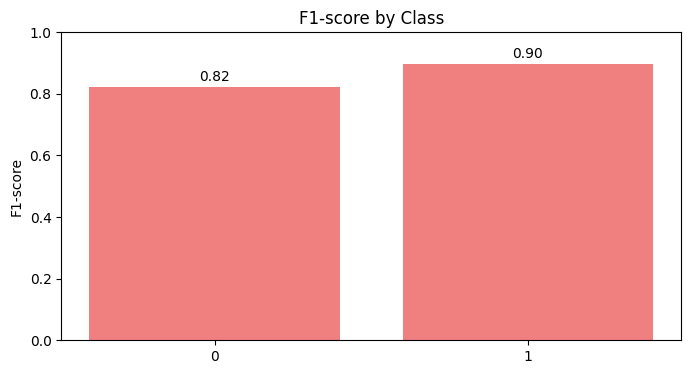

Scenario dataset_scenario_4_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_4_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_4_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8857
  Recall: 0.8859
  F1 Score: 0.8858

Test Metrics:
  Accuracy: 0.8587
  Precision: 0.8630
  Recall: 0.8587
  F1 Score: 0.8599

Confusion Matrix (Test Set):
[[28  5]
 [ 8 51]]


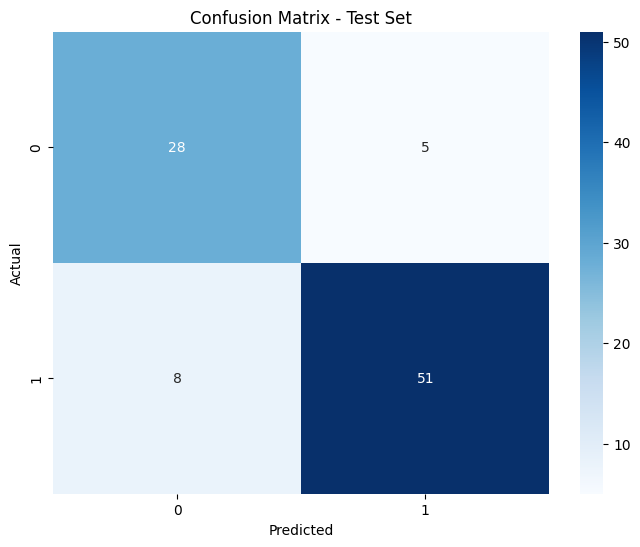

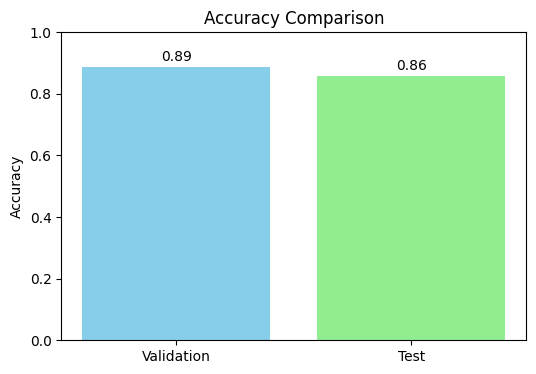

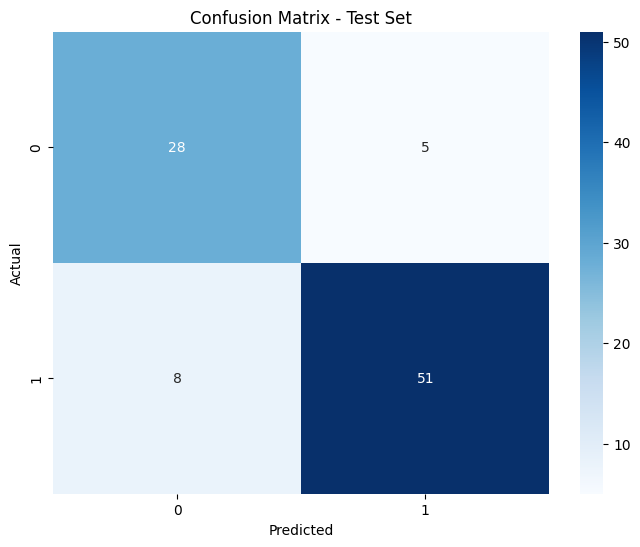

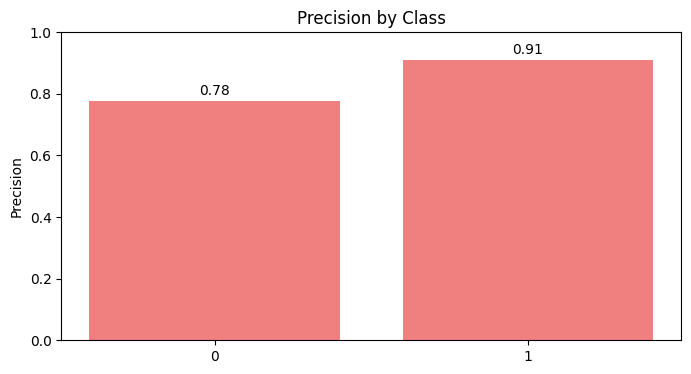

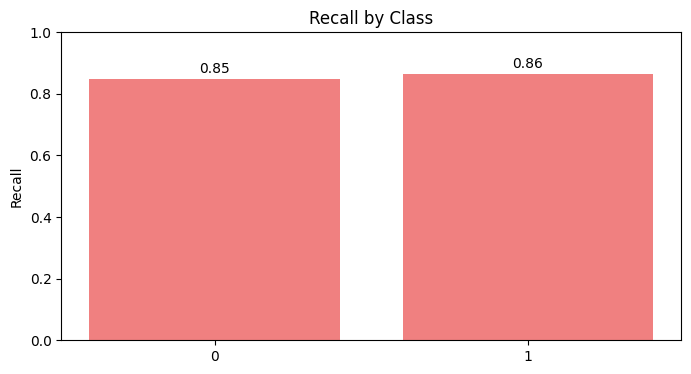

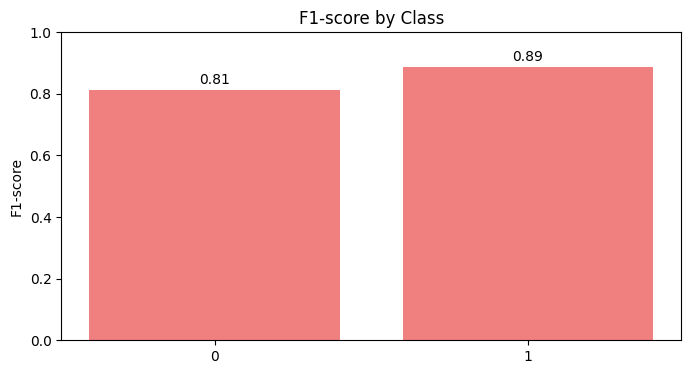

Scenario dataset_scenario_4_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with random for dataset_scenario_5_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_5_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 5, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8785
  Recall: 0.8750
  F1 Score: 0.8755

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8596
  Recall: 0.8478
  F1 Score: 0.8501

Confusion Matrix (Test Set):
[[29  4]
 [10 49]]


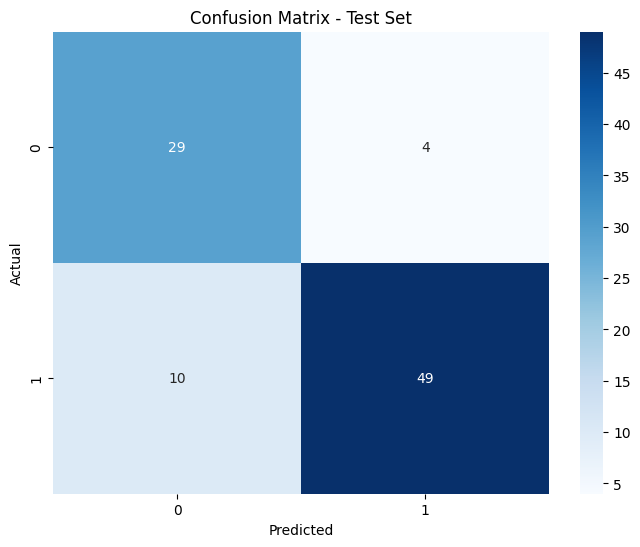

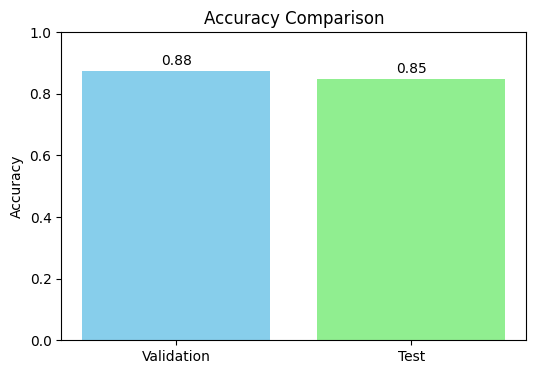

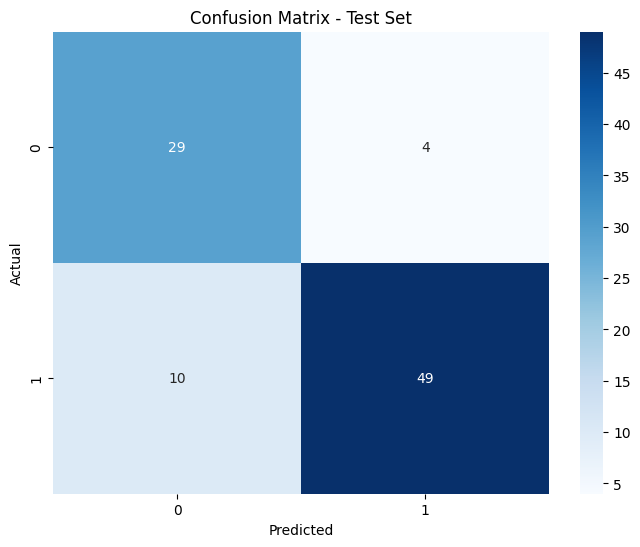

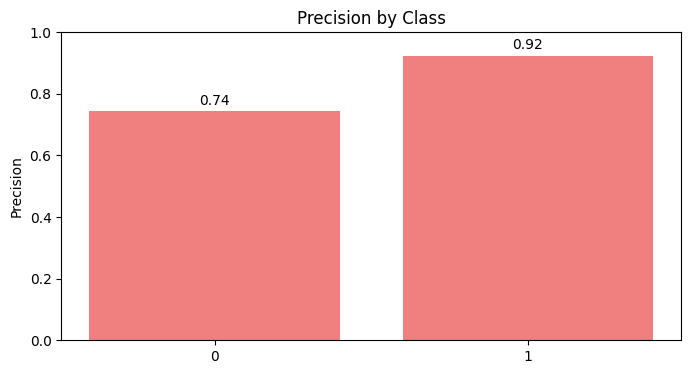

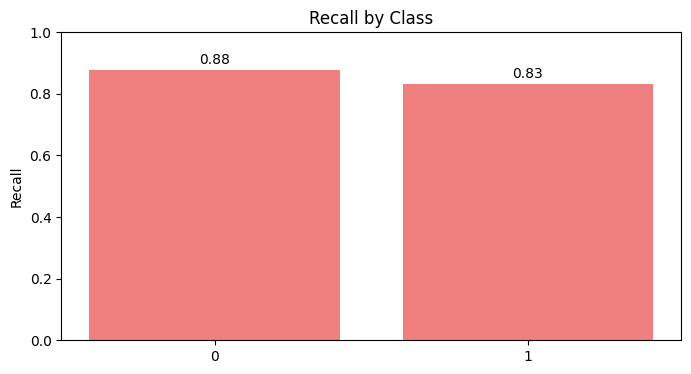

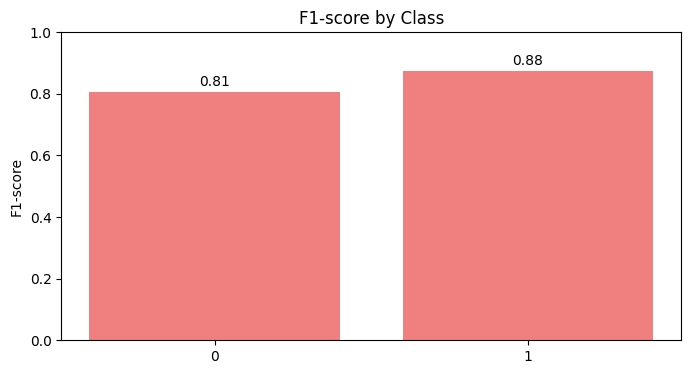

Scenario dataset_scenario_5_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_5_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_5_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8940
  Recall: 0.8913
  F1 Score: 0.8917

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8889
  Recall: 0.8804
  F1 Score: 0.8820

Confusion Matrix (Test Set):
[[30  3]
 [ 8 51]]


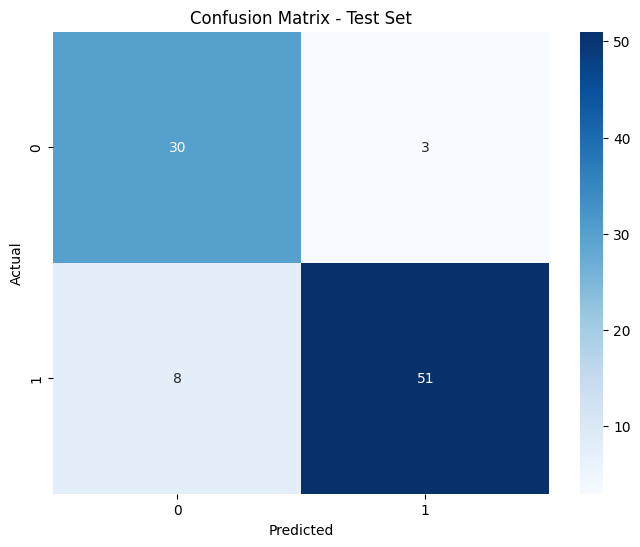

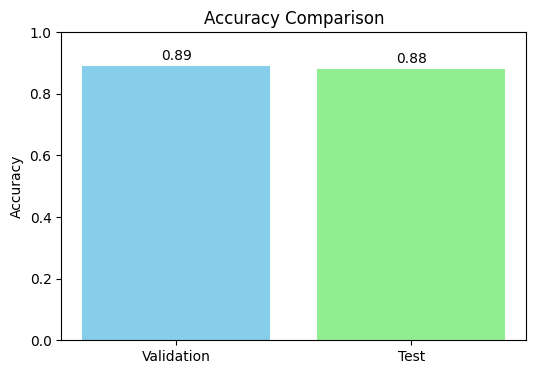

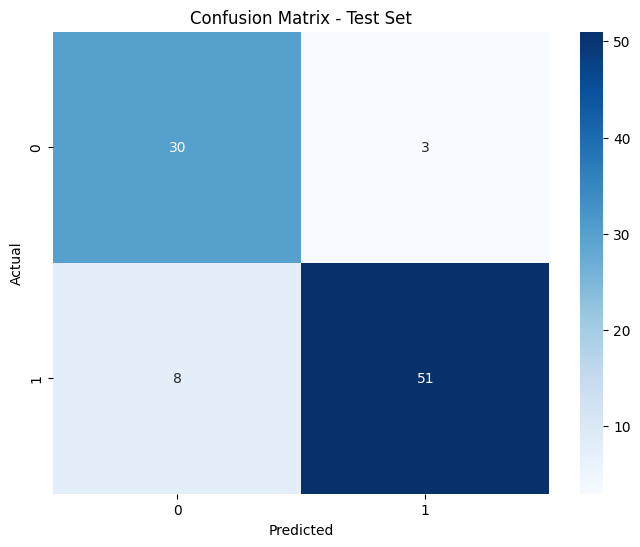

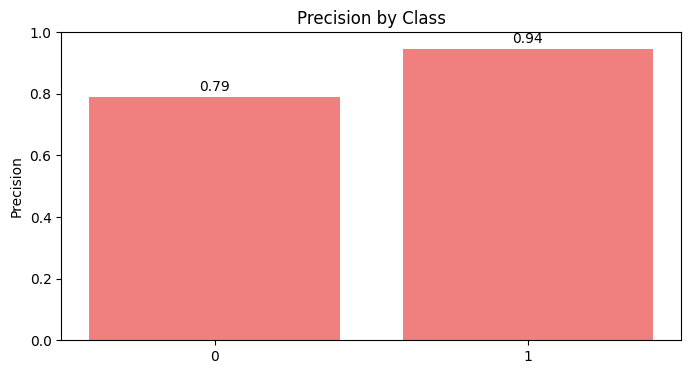

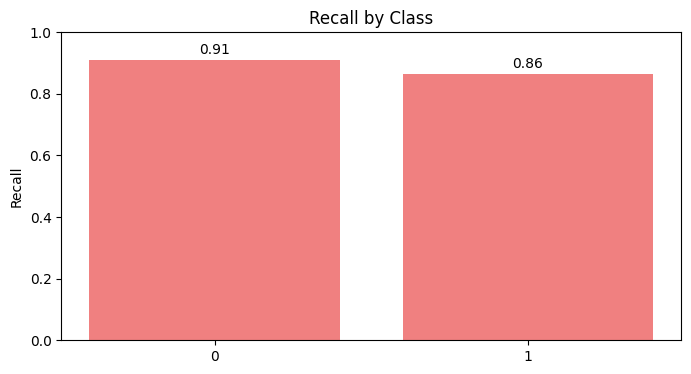

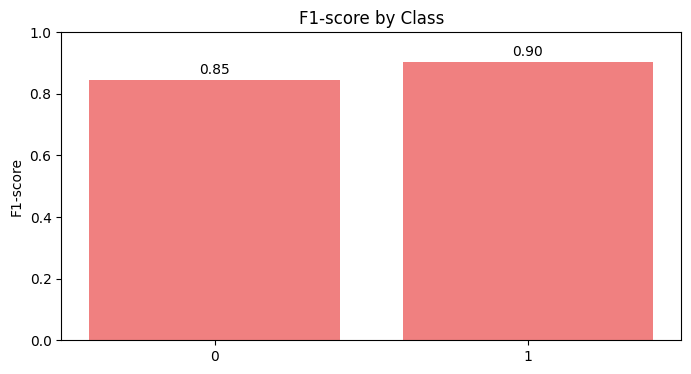

Scenario dataset_scenario_5_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with random for dataset_scenario_6_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_6_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 5, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8587
  Precision: 0.8632
  Recall: 0.8587
  F1 Score: 0.8593

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8596
  Recall: 0.8478
  F1 Score: 0.8501

Confusion Matrix (Test Set):
[[29  4]
 [10 49]]


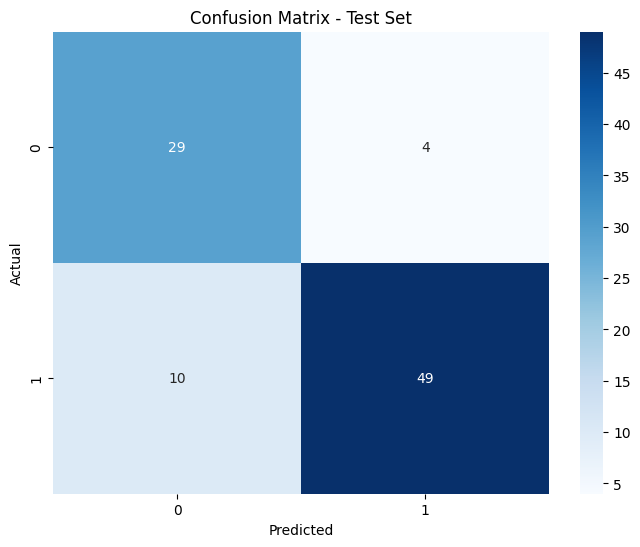

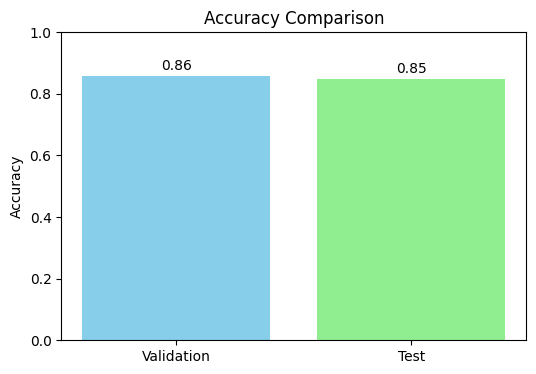

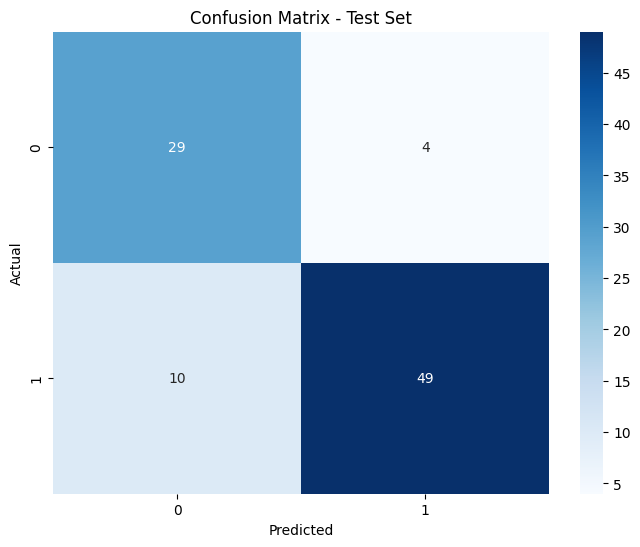

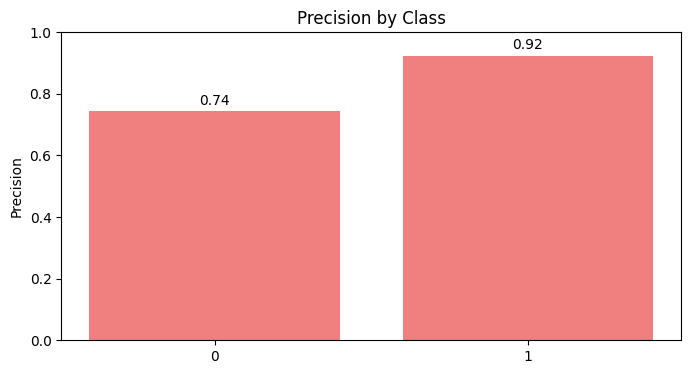

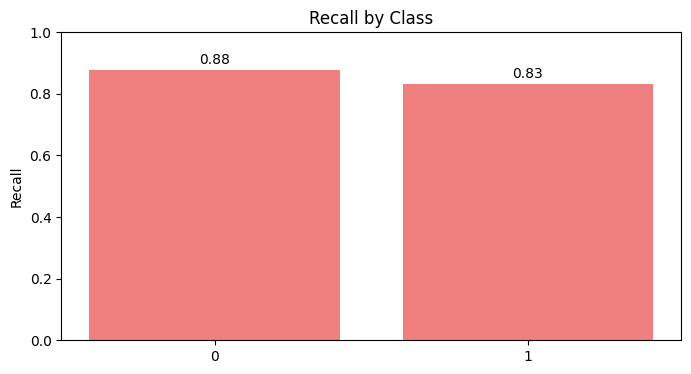

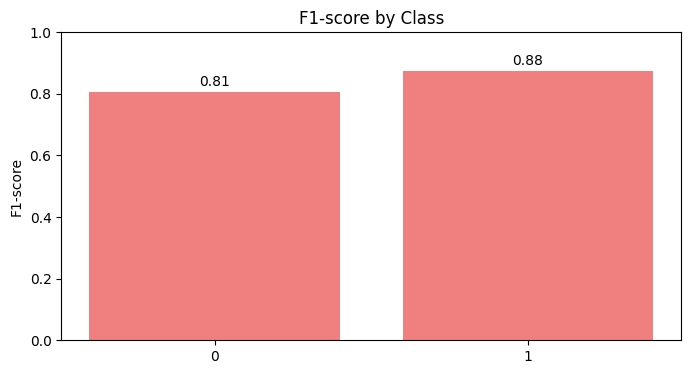

Scenario dataset_scenario_6_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_6_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_6_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 5, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8652
  Recall: 0.8641
  F1 Score: 0.8644

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8809
  Recall: 0.8696
  F1 Score: 0.8715

Confusion Matrix (Test Set):
[[30  3]
 [ 9 50]]


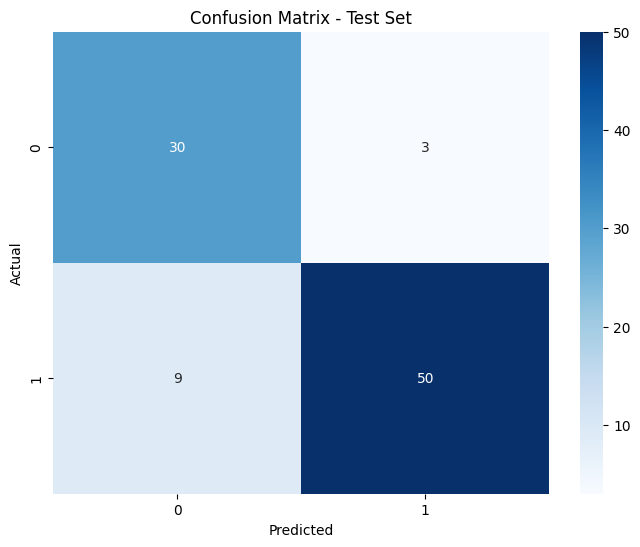

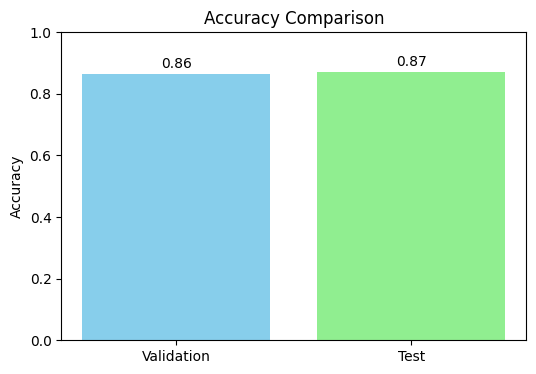

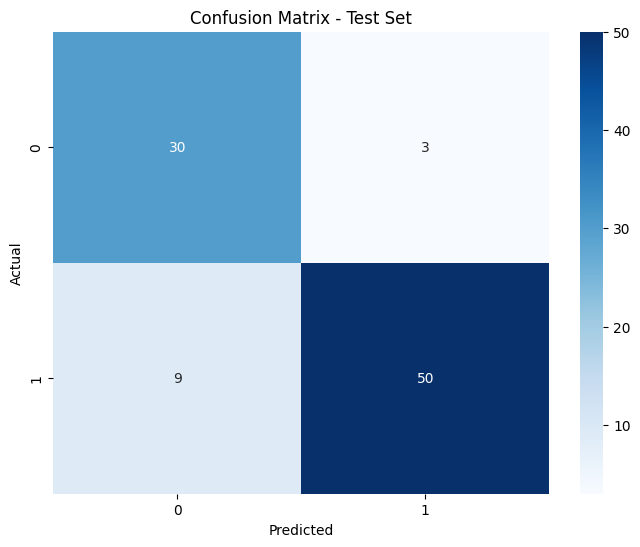

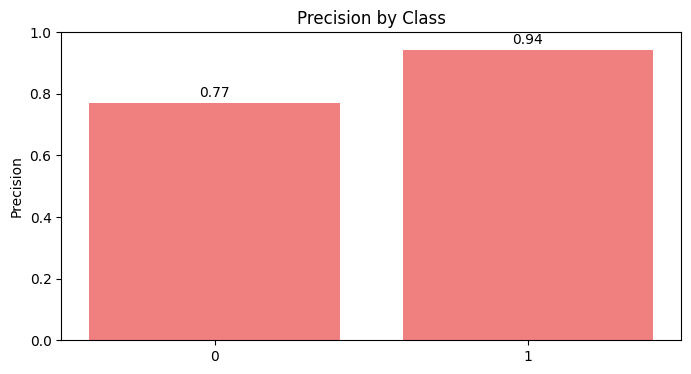

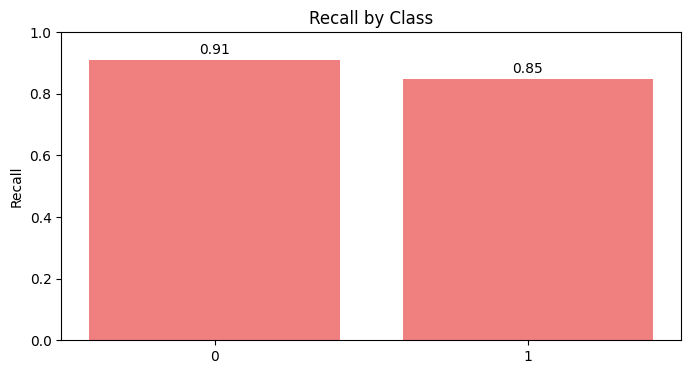

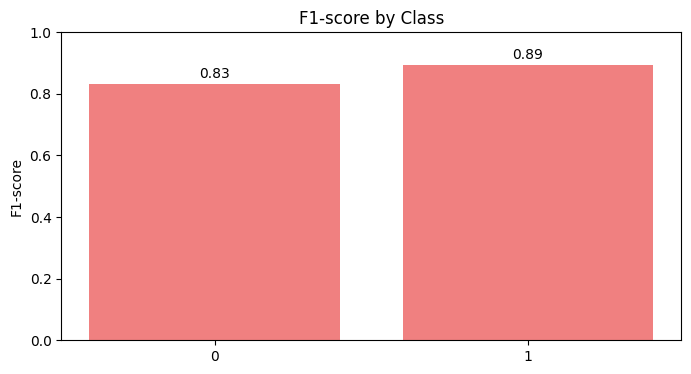

Scenario dataset_scenario_6_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with random for dataset_scenario_7_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_7_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'uniform', 'n_neighbors': 5, 'metric': 'euclidean'}
Validation Metrics:
  Accuracy: 0.8214
  Precision: 0.8243
  Recall: 0.8214
  F1 Score: 0.8218

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8441
  Recall: 0.8310
  F1 Score: 0.8316

Confusion Matrix (Test Set):
[[31  9]
 [ 3 28]]


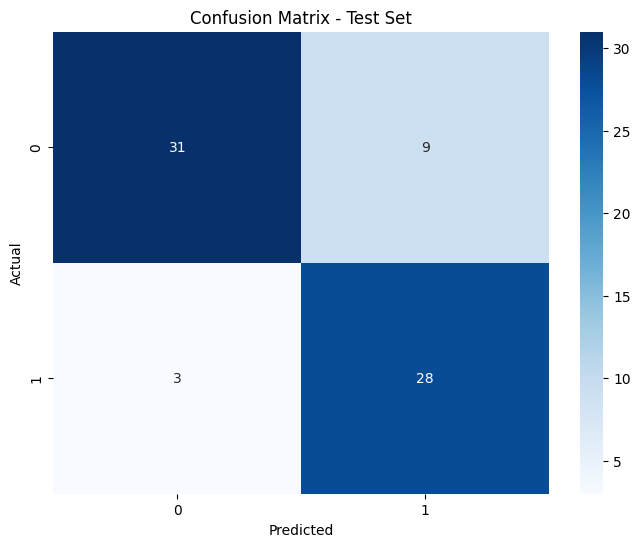

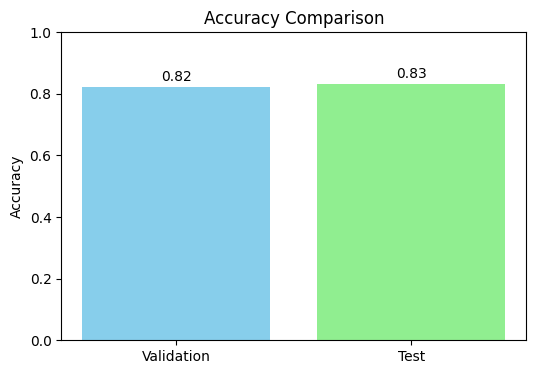

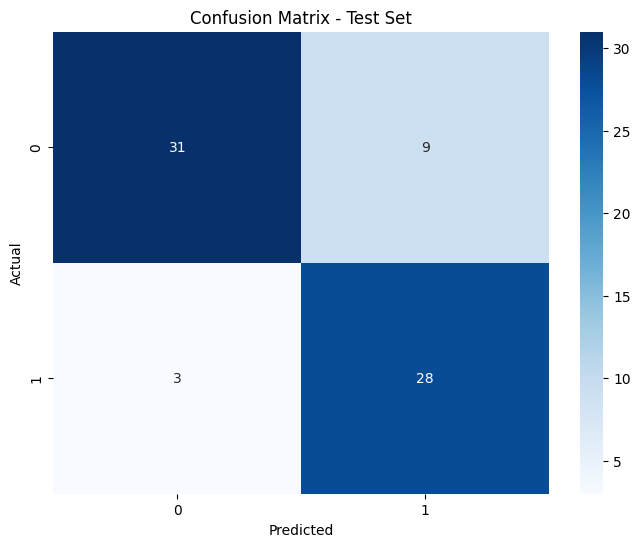

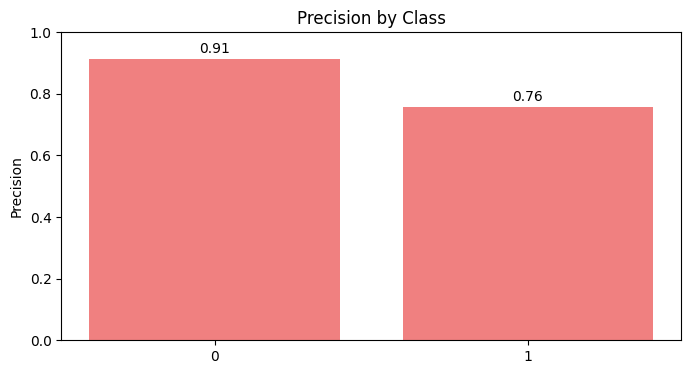

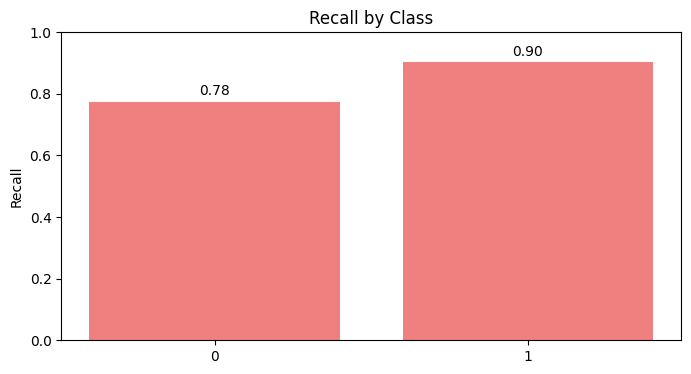

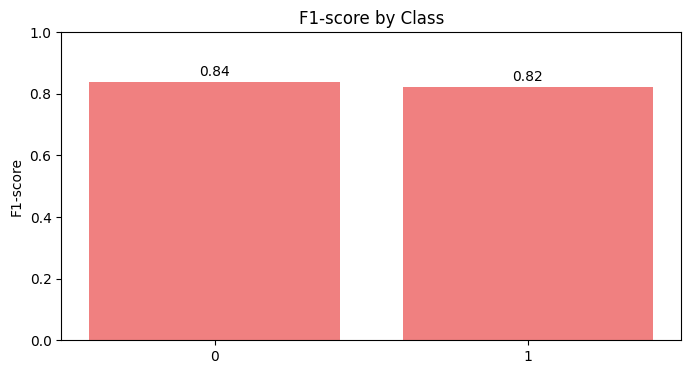

Scenario dataset_scenario_7_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_7_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_7_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 7, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8513
  Recall: 0.8500
  F1 Score: 0.8503

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8376
  Recall: 0.8310
  F1 Score: 0.8317

Confusion Matrix (Test Set):
[[32  8]
 [ 4 27]]


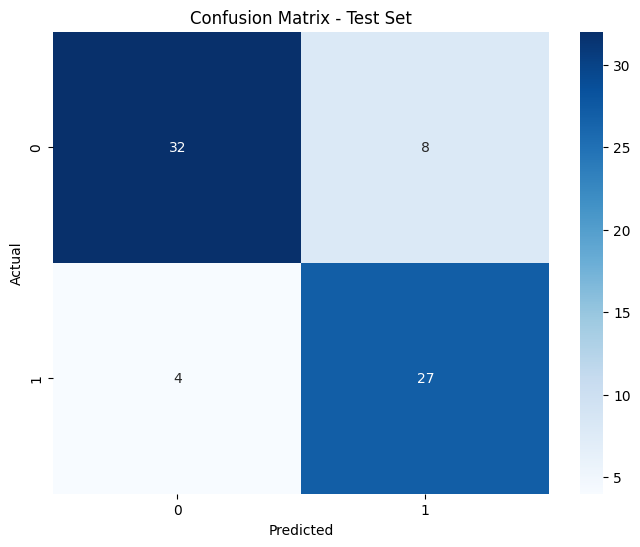

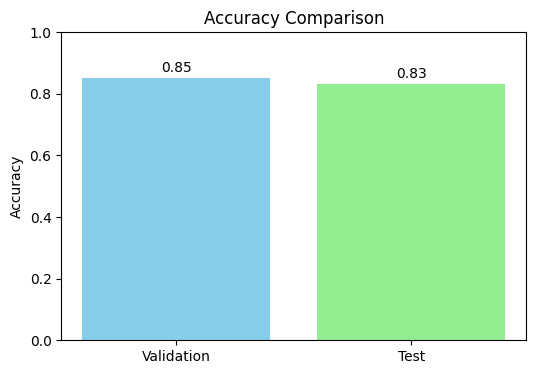

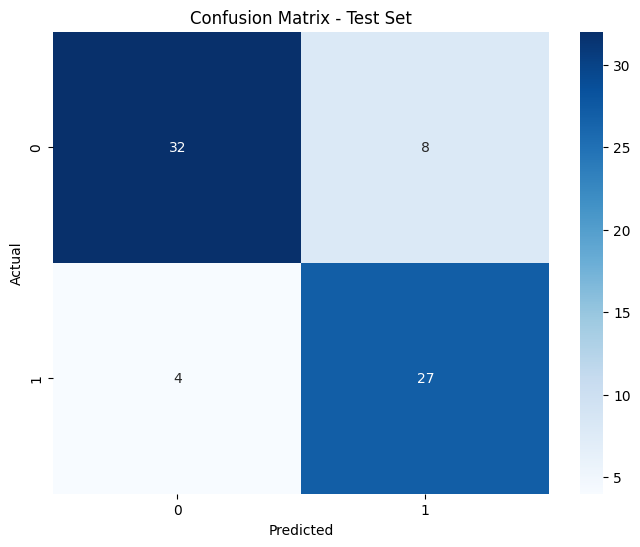

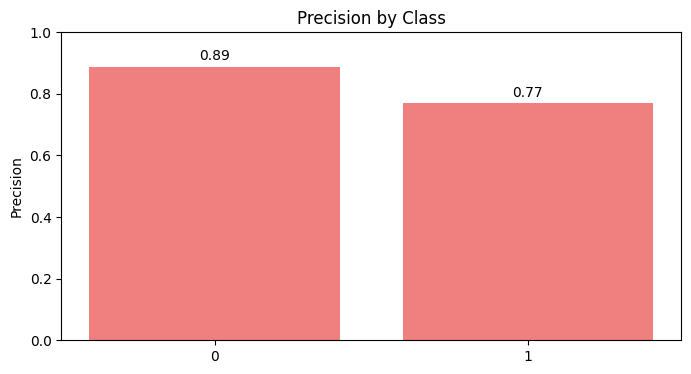

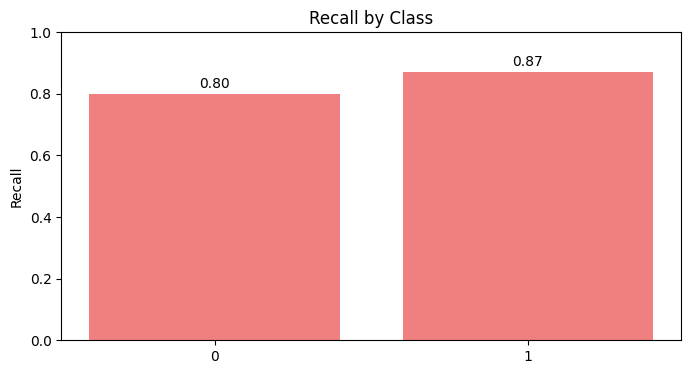

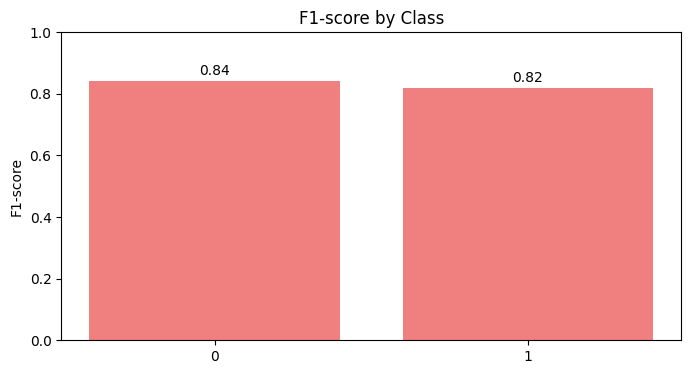

Scenario dataset_scenario_7_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with random for dataset_scenario_8_N...
Results will be saved in: SCORES\KNN\random\dataset_scenario_8_N


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 9, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8701
  Recall: 0.8696
  F1 Score: 0.8698

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


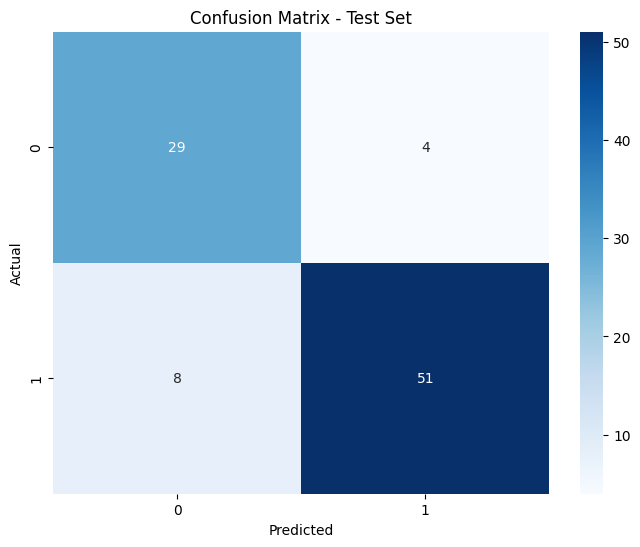

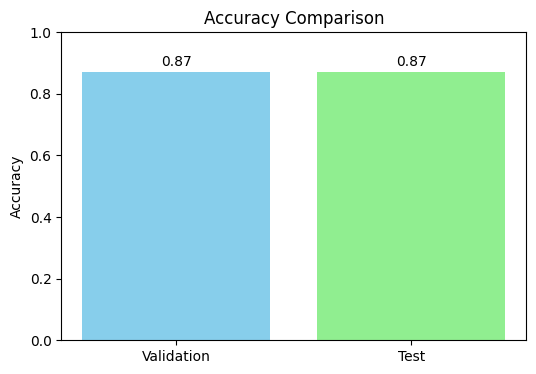

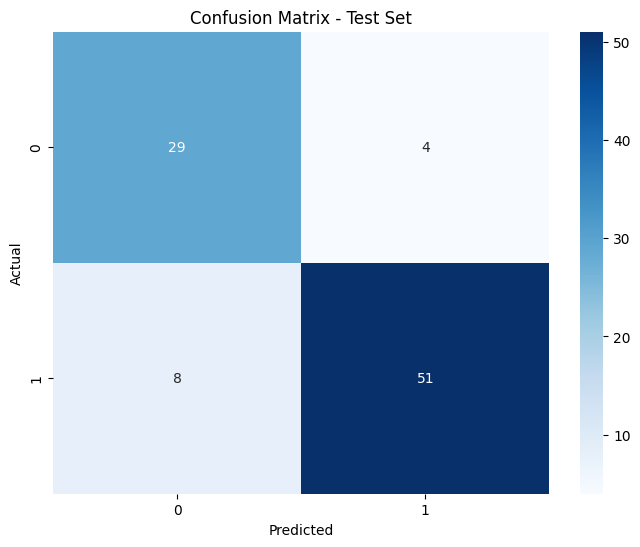

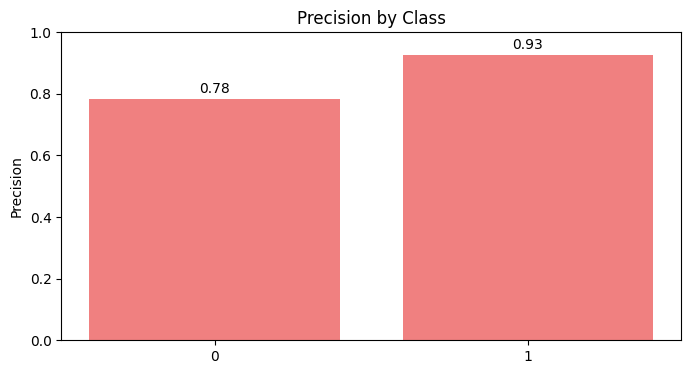

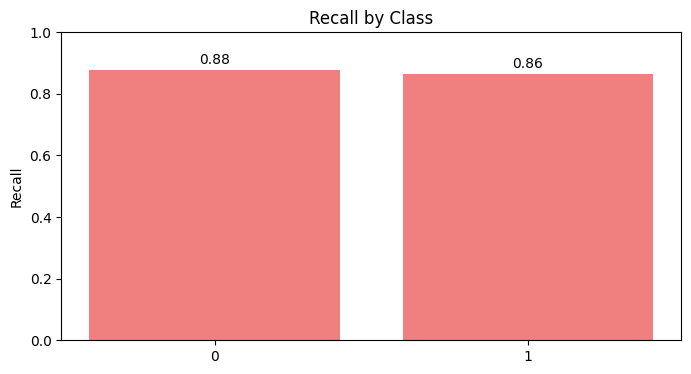

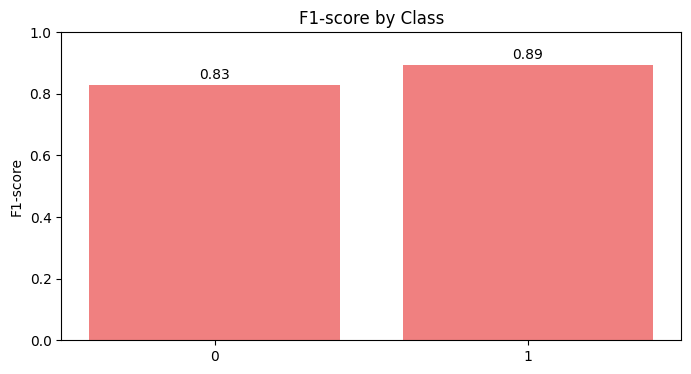

Scenario dataset_scenario_8_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with random for dataset_scenario_8_S...
Results will be saved in: SCORES\KNN\random\dataset_scenario_8_S


c:\Users\ahmed\miniconda3\envs\mining\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning: The total space of parameters 30 is smaller than n_iter=50. Running 30 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


Best hyperparameters:  {'weights': 'distance', 'n_neighbors': 9, 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


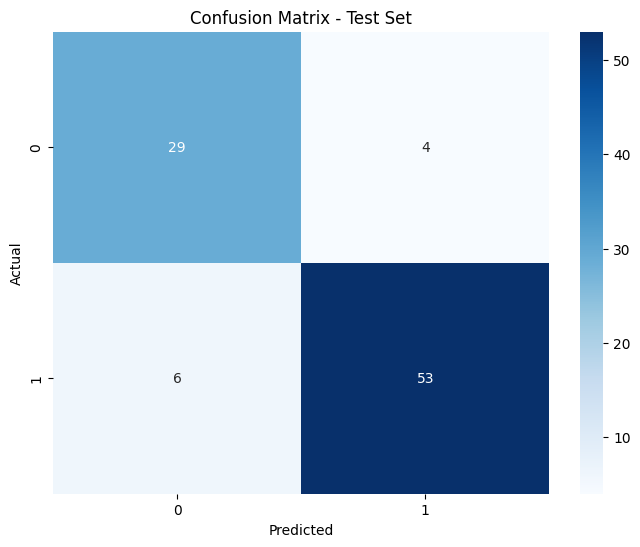

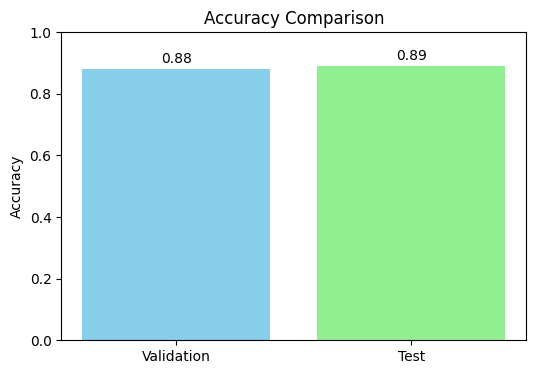

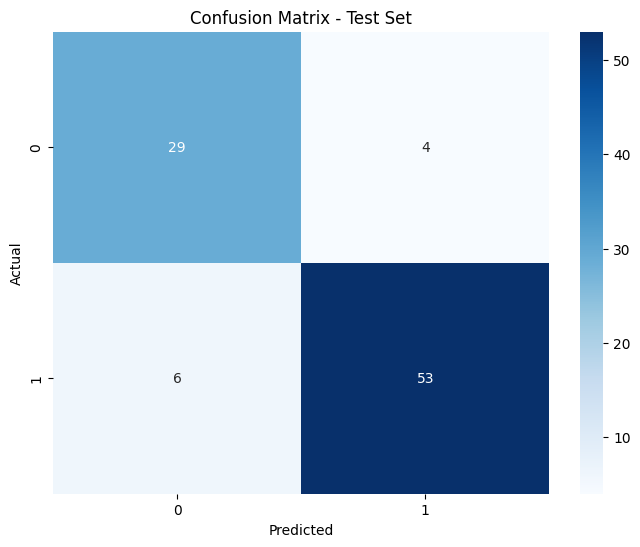

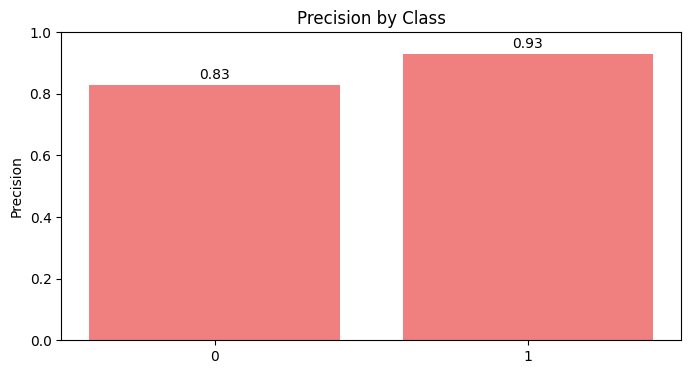

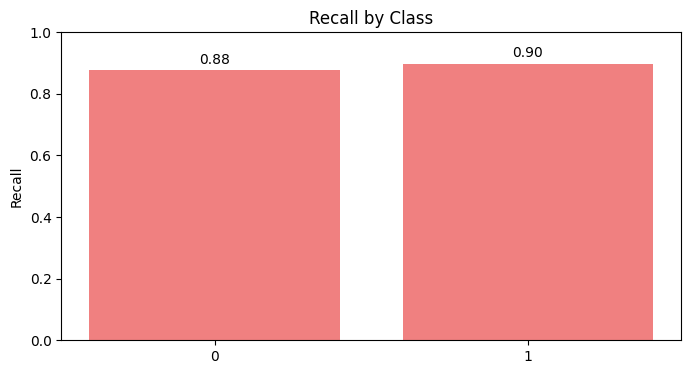

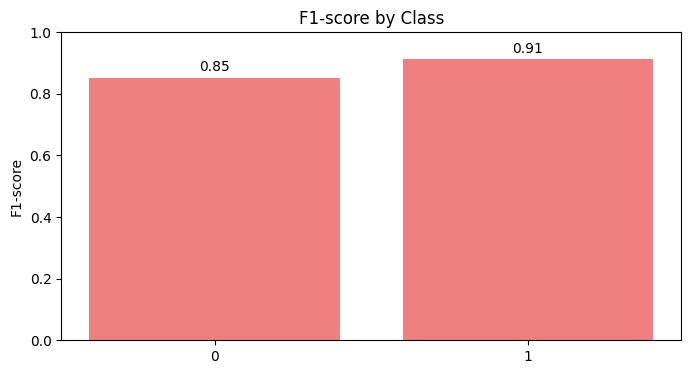

Scenario dataset_scenario_8_S with random completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8804
  Precision: 0.8810
  Recall: 0.8804
  F1 Score: 0.8806

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


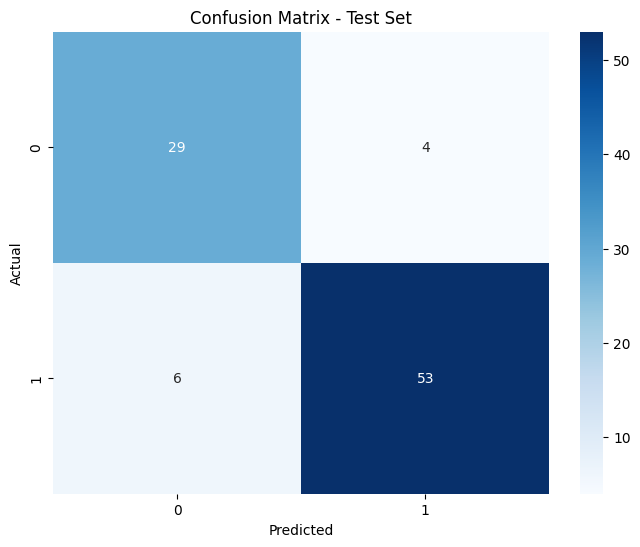

In [64]:
KNN_random_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "KNN", "random", search_config_random, get_search_hyperparameters("KNN"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        KNN_random_search['accuracy'] = best_score
        KNN_random_search['params'] = best_params
        KNN_random_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
knn = KNeighborsClassifier(**KNN_random_search['params'])
best_scenario = pd.read_csv(KNN_random_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, knn) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "KNN", "random")
save_model_info(KNN_random_search, "KNN", "random")
    

## 3. Bayesian Optimization (Optuna)

[I 2024-12-06 02:27:41,480] A new study created in memory with name: no-name-0a9d06a7-3399-4b1a-aada-10e71cc9e99e
[I 2024-12-06 02:27:41,526] Trial 0 finished with value: 0.828670058139535 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.828670058139535.


Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with optuna for dataset_scenario_1_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_1_N


[I 2024-12-06 02:27:41,573] Trial 1 finished with value: 0.8410731589147286 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8410731589147286.
[I 2024-12-06 02:27:41,609] Trial 2 finished with value: 0.8426841085271317 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 2 with value: 0.8426841085271317.
[I 2024-12-06 02:27:41,645] Trial 3 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 11, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8504360465116279.
[I 2024-12-06 02:27:41,659] Trial 4 finished with value: 0.8317102713178294 and parameters: {'n_neighbors': 3, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8504360465116279.
[I 2024-12-06 02:27:41,684] Trial 5 finished with value: 0.8348958333333332 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 3 w

Best hyperparameters:  {'n_neighbors': 12, 'weights': 'uniform', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8940
  Recall: 0.8913
  F1 Score: 0.8917

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8889
  Recall: 0.8804
  F1 Score: 0.8820

Confusion Matrix (Test Set):
[[30  3]
 [ 8 51]]


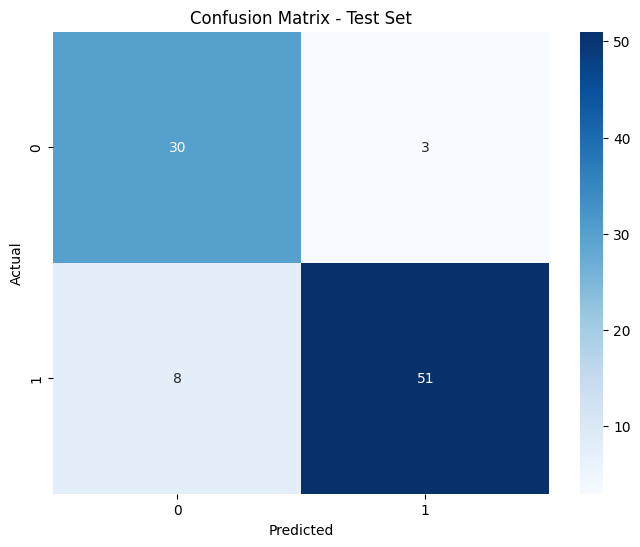

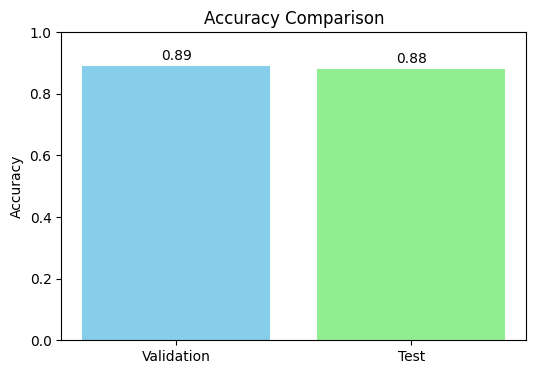

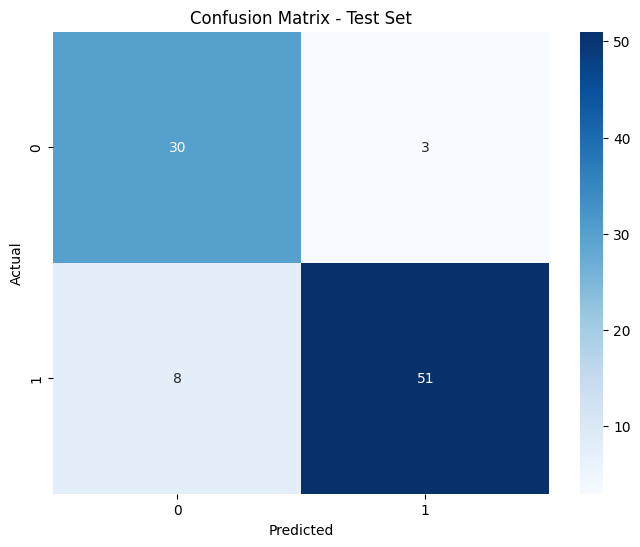

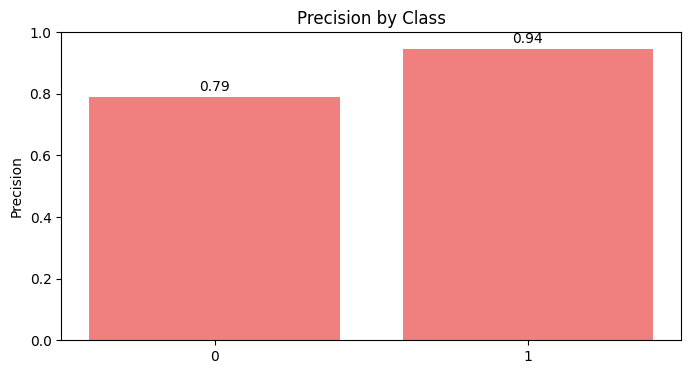

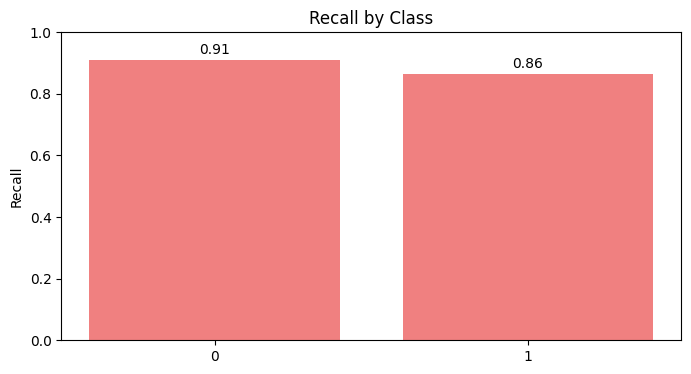

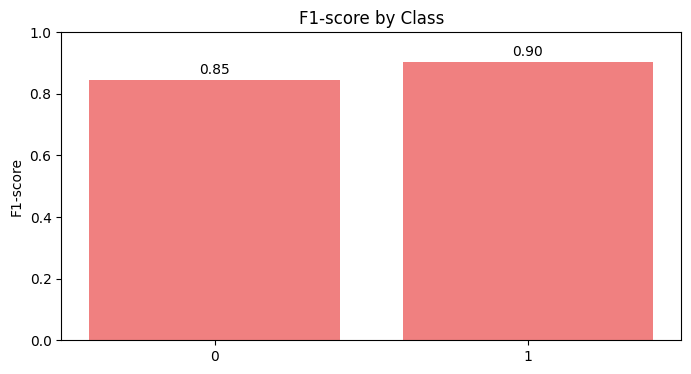

[I 2024-12-06 02:27:45,066] A new study created in memory with name: no-name-87b35044-50a2-40b5-8051-696e120bc584
[I 2024-12-06 02:27:45,091] Trial 0 finished with value: 0.8504481589147286 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8504481589147286.
[I 2024-12-06 02:27:45,105] Trial 1 finished with value: 0.8489098837209301 and parameters: {'n_neighbors': 10, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8504481589147286.
[I 2024-12-06 02:27:45,121] Trial 2 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8504481589147286.
[I 2024-12-06 02:27:45,146] Trial 3 finished with value: 0.8457848837209301 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8504481589147286.
[I 2024-12-06 02:27:45,171] Trial 4 finished with value: 0.8

Scenario dataset_scenario_1_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_1_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_1_S


[I 2024-12-06 02:27:45,254] Trial 9 finished with value: 0.8535489341085271 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 7 with value: 0.864486434108527.
[I 2024-12-06 02:27:45,284] Trial 10 finished with value: 0.8519985465116278 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 7 with value: 0.864486434108527.
[I 2024-12-06 02:27:45,302] Trial 11 finished with value: 0.8644743217054263 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 7 with value: 0.864486434108527.
[I 2024-12-06 02:27:45,321] Trial 12 finished with value: 0.8597868217054263 and parameters: {'n_neighbors': 13, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 7 with value: 0.864486434108527.
[I 2024-12-06 02:27:45,350] Trial 13 finished with value: 0.8597868217054263 and parameters: {'n_neighbors': 13, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 7 

Best hyperparameters:  {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.9022
  Precision: 0.9022
  Recall: 0.9022
  F1 Score: 0.9022

Test Metrics:
  Accuracy: 0.9022
  Precision: 0.9059
  Recall: 0.9022
  F1 Score: 0.9030

Confusion Matrix (Test Set):
[[30  3]
 [ 6 53]]


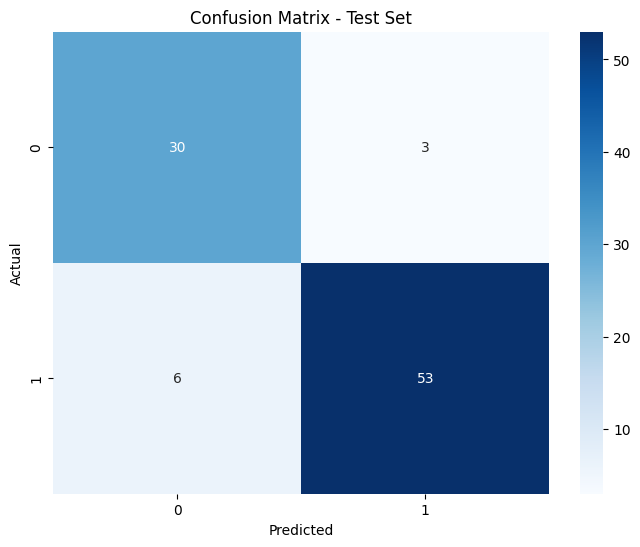

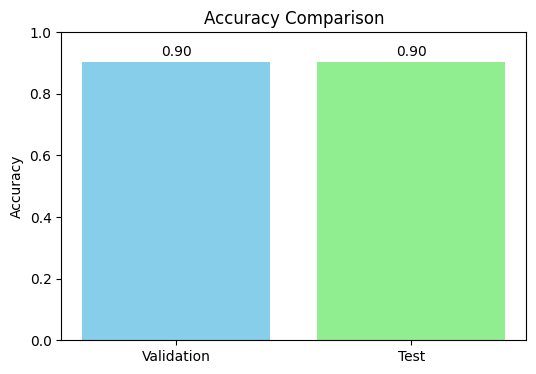

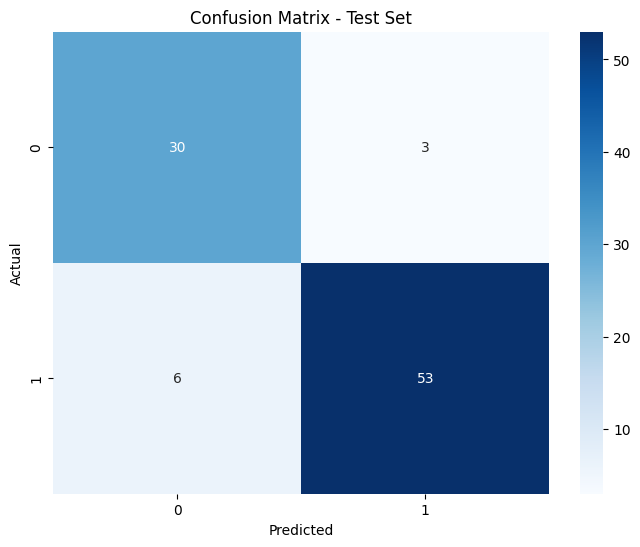

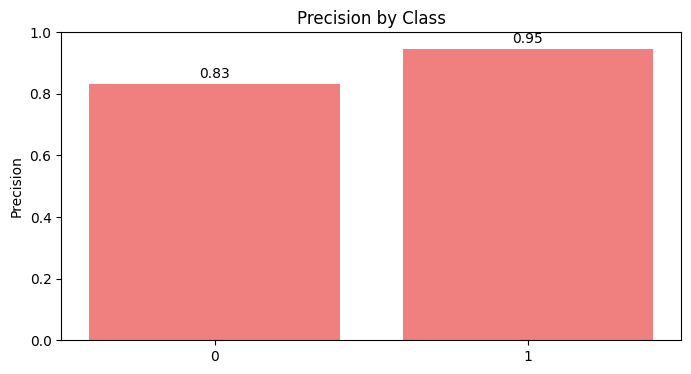

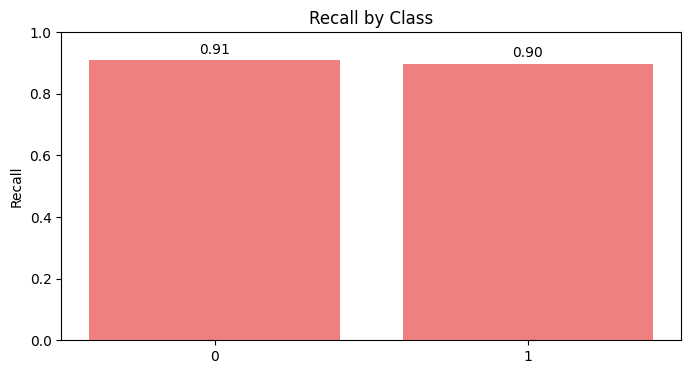

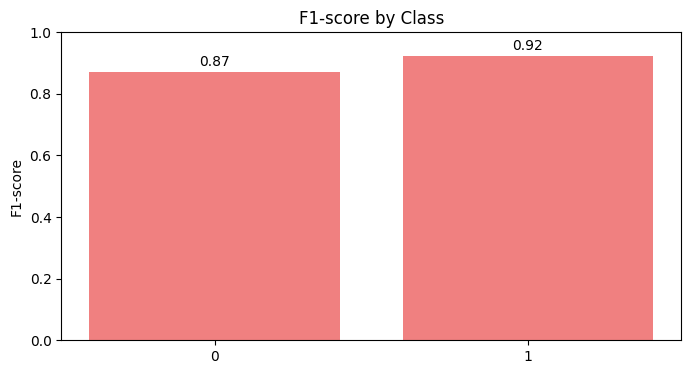

[I 2024-12-06 02:27:47,885] A new study created in memory with name: no-name-5db0afd3-2763-4575-9777-68ed77a1aada
[I 2024-12-06 02:27:47,911] Trial 0 finished with value: 0.8192587209302324 and parameters: {'n_neighbors': 4, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8192587209302324.
[I 2024-12-06 02:27:47,935] Trial 1 finished with value: 0.8457727713178294 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8457727713178294.
[I 2024-12-06 02:27:47,950] Trial 2 finished with value: 0.8441981589147286 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8457727713178294.
[I 2024-12-06 02:27:47,974] Trial 3 finished with value: 0.8426598837209301 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8457727713178294.
[I 2024-12-06 02:27:47,999] Trial 4 finished with value: 0.8504

Scenario dataset_scenario_1_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running KNN with optuna for dataset_scenario_2_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_2_N


[I 2024-12-06 02:27:48,088] Trial 8 finished with value: 0.8379723837209301 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 4 with value: 0.8504481589147286.
[I 2024-12-06 02:27:48,102] Trial 9 finished with value: 0.8363856589147286 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 4 with value: 0.8504481589147286.
[I 2024-12-06 02:27:48,121] Trial 10 finished with value: 0.8363856589147286 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 4 with value: 0.8504481589147286.
[I 2024-12-06 02:27:48,151] Trial 11 finished with value: 0.8457727713178294 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8504481589147286.
[I 2024-12-06 02:27:48,180] Trial 12 finished with value: 0.8473110465116278 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 

Best hyperparameters:  {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8424
  Precision: 0.8435
  Recall: 0.8424
  F1 Score: 0.8427

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8972
  Recall: 0.8913
  F1 Score: 0.8925

Confusion Matrix (Test Set):
[[30  3]
 [ 7 52]]


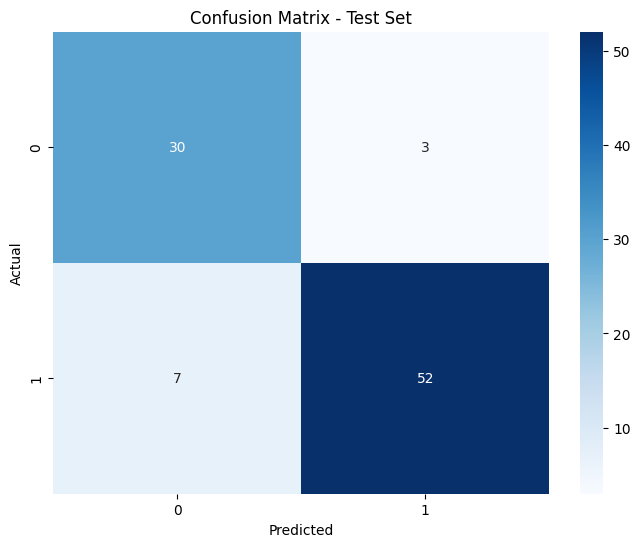

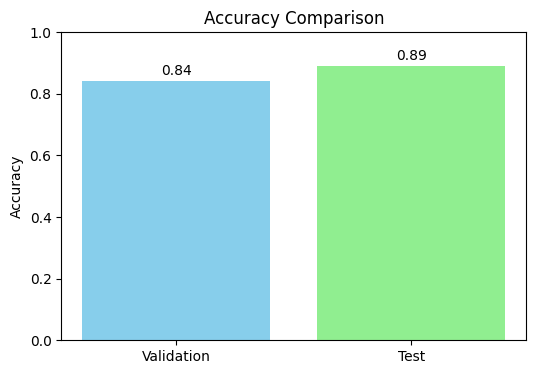

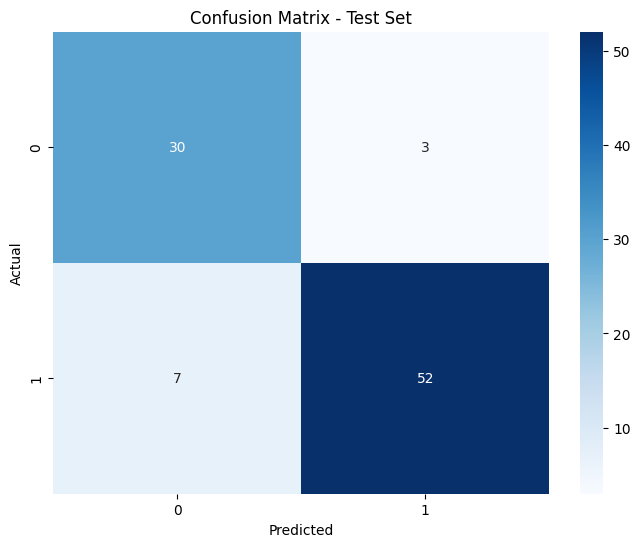

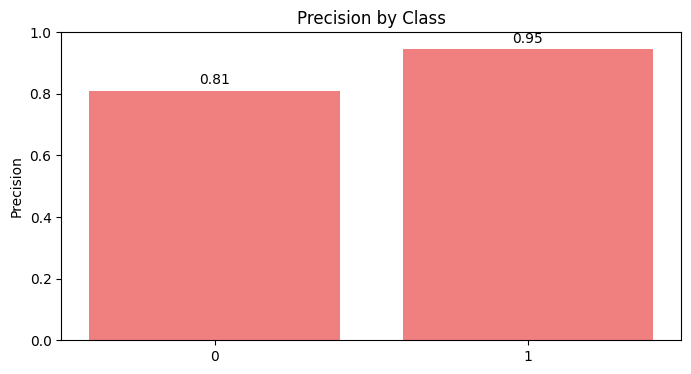

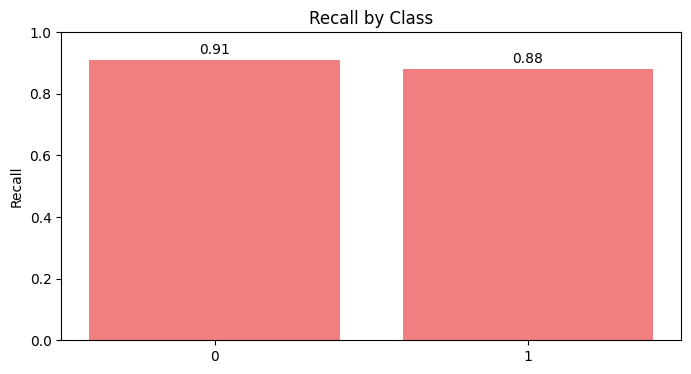

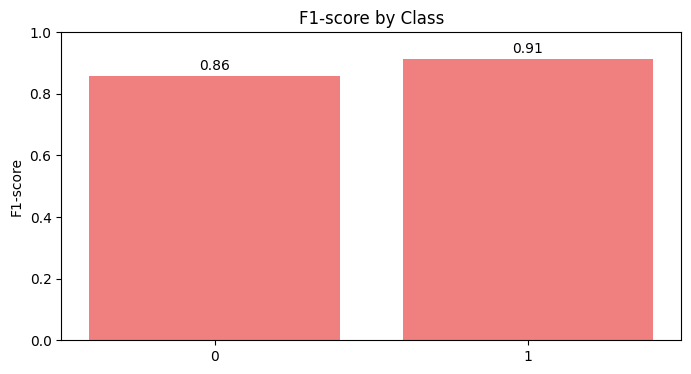

[I 2024-12-06 02:27:50,768] A new study created in memory with name: no-name-f57d88bc-837a-4107-afa6-f6990b2de885
[I 2024-12-06 02:27:50,782] Trial 0 finished with value: 0.8472868217054262 and parameters: {'n_neighbors': 9, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8472868217054262.
[I 2024-12-06 02:27:50,808] Trial 1 finished with value: 0.8441618217054263 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8472868217054262.
[I 2024-12-06 02:27:50,832] Trial 2 finished with value: 0.8395106589147285 and parameters: {'n_neighbors': 12, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8472868217054262.
[I 2024-12-06 02:27:50,857] Trial 3 finished with value: 0.8535489341085271 and parameters: {'n_neighbors': 15, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8535489341085271.
[I 2024-12-06 02:27:50,881] Trial 4 finished with value: 0.844

Scenario dataset_scenario_2_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running KNN with optuna for dataset_scenario_2_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_2_S


[I 2024-12-06 02:27:50,971] Trial 8 finished with value: 0.8442102713178293 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 3 with value: 0.8535489341085271.
[I 2024-12-06 02:27:50,996] Trial 9 finished with value: 0.8535610465116278 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 9 with value: 0.8535610465116278.
[I 2024-12-06 02:27:51,026] Trial 10 finished with value: 0.8551235465116278 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8551235465116278.
[I 2024-12-06 02:27:51,045] Trial 11 finished with value: 0.8551235465116278 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8551235465116278.
[I 2024-12-06 02:27:51,064] Trial 12 finished with value: 0.8551235465116278 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 

Best hyperparameters:  {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8859
  Precision: 0.8861
  Recall: 0.8859
  F1 Score: 0.8860

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8758
  Recall: 0.8696
  F1 Score: 0.8710

Confusion Matrix (Test Set):
[[29  4]
 [ 8 51]]


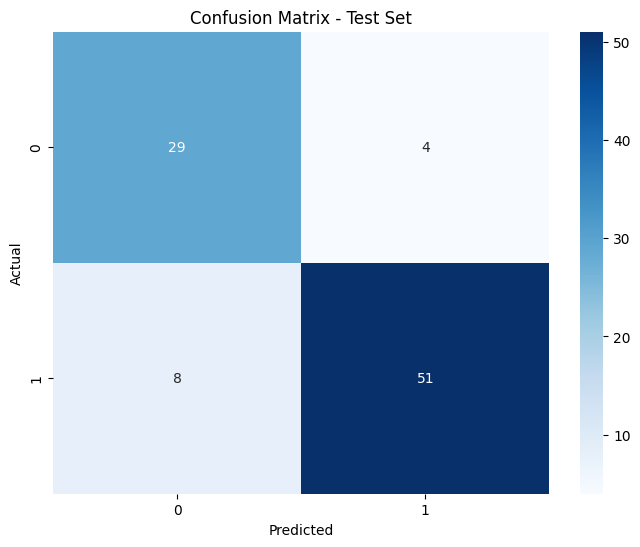

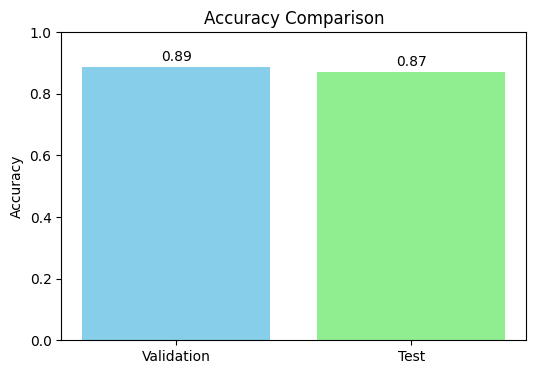

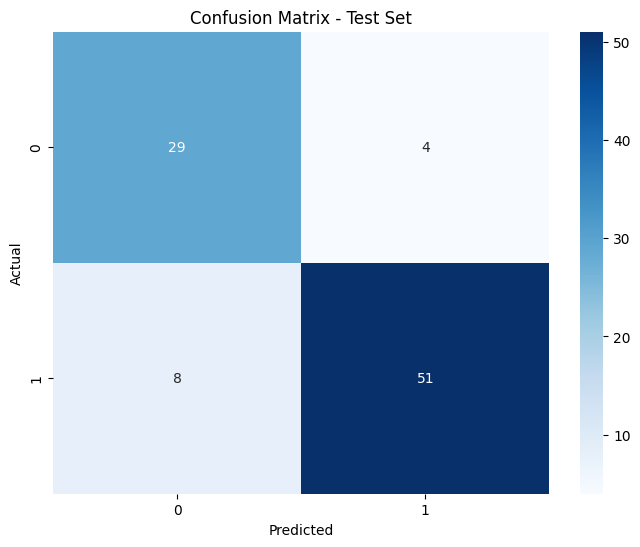

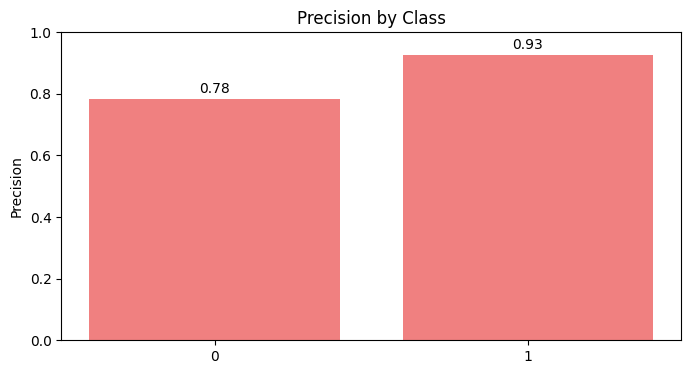

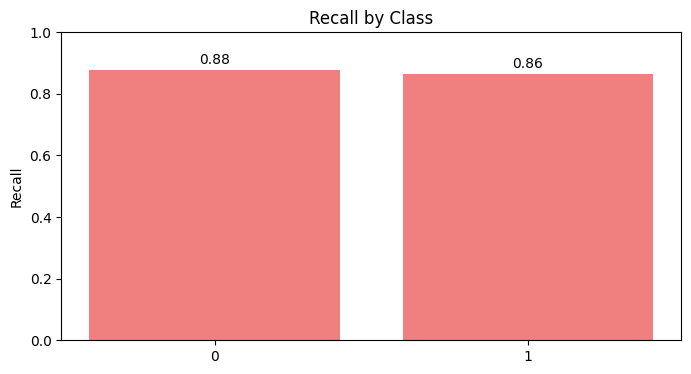

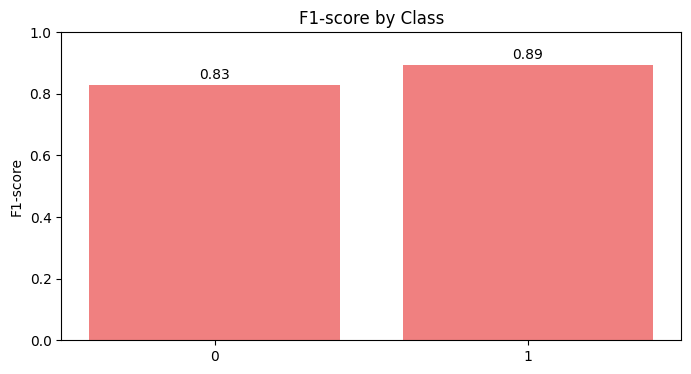

[I 2024-12-06 02:27:53,688] A new study created in memory with name: no-name-f2b66f42-cda2-4bfc-853a-21cdc4eb0fe8
[I 2024-12-06 02:27:53,713] Trial 0 finished with value: 0.8371469800041229 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8371469800041229.
[I 2024-12-06 02:27:53,728] Trial 1 finished with value: 0.8473304473304474 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8473304473304474.
[I 2024-12-06 02:27:53,743] Trial 2 finished with value: 0.8472686044114616 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 1 with value: 0.8473304473304474.
[I 2024-12-06 02:27:53,757] Trial 3 finished with value: 0.8513708513708513 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8513708513708513.
[I 2024-12-06 02:27:53,773] Trial 4 finished with value: 0.8269

Scenario dataset_scenario_2_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with optuna for dataset_scenario_3_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_3_N


[I 2024-12-06 02:27:53,883] Trial 10 finished with value: 0.824860853432282 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 3 with value: 0.8513708513708513.
[I 2024-12-06 02:27:53,901] Trial 11 finished with value: 0.8289218717790146 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 3 with value: 0.8513708513708513.
[I 2024-12-06 02:27:53,920] Trial 12 finished with value: 0.8513708513708513 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8513708513708513.
[I 2024-12-06 02:27:53,938] Trial 13 finished with value: 0.845227788084931 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8513708513708513.
[I 2024-12-06 02:27:53,956] Trial 14 finished with value: 0.853411667697382 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'manhattan'}. Best is tri

Best hyperparameters:  {'n_neighbors': 11, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8513
  Recall: 0.8500
  F1 Score: 0.8503

Test Metrics:
  Accuracy: 0.8451
  Precision: 0.8547
  Recall: 0.8451
  F1 Score: 0.8457

Confusion Matrix (Test Set):
[[32  8]
 [ 3 28]]


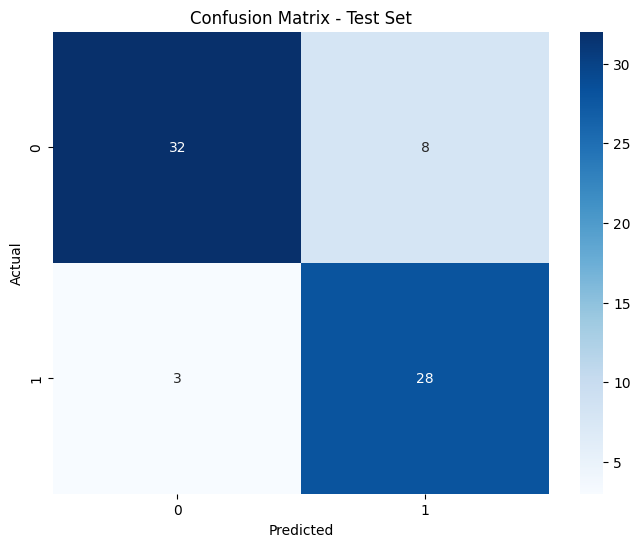

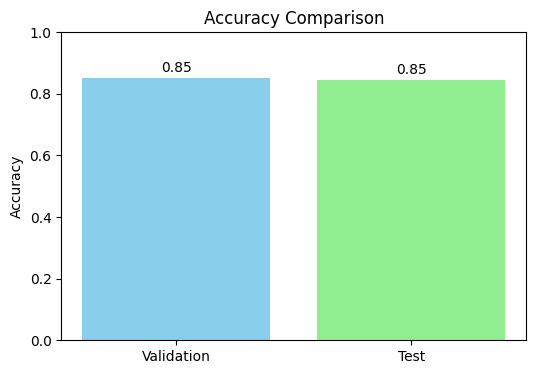

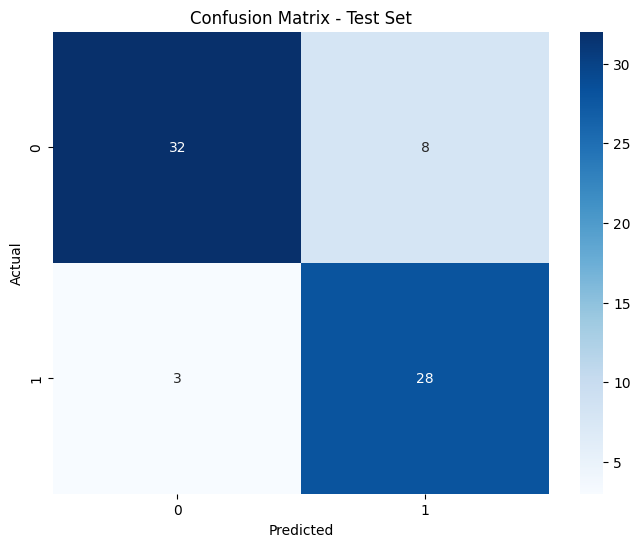

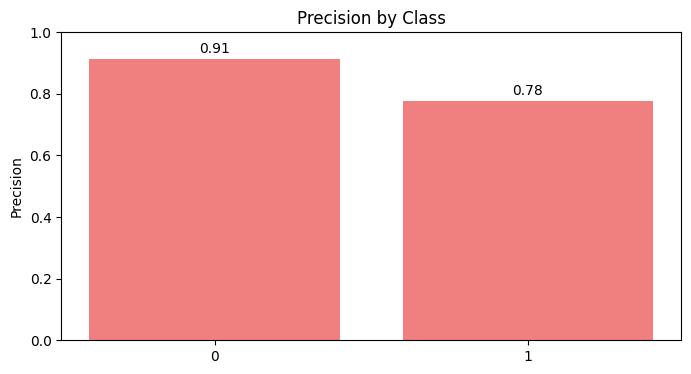

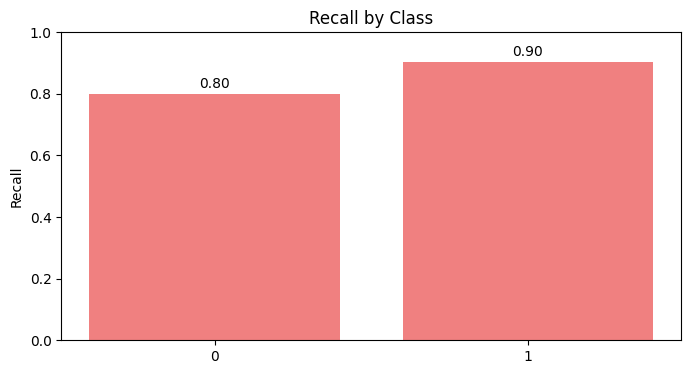

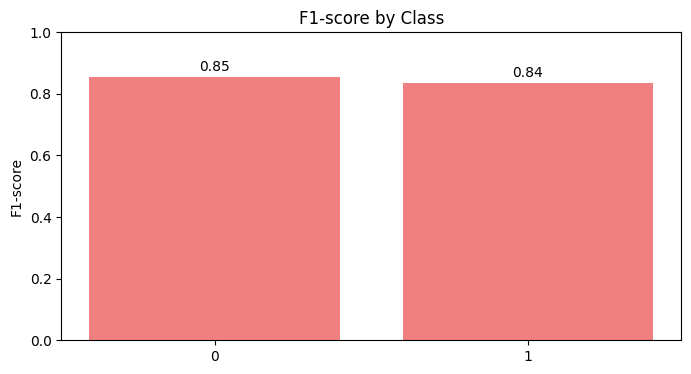

[I 2024-12-06 02:27:56,352] A new study created in memory with name: no-name-c67cba4a-d3b7-4635-8750-b496e6fd4ed5
[I 2024-12-06 02:27:56,377] Trial 0 finished with value: 0.8411873840445269 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8411873840445269.
[I 2024-12-06 02:27:56,401] Trial 1 finished with value: 0.8207998350855494 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8411873840445269.
[I 2024-12-06 02:27:56,426] Trial 2 finished with value: 0.8269428983714698 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8411873840445269.
[I 2024-12-06 02:27:56,451] Trial 3 finished with value: 0.8412286126571841 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8412286126571841.
[I 2024-12-06 02:27:56,475] Trial 4 finished with value: 0.85137

Scenario dataset_scenario_3_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_3_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_3_S


[I 2024-12-06 02:27:56,545] Trial 8 finished with value: 0.8289424860853434 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 4 with value: 0.8513708513708513.
[I 2024-12-06 02:27:56,560] Trial 9 finished with value: 0.8309626881055452 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 4 with value: 0.8513708513708513.
[I 2024-12-06 02:27:56,579] Trial 10 finished with value: 0.8350649350649351 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 4 with value: 0.8513708513708513.
[I 2024-12-06 02:27:56,598] Trial 11 finished with value: 0.8493506493506493 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8513708513708513.
[I 2024-12-06 02:27:56,616] Trial 12 finished with value: 0.853411667697382 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 

Best hyperparameters:  {'n_neighbors': 9, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8643
  Precision: 0.8646
  Recall: 0.8643
  F1 Score: 0.8644

Test Metrics:
  Accuracy: 0.8451
  Precision: 0.8547
  Recall: 0.8451
  F1 Score: 0.8457

Confusion Matrix (Test Set):
[[32  8]
 [ 3 28]]


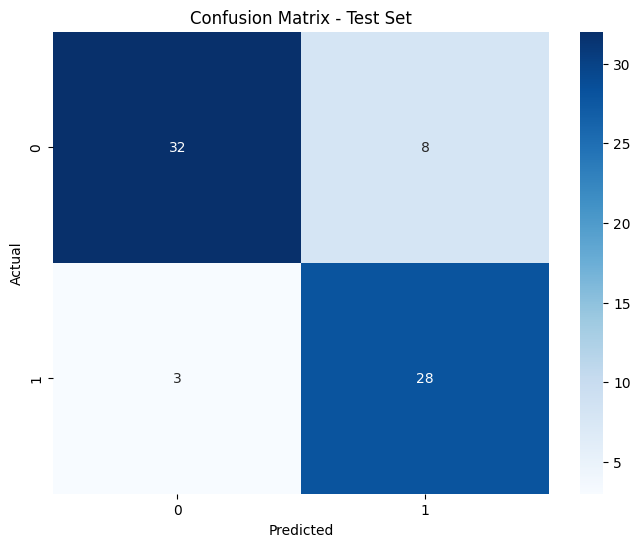

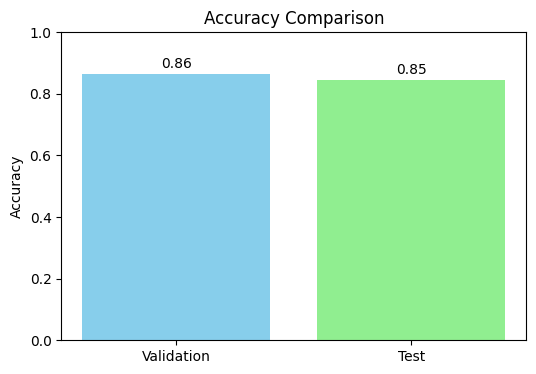

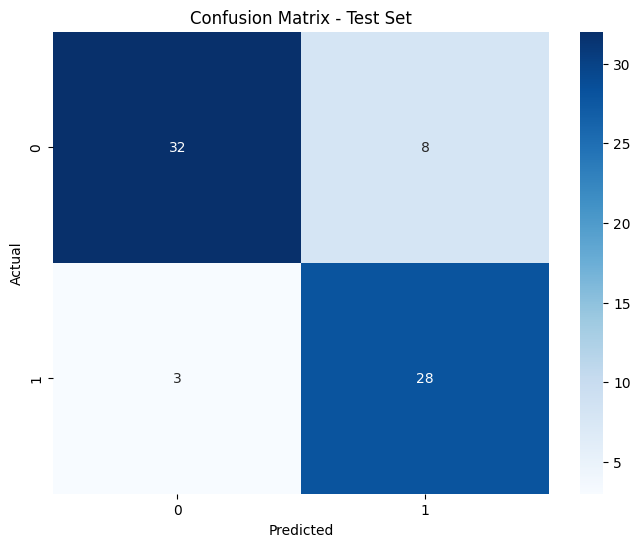

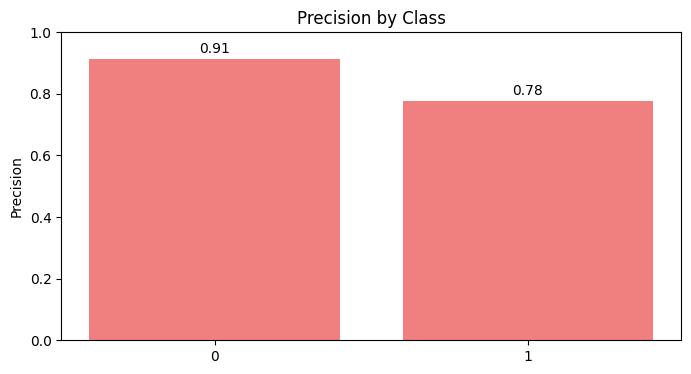

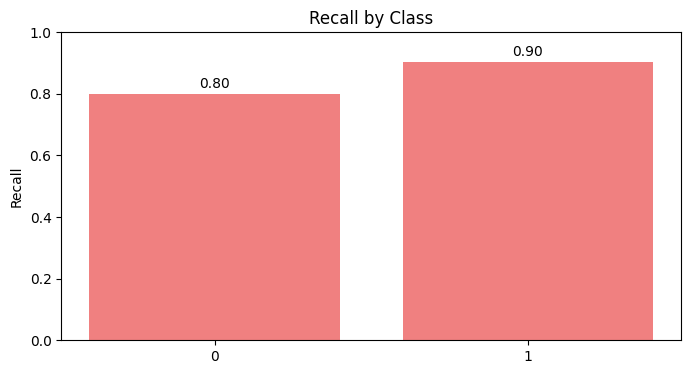

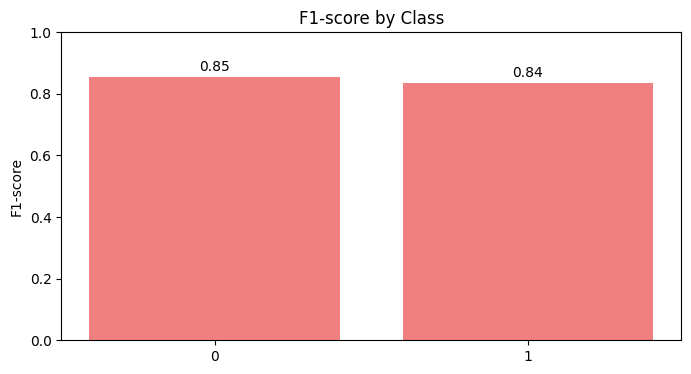

[I 2024-12-06 02:27:59,027] A new study created in memory with name: no-name-3c453e99-ba11-40f2-8e45-69a8c414596e
[I 2024-12-06 02:27:59,051] Trial 0 finished with value: 0.8254966085271317 and parameters: {'n_neighbors': 3, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8254966085271317.
[I 2024-12-06 02:27:59,077] Trial 1 finished with value: 0.8520227713178293 and parameters: {'n_neighbors': 11, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8520227713178293.
[I 2024-12-06 02:27:59,102] Trial 2 finished with value: 0.8411094961240309 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8520227713178293.
[I 2024-12-06 02:27:59,127] Trial 3 finished with value: 0.8364098837209302 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8520227713178293.
[I 2024-12-06 02:27:59,141] Trial 4 finished with value: 0.852010

Scenario dataset_scenario_3_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with optuna for dataset_scenario_4_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_4_N


[I 2024-12-06 02:27:59,246] Trial 9 finished with value: 0.8457364341085271 and parameters: {'n_neighbors': 9, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 8 with value: 0.8551114341085271.
[I 2024-12-06 02:27:59,266] Trial 10 finished with value: 0.8488735465116278 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 8 with value: 0.8551114341085271.
[I 2024-12-06 02:27:59,284] Trial 11 finished with value: 0.8551114341085271 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 8 with value: 0.8551114341085271.
[I 2024-12-06 02:27:59,302] Trial 12 finished with value: 0.8535610465116278 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 8 with value: 0.8551114341085271.
[I 2024-12-06 02:27:59,320] Trial 13 finished with value: 0.8551114341085271 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is tri

Best hyperparameters:  {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8533
  Precision: 0.8531
  Recall: 0.8533
  F1 Score: 0.8531

Test Metrics:
  Accuracy: 0.8696
  Precision: 0.8720
  Recall: 0.8696
  F1 Score: 0.8704

Confusion Matrix (Test Set):
[[28  5]
 [ 7 52]]


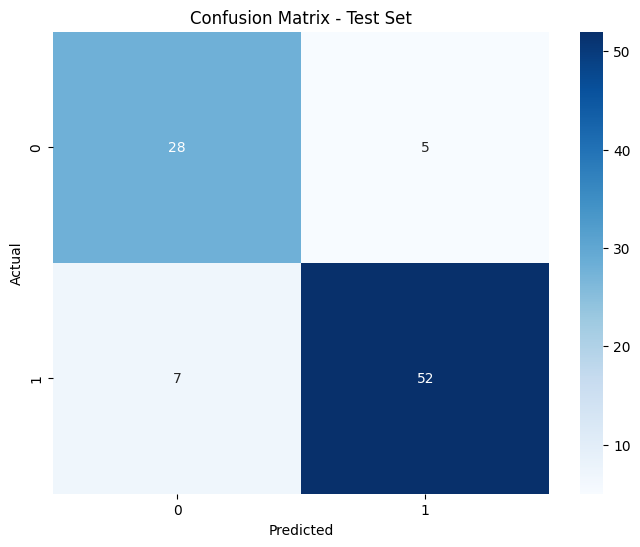

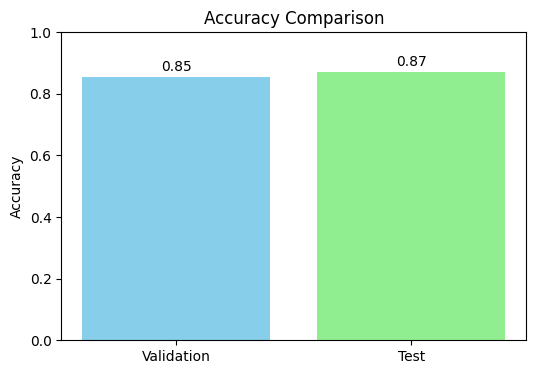

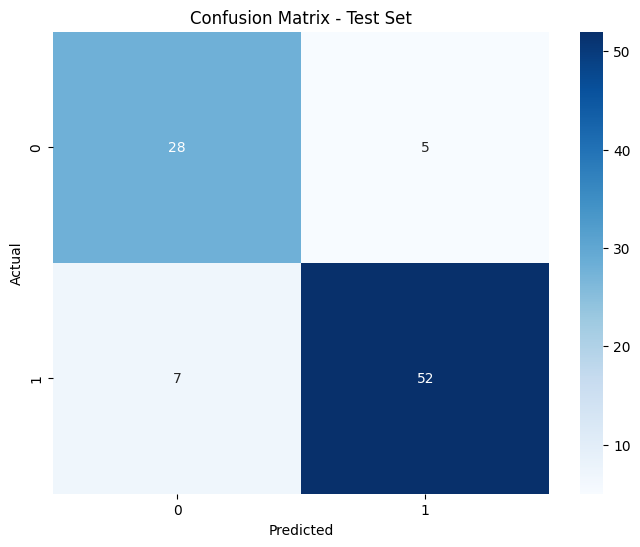

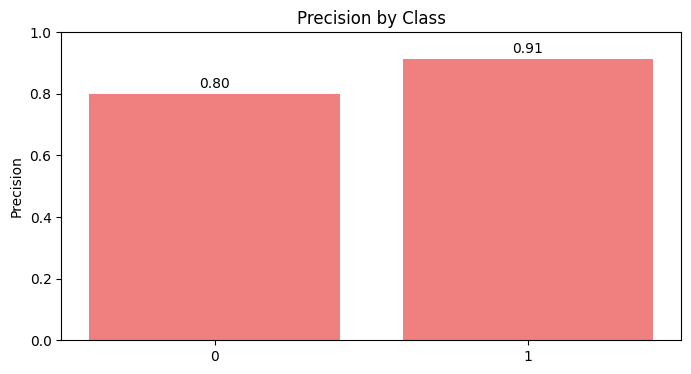

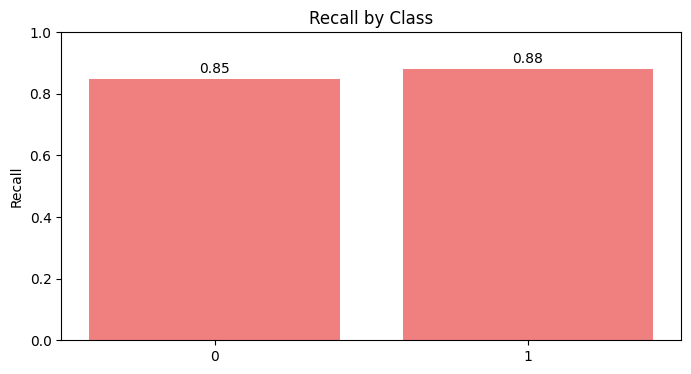

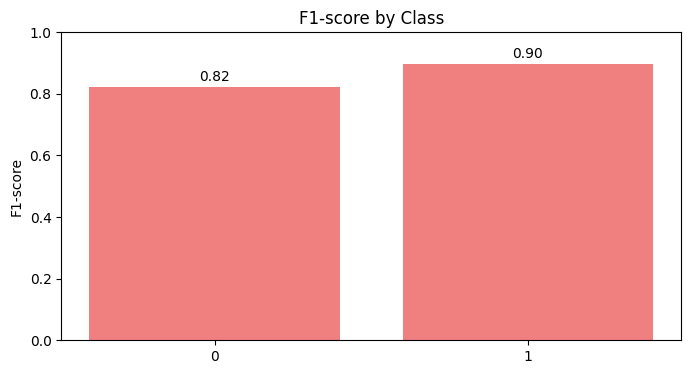

[I 2024-12-06 02:28:02,000] A new study created in memory with name: no-name-aed508ea-f42a-4094-abe9-8928c4ed61e7
[I 2024-12-06 02:28:02,015] Trial 0 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 9, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8504360465116279.
[I 2024-12-06 02:28:02,030] Trial 1 finished with value: 0.8457606589147286 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8504360465116279.
[I 2024-12-06 02:28:02,044] Trial 2 finished with value: 0.850423934108527 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8504360465116279.
[I 2024-12-06 02:28:02,059] Trial 3 finished with value: 0.8457122093023255 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8504360465116279.
[I 2024-12-06 02:28:02,074] Trial 4 finished with value: 0.85

Scenario dataset_scenario_4_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_4_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_4_S


[I 2024-12-06 02:28:02,213] Trial 10 finished with value: 0.8535247093023255 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8535247093023255.
[I 2024-12-06 02:28:02,241] Trial 11 finished with value: 0.8535247093023255 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8535247093023255.
[I 2024-12-06 02:28:02,271] Trial 12 finished with value: 0.8488372093023255 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8535247093023255.
[I 2024-12-06 02:28:02,299] Trial 13 finished with value: 0.8457364341085271 and parameters: {'n_neighbors': 12, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 10 with value: 0.8535247093023255.
[I 2024-12-06 02:28:02,328] Trial 14 finished with value: 0.8535247093023255 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'manhattan'}. Best is t

Best hyperparameters:  {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8918
  Recall: 0.8913
  F1 Score: 0.8915

Test Metrics:
  Accuracy: 0.8913
  Precision: 0.8935
  Recall: 0.8913
  F1 Score: 0.8920

Confusion Matrix (Test Set):
[[29  4]
 [ 6 53]]


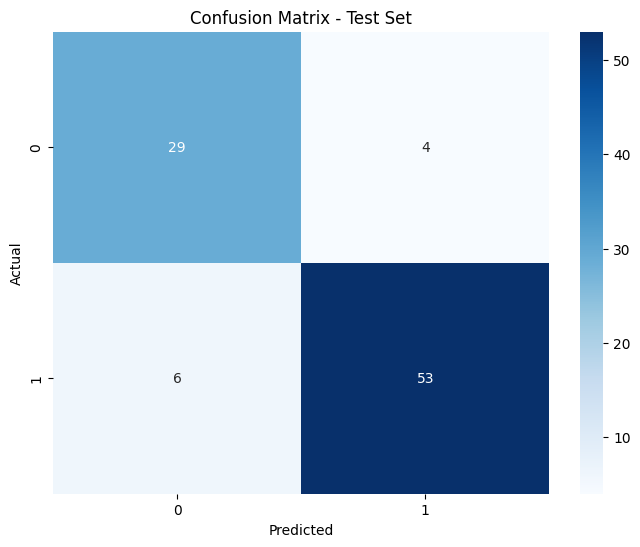

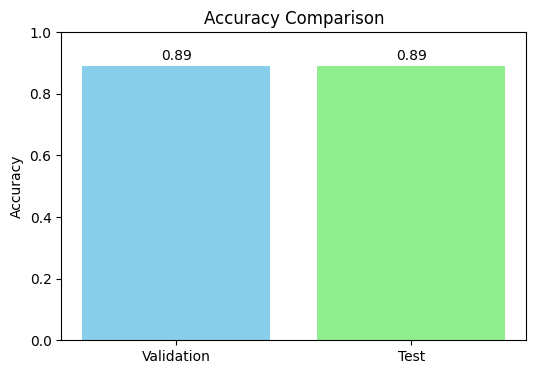

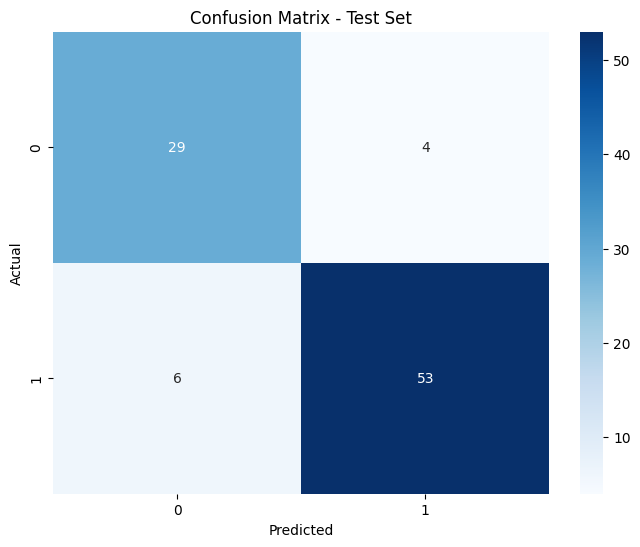

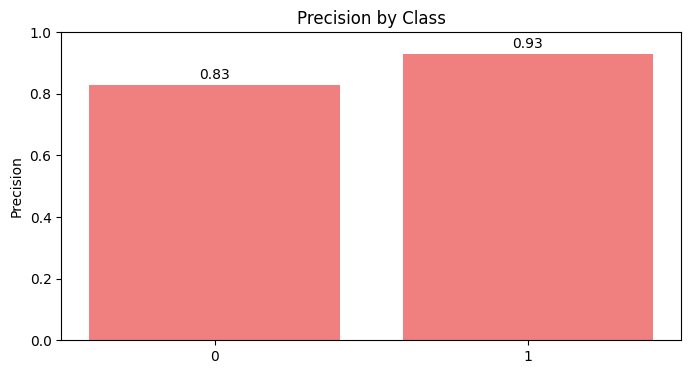

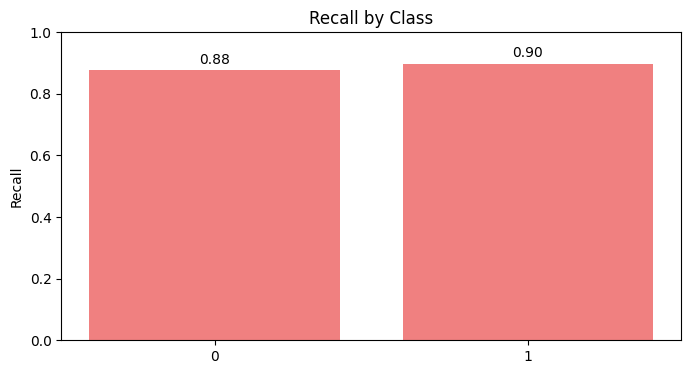

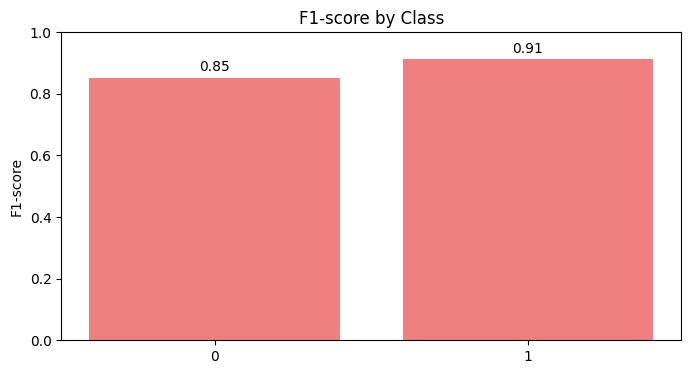

[I 2024-12-06 02:28:05,076] A new study created in memory with name: no-name-62622108-cab5-442b-bb91-499660da43e1
[I 2024-12-06 02:28:05,101] Trial 0 finished with value: 0.8270712209302324 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8270712209302324.
[I 2024-12-06 02:28:05,126] Trial 1 finished with value: 0.8301719961240309 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8301719961240309.
[I 2024-12-06 02:28:05,140] Trial 2 finished with value: 0.8301719961240309 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 1 with value: 0.8301719961240309.
[I 2024-12-06 02:28:05,155] Trial 3 finished with value: 0.8457606589147286 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8457606589147286.
[I 2024-12-06 02:28:05,180] Trial 4 finished with value: 0.8

Scenario dataset_scenario_4_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with optuna for dataset_scenario_5_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_5_N


[I 2024-12-06 02:28:05,286] Trial 9 finished with value: 0.8255329457364342 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 3 with value: 0.8457606589147286.
[I 2024-12-06 02:28:05,304] Trial 10 finished with value: 0.8348231589147286 and parameters: {'n_neighbors': 4, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8457606589147286.
[I 2024-12-06 02:28:05,334] Trial 11 finished with value: 0.8395227713178294 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8457606589147286.
[I 2024-12-06 02:28:05,364] Trial 12 finished with value: 0.8441981589147286 and parameters: {'n_neighbors': 11, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8457606589147286.
[I 2024-12-06 02:28:05,382] Trial 13 finished with value: 0.848861434108527 and parameters: {'n_neighbors': 9, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 13

Best hyperparameters:  {'n_neighbors': 9, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8644
  Recall: 0.8641
  F1 Score: 0.8642

Test Metrics:
  Accuracy: 0.9130
  Precision: 0.9235
  Recall: 0.9130
  F1 Score: 0.9143

Confusion Matrix (Test Set):
[[32  1]
 [ 7 52]]


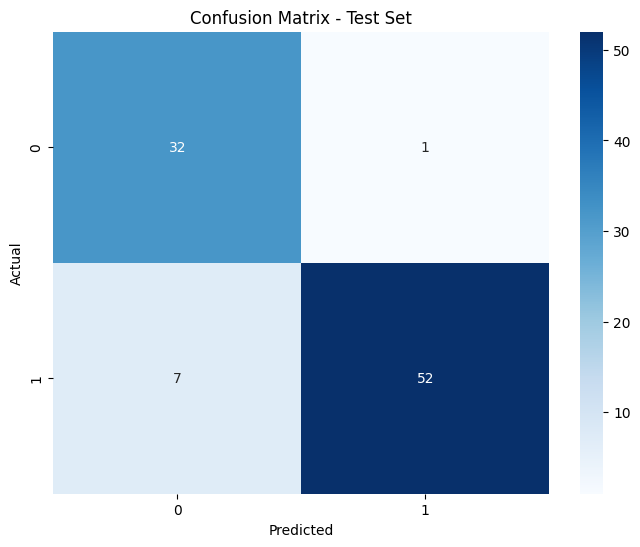

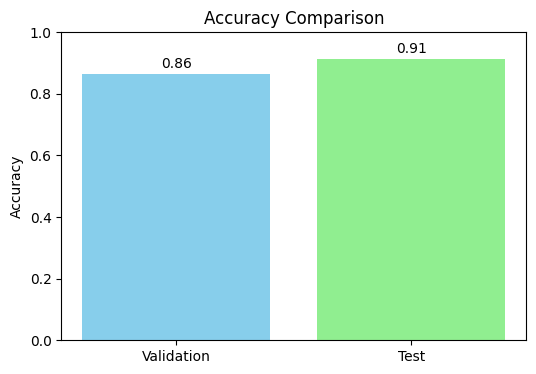

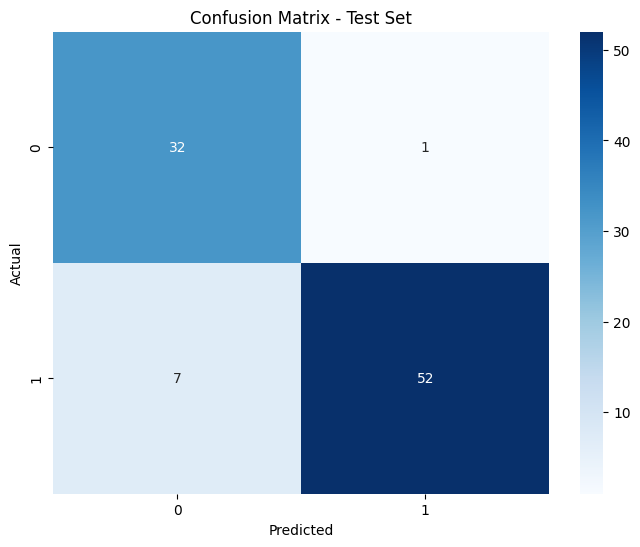

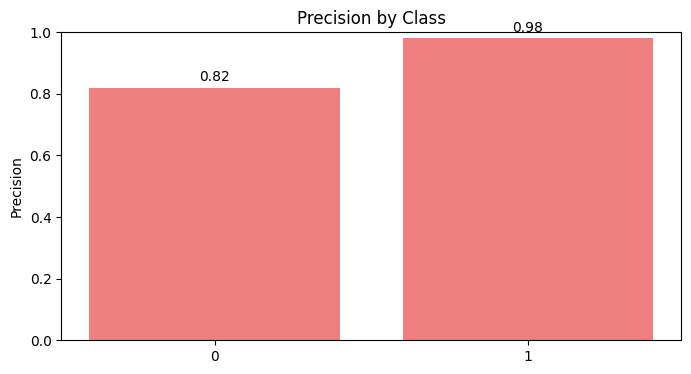

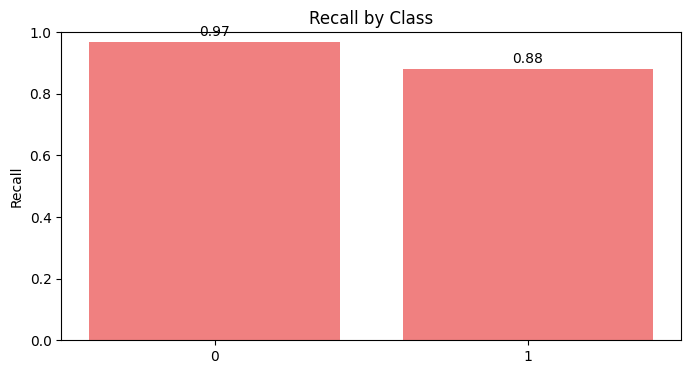

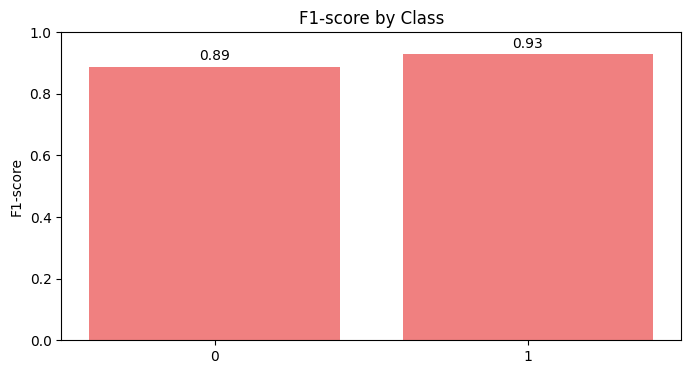

[I 2024-12-06 02:28:07,949] A new study created in memory with name: no-name-6d30b743-638c-49ad-bd40-cbeed97a3d8a
[I 2024-12-06 02:28:07,964] Trial 0 finished with value: 0.8535489341085271 and parameters: {'n_neighbors': 12, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:07,979] Trial 1 finished with value: 0.8426235465116279 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:07,994] Trial 2 finished with value: 0.8519985465116278 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:08,019] Trial 3 finished with value: 0.8333091085271317 and parameters: {'n_neighbors': 12, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:08,045] Trial 4 finished with value: 0.8

Scenario dataset_scenario_5_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_5_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_5_S


[I 2024-12-06 02:28:08,161] Trial 9 finished with value: 0.8472868217054262 and parameters: {'n_neighbors': 9, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:08,180] Trial 10 finished with value: 0.8473110465116278 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:08,199] Trial 11 finished with value: 0.8504481589147286 and parameters: {'n_neighbors': 13, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8535489341085271.
[I 2024-12-06 02:28:08,217] Trial 12 finished with value: 0.8598110465116278 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 12 with value: 0.8598110465116278.
[I 2024-12-06 02:28:08,235] Trial 13 finished with value: 0.8613493217054262 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}. Best is tria

Best hyperparameters:  {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8913
  Precision: 0.8940
  Recall: 0.8913
  F1 Score: 0.8917

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8889
  Recall: 0.8804
  F1 Score: 0.8820

Confusion Matrix (Test Set):
[[30  3]
 [ 8 51]]


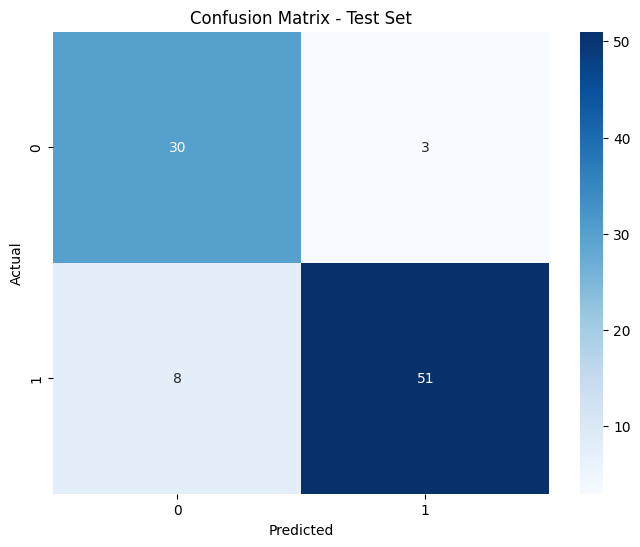

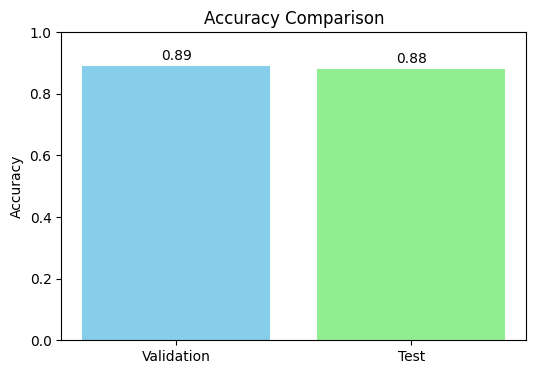

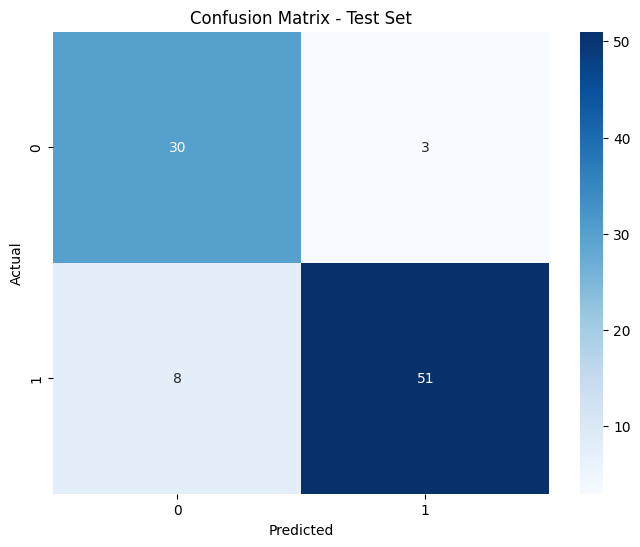

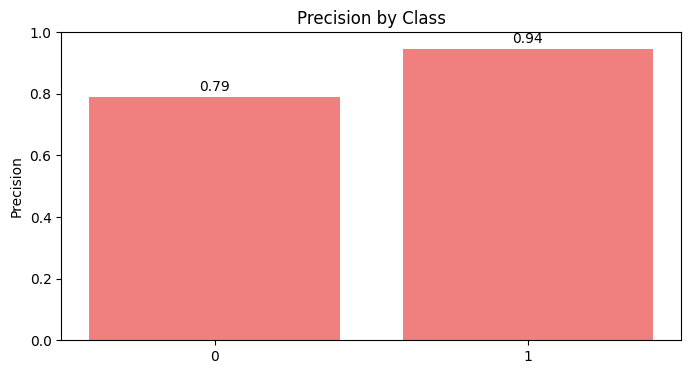

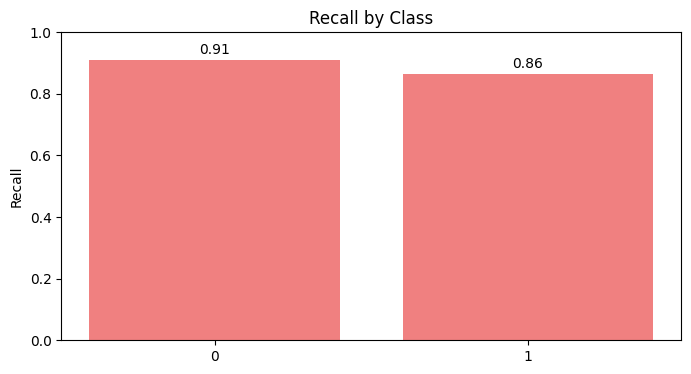

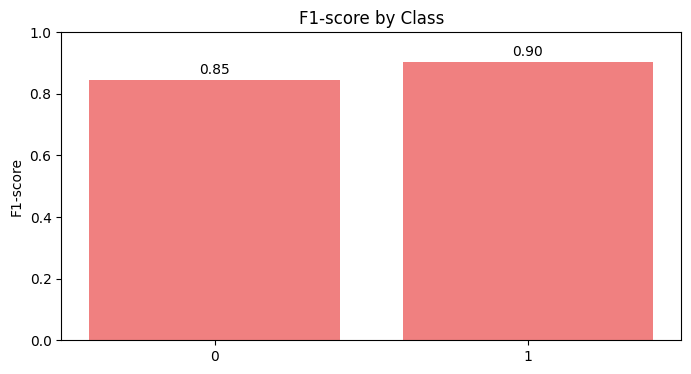

[I 2024-12-06 02:28:10,774] A new study created in memory with name: no-name-eddc6a70-ac7d-4fbd-a04b-12ac8d5f15b2
[I 2024-12-06 02:28:10,789] Trial 0 finished with value: 0.8488977713178294 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:10,816] Trial 1 finished with value: 0.8270227713178293 and parameters: {'n_neighbors': 3, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:10,841] Trial 2 finished with value: 0.8301841085271316 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:10,865] Trial 3 finished with value: 0.8317587209302324 and parameters: {'n_neighbors': 11, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:10,879] Trial 4 finished with value: 0.8441

Scenario dataset_scenario_5_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with optuna for dataset_scenario_6_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_6_N


[I 2024-12-06 02:28:10,981] Trial 10 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:11,001] Trial 11 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:11,019] Trial 12 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8488977713178294.
[I 2024-12-06 02:28:11,037] Trial 13 finished with value: 0.8504481589147286 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 13 with value: 0.8504481589147286.
[I 2024-12-06 02:28:11,056] Trial 14 finished with value: 0.8364462209302325 and parameters: {'n_neighbors': 5, 'weights': 'distance', 'metric': 'manhattan'}. Best is tria

Best hyperparameters:  {'n_neighbors': 8, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8724
  Recall: 0.8696
  F1 Score: 0.8700

Test Metrics:
  Accuracy: 0.8478
  Precision: 0.8660
  Recall: 0.8478
  F1 Score: 0.8505

Confusion Matrix (Test Set):
[[30  3]
 [11 48]]


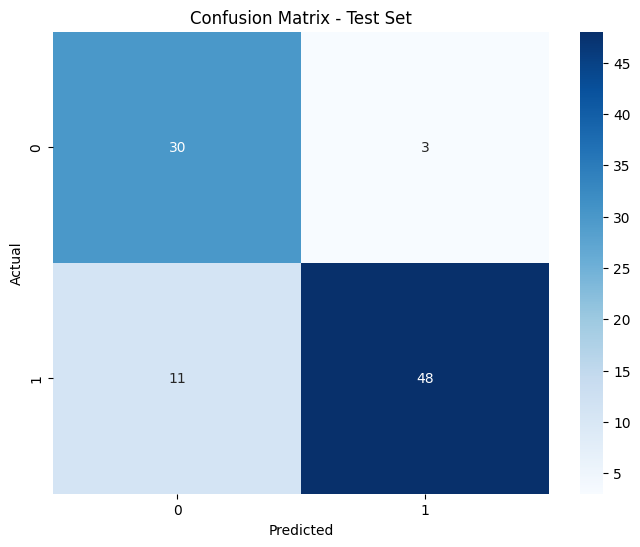

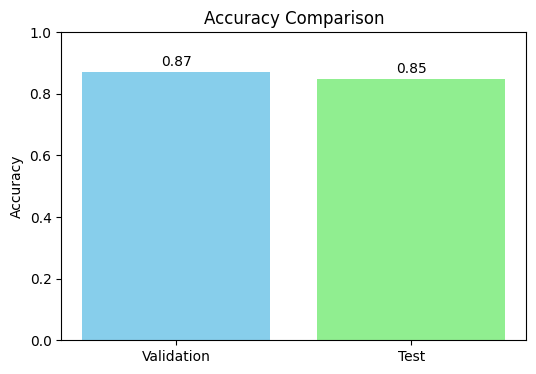

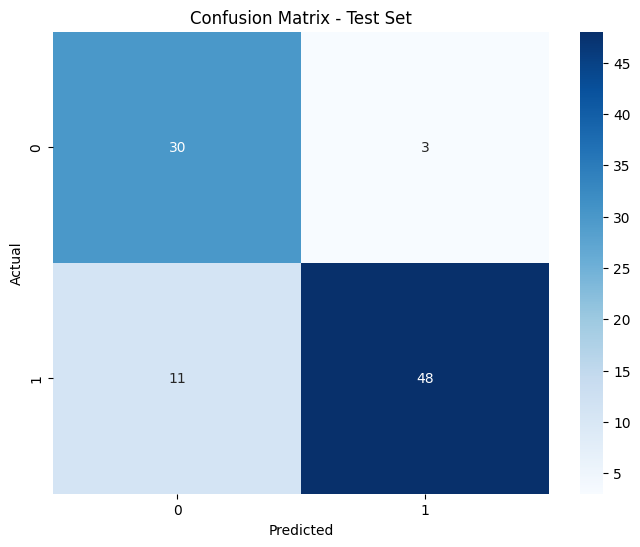

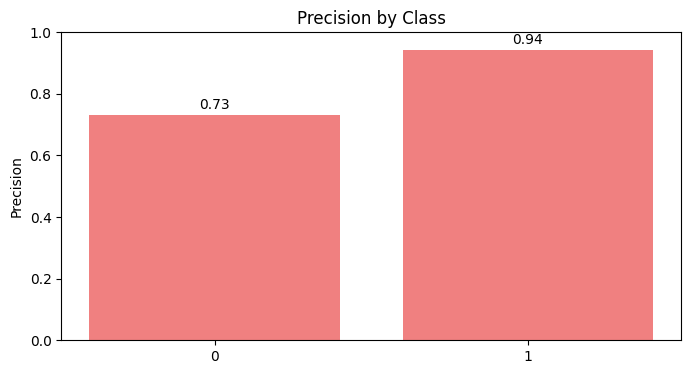

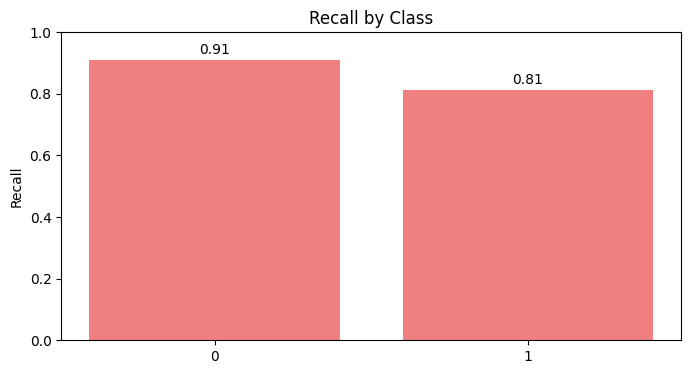

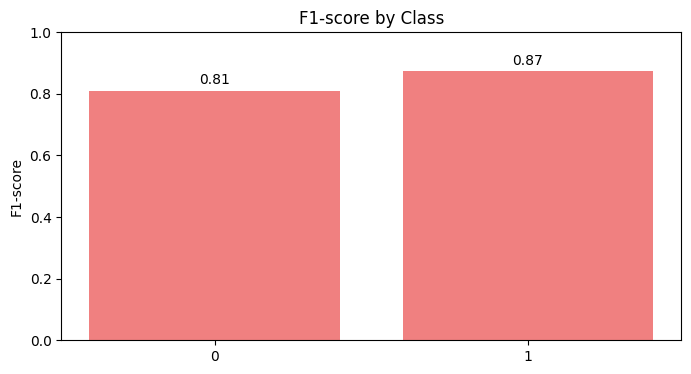

[I 2024-12-06 02:28:13,546] A new study created in memory with name: no-name-8b9f2b5a-ae68-456f-bae3-cea916c5faf8
[I 2024-12-06 02:28:13,572] Trial 0 finished with value: 0.8410610465116278 and parameters: {'n_neighbors': 9, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8410610465116278.
[I 2024-12-06 02:28:13,596] Trial 1 finished with value: 0.8317344961240309 and parameters: {'n_neighbors': 10, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8410610465116278.
[I 2024-12-06 02:28:13,621] Trial 2 finished with value: 0.8379360465116278 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8410610465116278.
[I 2024-12-06 02:28:13,636] Trial 3 finished with value: 0.8348473837209301 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8410610465116278.
[I 2024-12-06 02:28:13,651] Trial 4 finished with value: 0.8582

Scenario dataset_scenario_6_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_6_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_6_S


[I 2024-12-06 02:28:13,778] Trial 9 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 3, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8582122093023254.
[I 2024-12-06 02:28:13,797] Trial 10 finished with value: 0.8426477713178293 and parameters: {'n_neighbors': 15, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8582122093023254.
[I 2024-12-06 02:28:13,816] Trial 11 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 3, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8582122093023254.
[I 2024-12-06 02:28:13,834] Trial 12 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 3, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 4 with value: 0.8582122093023254.
[I 2024-12-06 02:28:13,863] Trial 13 finished with value: 0.8582122093023254 and parameters: {'n_neighbors': 6, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 

Best hyperparameters:  {'n_neighbors': 4, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8711
  Recall: 0.8696
  F1 Score: 0.8699

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8946
  Recall: 0.8804
  F1 Score: 0.8824

Confusion Matrix (Test Set):
[[31  2]
 [ 9 50]]


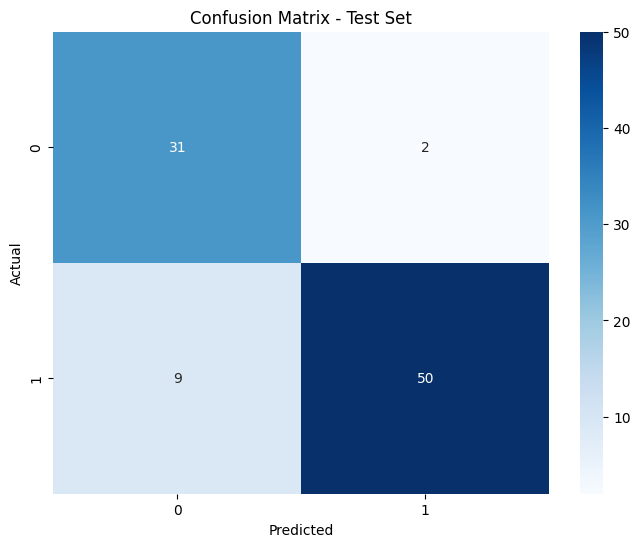

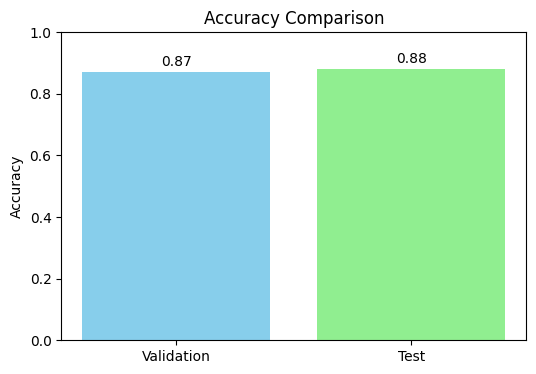

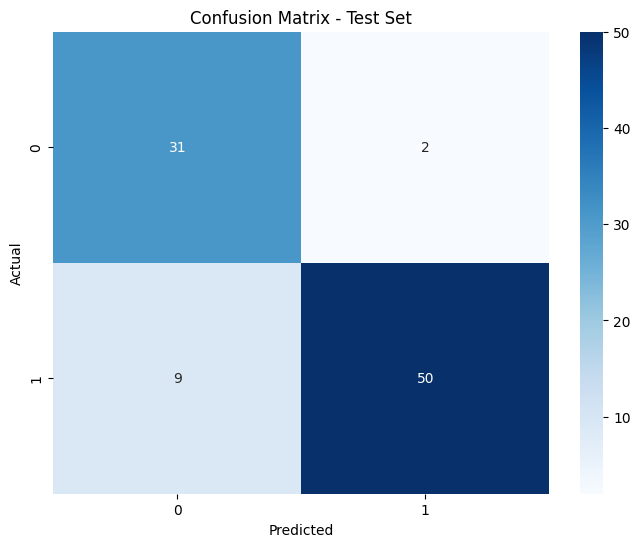

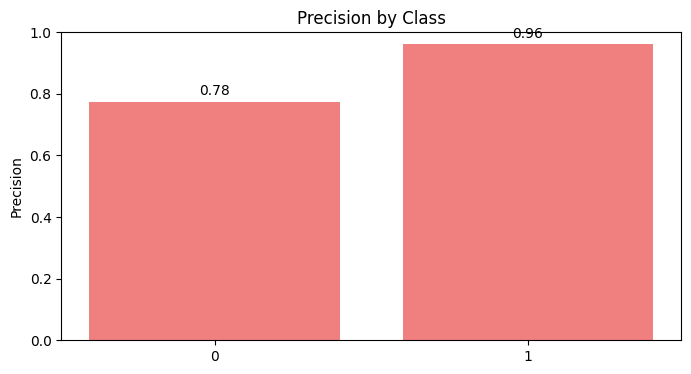

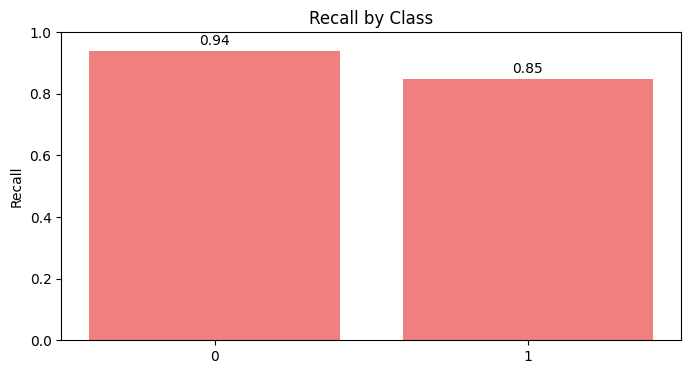

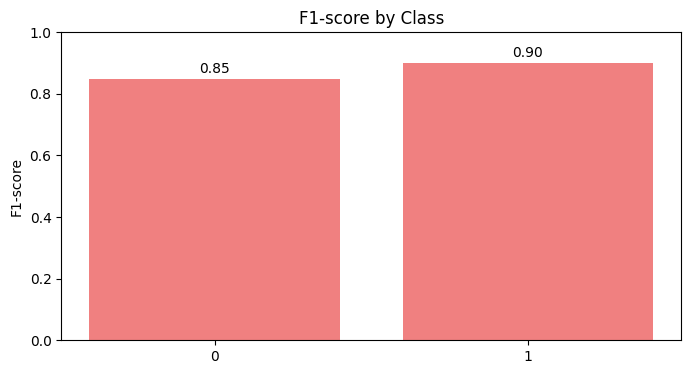

[I 2024-12-06 02:28:16,302] A new study created in memory with name: no-name-93da04b1-148b-4bff-a2a8-78082248314e
[I 2024-12-06 02:28:16,329] Trial 0 finished with value: 0.8412698412698413 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,343] Trial 1 finished with value: 0.8351061636775923 and parameters: {'n_neighbors': 13, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,358] Trial 2 finished with value: 0.8249433106575964 and parameters: {'n_neighbors': 14, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,383] Trial 3 finished with value: 0.8147598433312719 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,407] Trial 4 finished with value: 0.83

Scenario dataset_scenario_6_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running KNN with optuna for dataset_scenario_7_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_7_N


[I 2024-12-06 02:28:16,510] Trial 10 finished with value: 0.820923520923521 and parameters: {'n_neighbors': 4, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,540] Trial 11 finished with value: 0.8290661719233148 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,559] Trial 12 finished with value: 0.8372088229231087 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,588] Trial 13 finished with value: 0.8107400535971964 and parameters: {'n_neighbors': 3, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8412698412698413.
[I 2024-12-06 02:28:16,615] Trial 14 finished with value: 0.8290661719233148 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 wit

Best hyperparameters:  {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'euclidean'}
Validation Metrics:
  Accuracy: 0.8214
  Precision: 0.8243
  Recall: 0.8214
  F1 Score: 0.8218

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8441
  Recall: 0.8310
  F1 Score: 0.8316

Confusion Matrix (Test Set):
[[31  9]
 [ 3 28]]


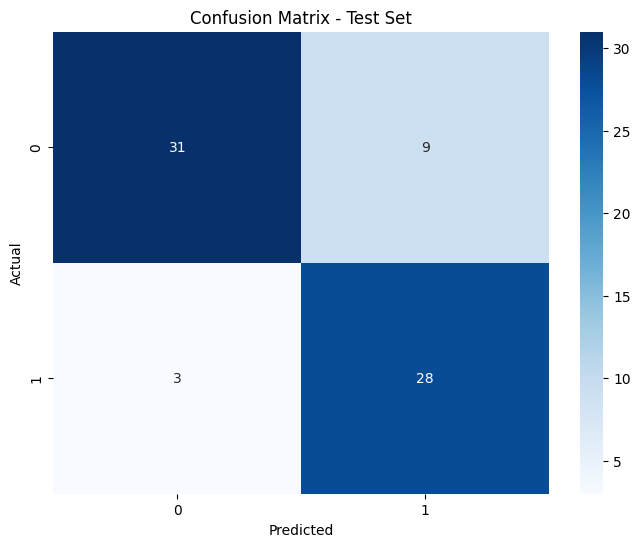

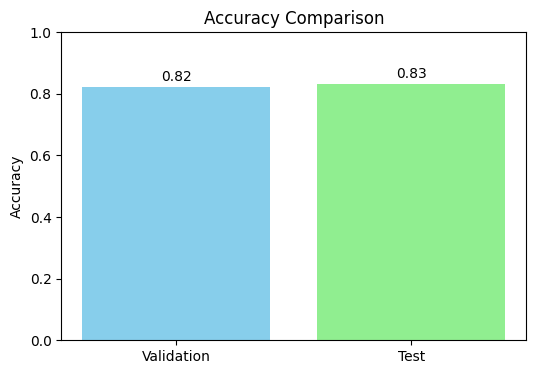

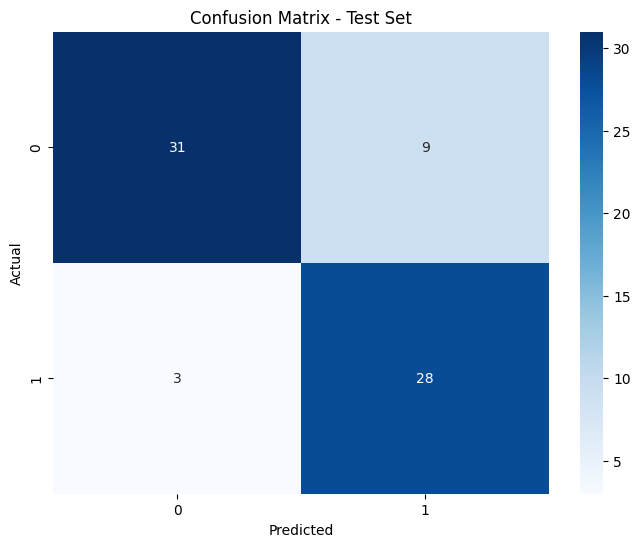

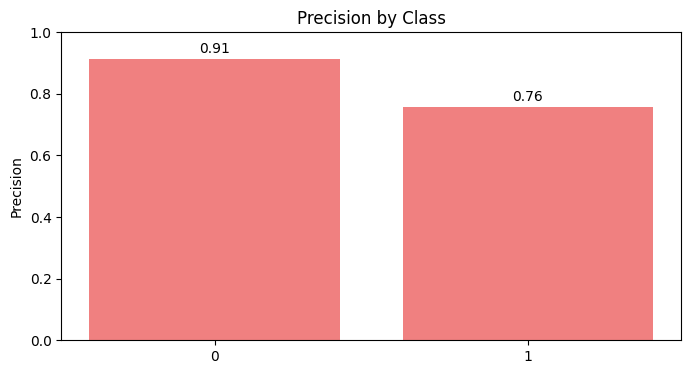

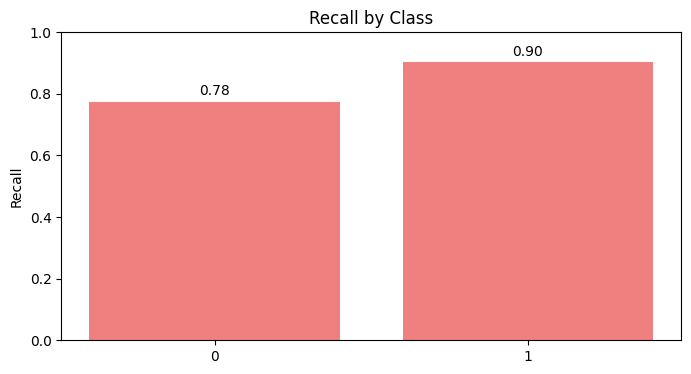

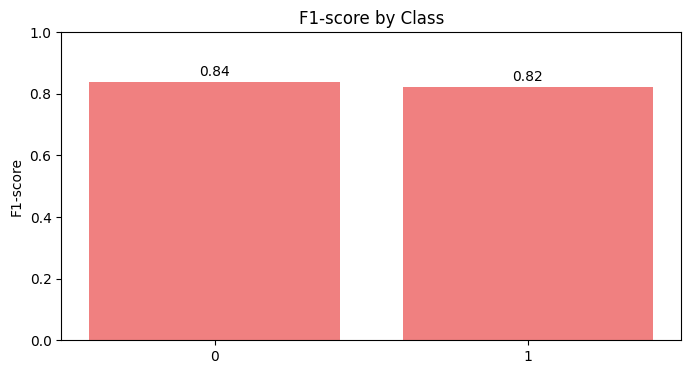

[I 2024-12-06 02:28:19,639] A new study created in memory with name: no-name-502f76ae-0b02-48d9-9e61-8397c7b41ad6
[I 2024-12-06 02:28:19,654] Trial 0 finished with value: 0.8310657596371882 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8310657596371882.
[I 2024-12-06 02:28:19,678] Trial 1 finished with value: 0.8249226963512678 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 0 with value: 0.8310657596371882.
[I 2024-12-06 02:28:19,703] Trial 2 finished with value: 0.8351473922902495 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,718] Trial 3 finished with value: 0.8351061636775923 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,733] Trial 4 finished with value: 0.82700

Scenario dataset_scenario_7_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_7_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_7_S


[I 2024-12-06 02:28:19,845] Trial 10 finished with value: 0.8289631003916718 and parameters: {'n_neighbors': 6, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,874] Trial 11 finished with value: 0.8188827045969903 and parameters: {'n_neighbors': 8, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,893] Trial 12 finished with value: 0.828963100391672 and parameters: {'n_neighbors': 5, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,923] Trial 13 finished with value: 0.8351473922902495 and parameters: {'n_neighbors': 9, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8351473922902495.
[I 2024-12-06 02:28:19,953] Trial 14 finished with value: 0.8229437229437229 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 2 w

Best hyperparameters:  {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8500
  Precision: 0.8513
  Recall: 0.8500
  F1 Score: 0.8503

Test Metrics:
  Accuracy: 0.8310
  Precision: 0.8376
  Recall: 0.8310
  F1 Score: 0.8317

Confusion Matrix (Test Set):
[[32  8]
 [ 4 27]]


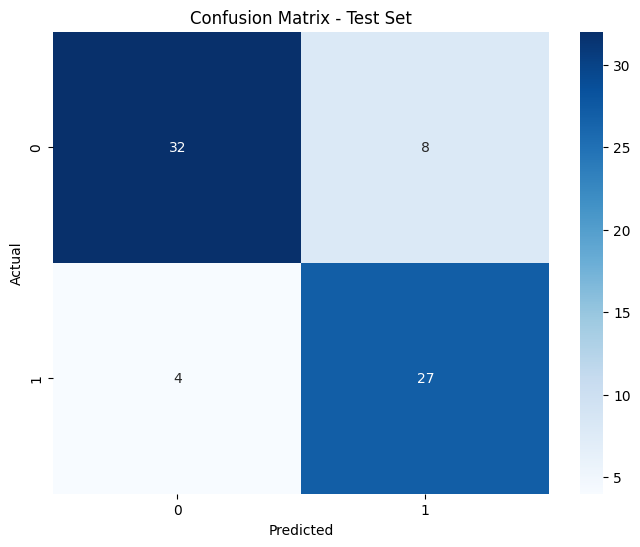

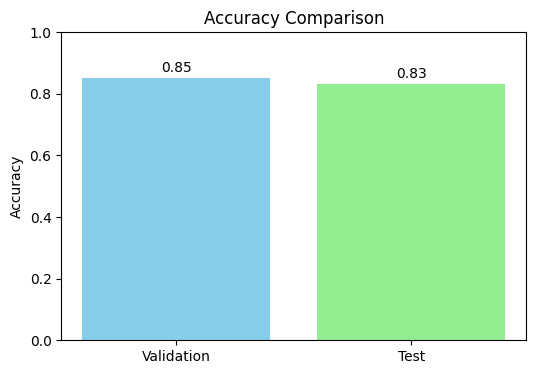

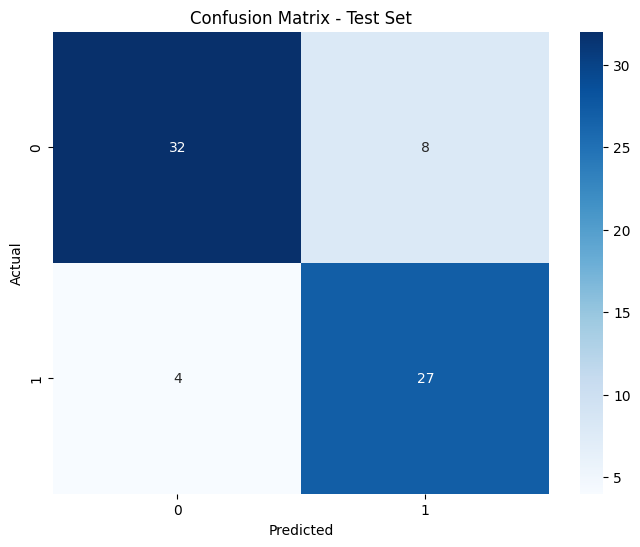

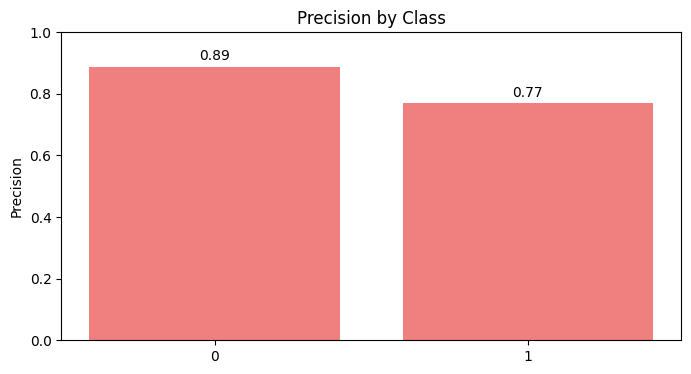

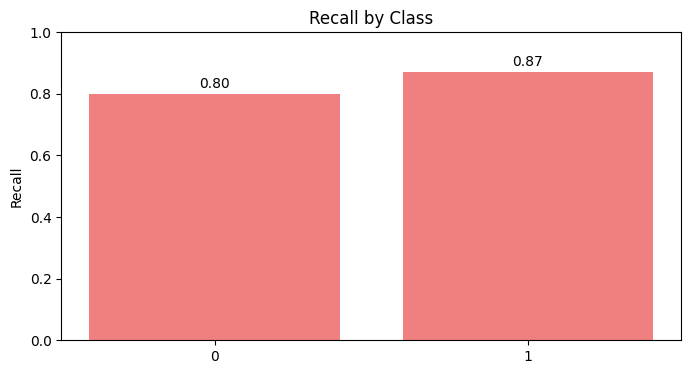

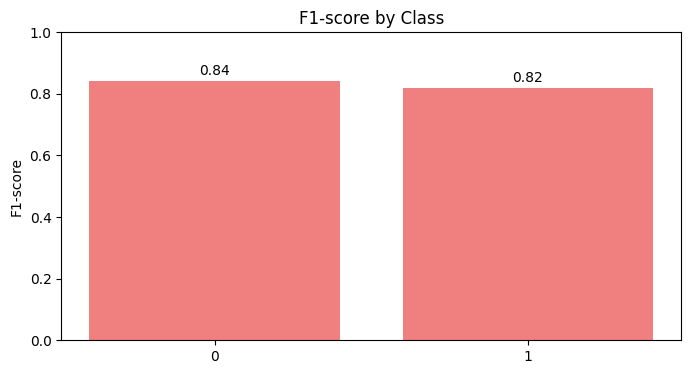

[I 2024-12-06 02:28:22,380] A new study created in memory with name: no-name-4f27dabb-8f2e-474e-8c54-6a734e85e977
[I 2024-12-06 02:28:22,405] Trial 0 finished with value: 0.8255087209302324 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 0 with value: 0.8255087209302324.
[I 2024-12-06 02:28:22,420] Trial 1 finished with value: 0.8255208333333333 and parameters: {'n_neighbors': 5, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8255208333333333.
[I 2024-12-06 02:28:22,445] Trial 2 finished with value: 0.8364462209302325 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 2 with value: 0.8364462209302325.
[I 2024-12-06 02:28:22,460] Trial 3 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 9, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8504360465116279.
[I 2024-12-06 02:28:22,475] Trial 4 finished with value: 0.8348

Scenario dataset_scenario_7_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running KNN with optuna for dataset_scenario_8_N...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_8_N


[I 2024-12-06 02:28:22,590] Trial 9 finished with value: 0.8364462209302325 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 3 with value: 0.8504360465116279.
[I 2024-12-06 02:28:22,620] Trial 10 finished with value: 0.858236434108527 and parameters: {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 10 with value: 0.858236434108527.
[I 2024-12-06 02:28:22,640] Trial 11 finished with value: 0.858236434108527 and parameters: {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 10 with value: 0.858236434108527.
[I 2024-12-06 02:28:22,659] Trial 12 finished with value: 0.8504360465116279 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 10 with value: 0.858236434108527.
[I 2024-12-06 02:28:22,678] Trial 13 finished with value: 0.858236434108527 and parameters: {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial

Best hyperparameters:  {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8696
  Precision: 0.8724
  Recall: 0.8696
  F1 Score: 0.8700

Test Metrics:
  Accuracy: 0.8804
  Precision: 0.8889
  Recall: 0.8804
  F1 Score: 0.8820

Confusion Matrix (Test Set):
[[30  3]
 [ 8 51]]


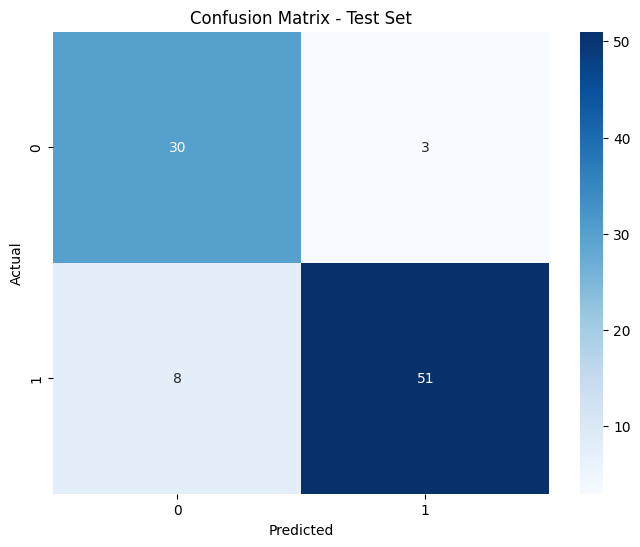

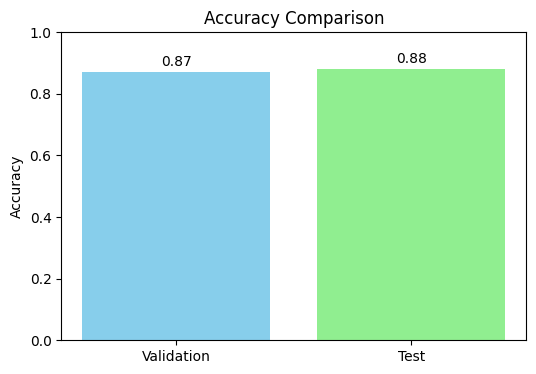

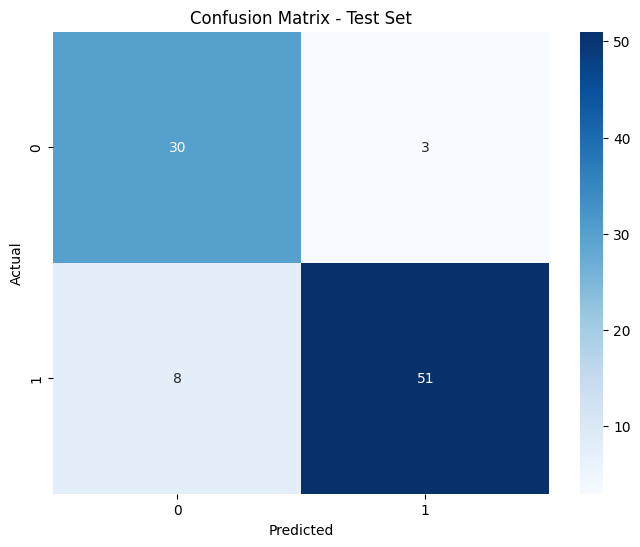

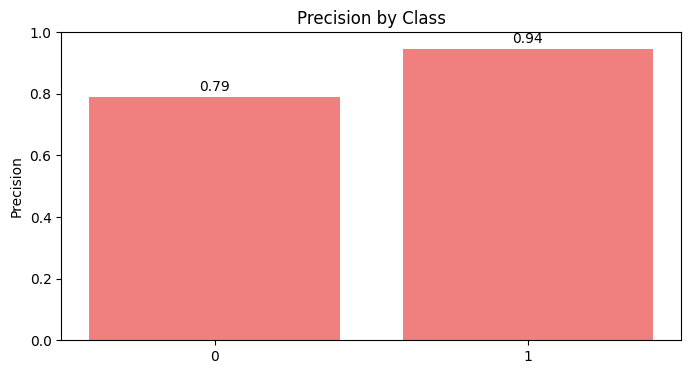

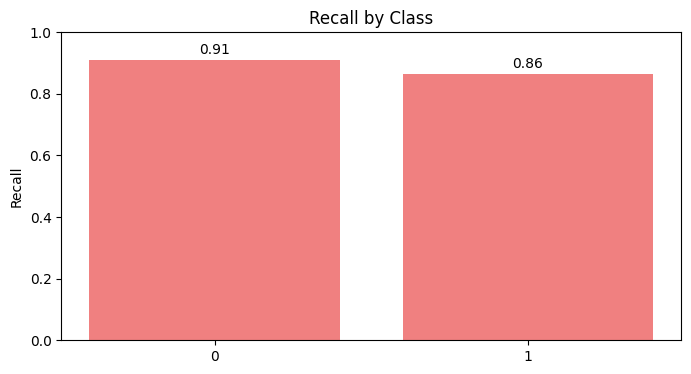

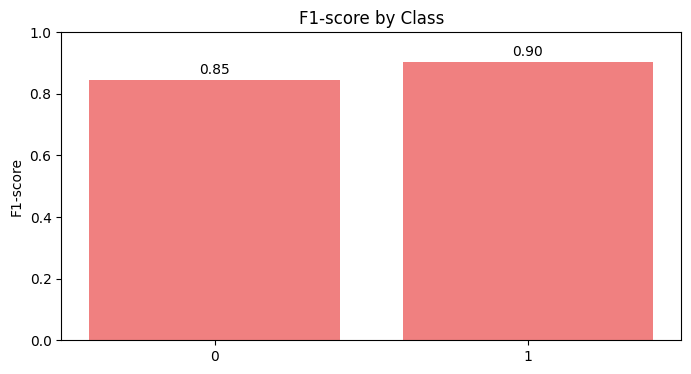

[I 2024-12-06 02:28:25,242] A new study created in memory with name: no-name-71f21143-99a3-471d-8060-4dd3e9e8cac1
[I 2024-12-06 02:28:25,268] Trial 0 finished with value: 0.8395348837209301 and parameters: {'n_neighbors': 5, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.8395348837209301.
[I 2024-12-06 02:28:25,296] Trial 1 finished with value: 0.8535489341085271 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,323] Trial 2 finished with value: 0.8285973837209302 and parameters: {'n_neighbors': 13, 'weights': 'uniform', 'metric': 'euclidean'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,338] Trial 3 finished with value: 0.8317587209302324 and parameters: {'n_neighbors': 8, 'weights': 'distance', 'metric': 'euclidean'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,363] Trial 4 finished with value: 0.8286

Scenario dataset_scenario_8_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running KNN with optuna for dataset_scenario_8_S...
Results will be saved in: SCORES\KNN\optuna\dataset_scenario_8_S


[I 2024-12-06 02:28:25,454] Trial 8 finished with value: 0.8317223837209301 and parameters: {'n_neighbors': 14, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,470] Trial 9 finished with value: 0.8519743217054263 and parameters: {'n_neighbors': 9, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,489] Trial 10 finished with value: 0.8473231589147285 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 1 with value: 0.8535489341085271.
[I 2024-12-06 02:28:25,518] Trial 11 finished with value: 0.8582122093023254 and parameters: {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}. Best is trial 11 with value: 0.8582122093023254.
[I 2024-12-06 02:28:25,536] Trial 12 finished with value: 0.8472868217054262 and parameters: {'n_neighbors': 11, 'weights': 'distance', 'metric': 'manhattan'}. Best is tria

Best hyperparameters:  {'n_neighbors': 10, 'weights': 'distance', 'metric': 'manhattan'}
Validation Metrics:
  Accuracy: 0.8750
  Precision: 0.8771
  Recall: 0.8750
  F1 Score: 0.8754

Test Metrics:
  Accuracy: 0.9022
  Precision: 0.9059
  Recall: 0.9022
  F1 Score: 0.9030

Confusion Matrix (Test Set):
[[30  3]
 [ 6 53]]


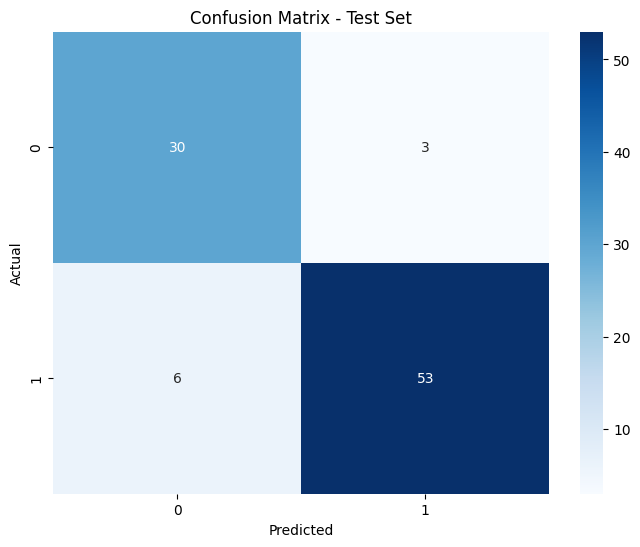

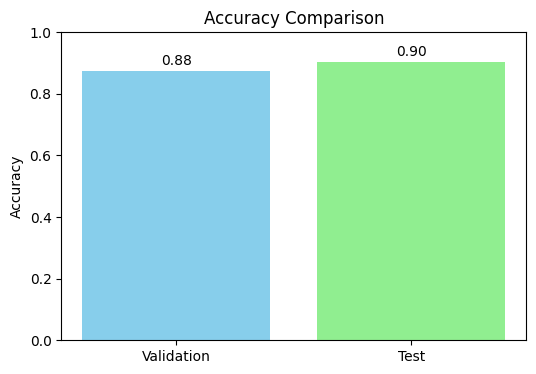

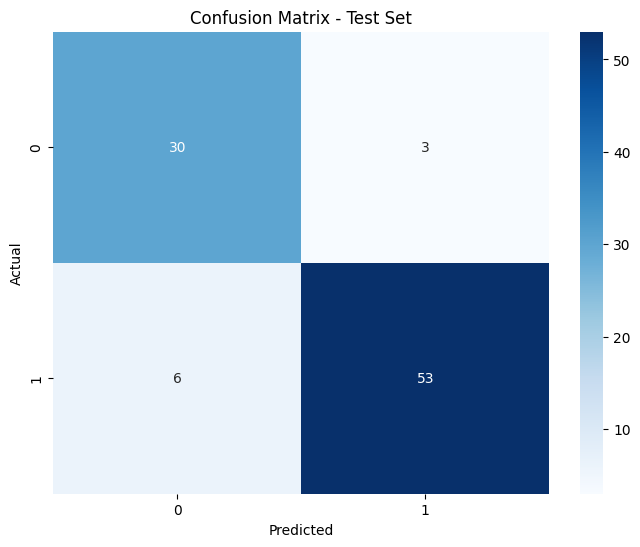

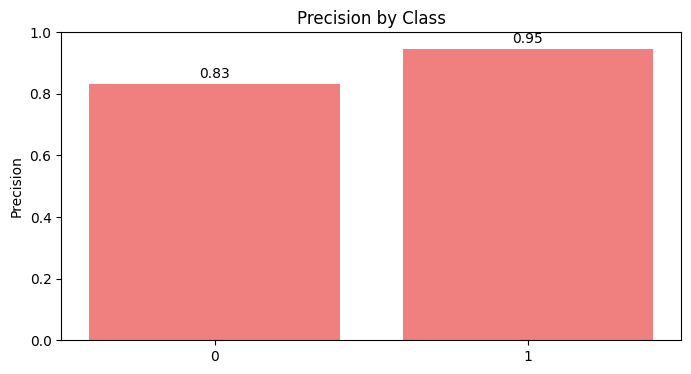

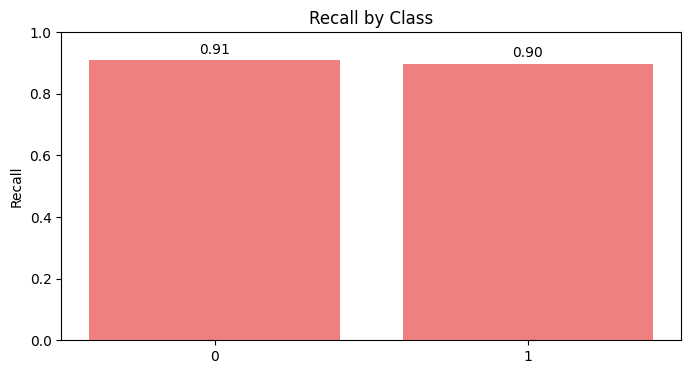

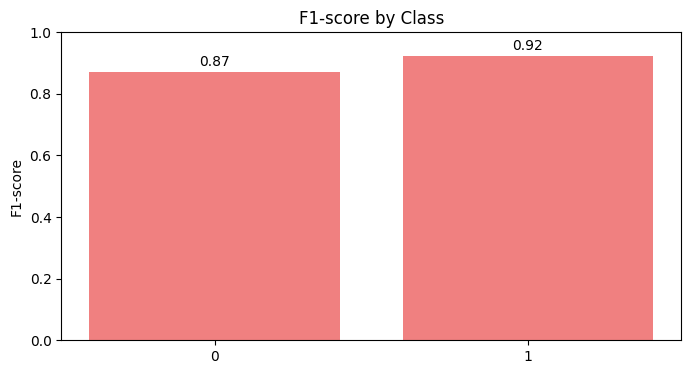

Scenario dataset_scenario_8_S with optuna completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8641
  Precision: 0.8644
  Recall: 0.8641
  F1 Score: 0.8642

Test Metrics:
  Accuracy: 0.9130
  Precision: 0.9235
  Recall: 0.9130
  F1 Score: 0.9143

Confusion Matrix (Test Set):
[[32  1]
 [ 7 52]]


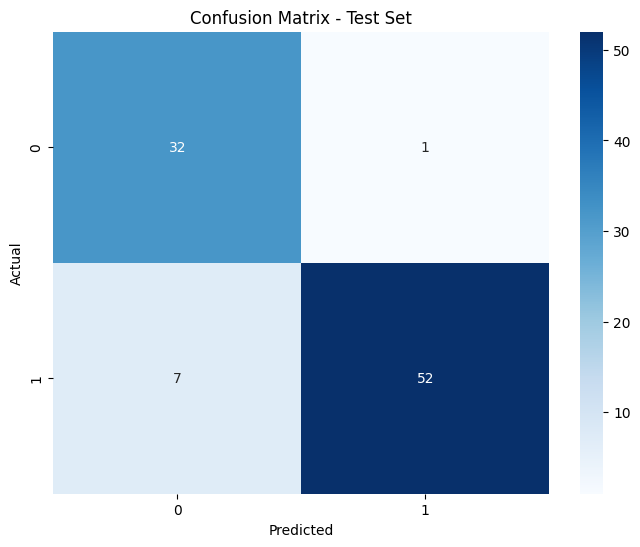

In [65]:
KNN_optuna_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "KNN", "optuna", search_config_optuna, get_search_hyperparameters("KNN"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        KNN_optuna_search['accuracy'] = best_score
        KNN_optuna_search['params'] = best_params
        KNN_optuna_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
knn = KNeighborsClassifier(**KNN_optuna_search['params'])
best_scenario = pd.read_csv(KNN_optuna_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, knn) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "KNN", "optuna")
save_model_info(KNN_optuna_search, "KNN", "optuna")
    

# Decision Tree

## 1. Grid Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with grid for dataset_scenario_1_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_1_N
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 10}
Validation Metrics:
  Accuracy: 0.7337
  Precision: 0.7415
  Recall: 0.7337
  F1 Score: 0.7350

Test Metrics:
  Accuracy: 0.7391
  Precision: 0.7477
  Recall: 0.7391
  F1 Score: 0.7420

Confusion Matrix (Test Set):
[[23 10]
 [14 45]]


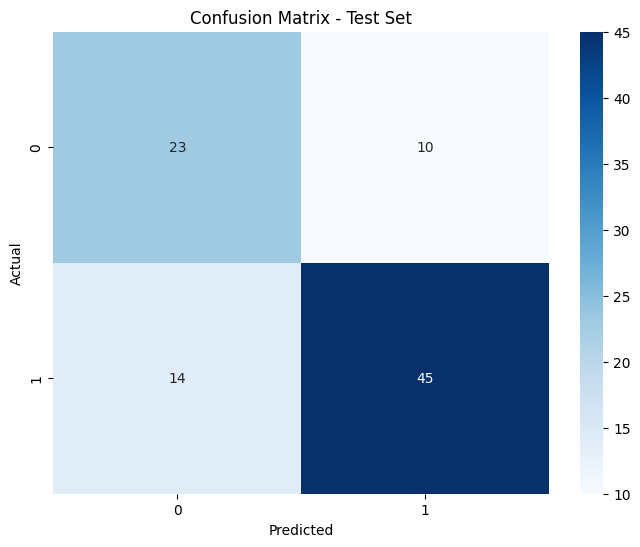

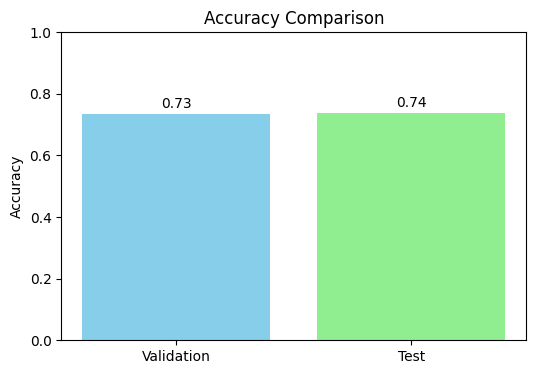

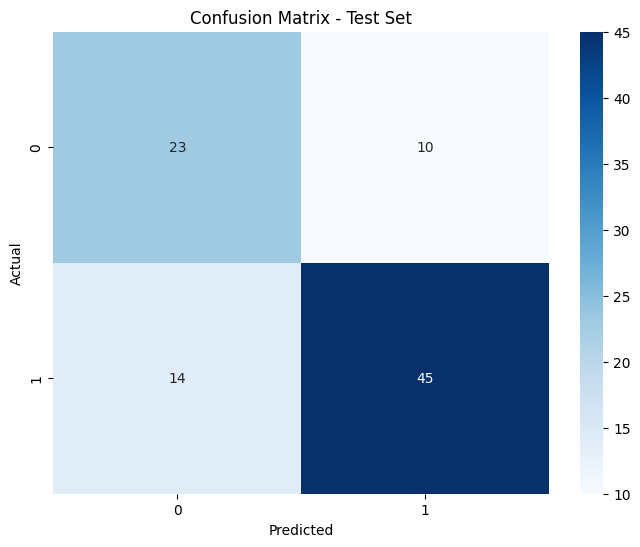

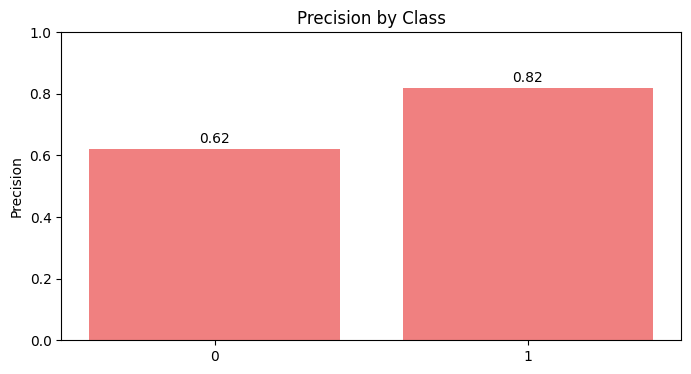

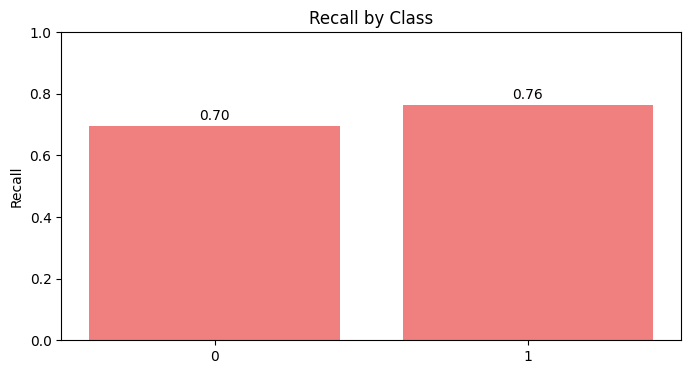

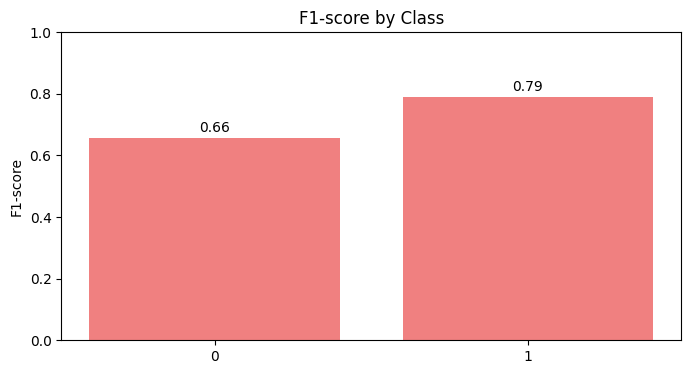

Scenario dataset_scenario_1_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_1_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_1_S
Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.8098
  Precision: 0.8254
  Recall: 0.8098
  F1 Score: 0.8106

Test Metrics:
  Accuracy: 0.7609
  Precision: 0.7744
  Recall: 0.7609
  F1 Score: 0.7644

Confusion Matrix (Test Set):
[[25  8]
 [14 45]]


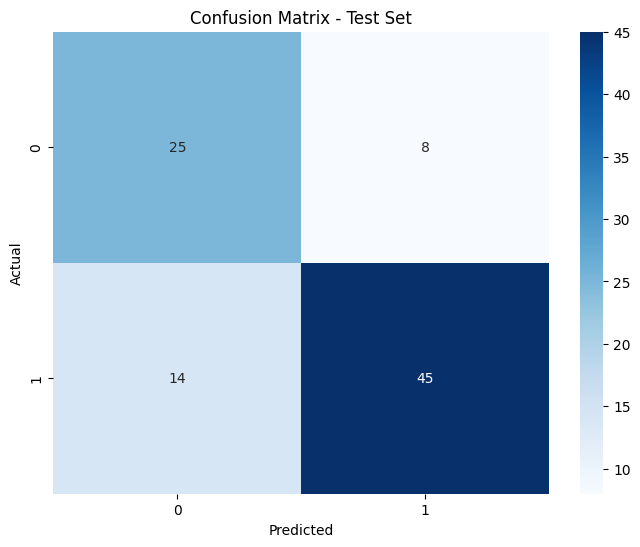

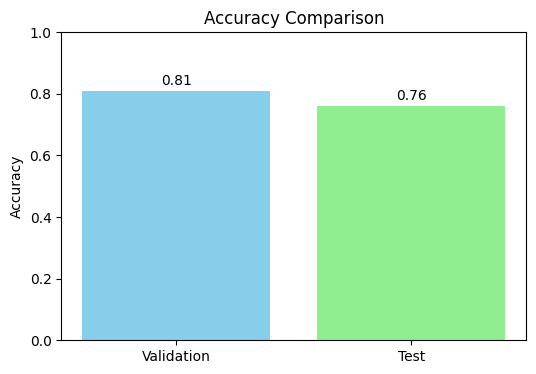

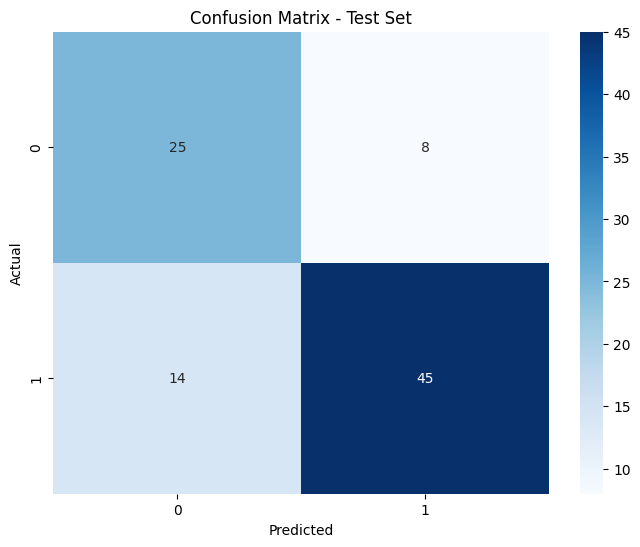

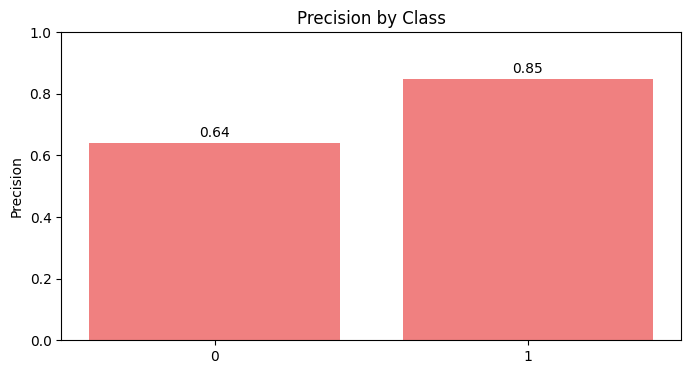

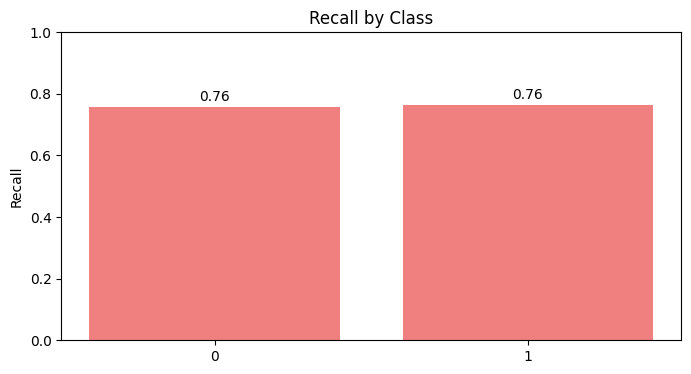

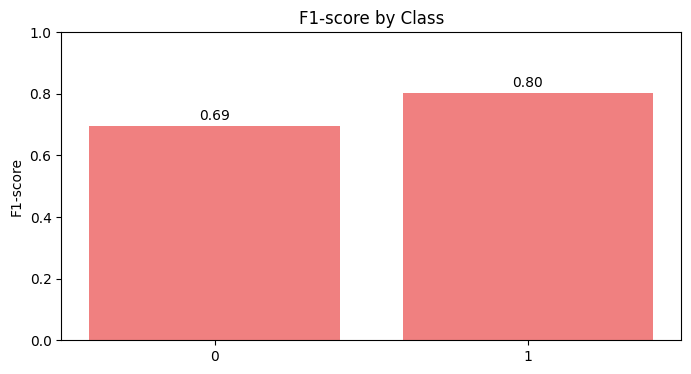

Scenario dataset_scenario_1_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running DecisionTree with grid for dataset_scenario_2_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_2_N
Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7663
  Precision: 0.7721
  Recall: 0.7663
  F1 Score: 0.7674

Test Metrics:
  Accuracy: 0.7500
  Precision: 0.7736
  Recall: 0.7500
  F1 Score: 0.7547

Confusion Matrix (Test Set):
[[26  7]
 [16 43]]


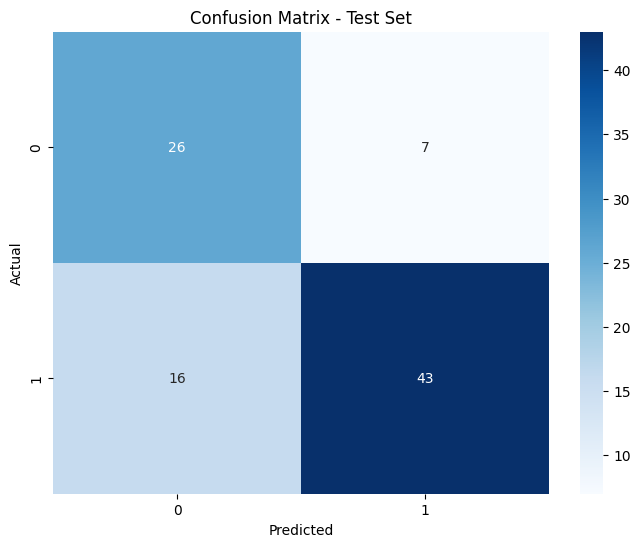

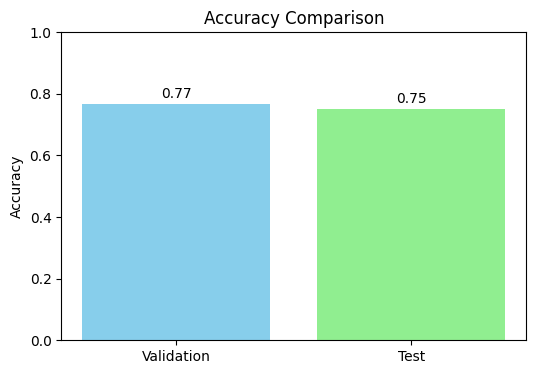

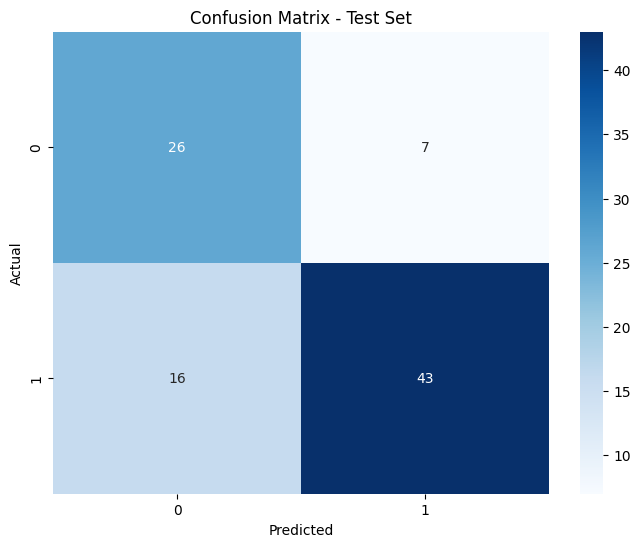

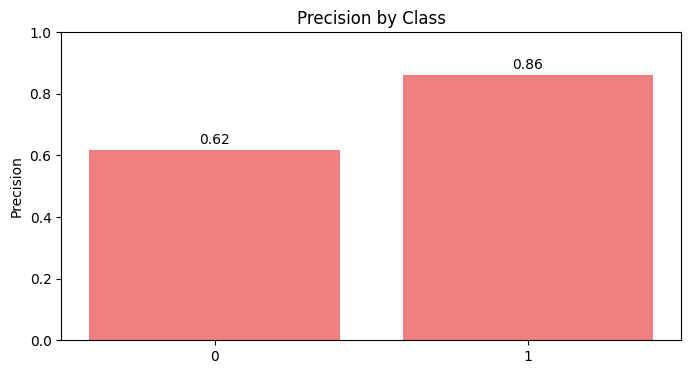

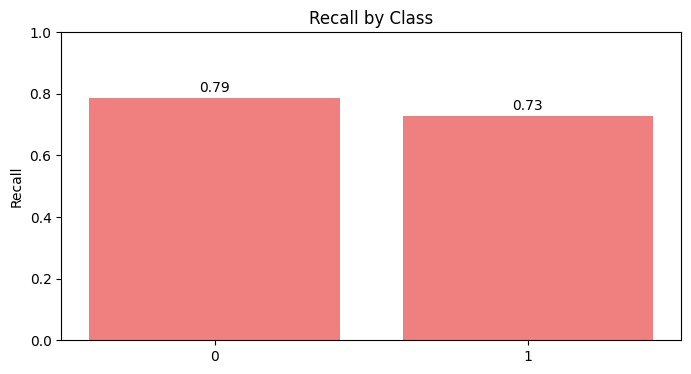

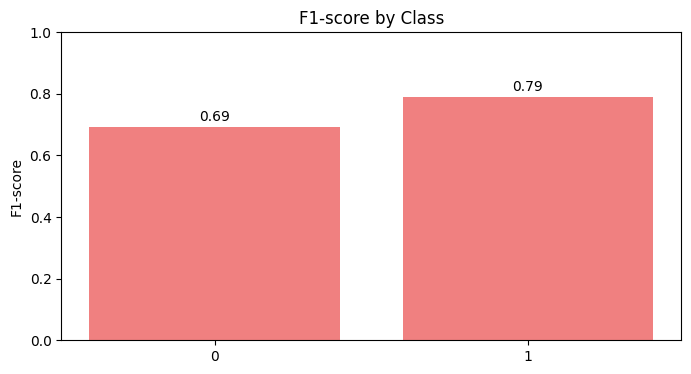

Scenario dataset_scenario_2_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_2_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_2_S
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7914
  Recall: 0.7826
  F1 Score: 0.7837

Test Metrics:
  Accuracy: 0.7500
  Precision: 0.7812
  Recall: 0.7500
  F1 Score: 0.7550

Confusion Matrix (Test Set):
[[27  6]
 [17 42]]


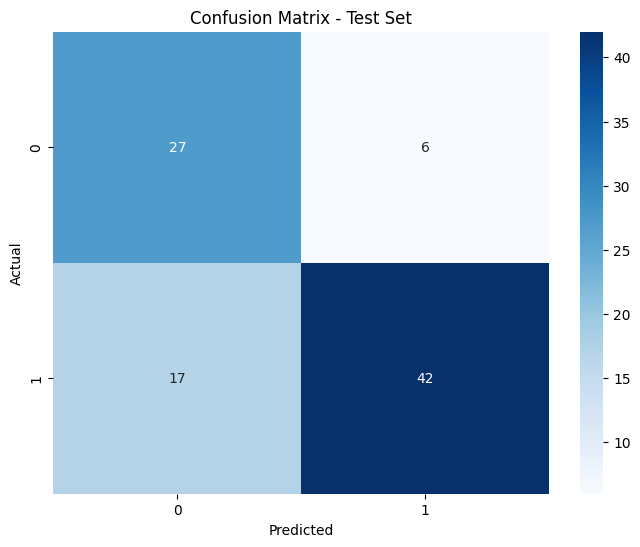

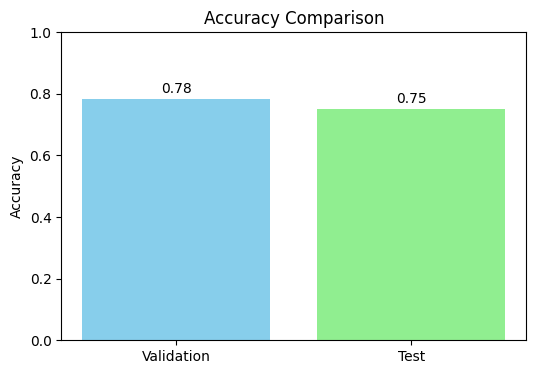

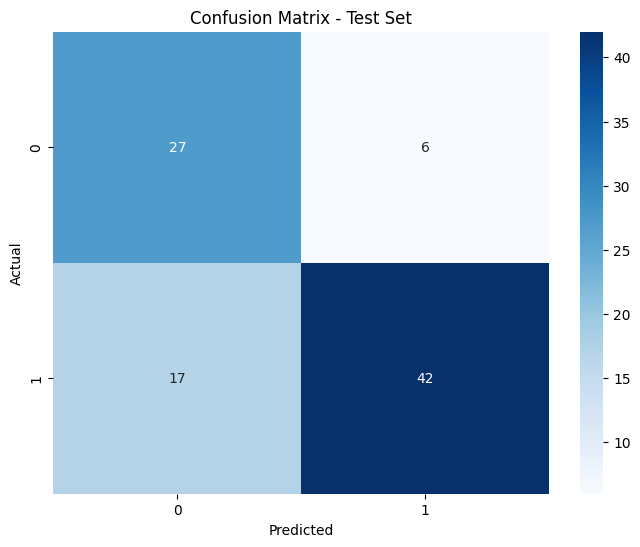

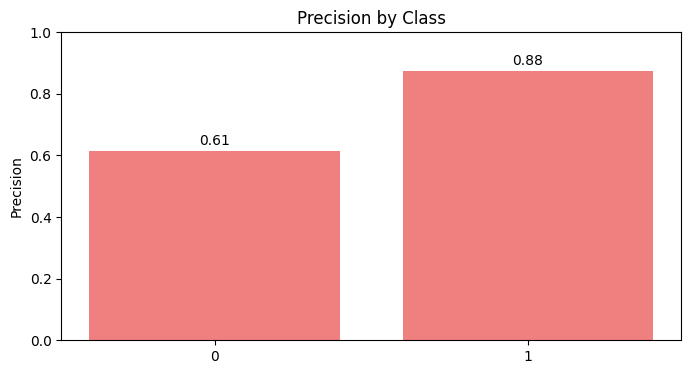

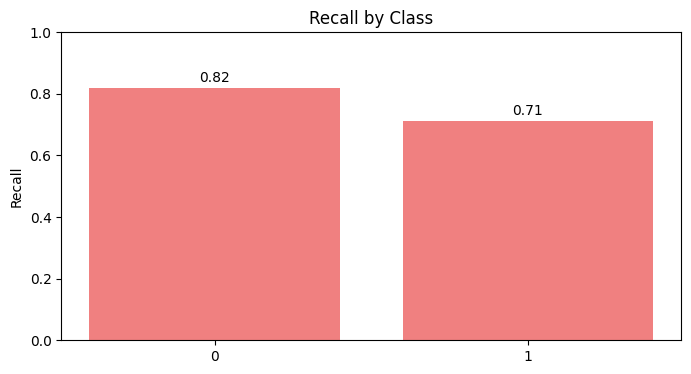

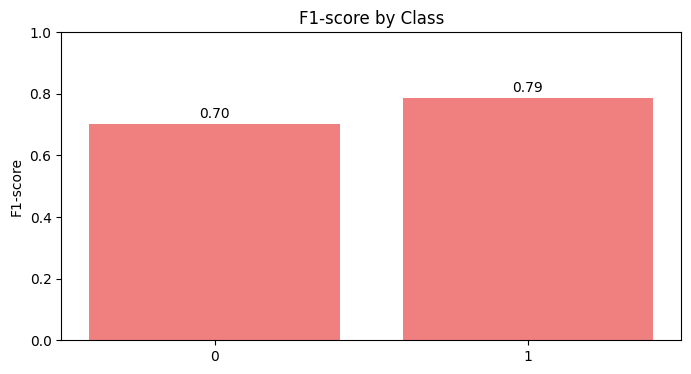

Scenario dataset_scenario_2_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with grid for dataset_scenario_3_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_3_N
Best hyperparameters:  {'criterion': 'gini', 'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 10}
Validation Metrics:
  Accuracy: 0.8143
  Precision: 0.8150
  Recall: 0.8143
  F1 Score: 0.8131

Test Metrics:
  Accuracy: 0.7606
  Precision: 0.7700
  Recall: 0.7606
  F1 Score: 0.7615

Confusion Matrix (Test Set):
[[29 11]
 [ 6 25]]


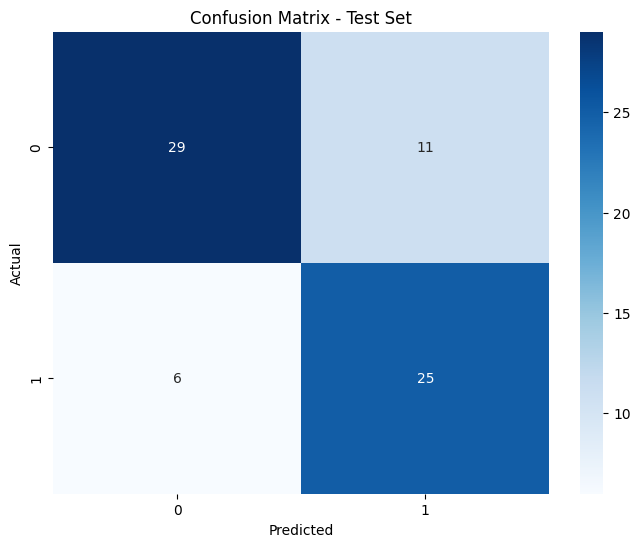

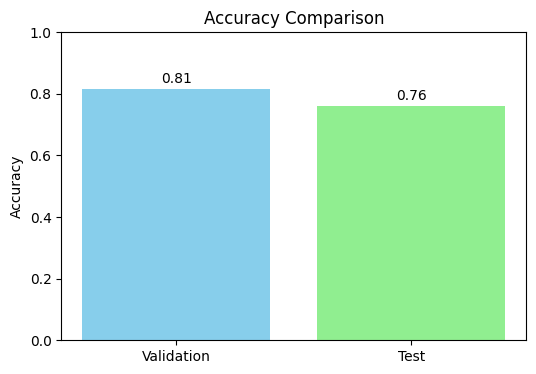

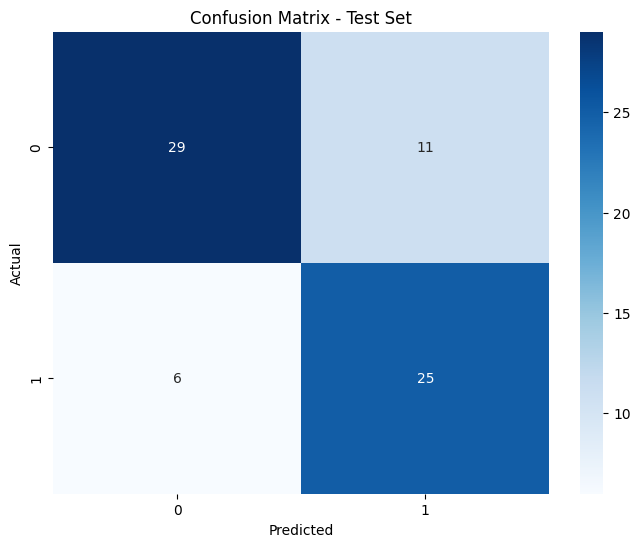

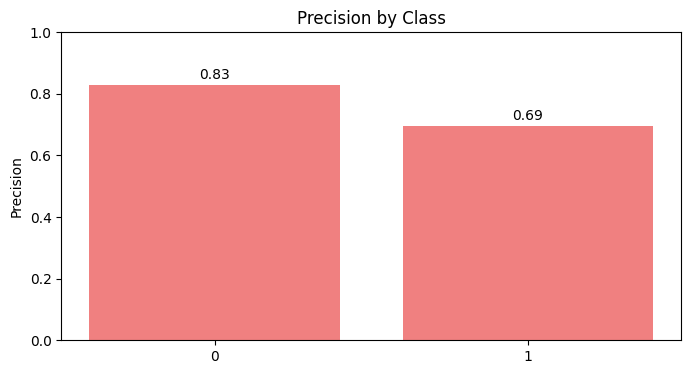

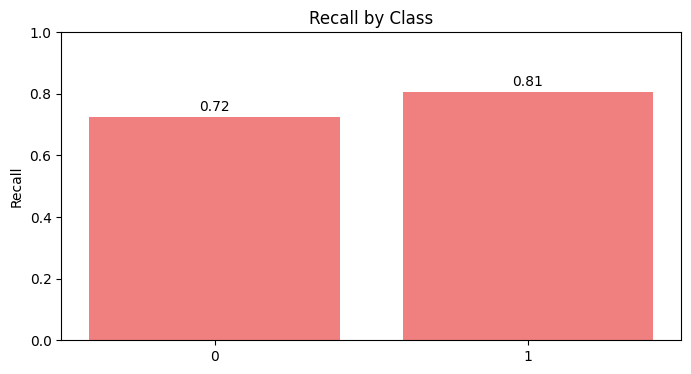

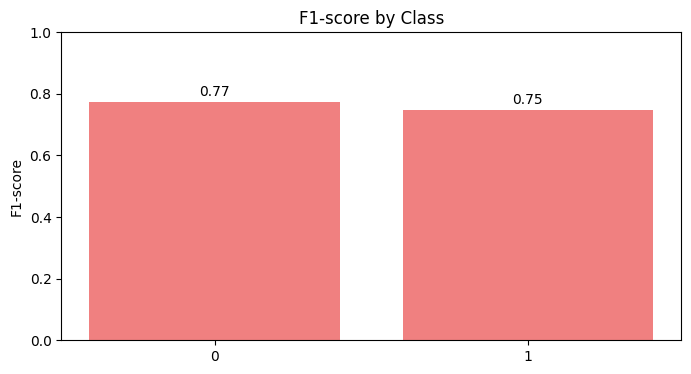

Scenario dataset_scenario_3_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_3_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_3_S
Best hyperparameters:  {'criterion': 'gini', 'max_depth': 40, 'min_samples_leaf': 4, 'min_samples_split': 10}
Validation Metrics:
  Accuracy: 0.8143
  Precision: 0.8142
  Recall: 0.8143
  F1 Score: 0.8136

Test Metrics:
  Accuracy: 0.7746
  Precision: 0.7814
  Recall: 0.7746
  F1 Score: 0.7755

Confusion Matrix (Test Set):
[[30 10]
 [ 6 25]]


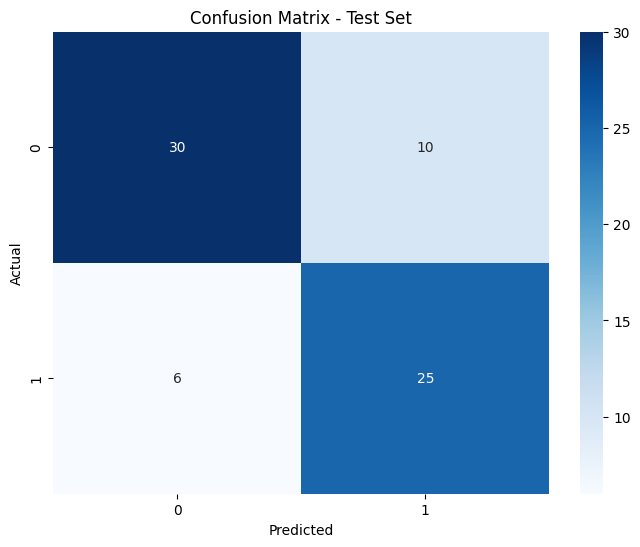

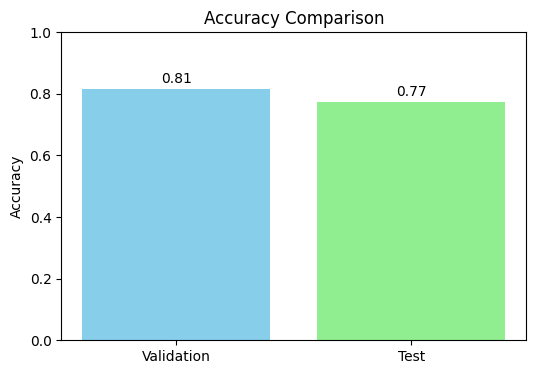

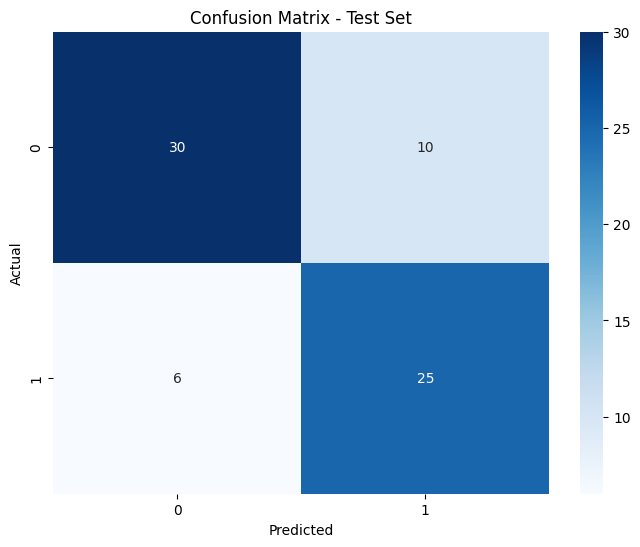

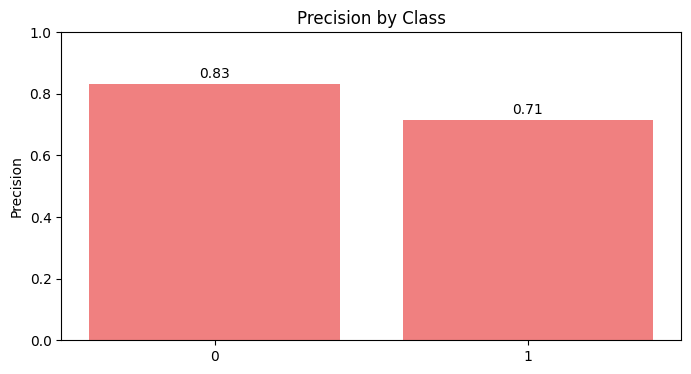

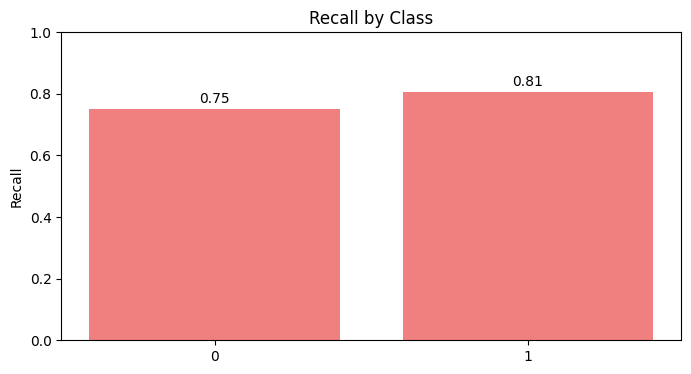

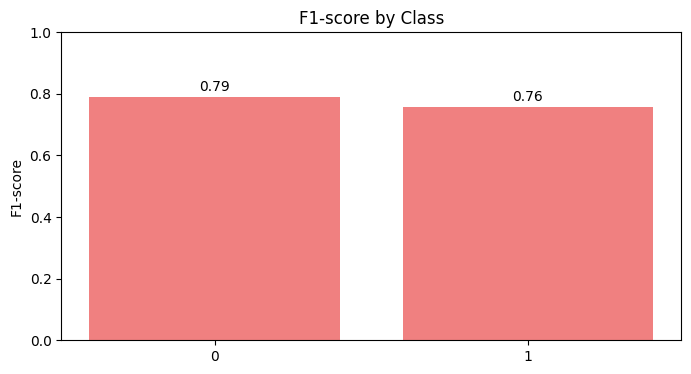

Scenario dataset_scenario_3_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with grid for dataset_scenario_4_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_4_N
Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 40, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7663
  Precision: 0.7704
  Recall: 0.7663
  F1 Score: 0.7672

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8117
  Recall: 0.8043
  F1 Score: 0.8065

Confusion Matrix (Test Set):
[[26  7]
 [11 48]]


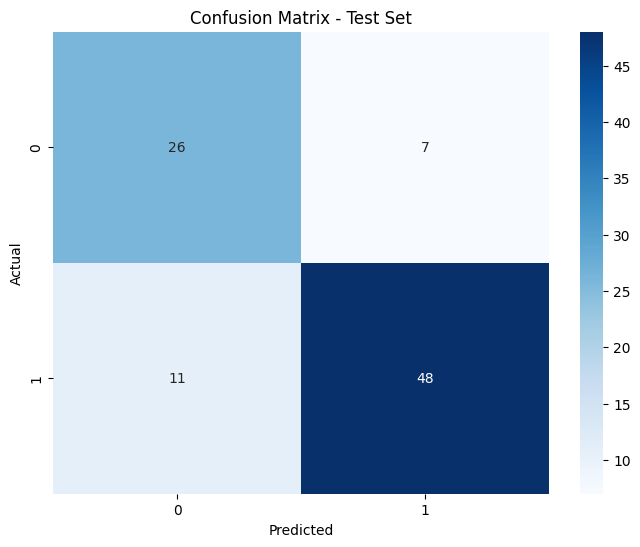

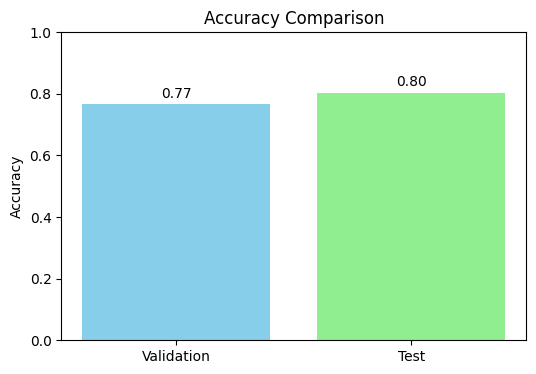

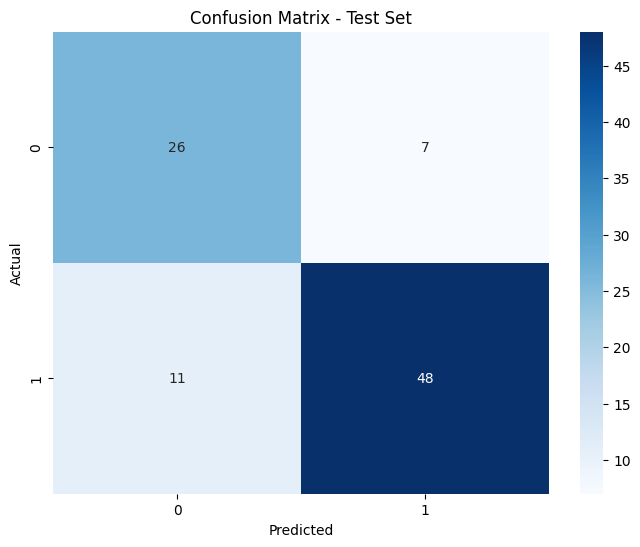

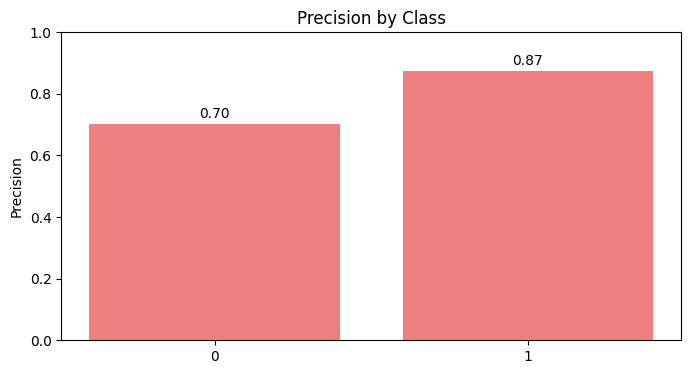

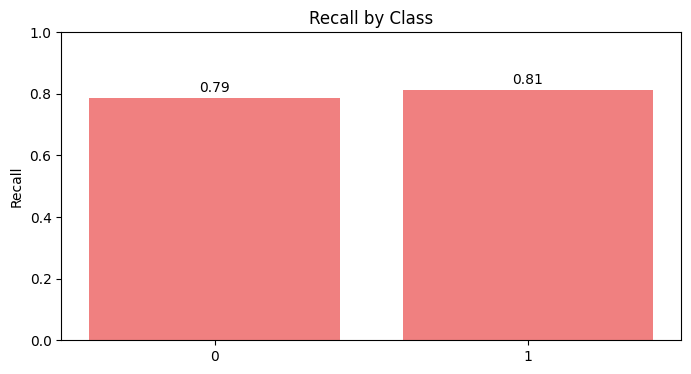

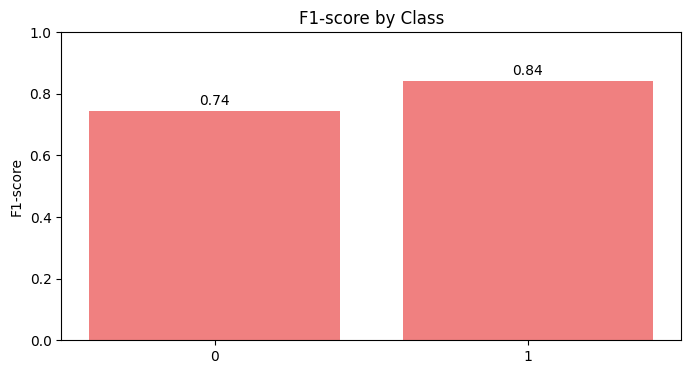

Scenario dataset_scenario_4_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_4_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_4_S
Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7880
  Precision: 0.8006
  Recall: 0.7880
  F1 Score: 0.7891

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


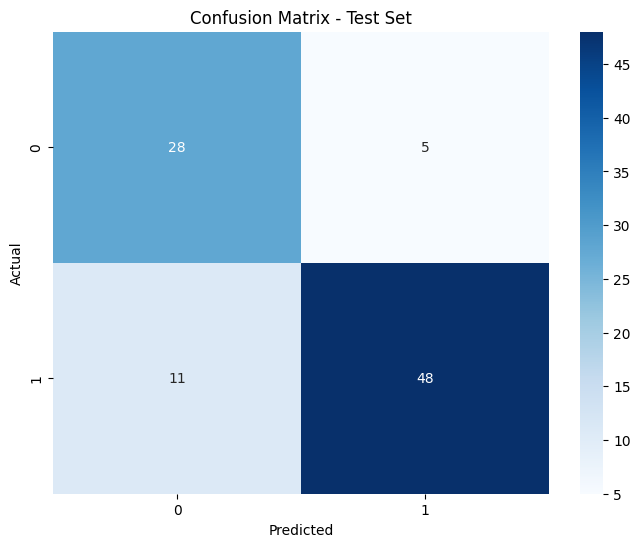

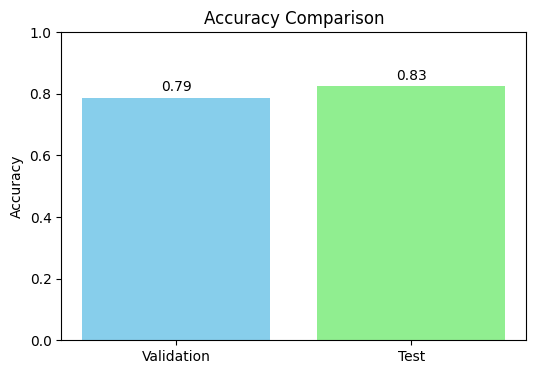

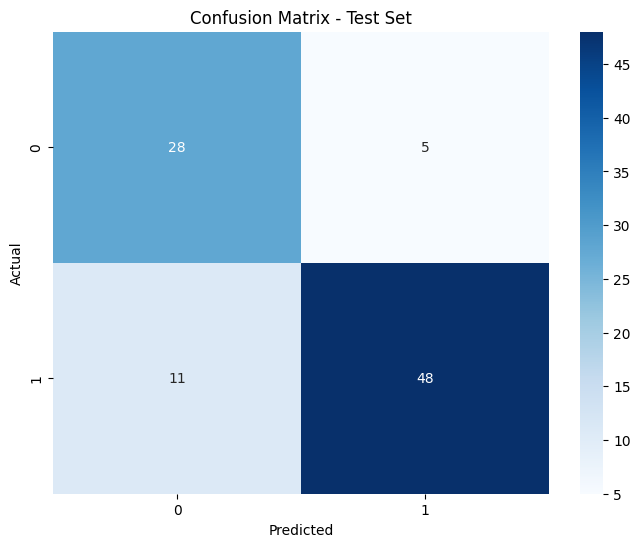

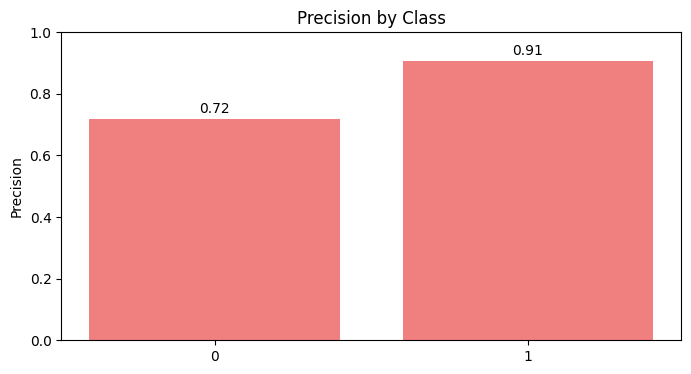

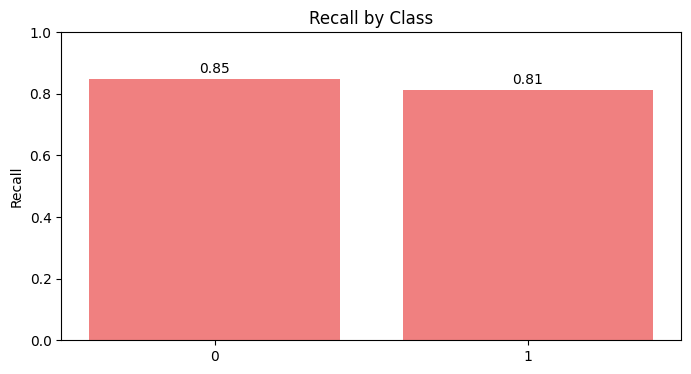

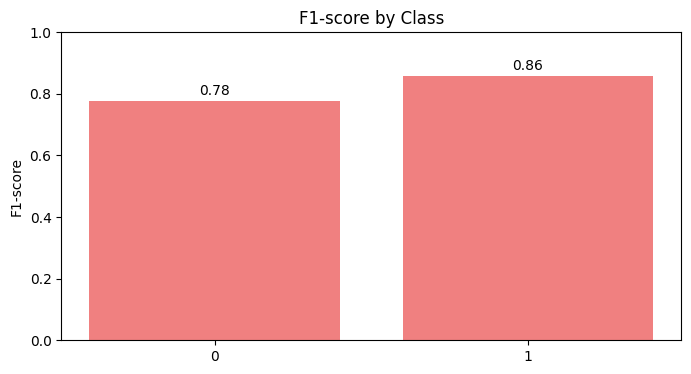

Scenario dataset_scenario_4_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with grid for dataset_scenario_5_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_5_N
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7554
  Precision: 0.7654
  Recall: 0.7554
  F1 Score: 0.7567

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7774
  Recall: 0.7717
  F1 Score: 0.7737

Confusion Matrix (Test Set):
[[24  9]
 [12 47]]


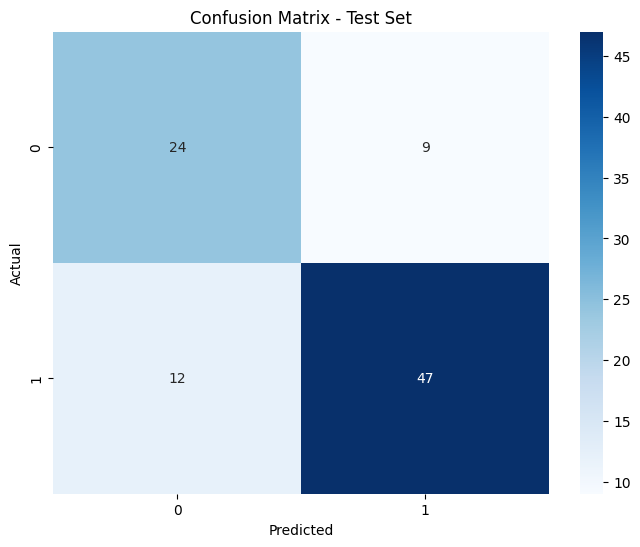

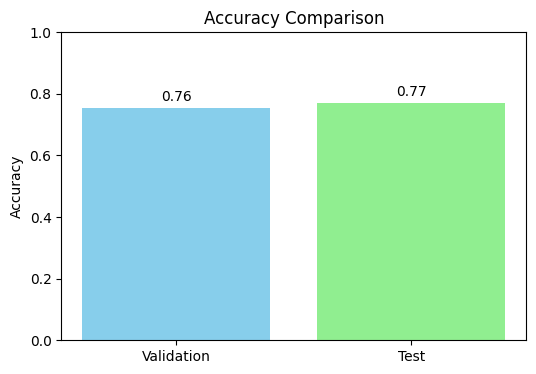

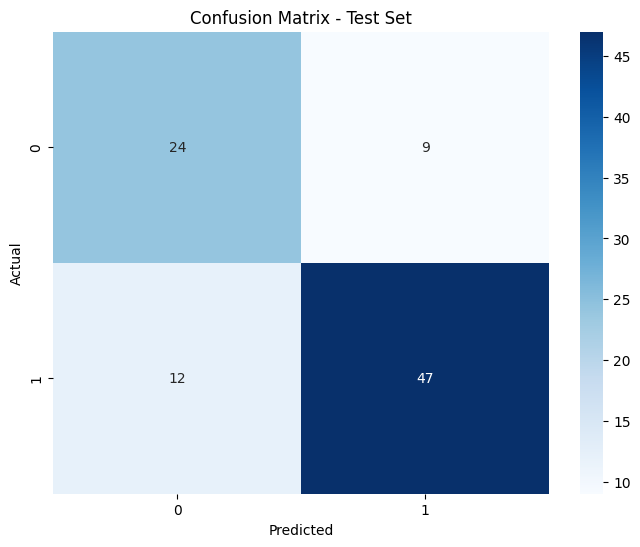

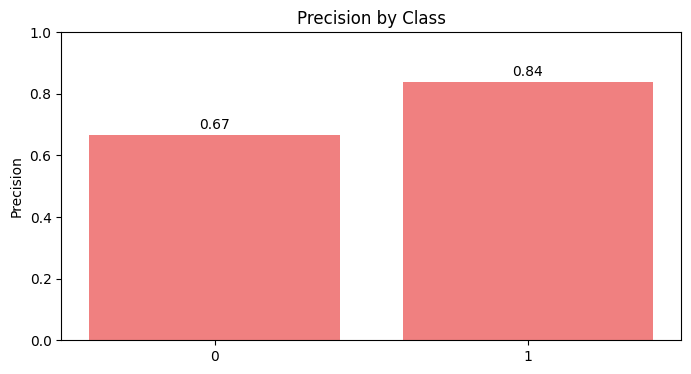

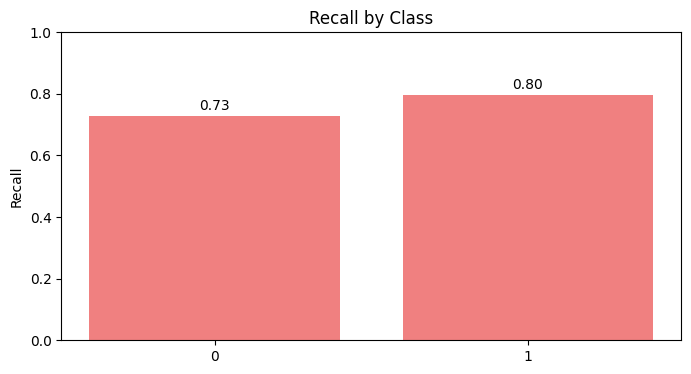

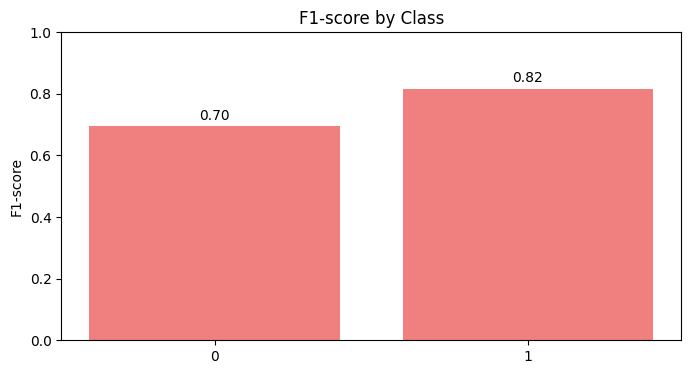

Scenario dataset_scenario_5_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_5_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_5_S
Best hyperparameters:  {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7893
  Recall: 0.7826
  F1 Score: 0.7836

Test Metrics:
  Accuracy: 0.7174
  Precision: 0.7530
  Recall: 0.7174
  F1 Score: 0.7231

Confusion Matrix (Test Set):
[[26  7]
 [19 40]]


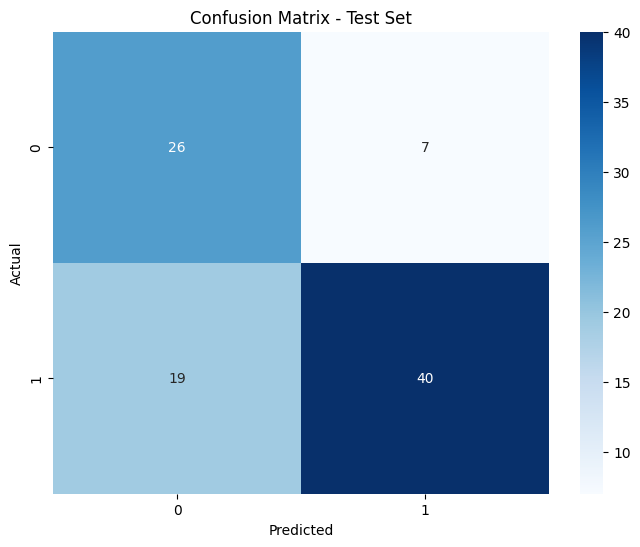

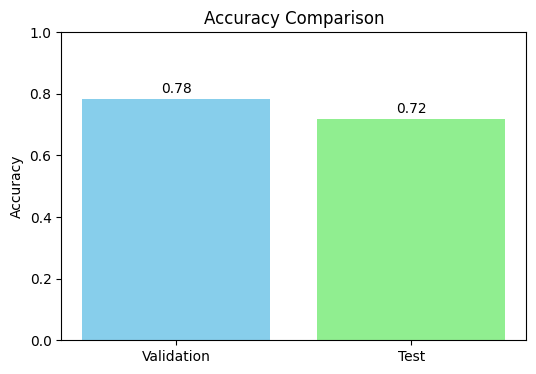

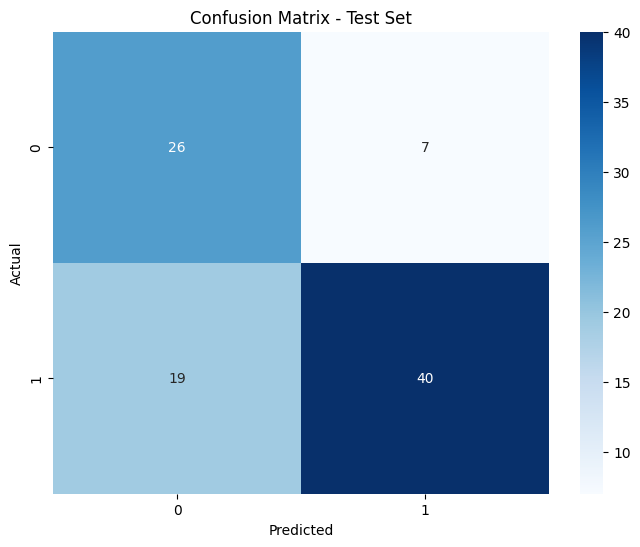

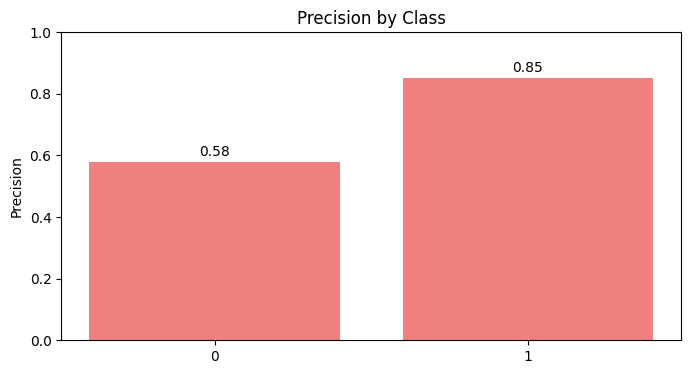

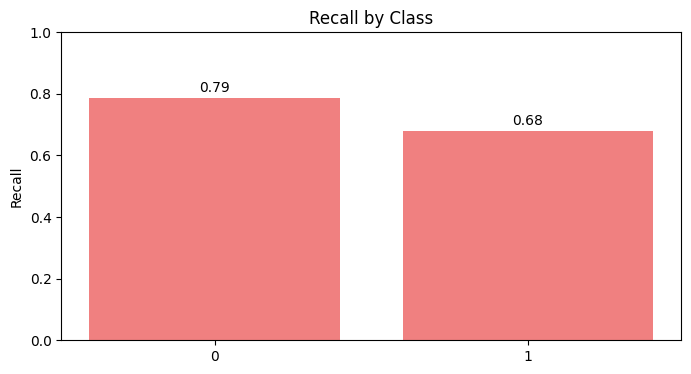

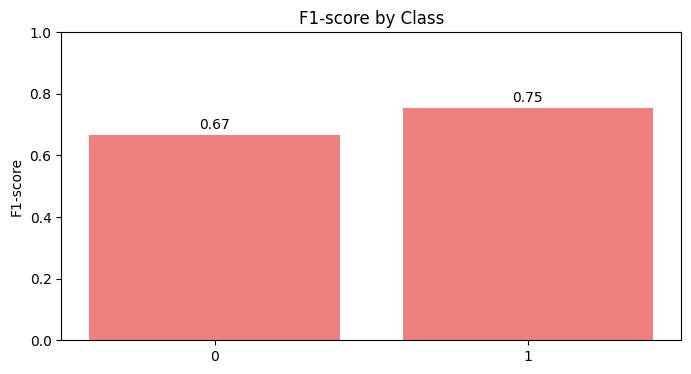

Scenario dataset_scenario_5_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with grid for dataset_scenario_6_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_6_N
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7500
  Precision: 0.7568
  Recall: 0.7500
  F1 Score: 0.7512

Test Metrics:
  Accuracy: 0.7174
  Precision: 0.7381
  Recall: 0.7174
  F1 Score: 0.7224

Confusion Matrix (Test Set):
[[24  9]
 [17 42]]


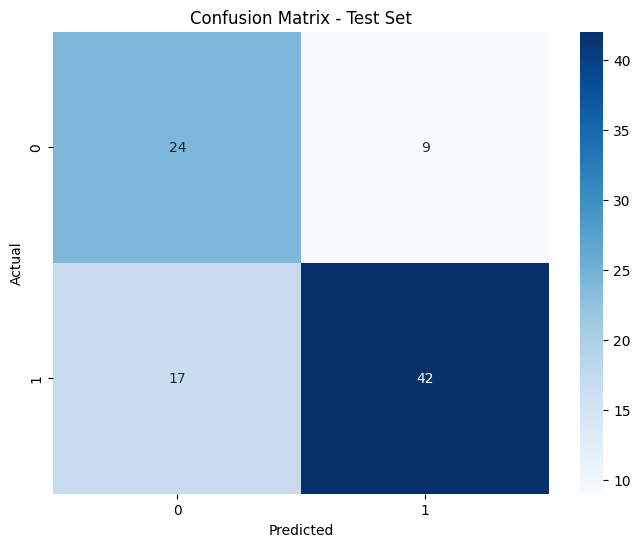

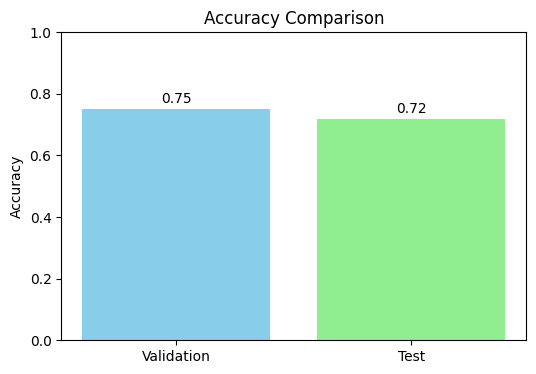

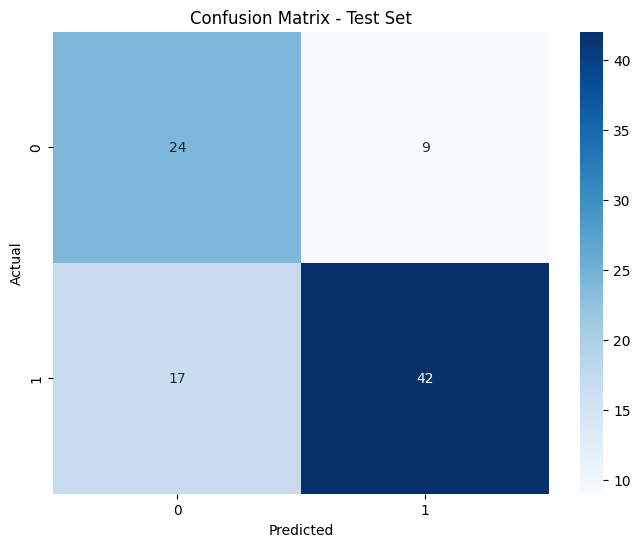

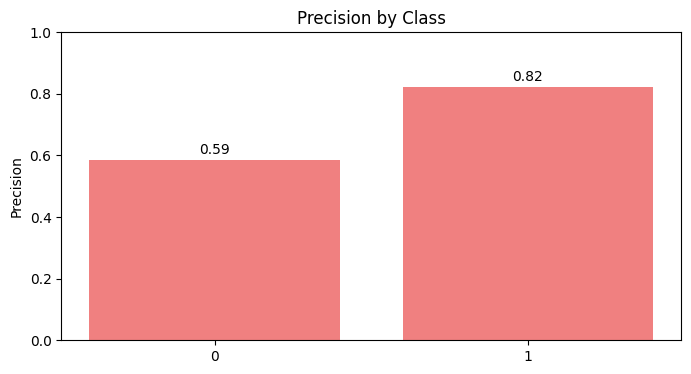

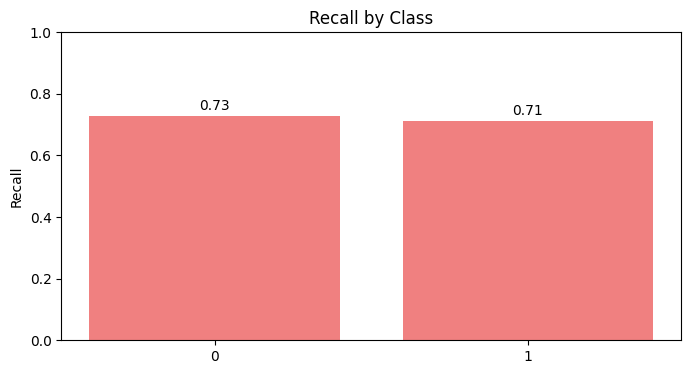

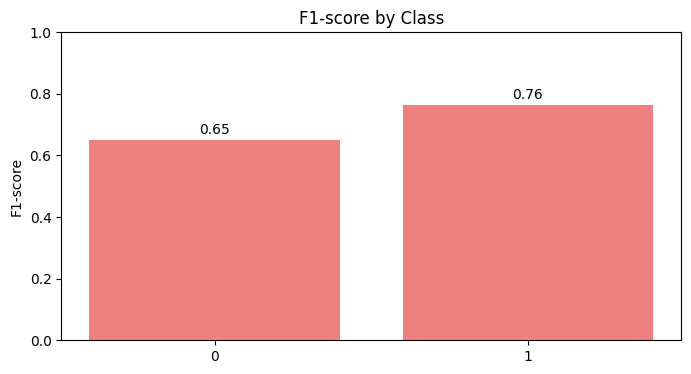

Scenario dataset_scenario_6_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_6_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_6_S
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 5}
Validation Metrics:
  Accuracy: 0.7772
  Precision: 0.7849
  Recall: 0.7772
  F1 Score: 0.7783

Test Metrics:
  Accuracy: 0.7500
  Precision: 0.7812
  Recall: 0.7500
  F1 Score: 0.7550

Confusion Matrix (Test Set):
[[27  6]
 [17 42]]


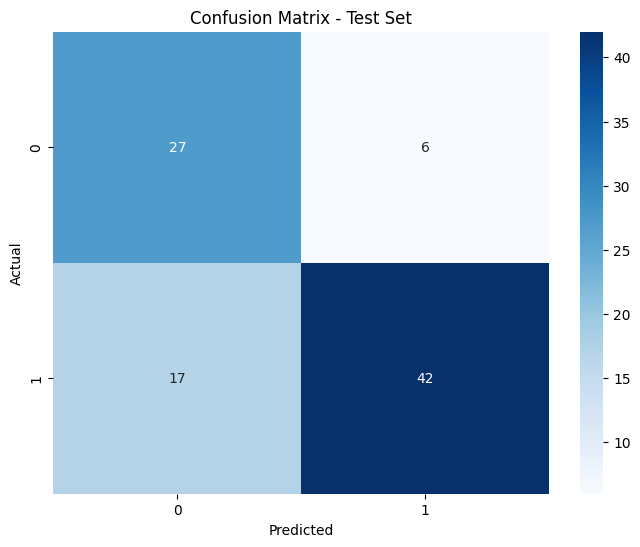

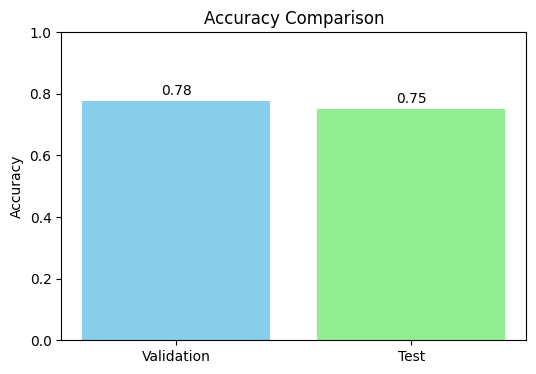

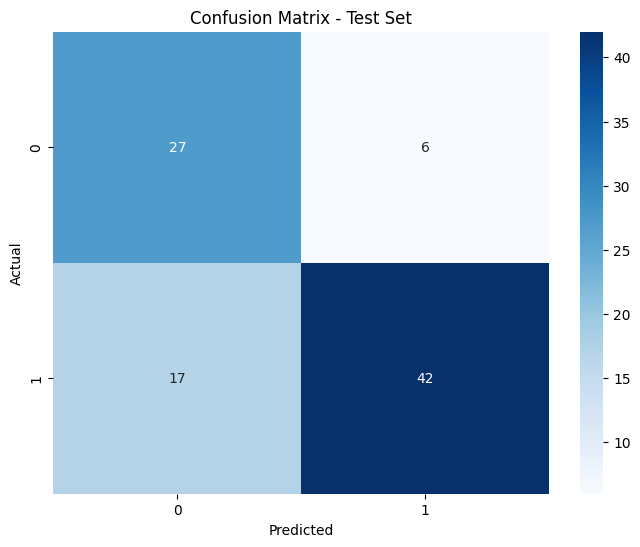

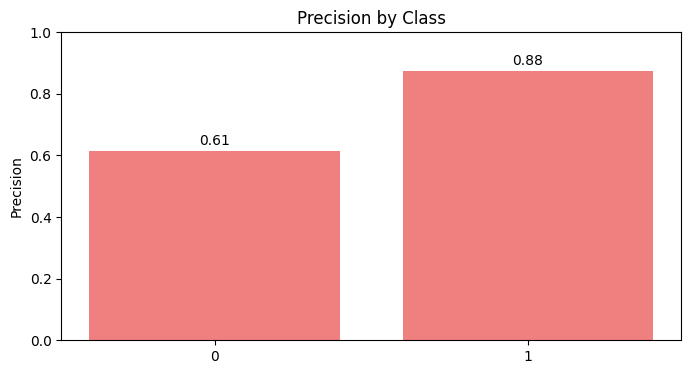

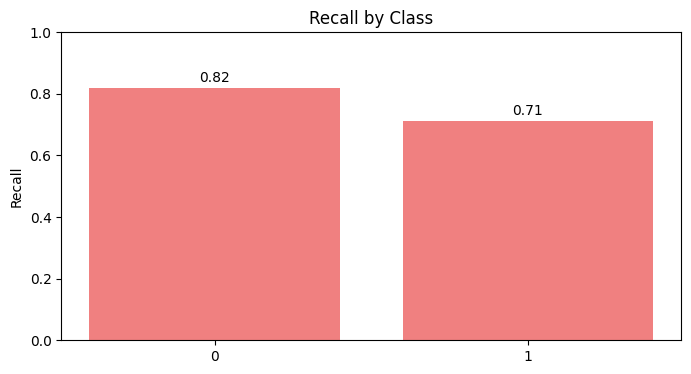

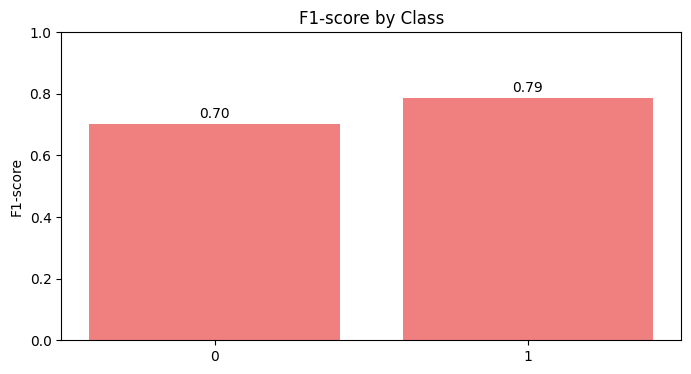

Scenario dataset_scenario_6_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with grid for dataset_scenario_7_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_7_N
Best hyperparameters:  {'criterion': 'gini', 'max_depth': 50, 'min_samples_leaf': 4, 'min_samples_split': 10}
Validation Metrics:
  Accuracy: 0.8214
  Precision: 0.8229
  Recall: 0.8214
  F1 Score: 0.8201

Test Metrics:
  Accuracy: 0.7606
  Precision: 0.7616
  Recall: 0.7606
  F1 Score: 0.7609

Confusion Matrix (Test Set):
[[31  9]
 [ 8 23]]


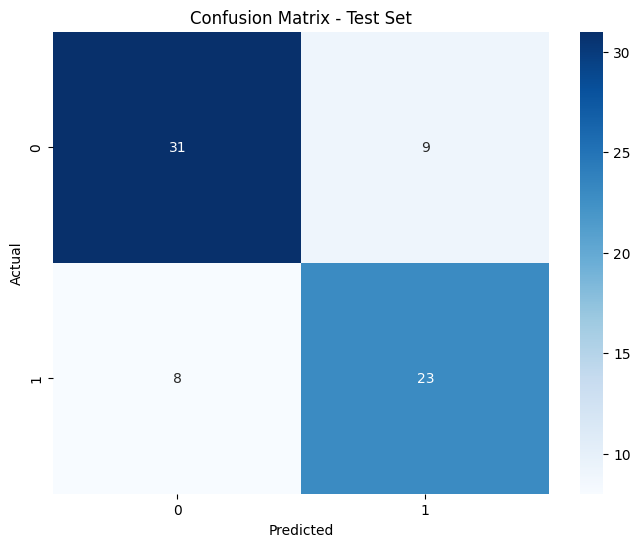

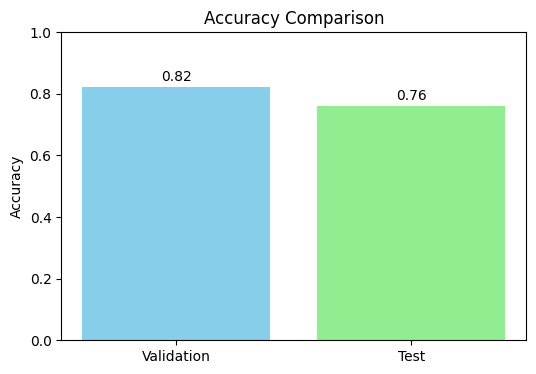

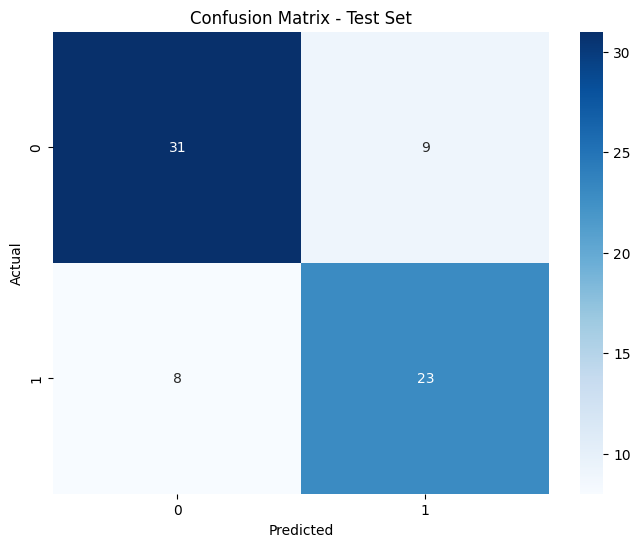

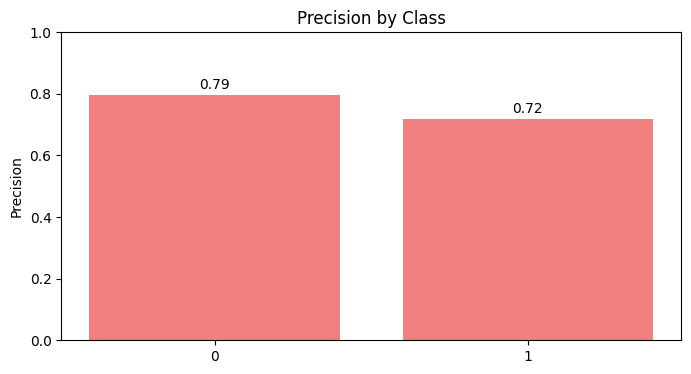

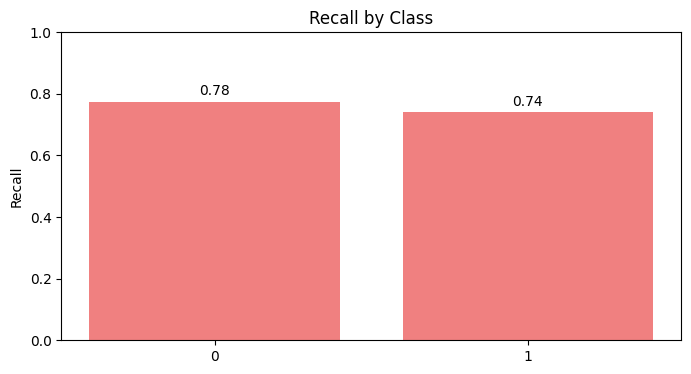

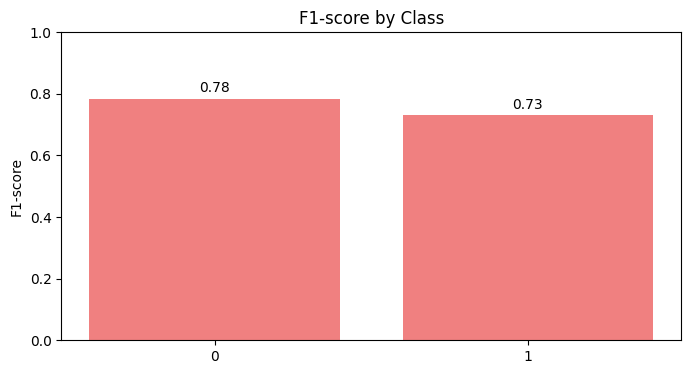

Scenario dataset_scenario_7_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_7_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_7_S
Best hyperparameters:  {'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 4, 'min_samples_split': 10}
Validation Metrics:
  Accuracy: 0.8143
  Precision: 0.8142
  Recall: 0.8143
  F1 Score: 0.8136

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8052
  Recall: 0.8028
  F1 Score: 0.8034

Confusion Matrix (Test Set):
[[32  8]
 [ 6 25]]


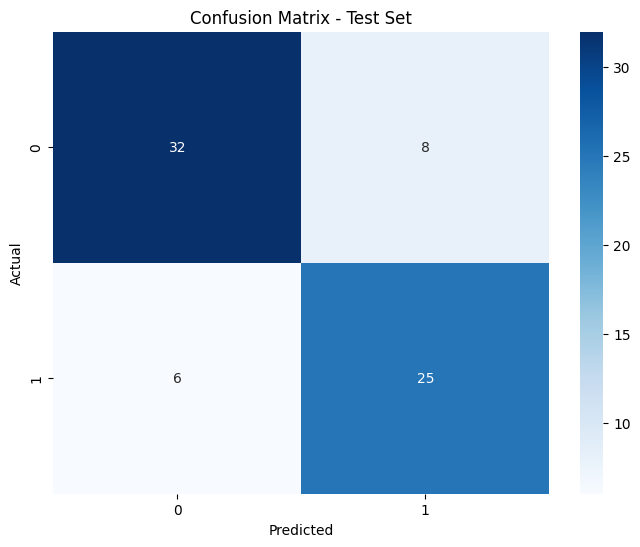

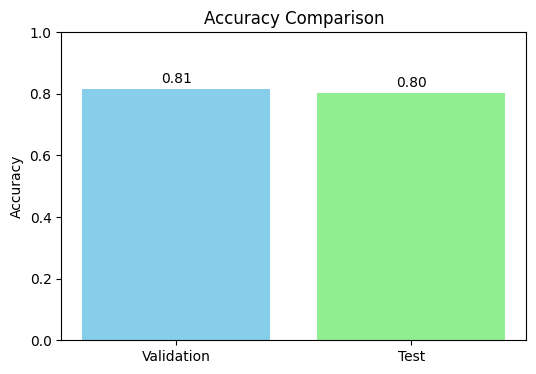

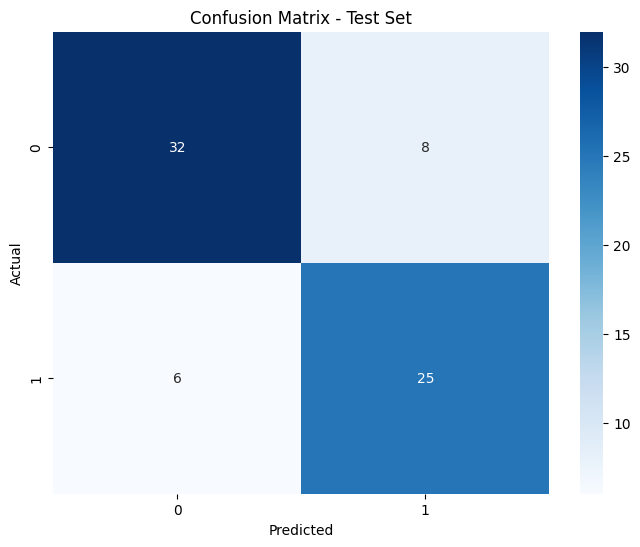

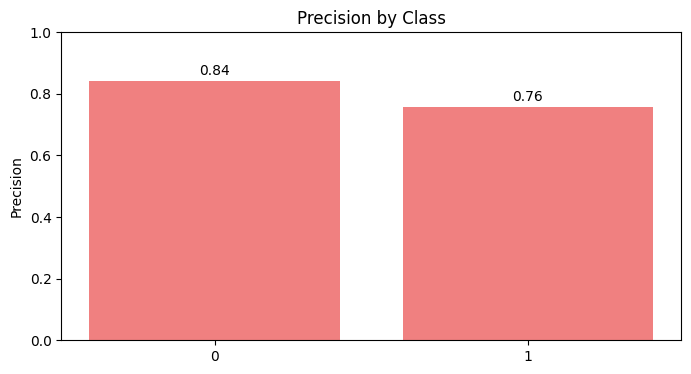

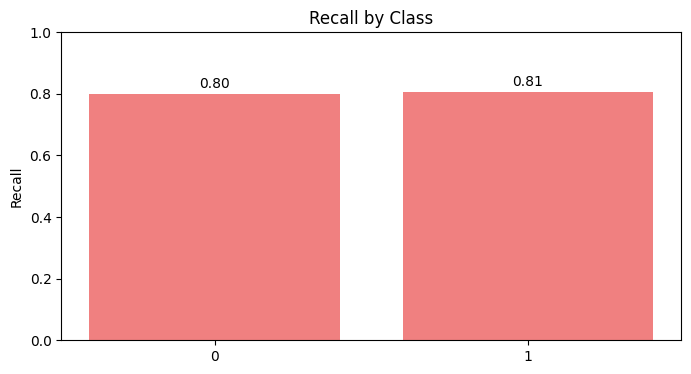

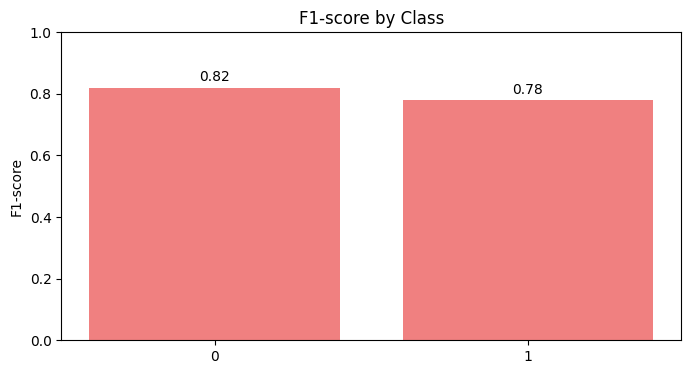

Scenario dataset_scenario_7_S with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with grid for dataset_scenario_8_N...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_8_N
Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 40, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7337
  Precision: 0.7437
  Recall: 0.7337
  F1 Score: 0.7350

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7774
  Recall: 0.7717
  F1 Score: 0.7737

Confusion Matrix (Test Set):
[[24  9]
 [12 47]]


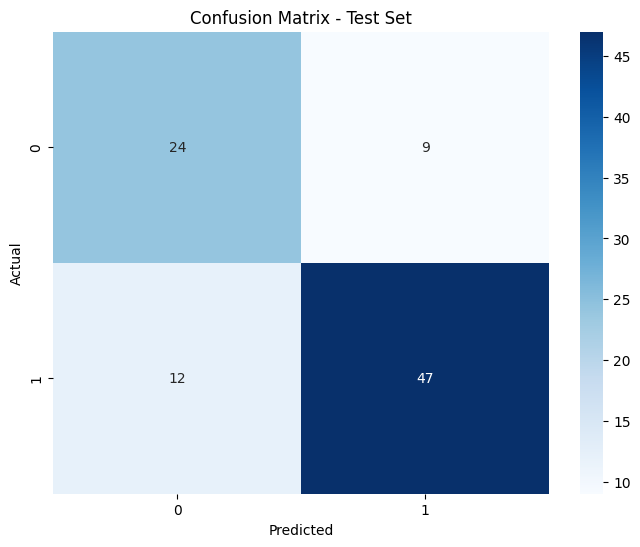

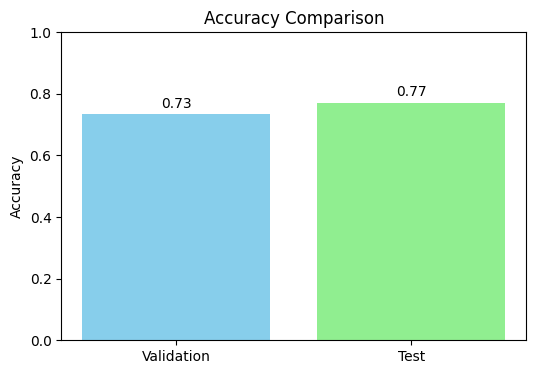

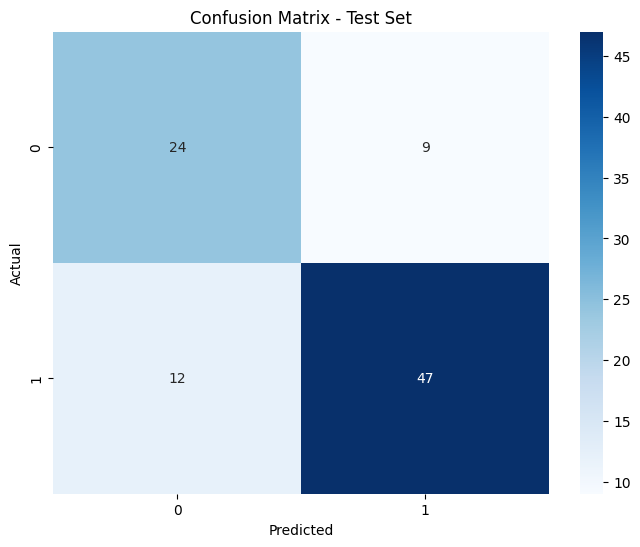

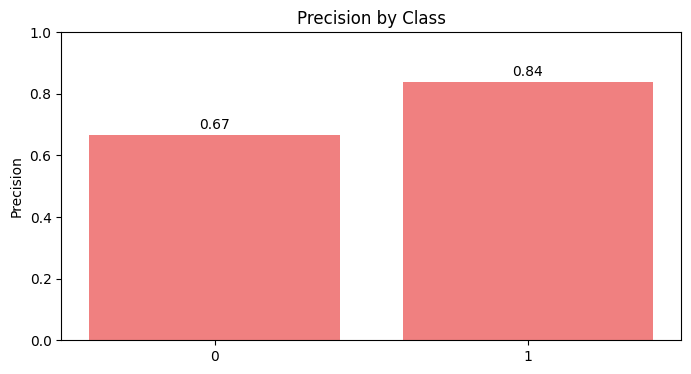

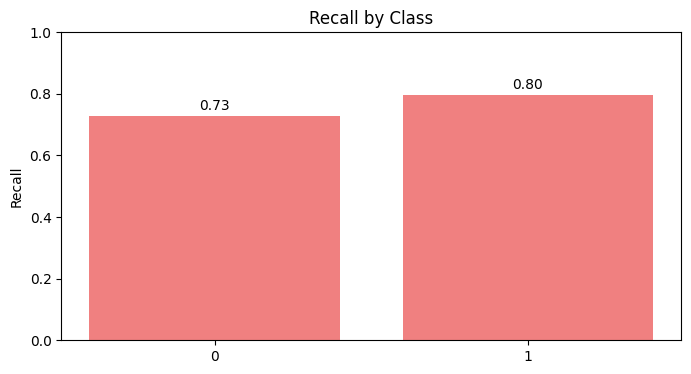

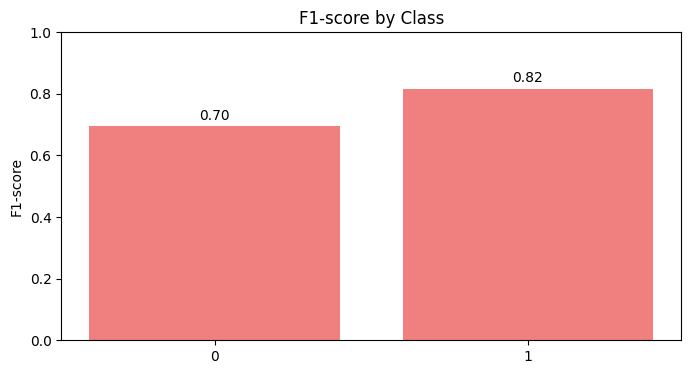

Scenario dataset_scenario_8_N with grid completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with grid for dataset_scenario_8_S...
Results will be saved in: SCORES\DecisionTree\grid\dataset_scenario_8_S
Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 2}
Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7995
  Recall: 0.7826
  F1 Score: 0.7835

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8234
  Recall: 0.8043
  F1 Score: 0.8078

Confusion Matrix (Test Set):
[[28  5]
 [13 46]]


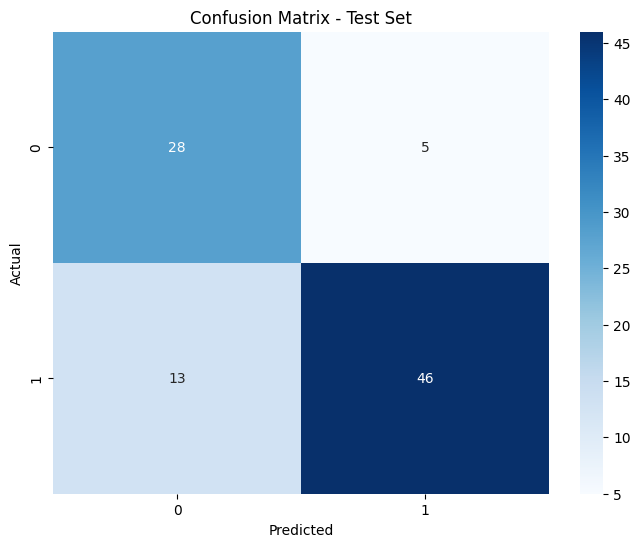

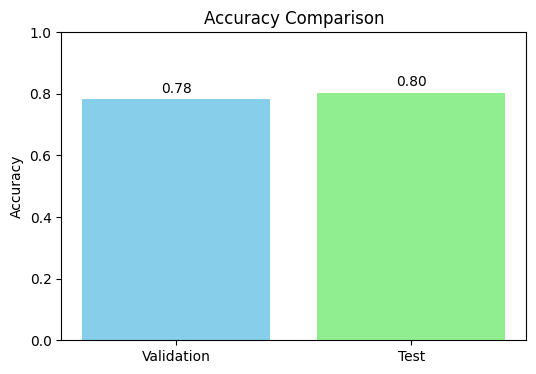

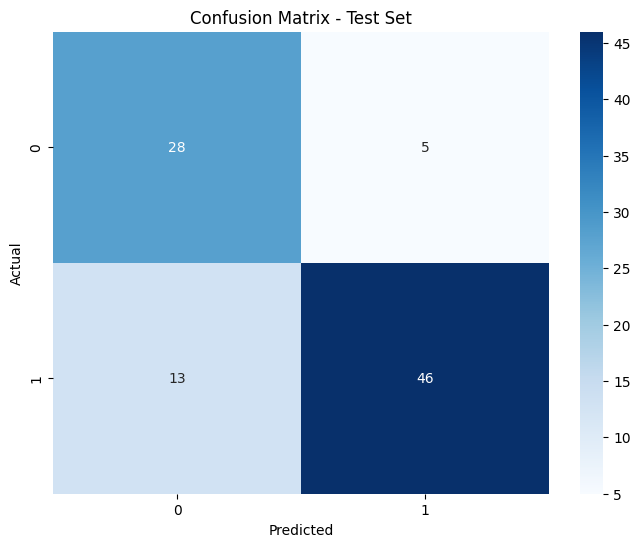

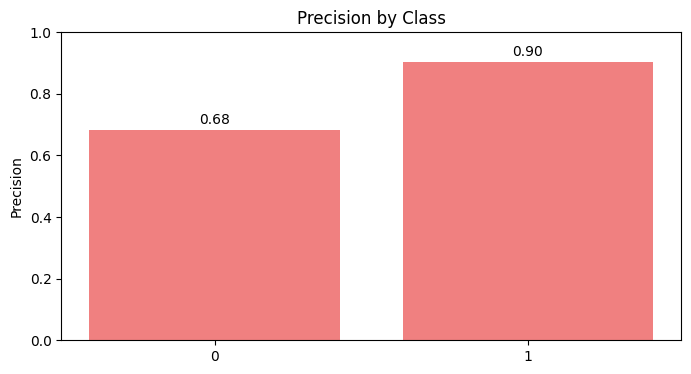

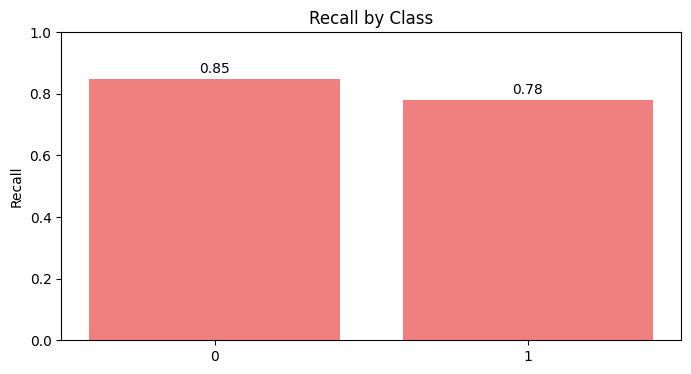

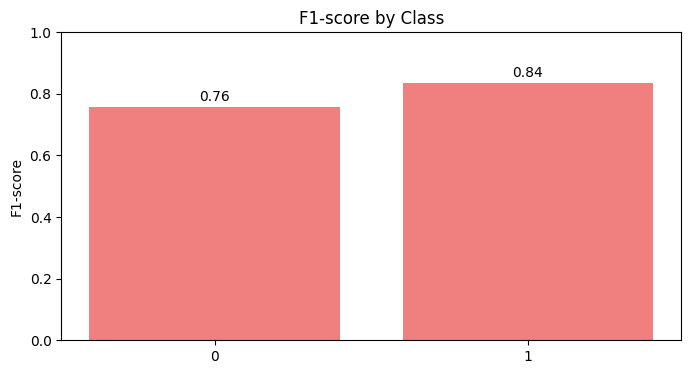

Scenario dataset_scenario_8_S with grid completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.7935
  Precision: 0.8023
  Recall: 0.7935
  F1 Score: 0.7945

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8307
  Recall: 0.8152
  F1 Score: 0.8183

Confusion Matrix (Test Set):
[[28  5]
 [12 47]]


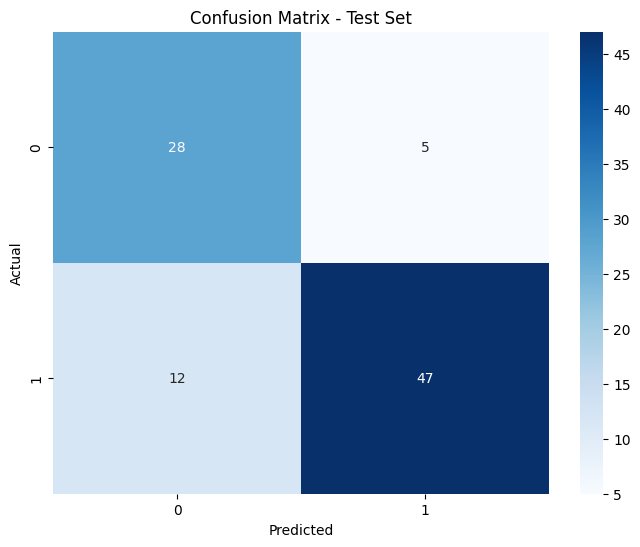

In [66]:
DecisionTree_grid_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "DecisionTree", "grid", search_config_grid, get_search_hyperparameters("DecisionTree"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        DecisionTree_grid_search['accuracy'] = best_score
        DecisionTree_grid_search['params'] = best_params
        DecisionTree_grid_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
DecisionTree = DecisionTreeClassifier(**DecisionTree_grid_search['params'])
best_scenario = pd.read_csv(DecisionTree_grid_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, DecisionTree) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "DecisionTree", "grid")
save_model_info(DecisionTree_grid_search, "DecisionTree", "grid")
    

## 2. Random Search

Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with random for dataset_scenario_1_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_1_N
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 50, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7663
  Precision: 0.7741
  Recall: 0.7663
  F1 Score: 0.7675

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7823
  Recall: 0.7717
  F1 Score: 0.7747

Confusion Matrix (Test Set):
[[25  8]
 [13 46]]


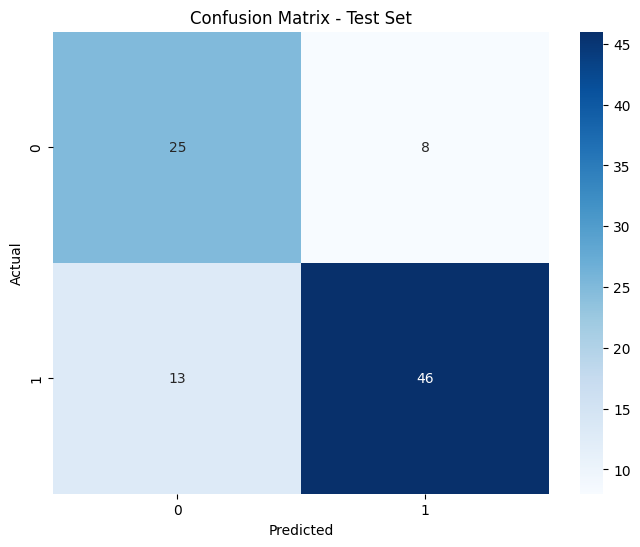

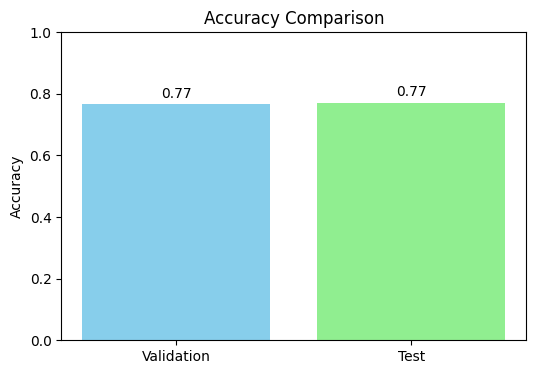

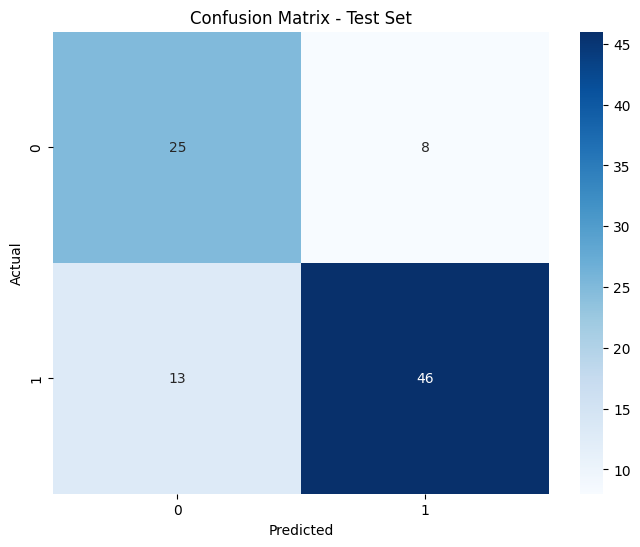

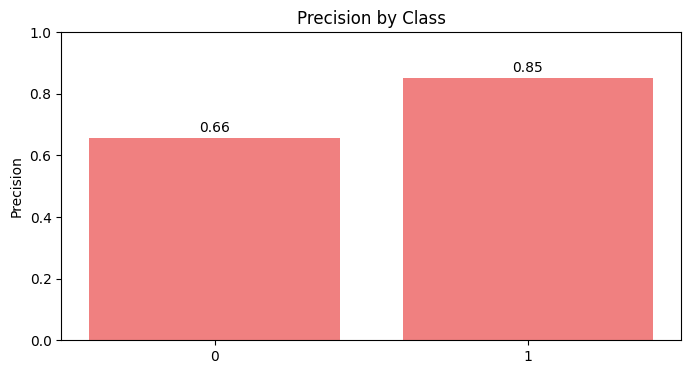

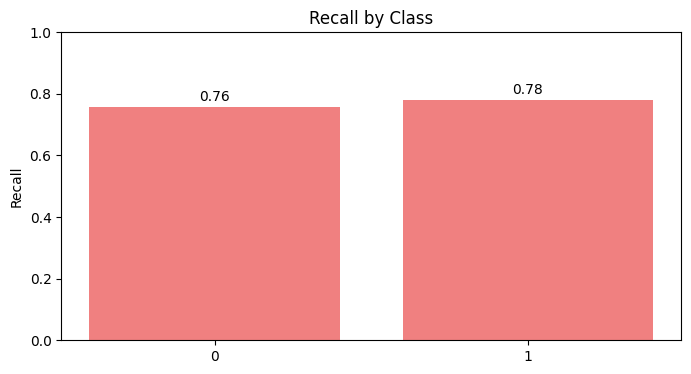

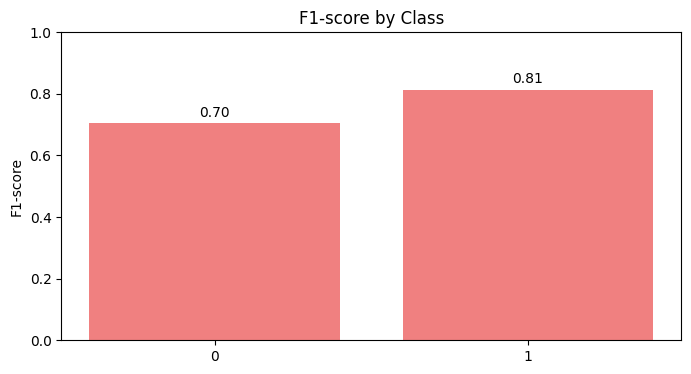

Scenario dataset_scenario_1_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_1_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_1_S
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 50, 'criterion': 'log_loss'}
Validation Metrics:
  Accuracy: 0.7554
  Precision: 0.7679
  Recall: 0.7554
  F1 Score: 0.7566

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7881
  Recall: 0.7717
  F1 Score: 0.7755

Confusion Matrix (Test Set):
[[26  7]
 [14 45]]


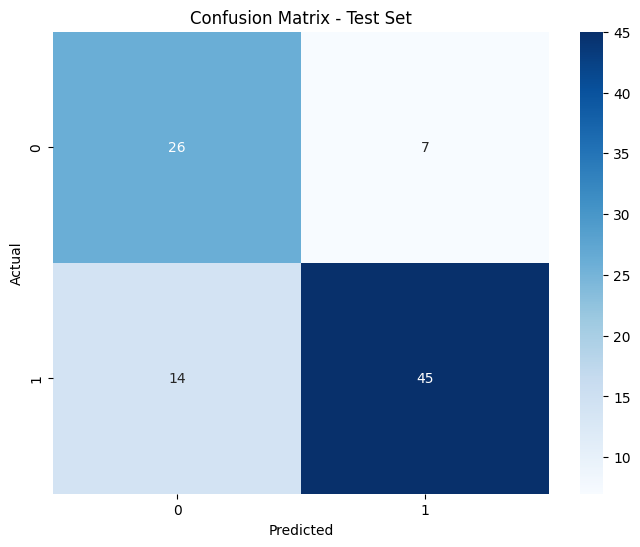

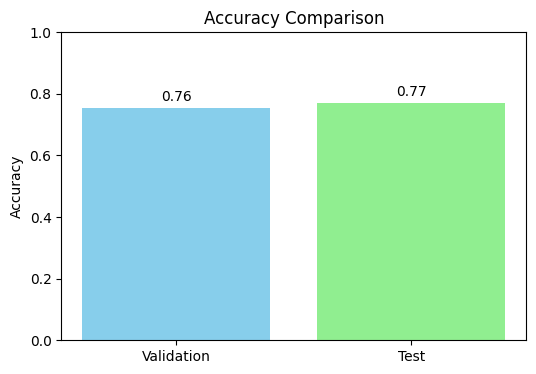

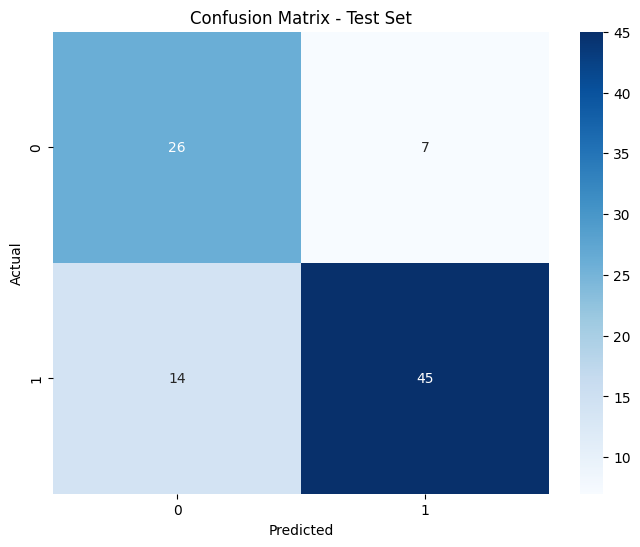

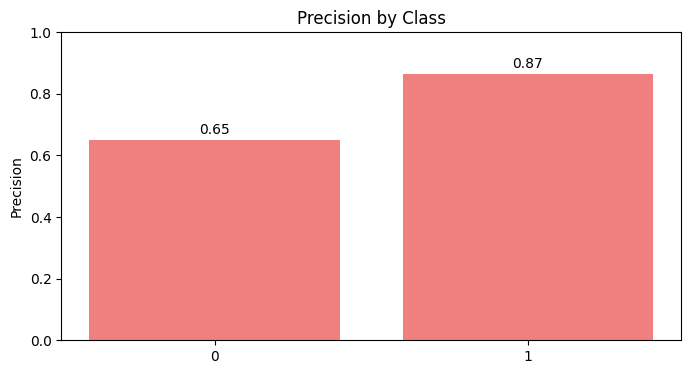

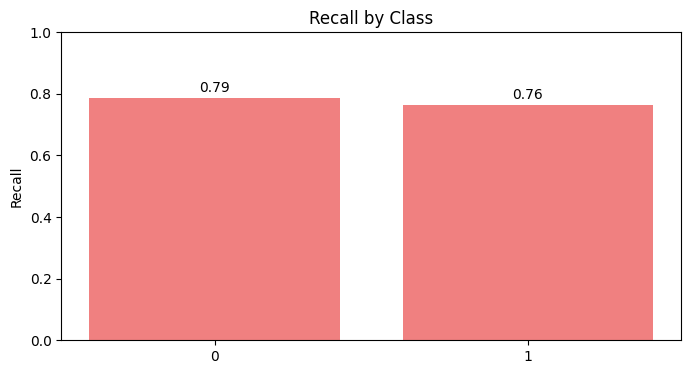

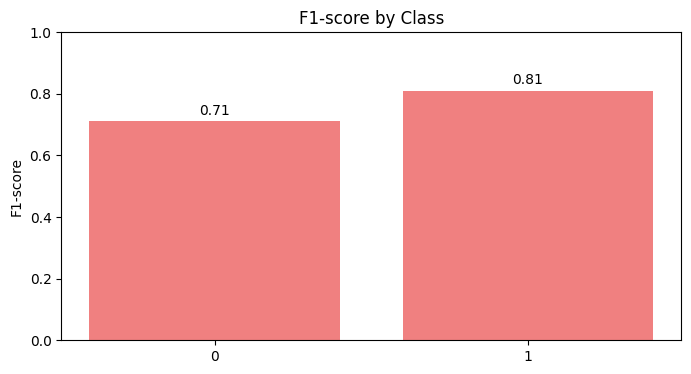

Scenario dataset_scenario_1_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running DecisionTree with random for dataset_scenario_2_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_2_N
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': None, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7717
  Precision: 0.7750
  Recall: 0.7717
  F1 Score: 0.7726

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7881
  Recall: 0.7717
  F1 Score: 0.7755

Confusion Matrix (Test Set):
[[26  7]
 [14 45]]


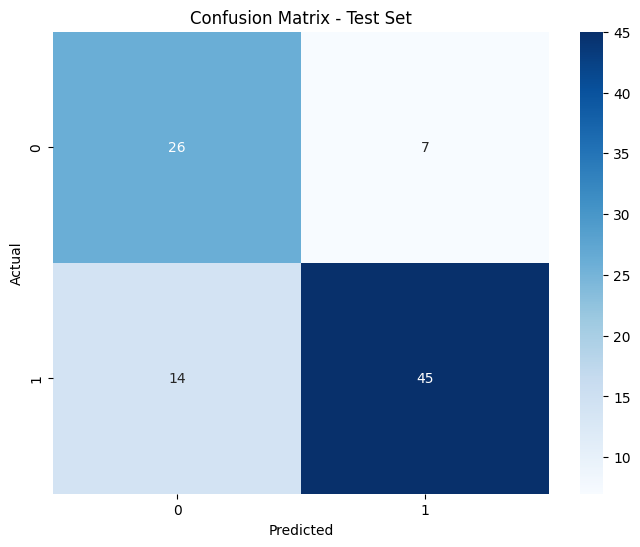

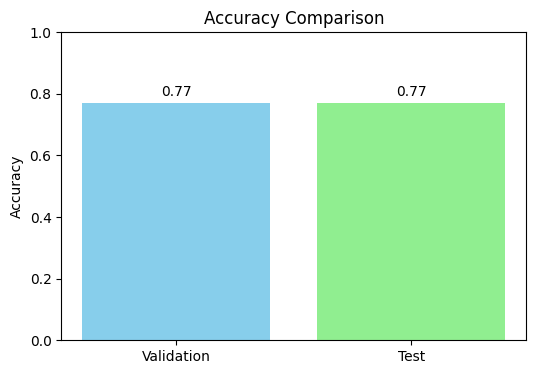

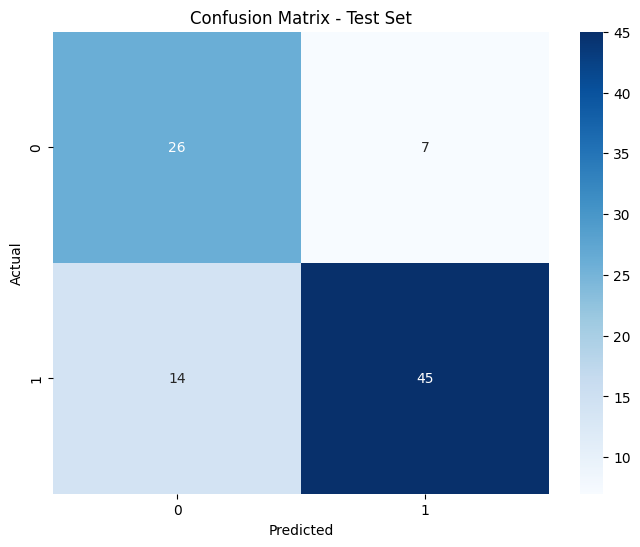

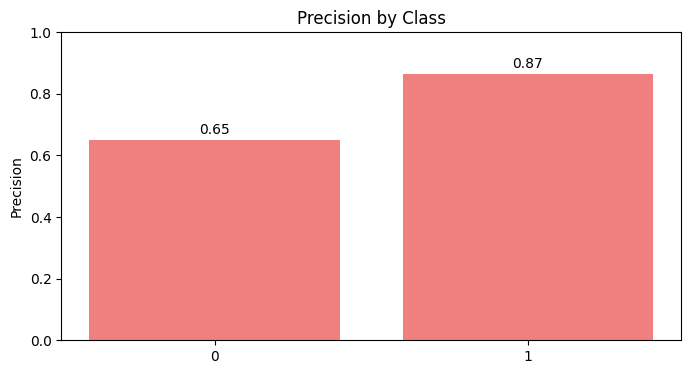

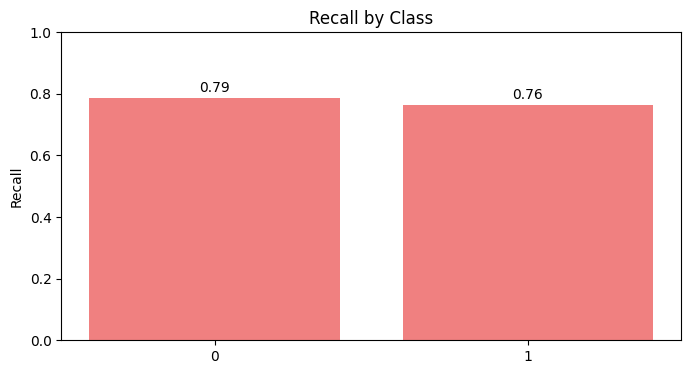

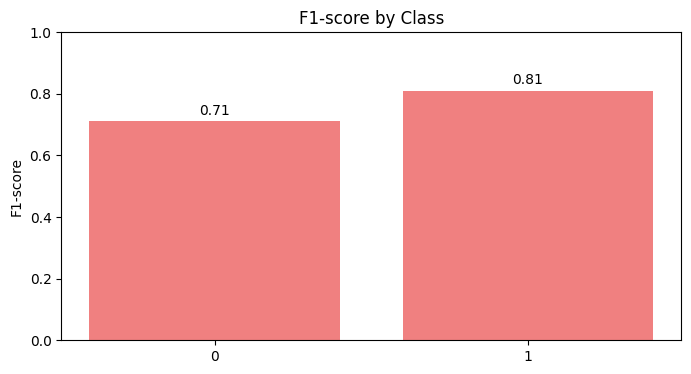

Scenario dataset_scenario_2_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_2_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_2_S
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 40, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7880
  Precision: 0.7957
  Recall: 0.7880
  F1 Score: 0.7891

Test Metrics:
  Accuracy: 0.7826
  Precision: 0.8179
  Recall: 0.7826
  F1 Score: 0.7870

Confusion Matrix (Test Set):
[[29  4]
 [16 43]]


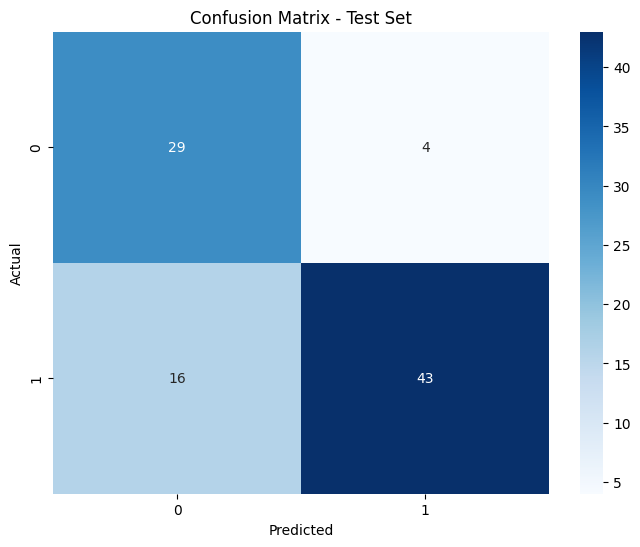

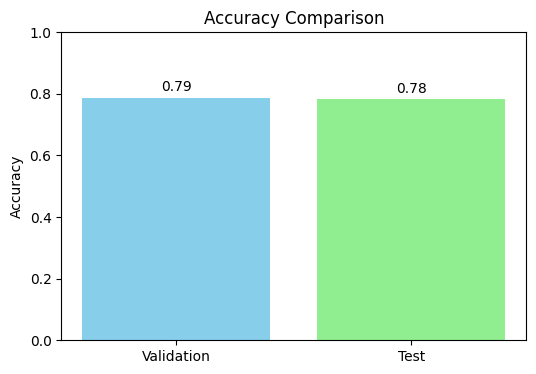

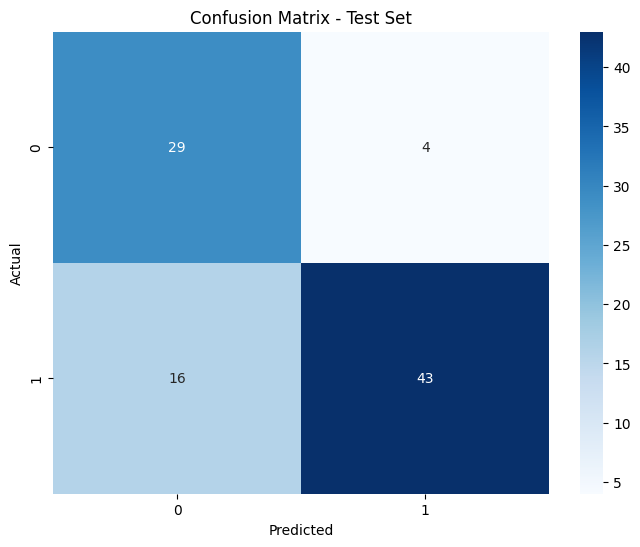

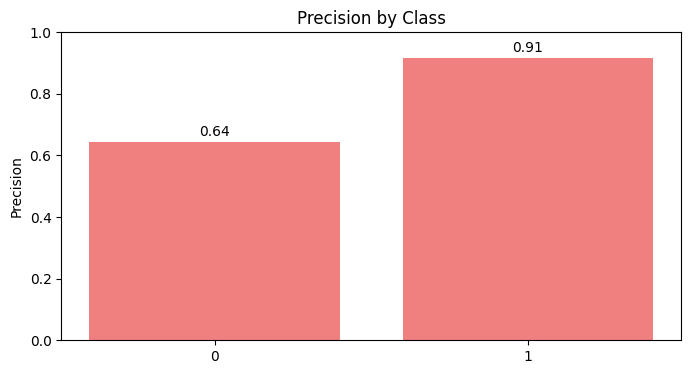

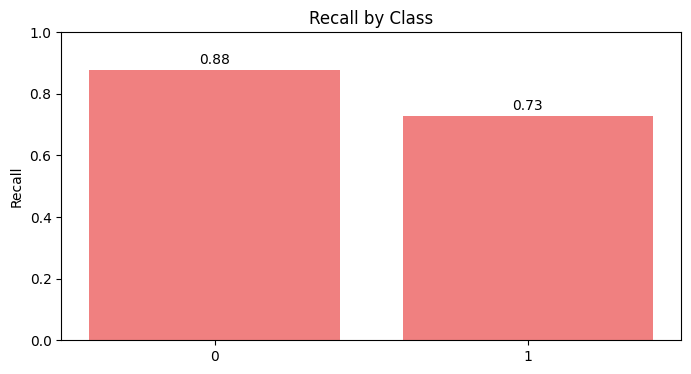

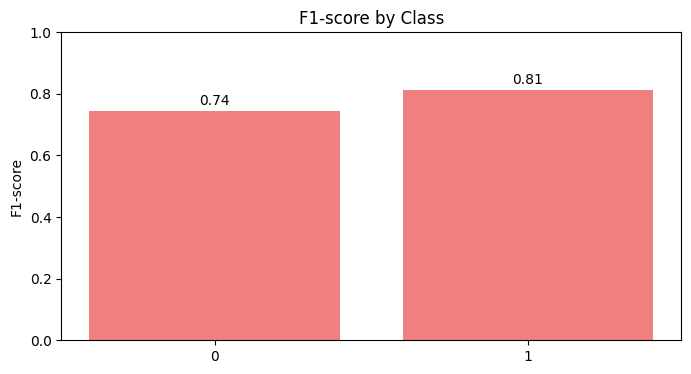

Scenario dataset_scenario_2_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with random for dataset_scenario_3_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_3_N
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': None, 'criterion': 'gini'}
Validation Metrics:
  Accuracy: 0.8000
  Precision: 0.7998
  Recall: 0.8000
  F1 Score: 0.7993

Test Metrics:
  Accuracy: 0.7465
  Precision: 0.7532
  Recall: 0.7465
  F1 Score: 0.7475

Confusion Matrix (Test Set):
[[29 11]
 [ 7 24]]


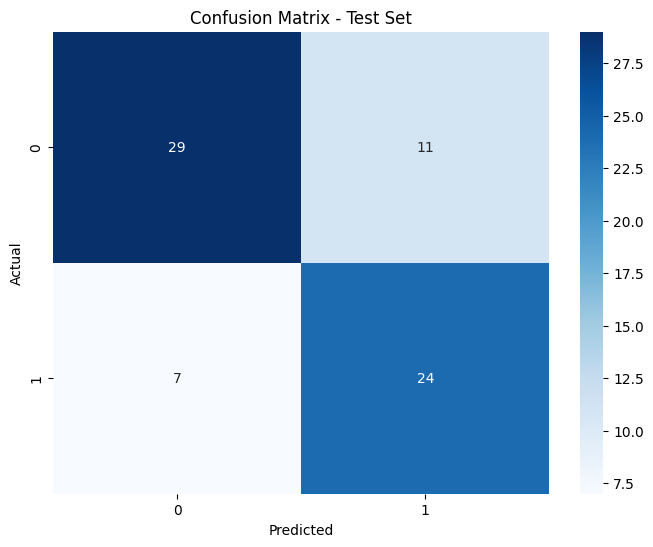

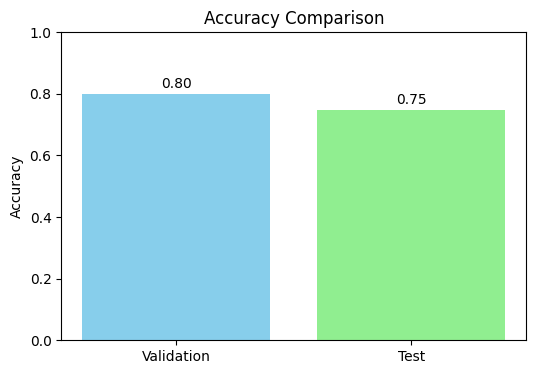

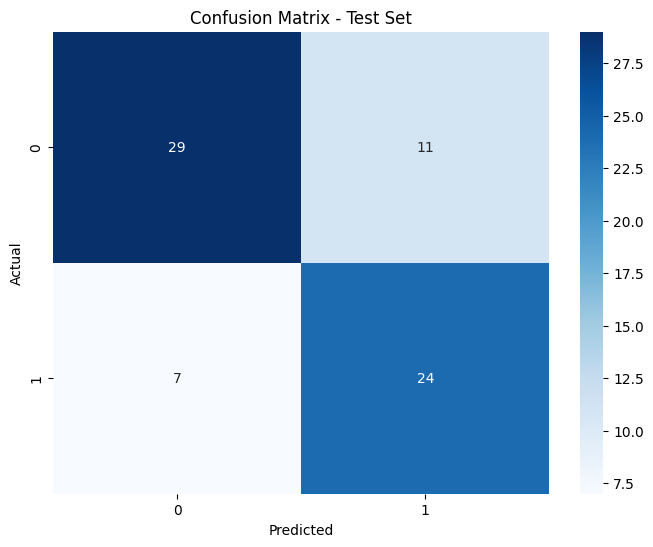

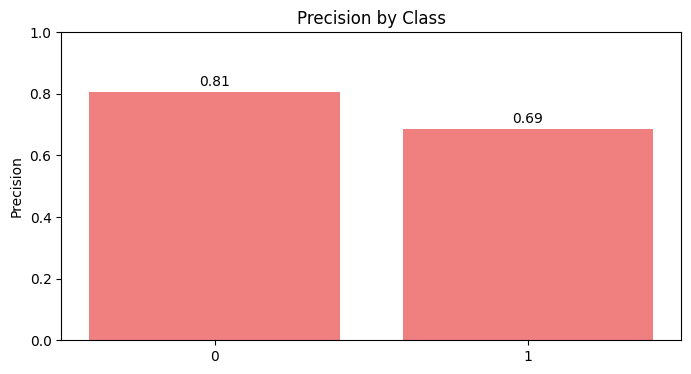

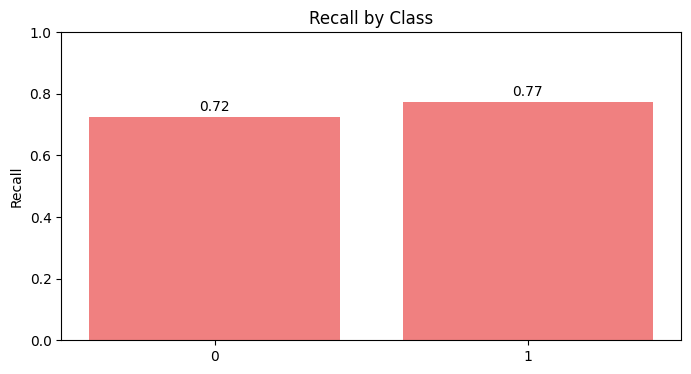

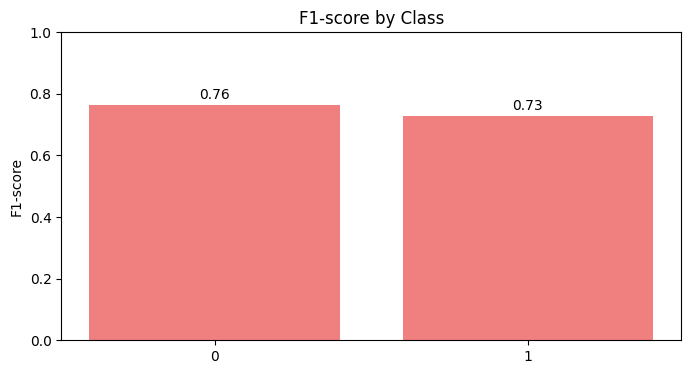

Scenario dataset_scenario_3_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_3_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_3_S
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 50, 'criterion': 'gini'}
Validation Metrics:
  Accuracy: 0.8071
  Precision: 0.8069
  Recall: 0.8071
  F1 Score: 0.8066

Test Metrics:
  Accuracy: 0.7465
  Precision: 0.7532
  Recall: 0.7465
  F1 Score: 0.7475

Confusion Matrix (Test Set):
[[29 11]
 [ 7 24]]


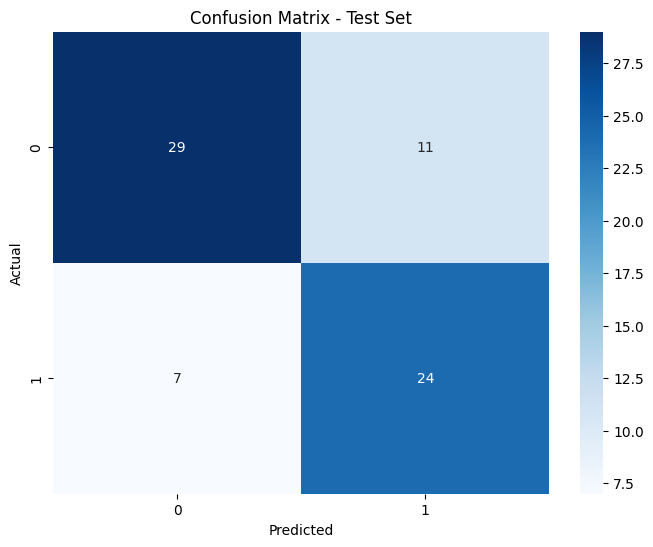

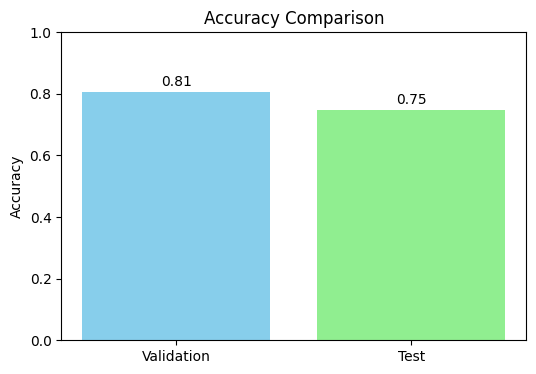

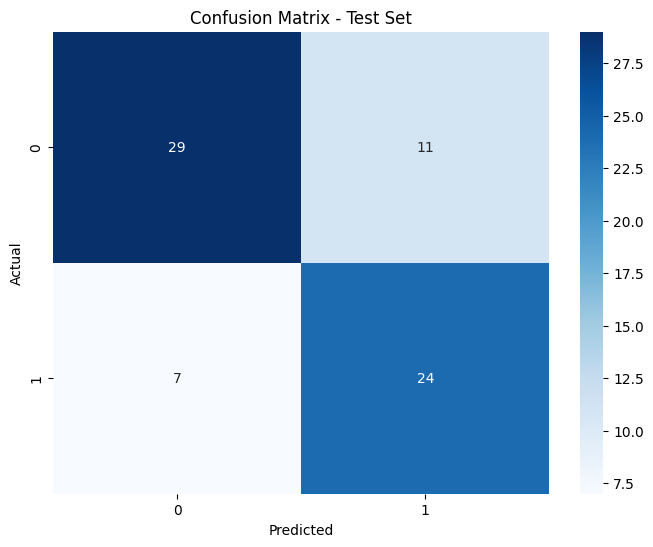

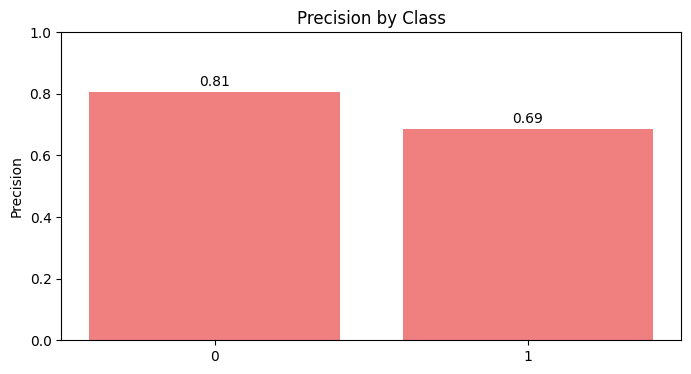

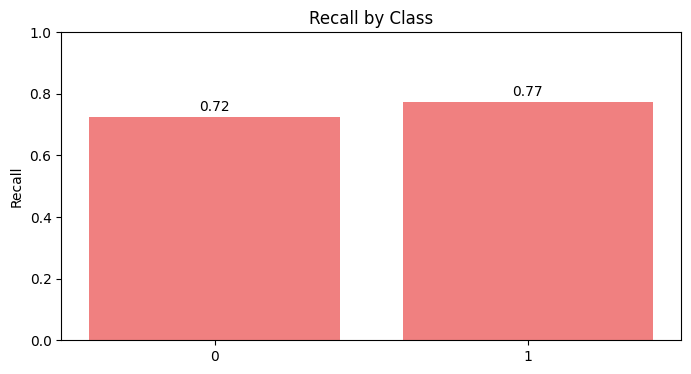

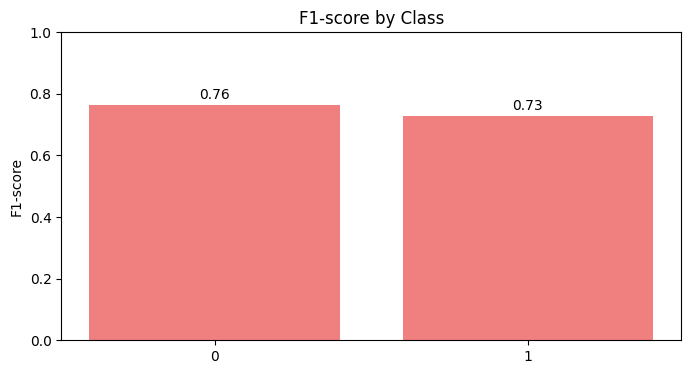

Scenario dataset_scenario_3_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with random for dataset_scenario_4_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_4_N
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20, 'criterion': 'log_loss'}
Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7858
  Recall: 0.7826
  F1 Score: 0.7834

Test Metrics:
  Accuracy: 0.7935
  Precision: 0.7988
  Recall: 0.7935
  F1 Score: 0.7953

Confusion Matrix (Test Set):
[[25  8]
 [11 48]]


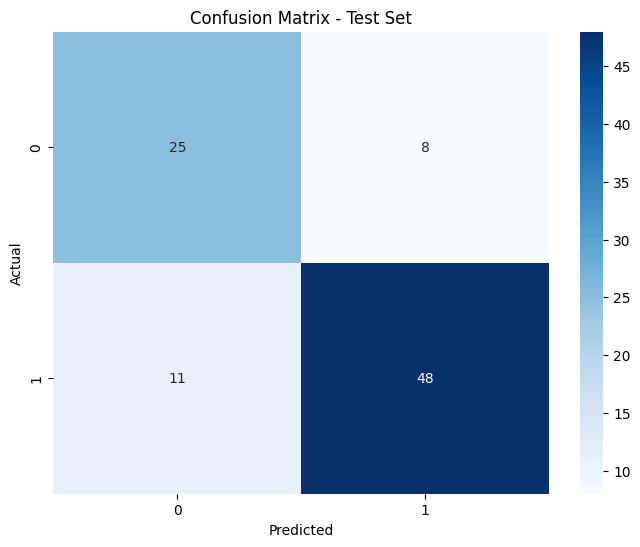

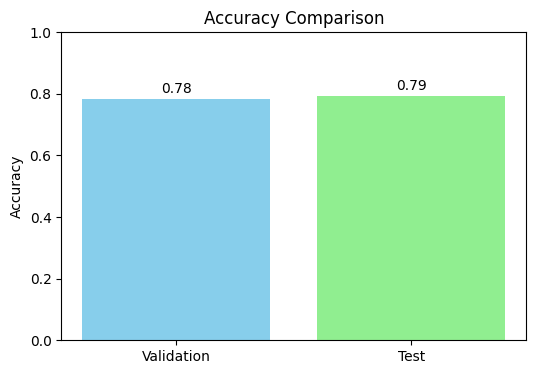

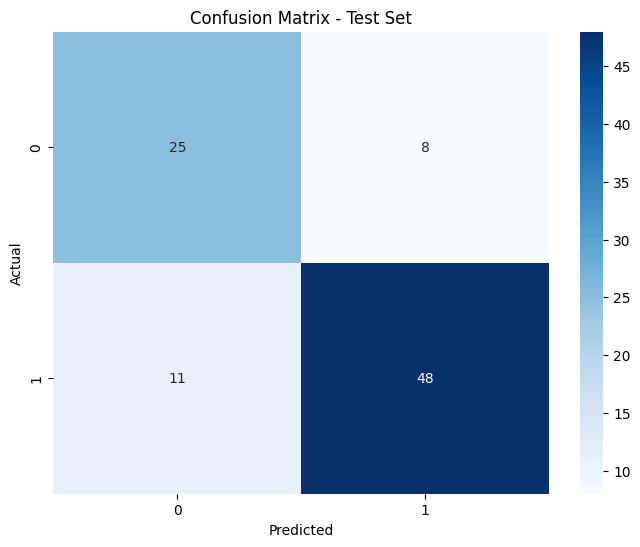

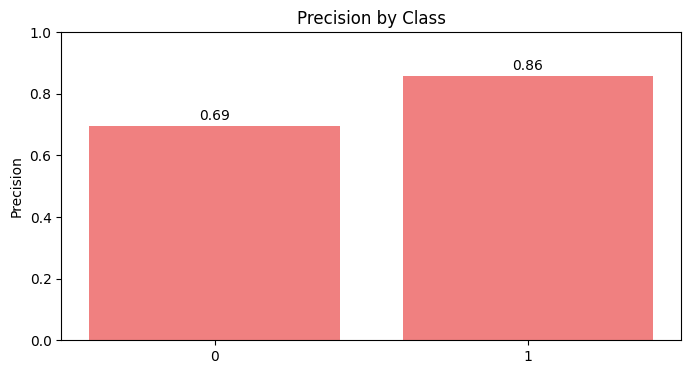

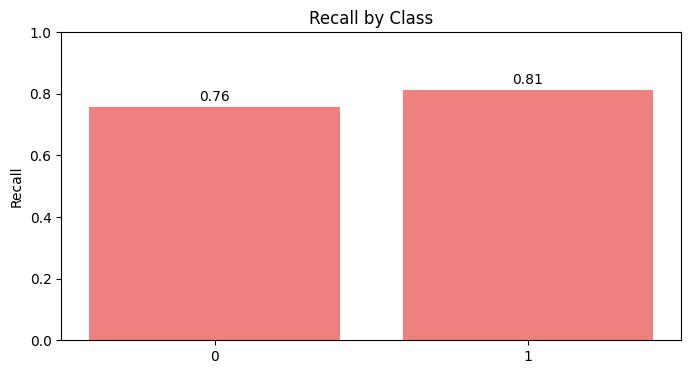

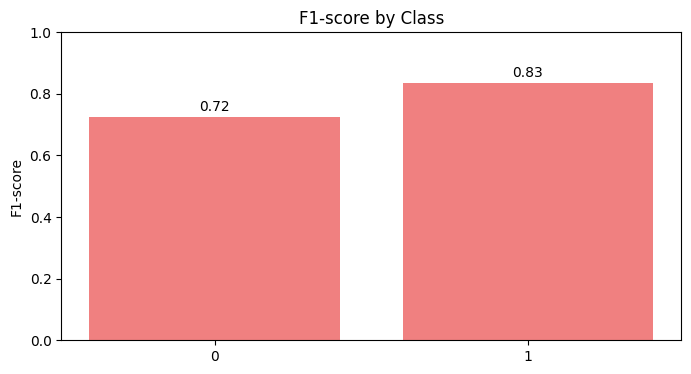

Scenario dataset_scenario_4_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_4_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_4_S
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7772
  Precision: 0.7849
  Recall: 0.7772
  F1 Score: 0.7783

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8307
  Recall: 0.8152
  F1 Score: 0.8183

Confusion Matrix (Test Set):
[[28  5]
 [12 47]]


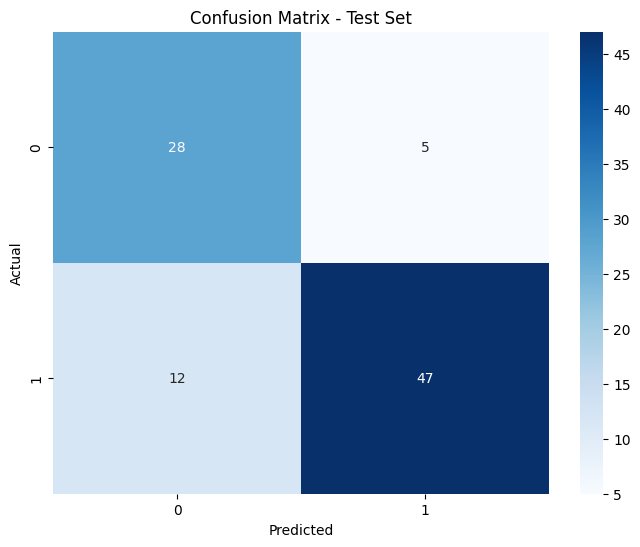

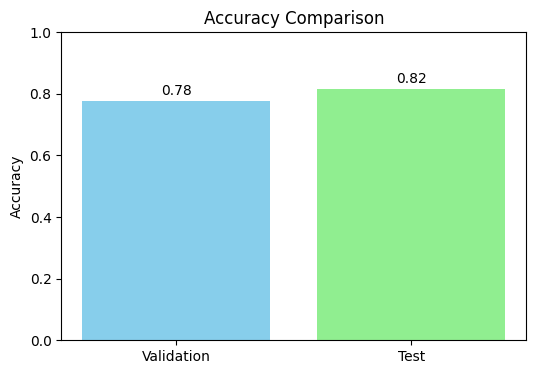

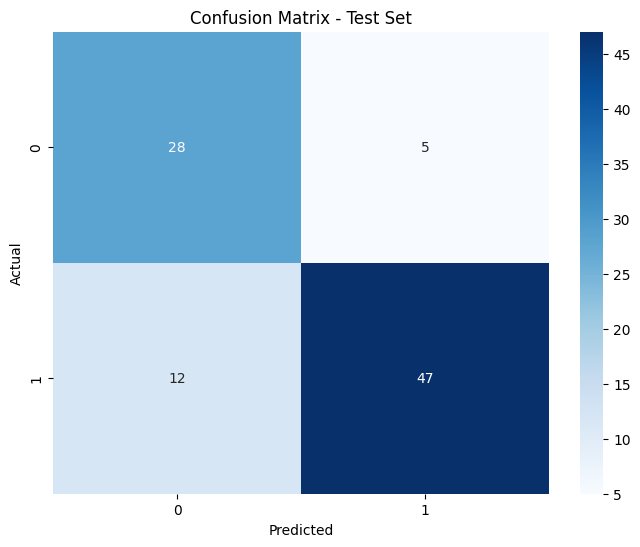

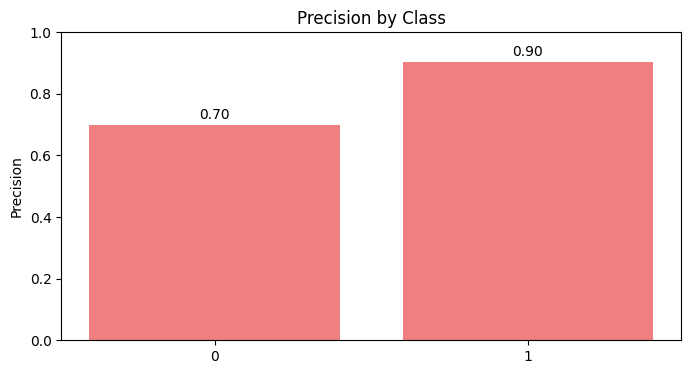

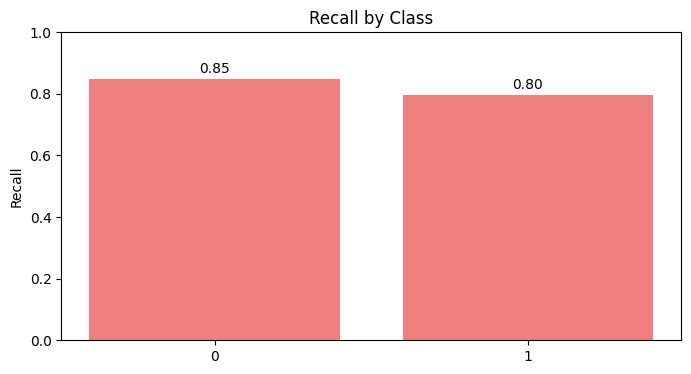

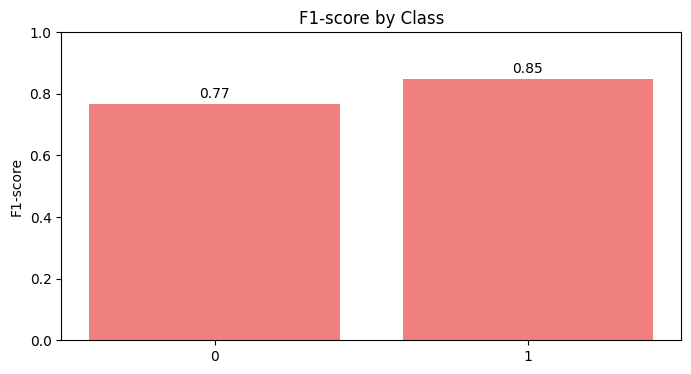

Scenario dataset_scenario_4_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with random for dataset_scenario_5_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_5_N
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 40, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7609
  Precision: 0.7721
  Recall: 0.7609
  F1 Score: 0.7621

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7823
  Recall: 0.7717
  F1 Score: 0.7747

Confusion Matrix (Test Set):
[[25  8]
 [13 46]]


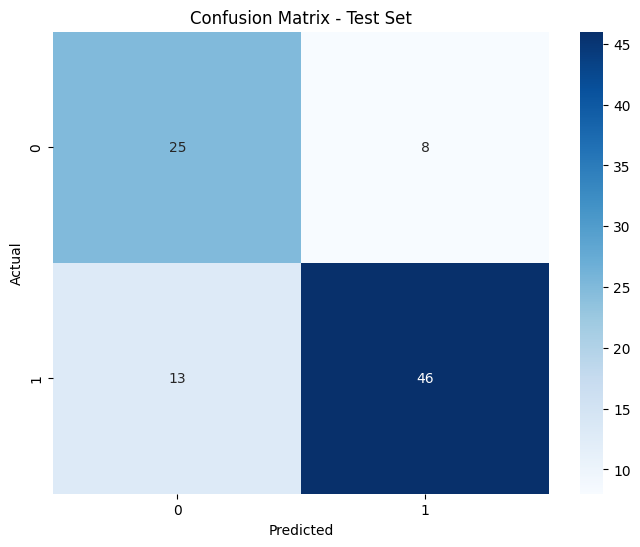

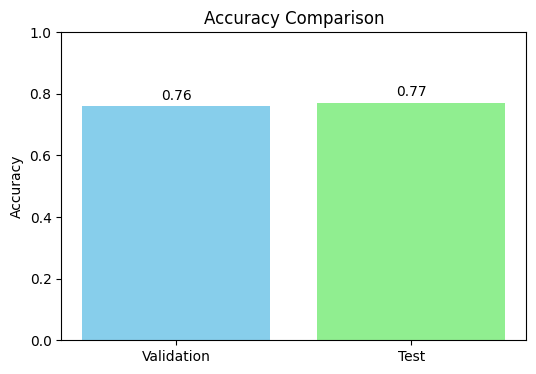

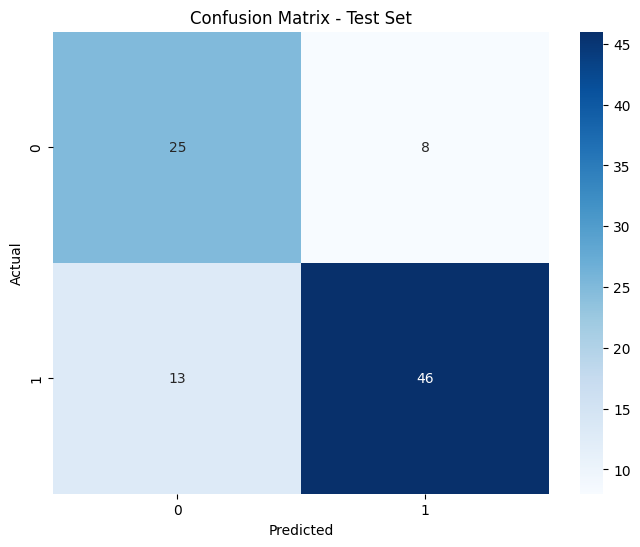

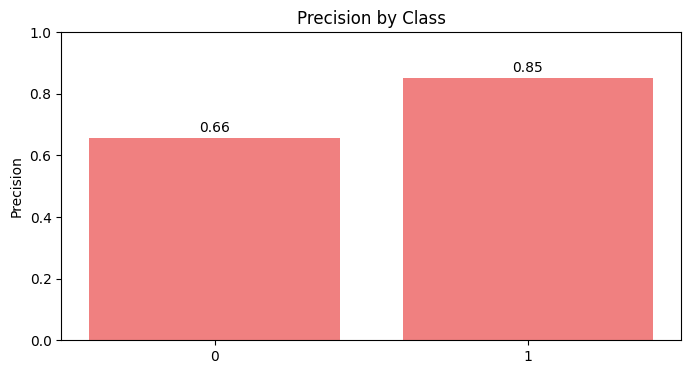

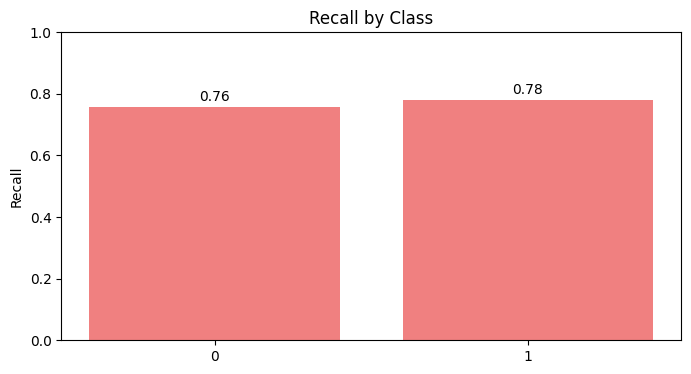

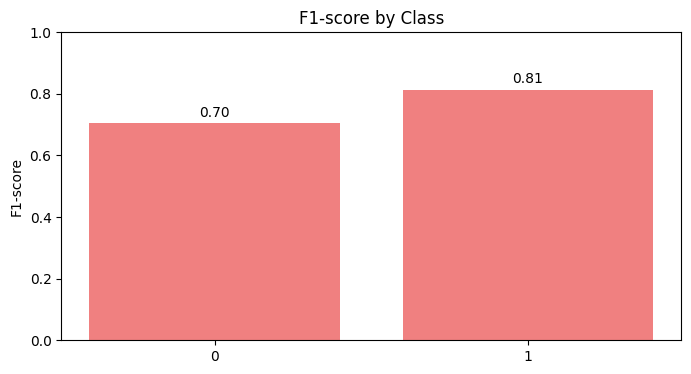

Scenario dataset_scenario_5_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_5_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_5_S
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 2, 'max_depth': 40, 'criterion': 'log_loss'}
Validation Metrics:
  Accuracy: 0.7989
  Precision: 0.8089
  Recall: 0.7989
  F1 Score: 0.7999

Test Metrics:
  Accuracy: 0.7935
  Precision: 0.8036
  Recall: 0.7935
  F1 Score: 0.7962

Confusion Matrix (Test Set):
[[26  7]
 [12 47]]


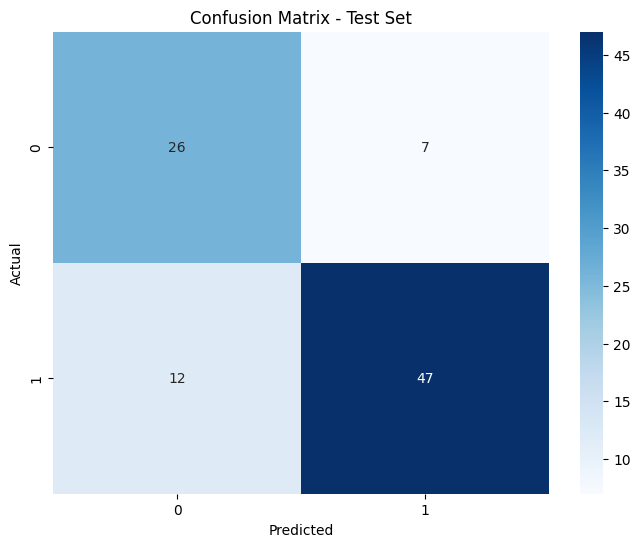

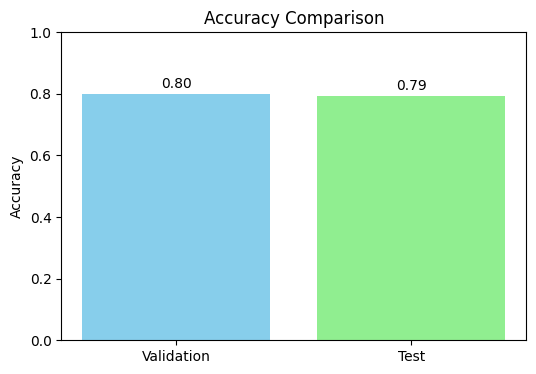

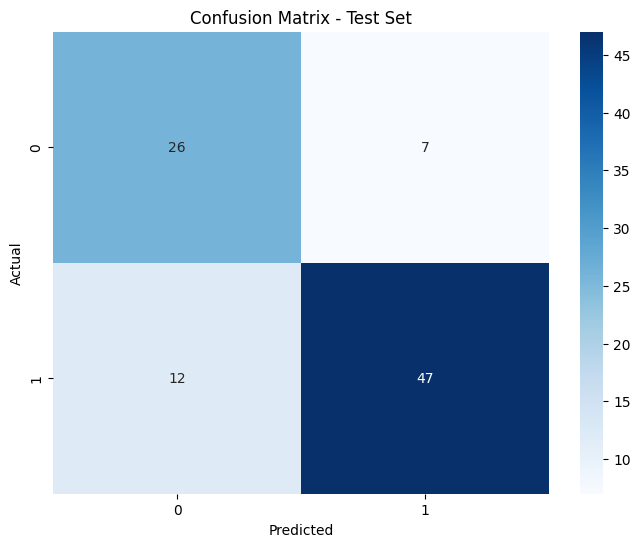

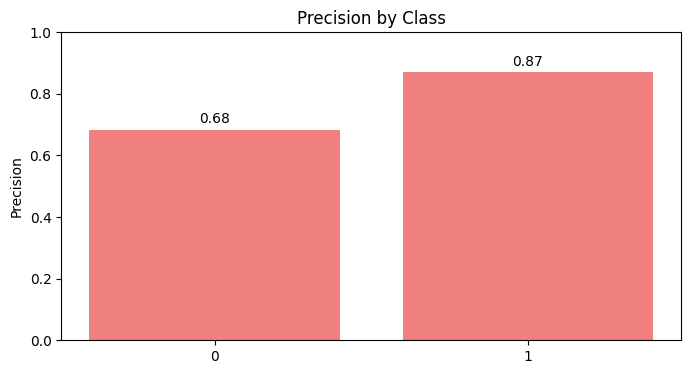

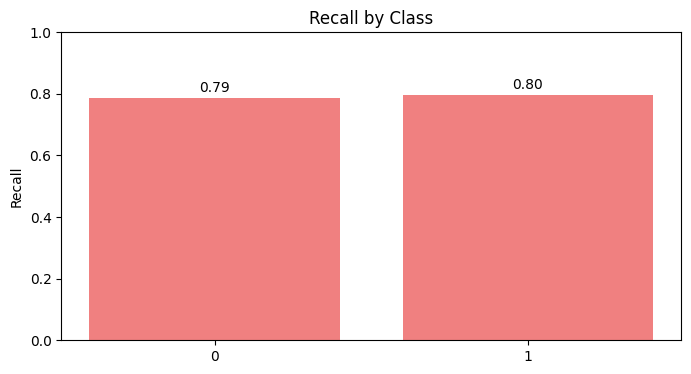

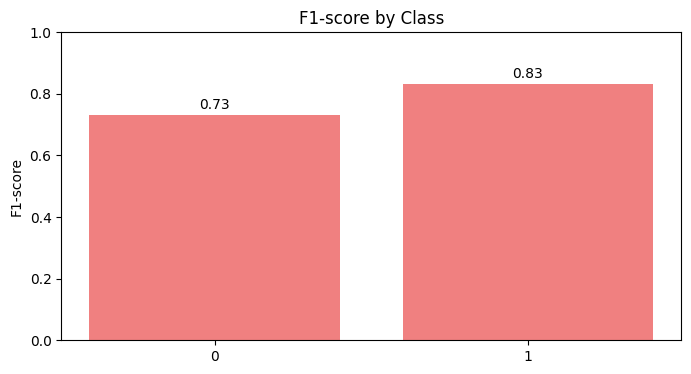

Scenario dataset_scenario_5_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with random for dataset_scenario_6_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_6_N
Best hyperparameters:  {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': None, 'criterion': 'log_loss'}
Validation Metrics:
  Accuracy: 0.7609
  Precision: 0.7676
  Recall: 0.7609
  F1 Score: 0.7620

Test Metrics:
  Accuracy: 0.7609
  Precision: 0.7807
  Recall: 0.7609
  F1 Score: 0.7651

Confusion Matrix (Test Set):
[[26  7]
 [15 44]]


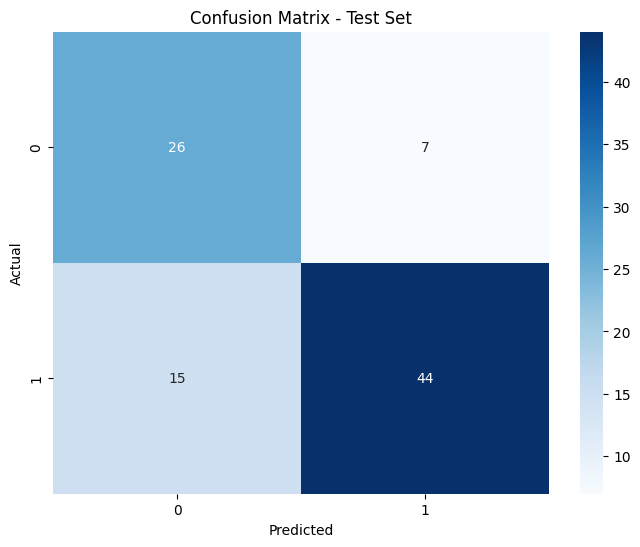

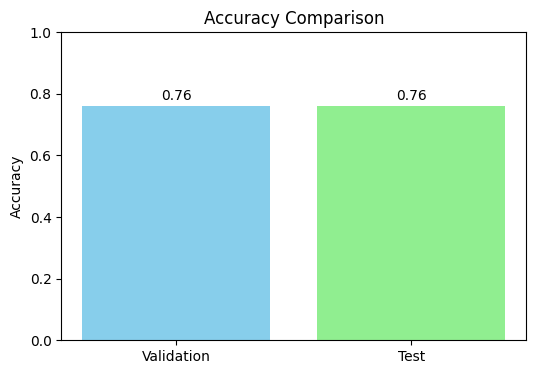

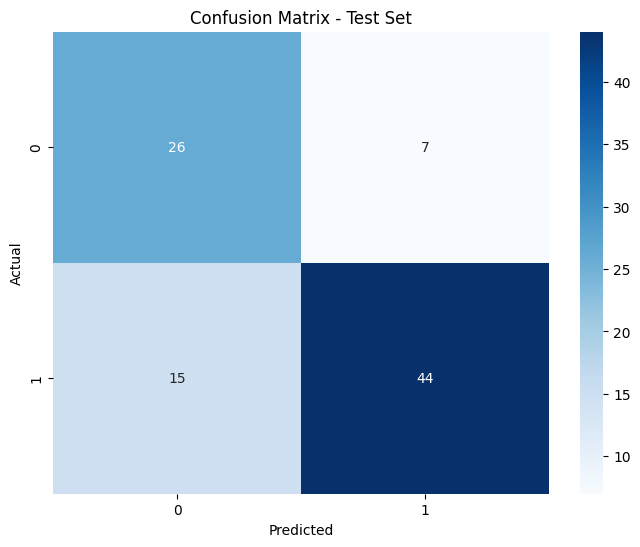

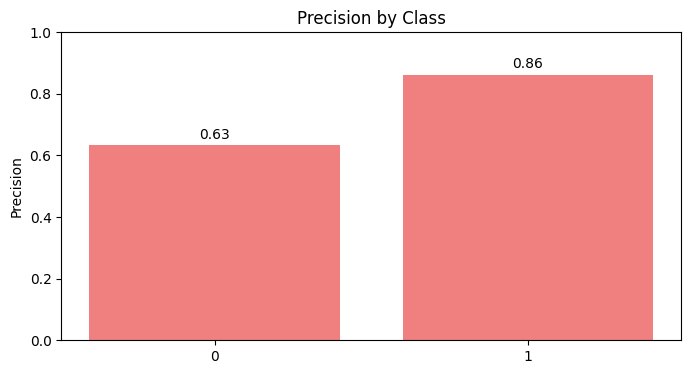

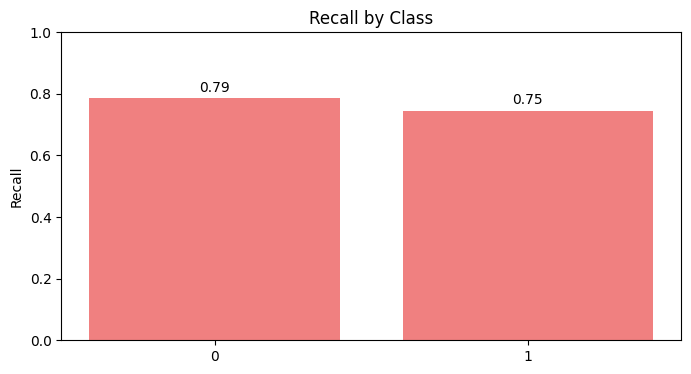

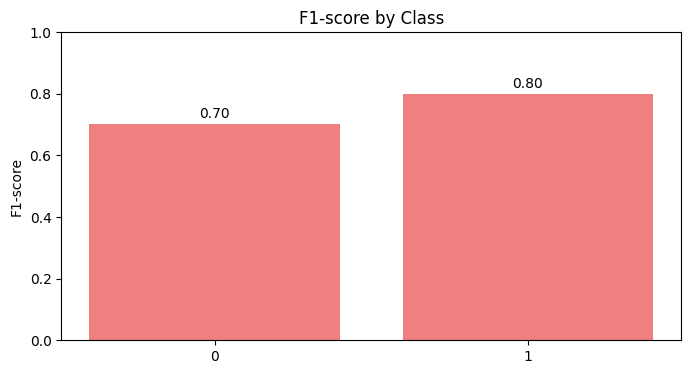

Scenario dataset_scenario_6_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_6_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_6_S
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 40, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7938
  Recall: 0.7826
  F1 Score: 0.7837

Test Metrics:
  Accuracy: 0.7609
  Precision: 0.7880
  Recall: 0.7609
  F1 Score: 0.7655

Confusion Matrix (Test Set):
[[27  6]
 [16 43]]


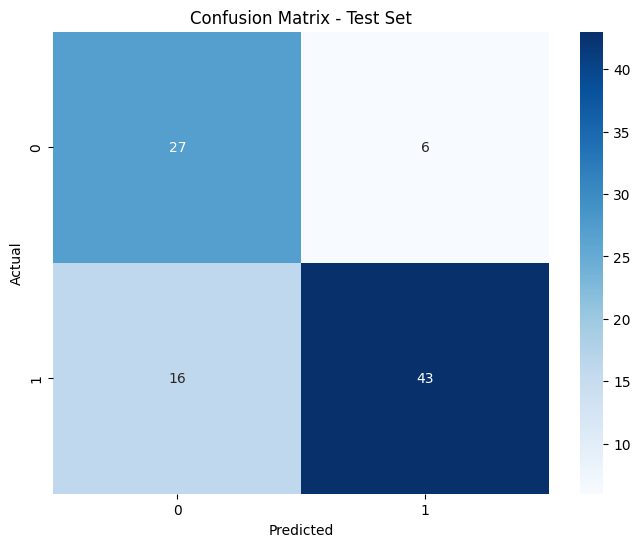

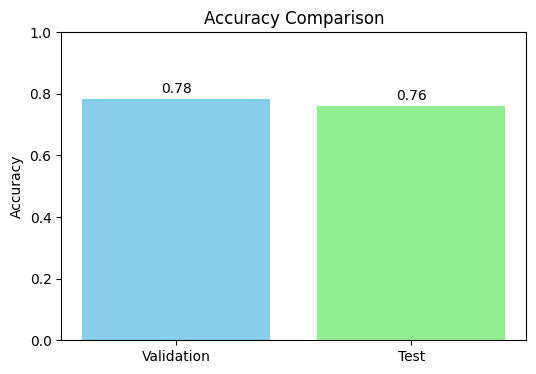

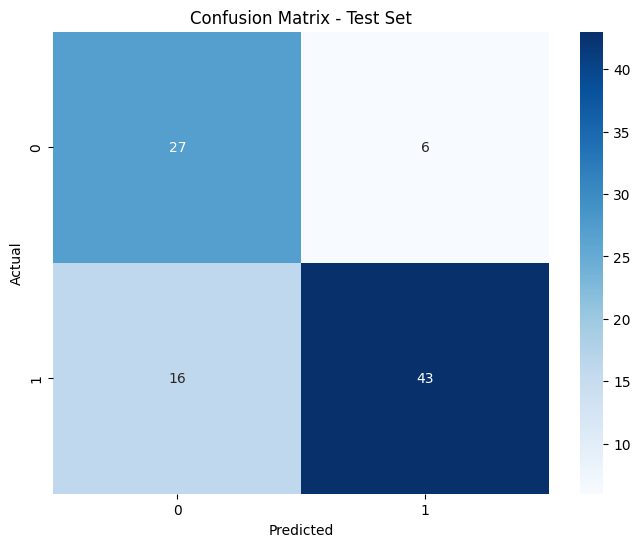

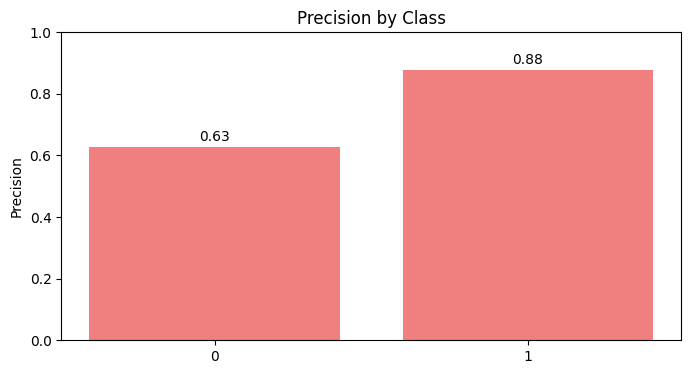

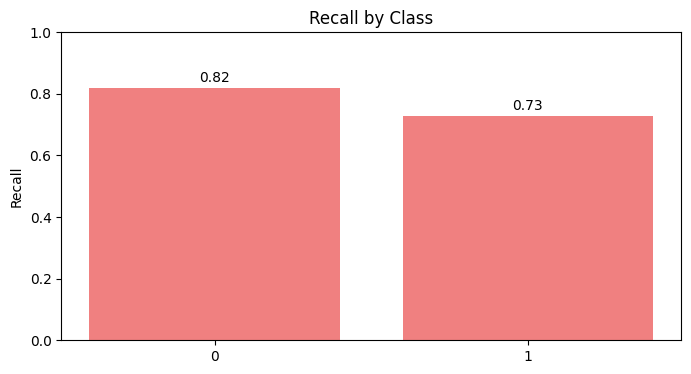

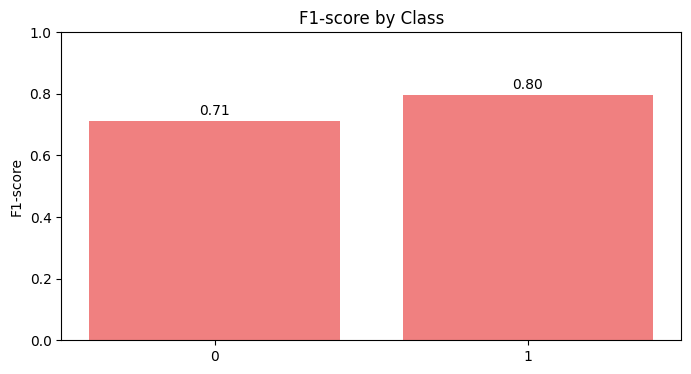

Scenario dataset_scenario_6_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with random for dataset_scenario_7_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_7_N
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 40, 'criterion': 'gini'}
Validation Metrics:
  Accuracy: 0.8143
  Precision: 0.8142
  Recall: 0.8143
  F1 Score: 0.8136

Test Metrics:
  Accuracy: 0.7746
  Precision: 0.7771
  Recall: 0.7746
  F1 Score: 0.7753

Confusion Matrix (Test Set):
[[31  9]
 [ 7 24]]


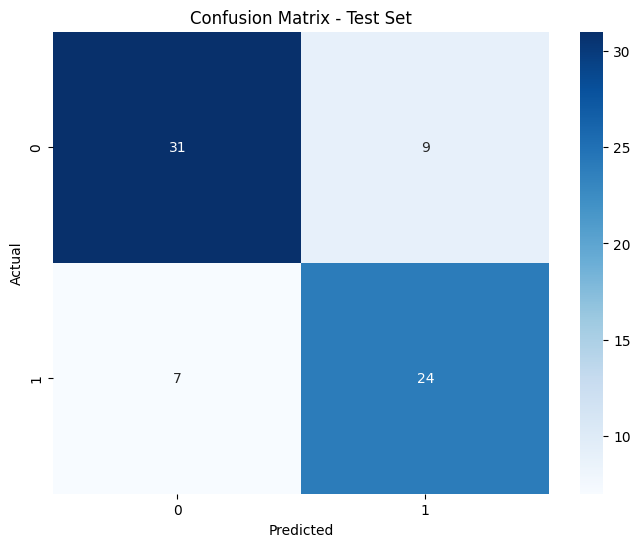

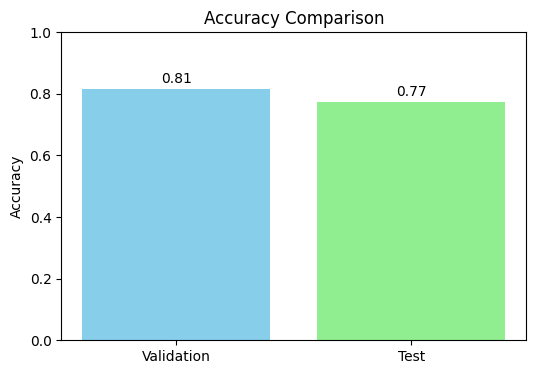

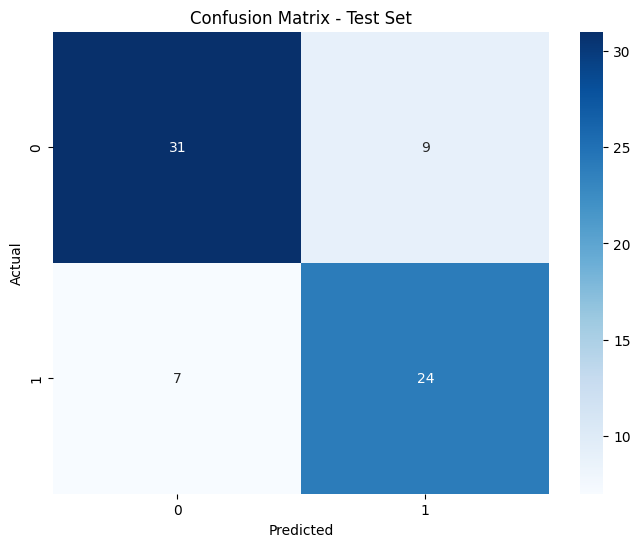

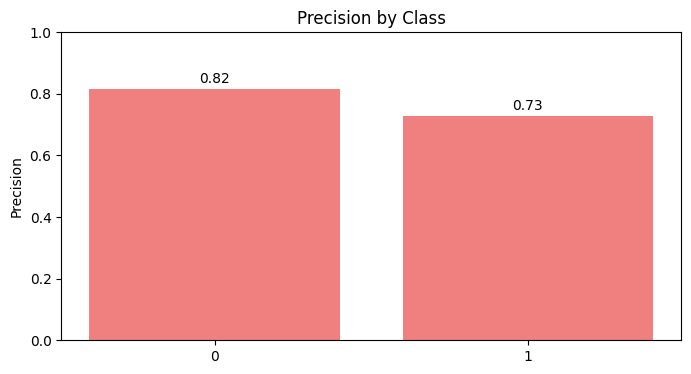

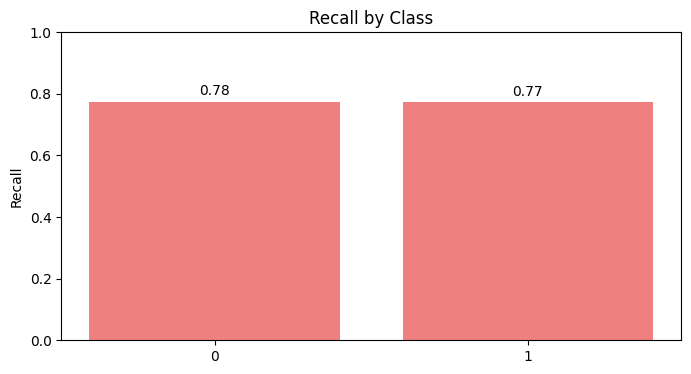

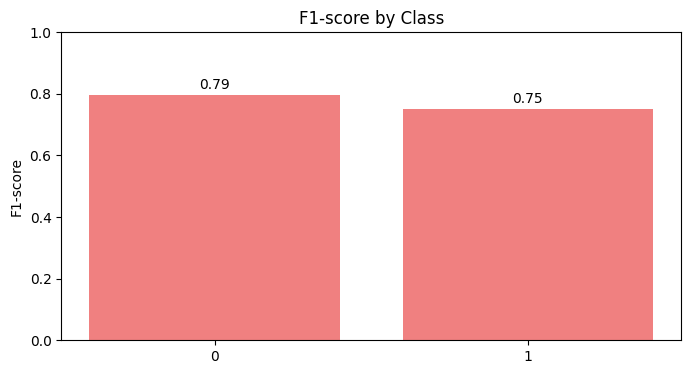

Scenario dataset_scenario_7_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_7_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_7_S
Best hyperparameters:  {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': None, 'criterion': 'gini'}
Validation Metrics:
  Accuracy: 0.8000
  Precision: 0.7997
  Recall: 0.8000
  F1 Score: 0.7997

Test Metrics:
  Accuracy: 0.7746
  Precision: 0.7814
  Recall: 0.7746
  F1 Score: 0.7755

Confusion Matrix (Test Set):
[[30 10]
 [ 6 25]]


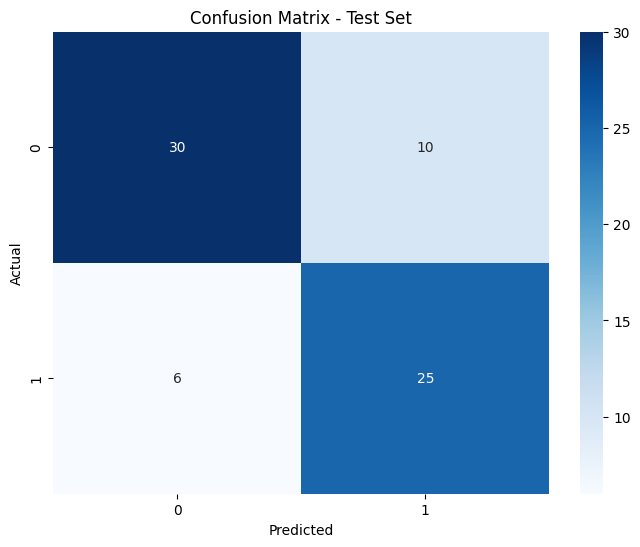

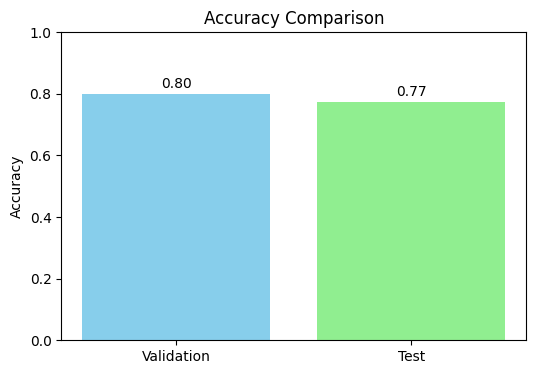

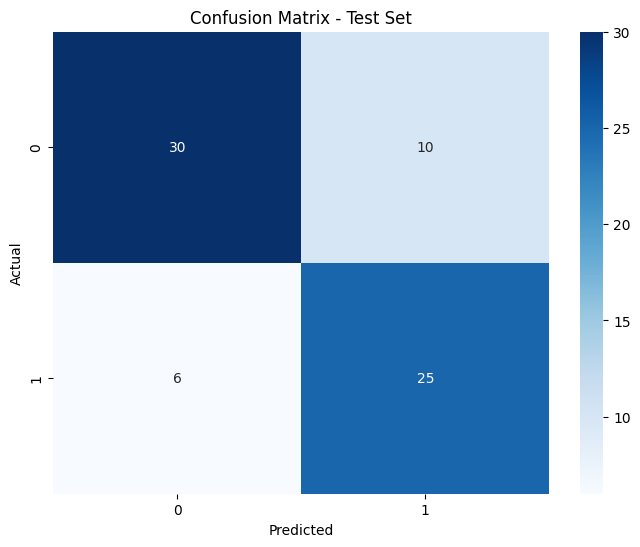

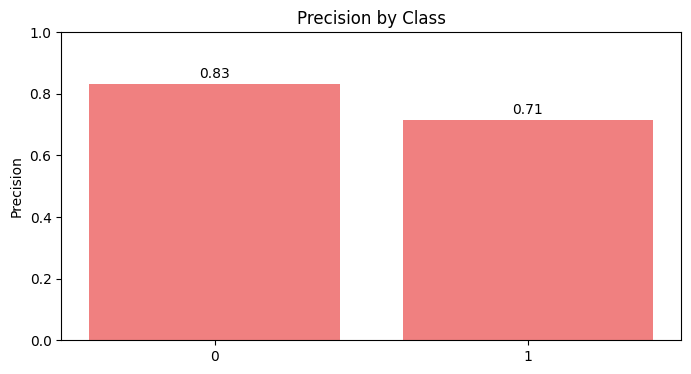

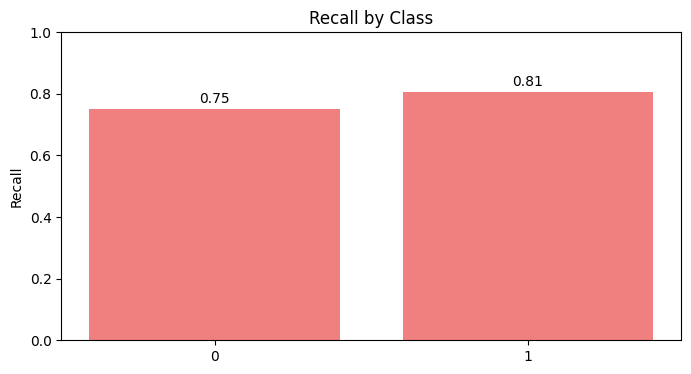

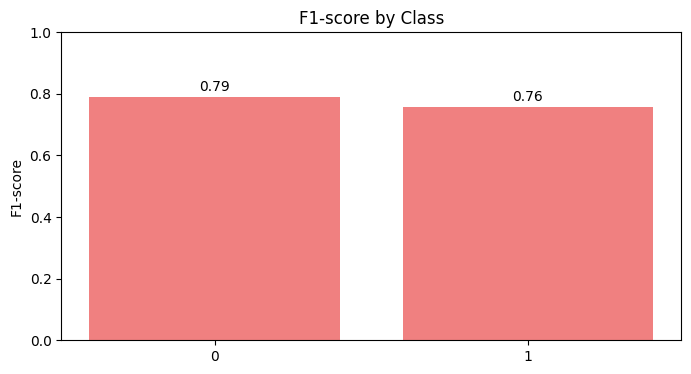

Scenario dataset_scenario_7_S with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with random for dataset_scenario_8_N...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_8_N
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20, 'criterion': 'log_loss'}
Validation Metrics:
  Accuracy: 0.7663
  Precision: 0.7815
  Recall: 0.7663
  F1 Score: 0.7674

Test Metrics:
  Accuracy: 0.7935
  Precision: 0.7988
  Recall: 0.7935
  F1 Score: 0.7953

Confusion Matrix (Test Set):
[[25  8]
 [11 48]]


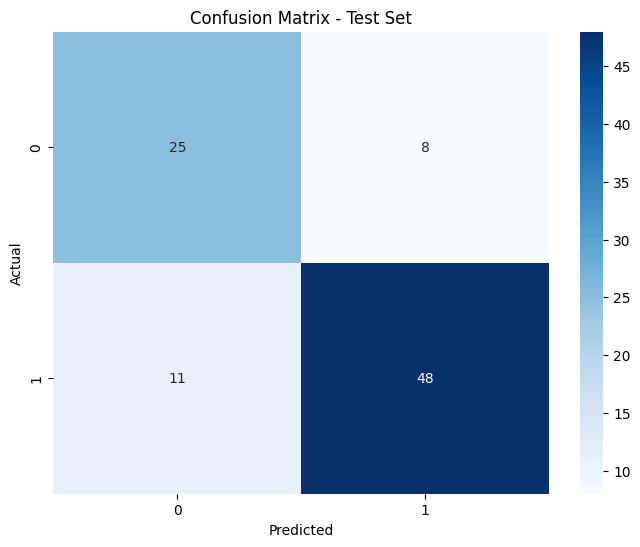

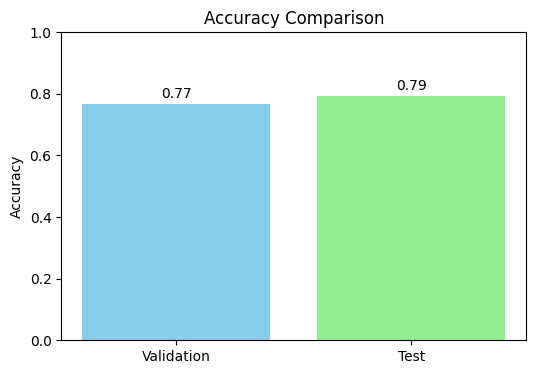

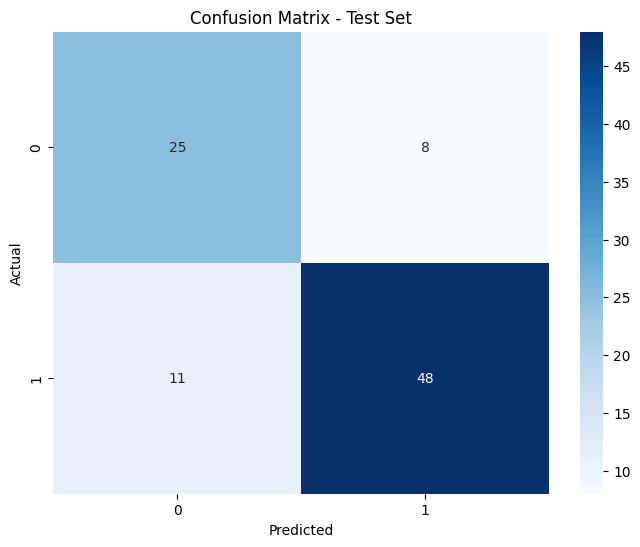

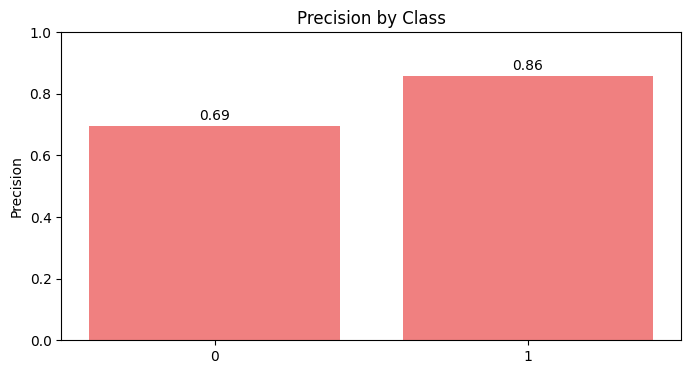

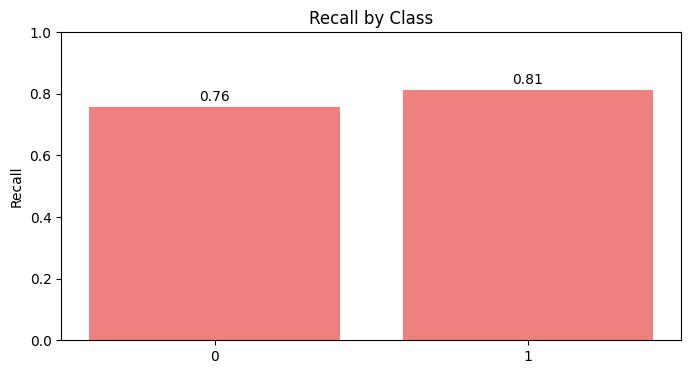

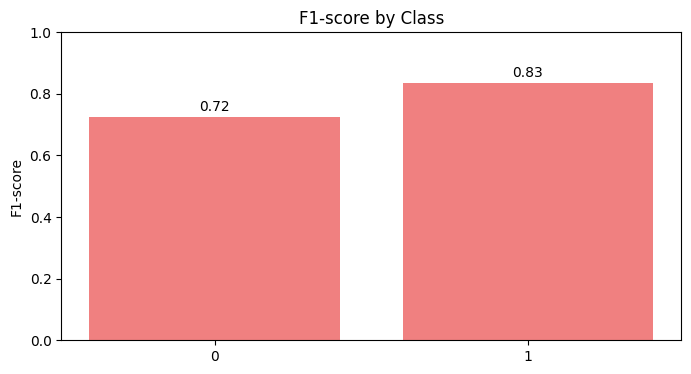

Scenario dataset_scenario_8_N with random completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with random for dataset_scenario_8_S...
Results will be saved in: SCORES\DecisionTree\random\dataset_scenario_8_S
Best hyperparameters:  {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 10, 'criterion': 'entropy'}
Validation Metrics:
  Accuracy: 0.7989
  Precision: 0.8066
  Recall: 0.7989
  F1 Score: 0.7999

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8234
  Recall: 0.8043
  F1 Score: 0.8078

Confusion Matrix (Test Set):
[[28  5]
 [13 46]]


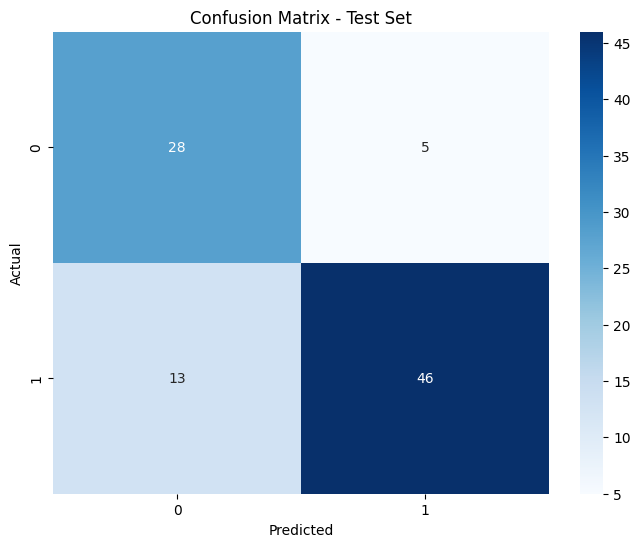

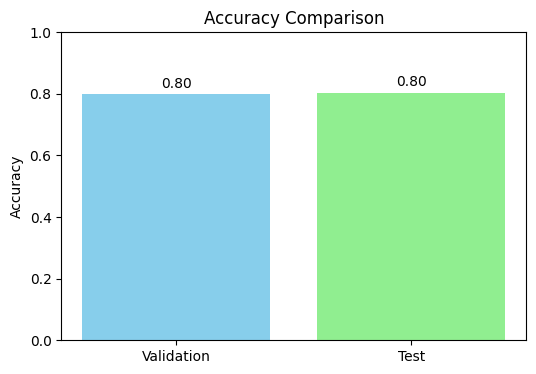

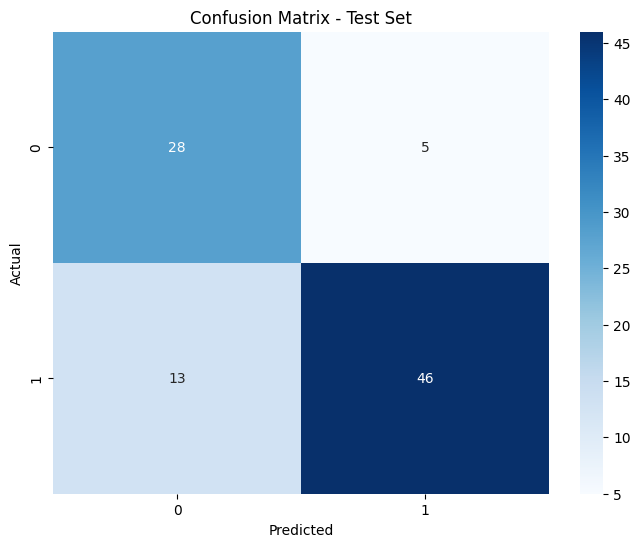

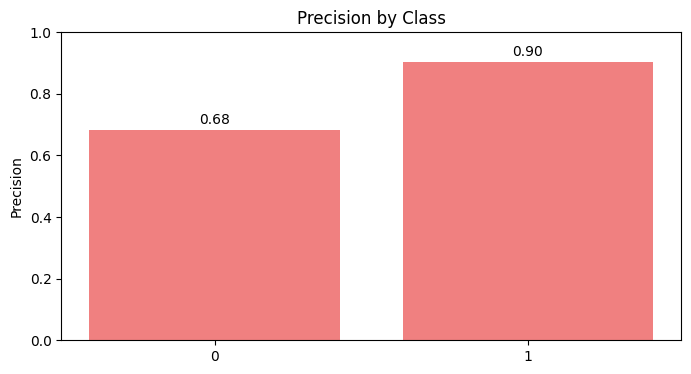

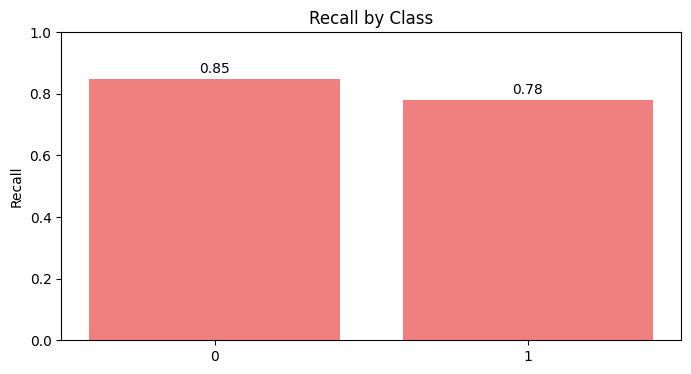

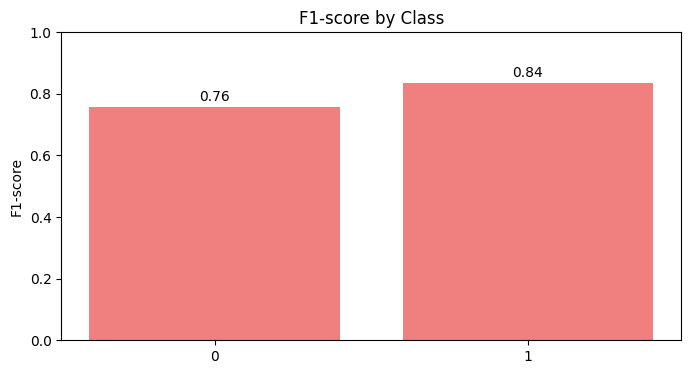

Scenario dataset_scenario_8_S with random completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.7826
  Precision: 0.7914
  Recall: 0.7826
  F1 Score: 0.7837

Test Metrics:
  Accuracy: 0.8152
  Precision: 0.8249
  Recall: 0.8152
  F1 Score: 0.8176

Confusion Matrix (Test Set):
[[27  6]
 [11 48]]


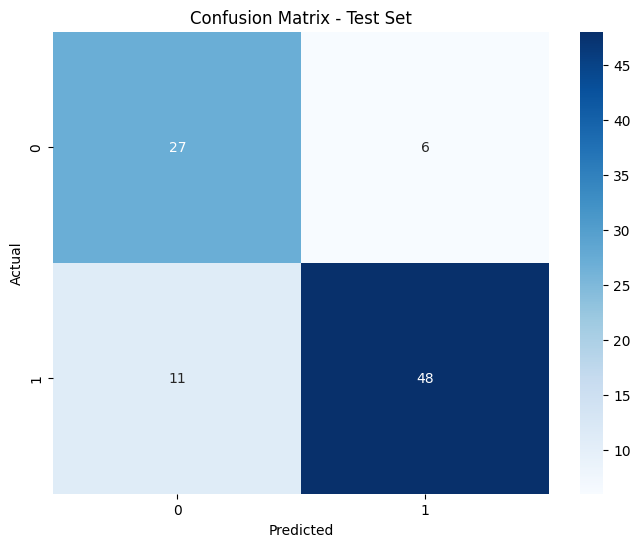

In [67]:
DecisionTree_random_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "DecisionTree", "random", search_config_random, get_search_hyperparameters("DecisionTree"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        DecisionTree_random_search['accuracy'] = best_score
        DecisionTree_random_search['params'] = best_params
        DecisionTree_random_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
DecisionTree = DecisionTreeClassifier(**DecisionTree_random_search['params'])
best_scenario = pd.read_csv(DecisionTree_random_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, DecisionTree) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "DecisionTree", "random")
save_model_info(DecisionTree_random_search, "DecisionTree", "random")
    

## 3. Bayesian Optimization (Optuna)

[I 2024-12-06 02:29:42,981] A new study created in memory with name: no-name-f85f100d-ce55-4b93-be11-6bd5589c5cb3
[I 2024-12-06 02:29:43,017] Trial 0 finished with value: 0.7818556201550388 and parameters: {'criterion': 'log_loss', 'max_depth': 35, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7818556201550388.


Scenario Name: Scenario 1_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with optuna for dataset_scenario_1_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_1_N


[I 2024-12-06 02:29:43,042] Trial 1 finished with value: 0.8083212209302324 and parameters: {'criterion': 'log_loss', 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.8083212209302324.
[I 2024-12-06 02:29:43,067] Trial 2 finished with value: 0.797468507751938 and parameters: {'criterion': 'log_loss', 'max_depth': 23, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 1 with value: 0.8083212209302324.
[I 2024-12-06 02:29:43,092] Trial 3 finished with value: 0.803670058139535 and parameters: {'criterion': 'entropy', 'max_depth': 7, 'min_samples_split': 5, 'min_samples_leaf': 1}. Best is trial 1 with value: 0.8083212209302324.
[I 2024-12-06 02:29:43,107] Trial 4 finished with value: 0.7864946705426357 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 5, 'min_samples_leaf': 1}. Best is trial 1 with value: 0.8083212209302324.
[I 2024-12-06 02:29:43,123] Trial 5 finished with value: 0.7927325581395349 and para

Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 15, 'min_samples_split': 3, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.7391
  Precision: 0.7480
  Recall: 0.7391
  F1 Score: 0.7404

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7774
  Recall: 0.7717
  F1 Score: 0.7737

Confusion Matrix (Test Set):
[[24  9]
 [12 47]]


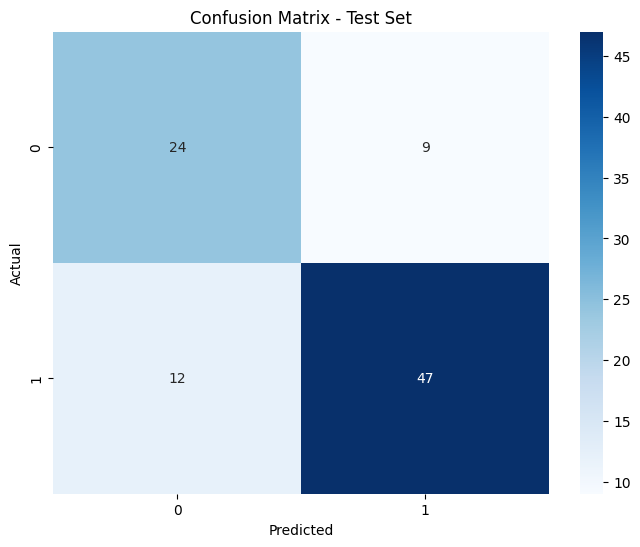

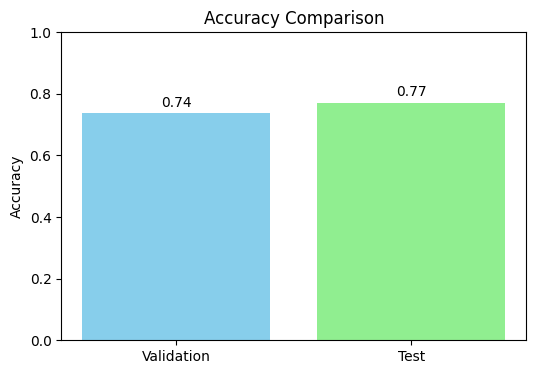

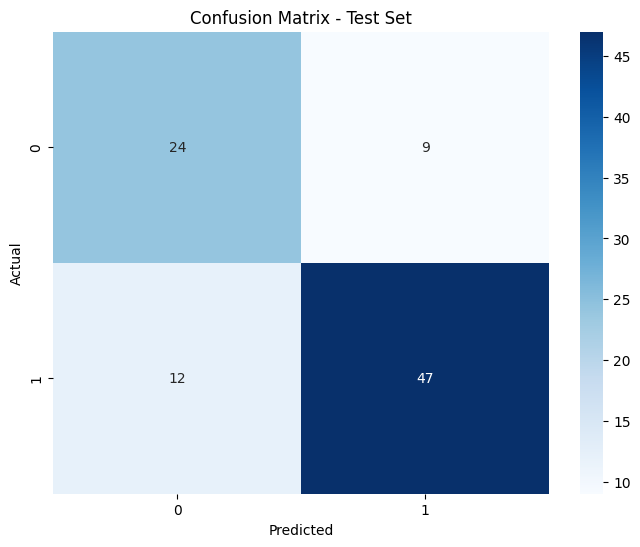

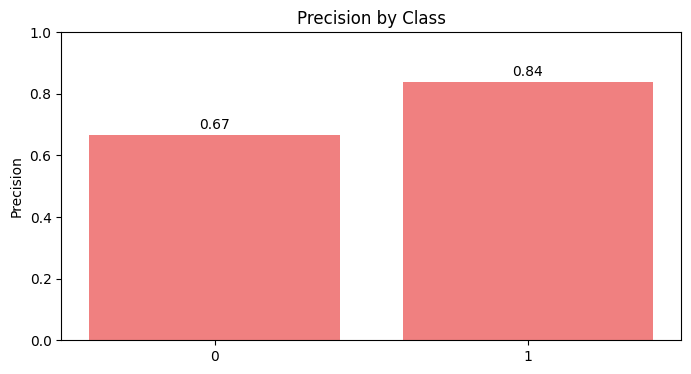

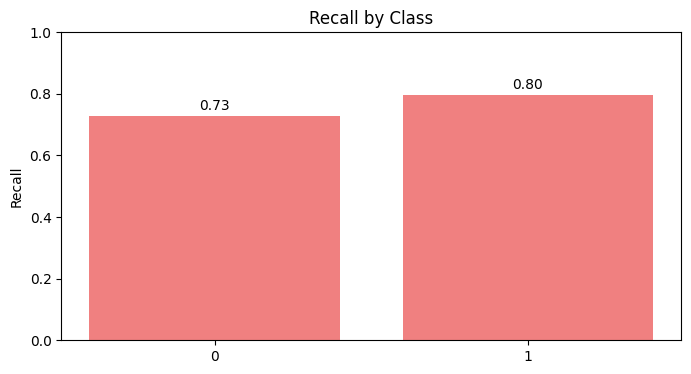

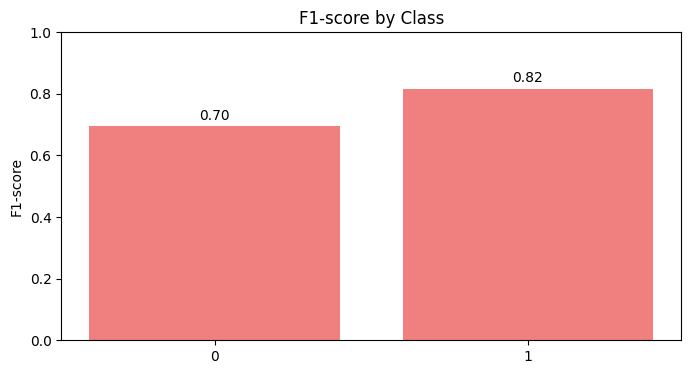

[I 2024-12-06 02:29:46,239] A new study created in memory with name: no-name-edb57076-f9d5-4c31-9677-5b5a2d4c5c9e
[I 2024-12-06 02:29:46,254] Trial 0 finished with value: 0.8036337209302324 and parameters: {'criterion': 'entropy', 'max_depth': 7, 'min_samples_split': 8, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.8036337209302324.
[I 2024-12-06 02:29:46,269] Trial 1 finished with value: 0.7833333333333333 and parameters: {'criterion': 'gini', 'max_depth': 36, 'min_samples_split': 9, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.8036337209302324.
[I 2024-12-06 02:29:46,285] Trial 2 finished with value: 0.8130208333333332 and parameters: {'criterion': 'entropy', 'max_depth': 50, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8130208333333332.
[I 2024-12-06 02:29:46,299] Trial 3 finished with value: 0.7911942829457363 and parameters: {'criterion': 'gini', 'max_depth': 50, 'min_samples_split': 10, 'min_samples_leaf': 5}. Best is trial 2 with

Scenario dataset_scenario_1_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 1_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_1_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_1_S


[I 2024-12-06 02:29:46,437] Trial 11 finished with value: 0.8036458333333332 and parameters: {'criterion': 'entropy', 'max_depth': 41, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8130208333333332.
[I 2024-12-06 02:29:46,462] Trial 12 finished with value: 0.802095445736434 and parameters: {'criterion': 'entropy', 'max_depth': 42, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8130208333333332.
[I 2024-12-06 02:29:46,486] Trial 13 finished with value: 0.7943313953488372 and parameters: {'criterion': 'entropy', 'max_depth': 41, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 2 with value: 0.8130208333333332.
[I 2024-12-06 02:29:46,511] Trial 14 finished with value: 0.7865188953488372 and parameters: {'criterion': 'entropy', 'max_depth': 43, 'min_samples_split': 5, 'min_samples_leaf': 4}. Best is trial 2 with value: 0.8130208333333332.
[I 2024-12-06 02:29:46,535] Trial 15 finished with value: 0.8036337209302324 

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 50, 'min_samples_split': 6, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.7609
  Precision: 0.7747
  Recall: 0.7609
  F1 Score: 0.7620

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8170
  Recall: 0.8043
  F1 Score: 0.8073

Confusion Matrix (Test Set):
[[27  6]
 [12 47]]


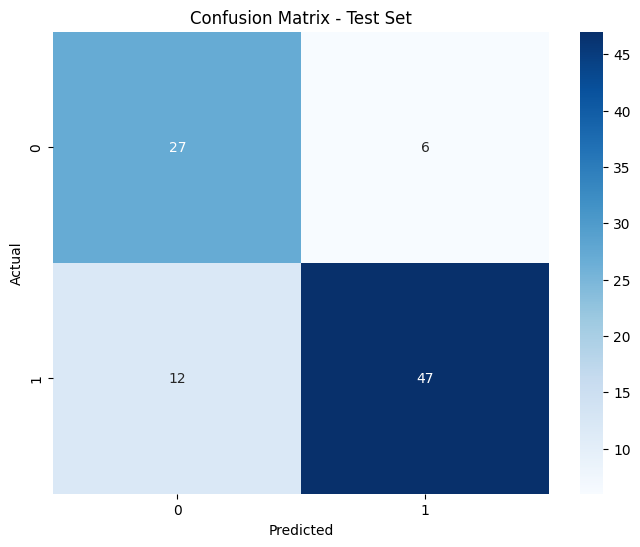

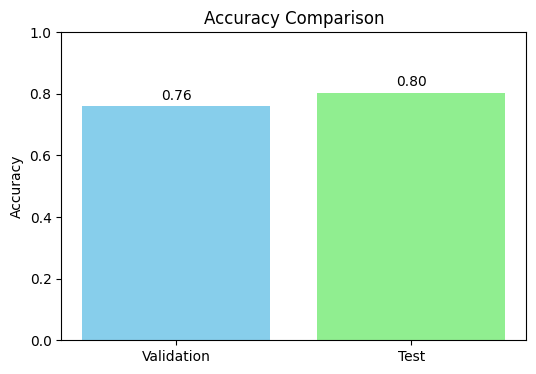

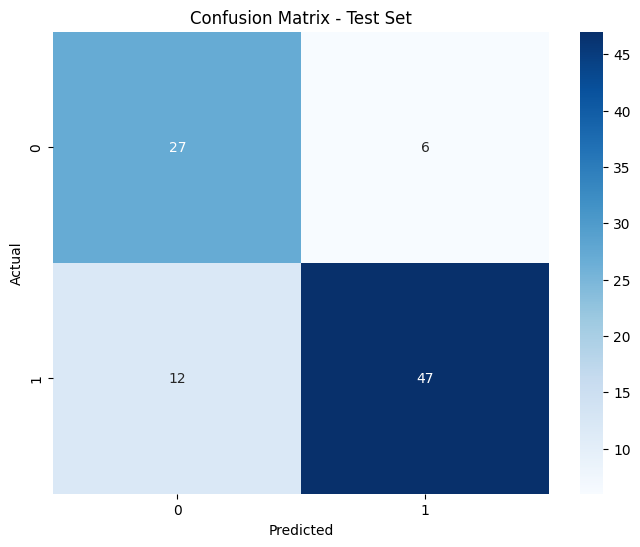

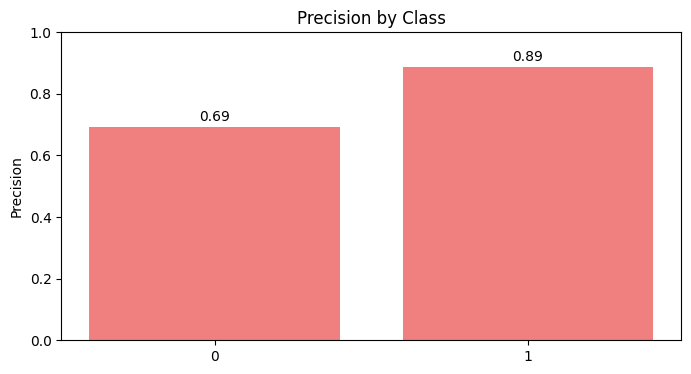

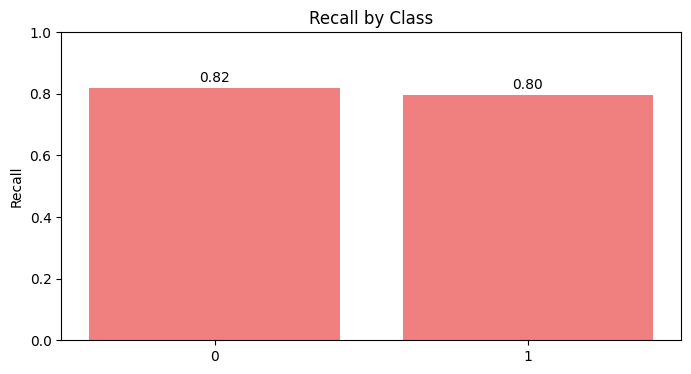

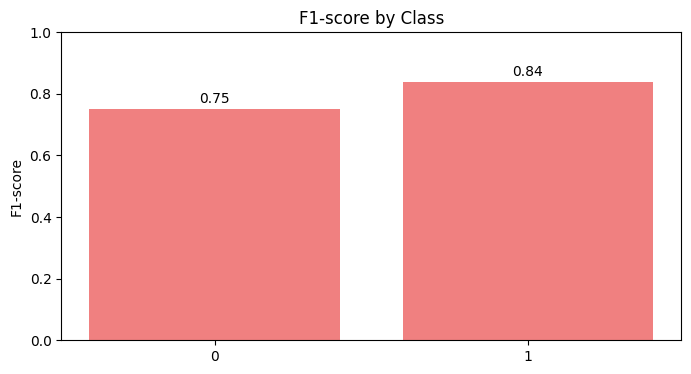

[I 2024-12-06 02:29:49,458] A new study created in memory with name: no-name-a855524d-9088-4b86-8a3f-c5eb4bb216af
[I 2024-12-06 02:29:49,472] Trial 0 finished with value: 0.7990431201550388 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.7990431201550388.
[I 2024-12-06 02:29:49,487] Trial 1 finished with value: 0.7818556201550388 and parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 7, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.7990431201550388.
[I 2024-12-06 02:29:49,501] Trial 2 finished with value: 0.7849563953488372 and parameters: {'criterion': 'entropy', 'max_depth': 38, 'min_samples_split': 9, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7990431201550388.
[I 2024-12-06 02:29:49,515] Trial 3 finished with value: 0.7756177325581396 and parameters: {'criterion': 'gini', 'max_depth': 39, 'min_samples_split': 7, 'min_samples_leaf': 4}. Best is trial 0 with v

Scenario dataset_scenario_1_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_N
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: MinMax
Running DecisionTree with optuna for dataset_scenario_2_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_2_N


[I 2024-12-06 02:29:49,652] Trial 11 finished with value: 0.8207969961240309 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 3}. Best is trial 11 with value: 0.8207969961240309.
[I 2024-12-06 02:29:49,677] Trial 12 finished with value: 0.7895833333333333 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 3, 'min_samples_leaf': 3}. Best is trial 11 with value: 0.8207969961240309.
[I 2024-12-06 02:29:49,703] Trial 13 finished with value: 0.7755571705426357 and parameters: {'criterion': 'entropy', 'max_depth': 11, 'min_samples_split': 4, 'min_samples_leaf': 2}. Best is trial 11 with value: 0.8207969961240309.
[I 2024-12-06 02:29:49,729] Trial 14 finished with value: 0.7678294573643412 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 10, 'min_samples_leaf': 2}. Best is trial 11 with value: 0.8207969961240309.
[I 2024-12-06 02:29:49,753] Trial 15 finished with value: 0.786506782945

Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 2}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8475
  Recall: 0.8478
  F1 Score: 0.8476

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8023
  Recall: 0.8043
  F1 Score: 0.8029

Confusion Matrix (Test Set):
[[23 10]
 [ 8 51]]


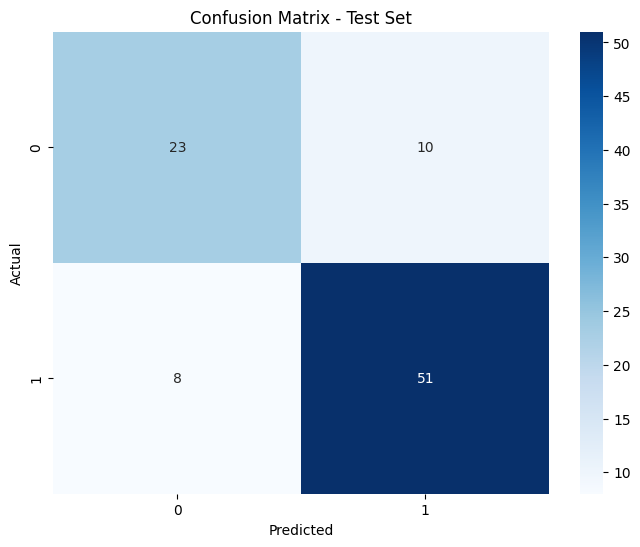

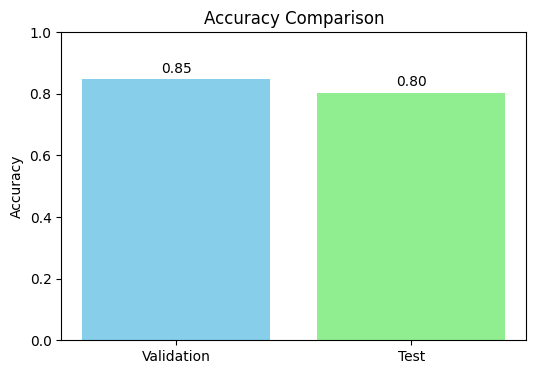

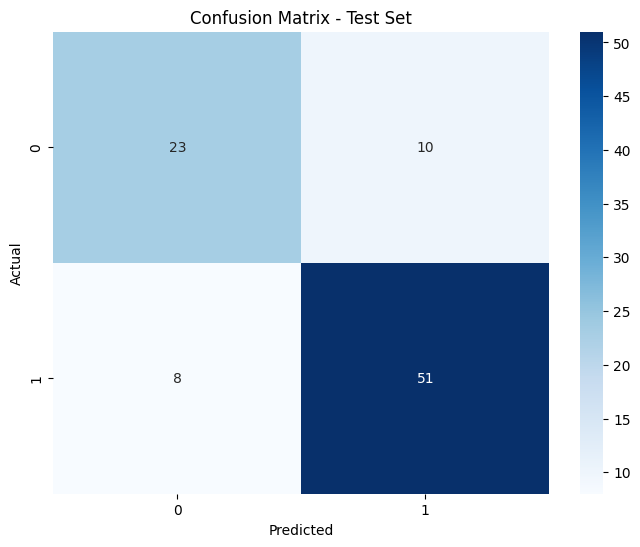

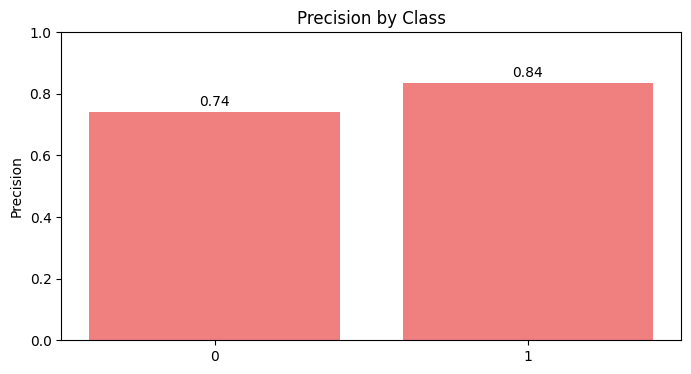

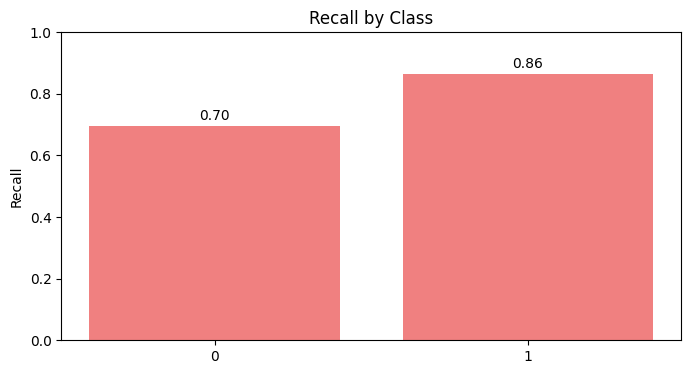

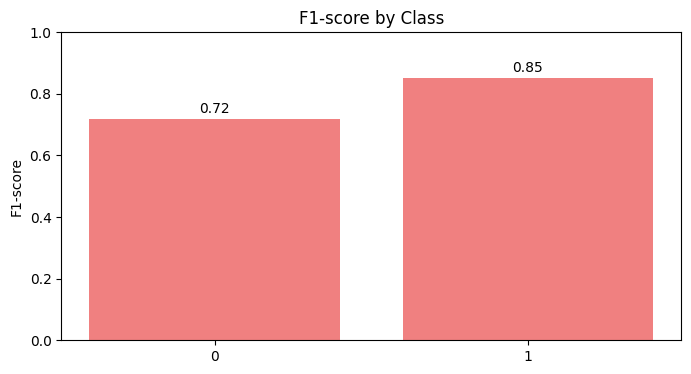

[I 2024-12-06 02:29:52,773] A new study created in memory with name: no-name-f5062ead-5d17-4f3a-b4f2-4d67205233fc
[I 2024-12-06 02:29:52,789] Trial 0 finished with value: 0.7833333333333334 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 3, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7833333333333334.
[I 2024-12-06 02:29:52,803] Trial 1 finished with value: 0.7880208333333334 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 1 with value: 0.7880208333333334.
[I 2024-12-06 02:29:52,818] Trial 2 finished with value: 0.7802567829457365 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 5, 'min_samples_leaf': 1}. Best is trial 1 with value: 0.7880208333333334.
[I 2024-12-06 02:29:52,832] Trial 3 finished with value: 0.7864704457364342 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 6, 'min_samples_leaf': 4}. Best is trial 1 with

Scenario dataset_scenario_2_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 2_S
  Encoding: Label encoding
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: {'RestingBP': 'mean', 'Cholesterol': 'mean'}
  Oldpeak Absolute: True
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_2_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_2_S


[I 2024-12-06 02:29:52,970] Trial 11 finished with value: 0.8255087209302324 and parameters: {'criterion': 'log_loss', 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 10 with value: 0.8255087209302324.
[I 2024-12-06 02:29:52,995] Trial 12 finished with value: 0.7942950581395348 and parameters: {'criterion': 'log_loss', 'max_depth': 6, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 10 with value: 0.8255087209302324.
[I 2024-12-06 02:29:53,019] Trial 13 finished with value: 0.766218507751938 and parameters: {'criterion': 'log_loss', 'max_depth': 50, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 10 with value: 0.8255087209302324.
[I 2024-12-06 02:29:53,042] Trial 14 finished with value: 0.7833212209302326 and parameters: {'criterion': 'log_loss', 'max_depth': 9, 'min_samples_split': 4, 'min_samples_leaf': 3}. Best is trial 10 with value: 0.8255087209302324.
[I 2024-12-06 02:29:53,067] Trial 15 finished with value: 0.764752906976

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 6, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8475
  Recall: 0.8478
  F1 Score: 0.8476

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8023
  Recall: 0.8043
  F1 Score: 0.8029

Confusion Matrix (Test Set):
[[23 10]
 [ 8 51]]


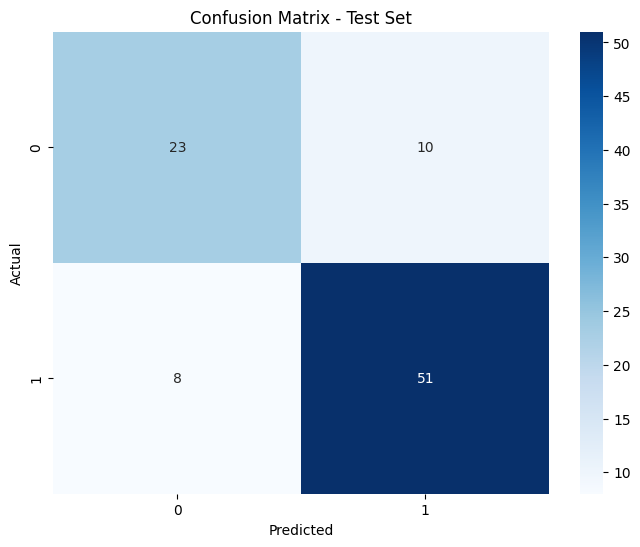

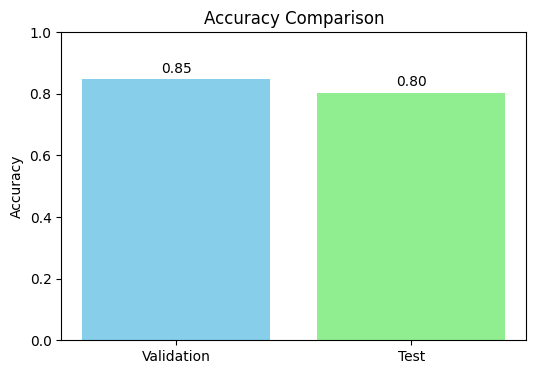

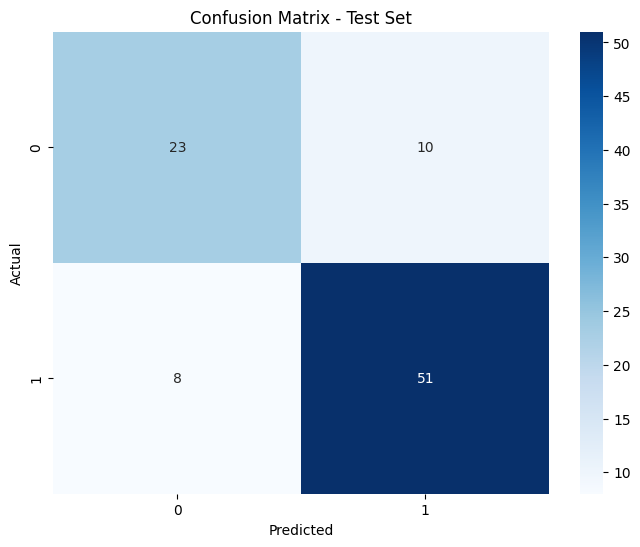

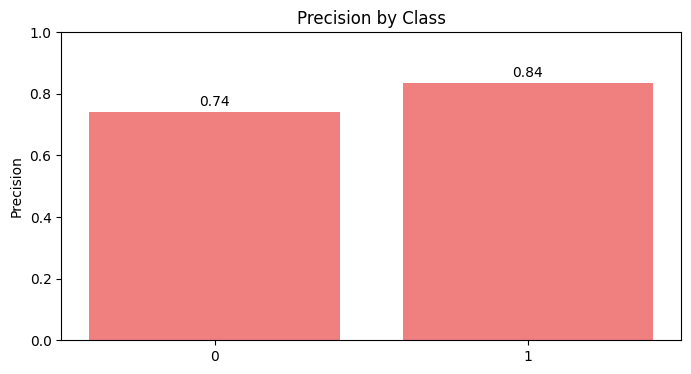

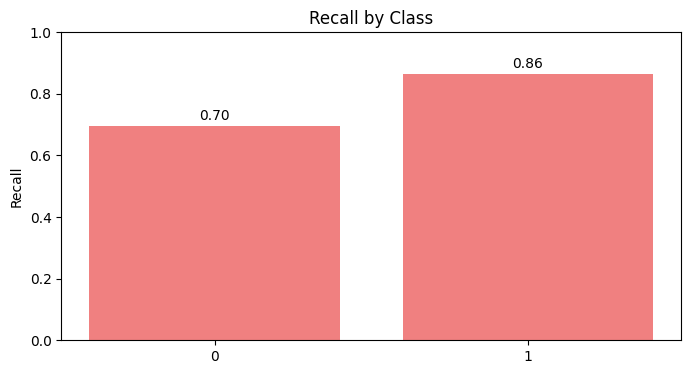

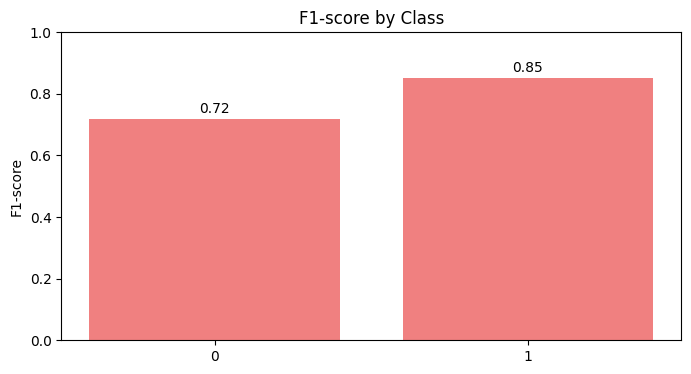

[I 2024-12-06 02:29:55,962] A new study created in memory with name: no-name-560eb13f-b5be-4d47-84fc-d175b599c716
[I 2024-12-06 02:29:55,977] Trial 0 finished with value: 0.826881055452484 and parameters: {'criterion': 'entropy', 'max_depth': 7, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.826881055452484.
[I 2024-12-06 02:29:55,991] Trial 1 finished with value: 0.8126159554730984 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 9, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.826881055452484.
[I 2024-12-06 02:29:56,005] Trial 2 finished with value: 0.8533704390847248 and parameters: {'criterion': 'gini', 'max_depth': 34, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8533704390847248.
[I 2024-12-06 02:29:56,020] Trial 3 finished with value: 0.8003916718202433 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 2 with val

Scenario dataset_scenario_2_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_N
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with optuna for dataset_scenario_3_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_3_N


[I 2024-12-06 02:29:56,170] Trial 11 finished with value: 0.8492888064316636 and parameters: {'criterion': 'gini', 'max_depth': 31, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 10 with value: 0.857452071737786.
[I 2024-12-06 02:29:56,194] Trial 12 finished with value: 0.8513296227581943 and parameters: {'criterion': 'gini', 'max_depth': 36, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 10 with value: 0.857452071737786.
[I 2024-12-06 02:29:56,218] Trial 13 finished with value: 0.8207586064728922 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 10 with value: 0.857452071737786.
[I 2024-12-06 02:29:56,241] Trial 14 finished with value: 0.8574520717377861 and parameters: {'criterion': 'gini', 'max_depth': 50, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 14 with value: 0.8574520717377861.
[I 2024-12-06 02:29:56,265] Trial 15 finished with value: 0.8004122861265719 and parame

Best hyperparameters:  {'criterion': 'gini', 'max_depth': 38, 'min_samples_split': 7, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.8286
  Precision: 0.8283
  Recall: 0.8286
  F1 Score: 0.8283

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8157
  Recall: 0.8028
  F1 Score: 0.8035

Confusion Matrix (Test Set):
[[30 10]
 [ 4 27]]


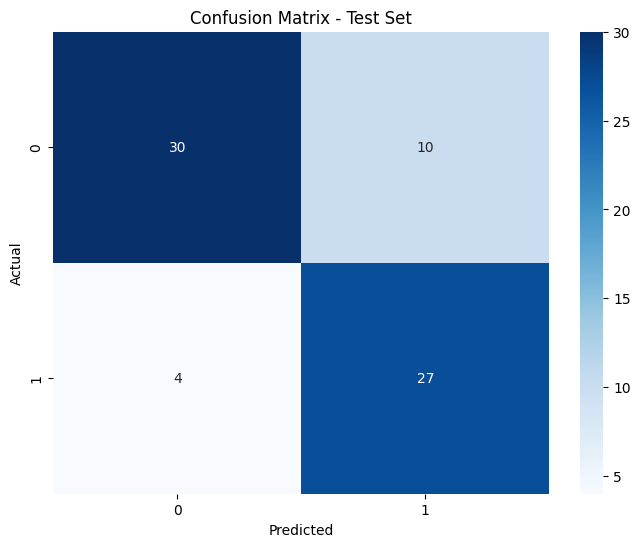

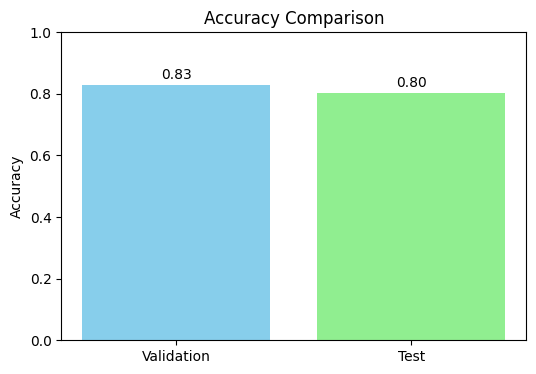

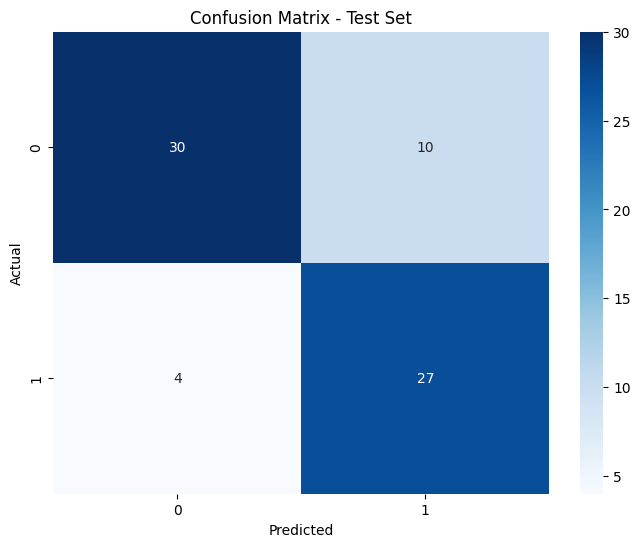

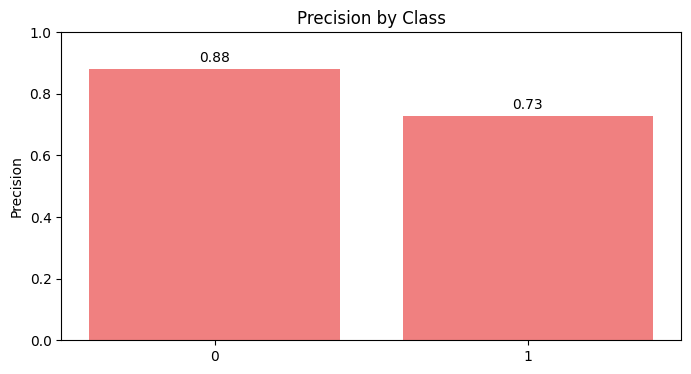

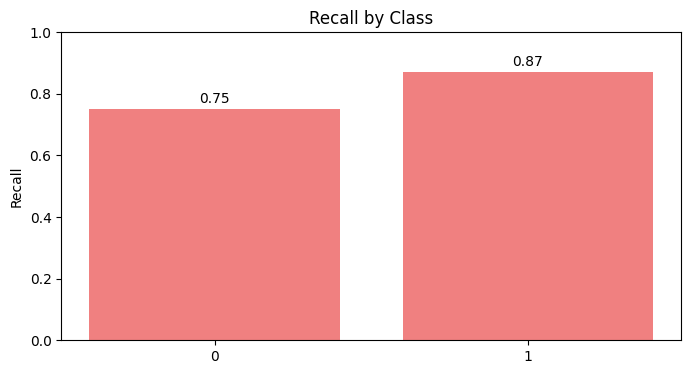

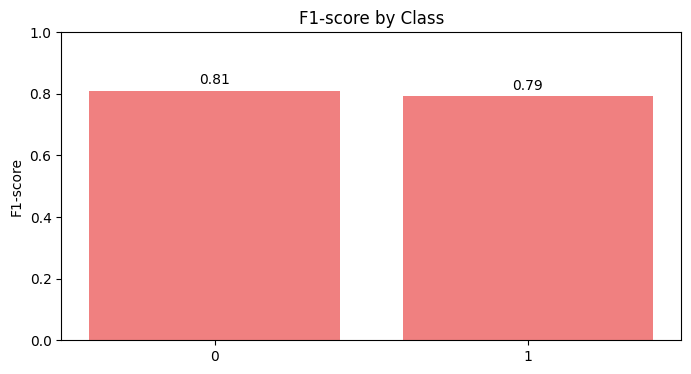

[I 2024-12-06 02:29:59,133] A new study created in memory with name: no-name-3af26ee1-de2b-4d56-be54-af8c2c30e3bd
[I 2024-12-06 02:29:59,148] Trial 0 finished with value: 0.7841269841269841 and parameters: {'criterion': 'entropy', 'max_depth': 29, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.7841269841269841.
[I 2024-12-06 02:29:59,163] Trial 1 finished with value: 0.8248402391259534 and parameters: {'criterion': 'entropy', 'max_depth': 49, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.8248402391259534.
[I 2024-12-06 02:29:59,178] Trial 2 finished with value: 0.8044733044733045 and parameters: {'criterion': 'log_loss', 'max_depth': 8, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 1 with value: 0.8248402391259534.
[I 2024-12-06 02:29:59,193] Trial 3 finished with value: 0.8472686044114616 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'min_samples_leaf': 2}. Best is trial 3 w

Scenario dataset_scenario_3_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 3_S
  Encoding: Label encoding
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_3_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_3_S


[I 2024-12-06 02:29:59,354] Trial 12 finished with value: 0.8350237064522779 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 2}. Best is trial 3 with value: 0.8472686044114616.
[I 2024-12-06 02:29:59,379] Trial 13 finished with value: 0.8064935064935066 and parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 2, 'min_samples_leaf': 2}. Best is trial 3 with value: 0.8472686044114616.
[I 2024-12-06 02:29:59,404] Trial 14 finished with value: 0.8187590187590189 and parameters: {'criterion': 'gini', 'max_depth': 6, 'min_samples_split': 8, 'min_samples_leaf': 2}. Best is trial 3 with value: 0.8472686044114616.
[I 2024-12-06 02:29:59,430] Trial 15 finished with value: 0.8125953411667698 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 10, 'min_samples_leaf': 1}. Best is trial 3 with value: 0.8472686044114616.
[I 2024-12-06 02:29:59,456] Trial 16 finished with value: 0.8105545248402392 and parameter

Best hyperparameters:  {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 3, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.8357
  Precision: 0.8355
  Recall: 0.8357
  F1 Score: 0.8356

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8157
  Recall: 0.8028
  F1 Score: 0.8035

Confusion Matrix (Test Set):
[[30 10]
 [ 4 27]]


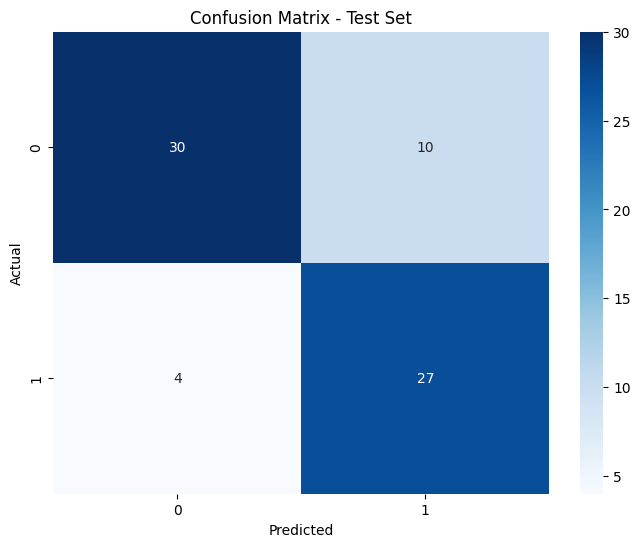

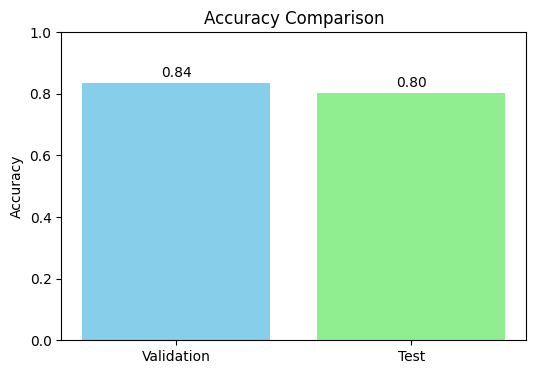

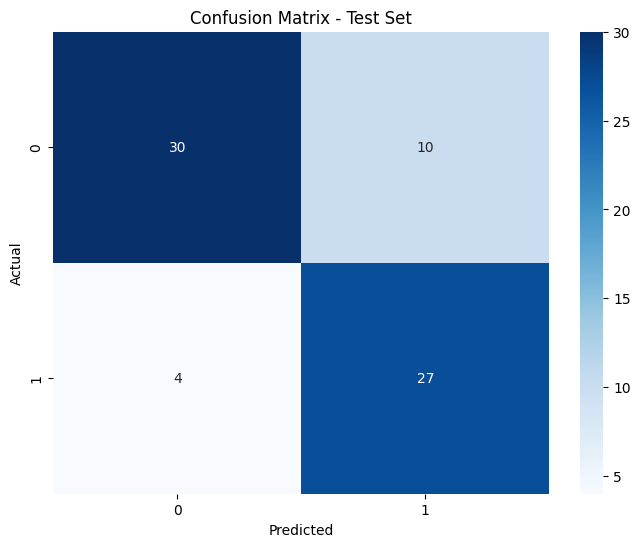

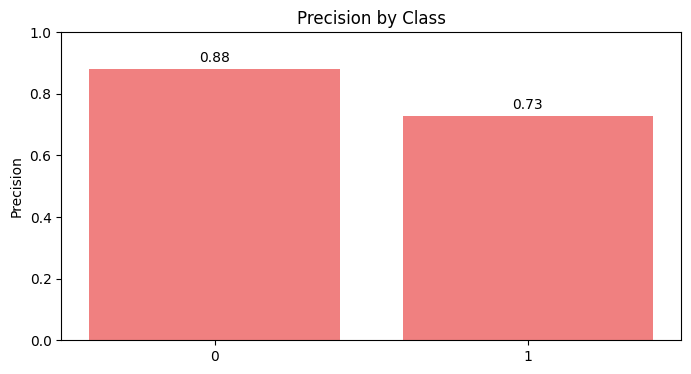

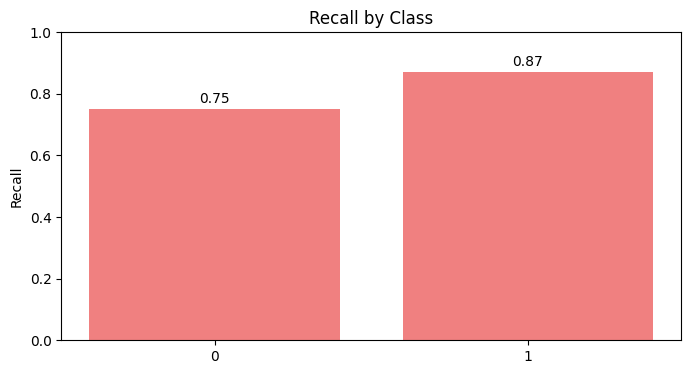

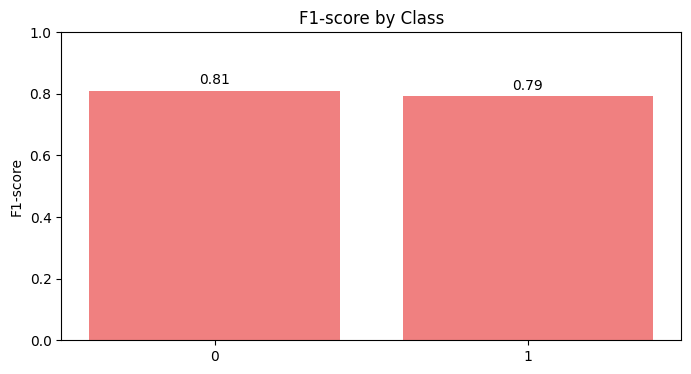

[I 2024-12-06 02:30:02,525] A new study created in memory with name: no-name-24c25830-3088-4987-8121-bee0e70b5a6b
[I 2024-12-06 02:30:02,539] Trial 0 finished with value: 0.781843507751938 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 2, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.781843507751938.
[I 2024-12-06 02:30:02,553] Trial 1 finished with value: 0.7958575581395348 and parameters: {'criterion': 'log_loss', 'max_depth': 31, 'min_samples_split': 7, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.7958575581395348.
[I 2024-12-06 02:30:02,567] Trial 2 finished with value: 0.797420058139535 and parameters: {'criterion': 'entropy', 'max_depth': 48, 'min_samples_split': 9, 'min_samples_leaf': 3}. Best is trial 2 with value: 0.797420058139535.
[I 2024-12-06 02:30:02,582] Trial 3 finished with value: 0.7818556201550388 and parameters: {'criterion': 'gini', 'max_depth': 41, 'min_samples_split': 5, 'min_samples_leaf': 4}. Best is trial 2 with va

Scenario dataset_scenario_3_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_N
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with optuna for dataset_scenario_4_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_4_N


[I 2024-12-06 02:30:02,744] Trial 11 finished with value: 0.7989704457364342 and parameters: {'criterion': 'entropy', 'max_depth': 48, 'min_samples_split': 9, 'min_samples_leaf': 3}. Best is trial 8 with value: 0.8005208333333333.
[I 2024-12-06 02:30:02,769] Trial 12 finished with value: 0.7881177325581395 and parameters: {'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 8, 'min_samples_leaf': 2}. Best is trial 8 with value: 0.8005208333333333.
[I 2024-12-06 02:30:02,793] Trial 13 finished with value: 0.8036821705426357 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 4}. Best is trial 13 with value: 0.8036821705426357.
[I 2024-12-06 02:30:02,817] Trial 14 finished with value: 0.805232558139535 and parameters: {'criterion': 'log_loss', 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 4}. Best is trial 14 with value: 0.805232558139535.
[I 2024-12-06 02:30:02,841] Trial 15 finished with value: 0.8051962209302325 

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 8, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8152
  Precision: 0.8170
  Recall: 0.8152
  F1 Score: 0.8157

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


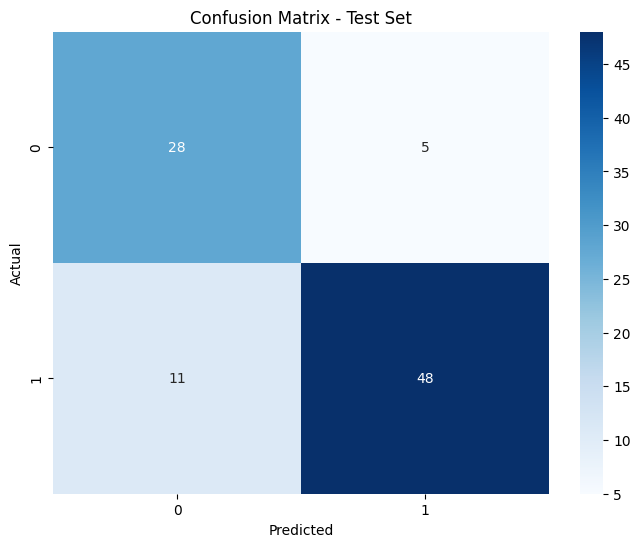

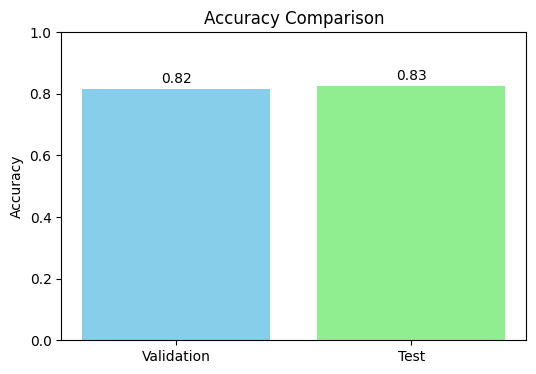

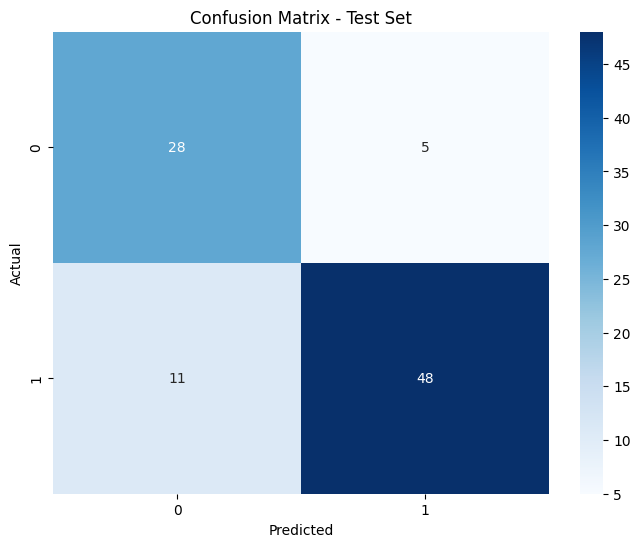

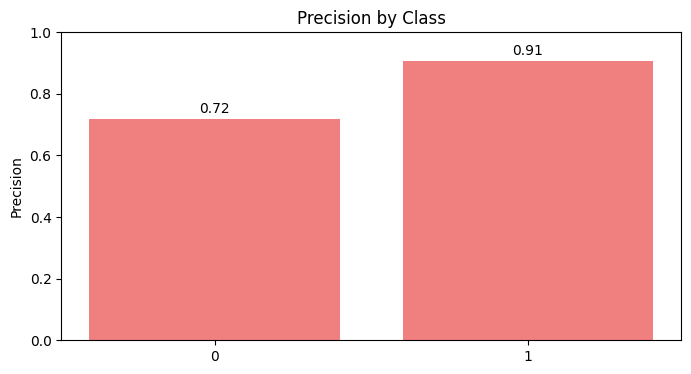

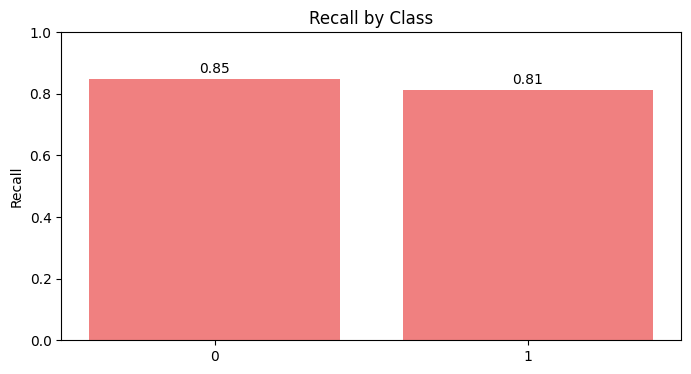

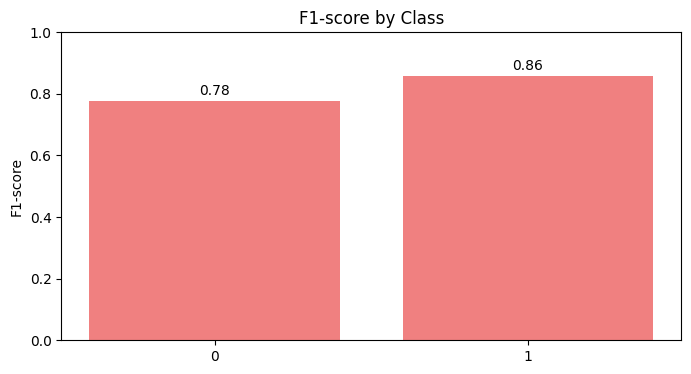

[I 2024-12-06 02:30:05,720] A new study created in memory with name: no-name-24e6e72a-9283-4ea1-82c9-596c90c328f5
[I 2024-12-06 02:30:05,735] Trial 0 finished with value: 0.7974321705426357 and parameters: {'criterion': 'entropy', 'max_depth': 9, 'min_samples_split': 10, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.7974321705426357.
[I 2024-12-06 02:30:05,749] Trial 1 finished with value: 0.7927446705426358 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 10, 'min_samples_leaf': 1}. Best is trial 0 with value: 0.7974321705426357.
[I 2024-12-06 02:30:05,764] Trial 2 finished with value: 0.8036337209302324 and parameters: {'criterion': 'entropy', 'max_depth': 31, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 2 with value: 0.8036337209302324.
[I 2024-12-06 02:30:05,778] Trial 3 finished with value: 0.8223352713178294 and parameters: {'criterion': 'entropy', 'max_depth': 7, 'min_samples_split': 3, 'min_samples_leaf': 1}. Best is trial 

Scenario dataset_scenario_4_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 4_S
  Encoding: Label encoding
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_4_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_4_S


[I 2024-12-06 02:30:05,916] Trial 11 finished with value: 0.7927446705426358 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 2, 'min_samples_leaf': 2}. Best is trial 3 with value: 0.8223352713178294.
[I 2024-12-06 02:30:05,941] Trial 12 finished with value: 0.797407945736434 and parameters: {'criterion': 'entropy', 'max_depth': 46, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 3 with value: 0.8223352713178294.
[I 2024-12-06 02:30:05,965] Trial 13 finished with value: 0.7974321705426357 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 2}. Best is trial 3 with value: 0.8223352713178294.
[I 2024-12-06 02:30:05,988] Trial 14 finished with value: 0.7989583333333333 and parameters: {'criterion': 'entropy', 'max_depth': 34, 'min_samples_split': 4, 'min_samples_leaf': 1}. Best is trial 3 with value: 0.8223352713178294.
[I 2024-12-06 02:30:06,013] Trial 15 finished with value: 0.791218507751938 a

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 7, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8261
  Precision: 0.8307
  Recall: 0.8261
  F1 Score: 0.8268

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


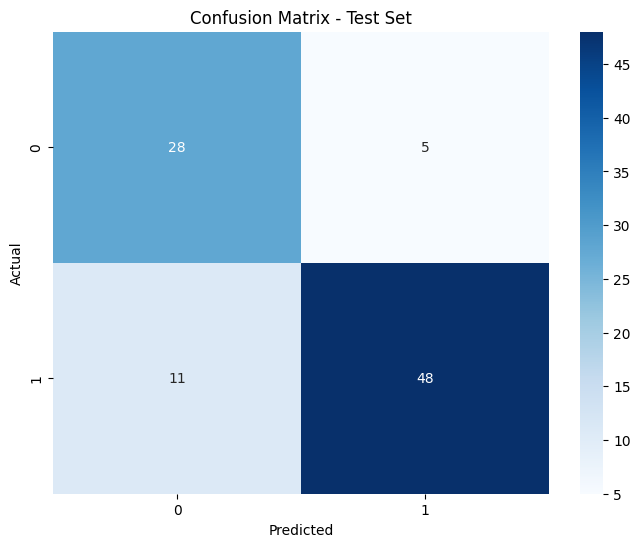

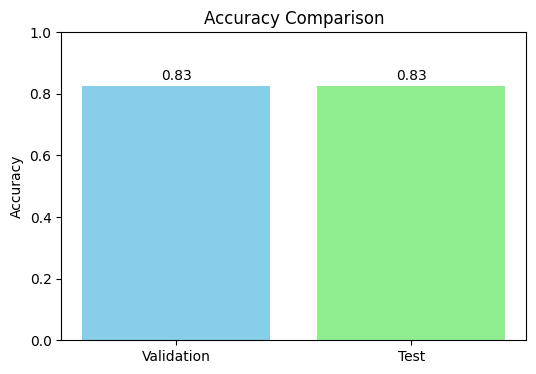

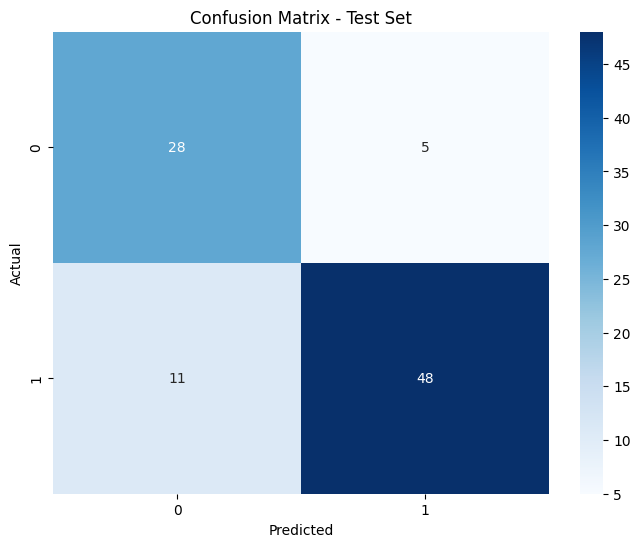

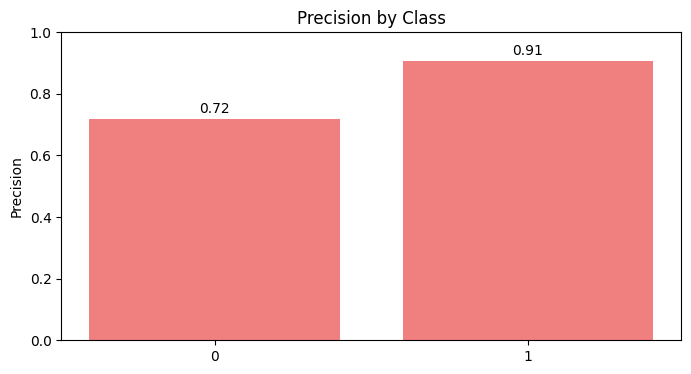

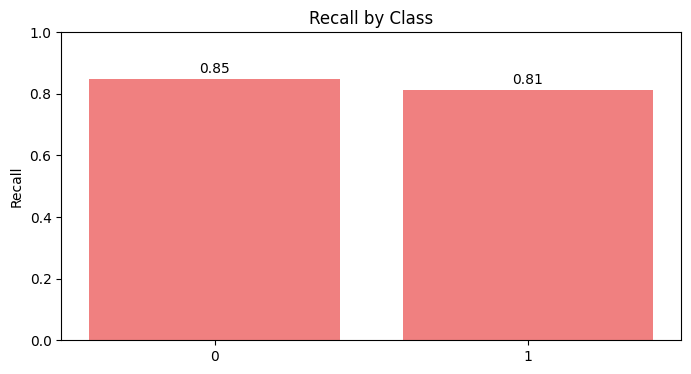

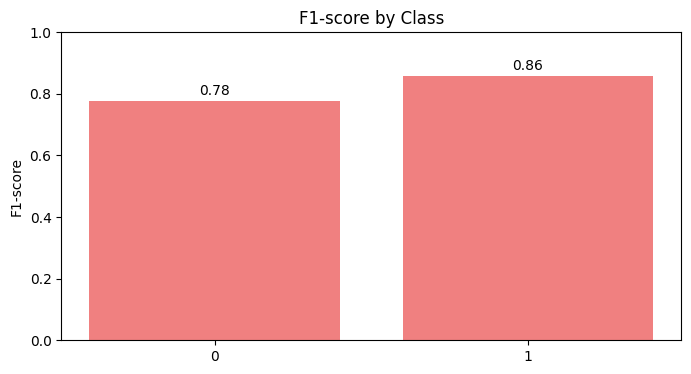

[I 2024-12-06 02:30:08,943] A new study created in memory with name: no-name-fecd6429-1446-41cf-b8e8-d9ddbc4bef3d
[I 2024-12-06 02:30:08,959] Trial 0 finished with value: 0.7817950581395349 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 6, 'min_samples_leaf': 4}. Best is trial 0 with value: 0.7817950581395349.
[I 2024-12-06 02:30:08,973] Trial 1 finished with value: 0.7989583333333333 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 5, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.7989583333333333.
[I 2024-12-06 02:30:08,987] Trial 2 finished with value: 0.8052083333333332 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8052083333333332.
[I 2024-12-06 02:30:09,002] Trial 3 finished with value: 0.8051962209302325 and parameters: {'criterion': 'entropy', 'max_depth': 7, 'min_samples_split': 8, 'min_samples_leaf': 5}. Best is trial 2 wi

Scenario dataset_scenario_4_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with optuna for dataset_scenario_5_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_5_N


[I 2024-12-06 02:30:09,161] Trial 12 finished with value: 0.8036216085271317 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 8, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.8052083333333332.
[I 2024-12-06 02:30:09,196] Trial 13 finished with value: 0.7896196705426357 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 2 with value: 0.8052083333333332.
[I 2024-12-06 02:30:09,221] Trial 14 finished with value: 0.7864825581395348 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 10, 'min_samples_leaf': 2}. Best is trial 2 with value: 0.8052083333333332.
[I 2024-12-06 02:30:09,245] Trial 15 finished with value: 0.7943071705426357 and parameters: {'criterion': 'log_loss', 'max_depth': 7, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 2 with value: 0.8052083333333332.
[I 2024-12-06 02:30:09,268] Trial 16 finished with value: 0.808309108527131

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 9, 'min_samples_split': 9, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.7391
  Precision: 0.7480
  Recall: 0.7391
  F1 Score: 0.7404

Test Metrics:
  Accuracy: 0.7717
  Precision: 0.7774
  Recall: 0.7717
  F1 Score: 0.7737

Confusion Matrix (Test Set):
[[24  9]
 [12 47]]


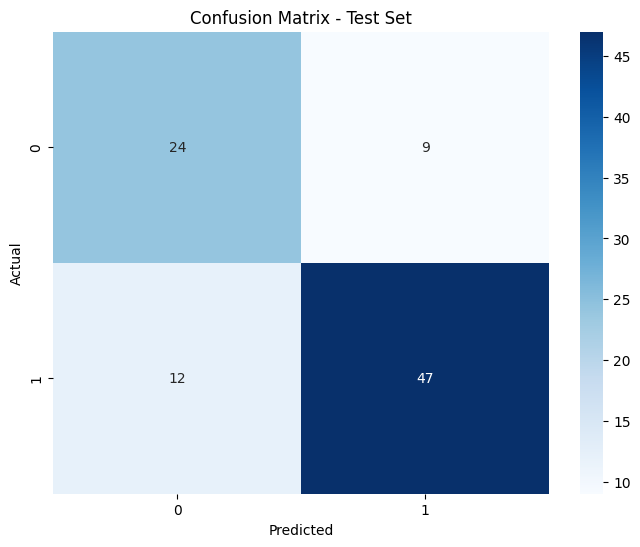

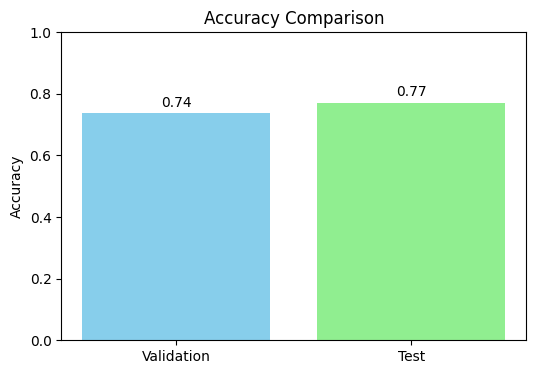

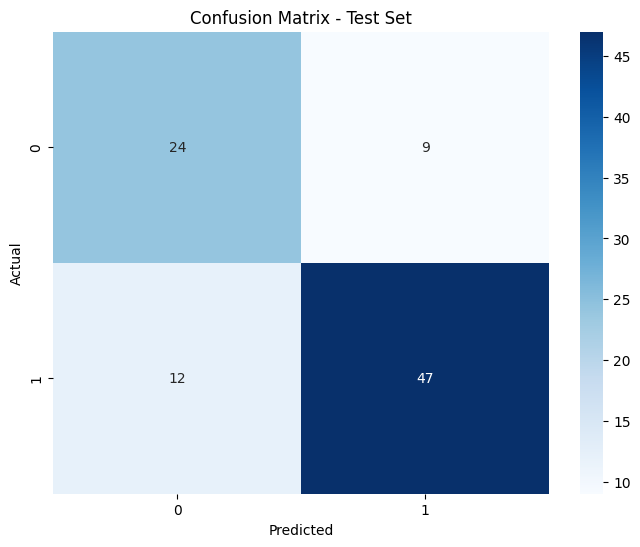

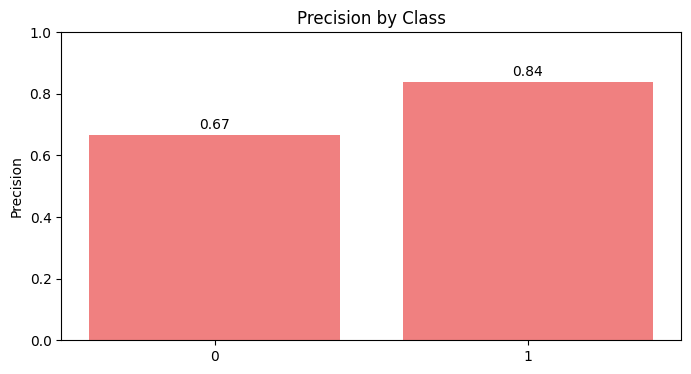

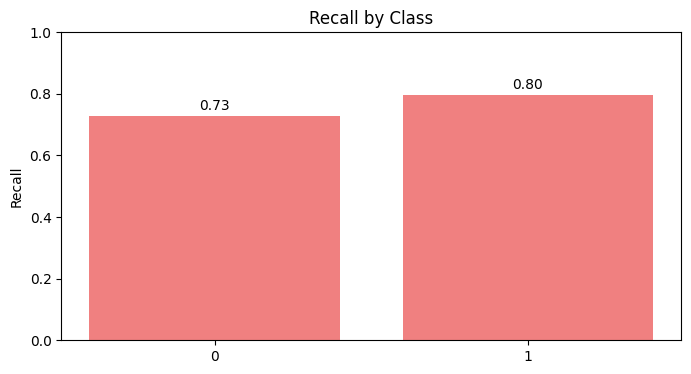

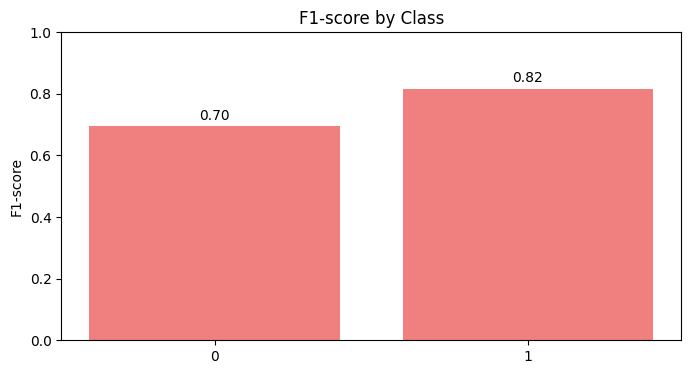

[I 2024-12-06 02:30:12,164] A new study created in memory with name: no-name-1aa3a459-deba-4e20-b57b-0b2705ec338c
[I 2024-12-06 02:30:12,178] Trial 0 finished with value: 0.7849927325581396 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.7849927325581396.
[I 2024-12-06 02:30:12,193] Trial 1 finished with value: 0.780281007751938 and parameters: {'criterion': 'log_loss', 'max_depth': 23, 'min_samples_split': 8, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7849927325581396.
[I 2024-12-06 02:30:12,207] Trial 2 finished with value: 0.7771317829457365 and parameters: {'criterion': 'log_loss', 'max_depth': 34, 'min_samples_split': 5, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7849927325581396.
[I 2024-12-06 02:30:12,221] Trial 3 finished with value: 0.8083212209302324 and parameters: {'criterion': 'entropy', 'max_depth': 46, 'min_samples_split': 5, 'min_samples_leaf': 5}. Best is trial 3 

Scenario dataset_scenario_5_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 5_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: False
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_5_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_5_S


[I 2024-12-06 02:30:12,357] Trial 11 finished with value: 0.7942829457364341 and parameters: {'criterion': 'entropy', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 5}. Best is trial 3 with value: 0.8083212209302324.
[I 2024-12-06 02:30:12,382] Trial 12 finished with value: 0.7958454457364341 and parameters: {'criterion': 'entropy', 'max_depth': 38, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 3 with value: 0.8083212209302324.
[I 2024-12-06 02:30:12,407] Trial 13 finished with value: 0.8052083333333332 and parameters: {'criterion': 'entropy', 'max_depth': 50, 'min_samples_split': 10, 'min_samples_leaf': 5}. Best is trial 3 with value: 0.8083212209302324.
[I 2024-12-06 02:30:12,432] Trial 14 finished with value: 0.7881056201550388 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 6, 'min_samples_leaf': 4}. Best is trial 3 with value: 0.8083212209302324.
[I 2024-12-06 02:30:12,456] Trial 15 finished with value: 0.803645833333333

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 46, 'min_samples_split': 5, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.7609
  Precision: 0.7747
  Recall: 0.7609
  F1 Score: 0.7620

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8170
  Recall: 0.8043
  F1 Score: 0.8073

Confusion Matrix (Test Set):
[[27  6]
 [12 47]]


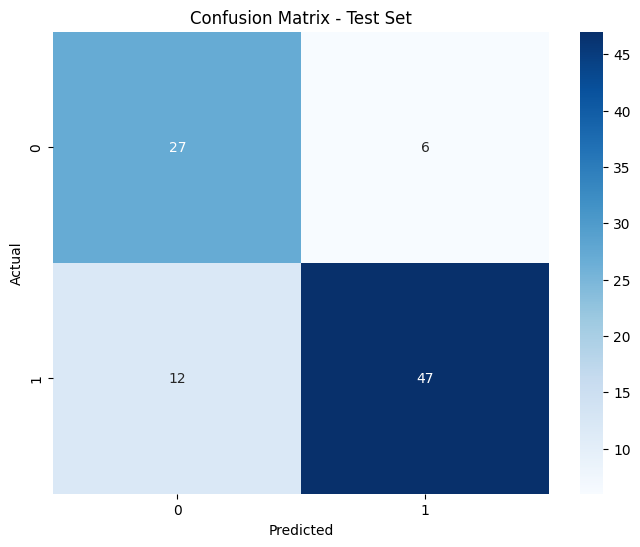

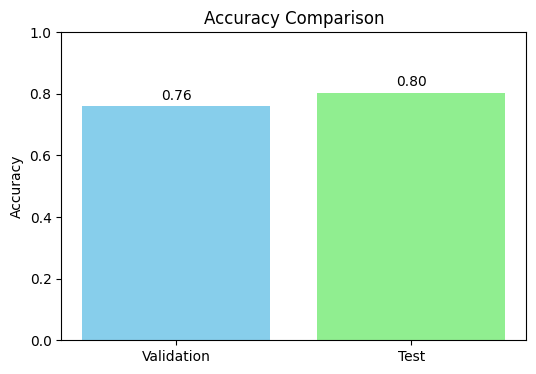

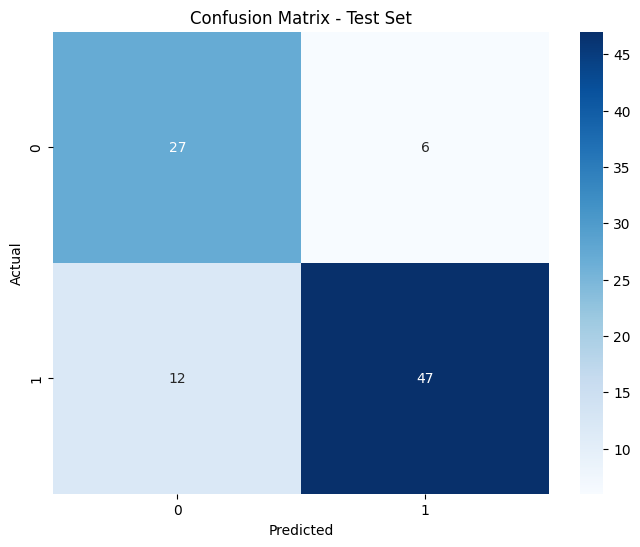

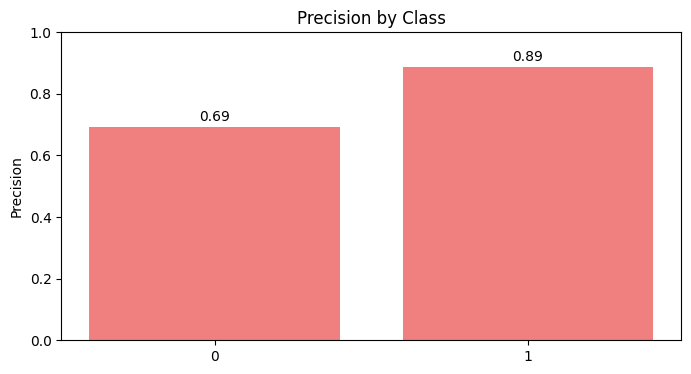

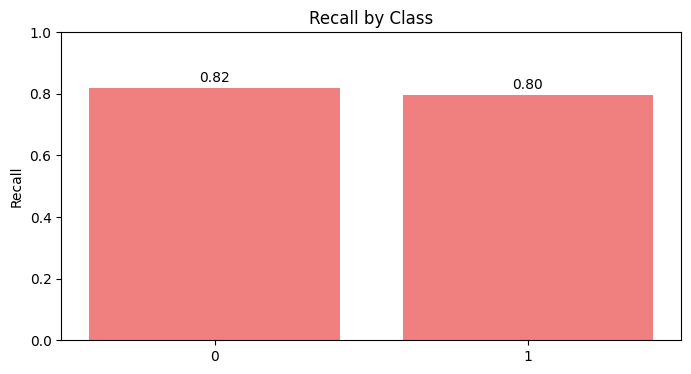

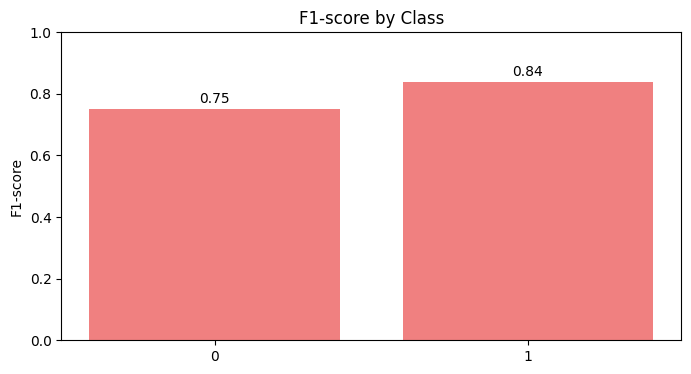

[I 2024-12-06 02:30:15,362] A new study created in memory with name: no-name-d0b08535-b756-4e35-b6ef-cd3a691bb7ec
[I 2024-12-06 02:30:15,377] Trial 0 finished with value: 0.7880571705426357 and parameters: {'criterion': 'log_loss', 'max_depth': 36, 'min_samples_split': 10, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.7880571705426357.
[I 2024-12-06 02:30:15,404] Trial 1 finished with value: 0.7724927325581395 and parameters: {'criterion': 'log_loss', 'max_depth': 42, 'min_samples_split': 7, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.7880571705426357.
[I 2024-12-06 02:30:15,433] Trial 2 finished with value: 0.7693798449612403 and parameters: {'criterion': 'gini', 'max_depth': 46, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.7880571705426357.
[I 2024-12-06 02:30:15,450] Trial 3 finished with value: 0.7973837209302326 and parameters: {'criterion': 'gini', 'max_depth': 28, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 3 w

Scenario dataset_scenario_5_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with optuna for dataset_scenario_6_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_6_N


[I 2024-12-06 02:30:15,565] Trial 10 finished with value: 0.789607558139535 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 3 with value: 0.7973837209302326.
[I 2024-12-06 02:30:15,589] Trial 11 finished with value: 0.7787185077519381 and parameters: {'criterion': 'gini', 'max_depth': 29, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 3 with value: 0.7973837209302326.
[I 2024-12-06 02:30:15,611] Trial 12 finished with value: 0.7755571705426356 and parameters: {'criterion': 'log_loss', 'max_depth': 28, 'min_samples_split': 4, 'min_samples_leaf': 1}. Best is trial 3 with value: 0.7973837209302326.
[I 2024-12-06 02:30:15,636] Trial 13 finished with value: 0.777156007751938 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 5, 'min_samples_leaf': 4}. Best is trial 3 with value: 0.7973837209302326.
[I 2024-12-06 02:30:15,660] Trial 14 finished with value: 0.7926962209302325 and parame

Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 5, 'min_samples_split': 9, 'min_samples_leaf': 4}
Validation Metrics:
  Accuracy: 0.8315
  Precision: 0.8391
  Recall: 0.8315
  F1 Score: 0.8323

Test Metrics:
  Accuracy: 0.7935
  Precision: 0.8163
  Recall: 0.7935
  F1 Score: 0.7973

Confusion Matrix (Test Set):
[[28  5]
 [14 45]]


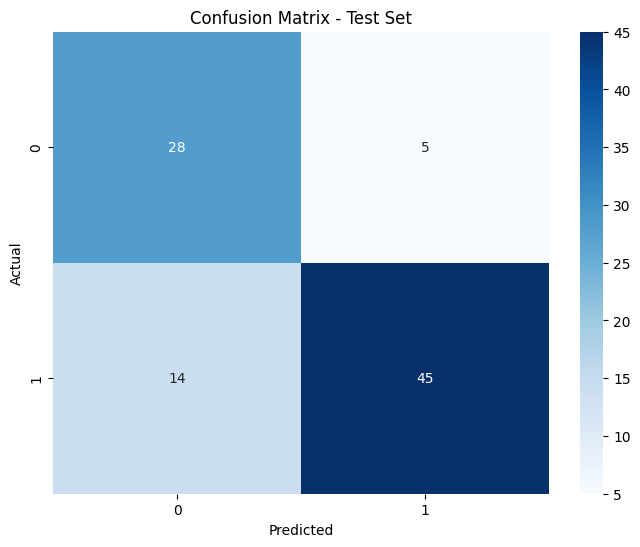

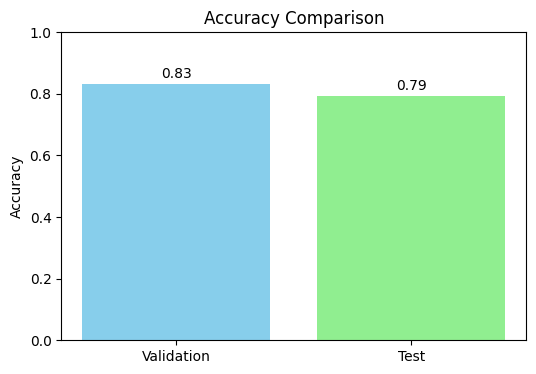

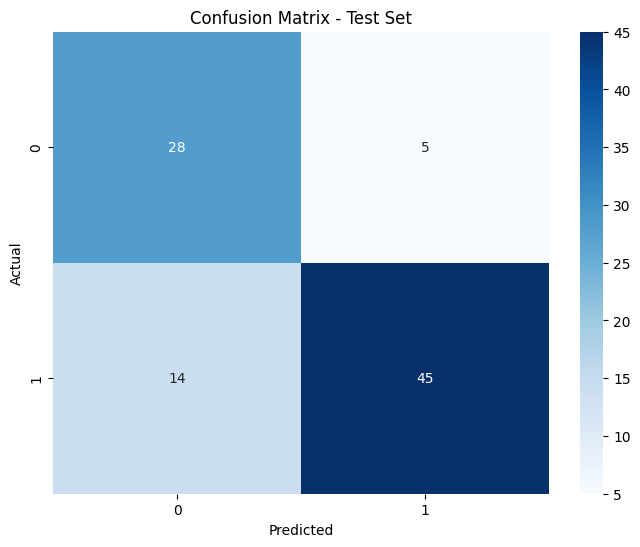

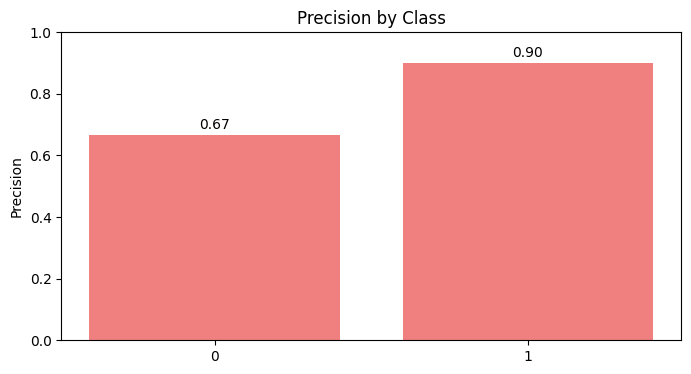

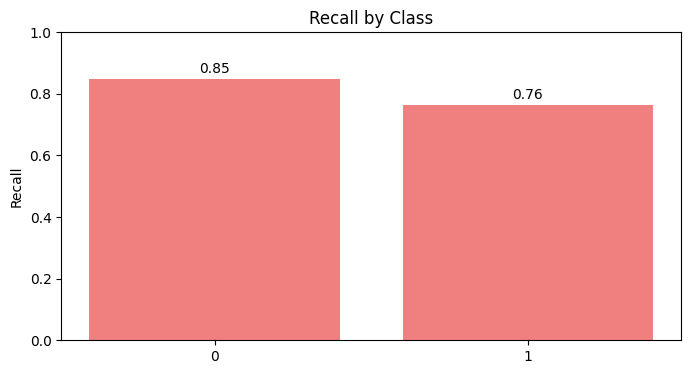

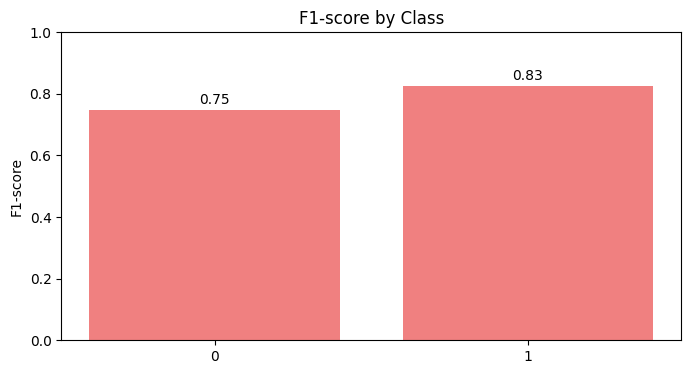

[I 2024-12-06 02:30:18,542] A new study created in memory with name: no-name-069e7285-5017-4fcd-8b59-361322647379
[I 2024-12-06 02:30:18,557] Trial 0 finished with value: 0.788093507751938 and parameters: {'criterion': 'log_loss', 'max_depth': 8, 'min_samples_split': 10, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.788093507751938.
[I 2024-12-06 02:30:18,572] Trial 1 finished with value: 0.7911458333333334 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 6, 'min_samples_leaf': 3}. Best is trial 1 with value: 0.7911458333333334.
[I 2024-12-06 02:30:18,587] Trial 2 finished with value: 0.7942829457364341 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.7942829457364341.
[I 2024-12-06 02:30:18,601] Trial 3 finished with value: 0.7646802325581395 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 3, 'min_samples_leaf': 2}. Best is trial 2 wi

Scenario dataset_scenario_6_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 6_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: False
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_6_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_6_S


[I 2024-12-06 02:30:18,738] Trial 11 finished with value: 0.7942829457364341 and parameters: {'criterion': 'log_loss', 'max_depth': 26, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.7942829457364341.
[I 2024-12-06 02:30:18,763] Trial 12 finished with value: 0.7958454457364341 and parameters: {'criterion': 'log_loss', 'max_depth': 23, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 12 with value: 0.7958454457364341.
[I 2024-12-06 02:30:18,786] Trial 13 finished with value: 0.788045058139535 and parameters: {'criterion': 'log_loss', 'max_depth': 22, 'min_samples_split': 3, 'min_samples_leaf': 4}. Best is trial 12 with value: 0.7958454457364341.
[I 2024-12-06 02:30:18,811] Trial 14 finished with value: 0.809798934108527 and parameters: {'criterion': 'entropy', 'max_depth': 6, 'min_samples_split': 7, 'min_samples_leaf': 4}. Best is trial 14 with value: 0.809798934108527.
[I 2024-12-06 02:30:18,835] Trial 15 finished with value: 0.80370639534883

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 8, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8478
  Precision: 0.8475
  Recall: 0.8478
  F1 Score: 0.8476

Test Metrics:
  Accuracy: 0.8043
  Precision: 0.8023
  Recall: 0.8043
  F1 Score: 0.8029

Confusion Matrix (Test Set):
[[23 10]
 [ 8 51]]


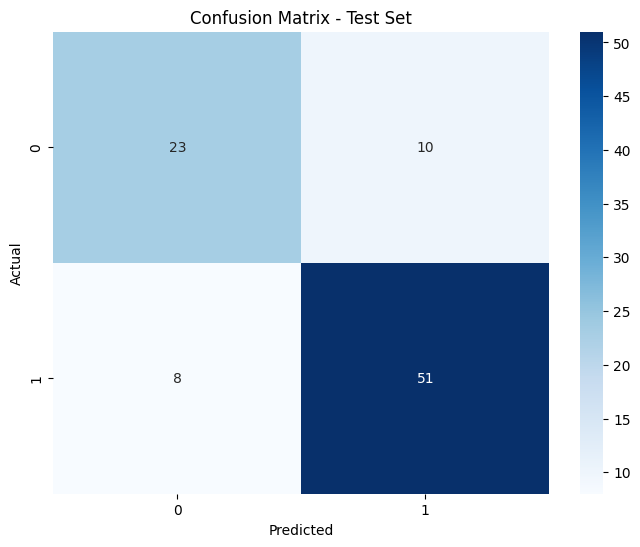

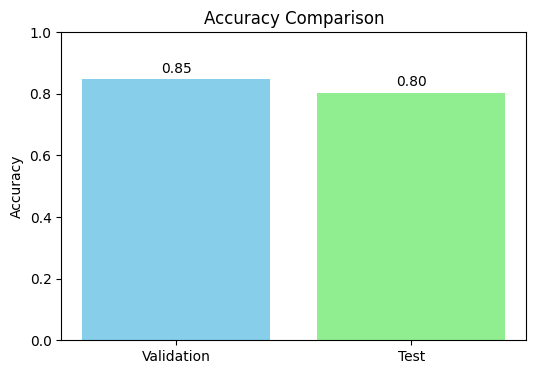

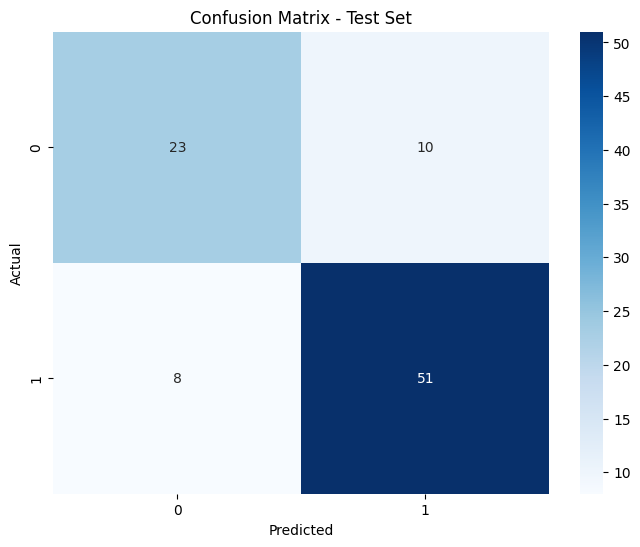

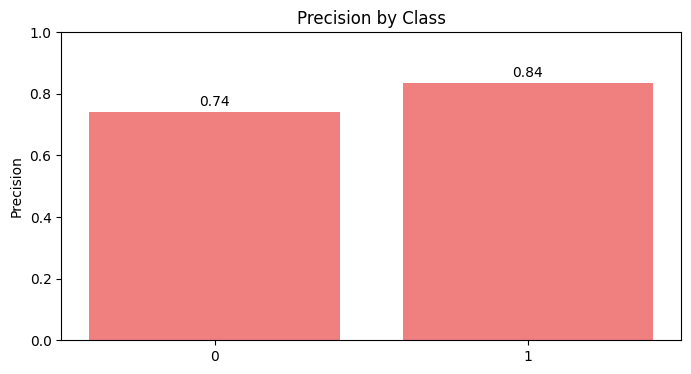

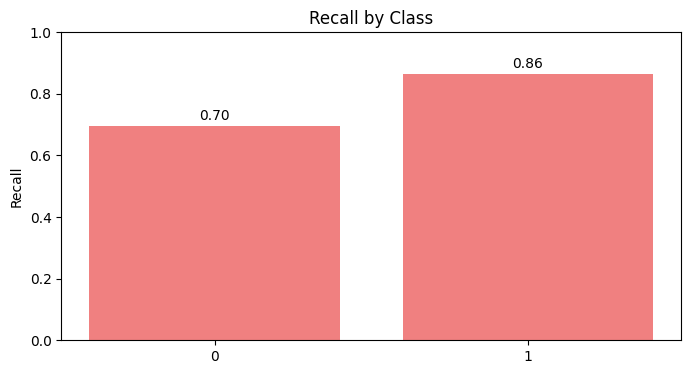

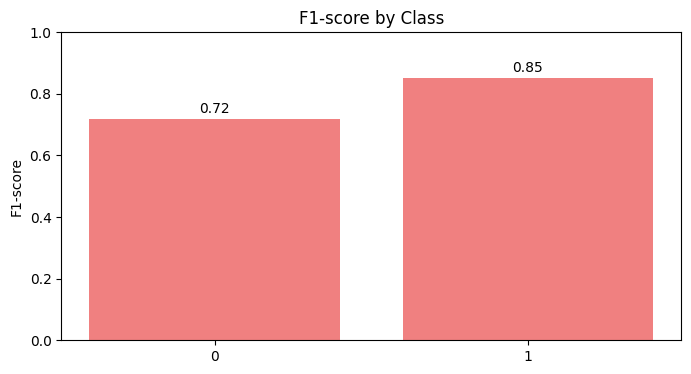

[I 2024-12-06 02:30:21,804] A new study created in memory with name: no-name-d119799e-e5ba-4c2f-9100-c8b114b403f3
[I 2024-12-06 02:30:21,818] Trial 0 finished with value: 0.8105545248402393 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 1}. Best is trial 0 with value: 0.8105545248402393.
[I 2024-12-06 02:30:21,832] Trial 1 finished with value: 0.8289218717790146 and parameters: {'criterion': 'log_loss', 'max_depth': 16, 'min_samples_split': 3, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.8289218717790146.
[I 2024-12-06 02:30:21,847] Trial 2 finished with value: 0.8024118738404452 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 4, 'min_samples_leaf': 4}. Best is trial 1 with value: 0.8289218717790146.
[I 2024-12-06 02:30:21,863] Trial 3 finished with value: 0.8248402391259534 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 1 w

Scenario dataset_scenario_6_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: MinMax
Running DecisionTree with optuna for dataset_scenario_7_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_7_N


[I 2024-12-06 02:30:22,010] Trial 11 finished with value: 0.8227994227994226 and parameters: {'criterion': 'log_loss', 'max_depth': 18, 'min_samples_split': 10, 'min_samples_leaf': 5}. Best is trial 1 with value: 0.8289218717790146.
[I 2024-12-06 02:30:22,054] Trial 12 finished with value: 0.8064935064935066 and parameters: {'criterion': 'log_loss', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 1 with value: 0.8289218717790146.
[I 2024-12-06 02:30:22,079] Trial 13 finished with value: 0.8472686044114616 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 9, 'min_samples_leaf': 5}. Best is trial 13 with value: 0.8472686044114616.
[I 2024-12-06 02:30:22,104] Trial 14 finished with value: 0.8289218717790146 and parameters: {'criterion': 'log_loss', 'max_depth': 31, 'min_samples_split': 10, 'min_samples_leaf': 5}. Best is trial 13 with value: 0.8472686044114616.
[I 2024-12-06 02:30:22,130] Trial 15 finished with value: 0.830962688105

Best hyperparameters:  {'criterion': 'gini', 'max_depth': 38, 'min_samples_split': 4, 'min_samples_leaf': 5}
Validation Metrics:
  Accuracy: 0.8357
  Precision: 0.8355
  Recall: 0.8357
  F1 Score: 0.8356

Test Metrics:
  Accuracy: 0.8028
  Precision: 0.8157
  Recall: 0.8028
  F1 Score: 0.8035

Confusion Matrix (Test Set):
[[30 10]
 [ 4 27]]


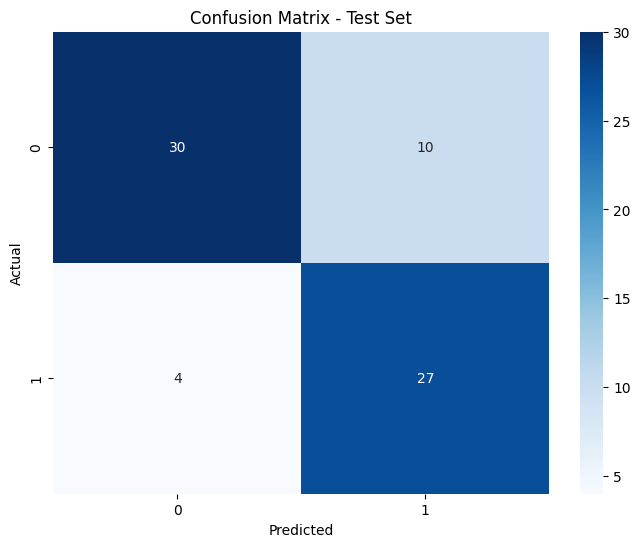

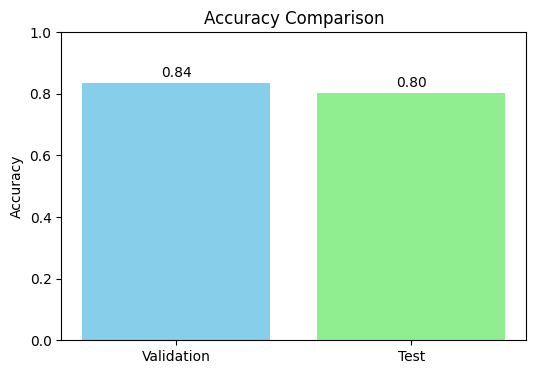

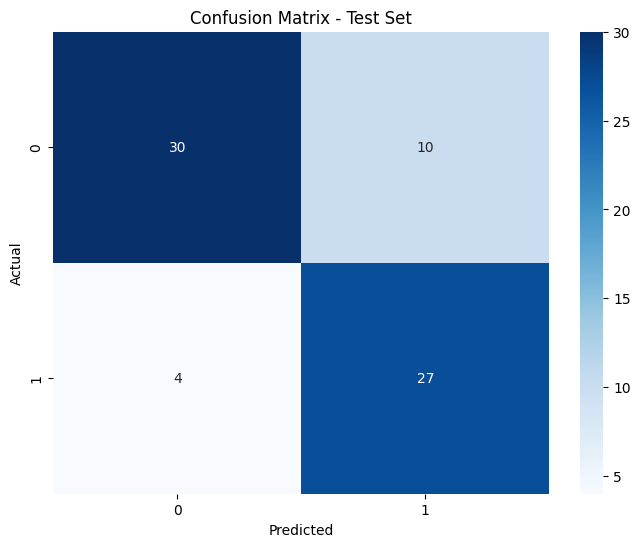

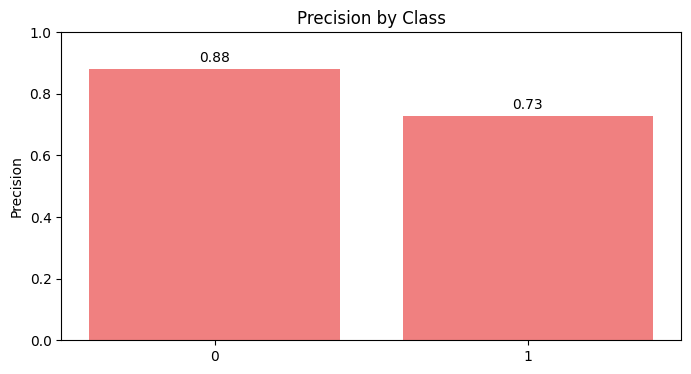

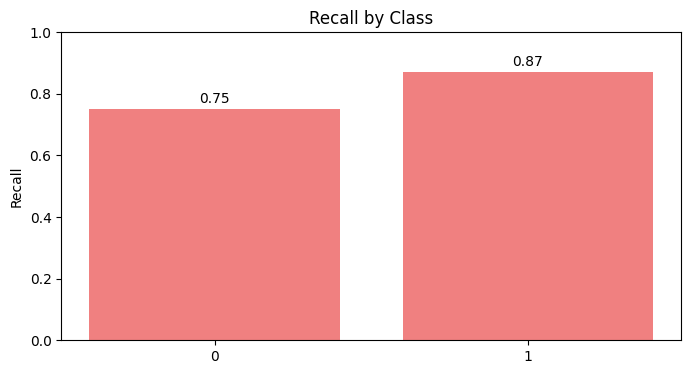

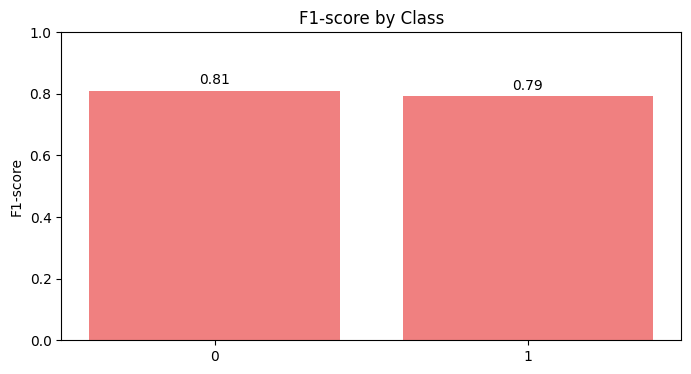

[I 2024-12-06 02:30:24,990] A new study created in memory with name: no-name-7ffcdba6-1fd5-41db-93ee-4abf068ede5f
[I 2024-12-06 02:30:25,005] Trial 0 finished with value: 0.8004122861265719 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 5, 'min_samples_leaf': 2}. Best is trial 0 with value: 0.8004122861265719.
[I 2024-12-06 02:30:25,021] Trial 1 finished with value: 0.808534322820037 and parameters: {'criterion': 'log_loss', 'max_depth': 19, 'min_samples_split': 4, 'min_samples_leaf': 4}. Best is trial 1 with value: 0.808534322820037.
[I 2024-12-06 02:30:25,035] Trial 2 finished with value: 0.820717377860235 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 9, 'min_samples_leaf': 4}. Best is trial 2 with value: 0.820717377860235.
[I 2024-12-06 02:30:25,049] Trial 3 finished with value: 0.782065553494125 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 7, 'min_samples_leaf': 2}. Best is trial 2 with 

Scenario dataset_scenario_7_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 7_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: True
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_7_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_7_S


[I 2024-12-06 02:30:25,187] Trial 11 finished with value: 0.8533910533910534 and parameters: {'criterion': 'gini', 'max_depth': 35, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 11 with value: 0.8533910533910534.
[I 2024-12-06 02:30:25,212] Trial 12 finished with value: 0.8554524840239125 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 3, 'min_samples_leaf': 5}. Best is trial 12 with value: 0.8554524840239125.
[I 2024-12-06 02:30:25,236] Trial 13 finished with value: 0.8411667697381983 and parameters: {'criterion': 'gini', 'max_depth': 6, 'min_samples_split': 3, 'min_samples_leaf': 5}. Best is trial 12 with value: 0.8554524840239125.
[I 2024-12-06 02:30:25,260] Trial 14 finished with value: 0.8207586064728922 and parameters: {'criterion': 'gini', 'max_depth': 38, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 12 with value: 0.8554524840239125.
[I 2024-12-06 02:30:25,284] Trial 15 finished with value: 0.8186971758400329 and param

Best hyperparameters:  {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 10, 'min_samples_leaf': 3}
Validation Metrics:
  Accuracy: 0.8143
  Precision: 0.8164
  Recall: 0.8143
  F1 Score: 0.8147

Test Metrics:
  Accuracy: 0.7606
  Precision: 0.7854
  Recall: 0.7606
  F1 Score: 0.7606

Confusion Matrix (Test Set):
[[27 13]
 [ 4 27]]


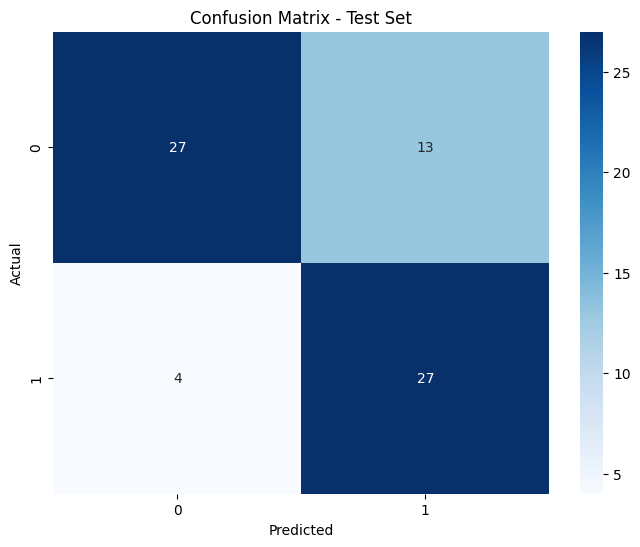

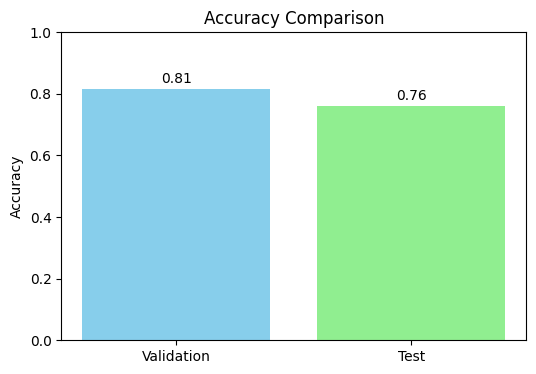

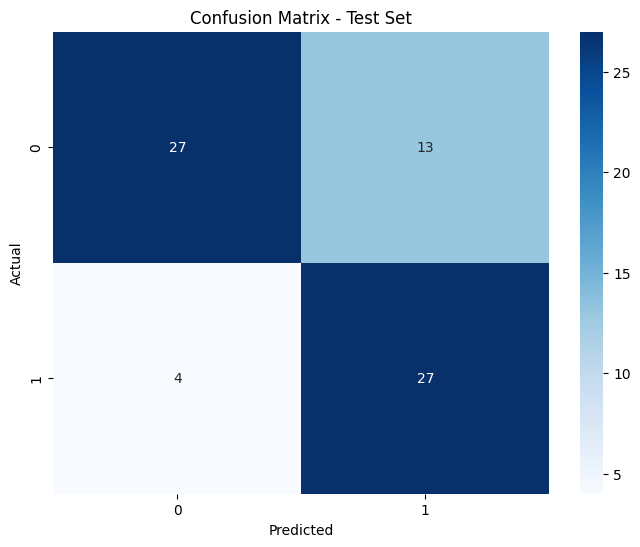

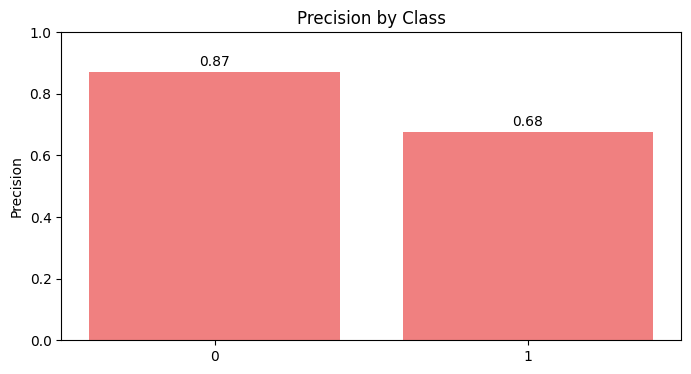

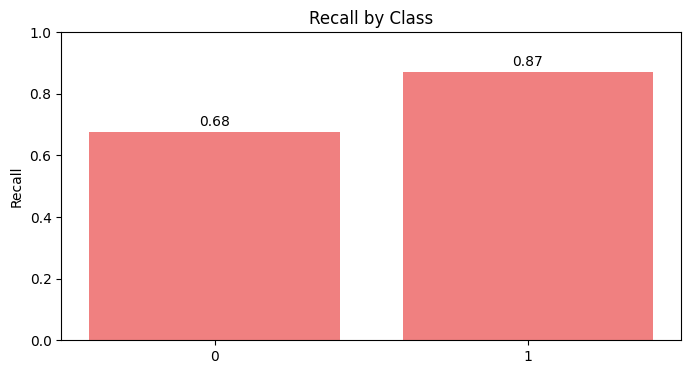

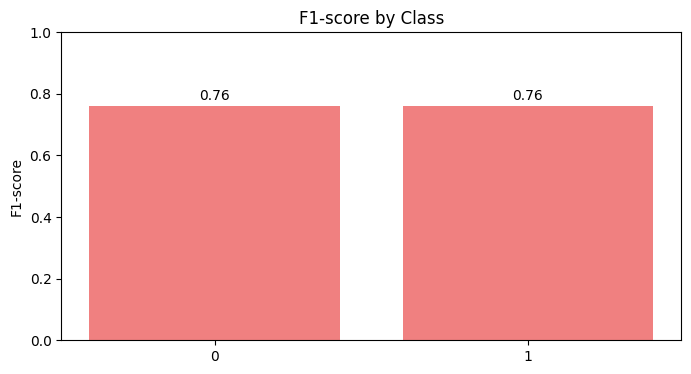

[I 2024-12-06 02:30:28,273] A new study created in memory with name: no-name-05876f89-d215-47e0-8608-5179db1d642c
[I 2024-12-06 02:30:28,287] Trial 0 finished with value: 0.8036216085271317 and parameters: {'criterion': 'entropy', 'max_depth': 8, 'min_samples_split': 2, 'min_samples_leaf': 3}. Best is trial 0 with value: 0.8036216085271317.
[I 2024-12-06 02:30:28,301] Trial 1 finished with value: 0.8051719961240309 and parameters: {'criterion': 'log_loss', 'max_depth': 43, 'min_samples_split': 5, 'min_samples_leaf': 3}. Best is trial 1 with value: 0.8051719961240309.
[I 2024-12-06 02:30:28,316] Trial 2 finished with value: 0.7803294573643411 and parameters: {'criterion': 'gini', 'max_depth': 41, 'min_samples_split': 4, 'min_samples_leaf': 2}. Best is trial 1 with value: 0.8051719961240309.
[I 2024-12-06 02:30:28,331] Trial 3 finished with value: 0.7990188953488373 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 2, 'min_samples_leaf': 4}. Best is trial 1 w

Scenario dataset_scenario_7_S with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_N
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: None
Running DecisionTree with optuna for dataset_scenario_8_N...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_8_N


[I 2024-12-06 02:30:28,490] Trial 12 finished with value: 0.8067344961240309 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 6, 'min_samples_leaf': 3}. Best is trial 11 with value: 0.8285852713178293.
[I 2024-12-06 02:30:28,515] Trial 13 finished with value: 0.8270348837209301 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 7, 'min_samples_leaf': 3}. Best is trial 11 with value: 0.8285852713178293.
[I 2024-12-06 02:30:28,539] Trial 14 finished with value: 0.8036942829457365 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 8, 'min_samples_leaf': 5}. Best is trial 11 with value: 0.8285852713178293.
[I 2024-12-06 02:30:28,563] Trial 15 finished with value: 0.7865310077519381 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 10, 'min_samples_leaf': 1}. Best is trial 11 with value: 0.8285852713178293.
[I 2024-12-06 02:30:28,587] Trial 16 finished with value: 0.8098110465116

Best hyperparameters:  {'criterion': 'log_loss', 'max_depth': 5, 'min_samples_split': 6, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8152
  Precision: 0.8170
  Recall: 0.8152
  F1 Score: 0.8157

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


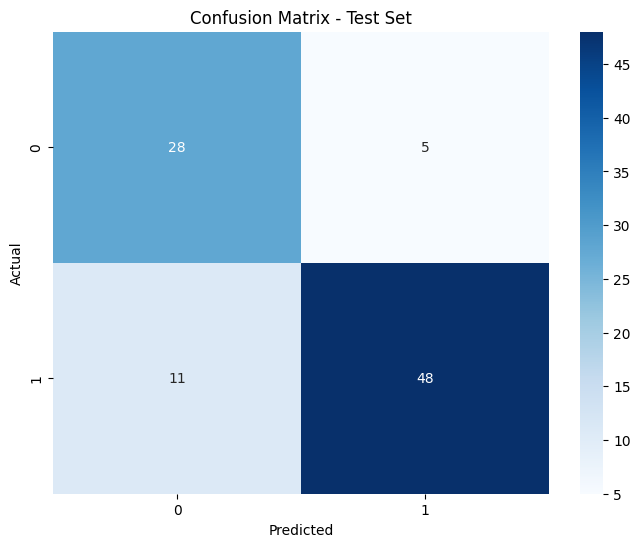

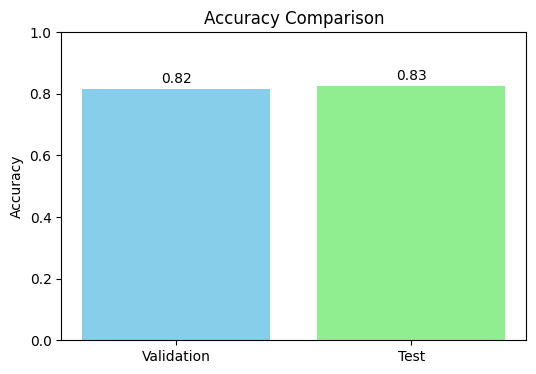

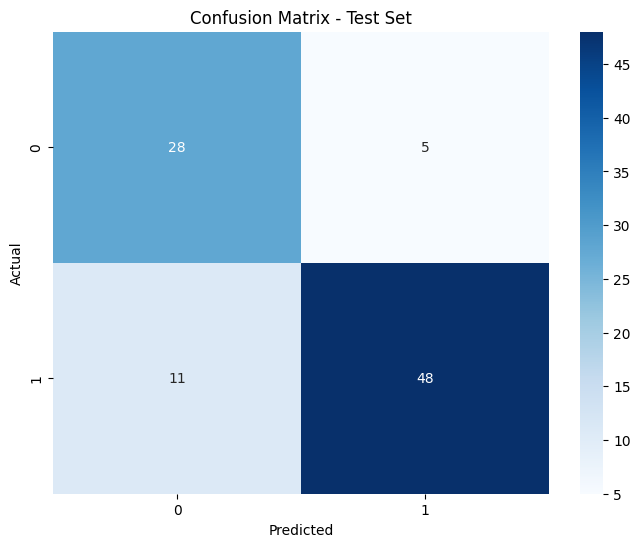

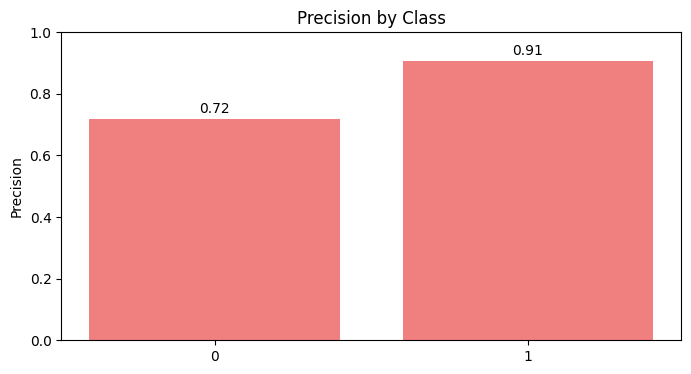

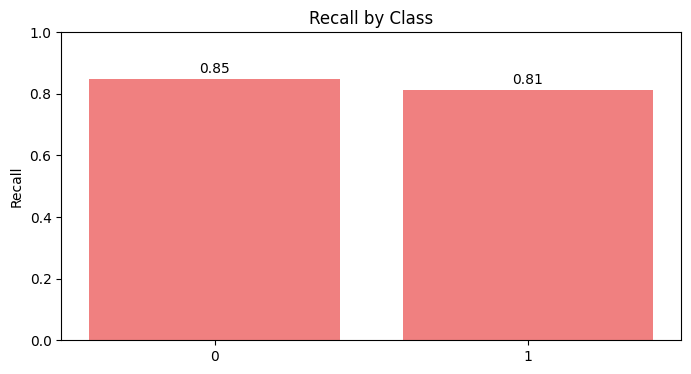

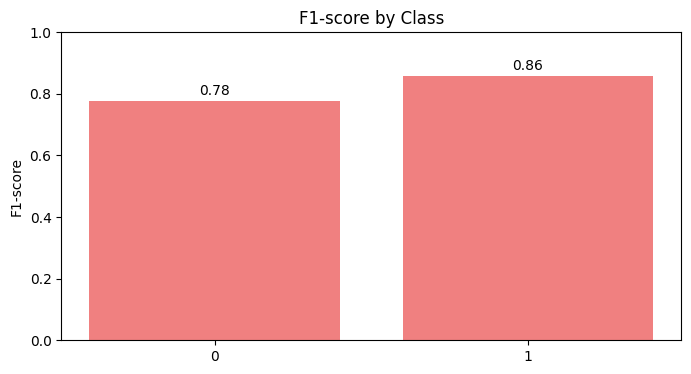

[I 2024-12-06 02:30:31,459] A new study created in memory with name: no-name-e26d47ff-4e19-4bd5-8b6d-fc4ca0df60e3
[I 2024-12-06 02:30:31,474] Trial 0 finished with value: 0.803670058139535 and parameters: {'criterion': 'log_loss', 'max_depth': 15, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 0 with value: 0.803670058139535.
[I 2024-12-06 02:30:31,488] Trial 1 finished with value: 0.7974200581395349 and parameters: {'criterion': 'log_loss', 'max_depth': 12, 'min_samples_split': 8, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.803670058139535.
[I 2024-12-06 02:30:31,502] Trial 2 finished with value: 0.8098594961240309 and parameters: {'criterion': 'entropy', 'max_depth': 30, 'min_samples_split': 2, 'min_samples_leaf': 3}. Best is trial 2 with value: 0.8098594961240309.
[I 2024-12-06 02:30:31,517] Trial 3 finished with value: 0.798970445736434 and parameters: {'criterion': 'log_loss', 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 5}. Best is trial 2

Scenario dataset_scenario_8_N with optuna completed and results saved.

----------------------------------------



Scenario Name: Scenario 8_S
  Encoding: {'Sex': 'Label', 'ExerciseAngina': 'Label', 'ST_Slope': 'Label', 'RestingECG': 'Label', 'ChestPainType': 'OneHot'}
  Remove Outliers: replace_with_mean
  Remove Errors: True
  Impute Zeros: None
  Oldpeak Absolute: Not Specified
  Scaling: Standard
Running DecisionTree with optuna for dataset_scenario_8_S...
Results will be saved in: SCORES\DecisionTree\optuna\dataset_scenario_8_S


[I 2024-12-06 02:30:31,653] Trial 11 finished with value: 0.8036216085271317 and parameters: {'criterion': 'entropy', 'max_depth': 29, 'min_samples_split': 2, 'min_samples_leaf': 3}. Best is trial 6 with value: 0.8114583333333334.
[I 2024-12-06 02:30:31,680] Trial 12 finished with value: 0.8082848837209301 and parameters: {'criterion': 'entropy', 'max_depth': 33, 'min_samples_split': 2, 'min_samples_leaf': 3}. Best is trial 6 with value: 0.8114583333333334.
[I 2024-12-06 02:30:31,704] Trial 13 finished with value: 0.8160731589147285 and parameters: {'criterion': 'entropy', 'max_depth': 6, 'min_samples_split': 4, 'min_samples_leaf': 4}. Best is trial 13 with value: 0.8160731589147285.
[I 2024-12-06 02:30:31,729] Trial 14 finished with value: 0.7927931201550388 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 5}. Best is trial 13 with value: 0.8160731589147285.
[I 2024-12-06 02:30:31,753] Trial 15 finished with value: 0.8021317829457365 an

Best hyperparameters:  {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 1}
Validation Metrics:
  Accuracy: 0.8207
  Precision: 0.8230
  Recall: 0.8207
  F1 Score: 0.8212

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


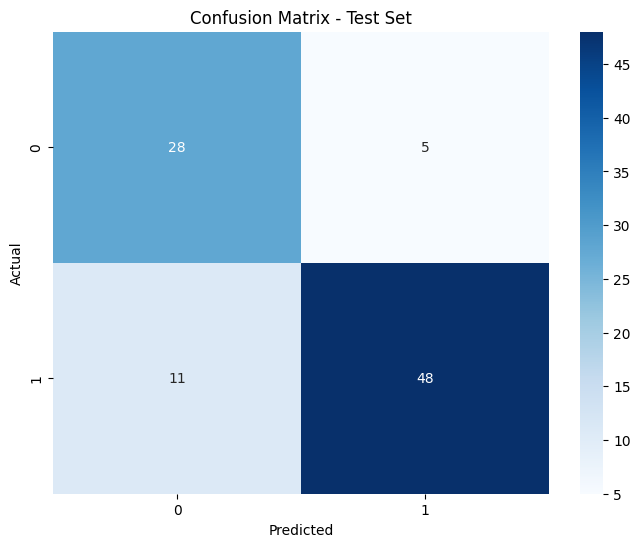

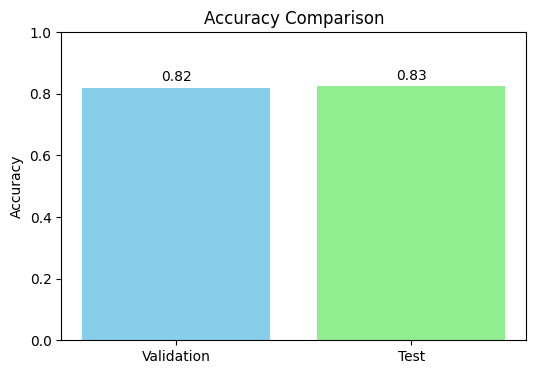

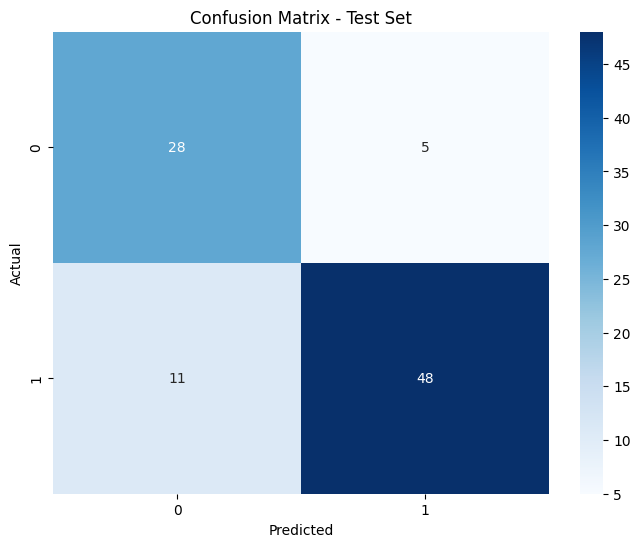

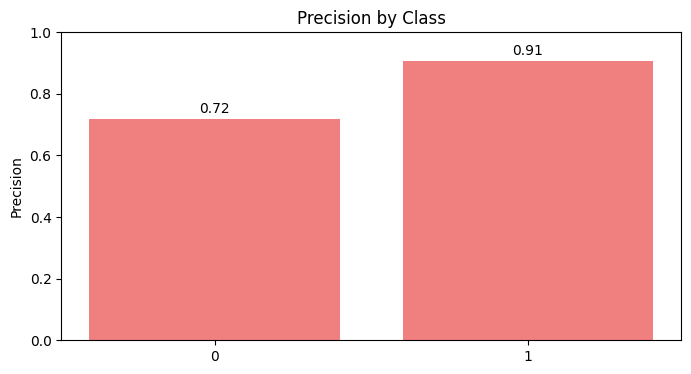

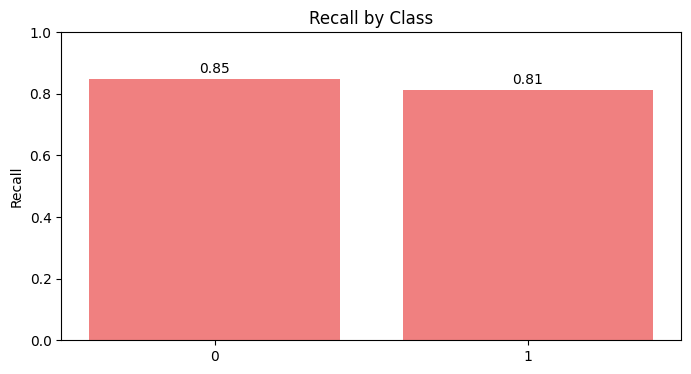

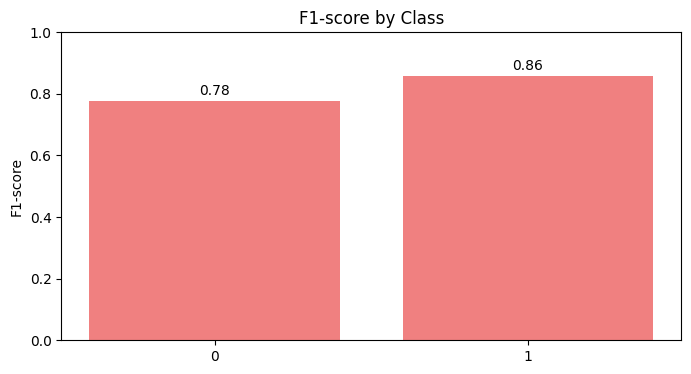

Scenario dataset_scenario_8_S with optuna completed and results saved.

----------------------------------------



Validation Metrics:
  Accuracy: 0.8207
  Precision: 0.8245
  Recall: 0.8207
  F1 Score: 0.8214

Test Metrics:
  Accuracy: 0.8261
  Precision: 0.8383
  Recall: 0.8261
  F1 Score: 0.8287

Confusion Matrix (Test Set):
[[28  5]
 [11 48]]


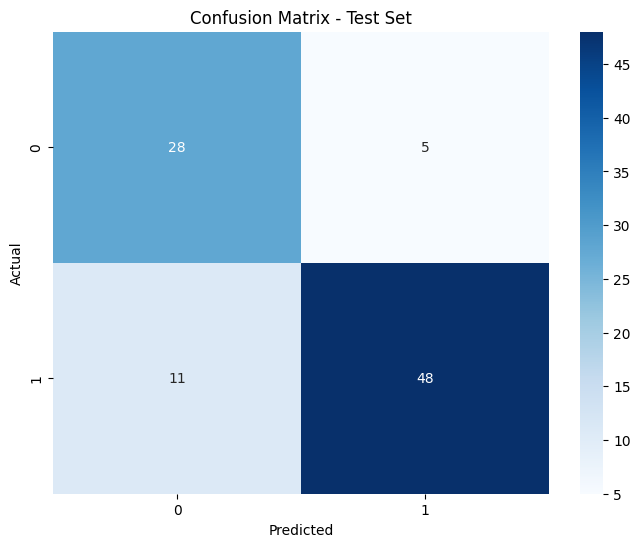

In [68]:
DecisionTree_optuna_search = {
    
}
best_score = 0
for scenario, scenario_description in zip(scenario_datasets, scenarios_description):
    print(f"Scenario Name: {scenario_description['name']}")
    print(f"  Encoding: {scenario_description['encoding']}")
    print(f"  Remove Outliers: {scenario_description['remove_outliers']}")
    print(f"  Remove Errors: {scenario_description.get('remove_errors', 'Not Specified')}")
    print(f"  Impute Zeros: {scenario_description.get('impute_zeros', 'None')}")
    print(f"  Oldpeak Absolute: {scenario_description.get('oldpeak_abs', 'Not Specified')}")
    print(f"  Scaling: {scenario_description['scaling']}")

    # Run for Naive Bayes
    metric_test, best_params = run_scenario(scenario, "DecisionTree", "optuna", search_config_optuna, get_search_hyperparameters("DecisionTree"))
    
    if metric_test["accuracy"] > best_score:
        best_score = metric_test["accuracy"]
        DecisionTree_optuna_search['accuracy'] = best_score
        DecisionTree_optuna_search['params'] = best_params
        DecisionTree_optuna_search['scenario'] = scenario
    
    
    print("-" * 40)
    print("\n\n")
    
DecisionTree = DecisionTreeClassifier(**DecisionTree_optuna_search['params'])
best_scenario = pd.read_csv(DecisionTree_optuna_search['scenario']) 
trainer = ModelTrainer(best_scenario, target_column, DecisionTree) 
trainer.split_data()
trainer.train()
trainer.test_and_evaluate()
save_models(trainer.model, "DecisionTree", "optuna")
save_model_info(DecisionTree_optuna_search, "DecisionTree", "optuna")
    

# Comparing Best Models

In [ ]:
best_models_dir = "./best_models"